In [1]:
import torch
import numpy as np
import plotly.graph_objects as go

from torch_utils import *
from normals import compute_normals
from bunny import get_bunny
from sirens import Siren, gradient
from igr import IGR
from sphere_trace import render

In [2]:
def sample_on_rays(pc, ego, num_samples=10):
    sample_pts = torch.clamp(trand(num_samples).expand(3, pc.shape[0], num_samples).transpose(0, 2), max=0.8)
    sample_space = (pc - ego).expand(num_samples, pc.shape[0], 3)

    return sample_pts * sample_space

<ipython-input-3-249adb4d5794>:32: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  aligned = (aligned > 0).nonzero()


reconstruction loss tensor(2339.0605, device='cuda:0', grad_fn=<MulBackward0>) eikonal loss tensor(52.8897, device='cuda:0', grad_fn=<MulBackward0>) exterior loss tensor(9.5923, device='cuda:0', grad_fn=<MulBackward0>) inter loss tensor(0.3709, device='cuda:0', grad_fn=<MulBackward0>) normal_loss tensor(98.1245, device='cuda:0', grad_fn=<MulBackward0>)
worst of last batch tensor(0.9047, device='cuda:0', grad_fn=<MaxBackward1>)


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



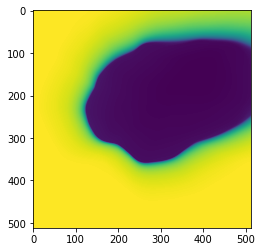

epoch 1: 2386.68212890625
epoch 2: 2243.736572265625
epoch 3: 2100.30712890625
epoch 4: 1930.6055908203125
epoch 5: 1765.4510498046875
epoch 6: 1582.58154296875
epoch 7: 1377.7940673828125
epoch 8: 1181.0975341796875
epoch 9: 988.4881591796875
epoch 11: 631.3843994140625
epoch 12: 470.54931640625
epoch 13: 340.08807373046875
epoch 14: 244.970703125
epoch 15: 187.91940307617188
epoch 16: 167.75111389160156
epoch 17: 184.8297119140625
epoch 18: 219.95535278320312
epoch 19: 260.908935546875
epoch 21: 288.4156494140625
epoch 22: 277.9667053222656
epoch 23: 247.86297607421875
epoch 24: 207.638427734375
epoch 25: 175.50949096679688
epoch 26: 144.64932250976562
epoch 27: 122.8690414428711
epoch 28: 110.04402923583984
epoch 29: 108.95751190185547
epoch 31: 110.41658782958984
epoch 32: 116.40339660644531
epoch 33: 123.88702392578125
epoch 34: 123.24490356445312
epoch 35: 127.7704086303711
epoch 36: 131.51763916015625
epoch 37: 130.36903381347656
epoch 38: 123.49951934814453
epoch 39: 122.869651

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



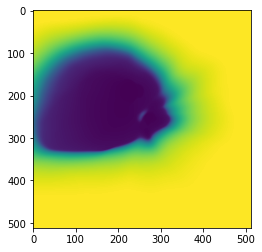

epoch 101: 81.37171173095703
epoch 102: 80.63982391357422
epoch 103: 80.58155822753906
epoch 104: 79.69760131835938
epoch 105: 77.58320617675781
epoch 106: 79.24932861328125
epoch 107: 77.59822845458984
epoch 108: 77.54861450195312
epoch 109: 79.87319946289062
epoch 111: 79.0235824584961
epoch 112: 77.12474060058594
epoch 113: 77.66748809814453
epoch 114: 78.44364166259766
epoch 115: 77.61840057373047
epoch 116: 77.69322967529297
epoch 117: 79.3095703125
epoch 118: 78.37722778320312
epoch 119: 75.9093246459961
epoch 121: 77.25325775146484
epoch 122: 74.57915496826172
epoch 123: 75.68421173095703
epoch 124: 76.63104248046875
epoch 125: 74.23389434814453
epoch 126: 76.01671600341797
epoch 127: 75.57150268554688
epoch 128: 74.47350311279297
epoch 129: 74.27528381347656
epoch 131: 73.59574890136719
epoch 132: 74.97808074951172
epoch 133: 77.78295135498047
epoch 134: 76.73223876953125
epoch 135: 74.4222412109375
epoch 136: 73.74139404296875
epoch 137: 71.99746704101562
epoch 138: 78.0736160

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



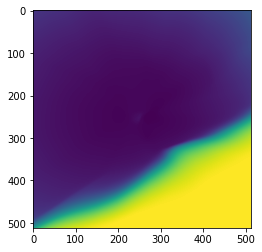

epoch 201: 68.4237289428711
epoch 202: 69.30093383789062
epoch 203: 69.5590591430664
epoch 204: 69.12279510498047
epoch 205: 68.33670806884766
epoch 206: 68.02490997314453
epoch 207: 69.89973449707031
epoch 208: 69.48858642578125
epoch 209: 67.38998413085938
epoch 211: 67.98838806152344
epoch 212: 69.98136901855469
epoch 213: 67.42081451416016
epoch 214: 67.39335632324219
epoch 215: 69.67406463623047
epoch 216: 70.10292053222656
epoch 217: 69.98929595947266
epoch 218: 69.02267456054688
epoch 219: 66.12885284423828
epoch 221: 66.80046844482422
epoch 222: 67.47626495361328
epoch 223: 66.6006851196289
epoch 224: 66.55715942382812
epoch 225: 70.9150161743164
epoch 226: 67.97098541259766
epoch 227: 66.928466796875
epoch 228: 68.3090591430664
epoch 229: 69.10485076904297
epoch 231: 67.2649154663086
epoch 232: 67.30192565917969
epoch 233: 65.99565887451172
epoch 234: 66.38631439208984
epoch 235: 66.85196685791016
epoch 236: 66.76341247558594
epoch 237: 66.17794799804688
epoch 238: 68.51680755

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



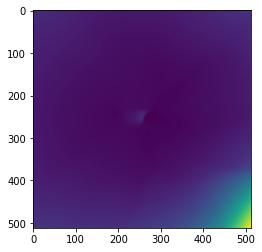

epoch 301: 64.04791259765625
epoch 302: 64.16559600830078
epoch 303: 62.241329193115234
epoch 304: 63.9141845703125
epoch 305: 63.687835693359375
epoch 306: 64.43901824951172
epoch 307: 64.54821014404297
epoch 308: 64.64385223388672
epoch 309: 66.82774353027344
epoch 311: 63.051143646240234
epoch 312: 65.24598693847656
epoch 313: 64.81378173828125
epoch 314: 65.42665100097656
epoch 315: 64.07077026367188
epoch 316: 64.22319030761719
epoch 317: 63.57699966430664
epoch 318: 64.16028594970703
epoch 319: 62.21497344970703
epoch 321: 62.07538986206055
epoch 322: 61.55259323120117
epoch 323: 61.5889892578125
epoch 324: 61.81591796875
epoch 325: 63.64970779418945
epoch 326: 65.35635375976562
epoch 327: 63.30712890625
epoch 328: 63.00154495239258
epoch 329: 64.49223327636719
epoch 331: 61.78041458129883
epoch 332: 62.381160736083984
epoch 333: 63.99854278564453
epoch 334: 62.50710678100586
epoch 335: 63.61204147338867
epoch 336: 63.59162902832031
epoch 337: 65.52328491210938
epoch 338: 62.2138

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



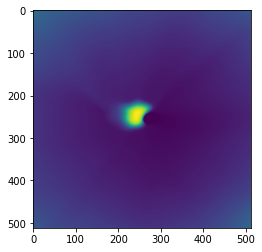

epoch 401: 65.07706451416016
epoch 402: 65.06169891357422
epoch 403: 62.83887481689453
epoch 404: 63.49470520019531
epoch 405: 60.790252685546875
epoch 406: 60.98884201049805
epoch 407: 62.07787322998047
epoch 408: 61.85554122924805
epoch 409: 62.078094482421875
epoch 411: 61.538089752197266
epoch 412: 61.3768196105957
epoch 413: 61.95846939086914
epoch 414: 63.86800765991211
epoch 415: 61.927894592285156
epoch 416: 61.736392974853516
epoch 417: 64.23954772949219
epoch 418: 63.745765686035156
epoch 419: 63.145050048828125
epoch 421: 63.17990493774414
epoch 422: 64.2137451171875
epoch 423: 62.879127502441406
epoch 424: 63.25379943847656
epoch 425: 61.70679473876953
epoch 426: 61.72710418701172
epoch 427: 62.4592399597168
epoch 428: 63.06193161010742
epoch 429: 63.295475006103516
epoch 431: 63.511680603027344
epoch 432: 61.09101104736328
epoch 433: 62.43305587768555
epoch 434: 60.06923294067383
epoch 435: 62.98189163208008
epoch 436: 62.34038543701172
epoch 437: 63.83659362792969
epoch 4

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



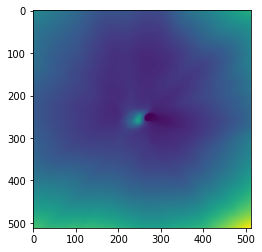

epoch 501: 60.52000045776367
epoch 502: 59.6816520690918
epoch 503: 60.152862548828125
epoch 504: 58.772727966308594
epoch 505: 60.56691360473633
epoch 506: 59.11079788208008
epoch 507: 60.02604675292969
epoch 508: 59.756229400634766
epoch 509: 59.72211456298828
epoch 511: 57.929439544677734
epoch 512: 58.42376708984375
epoch 513: 59.91582489013672
epoch 514: 57.24446105957031
epoch 515: 60.34835433959961
epoch 516: 58.73970413208008
epoch 517: 57.43104934692383
epoch 518: 60.31033706665039
epoch 519: 59.06671905517578
epoch 521: 58.241851806640625
epoch 522: 60.448150634765625
epoch 523: 58.80230712890625
epoch 524: 59.37615203857422
epoch 525: 58.98576736450195
epoch 526: 59.09975814819336
epoch 527: 59.182804107666016
epoch 528: 60.184200286865234
epoch 529: 58.470123291015625
epoch 531: 58.93022537231445
epoch 532: 59.15087890625
epoch 533: 60.409507751464844
epoch 534: 59.449520111083984
epoch 535: 57.53850555419922
epoch 536: 58.09534454345703
epoch 537: 59.5272331237793
epoch 53

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



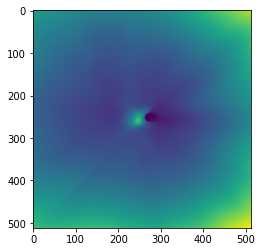

epoch 601: 57.67528533935547
epoch 602: 57.951263427734375
epoch 603: 58.104427337646484
epoch 604: 58.625064849853516
epoch 605: 59.8853645324707
epoch 606: 58.84318923950195
epoch 607: 58.810340881347656
epoch 608: 59.12355041503906
epoch 609: 56.946041107177734
epoch 611: 59.66321563720703
epoch 612: 59.618446350097656
epoch 613: 57.546329498291016
epoch 614: 57.301082611083984
epoch 615: 57.587738037109375
epoch 616: 57.778724670410156
epoch 617: 57.75763702392578
epoch 618: 57.3270149230957
epoch 619: 59.31017303466797
epoch 621: 56.707271575927734
epoch 622: 58.68547821044922
epoch 623: 57.484188079833984
epoch 624: 57.49114227294922
epoch 625: 58.0872802734375
epoch 626: 59.835750579833984
epoch 627: 57.59624099731445
epoch 628: 57.08424758911133
epoch 629: 57.95940017700195
epoch 631: 58.12297821044922
epoch 632: 58.4498405456543
epoch 633: 57.382259368896484
epoch 634: 58.339149475097656
epoch 635: 58.920494079589844
epoch 636: 58.547149658203125
epoch 637: 57.1951904296875
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



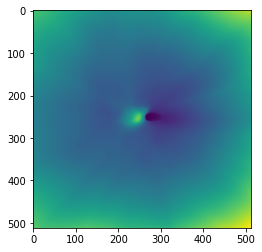

epoch 701: 58.3111686706543
epoch 702: 57.12871170043945
epoch 703: 58.23262023925781
epoch 704: 56.456111907958984
epoch 705: 56.56375503540039
epoch 706: 56.54713439941406
epoch 707: 57.11530303955078
epoch 708: 58.13632583618164
epoch 709: 57.47248077392578
epoch 711: 56.60472869873047
epoch 712: 58.12528610229492
epoch 713: 57.0699577331543
epoch 714: 57.930320739746094
epoch 715: 57.898372650146484
epoch 716: 57.551780700683594
epoch 717: 57.425357818603516
epoch 718: 57.10310363769531
epoch 719: 58.97425079345703
epoch 721: 58.54951858520508
epoch 722: 57.322261810302734
epoch 723: 57.45330810546875
epoch 724: 57.318397521972656
epoch 725: 57.285892486572266
epoch 726: 58.88433837890625
epoch 727: 58.68118667602539
epoch 728: 56.049861907958984
epoch 729: 57.754669189453125
epoch 731: 58.6679801940918
epoch 732: 58.16299819946289
epoch 733: 57.297576904296875
epoch 734: 57.10297393798828
epoch 735: 57.682716369628906
epoch 736: 56.625221252441406
epoch 737: 57.61732482910156
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



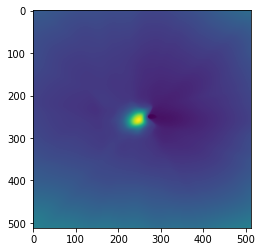

epoch 801: 58.48768615722656
epoch 802: 57.653839111328125
epoch 803: 56.849979400634766
epoch 804: 57.17536926269531
epoch 805: 58.610877990722656
epoch 806: 55.95163345336914
epoch 807: 56.723087310791016
epoch 808: 54.89661407470703
epoch 809: 58.27706527709961
epoch 811: 56.88282012939453
epoch 812: 56.53770065307617
epoch 813: 56.900787353515625
epoch 814: 55.965999603271484
epoch 815: 57.17826461791992
epoch 816: 55.352046966552734
epoch 817: 57.88944625854492
epoch 818: 57.73805236816406
epoch 819: 56.582679748535156
epoch 821: 56.65555191040039
epoch 822: 56.31630325317383
epoch 823: 56.1025276184082
epoch 824: 56.300689697265625
epoch 825: 56.2887077331543
epoch 826: 56.126644134521484
epoch 827: 56.9750862121582
epoch 828: 56.62421798706055
epoch 829: 56.25843048095703
epoch 831: 57.0179557800293
epoch 832: 55.68994140625
epoch 833: 56.142059326171875
epoch 834: 56.827484130859375
epoch 835: 55.29146194458008
epoch 836: 57.4168815612793
epoch 837: 55.5189094543457
epoch 838: 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



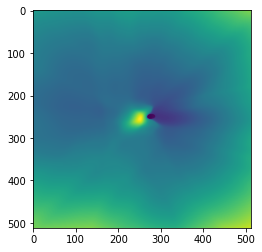

epoch 901: 57.88665008544922
epoch 902: 58.78721237182617
epoch 903: 57.039451599121094
epoch 904: 58.64432144165039
epoch 905: 58.207252502441406
epoch 906: 57.84539794921875
epoch 907: 58.836395263671875
epoch 908: 59.23624038696289
epoch 909: 57.54954528808594
epoch 911: 57.54164505004883
epoch 912: 57.61457824707031
epoch 913: 57.83704376220703
epoch 914: 55.22454833984375
epoch 915: 57.11583709716797
epoch 916: 57.57611083984375
epoch 917: 57.7335319519043
epoch 918: 55.733760833740234
epoch 919: 56.39603805541992
epoch 921: 57.27284622192383
epoch 922: 58.048248291015625
epoch 923: 57.69517517089844
epoch 924: 56.600791931152344
epoch 925: 55.98009490966797
epoch 926: 57.86705017089844
epoch 927: 56.88111114501953
epoch 928: 56.802772521972656
epoch 929: 57.471527099609375
epoch 931: 57.824920654296875
epoch 932: 55.455474853515625
epoch 933: 54.09886169433594
epoch 934: 56.44132614135742
epoch 935: 56.53807830810547
epoch 936: 56.36482238769531
epoch 937: 55.68137741088867
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



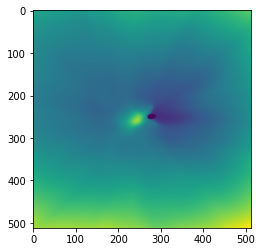

epoch 1001: 56.06434631347656
epoch 1002: 54.55134963989258
epoch 1003: 55.67515563964844
epoch 1004: 56.15602111816406
epoch 1005: 56.13611602783203
epoch 1006: 55.5753288269043
epoch 1007: 55.561893463134766
epoch 1008: 56.69731521606445
epoch 1009: 55.620723724365234
epoch 1011: 55.90755081176758
epoch 1012: 54.60948181152344
epoch 1013: 55.21836471557617
epoch 1014: 54.75508499145508
epoch 1015: 56.366050720214844
epoch 1016: 55.08851623535156
epoch 1017: 56.291847229003906
epoch 1018: 54.76447677612305
epoch 1019: 55.84828186035156
epoch 1021: 55.992103576660156
epoch 1022: 57.11048889160156
epoch 1023: 55.580745697021484
epoch 1024: 55.99563980102539
epoch 1025: 55.78779220581055
epoch 1026: 56.554100036621094
epoch 1027: 55.6181755065918
epoch 1028: 55.40949249267578
epoch 1029: 56.73457717895508
epoch 1031: 55.64887619018555
epoch 1032: 55.55064392089844
epoch 1033: 56.31301498413086
epoch 1034: 56.712162017822266
epoch 1035: 56.350791931152344
epoch 1036: 55.1183967590332
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



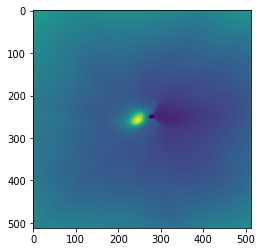

epoch 1101: 55.139408111572266
epoch 1102: 55.90487289428711
epoch 1103: 56.56007766723633
epoch 1104: 57.19025802612305
epoch 1105: 56.42444610595703
epoch 1106: 56.64232635498047
epoch 1107: 55.4925537109375
epoch 1108: 55.63747787475586
epoch 1109: 55.483619689941406
epoch 1111: 55.68376541137695
epoch 1112: 55.37908935546875
epoch 1113: 54.22614669799805
epoch 1114: 55.64275360107422
epoch 1115: 54.726715087890625
epoch 1116: 56.37380599975586
epoch 1117: 55.50946044921875
epoch 1118: 55.10742950439453
epoch 1119: 55.99549102783203
epoch 1121: 55.57464599609375
epoch 1122: 56.9786376953125
epoch 1123: 55.059242248535156
epoch 1124: 55.01177978515625
epoch 1125: 55.25761413574219
epoch 1126: 55.76206588745117
epoch 1127: 56.180233001708984
epoch 1128: 55.00703048706055
epoch 1129: 55.920936584472656
epoch 1131: 56.733978271484375
epoch 1132: 55.54701232910156
epoch 1133: 56.65378952026367
epoch 1134: 56.87626266479492
epoch 1135: 55.41429138183594
epoch 1136: 54.65542984008789
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



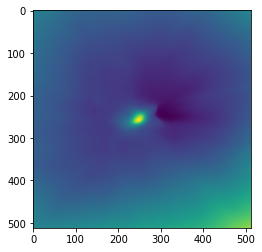

epoch 1201: 54.24686813354492
epoch 1202: 54.89862823486328
epoch 1203: 55.267826080322266
epoch 1204: 54.11225891113281
epoch 1205: 54.93876647949219
epoch 1206: 55.8652458190918
epoch 1207: 54.401023864746094
epoch 1208: 55.15798568725586
epoch 1209: 55.571205139160156
epoch 1211: 57.05379867553711
epoch 1212: 55.78055191040039
epoch 1213: 56.31064987182617
epoch 1214: 55.19149398803711
epoch 1215: 57.396385192871094
epoch 1216: 55.65604019165039
epoch 1217: 55.53398513793945
epoch 1218: 55.77510070800781
epoch 1219: 56.8751220703125
epoch 1221: 55.667884826660156
epoch 1222: 54.963348388671875
epoch 1223: 54.02010726928711
epoch 1224: 55.53083801269531
epoch 1225: 55.031944274902344
epoch 1226: 56.25584411621094
epoch 1227: 55.27785110473633
epoch 1228: 55.538658142089844
epoch 1229: 55.811927795410156
epoch 1231: 56.28693389892578
epoch 1232: 53.20740509033203
epoch 1233: 54.29082489013672
epoch 1234: 55.65964889526367
epoch 1235: 55.31310272216797
epoch 1236: 54.84159469604492
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



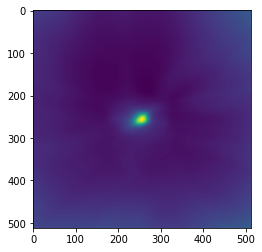

epoch 1301: 54.23872375488281
epoch 1302: 55.049888610839844
epoch 1303: 53.61595916748047
epoch 1304: 55.136871337890625
epoch 1305: 55.14307403564453
epoch 1306: 54.918121337890625
epoch 1307: 54.52435302734375
epoch 1308: 55.33247375488281
epoch 1309: 56.26749801635742
epoch 1311: 57.049774169921875
epoch 1312: 55.958038330078125
epoch 1313: 56.08580780029297
epoch 1314: 54.821495056152344
epoch 1315: 54.80580139160156
epoch 1316: 53.73058319091797
epoch 1317: 55.410919189453125
epoch 1318: 54.20603942871094
epoch 1319: 54.96165466308594
epoch 1321: 54.84514617919922
epoch 1322: 53.94549560546875
epoch 1323: 53.621334075927734
epoch 1324: 53.870784759521484
epoch 1325: 54.593597412109375
epoch 1326: 53.173484802246094
epoch 1327: 54.03333282470703
epoch 1328: 56.29888153076172
epoch 1329: 53.45054244995117
epoch 1331: 54.32832336425781
epoch 1332: 54.31504440307617
epoch 1333: 53.7956428527832
epoch 1334: 54.600303649902344
epoch 1335: 55.011680603027344
epoch 1336: 55.0815467834472

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



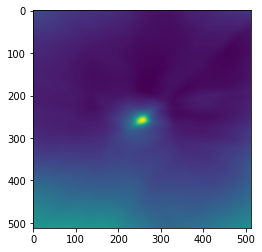

epoch 1401: 53.58955383300781
epoch 1402: 55.9627799987793
epoch 1403: 55.617835998535156
epoch 1404: 54.7142333984375
epoch 1405: 53.60199737548828
epoch 1406: 54.5524787902832
epoch 1407: 55.03617477416992
epoch 1408: 54.38840103149414
epoch 1409: 54.477561950683594
epoch 1411: 55.95321273803711
epoch 1412: 54.65435028076172
epoch 1413: 54.61294174194336
epoch 1414: 54.69769287109375
epoch 1415: 56.01463317871094
epoch 1416: 54.98176956176758
epoch 1417: 54.488914489746094
epoch 1418: 55.252723693847656
epoch 1419: 53.61727523803711
epoch 1421: 53.51930618286133
epoch 1422: 53.930545806884766
epoch 1423: 53.43111038208008
epoch 1424: 53.67038345336914
epoch 1425: 54.16522216796875
epoch 1426: 54.49052047729492
epoch 1427: 54.455299377441406
epoch 1428: 54.41314697265625
epoch 1429: 54.0547981262207
epoch 1431: 53.909568786621094
epoch 1432: 55.55411911010742
epoch 1433: 53.21598434448242
epoch 1434: 54.319664001464844
epoch 1435: 53.91388702392578
epoch 1436: 53.6074104309082
epoch 1

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



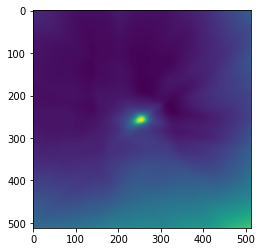

epoch 1501: 54.97512435913086
epoch 1502: 54.712745666503906
epoch 1503: 53.471031188964844
epoch 1504: 54.5853385925293
epoch 1505: 54.6986198425293
epoch 1506: 52.88938903808594
epoch 1507: 54.25167465209961
epoch 1508: 53.11148452758789
epoch 1509: 53.86107635498047
epoch 1511: 53.47452163696289
epoch 1512: 54.75162887573242
epoch 1513: 53.36046600341797
epoch 1514: 54.04228591918945
epoch 1515: 54.55853271484375
epoch 1516: 55.72314453125
epoch 1517: 54.90351486206055
epoch 1518: 55.34136962890625
epoch 1519: 56.09425354003906
epoch 1521: 54.807579040527344
epoch 1522: 54.20879364013672
epoch 1523: 55.43220138549805
epoch 1524: 54.05940628051758
epoch 1525: 54.17922592163086
epoch 1526: 53.896400451660156
epoch 1527: 54.82596969604492
epoch 1528: 55.106021881103516
epoch 1529: 53.937931060791016
epoch 1531: 53.63459777832031
epoch 1532: 54.465362548828125
epoch 1533: 54.03770446777344
epoch 1534: 53.7006950378418
epoch 1535: 54.42557144165039
epoch 1536: 54.980804443359375
epoch 15

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



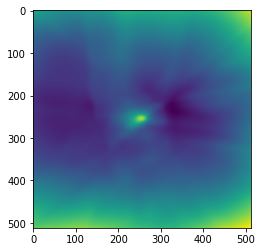

epoch 1601: 52.569976806640625
epoch 1602: 53.36311721801758
epoch 1603: 51.85565948486328
epoch 1604: 52.31789016723633
epoch 1605: 53.05568313598633
epoch 1606: 52.66773223876953
epoch 1607: 53.224483489990234
epoch 1608: 52.92564392089844
epoch 1609: 54.461673736572266
epoch 1611: 51.416046142578125
epoch 1612: 53.325260162353516
epoch 1613: 53.45761489868164
epoch 1614: 52.11689376831055
epoch 1615: 53.27568054199219
epoch 1616: 53.42768096923828
epoch 1617: 52.51113510131836
epoch 1618: 53.34904479980469
epoch 1619: 52.94144058227539
epoch 1621: 52.01824951171875
epoch 1622: 53.64698791503906
epoch 1623: 52.76640701293945
epoch 1624: 53.67551040649414
epoch 1625: 53.74257278442383
epoch 1626: 53.39921951293945
epoch 1627: 52.806556701660156
epoch 1628: 53.72597122192383
epoch 1629: 52.919647216796875
epoch 1631: 54.017276763916016
epoch 1632: 53.19500732421875
epoch 1633: 53.54267883300781
epoch 1634: 54.39107894897461
epoch 1635: 52.87468719482422
epoch 1636: 52.233970642089844
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



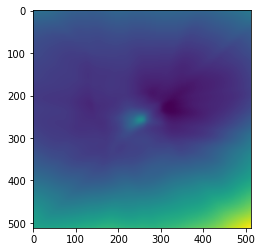

epoch 1701: 53.18415069580078
epoch 1702: 52.813880920410156
epoch 1703: 54.17781066894531
epoch 1704: 53.53607940673828
epoch 1705: 53.684410095214844
epoch 1706: 52.969093322753906
epoch 1707: 54.646297454833984
epoch 1708: 53.20804977416992
epoch 1709: 53.31886291503906
epoch 1711: 54.089439392089844
epoch 1712: 53.062992095947266
epoch 1713: 53.55107498168945
epoch 1714: 53.092079162597656
epoch 1715: 52.207427978515625
epoch 1716: 53.215858459472656
epoch 1717: 52.83100891113281
epoch 1718: 52.57501983642578
epoch 1719: 52.033748626708984
epoch 1721: 54.115596771240234
epoch 1722: 54.28458786010742
epoch 1723: 52.531890869140625
epoch 1724: 53.173866271972656
epoch 1725: 53.50624465942383
epoch 1726: 53.2264518737793
epoch 1727: 54.40180587768555
epoch 1728: 51.947879791259766
epoch 1729: 53.53512191772461
epoch 1731: 53.104637145996094
epoch 1732: 53.261173248291016
epoch 1733: 52.23891067504883
epoch 1734: 52.96082305908203
epoch 1735: 54.11438751220703
epoch 1736: 53.5856590270

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



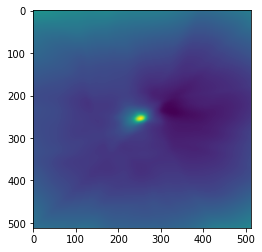

epoch 1801: 52.989013671875
epoch 1802: 54.59432601928711
epoch 1803: 52.80137634277344
epoch 1804: 53.616607666015625
epoch 1805: 53.513916015625
epoch 1806: 54.471778869628906
epoch 1807: 52.958438873291016
epoch 1808: 51.63533020019531
epoch 1809: 52.88062286376953
epoch 1811: 52.68510818481445
epoch 1812: 53.04114532470703
epoch 1813: 53.04352569580078
epoch 1814: 52.783409118652344
epoch 1815: 53.469932556152344
epoch 1816: 52.28126525878906
epoch 1817: 51.87410354614258
epoch 1818: 52.34366989135742
epoch 1819: 52.206398010253906
epoch 1821: 51.81934356689453
epoch 1822: 52.38178253173828
epoch 1823: 51.12609100341797
epoch 1824: 52.351993560791016
epoch 1825: 51.630584716796875
epoch 1826: 53.25524139404297
epoch 1827: 53.334102630615234
epoch 1828: 51.813209533691406
epoch 1829: 51.64189910888672
epoch 1831: 52.335105895996094
epoch 1832: 52.92462921142578
epoch 1833: 52.615821838378906
epoch 1834: 51.6004638671875
epoch 1835: 51.55678176879883
epoch 1836: 52.84605026245117
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



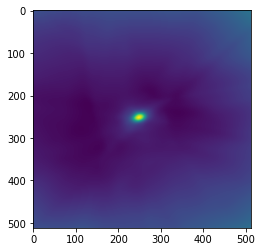

epoch 1901: 52.06499099731445
epoch 1902: 53.05604553222656
epoch 1903: 52.49177169799805
epoch 1904: 52.53971862792969
epoch 1905: 52.476715087890625
epoch 1906: 51.7639045715332
epoch 1907: 52.67850875854492
epoch 1908: 52.76335906982422
epoch 1909: 52.847503662109375
epoch 1911: 53.22828674316406
epoch 1912: 53.06375503540039
epoch 1913: 52.27771759033203
epoch 1914: 54.07136535644531
epoch 1915: 50.37398910522461
epoch 1916: 51.889373779296875
epoch 1917: 52.01416778564453
epoch 1918: 53.55023193359375
epoch 1919: 50.925533294677734
epoch 1921: 54.1923713684082
epoch 1922: 53.775211334228516
epoch 1923: 52.62173080444336
epoch 1924: 53.624935150146484
epoch 1925: 52.93413162231445
epoch 1926: 52.27857971191406
epoch 1927: 52.318702697753906
epoch 1928: 52.98538589477539
epoch 1929: 53.890953063964844
epoch 1931: 52.15949630737305
epoch 1932: 53.634437561035156
epoch 1933: 53.45183563232422
epoch 1934: 53.06390380859375
epoch 1935: 53.6665153503418
epoch 1936: 51.88502502441406
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



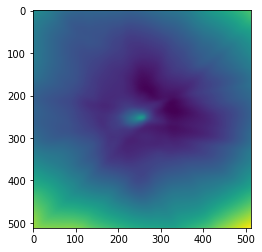

epoch 2001: 54.43659210205078
epoch 2002: 52.378135681152344
epoch 2003: 52.538551330566406
epoch 2004: 53.212646484375
epoch 2005: 53.81827926635742
epoch 2006: 51.50295639038086
epoch 2007: 53.34376525878906
epoch 2008: 52.90225601196289
epoch 2009: 53.075984954833984
epoch 2011: 52.125789642333984
epoch 2012: 52.91044616699219
epoch 2013: 52.06912612915039
epoch 2014: 52.073646545410156
epoch 2015: 52.63846206665039
epoch 2016: 51.66959762573242
epoch 2017: 52.718284606933594
epoch 2018: 54.03871154785156
epoch 2019: 52.71784210205078
epoch 2021: 51.84072494506836
epoch 2022: 53.155757904052734
epoch 2023: 53.073753356933594
epoch 2024: 52.91865158081055
epoch 2025: 52.737098693847656
epoch 2026: 53.323394775390625
epoch 2027: 51.93522644042969
epoch 2028: 52.474910736083984
epoch 2029: 53.24913024902344
epoch 2031: 52.51000213623047
epoch 2032: 52.261661529541016
epoch 2033: 53.43657684326172
epoch 2034: 52.47995376586914
epoch 2035: 52.22047424316406
epoch 2036: 54.26511001586914


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



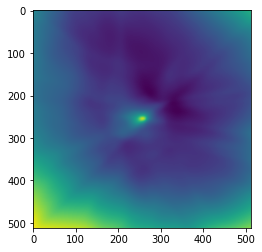

epoch 2101: 52.24360656738281
epoch 2102: 53.23390197753906
epoch 2103: 52.006202697753906
epoch 2104: 51.60615921020508
epoch 2105: 51.564395904541016
epoch 2106: 52.794883728027344
epoch 2107: 52.040191650390625
epoch 2108: 52.33952713012695
epoch 2109: 51.61573791503906
epoch 2111: 53.14156723022461
epoch 2112: 52.7472038269043
epoch 2113: 52.748172760009766
epoch 2114: 53.246002197265625
epoch 2115: 52.45732879638672
epoch 2116: 52.660369873046875
epoch 2117: 52.68488311767578
epoch 2118: 52.230430603027344
epoch 2119: 52.19401168823242
epoch 2121: 52.24290466308594
epoch 2122: 51.55287170410156
epoch 2123: 51.410499572753906
epoch 2124: 52.286373138427734
epoch 2125: 52.58058166503906
epoch 2126: 51.322486877441406
epoch 2127: 51.864994049072266
epoch 2128: 52.186607360839844
epoch 2129: 52.285377502441406
epoch 2131: 51.721717834472656
epoch 2132: 51.14396667480469
epoch 2133: 52.126216888427734
epoch 2134: 52.10823059082031
epoch 2135: 51.99763488769531
epoch 2136: 52.3381423950

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



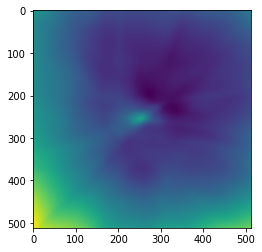

epoch 2201: 53.459407806396484
epoch 2202: 52.44321060180664
epoch 2203: 52.56980895996094
epoch 2204: 51.87347412109375
epoch 2205: 52.49460220336914
epoch 2206: 52.65132522583008
epoch 2207: 52.3531494140625
epoch 2208: 51.05767822265625
epoch 2209: 52.268577575683594
epoch 2211: 53.456809997558594
epoch 2212: 51.735870361328125
epoch 2213: 52.60139465332031
epoch 2214: 52.21661376953125
epoch 2215: 53.456382751464844
epoch 2216: 51.73359298706055
epoch 2217: 51.82790756225586
epoch 2218: 51.863800048828125
epoch 2219: 51.76545715332031
epoch 2221: 51.989532470703125
epoch 2222: 53.275943756103516
epoch 2223: 53.529457092285156
epoch 2224: 52.044124603271484
epoch 2225: 52.18632507324219
epoch 2226: 52.69621658325195
epoch 2227: 52.18671798706055
epoch 2228: 50.932247161865234
epoch 2229: 52.11900329589844
epoch 2231: 52.10141372680664
epoch 2232: 51.83618927001953
epoch 2233: 51.51515197753906
epoch 2234: 51.33147048950195
epoch 2235: 51.73513412475586
epoch 2236: 52.60688400268555


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



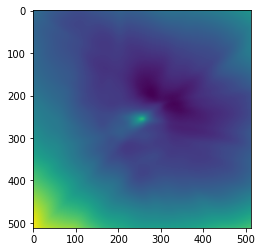

epoch 2301: 52.91297912597656
epoch 2302: 51.7016716003418
epoch 2303: 51.47622299194336
epoch 2304: 51.100921630859375
epoch 2305: 51.34805679321289
epoch 2306: 52.89881896972656
epoch 2307: 52.5515022277832
epoch 2308: 51.94203567504883
epoch 2309: 52.42941665649414
epoch 2311: 52.619754791259766
epoch 2312: 52.42206573486328
epoch 2313: 52.98493957519531
epoch 2314: 52.12260055541992
epoch 2315: 51.71905517578125
epoch 2316: 51.311553955078125
epoch 2317: 50.65393829345703
epoch 2318: 50.575950622558594
epoch 2319: 52.74393081665039
epoch 2321: 51.69307327270508
epoch 2322: 51.39129638671875
epoch 2323: 50.792236328125
epoch 2324: 52.7380485534668
epoch 2325: 50.934104919433594
epoch 2326: 52.811126708984375
epoch 2327: 51.59601593017578
epoch 2328: 51.93339920043945
epoch 2329: 51.395233154296875
epoch 2331: 52.10547637939453
epoch 2332: 52.89063262939453
epoch 2333: 52.39754867553711
epoch 2334: 52.065494537353516
epoch 2335: 51.378761291503906
epoch 2336: 52.89655685424805
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



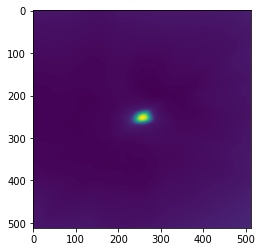

epoch 2401: 52.88206481933594
epoch 2402: 51.518310546875
epoch 2403: 52.48954391479492
epoch 2404: 52.103492736816406
epoch 2405: 52.15871810913086
epoch 2406: 51.92999267578125
epoch 2407: 54.3377799987793
epoch 2408: 53.19089889526367
epoch 2409: 52.20743179321289
epoch 2411: 52.54399490356445
epoch 2412: 52.80464553833008
epoch 2413: 52.630985260009766
epoch 2414: 52.46480178833008
epoch 2415: 52.27437210083008
epoch 2416: 52.20954895019531
epoch 2417: 52.615943908691406
epoch 2418: 53.095035552978516
epoch 2419: 50.88604736328125
epoch 2421: 51.835906982421875
epoch 2422: 51.44023895263672
epoch 2423: 52.43705749511719
epoch 2424: 53.29960632324219
epoch 2425: 51.9685173034668
epoch 2426: 52.60492706298828
epoch 2427: 52.636173248291016
epoch 2428: 51.5334358215332
epoch 2429: 52.092529296875
epoch 2431: 53.09098434448242
epoch 2432: 52.545005798339844
epoch 2433: 52.91683578491211
epoch 2434: 52.87159729003906
epoch 2435: 52.11903381347656
epoch 2436: 53.03073501586914
epoch 2437

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



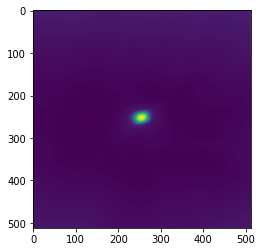

epoch 2501: 52.03960418701172
epoch 2502: 52.297245025634766
epoch 2503: 51.803836822509766
epoch 2504: 51.4142951965332
epoch 2505: 51.483802795410156
epoch 2506: 52.186519622802734
epoch 2507: 52.51750564575195
epoch 2508: 52.507972717285156
epoch 2509: 51.093170166015625
epoch 2511: 50.47398376464844
epoch 2512: 51.21747589111328
epoch 2513: 51.53212356567383
epoch 2514: 52.194114685058594
epoch 2515: 50.81712341308594
epoch 2516: 53.22481155395508
epoch 2517: 51.18759536743164
epoch 2518: 53.235015869140625
epoch 2519: 51.33604431152344
epoch 2521: 52.838287353515625
epoch 2522: 52.860748291015625
epoch 2523: 52.383487701416016
epoch 2524: 52.070926666259766
epoch 2525: 52.121734619140625
epoch 2526: 52.63946533203125
epoch 2527: 51.88412094116211
epoch 2528: 52.28350067138672
epoch 2529: 50.963584899902344
epoch 2531: 52.61280822753906
epoch 2532: 52.405845642089844
epoch 2533: 52.24046325683594
epoch 2534: 51.148109436035156
epoch 2535: 51.7818717956543
epoch 2536: 52.12444686889

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



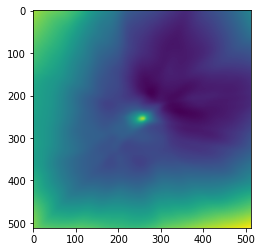

epoch 2601: 51.132659912109375
epoch 2602: 52.259342193603516
epoch 2603: 51.57119369506836
epoch 2604: 51.32063674926758
epoch 2605: 51.82200241088867
epoch 2606: 51.39586639404297
epoch 2607: 51.44610595703125
epoch 2608: 51.42343521118164
epoch 2609: 52.70759582519531
epoch 2611: 51.1293830871582
epoch 2612: 51.7620735168457
epoch 2613: 51.108951568603516
epoch 2614: 51.25631332397461
epoch 2615: 52.712867736816406
epoch 2616: 51.052154541015625
epoch 2617: 52.15959167480469
epoch 2618: 51.326637268066406
epoch 2619: 51.66474151611328
epoch 2621: 51.997039794921875
epoch 2622: 51.557804107666016
epoch 2623: 52.43277359008789
epoch 2624: 52.79833984375
epoch 2625: 52.72304153442383
epoch 2626: 52.16800308227539
epoch 2627: 51.91044616699219
epoch 2628: 51.60469055175781
epoch 2629: 51.73911666870117
epoch 2631: 51.968624114990234
epoch 2632: 52.163047790527344
epoch 2633: 52.02680587768555
epoch 2634: 51.68357849121094
epoch 2635: 51.20888137817383
epoch 2636: 53.969093322753906
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



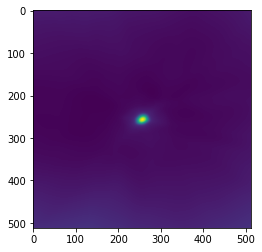

epoch 2701: 51.30604553222656
epoch 2702: 51.31678009033203
epoch 2703: 52.0528564453125
epoch 2704: 51.958824157714844
epoch 2705: 52.12765121459961
epoch 2706: 52.411495208740234
epoch 2707: 51.60071563720703
epoch 2708: 52.58538818359375
epoch 2709: 52.35135269165039
epoch 2711: 51.50571823120117
epoch 2712: 51.331199645996094
epoch 2713: 53.080711364746094
epoch 2714: 53.45841598510742
epoch 2715: 51.385520935058594
epoch 2716: 53.17091751098633
epoch 2717: 51.13529586791992
epoch 2718: 52.98038101196289
epoch 2719: 52.79096984863281
epoch 2721: 51.994388580322266
epoch 2722: 51.83555221557617
epoch 2723: 51.90644454956055
epoch 2724: 52.33186340332031
epoch 2725: 51.80015563964844
epoch 2726: 51.81155014038086
epoch 2727: 52.7646598815918
epoch 2728: 52.136138916015625
epoch 2729: 52.037376403808594
epoch 2731: 51.687034606933594
epoch 2732: 51.577430725097656
epoch 2733: 51.10577392578125
epoch 2734: 50.58938217163086
epoch 2735: 51.100250244140625
epoch 2736: 51.3785400390625
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



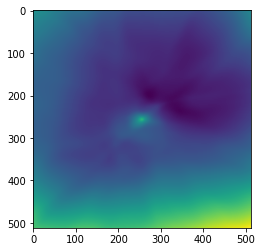

epoch 2801: 52.24083709716797
epoch 2802: 52.28997039794922
epoch 2803: 50.56825256347656
epoch 2804: 51.22123718261719
epoch 2805: 51.92853927612305
epoch 2806: 52.093605041503906
epoch 2807: 52.18830871582031
epoch 2808: 51.978694915771484
epoch 2809: 51.61410140991211
epoch 2811: 50.990169525146484
epoch 2812: 51.46251678466797
epoch 2813: 51.863704681396484
epoch 2814: 52.99053192138672
epoch 2815: 51.221702575683594
epoch 2816: 51.86265182495117
epoch 2817: 51.29846954345703
epoch 2818: 52.03701400756836
epoch 2819: 52.27177810668945
epoch 2821: 52.91608428955078
epoch 2822: 51.28265380859375
epoch 2823: 50.91189193725586
epoch 2824: 51.5584716796875
epoch 2825: 52.39464569091797
epoch 2826: 51.08519744873047
epoch 2827: 52.920127868652344
epoch 2828: 50.9747200012207
epoch 2829: 51.84227752685547
epoch 2831: 51.26980972290039
epoch 2832: 51.93077087402344
epoch 2833: 52.641666412353516
epoch 2834: 52.33344268798828
epoch 2835: 51.25345230102539
epoch 2836: 52.22999572753906
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



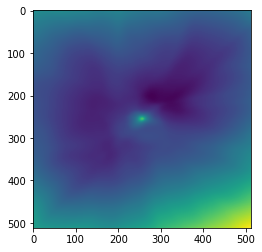

epoch 2901: 51.88854217529297
epoch 2902: 52.16130065917969
epoch 2903: 51.52901840209961
epoch 2904: 53.539432525634766
epoch 2905: 51.485687255859375
epoch 2906: 53.55220031738281
epoch 2907: 51.7086296081543
epoch 2908: 53.17610168457031
epoch 2909: 53.01995849609375
epoch 2911: 53.62919616699219
epoch 2912: 55.243858337402344
epoch 2913: 52.435115814208984
epoch 2914: 53.230892181396484
epoch 2915: 53.20255661010742
epoch 2916: 52.57636642456055
epoch 2917: 53.92736053466797
epoch 2918: 52.53295135498047
epoch 2919: 54.23631286621094
epoch 2921: 53.24055480957031
epoch 2922: 52.961219787597656
epoch 2923: 51.52387619018555
epoch 2924: 52.089820861816406
epoch 2925: 51.787567138671875
epoch 2926: 53.71235275268555
epoch 2927: 51.408294677734375
epoch 2928: 53.77488327026367
epoch 2929: 53.130531311035156
epoch 2931: 51.88610076904297
epoch 2932: 52.784690856933594
epoch 2933: 52.78993606567383
epoch 2934: 53.24628448486328
epoch 2935: 51.85041046142578
epoch 2936: 54.09056091308594


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



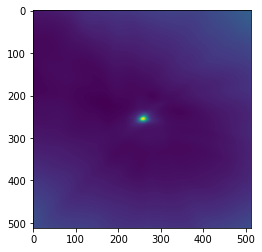

epoch 3001: 51.78214645385742
epoch 3002: 52.813716888427734
epoch 3003: 52.45600128173828
epoch 3004: 51.90005111694336
epoch 3005: 52.467342376708984
epoch 3006: 51.69538116455078
epoch 3007: 53.031978607177734
epoch 3008: 52.53083801269531
epoch 3009: 52.594051361083984
epoch 3011: 53.20774459838867
epoch 3012: 51.732696533203125
epoch 3013: 51.440773010253906
epoch 3014: 53.51985549926758
epoch 3015: 52.075462341308594
epoch 3016: 50.8267707824707
epoch 3017: 52.18088150024414
epoch 3018: 52.616912841796875
epoch 3019: 51.50497817993164
epoch 3021: 51.592529296875
epoch 3022: 51.80813217163086
epoch 3023: 50.980133056640625
epoch 3024: 50.9481086730957
epoch 3025: 50.79319381713867
epoch 3026: 50.76755905151367
epoch 3027: 51.24214172363281
epoch 3028: 50.88817596435547
epoch 3029: 52.68733215332031
epoch 3031: 52.093223571777344
epoch 3032: 51.85332489013672
epoch 3033: 51.29973220825195
epoch 3034: 52.3849983215332
epoch 3035: 52.228355407714844
epoch 3036: 50.6065673828125
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



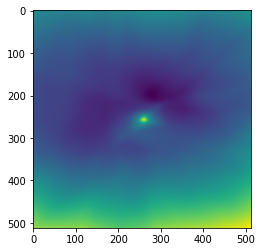

epoch 3101: 50.407676696777344
epoch 3102: 51.92702865600586
epoch 3103: 50.75383758544922
epoch 3104: 51.78049087524414
epoch 3105: 50.596553802490234
epoch 3106: 50.39167785644531
epoch 3107: 50.24106979370117
epoch 3108: 49.94892501831055
epoch 3109: 51.42195129394531
epoch 3111: 50.483943939208984
epoch 3112: 52.57427978515625
epoch 3113: 50.731964111328125
epoch 3114: 51.498779296875
epoch 3115: 50.8616828918457
epoch 3116: 50.80511474609375
epoch 3117: 51.80318832397461
epoch 3118: 52.95586013793945
epoch 3119: 52.94962692260742
epoch 3121: 50.45640182495117
epoch 3122: 50.258060455322266
epoch 3123: 50.00032424926758
epoch 3124: 50.71955871582031
epoch 3125: 51.688175201416016
epoch 3126: 52.9044303894043
epoch 3127: 51.61911392211914
epoch 3128: 51.08368682861328
epoch 3129: 52.440006256103516
epoch 3131: 51.39350509643555
epoch 3132: 52.8946647644043
epoch 3133: 50.64916229248047
epoch 3134: 52.92928695678711
epoch 3135: 51.335731506347656
epoch 3136: 50.44898223876953
epoch 3

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



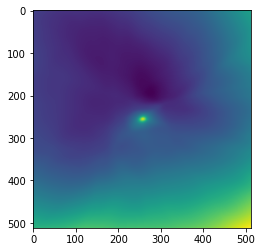

epoch 3201: 52.2122802734375
epoch 3202: 51.21415710449219
epoch 3203: 51.36616134643555
epoch 3204: 51.31430435180664
epoch 3205: 51.03008270263672
epoch 3206: 51.221221923828125
epoch 3207: 51.42925262451172
epoch 3208: 51.763248443603516
epoch 3209: 51.842079162597656
epoch 3211: 52.25831604003906
epoch 3212: 51.83857727050781
epoch 3213: 51.6740608215332
epoch 3214: 51.67042541503906
epoch 3215: 50.90779113769531
epoch 3216: 51.667030334472656
epoch 3217: 50.87798309326172
epoch 3218: 50.300697326660156
epoch 3219: 52.018760681152344
epoch 3221: 51.04835510253906
epoch 3222: 50.84250259399414
epoch 3223: 52.658016204833984
epoch 3224: 51.45562744140625
epoch 3225: 50.588565826416016
epoch 3226: 52.267845153808594
epoch 3227: 51.24620819091797
epoch 3228: 51.59846496582031
epoch 3229: 51.86972427368164
epoch 3231: 51.153724670410156
epoch 3232: 50.64970016479492
epoch 3233: 52.2567024230957
epoch 3234: 51.57917785644531
epoch 3235: 52.122276306152344
epoch 3236: 51.44733810424805
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



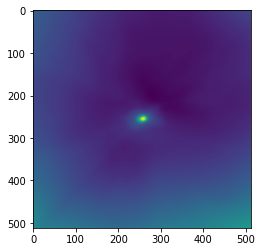

epoch 3301: 51.82035827636719
epoch 3302: 51.29202651977539
epoch 3303: 51.62813949584961
epoch 3304: 51.83327102661133
epoch 3305: 51.476219177246094
epoch 3306: 52.56423568725586
epoch 3307: 51.44645690917969
epoch 3308: 51.00542449951172
epoch 3309: 52.479591369628906
epoch 3311: 51.04875564575195
epoch 3312: 51.04636001586914
epoch 3313: 50.75824737548828
epoch 3314: 52.0750732421875
epoch 3315: 51.97919464111328
epoch 3316: 51.54216003417969
epoch 3317: 51.329410552978516
epoch 3318: 51.71971130371094
epoch 3319: 51.88813400268555
epoch 3321: 52.209556579589844
epoch 3322: 51.29709243774414
epoch 3323: 51.94709396362305
epoch 3324: 52.11712646484375
epoch 3325: 52.17207336425781
epoch 3326: 51.78656768798828
epoch 3327: 51.92616653442383
epoch 3328: 52.65616226196289
epoch 3329: 51.8680419921875
epoch 3331: 51.146305084228516
epoch 3332: 52.167076110839844
epoch 3333: 53.494049072265625
epoch 3334: 51.51548767089844
epoch 3335: 52.13475799560547
epoch 3336: 51.72296142578125
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



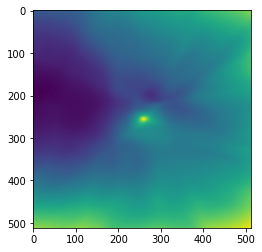

epoch 3401: 52.60456085205078
epoch 3402: 51.437347412109375
epoch 3403: 51.256797790527344
epoch 3404: 50.76909637451172
epoch 3405: 51.23729705810547
epoch 3406: 51.17067337036133
epoch 3407: 51.83467483520508
epoch 3408: 51.06481170654297
epoch 3409: 52.39137268066406
epoch 3411: 50.476287841796875
epoch 3412: 51.77412414550781
epoch 3413: 50.138431549072266
epoch 3414: 51.01361083984375
epoch 3415: 51.64552307128906
epoch 3416: 50.524715423583984
epoch 3417: 52.657169342041016
epoch 3418: 50.37660217285156
epoch 3419: 52.85078811645508
epoch 3421: 52.76704406738281
epoch 3422: 50.934349060058594
epoch 3423: 51.147708892822266
epoch 3424: 51.308372497558594
epoch 3425: 52.72501754760742
epoch 3426: 51.10099792480469
epoch 3427: 50.24567794799805
epoch 3428: 52.76869201660156
epoch 3429: 50.56072998046875
epoch 3431: 51.74659729003906
epoch 3432: 52.13815689086914
epoch 3433: 50.24729919433594
epoch 3434: 51.07888412475586
epoch 3435: 51.4188346862793
epoch 3436: 50.9482421875
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



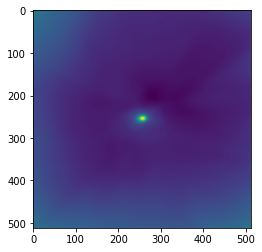

epoch 3501: 51.59943771362305
epoch 3502: 51.610652923583984
epoch 3503: 51.835365295410156
epoch 3504: 49.9091911315918
epoch 3505: 52.50386047363281
epoch 3506: 52.13105773925781
epoch 3507: 52.19771194458008
epoch 3508: 50.934242248535156
epoch 3509: 51.17044448852539
epoch 3511: 51.92338943481445
epoch 3512: 51.411216735839844
epoch 3513: 52.5778923034668
epoch 3514: 52.421329498291016
epoch 3515: 50.6291618347168
epoch 3516: 52.60325622558594
epoch 3517: 51.35068130493164
epoch 3518: 50.341304779052734
epoch 3519: 51.3831672668457
epoch 3521: 50.056854248046875
epoch 3522: 51.895877838134766
epoch 3523: 51.01670455932617
epoch 3524: 50.075321197509766
epoch 3525: 51.830318450927734
epoch 3526: 52.70644760131836
epoch 3527: 52.68992614746094
epoch 3528: 51.74820327758789
epoch 3529: 50.97280502319336
epoch 3531: 50.62477111816406
epoch 3532: 51.0312385559082
epoch 3533: 51.442440032958984
epoch 3534: 50.7720947265625
epoch 3535: 51.196434020996094
epoch 3536: 51.111881256103516
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



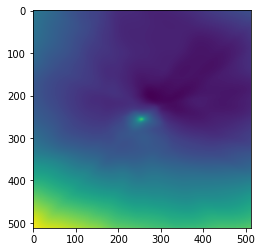

epoch 3601: 52.20442581176758
epoch 3602: 51.26373291015625
epoch 3603: 52.17024230957031
epoch 3604: 52.272308349609375
epoch 3605: 51.59600067138672
epoch 3606: 51.293174743652344
epoch 3607: 52.37101745605469
epoch 3608: 51.555030822753906
epoch 3609: 52.55459976196289
epoch 3611: 50.43294906616211
epoch 3612: 50.22557067871094
epoch 3613: 50.75761413574219
epoch 3614: 51.54698944091797
epoch 3615: 51.234886169433594
epoch 3616: 51.835025787353516
epoch 3617: 51.54946517944336
epoch 3618: 50.246089935302734
epoch 3619: 51.44143295288086
epoch 3621: 50.8492546081543
epoch 3622: 51.15782165527344
epoch 3623: 52.77683639526367
epoch 3624: 50.80242919921875
epoch 3625: 51.141231536865234
epoch 3626: 50.27617645263672
epoch 3627: 50.518882751464844
epoch 3628: 50.95665740966797
epoch 3629: 52.37428665161133
epoch 3631: 50.846229553222656
epoch 3632: 51.28275680541992
epoch 3633: 51.80274200439453
epoch 3634: 51.918174743652344
epoch 3635: 52.77582931518555
epoch 3636: 52.58982849121094
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



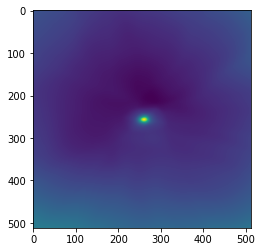

epoch 3701: 51.0307502746582
epoch 3702: 51.37963104248047
epoch 3703: 51.487972259521484
epoch 3704: 51.48824691772461
epoch 3705: 51.236305236816406
epoch 3706: 51.062862396240234
epoch 3707: 51.243377685546875
epoch 3708: 50.454566955566406
epoch 3709: 51.363033294677734
epoch 3711: 51.35942840576172
epoch 3712: 51.37834548950195
epoch 3713: 51.132171630859375
epoch 3714: 50.183719635009766
epoch 3715: 51.329105377197266
epoch 3716: 51.30318832397461
epoch 3717: 52.83640670776367
epoch 3718: 50.99800491333008
epoch 3719: 49.472267150878906
epoch 3721: 51.39126205444336
epoch 3722: 50.66044235229492
epoch 3723: 50.491416931152344
epoch 3724: 50.9663200378418
epoch 3725: 50.995147705078125
epoch 3726: 52.024200439453125
epoch 3727: 50.9871826171875
epoch 3728: 50.464111328125
epoch 3729: 50.143638610839844
epoch 3731: 51.256439208984375
epoch 3732: 51.26744842529297
epoch 3733: 50.555843353271484
epoch 3734: 50.741634368896484
epoch 3735: 51.98822784423828
epoch 3736: 51.5266418457031

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



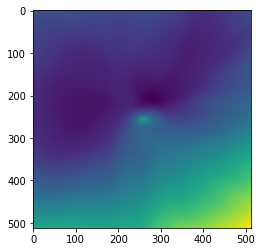

epoch 3801: 53.30462646484375
epoch 3802: 51.61786651611328
epoch 3803: 52.64212417602539
epoch 3804: 51.901153564453125
epoch 3805: 51.737003326416016
epoch 3806: 52.86153793334961
epoch 3807: 51.83278274536133
epoch 3808: 51.852596282958984
epoch 3809: 53.77886199951172
epoch 3811: 51.110748291015625
epoch 3812: 51.071266174316406
epoch 3813: 51.53874588012695
epoch 3814: 51.302860260009766
epoch 3815: 50.23221969604492
epoch 3816: 50.410282135009766
epoch 3817: 52.709999084472656
epoch 3818: 50.550777435302734
epoch 3819: 50.469112396240234
epoch 3821: 50.68294906616211
epoch 3822: 51.355812072753906
epoch 3823: 50.987632751464844
epoch 3824: 51.58251953125
epoch 3825: 51.0432243347168
epoch 3826: 50.71192169189453
epoch 3827: 52.140220642089844
epoch 3828: 52.06367492675781
epoch 3829: 54.18618392944336
epoch 3831: 51.924434661865234
epoch 3832: 51.73935317993164
epoch 3833: 51.60881423950195
epoch 3834: 50.593421936035156
epoch 3835: 51.207191467285156
epoch 3836: 51.0573272705078

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



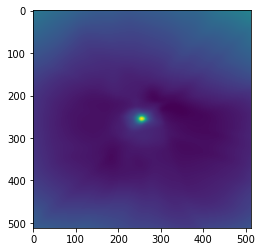

epoch 3901: 52.70271682739258
epoch 3902: 51.53921127319336
epoch 3903: 52.37841796875
epoch 3904: 51.558013916015625
epoch 3905: 52.009422302246094
epoch 3906: 52.02141571044922
epoch 3907: 51.59721374511719
epoch 3908: 50.9491081237793
epoch 3909: 51.41865539550781
epoch 3911: 51.71892547607422
epoch 3912: 51.47236251831055
epoch 3913: 50.709556579589844
epoch 3914: 52.46168518066406
epoch 3915: 49.987640380859375
epoch 3916: 50.465816497802734
epoch 3917: 51.544532775878906
epoch 3918: 51.64448928833008
epoch 3919: 51.30181884765625
epoch 3921: 51.17599868774414
epoch 3922: 52.09153747558594
epoch 3923: 50.399227142333984
epoch 3924: 50.3184700012207
epoch 3925: 50.3984260559082
epoch 3926: 52.9549446105957
epoch 3927: 51.53472137451172
epoch 3928: 50.81753921508789
epoch 3929: 50.71630096435547
epoch 3931: 50.07562255859375
epoch 3932: 51.048980712890625
epoch 3933: 52.874656677246094
epoch 3934: 50.94847106933594
epoch 3935: 52.050567626953125
epoch 3936: 51.04689025878906
epoch 3

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



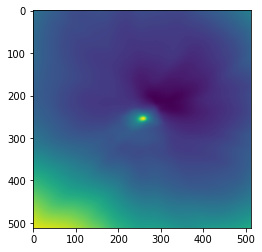

epoch 4001: 50.52546310424805
epoch 4002: 52.41298294067383
epoch 4003: 51.455322265625
epoch 4004: 50.9465446472168
epoch 4005: 51.57042694091797
epoch 4006: 51.089080810546875
epoch 4007: 51.58319091796875
epoch 4008: 52.095542907714844
epoch 4009: 51.16288757324219
epoch 4011: 51.902923583984375
epoch 4012: 51.39015579223633
epoch 4013: 51.31585693359375
epoch 4014: 52.32932662963867
epoch 4015: 51.98066711425781
epoch 4016: 52.032588958740234
epoch 4017: 51.378936767578125
epoch 4018: 52.98624038696289
epoch 4019: 50.95790481567383
epoch 4021: 53.34752655029297
epoch 4022: 52.402069091796875
epoch 4023: 55.22886276245117
epoch 4024: 51.589752197265625
epoch 4025: 52.40217208862305
epoch 4026: 50.63554000854492
epoch 4027: 51.10783767700195
epoch 4028: 52.93402099609375
epoch 4029: 51.93034362792969
epoch 4031: 52.37169647216797
epoch 4032: 53.14308166503906
epoch 4033: 51.355010986328125
epoch 4034: 52.25395584106445
epoch 4035: 52.754295349121094
epoch 4036: 52.94880676269531
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



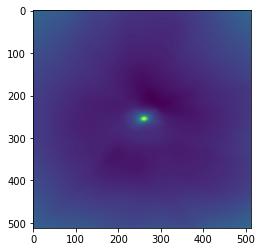

epoch 4101: 50.74998092651367
epoch 4102: 50.383907318115234
epoch 4103: 50.92481994628906
epoch 4104: 51.60103225708008
epoch 4105: 51.162017822265625
epoch 4106: 51.43584442138672
epoch 4107: 49.95210647583008
epoch 4108: 49.40571212768555
epoch 4109: 50.6528205871582
epoch 4111: 50.60717010498047
epoch 4112: 50.489906311035156
epoch 4113: 49.893646240234375
epoch 4114: 51.408447265625
epoch 4115: 50.82229995727539
epoch 4116: 51.97933578491211
epoch 4117: 50.714805603027344
epoch 4118: 50.82987594604492
epoch 4119: 50.28828048706055
epoch 4121: 51.3425407409668
epoch 4122: 51.46329116821289
epoch 4123: 50.60803985595703
epoch 4124: 50.33894348144531
epoch 4125: 52.875465393066406
epoch 4126: 50.08757781982422
epoch 4127: 50.272891998291016
epoch 4128: 50.49714660644531
epoch 4129: 52.81188201904297
epoch 4131: 51.21989059448242
epoch 4132: 54.00788497924805
epoch 4133: 52.40004348754883
epoch 4134: 52.01620864868164
epoch 4135: 51.29497146606445
epoch 4136: 51.47736740112305
epoch 4

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



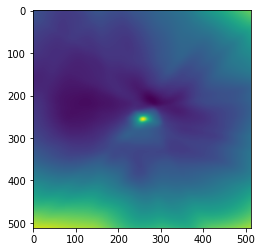

epoch 4201: 49.85877227783203
epoch 4202: 49.970394134521484
epoch 4203: 50.05619430541992
epoch 4204: 49.92821502685547
epoch 4205: 49.7386360168457
epoch 4206: 50.51509094238281
epoch 4207: 51.85436248779297
epoch 4208: 50.673858642578125
epoch 4209: 51.97880935668945
epoch 4211: 50.8167839050293
epoch 4212: 51.187400817871094
epoch 4213: 50.031681060791016
epoch 4214: 49.202449798583984
epoch 4215: 52.95005798339844
epoch 4216: 52.310386657714844
epoch 4217: 51.176395416259766
epoch 4218: 51.91805648803711
epoch 4219: 52.46596145629883
epoch 4221: 51.26005935668945
epoch 4222: 51.94003677368164
epoch 4223: 52.71397399902344
epoch 4224: 51.45890808105469
epoch 4225: 52.13315200805664
epoch 4226: 51.37950897216797
epoch 4227: 50.82005310058594
epoch 4228: 52.96714401245117
epoch 4229: 52.07341766357422
epoch 4231: 51.292423248291016
epoch 4232: 52.48618698120117
epoch 4233: 53.19231414794922
epoch 4234: 51.64275360107422
epoch 4235: 51.18197250366211
epoch 4236: 49.68819808959961
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



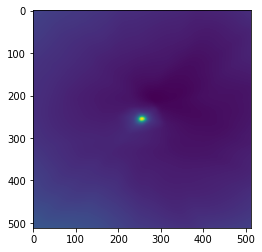

epoch 4301: 50.87285232543945
epoch 4302: 51.07061767578125
epoch 4303: 50.16084671020508
epoch 4304: 51.213111877441406
epoch 4305: 51.19919204711914
epoch 4306: 50.97023010253906
epoch 4307: 51.14240646362305
epoch 4308: 51.14342498779297
epoch 4309: 49.868778228759766
epoch 4311: 51.04924011230469
epoch 4312: 50.50663375854492
epoch 4313: 51.14192199707031
epoch 4314: 50.85668182373047
epoch 4315: 51.895469665527344
epoch 4316: 51.32706069946289
epoch 4317: 51.97791290283203
epoch 4318: 51.47979736328125
epoch 4319: 51.150146484375
epoch 4321: 51.99078369140625
epoch 4322: 51.939476013183594
epoch 4323: 54.554779052734375
epoch 4324: 51.62130355834961
epoch 4325: 52.720333099365234
epoch 4326: 51.858585357666016
epoch 4327: 51.87868118286133
epoch 4328: 51.51113510131836
epoch 4329: 52.20984649658203
epoch 4331: 52.20482635498047
epoch 4332: 51.31745147705078
epoch 4333: 53.554054260253906
epoch 4334: 52.07878112792969
epoch 4335: 53.124603271484375
epoch 4336: 52.209136962890625
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



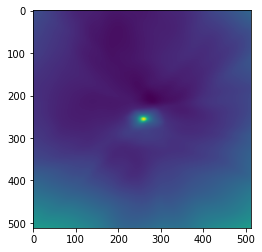

epoch 4401: 51.545921325683594
epoch 4402: 50.64912414550781
epoch 4403: 50.4340705871582
epoch 4404: 51.0234375
epoch 4405: 49.833648681640625
epoch 4406: 50.669795989990234
epoch 4407: 50.90580749511719
epoch 4408: 50.70977020263672
epoch 4409: 49.34233474731445
epoch 4411: 50.96742248535156
epoch 4412: 50.514244079589844
epoch 4413: 50.69123077392578
epoch 4414: 50.6014289855957
epoch 4415: 49.5775146484375
epoch 4416: 50.31462860107422
epoch 4417: 50.597389221191406
epoch 4418: 49.654945373535156
epoch 4419: 50.37892150878906
epoch 4421: 51.547821044921875
epoch 4422: 50.03614807128906
epoch 4423: 51.417724609375
epoch 4424: 50.38519287109375
epoch 4425: 50.60441589355469
epoch 4426: 50.3475456237793
epoch 4427: 50.136295318603516
epoch 4428: 50.55120086669922
epoch 4429: 50.67647171020508
epoch 4431: 50.80240249633789
epoch 4432: 51.592525482177734
epoch 4433: 50.60041046142578
epoch 4434: 51.41600799560547
epoch 4435: 52.22682571411133
epoch 4436: 50.04896545410156
epoch 4437: 50

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



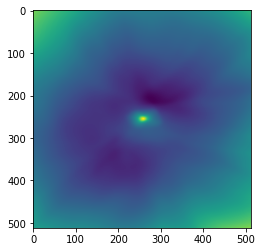

epoch 4501: 53.09262466430664
epoch 4502: 50.038551330566406
epoch 4503: 49.912452697753906
epoch 4504: 50.92197036743164
epoch 4505: 50.91881561279297
epoch 4506: 51.1021728515625
epoch 4507: 51.61188507080078
epoch 4508: 49.515869140625
epoch 4509: 49.8841667175293
epoch 4511: 49.891090393066406
epoch 4512: 50.20273208618164
epoch 4513: 50.52509689331055
epoch 4514: 52.17522430419922
epoch 4515: 50.49953079223633
epoch 4516: 50.8648796081543
epoch 4517: 51.62934494018555
epoch 4518: 51.84259033203125
epoch 4519: 51.2220458984375
epoch 4521: 51.49789047241211
epoch 4522: 50.22751235961914
epoch 4523: 51.41434860229492
epoch 4524: 50.09215545654297
epoch 4525: 51.02301788330078
epoch 4526: 53.295799255371094
epoch 4527: 50.34038162231445
epoch 4528: 50.74961471557617
epoch 4529: 51.80067443847656
epoch 4531: 50.22159194946289
epoch 4532: 50.53737258911133
epoch 4533: 50.4525146484375
epoch 4534: 50.91084671020508
epoch 4535: 50.6423454284668
epoch 4536: 50.887088775634766
epoch 4537: 5

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



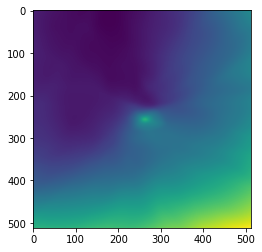

epoch 4601: 52.57501220703125
epoch 4602: 51.601078033447266
epoch 4603: 50.754859924316406
epoch 4604: 51.54529571533203
epoch 4605: 51.657684326171875
epoch 4606: 51.37785720825195
epoch 4607: 51.35383224487305
epoch 4608: 50.825775146484375
epoch 4609: 51.528560638427734
epoch 4611: 51.05377960205078
epoch 4612: 50.229095458984375
epoch 4613: 51.26586151123047
epoch 4614: 51.307098388671875
epoch 4615: 51.512203216552734
epoch 4616: 50.90721130371094
epoch 4617: 50.77346420288086
epoch 4618: 50.52229690551758
epoch 4619: 52.26226043701172
epoch 4621: 51.325748443603516
epoch 4622: 50.83051300048828
epoch 4623: 50.05473327636719
epoch 4624: 51.726959228515625
epoch 4625: 51.22521209716797
epoch 4626: 50.31623458862305
epoch 4627: 51.654361724853516
epoch 4628: 50.580421447753906
epoch 4629: 51.119632720947266
epoch 4631: 50.14128875732422
epoch 4632: 50.925941467285156
epoch 4633: 51.90684127807617
epoch 4634: 50.99522018432617
epoch 4635: 50.823394775390625
epoch 4636: 51.4659500122

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



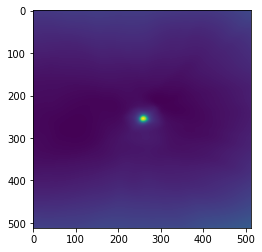

epoch 4701: 50.449195861816406
epoch 4702: 51.523826599121094
epoch 4703: 50.39697265625
epoch 4704: 50.22398376464844
epoch 4705: 51.00249099731445
epoch 4706: 51.257286071777344
epoch 4707: 52.50603103637695
epoch 4708: 51.819095611572266
epoch 4709: 52.56819152832031
epoch 4711: 51.09967803955078
epoch 4712: 50.32427978515625
epoch 4713: 50.613433837890625
epoch 4714: 49.825340270996094
epoch 4715: 50.7298698425293
epoch 4716: 51.40709686279297
epoch 4717: 50.3414421081543
epoch 4718: 51.47611618041992
epoch 4719: 49.3879508972168
epoch 4721: 50.33722686767578
epoch 4722: 50.508628845214844
epoch 4723: 51.49089431762695
epoch 4724: 50.06406021118164
epoch 4725: 50.240997314453125
epoch 4726: 50.47174072265625
epoch 4727: 48.841819763183594
epoch 4728: 50.27789306640625
epoch 4729: 50.25214385986328
epoch 4731: 50.48173904418945
epoch 4732: 50.310176849365234
epoch 4733: 50.6743278503418
epoch 4734: 50.72405242919922
epoch 4735: 48.88432312011719
epoch 4736: 50.225887298583984
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



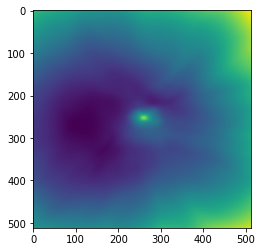

epoch 4801: 50.0704345703125
epoch 4802: 49.841976165771484
epoch 4803: 50.781009674072266
epoch 4804: 49.69502258300781
epoch 4805: 50.80139923095703
epoch 4806: 50.11233139038086
epoch 4807: 49.40581130981445
epoch 4808: 49.50767135620117
epoch 4809: 50.28669357299805
epoch 4811: 50.0067138671875
epoch 4812: 49.47362518310547
epoch 4813: 50.0263671875
epoch 4814: 50.163204193115234
epoch 4815: 49.82598876953125
epoch 4816: 49.797367095947266
epoch 4817: 50.94619369506836
epoch 4818: 50.28422927856445
epoch 4819: 50.70322799682617
epoch 4821: 49.792335510253906
epoch 4822: 50.907569885253906
epoch 4823: 50.61603927612305
epoch 4824: 49.59855270385742
epoch 4825: 49.665096282958984
epoch 4826: 49.05310821533203
epoch 4827: 49.79948806762695
epoch 4828: 51.400535583496094
epoch 4829: 49.222190856933594
epoch 4831: 50.39405059814453
epoch 4832: 49.896095275878906
epoch 4833: 49.83232498168945
epoch 4834: 53.71879577636719
epoch 4835: 50.51298904418945
epoch 4836: 50.71559524536133
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



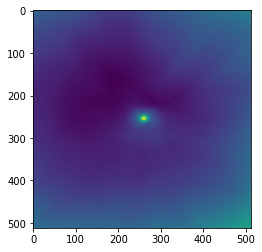

epoch 4901: 51.73881912231445
epoch 4902: 50.43328857421875
epoch 4903: 49.86350631713867
epoch 4904: 51.331302642822266
epoch 4905: 49.80106735229492
epoch 4906: 50.12150955200195
epoch 4907: 50.484886169433594
epoch 4908: 49.940181732177734
epoch 4909: 50.69318389892578
epoch 4911: 49.125160217285156
epoch 4912: 50.730430603027344
epoch 4913: 50.775474548339844
epoch 4914: 49.75749588012695
epoch 4915: 49.5604133605957
epoch 4916: 49.7259407043457
epoch 4917: 52.210235595703125
epoch 4918: 50.68867874145508
epoch 4919: 50.71951675415039
epoch 4921: 50.13050842285156
epoch 4922: 50.66960525512695
epoch 4923: 49.33980178833008
epoch 4924: 52.65605545043945
epoch 4925: 53.950218200683594
epoch 4926: 49.79894256591797
epoch 4927: 50.238555908203125
epoch 4928: 51.229331970214844
epoch 4929: 50.16031265258789
epoch 4931: 49.726016998291016
epoch 4932: 50.316165924072266
epoch 4933: 50.0316276550293
epoch 4934: 50.55571365356445
epoch 4935: 50.81757736206055
epoch 4936: 51.11719512939453
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



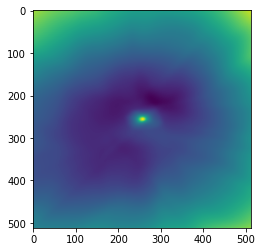

epoch 5001: 50.562740325927734
epoch 5002: 50.194602966308594
epoch 5003: 51.51507568359375
epoch 5004: 50.218292236328125
epoch 5005: 51.23648452758789
epoch 5006: 50.50361251831055
epoch 5007: 50.40081024169922
epoch 5008: 52.57659149169922
epoch 5009: 50.378231048583984
epoch 5011: 50.220272064208984
epoch 5012: 50.679115295410156
epoch 5013: 52.32973861694336
epoch 5014: 50.110939025878906
epoch 5015: 51.0164794921875
epoch 5016: 50.49235916137695
epoch 5017: 50.79956817626953
epoch 5018: 51.10111999511719
epoch 5019: 50.74531555175781
epoch 5021: 50.07380676269531
epoch 5022: 49.549896240234375
epoch 5023: 50.19538116455078
epoch 5024: 49.59767150878906
epoch 5025: 53.003334045410156
epoch 5026: 50.70433044433594
epoch 5027: 50.996612548828125
epoch 5028: 51.128726959228516
epoch 5029: 50.303321838378906
epoch 5031: 51.23435974121094
epoch 5032: 50.46363830566406
epoch 5033: 50.780975341796875
epoch 5034: 51.064456939697266
epoch 5035: 49.675296783447266
epoch 5036: 50.13219070434

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



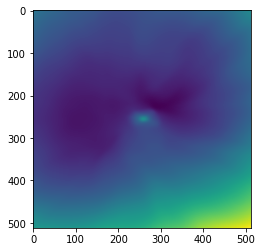

epoch 5101: 50.22578048706055
epoch 5102: 48.825401306152344
epoch 5103: 50.48222351074219
epoch 5104: 50.43427658081055
epoch 5105: 50.47745132446289
epoch 5106: 52.96725845336914
epoch 5107: 50.3954963684082
epoch 5108: 50.19000244140625
epoch 5109: 51.721031188964844
epoch 5111: 50.075355529785156
epoch 5112: 49.75430679321289
epoch 5113: 51.40802764892578
epoch 5114: 52.71504211425781
epoch 5115: 49.975128173828125
epoch 5116: 50.2039680480957
epoch 5117: 49.96978759765625
epoch 5118: 50.87495803833008
epoch 5119: 50.36297607421875
epoch 5121: 51.57940673828125
epoch 5122: 51.447750091552734
epoch 5123: 50.65620803833008
epoch 5124: 49.86427307128906
epoch 5125: 50.490745544433594
epoch 5126: 51.638248443603516
epoch 5127: 50.44219207763672
epoch 5128: 51.34272003173828
epoch 5129: 51.71240234375
epoch 5131: 49.863868713378906
epoch 5132: 51.03252029418945
epoch 5133: 49.95753479003906
epoch 5134: 49.808677673339844
epoch 5135: 51.66680908203125
epoch 5136: 49.57225799560547
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



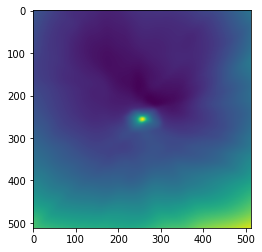

epoch 5201: 49.732322692871094
epoch 5202: 50.24361038208008
epoch 5203: 49.76198196411133
epoch 5204: 49.902320861816406
epoch 5205: 49.372039794921875
epoch 5206: 49.53993225097656
epoch 5207: 49.923179626464844
epoch 5208: 49.81500244140625
epoch 5209: 49.190067291259766
epoch 5211: 50.01166915893555
epoch 5212: 50.23599624633789
epoch 5213: 50.21165466308594
epoch 5214: 50.266414642333984
epoch 5215: 50.12217712402344
epoch 5216: 48.95154571533203
epoch 5217: 50.3804817199707
epoch 5218: 49.905128479003906
epoch 5219: 49.67831039428711
epoch 5221: 49.747562408447266
epoch 5222: 50.469356536865234
epoch 5223: 51.912376403808594
epoch 5224: 49.68165969848633
epoch 5225: 49.82003402709961
epoch 5226: 51.06768035888672
epoch 5227: 49.73661422729492
epoch 5228: 49.94502639770508
epoch 5229: 51.14973068237305
epoch 5231: 49.681095123291016
epoch 5232: 49.63097381591797
epoch 5233: 51.51499938964844
epoch 5234: 50.48582077026367
epoch 5235: 49.919471740722656
epoch 5236: 51.79627990722656

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



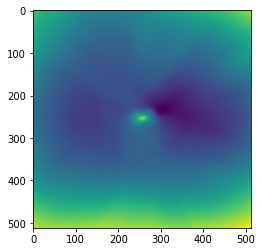

epoch 5301: 50.47085189819336
epoch 5302: 50.82652282714844
epoch 5303: 51.329368591308594
epoch 5304: 50.05533218383789
epoch 5305: 50.29635238647461
epoch 5306: 51.33076858520508
epoch 5307: 49.67721176147461
epoch 5308: 49.717567443847656
epoch 5309: 49.127479553222656
epoch 5311: 49.3739128112793
epoch 5312: 49.36155700683594
epoch 5313: 49.792232513427734
epoch 5314: 49.6392936706543
epoch 5315: 50.0064811706543
epoch 5316: 50.06410598754883
epoch 5317: 49.324031829833984
epoch 5318: 51.35667037963867
epoch 5319: 51.045692443847656
epoch 5321: 50.1171989440918
epoch 5322: 50.05888366699219
epoch 5323: 49.238826751708984
epoch 5324: 50.408206939697266
epoch 5325: 49.7735481262207
epoch 5326: 49.87083053588867
epoch 5327: 53.474063873291016
epoch 5328: 52.36809539794922
epoch 5329: 50.59127426147461
epoch 5331: 49.69297409057617
epoch 5332: 50.1015510559082
epoch 5333: 50.72315979003906
epoch 5334: 49.95569610595703
epoch 5335: 49.60655975341797
epoch 5336: 51.25546646118164
epoch 5

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



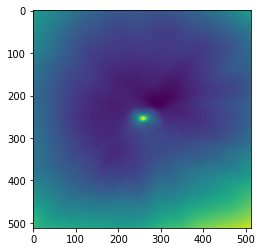

epoch 5401: 48.9198112487793
epoch 5402: 49.3923454284668
epoch 5403: 49.475196838378906
epoch 5404: 50.68067932128906
epoch 5405: 49.79866027832031
epoch 5406: 49.20610427856445
epoch 5407: 49.90856170654297
epoch 5408: 50.453372955322266
epoch 5409: 51.16063690185547
epoch 5411: 50.38945388793945
epoch 5412: 49.3468017578125
epoch 5413: 49.58073043823242
epoch 5414: 50.4267578125
epoch 5415: 50.83188247680664
epoch 5416: 49.612762451171875
epoch 5417: 49.372047424316406
epoch 5418: 49.09627151489258
epoch 5419: 51.318885803222656
epoch 5421: 49.22425842285156
epoch 5422: 49.375885009765625
epoch 5423: 50.85218811035156
epoch 5424: 50.24681091308594
epoch 5425: 49.87432098388672
epoch 5426: 50.25945281982422
epoch 5427: 52.51392364501953
epoch 5428: 49.422943115234375
epoch 5429: 49.87373352050781
epoch 5431: 48.21504211425781
epoch 5432: 51.06245422363281
epoch 5433: 49.9914665222168
epoch 5434: 50.16693878173828
epoch 5435: 49.2614860534668
epoch 5436: 50.51801300048828
epoch 5437: 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



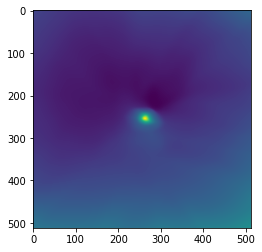

epoch 5501: 50.25920867919922
epoch 5502: 50.36557388305664
epoch 5503: 50.75980758666992
epoch 5504: 51.81721496582031
epoch 5505: 51.13116455078125
epoch 5506: 50.16876220703125
epoch 5507: 50.30225372314453
epoch 5508: 51.40782165527344
epoch 5509: 52.21751403808594
epoch 5511: 51.152835845947266
epoch 5512: 51.2894287109375
epoch 5513: 50.29038619995117
epoch 5514: 51.57500457763672
epoch 5515: 50.19068145751953
epoch 5516: 50.205989837646484
epoch 5517: 50.698265075683594
epoch 5518: 50.63569641113281
epoch 5519: 50.753334045410156
epoch 5521: 51.99468994140625
epoch 5522: 50.246604919433594
epoch 5523: 50.039085388183594
epoch 5524: 51.57714080810547
epoch 5525: 50.155792236328125
epoch 5526: 50.49995422363281
epoch 5527: 50.67460632324219
epoch 5528: 51.949256896972656
epoch 5529: 50.967369079589844
epoch 5531: 50.122947692871094
epoch 5532: 50.65269088745117
epoch 5533: 50.839473724365234
epoch 5534: 49.954795837402344
epoch 5535: 51.46811294555664
epoch 5536: 51.52099609375
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



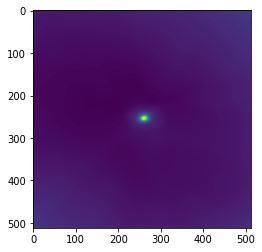

epoch 5601: 50.300682067871094
epoch 5602: 49.92103576660156
epoch 5603: 49.70293045043945
epoch 5604: 50.138763427734375
epoch 5605: 50.316802978515625
epoch 5606: 49.30978775024414
epoch 5607: 50.13269805908203
epoch 5608: 50.811668395996094
epoch 5609: 50.6474494934082
epoch 5611: 50.07900619506836
epoch 5612: 50.9520263671875
epoch 5613: 49.81267547607422
epoch 5614: 52.543216705322266
epoch 5615: 50.45562744140625
epoch 5616: 49.00851821899414
epoch 5617: 49.932090759277344
epoch 5618: 50.05674362182617
epoch 5619: 49.874717712402344
epoch 5621: 51.41284942626953
epoch 5622: 49.430816650390625
epoch 5623: 50.48018264770508
epoch 5624: 49.293121337890625
epoch 5625: 50.733917236328125
epoch 5626: 51.045040130615234
epoch 5627: 50.37339782714844
epoch 5628: 50.27333068847656
epoch 5629: 50.325008392333984
epoch 5631: 50.389827728271484
epoch 5632: 49.9398078918457
epoch 5633: 52.26377487182617
epoch 5634: 51.42738723754883
epoch 5635: 50.454586029052734
epoch 5636: 49.97505569458008

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



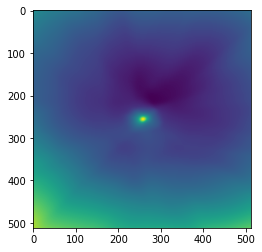

epoch 5701: 50.404117584228516
epoch 5702: 49.824310302734375
epoch 5703: 49.72712326049805
epoch 5704: 51.785118103027344
epoch 5705: 49.9261474609375
epoch 5706: 50.15797805786133
epoch 5707: 49.88188934326172
epoch 5708: 49.40950012207031
epoch 5709: 50.142425537109375
epoch 5711: 50.422515869140625
epoch 5712: 50.113956451416016
epoch 5713: 50.55677032470703
epoch 5714: 50.41191101074219
epoch 5715: 50.370853424072266
epoch 5716: 50.99442672729492
epoch 5717: 50.73159408569336
epoch 5718: 50.06931686401367
epoch 5719: 50.810829162597656
epoch 5721: 49.323486328125
epoch 5722: 50.40736389160156
epoch 5723: 49.3924560546875
epoch 5724: 51.39085388183594
epoch 5725: 50.75548553466797
epoch 5726: 49.943450927734375
epoch 5727: 50.44883346557617
epoch 5728: 49.978416442871094
epoch 5729: 52.812435150146484
epoch 5731: 49.145809173583984
epoch 5732: 49.88982009887695
epoch 5733: 50.33647918701172
epoch 5734: 49.25185775756836
epoch 5735: 50.7497444152832
epoch 5736: 50.00859451293945
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



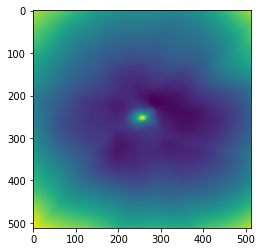

epoch 5801: 49.502803802490234
epoch 5802: 49.440345764160156
epoch 5803: 50.30352783203125
epoch 5804: 50.01200866699219
epoch 5805: 49.70703887939453
epoch 5806: 50.08177947998047
epoch 5807: 49.989810943603516
epoch 5808: 50.07181167602539
epoch 5809: 49.37483596801758
epoch 5811: 49.221168518066406
epoch 5812: 51.25156784057617
epoch 5813: 49.83076095581055
epoch 5814: 49.53580856323242
epoch 5815: 49.32905578613281
epoch 5816: 49.39003372192383
epoch 5817: 49.55002212524414
epoch 5818: 49.586055755615234
epoch 5819: 50.60068130493164
epoch 5821: 50.20124435424805
epoch 5822: 48.54001998901367
epoch 5823: 49.20634078979492
epoch 5824: 49.25564193725586
epoch 5825: 49.573768615722656
epoch 5826: 49.08613204956055
epoch 5827: 50.68174743652344
epoch 5828: 50.17000961303711
epoch 5829: 49.12952423095703
epoch 5831: 52.2577018737793
epoch 5832: 50.866981506347656
epoch 5833: 49.66883087158203
epoch 5834: 49.78904342651367
epoch 5835: 49.88651657104492
epoch 5836: 49.59525680541992
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



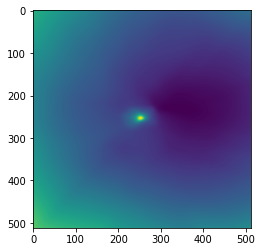

epoch 5901: 52.59159469604492
epoch 5902: 51.44187545776367
epoch 5903: 51.40571594238281
epoch 5904: 51.44169616699219
epoch 5905: 52.06939697265625
epoch 5906: 50.773101806640625
epoch 5907: 52.29262161254883
epoch 5908: 51.728885650634766
epoch 5909: 50.17681121826172
epoch 5911: 51.18714904785156
epoch 5912: 52.36360168457031
epoch 5913: 51.284385681152344
epoch 5914: 51.56262969970703
epoch 5915: 52.235355377197266
epoch 5916: 51.9870491027832
epoch 5917: 51.02755355834961
epoch 5918: 52.754432678222656
epoch 5919: 51.786163330078125
epoch 5921: 52.34999465942383
epoch 5922: 51.100040435791016
epoch 5923: 53.428646087646484
epoch 5924: 53.47162628173828
epoch 5925: 51.072635650634766
epoch 5926: 51.78734588623047
epoch 5927: 50.03010177612305
epoch 5928: 51.05005645751953
epoch 5929: 50.849300384521484
epoch 5931: 51.942420959472656
epoch 5932: 50.345481872558594
epoch 5933: 53.496822357177734
epoch 5934: 51.91456985473633
epoch 5935: 51.306068420410156
epoch 5936: 50.118232727050

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



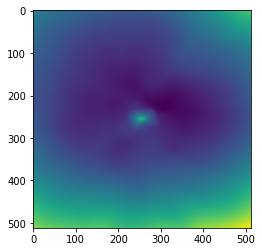

epoch 6001: 50.04057693481445
epoch 6002: 49.953189849853516
epoch 6003: 49.9215202331543
epoch 6004: 50.847900390625
epoch 6005: 49.52823257446289
epoch 6006: 51.03406524658203
epoch 6007: 49.42096710205078
epoch 6008: 50.33106231689453
epoch 6009: 49.97189712524414
epoch 6011: 51.76824951171875
epoch 6012: 50.06291198730469
epoch 6013: 50.542789459228516
epoch 6014: 50.056968688964844
epoch 6015: 49.937191009521484
epoch 6016: 49.98655319213867
epoch 6017: 49.7263298034668
epoch 6018: 50.41414260864258
epoch 6019: 51.26655197143555
epoch 6021: 49.36641311645508
epoch 6022: 49.380577087402344
epoch 6023: 51.44802474975586
epoch 6024: 50.4015998840332
epoch 6025: 49.621734619140625
epoch 6026: 50.31679916381836
epoch 6027: 50.75608444213867
epoch 6028: 50.42127990722656
epoch 6029: 50.28963088989258
epoch 6031: 49.86556625366211
epoch 6032: 49.75114822387695
epoch 6033: 51.14963912963867
epoch 6034: 50.69950485229492
epoch 6035: 49.56984329223633
epoch 6036: 50.051151275634766
epoch 60

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



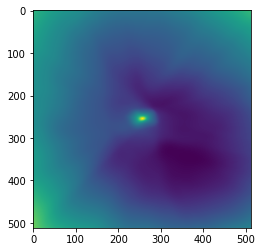

epoch 6101: 50.113094329833984
epoch 6102: 49.27204513549805
epoch 6103: 50.04930877685547
epoch 6104: 49.838897705078125
epoch 6105: 49.528926849365234
epoch 6106: 49.76302719116211
epoch 6107: 50.25127029418945
epoch 6108: 51.941925048828125
epoch 6109: 49.3774528503418
epoch 6111: 49.46973419189453
epoch 6112: 50.52402877807617
epoch 6113: 50.715980529785156
epoch 6114: 51.82463073730469
epoch 6115: 50.62716293334961
epoch 6116: 51.13602066040039
epoch 6117: 51.053245544433594
epoch 6118: 50.11708450317383
epoch 6119: 51.06208801269531
epoch 6121: 50.42382049560547
epoch 6122: 49.29781723022461
epoch 6123: 50.49213790893555
epoch 6124: 50.41340637207031
epoch 6125: 50.58170700073242
epoch 6126: 49.7039794921875
epoch 6127: 50.21637725830078
epoch 6128: 50.356605529785156
epoch 6129: 51.08414077758789
epoch 6131: 50.55311965942383
epoch 6132: 52.225833892822266
epoch 6133: 49.815799713134766
epoch 6134: 49.431514739990234
epoch 6135: 49.87936782836914
epoch 6136: 50.567787170410156
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



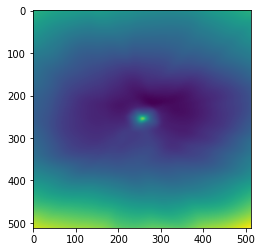

epoch 6201: 49.18581008911133
epoch 6202: 49.28852081298828
epoch 6203: 49.93317413330078
epoch 6204: 50.05791473388672
epoch 6205: 49.45408630371094
epoch 6206: 50.70161819458008
epoch 6207: 51.00508117675781
epoch 6208: 50.78214645385742
epoch 6209: 50.381587982177734
epoch 6211: 51.66624450683594
epoch 6212: 49.52777862548828
epoch 6213: 49.57302474975586
epoch 6214: 53.43732833862305
epoch 6215: 50.485450744628906
epoch 6216: 50.20627212524414
epoch 6217: 50.433631896972656
epoch 6218: 51.03946304321289
epoch 6219: 50.892242431640625
epoch 6221: 49.84778594970703
epoch 6222: 50.840084075927734
epoch 6223: 52.742286682128906
epoch 6224: 49.056068420410156
epoch 6225: 49.849327087402344
epoch 6226: 50.3399543762207
epoch 6227: 50.27125549316406
epoch 6228: 49.53553771972656
epoch 6229: 49.79271697998047
epoch 6231: 50.66337585449219
epoch 6232: 50.1558952331543
epoch 6233: 50.5882453918457
epoch 6234: 50.80405807495117
epoch 6235: 51.64799880981445
epoch 6236: 51.038612365722656
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



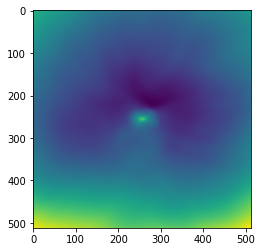

epoch 6301: 49.454227447509766
epoch 6302: 49.05147171020508
epoch 6303: 49.634559631347656
epoch 6304: 49.61518478393555
epoch 6305: 49.232025146484375
epoch 6306: 49.882389068603516
epoch 6307: 49.69544219970703
epoch 6308: 49.2081184387207
epoch 6309: 50.195343017578125
epoch 6311: 50.92263412475586
epoch 6312: 50.481529235839844
epoch 6313: 51.10615921020508
epoch 6314: 50.15138244628906
epoch 6315: 50.218055725097656
epoch 6316: 49.92885971069336
epoch 6317: 50.04985046386719
epoch 6318: 50.0573844909668
epoch 6319: 48.95003128051758
epoch 6321: 48.654335021972656
epoch 6322: 50.6194953918457
epoch 6323: 49.47055435180664
epoch 6324: 50.6762809753418
epoch 6325: 49.22639465332031
epoch 6326: 53.3056755065918
epoch 6327: 49.391719818115234
epoch 6328: 50.206233978271484
epoch 6329: 50.02500534057617
epoch 6331: 49.8616943359375
epoch 6332: 49.938682556152344
epoch 6333: 49.86132049560547
epoch 6334: 50.00682830810547
epoch 6335: 50.269447326660156
epoch 6336: 49.4334602355957
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



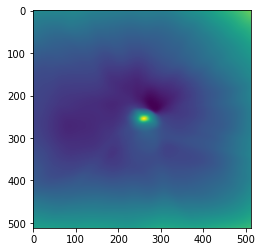

epoch 6401: 50.09599685668945
epoch 6402: 50.279930114746094
epoch 6403: 49.71611022949219
epoch 6404: 49.73126983642578
epoch 6405: 49.57982635498047
epoch 6406: 49.568145751953125
epoch 6407: 50.02815246582031
epoch 6408: 49.041378021240234
epoch 6409: 49.8935546875
epoch 6411: 50.78719711303711
epoch 6412: 49.89372634887695
epoch 6413: 49.38835906982422
epoch 6414: 48.89323043823242
epoch 6415: 50.92914962768555
epoch 6416: 50.42489242553711
epoch 6417: 50.40135955810547
epoch 6418: 50.294803619384766
epoch 6419: 50.018611907958984
epoch 6421: 50.88625717163086
epoch 6422: 50.211360931396484
epoch 6423: 51.02616882324219
epoch 6424: 50.050437927246094
epoch 6425: 49.452552795410156
epoch 6426: 50.5910530090332
epoch 6427: 49.76096725463867
epoch 6428: 50.47876739501953
epoch 6429: 50.18904113769531
epoch 6431: 50.30403518676758
epoch 6432: 50.100521087646484
epoch 6433: 49.81730270385742
epoch 6434: 49.48080825805664
epoch 6435: 50.10007858276367
epoch 6436: 49.44188690185547
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



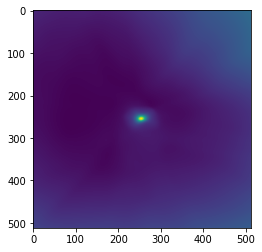

epoch 6501: 49.726318359375
epoch 6502: 49.82748794555664
epoch 6503: 50.528072357177734
epoch 6504: 50.96504211425781
epoch 6505: 49.8581657409668
epoch 6506: 49.667850494384766
epoch 6507: 50.53664779663086
epoch 6508: 49.86964797973633
epoch 6509: 49.90403747558594
epoch 6511: 49.35097885131836
epoch 6512: 49.74553680419922
epoch 6513: 49.741859436035156
epoch 6514: 49.781517028808594
epoch 6515: 49.312843322753906
epoch 6516: 49.4646110534668
epoch 6517: 49.59546661376953
epoch 6518: 49.89887619018555
epoch 6519: 51.01852035522461
epoch 6521: 48.827693939208984
epoch 6522: 49.72703170776367
epoch 6523: 48.77058029174805
epoch 6524: 49.68685531616211
epoch 6525: 49.87629318237305
epoch 6526: 49.36729049682617
epoch 6527: 48.87758255004883
epoch 6528: 49.843719482421875
epoch 6529: 49.838008880615234
epoch 6531: 49.264156341552734
epoch 6532: 49.97792434692383
epoch 6533: 49.170166015625
epoch 6534: 49.732181549072266
epoch 6535: 50.635337829589844
epoch 6536: 49.860511779785156
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



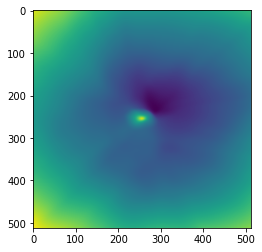

epoch 6601: 51.641544342041016
epoch 6602: 49.79738998413086
epoch 6603: 50.096778869628906
epoch 6604: 49.73099136352539
epoch 6605: 49.89116668701172
epoch 6606: 49.514129638671875
epoch 6607: 49.54075622558594
epoch 6608: 49.51520538330078
epoch 6609: 49.548553466796875
epoch 6611: 50.52357864379883
epoch 6612: 49.83440399169922
epoch 6613: 50.241817474365234
epoch 6614: 50.0341682434082
epoch 6615: 49.88850784301758
epoch 6616: 49.89966583251953
epoch 6617: 48.90223693847656
epoch 6618: 50.59959411621094
epoch 6619: 49.88264465332031
epoch 6621: 50.815956115722656
epoch 6622: 50.4426383972168
epoch 6623: 51.12021255493164
epoch 6624: 51.06574630737305
epoch 6625: 50.330055236816406
epoch 6626: 49.554813385009766
epoch 6627: 49.65874481201172
epoch 6628: 50.775230407714844
epoch 6629: 48.73557662963867
epoch 6631: 51.13114929199219
epoch 6632: 48.559425354003906
epoch 6633: 49.81102752685547
epoch 6634: 49.922420501708984
epoch 6635: 50.44090270996094
epoch 6636: 49.837158203125
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



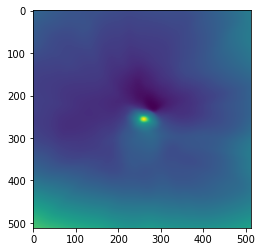

epoch 6701: 49.99886703491211
epoch 6702: 49.94551467895508
epoch 6703: 50.045135498046875
epoch 6704: 49.16217803955078
epoch 6705: 49.92734146118164
epoch 6706: 50.00578689575195
epoch 6707: 49.461605072021484
epoch 6708: 49.55279541015625
epoch 6709: 49.412574768066406
epoch 6711: 49.69035720825195
epoch 6712: 49.81657409667969
epoch 6713: 49.66759490966797
epoch 6714: 50.2931022644043
epoch 6715: 49.13575744628906
epoch 6716: 50.43510818481445
epoch 6717: 49.73932647705078
epoch 6718: 48.97304916381836
epoch 6719: 49.38099670410156
epoch 6721: 49.40045928955078
epoch 6722: 50.11847686767578
epoch 6723: 49.43466567993164
epoch 6724: 49.101112365722656
epoch 6725: 49.0244026184082
epoch 6726: 48.67815017700195
epoch 6727: 49.45528030395508
epoch 6728: 48.82489776611328
epoch 6729: 49.73139953613281
epoch 6731: 48.9868049621582
epoch 6732: 49.035865783691406
epoch 6733: 49.00094223022461
epoch 6734: 50.3305549621582
epoch 6735: 50.42305374145508
epoch 6736: 49.919456481933594
epoch 67

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



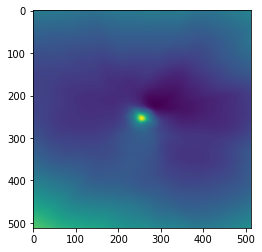

epoch 6801: 50.31554412841797
epoch 6802: 49.811405181884766
epoch 6803: 49.23580551147461
epoch 6804: 49.625858306884766
epoch 6805: 49.95391845703125
epoch 6806: 49.482666015625
epoch 6807: 49.40875244140625
epoch 6808: 48.925994873046875
epoch 6809: 57.15628433227539
epoch 6811: 49.494441986083984
epoch 6812: 49.6724967956543
epoch 6813: 49.6512565612793
epoch 6814: 49.3988151550293
epoch 6815: 50.10441589355469
epoch 6816: 49.70861053466797
epoch 6817: 50.50449752807617
epoch 6818: 49.48143005371094
epoch 6819: 49.46406555175781
epoch 6821: 49.68324279785156
epoch 6822: 49.81864929199219
epoch 6823: 49.75055694580078
epoch 6824: 49.15546417236328
epoch 6825: 49.64034652709961
epoch 6826: 49.843231201171875
epoch 6827: 49.488502502441406
epoch 6828: 49.89085388183594
epoch 6829: 50.83533477783203
epoch 6831: 50.76055145263672
epoch 6832: 50.463409423828125
epoch 6833: 50.11448287963867
epoch 6834: 50.92953872680664
epoch 6835: 50.27300262451172
epoch 6836: 49.56037139892578
epoch 68

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



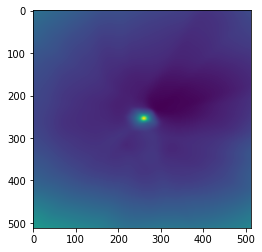

epoch 6901: 50.69903564453125
epoch 6902: 50.02433776855469
epoch 6903: 49.71997833251953
epoch 6904: 48.91909408569336
epoch 6905: 50.40911102294922
epoch 6906: 52.82286834716797
epoch 6907: 49.87141418457031
epoch 6908: 51.34710693359375
epoch 6909: 49.326419830322266
epoch 6911: 49.921287536621094
epoch 6912: 50.61286163330078
epoch 6913: 48.164817810058594
epoch 6914: 50.19816970825195
epoch 6915: 49.42401123046875
epoch 6916: 49.7197265625
epoch 6917: 48.57662582397461
epoch 6918: 49.51679611206055
epoch 6919: 49.39045333862305
epoch 6921: 49.302268981933594
epoch 6922: 49.18793869018555
epoch 6923: 49.29605484008789
epoch 6924: 50.27427291870117
epoch 6925: 49.37916564941406
epoch 6926: 49.26731872558594
epoch 6927: 49.64384841918945
epoch 6928: 49.04167556762695
epoch 6929: 48.89613723754883
epoch 6931: 49.79545593261719
epoch 6932: 49.3487434387207
epoch 6933: 49.40167236328125
epoch 6934: 49.38111114501953
epoch 6935: 50.64385223388672
epoch 6936: 50.22832107543945
epoch 6937:

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



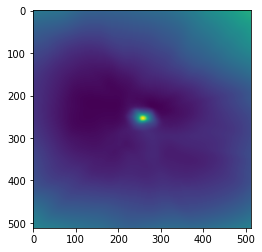

epoch 7001: 49.71257400512695
epoch 7002: 49.385990142822266
epoch 7003: 49.79753494262695
epoch 7004: 50.03346252441406
epoch 7005: 48.60811233520508
epoch 7006: 49.5250358581543
epoch 7007: 49.69377899169922
epoch 7008: 49.881534576416016
epoch 7009: 49.05643844604492
epoch 7011: 49.077880859375
epoch 7012: 48.65575408935547
epoch 7013: 48.172645568847656
epoch 7014: 49.002811431884766
epoch 7015: 51.056488037109375
epoch 7016: 49.10674285888672
epoch 7017: 49.07155227661133
epoch 7018: 49.25176239013672
epoch 7019: 49.386451721191406
epoch 7021: 53.416343688964844
epoch 7022: 49.355831146240234
epoch 7023: 49.83851623535156
epoch 7024: 50.94538879394531
epoch 7025: 53.157203674316406
epoch 7026: 50.07661819458008
epoch 7027: 49.867313385009766
epoch 7028: 50.02067947387695
epoch 7029: 49.749141693115234
epoch 7031: 49.3775634765625
epoch 7032: 51.0709342956543
epoch 7033: 50.52637481689453
epoch 7034: 50.106693267822266
epoch 7035: 49.707489013671875
epoch 7036: 49.507476806640625
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



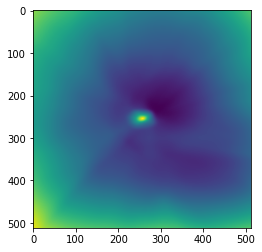

epoch 7101: 50.398799896240234
epoch 7102: 50.118412017822266
epoch 7103: 50.05077362060547
epoch 7104: 49.31817626953125
epoch 7105: 51.20113754272461
epoch 7106: 50.23860168457031
epoch 7107: 50.709983825683594
epoch 7108: 49.3228759765625
epoch 7109: 50.13584518432617
epoch 7111: 50.02125930786133
epoch 7112: 49.08317184448242
epoch 7113: 49.59269332885742
epoch 7114: 49.69157409667969
epoch 7115: 49.106666564941406
epoch 7116: 49.3106575012207
epoch 7117: 49.701942443847656
epoch 7118: 49.718502044677734
epoch 7119: 49.391197204589844
epoch 7121: 49.353240966796875
epoch 7122: 49.63132858276367
epoch 7123: 49.651573181152344
epoch 7124: 49.07272720336914
epoch 7125: 50.31462097167969
epoch 7126: 49.90379333496094
epoch 7127: 49.35810089111328
epoch 7128: 50.02074432373047
epoch 7129: 50.03690719604492
epoch 7131: 50.3531379699707
epoch 7132: 49.196800231933594
epoch 7133: 49.82025909423828
epoch 7134: 47.83245849609375
epoch 7135: 49.949676513671875
epoch 7136: 49.530372619628906
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



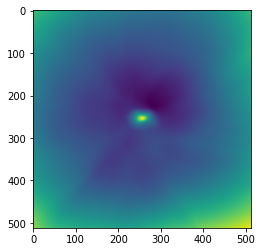

epoch 7201: 49.3076171875
epoch 7202: 48.791141510009766
epoch 7203: 50.03549575805664
epoch 7204: 50.092403411865234
epoch 7205: 48.79335021972656
epoch 7206: 49.50914001464844
epoch 7207: 49.48674392700195
epoch 7208: 50.0251579284668
epoch 7209: 49.925201416015625
epoch 7211: 50.40683364868164
epoch 7212: 49.577117919921875
epoch 7213: 49.32767868041992
epoch 7214: 49.183937072753906
epoch 7215: 49.23444366455078
epoch 7216: 49.44513702392578
epoch 7217: 49.37879943847656
epoch 7218: 48.82182693481445
epoch 7219: 49.71393966674805
epoch 7221: 50.47031784057617
epoch 7222: 49.21826934814453
epoch 7223: 49.451637268066406
epoch 7224: 48.413570404052734
epoch 7225: 49.26968765258789
epoch 7226: 49.98152160644531
epoch 7227: 49.18395233154297
epoch 7228: 49.67937088012695
epoch 7229: 50.66032791137695
epoch 7231: 49.8200798034668
epoch 7232: 49.1932487487793
epoch 7233: 49.12055206298828
epoch 7234: 49.35446548461914
epoch 7235: 49.70515060424805
epoch 7236: 50.311485290527344
epoch 723

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



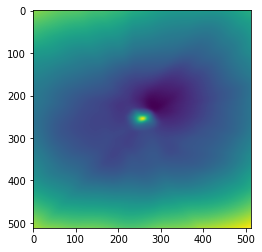

epoch 7301: 48.82942199707031
epoch 7302: 51.48269271850586
epoch 7303: 49.271514892578125
epoch 7304: 49.220237731933594
epoch 7305: 48.636375427246094
epoch 7306: 48.69020462036133
epoch 7307: 48.92629623413086
epoch 7308: 49.17428207397461
epoch 7309: 49.106956481933594
epoch 7311: 49.29802703857422
epoch 7312: 50.259273529052734
epoch 7313: 50.18156433105469
epoch 7314: 49.89992141723633
epoch 7315: 49.626068115234375
epoch 7316: 51.929168701171875
epoch 7317: 49.478431701660156
epoch 7318: 49.480712890625
epoch 7319: 50.02680969238281
epoch 7321: 50.20657730102539
epoch 7322: 49.21669387817383
epoch 7323: 50.09646224975586
epoch 7324: 49.07155227661133
epoch 7325: 51.30149459838867
epoch 7326: 50.6898307800293
epoch 7327: 50.965187072753906
epoch 7328: 50.102210998535156
epoch 7329: 51.70058059692383
epoch 7331: 48.827178955078125
epoch 7332: 49.30791091918945
epoch 7333: 49.61952590942383
epoch 7334: 49.8825569152832
epoch 7335: 49.49894332885742
epoch 7336: 48.948631286621094
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



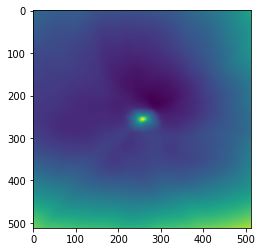

epoch 7401: 48.31958770751953
epoch 7402: 48.63883590698242
epoch 7403: 51.207969665527344
epoch 7404: 49.89942169189453
epoch 7405: 49.106441497802734
epoch 7406: 48.756465911865234
epoch 7407: 48.65431594848633
epoch 7408: 49.843875885009766
epoch 7409: 49.06649398803711
epoch 7411: 49.01764678955078
epoch 7412: 49.64607620239258
epoch 7413: 49.14014434814453
epoch 7414: 49.983455657958984
epoch 7415: 49.68278503417969
epoch 7416: 48.81138610839844
epoch 7417: 51.099117279052734
epoch 7418: 49.20395278930664
epoch 7419: 49.51755905151367
epoch 7421: 49.46995162963867
epoch 7422: 48.97578048706055
epoch 7423: 48.771080017089844
epoch 7424: 48.38578796386719
epoch 7425: 51.06007385253906
epoch 7426: 49.01184844970703
epoch 7427: 49.35201644897461
epoch 7428: 49.06939697265625
epoch 7429: 49.97853088378906
epoch 7431: 49.12849807739258
epoch 7432: 49.22282409667969
epoch 7433: 49.11393737792969
epoch 7434: 49.14680099487305
epoch 7435: 49.171661376953125
epoch 7436: 49.9464111328125
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



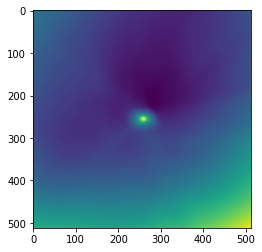

epoch 7501: 48.952850341796875
epoch 7502: 50.88335418701172
epoch 7503: 50.13576126098633
epoch 7504: 49.92828369140625
epoch 7505: 49.61006164550781
epoch 7506: 49.730918884277344
epoch 7507: 50.62400436401367
epoch 7508: 50.2613639831543
epoch 7509: 48.913570404052734
epoch 7511: 49.08319854736328
epoch 7512: 49.621192932128906
epoch 7513: 49.65816116333008
epoch 7514: 50.6469841003418
epoch 7515: 50.83584976196289
epoch 7516: 49.502315521240234
epoch 7517: 49.60372543334961
epoch 7518: 49.8117790222168
epoch 7519: 50.63582992553711
epoch 7521: 50.161155700683594
epoch 7522: 48.35572052001953
epoch 7523: 50.02699279785156
epoch 7524: 49.69415283203125
epoch 7525: 50.41389846801758
epoch 7526: 50.657752990722656
epoch 7527: 49.67560577392578
epoch 7528: 49.21614074707031
epoch 7529: 49.63232421875
epoch 7531: 49.84832763671875
epoch 7532: 49.18621826171875
epoch 7533: 49.471290588378906
epoch 7534: 51.89643478393555
epoch 7535: 48.898441314697266
epoch 7536: 49.28641128540039
epoch 7

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



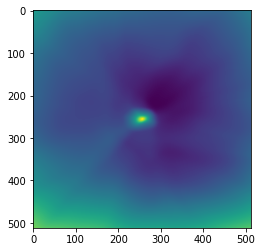

epoch 7601: 48.77818298339844
epoch 7602: 49.59548568725586
epoch 7603: 49.13290023803711
epoch 7604: 48.59463119506836
epoch 7605: 49.145835876464844
epoch 7606: 49.987152099609375
epoch 7607: 49.35137939453125
epoch 7608: 49.24538803100586
epoch 7609: 49.10210037231445
epoch 7611: 48.466163635253906
epoch 7612: 49.12528991699219
epoch 7613: 48.7529411315918
epoch 7614: 50.594356536865234
epoch 7615: 49.76535415649414
epoch 7616: 50.05389404296875
epoch 7617: 49.09198760986328
epoch 7618: 48.75941467285156
epoch 7619: 48.33466720581055
epoch 7621: 48.299049377441406
epoch 7622: 48.63847351074219
epoch 7623: 49.55876159667969
epoch 7624: 49.555294036865234
epoch 7625: 49.29117202758789
epoch 7626: 48.775489807128906
epoch 7627: 50.079795837402344
epoch 7628: 49.58335876464844
epoch 7629: 49.211212158203125
epoch 7631: 49.70756149291992
epoch 7632: 49.20246887207031
epoch 7633: 48.89663314819336
epoch 7634: 48.849178314208984
epoch 7635: 49.98093795776367
epoch 7636: 49.05707931518555
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



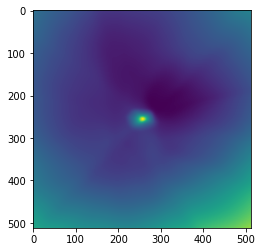

epoch 7701: 49.725914001464844
epoch 7702: 49.099609375
epoch 7703: 49.64302444458008
epoch 7704: 49.46312713623047
epoch 7705: 49.1425895690918
epoch 7706: 49.83055877685547
epoch 7707: 50.1653938293457
epoch 7708: 49.72590637207031
epoch 7709: 49.50294494628906
epoch 7711: 49.613250732421875
epoch 7712: 50.07139205932617
epoch 7713: 50.73566818237305
epoch 7714: 50.60963821411133
epoch 7715: 50.88805389404297
epoch 7716: 51.18857192993164
epoch 7717: 51.522552490234375
epoch 7718: 50.177433013916016
epoch 7719: 50.728553771972656
epoch 7721: 50.765342712402344
epoch 7722: 50.81428146362305
epoch 7723: 50.08684158325195
epoch 7724: 49.53806686401367
epoch 7725: 50.935970306396484
epoch 7726: 50.11914825439453
epoch 7727: 50.573177337646484
epoch 7728: 54.794166564941406
epoch 7729: 49.85710906982422
epoch 7731: 49.14131546020508
epoch 7732: 50.98109436035156
epoch 7733: 49.97719955444336
epoch 7734: 49.80813980102539
epoch 7735: 49.75477981567383
epoch 7736: 50.598751068115234
epoch 7

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



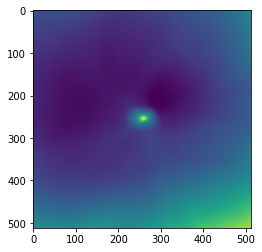

epoch 7801: 48.195335388183594
epoch 7802: 49.86549377441406
epoch 7803: 50.32996368408203
epoch 7804: 48.29220199584961
epoch 7805: 49.18357467651367
epoch 7806: 48.911014556884766
epoch 7807: 48.78509521484375
epoch 7808: 49.07917022705078
epoch 7809: 49.69771957397461
epoch 7811: 48.64152145385742
epoch 7812: 49.07289505004883
epoch 7813: 50.29087829589844
epoch 7814: 48.91857147216797
epoch 7815: 49.26142883300781
epoch 7816: 49.826778411865234
epoch 7817: 50.44234085083008
epoch 7818: 48.659873962402344
epoch 7819: 48.488067626953125
epoch 7821: 50.7563362121582
epoch 7822: 50.07533264160156
epoch 7823: 49.60820770263672
epoch 7824: 50.90764617919922
epoch 7825: 52.77009582519531
epoch 7826: 51.946632385253906
epoch 7827: 52.55464553833008
epoch 7828: 50.88042449951172
epoch 7829: 52.899688720703125
epoch 7831: 54.37279510498047
epoch 7832: 57.51651382446289
epoch 7833: 54.19318389892578
epoch 7834: 52.51817321777344
epoch 7835: 54.15115737915039
epoch 7836: 53.59223556518555
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



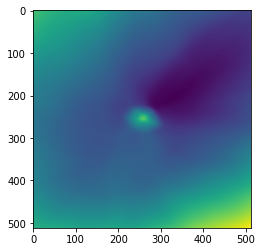

epoch 7901: 50.10380554199219
epoch 7902: 49.50507354736328
epoch 7903: 50.06205368041992
epoch 7904: 49.27451705932617
epoch 7905: 49.87875747680664
epoch 7906: 49.523406982421875
epoch 7907: 50.34478759765625
epoch 7908: 50.16936111450195
epoch 7909: 49.59782028198242
epoch 7911: 50.91236114501953
epoch 7912: 49.40953063964844
epoch 7913: 50.16590118408203
epoch 7914: 49.61436462402344
epoch 7915: 48.2202262878418
epoch 7916: 49.56854248046875
epoch 7917: 49.38287353515625
epoch 7918: 50.77199172973633
epoch 7919: 49.57544708251953
epoch 7921: 50.10070037841797
epoch 7922: 49.348289489746094
epoch 7923: 50.23871612548828
epoch 7924: 49.62218475341797
epoch 7925: 50.21733474731445
epoch 7926: 49.22951889038086
epoch 7927: 49.335086822509766
epoch 7928: 50.46744918823242
epoch 7929: 49.692684173583984
epoch 7931: 52.20261764526367
epoch 7932: 49.016807556152344
epoch 7933: 48.98103332519531
epoch 7934: 50.11052322387695
epoch 7935: 48.437984466552734
epoch 7936: 49.629295349121094
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



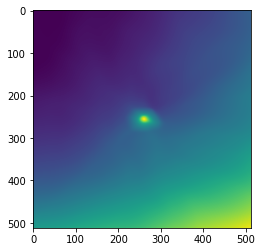

epoch 8001: 50.97840881347656
epoch 8002: 51.06080627441406
epoch 8003: 50.308265686035156
epoch 8004: 51.10329818725586
epoch 8005: 50.249122619628906
epoch 8006: 49.17923355102539
epoch 8007: 51.308284759521484
epoch 8008: 49.21601486206055
epoch 8009: 49.879913330078125
epoch 8011: 49.46045684814453
epoch 8012: 49.9814453125
epoch 8013: 49.375362396240234
epoch 8014: 49.69384765625
epoch 8015: 50.132591247558594
epoch 8016: 49.68385696411133
epoch 8017: 50.91083526611328
epoch 8018: 49.08531951904297
epoch 8019: 49.57902526855469
epoch 8021: 49.883113861083984
epoch 8022: 49.498355865478516
epoch 8023: 49.04951858520508
epoch 8024: 49.21857452392578
epoch 8025: 49.59950256347656
epoch 8026: 50.17430114746094
epoch 8027: 49.948829650878906
epoch 8028: 50.06972885131836
epoch 8029: 49.58683776855469
epoch 8031: 50.11116027832031
epoch 8032: 49.8186149597168
epoch 8033: 49.18836975097656
epoch 8034: 49.199462890625
epoch 8035: 47.784114837646484
epoch 8036: 49.576499938964844
epoch 803

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



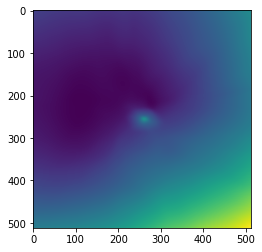

epoch 8101: 49.55270767211914
epoch 8102: 50.84797286987305
epoch 8103: 48.69915008544922
epoch 8104: 50.38529586791992
epoch 8105: 49.798892974853516
epoch 8106: 50.16231918334961
epoch 8107: 49.882911682128906
epoch 8108: 49.4438591003418
epoch 8109: 48.93769073486328
epoch 8111: 50.88874435424805
epoch 8112: 48.975738525390625
epoch 8113: 49.17042541503906
epoch 8114: 48.57283020019531
epoch 8115: 49.45979309082031
epoch 8116: 50.84259033203125
epoch 8117: 49.25088119506836
epoch 8118: 48.69114303588867
epoch 8119: 49.36128234863281
epoch 8121: 49.69297790527344
epoch 8122: 51.0628547668457
epoch 8123: 49.42815017700195
epoch 8124: 49.003517150878906
epoch 8125: 49.659873962402344
epoch 8126: 49.99252700805664
epoch 8127: 49.953487396240234
epoch 8128: 48.78238296508789
epoch 8129: 49.45695877075195
epoch 8131: 48.872833251953125
epoch 8132: 49.341365814208984
epoch 8133: 49.10023880004883
epoch 8134: 48.04754638671875
epoch 8135: 52.51355743408203
epoch 8136: 49.74163055419922
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



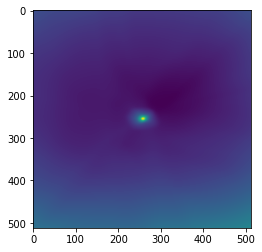

epoch 8201: 49.11268997192383
epoch 8202: 54.12968444824219
epoch 8203: 49.8876953125
epoch 8204: 48.550323486328125
epoch 8205: 49.92314529418945
epoch 8206: 49.21717071533203
epoch 8207: 51.16123962402344
epoch 8208: 49.68695831298828
epoch 8209: 49.46652603149414
epoch 8211: 49.55496597290039
epoch 8212: 49.55886459350586
epoch 8213: 49.2906608581543
epoch 8214: 49.9896240234375
epoch 8215: 49.82493591308594
epoch 8216: 50.85441970825195
epoch 8217: 48.89862060546875
epoch 8218: 49.47005081176758
epoch 8219: 49.161983489990234
epoch 8221: 49.90629959106445
epoch 8222: 48.369022369384766
epoch 8223: 49.31327438354492
epoch 8224: 49.006011962890625
epoch 8225: 48.787841796875
epoch 8226: 49.03730773925781
epoch 8227: 50.0226936340332
epoch 8228: 49.49152755737305
epoch 8229: 50.14667892456055
epoch 8231: 51.26816177368164
epoch 8232: 49.14628601074219
epoch 8233: 49.79996871948242
epoch 8234: 49.94622802734375
epoch 8235: 49.715145111083984
epoch 8236: 49.36072540283203
epoch 8237: 50

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



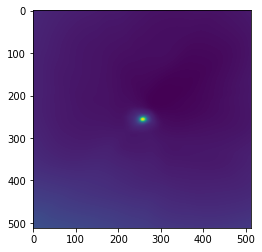

epoch 8301: 49.38325500488281
epoch 8302: 49.755584716796875
epoch 8303: 48.91325759887695
epoch 8304: 49.78260803222656
epoch 8305: 50.371036529541016
epoch 8306: 50.68096160888672
epoch 8307: 50.84651565551758
epoch 8308: 48.69636535644531
epoch 8309: 49.221153259277344
epoch 8311: 49.7629280090332
epoch 8312: 49.20063400268555
epoch 8313: 51.73279571533203
epoch 8314: 49.481170654296875
epoch 8315: 50.06593704223633
epoch 8316: 49.24930953979492
epoch 8317: 49.7015380859375
epoch 8318: 49.36977005004883
epoch 8319: 51.10863494873047
epoch 8321: 50.46525192260742
epoch 8322: 49.574283599853516
epoch 8323: 49.65050506591797
epoch 8324: 50.32933044433594
epoch 8325: 49.658050537109375
epoch 8326: 48.53886795043945
epoch 8327: 49.60663604736328
epoch 8328: 48.96937942504883
epoch 8329: 50.4630126953125
epoch 8331: 49.61651611328125
epoch 8332: 51.808433532714844
epoch 8333: 48.843963623046875
epoch 8334: 49.65480422973633
epoch 8335: 49.50264358520508
epoch 8336: 49.60825729370117
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



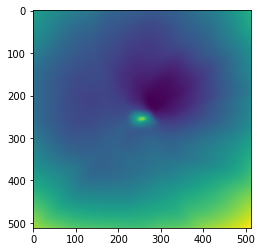

epoch 8401: 48.78560256958008
epoch 8402: 48.8416633605957
epoch 8403: 48.75951385498047
epoch 8404: 48.339813232421875
epoch 8405: 49.93727111816406
epoch 8406: 48.08642578125
epoch 8407: 50.32184982299805
epoch 8408: 49.73673629760742
epoch 8409: 50.9908332824707
epoch 8411: 49.370399475097656
epoch 8412: 51.20790481567383
epoch 8413: 49.876136779785156
epoch 8414: 49.0447998046875
epoch 8415: 48.52470779418945
epoch 8416: 49.16179656982422
epoch 8417: 52.825313568115234
epoch 8418: 48.68836975097656
epoch 8419: 48.622074127197266
epoch 8421: 48.647178649902344
epoch 8422: 49.81350326538086
epoch 8423: 49.75045394897461
epoch 8424: 49.360382080078125
epoch 8425: 48.638858795166016
epoch 8426: 51.31061935424805
epoch 8427: 48.764404296875
epoch 8428: 49.810420989990234
epoch 8429: 50.58942794799805
epoch 8431: 49.29600524902344
epoch 8432: 49.438819885253906
epoch 8433: 49.37943649291992
epoch 8434: 49.03205871582031
epoch 8435: 48.16445541381836
epoch 8436: 49.82577896118164
epoch 84

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



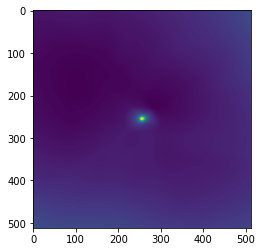

epoch 8501: 52.31754684448242
epoch 8502: 49.562156677246094
epoch 8503: 48.82823944091797
epoch 8504: 48.86936569213867
epoch 8505: 50.86680603027344
epoch 8506: 48.99894332885742
epoch 8507: 49.52305221557617
epoch 8508: 48.62736129760742
epoch 8509: 49.21574401855469
epoch 8511: 49.87922668457031
epoch 8512: 49.95700454711914
epoch 8513: 49.1638298034668
epoch 8514: 48.5007209777832
epoch 8515: 48.5421142578125
epoch 8516: 48.452518463134766
epoch 8517: 49.77730178833008
epoch 8518: 49.08019256591797
epoch 8519: 49.01350021362305
epoch 8521: 48.856895446777344
epoch 8522: 49.58760452270508
epoch 8523: 50.05158996582031
epoch 8524: 49.47364807128906
epoch 8525: 49.54617691040039
epoch 8526: 49.3466796875
epoch 8527: 48.82853698730469
epoch 8528: 47.99699020385742
epoch 8529: 50.30060958862305
epoch 8531: 48.725341796875
epoch 8532: 49.777679443359375
epoch 8533: 49.14531326293945
epoch 8534: 48.69912338256836
epoch 8535: 49.741455078125
epoch 8536: 48.817657470703125
epoch 8537: 49.4

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



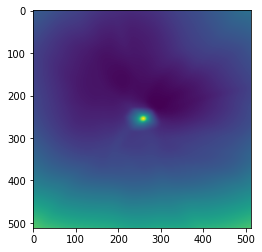

epoch 8601: 49.87767028808594
epoch 8602: 48.15846633911133
epoch 8603: 50.631187438964844
epoch 8604: 50.34815216064453
epoch 8605: 49.483882904052734
epoch 8606: 48.70014190673828
epoch 8607: 47.90837860107422
epoch 8608: 48.343482971191406
epoch 8609: 48.9842643737793
epoch 8611: 48.43011474609375
epoch 8612: 49.26931381225586
epoch 8613: 48.64328384399414
epoch 8614: 49.01293182373047
epoch 8615: 48.826419830322266
epoch 8616: 48.46949768066406
epoch 8617: 48.342864990234375
epoch 8618: 49.26997375488281
epoch 8619: 49.27320098876953
epoch 8621: 48.63994216918945
epoch 8622: 48.07569885253906
epoch 8623: 49.241600036621094
epoch 8624: 51.31990432739258
epoch 8625: 49.21636199951172
epoch 8626: 49.1839485168457
epoch 8627: 48.7933235168457
epoch 8628: 50.256256103515625
epoch 8629: 49.32015609741211
epoch 8631: 49.08930587768555
epoch 8632: 48.839027404785156
epoch 8633: 49.477027893066406
epoch 8634: 49.38115310668945
epoch 8635: 49.64567184448242
epoch 8636: 49.58481216430664
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



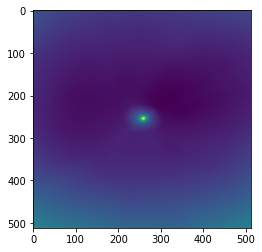

epoch 8701: 50.093624114990234
epoch 8702: 50.41416931152344
epoch 8703: 50.259342193603516
epoch 8704: 49.197288513183594
epoch 8705: 49.52873992919922
epoch 8706: 49.24955368041992
epoch 8707: 48.83219528198242
epoch 8708: 49.14283752441406
epoch 8709: 48.46067428588867
epoch 8711: 48.86043167114258
epoch 8712: 50.7099609375
epoch 8713: 48.56820297241211
epoch 8714: 48.495628356933594
epoch 8715: 49.50706481933594
epoch 8716: 49.68394088745117
epoch 8717: 48.866668701171875
epoch 8718: 50.54649353027344
epoch 8719: 49.47071075439453
epoch 8721: 48.751304626464844
epoch 8722: 49.59604263305664
epoch 8723: 49.88498306274414
epoch 8724: 51.279232025146484
epoch 8725: 49.058834075927734
epoch 8726: 50.29425048828125
epoch 8727: 50.447601318359375
epoch 8728: 49.42417526245117
epoch 8729: 49.04283142089844
epoch 8731: 49.44094467163086
epoch 8732: 49.93865203857422
epoch 8733: 48.89604949951172
epoch 8734: 49.002586364746094
epoch 8735: 49.19039535522461
epoch 8736: 48.29025650024414
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



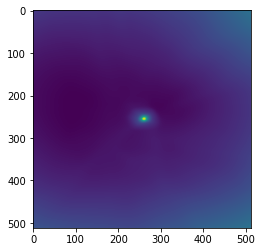

epoch 8801: 48.55742263793945
epoch 8802: 49.198341369628906
epoch 8803: 49.87310028076172
epoch 8804: 48.940765380859375
epoch 8805: 49.4565544128418
epoch 8806: 48.83588790893555
epoch 8807: 49.34898376464844
epoch 8808: 48.53934860229492
epoch 8809: 48.193397521972656
epoch 8811: 49.32044982910156
epoch 8812: 49.74644470214844
epoch 8813: 49.11985397338867
epoch 8814: 48.730228424072266
epoch 8815: 48.80750274658203
epoch 8816: 48.19745635986328
epoch 8817: 50.0775032043457
epoch 8818: 48.968074798583984
epoch 8819: 48.385467529296875
epoch 8821: 48.0598030090332
epoch 8822: 48.47133255004883
epoch 8823: 49.60527801513672
epoch 8824: 48.805442810058594
epoch 8825: 48.739288330078125
epoch 8826: 48.50784683227539
epoch 8827: 49.304771423339844
epoch 8828: 49.32618713378906
epoch 8829: 48.64735412597656
epoch 8831: 50.05147933959961
epoch 8832: 49.09433364868164
epoch 8833: 50.00800704956055
epoch 8834: 48.980262756347656
epoch 8835: 48.961761474609375
epoch 8836: 48.945213317871094
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



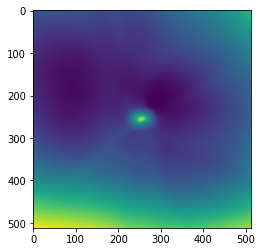

epoch 8901: 48.30194091796875
epoch 8902: 51.290889739990234
epoch 8903: 49.09171676635742
epoch 8904: 49.734615325927734
epoch 8905: 50.42179489135742
epoch 8906: 49.36827850341797
epoch 8907: 49.03632354736328
epoch 8908: 48.65320587158203
epoch 8909: 50.31028747558594
epoch 8911: 49.16139221191406
epoch 8912: 49.11906433105469
epoch 8913: 49.085487365722656
epoch 8914: 50.45941162109375
epoch 8915: 48.918983459472656
epoch 8916: 49.203060150146484
epoch 8917: 49.04719543457031
epoch 8918: 49.310367584228516
epoch 8919: 48.81632995605469
epoch 8921: 49.29868698120117
epoch 8922: 49.433021545410156
epoch 8923: 49.09016036987305
epoch 8924: 48.83810806274414
epoch 8925: 49.305885314941406
epoch 8926: 49.15385437011719
epoch 8927: 49.424896240234375
epoch 8928: 49.05774688720703
epoch 8929: 49.63103485107422
epoch 8931: 49.456214904785156
epoch 8932: 51.27691650390625
epoch 8933: 49.21815490722656
epoch 8934: 51.04013442993164
epoch 8935: 48.88639831542969
epoch 8936: 49.802703857421875

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



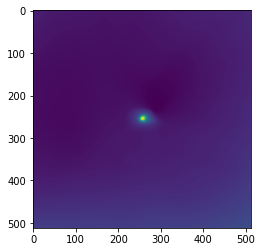

epoch 9001: 49.48292541503906
epoch 9002: 51.222923278808594
epoch 9003: 49.29960250854492
epoch 9004: 51.33616638183594
epoch 9005: 52.991939544677734
epoch 9006: 50.79625701904297
epoch 9007: 51.07850646972656
epoch 9008: 50.259891510009766
epoch 9009: 50.02268981933594
epoch 9011: 49.38344192504883
epoch 9012: 50.253841400146484
epoch 9013: 49.478126525878906
epoch 9014: 49.369842529296875
epoch 9015: 49.752017974853516
epoch 9016: 49.11246871948242
epoch 9017: 49.90584945678711
epoch 9018: 49.549041748046875
epoch 9019: 49.914058685302734
epoch 9021: 50.96867370605469
epoch 9022: 50.441856384277344
epoch 9023: 49.5452995300293
epoch 9024: 48.36473083496094
epoch 9025: 48.84891128540039
epoch 9026: 50.18657684326172
epoch 9027: 49.155513763427734
epoch 9028: 48.790863037109375
epoch 9029: 50.405033111572266
epoch 9031: 49.9997673034668
epoch 9032: 49.40986633300781
epoch 9033: 49.51360321044922
epoch 9034: 49.49949264526367
epoch 9035: 49.4647216796875
epoch 9036: 49.777000427246094

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



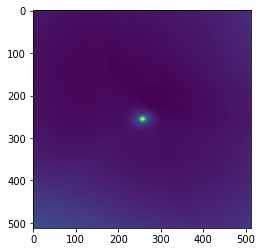

epoch 9101: 49.483089447021484
epoch 9102: 50.84840393066406
epoch 9103: 48.877159118652344
epoch 9104: 49.129608154296875
epoch 9105: 48.47606658935547
epoch 9106: 50.763057708740234
epoch 9107: 48.661766052246094
epoch 9108: 48.48077392578125
epoch 9109: 49.41709518432617
epoch 9111: 48.76905822753906
epoch 9112: 48.77118682861328
epoch 9113: 49.171817779541016
epoch 9114: 48.854644775390625
epoch 9115: 49.70609664916992
epoch 9116: 50.54059600830078
epoch 9117: 49.897159576416016
epoch 9118: 48.444664001464844
epoch 9119: 49.87143325805664
epoch 9121: 49.253108978271484
epoch 9122: 49.32460403442383
epoch 9123: 49.146339416503906
epoch 9124: 50.11161422729492
epoch 9125: 51.71202850341797
epoch 9126: 50.27196502685547
epoch 9127: 49.33024978637695
epoch 9128: 50.76505661010742
epoch 9129: 48.984039306640625
epoch 9131: 48.828819274902344
epoch 9132: 49.632476806640625
epoch 9133: 49.920440673828125
epoch 9134: 50.1097526550293
epoch 9135: 50.00370407104492
epoch 9136: 49.02145385742

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



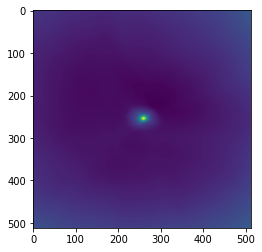

epoch 9201: 48.697052001953125
epoch 9202: 48.79953384399414
epoch 9203: 48.754905700683594
epoch 9204: 48.71989822387695
epoch 9205: 52.51728439331055
epoch 9206: 48.76898956298828
epoch 9207: 50.30292510986328
epoch 9208: 50.073394775390625
epoch 9209: 49.19410705566406
epoch 9211: 49.692928314208984
epoch 9212: 49.318641662597656
epoch 9213: 50.204612731933594
epoch 9214: 51.002647399902344
epoch 9215: 49.970523834228516
epoch 9216: 53.01860809326172
epoch 9217: 50.596248626708984
epoch 9218: 51.56570816040039
epoch 9219: 50.08512496948242
epoch 9221: 51.11646270751953
epoch 9222: 49.99433135986328
epoch 9223: 51.43353271484375
epoch 9224: 50.507530212402344
epoch 9225: 48.91338348388672
epoch 9226: 49.71294021606445
epoch 9227: 49.914520263671875
epoch 9228: 50.244140625
epoch 9229: 50.50565719604492
epoch 9231: 50.94719314575195
epoch 9232: 49.53822326660156
epoch 9233: 51.70612716674805
epoch 9234: 49.05558776855469
epoch 9235: 50.085262298583984
epoch 9236: 48.93701171875
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



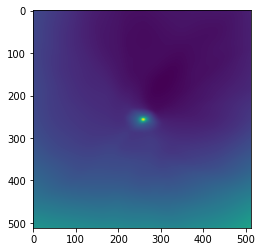

epoch 9301: 49.27837371826172
epoch 9302: 49.46360778808594
epoch 9303: 48.70027160644531
epoch 9304: 50.10462951660156
epoch 9305: 49.40911865234375
epoch 9306: 51.199867248535156
epoch 9307: 48.933349609375
epoch 9308: 50.223876953125
epoch 9309: 50.91811752319336
epoch 9311: 49.334293365478516
epoch 9312: 49.18018341064453
epoch 9313: 50.1650505065918
epoch 9314: 50.35740661621094
epoch 9315: 48.823062896728516
epoch 9316: 50.4622688293457
epoch 9317: 49.60713195800781
epoch 9318: 49.098323822021484
epoch 9319: 49.44892120361328
epoch 9321: 50.36799240112305
epoch 9322: 49.318180084228516
epoch 9323: 50.06924057006836
epoch 9324: 49.934661865234375
epoch 9325: 49.72534942626953
epoch 9326: 50.819419860839844
epoch 9327: 49.6191291809082
epoch 9328: 49.02064514160156
epoch 9329: 49.64508819580078
epoch 9331: 48.95127487182617
epoch 9332: 49.15525817871094
epoch 9333: 49.58437728881836
epoch 9334: 51.2008171081543
epoch 9335: 50.29048538208008
epoch 9336: 49.769775390625
epoch 9337: 4

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



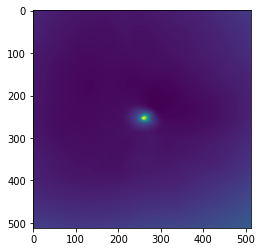

epoch 9401: 48.38340377807617
epoch 9402: 48.918556213378906
epoch 9403: 49.00201416015625
epoch 9404: 48.361305236816406
epoch 9405: 48.313167572021484
epoch 9406: 49.27431106567383
epoch 9407: 48.38771057128906
epoch 9408: 50.632286071777344
epoch 9409: 49.07415771484375
epoch 9411: 49.52131271362305
epoch 9412: 47.77100372314453
epoch 9413: 49.600318908691406
epoch 9414: 48.3770637512207
epoch 9415: 49.25062561035156
epoch 9416: 48.61356735229492
epoch 9417: 48.74734115600586
epoch 9418: 49.58451461791992
epoch 9419: 50.02521514892578
epoch 9421: 48.7055778503418
epoch 9422: 49.7309684753418
epoch 9423: 49.30849838256836
epoch 9424: 48.616878509521484
epoch 9425: 49.14399337768555
epoch 9426: 48.463802337646484
epoch 9427: 48.88685989379883
epoch 9428: 49.68022918701172
epoch 9429: 49.47907638549805
epoch 9431: 48.55783462524414
epoch 9432: 53.27210998535156
epoch 9433: 49.176353454589844
epoch 9434: 49.47504806518555
epoch 9435: 49.184627532958984
epoch 9436: 48.77831268310547
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



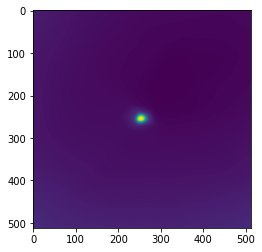

epoch 9501: 49.69774627685547
epoch 9502: 49.970367431640625
epoch 9503: 49.242774963378906
epoch 9504: 49.79126739501953
epoch 9505: 49.64622116088867
epoch 9506: 49.11029052734375
epoch 9507: 49.619964599609375
epoch 9508: 49.82570266723633
epoch 9509: 49.75550079345703
epoch 9511: 50.24919891357422
epoch 9512: 49.34755325317383
epoch 9513: 49.01665496826172
epoch 9514: 50.73912811279297
epoch 9515: 49.40189743041992
epoch 9516: 48.85432434082031
epoch 9517: 50.599246978759766
epoch 9518: 49.0124397277832
epoch 9519: 51.224998474121094
epoch 9521: 49.858036041259766
epoch 9522: 49.14122772216797
epoch 9523: 49.8723258972168
epoch 9524: 49.12995147705078
epoch 9525: 48.93553924560547
epoch 9526: 49.3390998840332
epoch 9527: 50.05643844604492
epoch 9528: 49.586395263671875
epoch 9529: 49.31969451904297
epoch 9531: 50.04949188232422
epoch 9532: 49.524757385253906
epoch 9533: 49.83377456665039
epoch 9534: 50.46985626220703
epoch 9535: 49.82646560668945
epoch 9536: 50.63532257080078
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



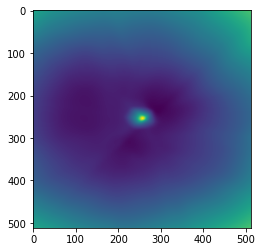

epoch 9601: 48.971099853515625
epoch 9602: 48.091514587402344
epoch 9603: 49.607574462890625
epoch 9604: 49.12004852294922
epoch 9605: 49.52925491333008
epoch 9606: 49.32143020629883
epoch 9607: 50.8875617980957
epoch 9608: 49.094669342041016
epoch 9609: 49.407814025878906
epoch 9611: 48.79701614379883
epoch 9612: 48.4237060546875
epoch 9613: 49.507720947265625
epoch 9614: 48.94483184814453
epoch 9615: 49.80339050292969
epoch 9616: 48.90779495239258
epoch 9617: 49.70820999145508
epoch 9618: 48.95789337158203
epoch 9619: 49.85987091064453
epoch 9621: 49.66071319580078
epoch 9622: 49.1959342956543
epoch 9623: 49.35591125488281
epoch 9624: 48.325992584228516
epoch 9625: 49.555999755859375
epoch 9626: 48.36956024169922
epoch 9627: 50.2879638671875
epoch 9628: 49.58555603027344
epoch 9629: 49.14857864379883
epoch 9631: 48.74974822998047
epoch 9632: 48.7852668762207
epoch 9633: 48.731327056884766
epoch 9634: 52.348731994628906
epoch 9635: 48.819000244140625
epoch 9636: 49.371986389160156
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



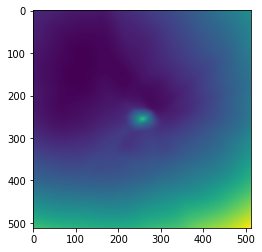

epoch 9701: 49.108360290527344
epoch 9702: 50.3262825012207
epoch 9703: 48.809444427490234
epoch 9704: 50.375099182128906
epoch 9705: 50.820194244384766
epoch 9706: 49.39997863769531
epoch 9707: 49.28899383544922
epoch 9708: 49.61260986328125
epoch 9709: 49.60306167602539
epoch 9711: 48.99517059326172
epoch 9712: 49.256351470947266
epoch 9713: 50.48160934448242
epoch 9714: 49.641319274902344
epoch 9715: 49.05845260620117
epoch 9716: 49.27708053588867
epoch 9717: 49.993194580078125
epoch 9718: 49.43824768066406
epoch 9719: 49.27598571777344
epoch 9721: 50.533897399902344
epoch 9722: 49.7791748046875
epoch 9723: 49.05567932128906
epoch 9724: 49.9082145690918
epoch 9725: 49.406341552734375
epoch 9726: 48.79159927368164
epoch 9727: 49.694725036621094
epoch 9728: 49.49516296386719
epoch 9729: 49.386390686035156
epoch 9731: 48.47933578491211
epoch 9732: 52.390525817871094
epoch 9733: 48.88784408569336
epoch 9734: 50.217979431152344
epoch 9735: 49.169944763183594
epoch 9736: 49.65077972412109

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



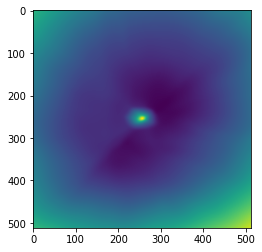

epoch 9801: 48.74675750732422
epoch 9802: 49.08932113647461
epoch 9803: 49.23764419555664
epoch 9804: 48.83302307128906
epoch 9805: 48.80039596557617
epoch 9806: 49.49685287475586
epoch 9807: 49.106693267822266
epoch 9808: 48.94583511352539
epoch 9809: 48.96504211425781
epoch 9811: 48.62181091308594
epoch 9812: 49.20896530151367
epoch 9813: 50.88107681274414
epoch 9814: 48.163387298583984
epoch 9815: 48.48642349243164
epoch 9816: 50.22288513183594
epoch 9817: 49.09994125366211
epoch 9818: 48.315185546875
epoch 9819: 49.29878616333008
epoch 9821: 48.89788818359375
epoch 9822: 48.88774871826172
epoch 9823: 48.646629333496094
epoch 9824: 48.68879318237305
epoch 9825: 49.244964599609375
epoch 9826: 49.518558502197266
epoch 9827: 49.243736267089844
epoch 9828: 49.4114875793457
epoch 9829: 51.602928161621094
epoch 9831: 48.96335220336914
epoch 9832: 50.00773620605469
epoch 9833: 49.44642639160156
epoch 9834: 51.26493835449219
epoch 9835: 49.01603698730469
epoch 9836: 48.05870819091797
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



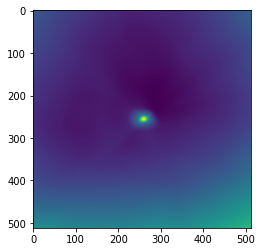

epoch 9901: 48.91860580444336
epoch 9902: 48.95989990234375
epoch 9903: 52.10304260253906
epoch 9904: 49.842952728271484
epoch 9905: 49.8411865234375
epoch 9906: 50.579532623291016
epoch 9907: 48.76199722290039
epoch 9908: 49.519161224365234
epoch 9909: 49.30582809448242
epoch 9911: 48.196502685546875
epoch 9912: 49.02558135986328
epoch 9913: 49.739322662353516
epoch 9914: 49.47210693359375
epoch 9915: 48.613555908203125
epoch 9916: 49.177738189697266
epoch 9917: 50.47775650024414
epoch 9918: 49.16351318359375
epoch 9919: 48.94658660888672
epoch 9921: 49.350013732910156
epoch 9922: 49.45425796508789
epoch 9923: 49.30314636230469
epoch 9924: 49.790367126464844
epoch 9925: 49.898231506347656
epoch 9926: 50.37995910644531
epoch 9927: 49.91073226928711
epoch 9928: 49.34996032714844
epoch 9929: 49.98698425292969
epoch 9931: 50.412818908691406
epoch 9932: 50.1754035949707
epoch 9933: 49.698516845703125
epoch 9934: 50.53345489501953
epoch 9935: 49.80599594116211
epoch 9936: 49.11555099487305


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



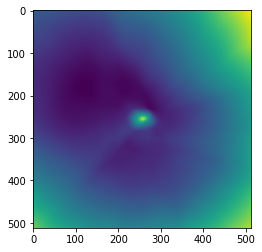

epoch 10001: 49.460243225097656
epoch 10002: 48.380897521972656
epoch 10003: 48.435543060302734
epoch 10004: 48.4018669128418
epoch 10005: 49.186458587646484
epoch 10006: 47.77566146850586
epoch 10007: 50.01608657836914
epoch 10008: 48.76860809326172
epoch 10009: 48.78799819946289
epoch 10011: 48.744083404541016
epoch 10012: 49.48788070678711
epoch 10013: 48.95452117919922
epoch 10014: 48.42422103881836
epoch 10015: 49.08460235595703
epoch 10016: 48.404296875
epoch 10017: 48.45927429199219
epoch 10018: 49.05091094970703
epoch 10019: 49.39178466796875
epoch 10021: 48.88280487060547
epoch 10022: 49.08771896362305
epoch 10023: 49.07966613769531
epoch 10024: 48.38065719604492
epoch 10025: 49.338706970214844
epoch 10026: 48.79893493652344
epoch 10027: 48.73408508300781
epoch 10028: 49.379940032958984
epoch 10029: 49.285770416259766
epoch 10031: 48.38672637939453
epoch 10032: 48.185237884521484
epoch 10033: 50.016265869140625
epoch 10034: 49.2440185546875
epoch 10035: 49.342529296875
epoch 1

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



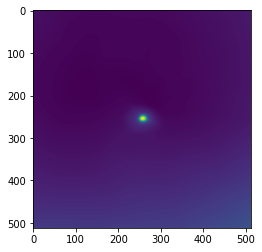

epoch 10101: 49.79319763183594
epoch 10102: 53.129173278808594
epoch 10103: 49.4896354675293
epoch 10104: 49.20338821411133
epoch 10105: 49.06883239746094
epoch 10106: 50.113651275634766
epoch 10107: 49.46125793457031
epoch 10108: 49.34859848022461
epoch 10109: 50.11794662475586
epoch 10111: 48.53712463378906
epoch 10112: 49.298736572265625
epoch 10113: 48.759307861328125
epoch 10114: 49.694793701171875
epoch 10115: 48.37711715698242
epoch 10116: 48.765106201171875
epoch 10117: 48.354530334472656
epoch 10118: 48.89963150024414
epoch 10119: 49.55543899536133
epoch 10121: 48.25328063964844
epoch 10122: 49.0311279296875
epoch 10123: 48.49129867553711
epoch 10124: 49.602420806884766
epoch 10125: 49.8779411315918
epoch 10126: 48.780975341796875
epoch 10127: 48.78740692138672
epoch 10128: 48.918212890625
epoch 10129: 48.20878601074219
epoch 10131: 48.195770263671875
epoch 10132: 50.007694244384766
epoch 10133: 49.030738830566406
epoch 10134: 48.09602737426758
epoch 10135: 48.912147521972656


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



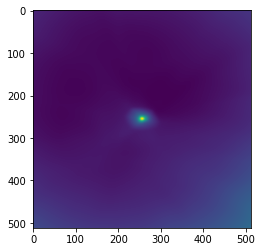

epoch 10201: 49.3913459777832
epoch 10202: 49.51080322265625
epoch 10203: 49.58930969238281
epoch 10204: 49.10736846923828
epoch 10205: 49.47846603393555
epoch 10206: 49.63011169433594
epoch 10207: 49.08960723876953
epoch 10208: 50.89140319824219
epoch 10209: 50.07832717895508
epoch 10211: 49.7216796875
epoch 10212: 49.229732513427734
epoch 10213: 49.83433151245117
epoch 10214: 49.89385223388672
epoch 10215: 48.07926940917969
epoch 10216: 48.97295379638672
epoch 10217: 50.37476348876953
epoch 10218: 49.083656311035156
epoch 10219: 49.546112060546875
epoch 10221: 50.12940979003906
epoch 10222: 48.3935661315918
epoch 10223: 49.802215576171875
epoch 10224: 49.65121078491211
epoch 10225: 48.7382926940918
epoch 10226: 49.16006088256836
epoch 10227: 48.745182037353516
epoch 10228: 49.539161682128906
epoch 10229: 49.0933952331543
epoch 10231: 49.1353759765625
epoch 10232: 50.27740478515625
epoch 10233: 49.269813537597656
epoch 10234: 49.44437026977539
epoch 10235: 50.237518310546875
epoch 102

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



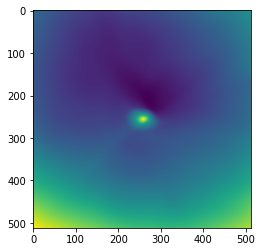

epoch 10301: 48.70361328125
epoch 10302: 49.6213264465332
epoch 10303: 50.2885856628418
epoch 10304: 48.442325592041016
epoch 10305: 49.38610076904297
epoch 10306: 49.03271484375
epoch 10307: 49.08989334106445
epoch 10308: 48.83671188354492
epoch 10309: 50.21181869506836
epoch 10311: 48.72438430786133
epoch 10312: 48.93471145629883
epoch 10313: 48.84477233886719
epoch 10314: 48.498111724853516
epoch 10315: 49.740623474121094
epoch 10316: 48.77219772338867
epoch 10317: 48.81117248535156
epoch 10318: 49.50051498413086
epoch 10319: 49.29908752441406
epoch 10321: 48.64484405517578
epoch 10322: 49.70783615112305
epoch 10323: 49.9547233581543
epoch 10324: 48.95016098022461
epoch 10325: 49.11448669433594
epoch 10326: 48.995426177978516
epoch 10327: 48.63219451904297
epoch 10328: 48.879539489746094
epoch 10329: 48.93065643310547
epoch 10331: 48.979034423828125
epoch 10332: 48.547447204589844
epoch 10333: 48.29692459106445
epoch 10334: 49.751373291015625
epoch 10335: 48.26649475097656
epoch 103

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



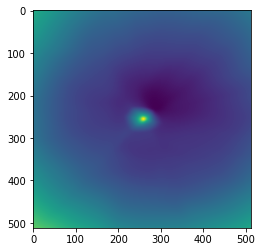

epoch 10401: 49.05239486694336
epoch 10402: 49.79745864868164
epoch 10403: 49.70545196533203
epoch 10404: 50.125389099121094
epoch 10405: 49.41426467895508
epoch 10406: 49.673641204833984
epoch 10407: 48.382484436035156
epoch 10408: 49.05359649658203
epoch 10409: 49.483726501464844
epoch 10411: 49.15227127075195
epoch 10412: 49.84684753417969
epoch 10413: 50.471744537353516
epoch 10414: 48.77994155883789
epoch 10415: 49.626644134521484
epoch 10416: 49.521568298339844
epoch 10417: 50.035545349121094
epoch 10418: 48.99394607543945
epoch 10419: 49.2599983215332
epoch 10421: 49.37494659423828
epoch 10422: 48.955223083496094
epoch 10423: 48.72404098510742
epoch 10424: 48.63414001464844
epoch 10425: 48.93197250366211
epoch 10426: 48.957435607910156
epoch 10427: 50.41826248168945
epoch 10428: 48.8890380859375
epoch 10429: 49.20447540283203
epoch 10431: 48.67036437988281
epoch 10432: 48.978424072265625
epoch 10433: 49.98153305053711
epoch 10434: 49.610355377197266
epoch 10435: 50.1853446960449

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



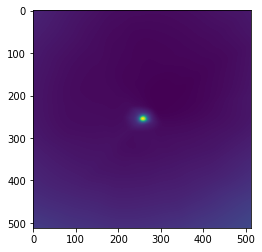

epoch 10501: 51.95121765136719
epoch 10502: 50.376365661621094
epoch 10503: 49.001373291015625
epoch 10504: 49.563499450683594
epoch 10505: 48.42697525024414
epoch 10506: 48.73599624633789
epoch 10507: 48.943912506103516
epoch 10508: 48.680973052978516
epoch 10509: 49.48472213745117
epoch 10511: 48.99644088745117
epoch 10512: 48.85529327392578
epoch 10513: 48.96461486816406
epoch 10514: 48.92948913574219
epoch 10515: 48.972660064697266
epoch 10516: 48.996376037597656
epoch 10517: 48.523990631103516
epoch 10518: 48.69401168823242
epoch 10519: 49.541046142578125
epoch 10521: 49.1536750793457
epoch 10522: 48.37970733642578
epoch 10523: 49.37445831298828
epoch 10524: 47.97515106201172
epoch 10525: 48.72706985473633
epoch 10526: 48.49856185913086
epoch 10527: 48.963340759277344
epoch 10528: 48.55009460449219
epoch 10529: 49.641510009765625
epoch 10531: 48.211727142333984
epoch 10532: 48.86973571777344
epoch 10533: 49.92866897583008
epoch 10534: 51.584007263183594
epoch 10535: 49.99473953247

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



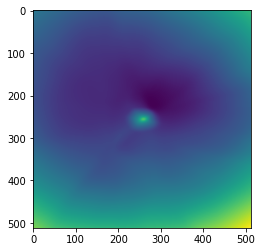

epoch 10601: 50.53929138183594
epoch 10602: 49.32468032836914
epoch 10603: 48.161380767822266
epoch 10604: 48.54987335205078
epoch 10605: 49.609336853027344
epoch 10606: 49.55124282836914
epoch 10607: 48.51720428466797
epoch 10608: 49.2563362121582
epoch 10609: 48.842586517333984
epoch 10611: 49.591705322265625
epoch 10612: 49.1660270690918
epoch 10613: 48.492427825927734
epoch 10614: 48.89649963378906
epoch 10615: 48.838050842285156
epoch 10616: 51.68136215209961
epoch 10617: 48.76641082763672
epoch 10618: 48.3751335144043
epoch 10619: 49.05217361450195
epoch 10621: 48.32374572753906
epoch 10622: 49.31625747680664
epoch 10623: 48.90760803222656
epoch 10624: 49.044708251953125
epoch 10625: 49.0761604309082
epoch 10626: 48.062767028808594
epoch 10627: 48.59471130371094
epoch 10628: 49.7183952331543
epoch 10629: 49.85920715332031
epoch 10631: 49.001983642578125
epoch 10632: 48.35105895996094
epoch 10633: 48.94325637817383
epoch 10634: 49.045623779296875
epoch 10635: 48.50009536743164
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



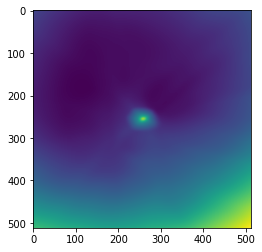

epoch 10701: 48.894775390625
epoch 10702: 48.59181594848633
epoch 10703: 48.69642639160156
epoch 10704: 48.79019546508789
epoch 10705: 49.39995574951172
epoch 10706: 48.346866607666016
epoch 10707: 49.68228530883789
epoch 10708: 48.47010040283203
epoch 10709: 48.31388854980469
epoch 10711: 50.29009246826172
epoch 10712: 50.56113052368164
epoch 10713: 47.952117919921875
epoch 10714: 48.25615692138672
epoch 10715: 48.55297088623047
epoch 10716: 49.205467224121094
epoch 10717: 50.51310348510742
epoch 10718: 48.24052047729492
epoch 10719: 48.85688018798828
epoch 10721: 49.085086822509766
epoch 10722: 50.35490798950195
epoch 10723: 48.4124641418457
epoch 10724: 49.34191131591797
epoch 10725: 49.50128173828125
epoch 10726: 49.31078338623047
epoch 10727: 48.78913879394531
epoch 10728: 48.98706817626953
epoch 10729: 48.86410140991211
epoch 10731: 48.516868591308594
epoch 10732: 49.935081481933594
epoch 10733: 49.36422348022461
epoch 10734: 50.90503692626953
epoch 10735: 49.19398498535156
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



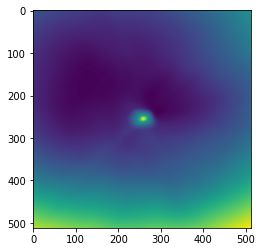

epoch 10801: 48.55491256713867
epoch 10802: 48.93846130371094
epoch 10803: 48.71865463256836
epoch 10804: 49.10955047607422
epoch 10805: 48.99584197998047
epoch 10806: 49.36050033569336
epoch 10807: 48.660003662109375
epoch 10808: 48.65975570678711
epoch 10809: 49.84126663208008
epoch 10811: 49.75019454956055
epoch 10812: 48.5341796875
epoch 10813: 48.30885696411133
epoch 10814: 49.04875946044922
epoch 10815: 48.57374572753906
epoch 10816: 49.11864471435547
epoch 10817: 48.23784637451172
epoch 10818: 49.2693977355957
epoch 10819: 51.065887451171875
epoch 10821: 49.50551986694336
epoch 10822: 49.0416259765625
epoch 10823: 49.015480041503906
epoch 10824: 48.01976013183594
epoch 10825: 48.805686950683594
epoch 10826: 48.8261833190918
epoch 10827: 49.88616180419922
epoch 10828: 48.59482192993164
epoch 10829: 48.6170768737793
epoch 10831: 49.83842086791992
epoch 10832: 51.310272216796875
epoch 10833: 48.62246322631836
epoch 10834: 49.99691390991211
epoch 10835: 48.24628448486328
epoch 10836

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



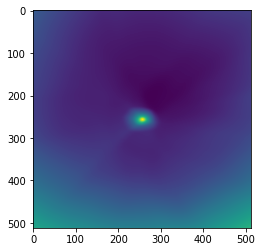

epoch 10901: 49.03620147705078
epoch 10902: 48.660072326660156
epoch 10903: 49.10234832763672
epoch 10904: 48.909759521484375
epoch 10905: 49.898529052734375
epoch 10906: 49.33470153808594
epoch 10907: 48.766483306884766
epoch 10908: 49.222434997558594
epoch 10909: 49.432498931884766
epoch 10911: 50.5977783203125
epoch 10912: 50.03489303588867
epoch 10913: 49.573612213134766
epoch 10914: 49.41183853149414
epoch 10915: 48.988834381103516
epoch 10916: 49.37643051147461
epoch 10917: 48.17179870605469
epoch 10918: 49.44087219238281
epoch 10919: 48.89986801147461
epoch 10921: 49.001983642578125
epoch 10922: 48.85839080810547
epoch 10923: 50.05857849121094
epoch 10924: 50.53131103515625
epoch 10925: 49.16195297241211
epoch 10926: 49.69382858276367
epoch 10927: 49.097755432128906
epoch 10928: 49.56740188598633
epoch 10929: 48.65406799316406
epoch 10931: 49.24946212768555
epoch 10932: 48.86385726928711
epoch 10933: 50.312374114990234
epoch 10934: 49.43843078613281
epoch 10935: 50.8242149353027

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



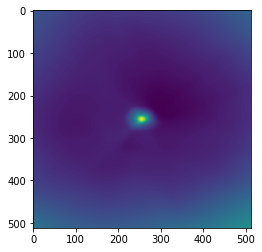

epoch 11001: 48.62165832519531
epoch 11002: 48.56422424316406
epoch 11003: 48.16648483276367
epoch 11004: 50.78765106201172
epoch 11005: 47.520057678222656
epoch 11006: 48.62629699707031
epoch 11007: 49.586116790771484
epoch 11008: 48.699119567871094
epoch 11009: 49.136962890625
epoch 11011: 49.111717224121094
epoch 11012: 48.66152572631836
epoch 11013: 48.58684158325195
epoch 11014: 50.17634582519531
epoch 11015: 49.03997039794922
epoch 11016: 50.3540153503418
epoch 11017: 48.051856994628906
epoch 11018: 48.452701568603516
epoch 11019: 48.75836181640625
epoch 11021: 48.84246063232422
epoch 11022: 50.34330749511719
epoch 11023: 48.594993591308594
epoch 11024: 48.91788864135742
epoch 11025: 47.667327880859375
epoch 11026: 49.61663818359375
epoch 11027: 49.001705169677734
epoch 11028: 48.364158630371094
epoch 11029: 48.81376647949219
epoch 11031: 49.46237564086914
epoch 11032: 48.6942253112793
epoch 11033: 49.64073181152344
epoch 11034: 48.923954010009766
epoch 11035: 48.93194580078125
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



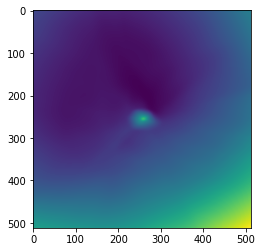

epoch 11101: 49.832847595214844
epoch 11102: 48.966331481933594
epoch 11103: 48.84102249145508
epoch 11104: 49.29096603393555
epoch 11105: 48.58011245727539
epoch 11106: 48.3875617980957
epoch 11107: 48.69700622558594
epoch 11108: 49.19307327270508
epoch 11109: 49.011898040771484
epoch 11111: 48.74949264526367
epoch 11112: 48.4997673034668
epoch 11113: 48.347129821777344
epoch 11114: 51.593177795410156
epoch 11115: 49.063228607177734
epoch 11116: 48.420379638671875
epoch 11117: 48.29563522338867
epoch 11118: 48.7115478515625
epoch 11119: 47.857032775878906
epoch 11121: 48.742584228515625
epoch 11122: 51.50590515136719
epoch 11123: 49.6548957824707
epoch 11124: 48.55732727050781
epoch 11125: 48.82258605957031
epoch 11126: 48.79595184326172
epoch 11127: 49.11601257324219
epoch 11128: 50.83431625366211
epoch 11129: 49.6679801940918
epoch 11131: 48.91734313964844
epoch 11132: 49.96583938598633
epoch 11133: 48.5472412109375
epoch 11134: 48.73215103149414
epoch 11135: 48.72334671020508
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



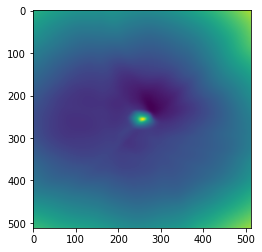

epoch 11201: 49.090389251708984
epoch 11202: 48.893367767333984
epoch 11203: 48.37128829956055
epoch 11204: 48.91511535644531
epoch 11205: 48.807708740234375
epoch 11206: 49.753150939941406
epoch 11207: 48.765106201171875
epoch 11208: 48.500946044921875
epoch 11209: 48.36039733886719
epoch 11211: 49.46966552734375
epoch 11212: 49.51685333251953
epoch 11213: 49.090511322021484
epoch 11214: 49.454227447509766
epoch 11215: 49.234832763671875
epoch 11216: 47.79527282714844
epoch 11217: 48.55810546875
epoch 11218: 48.44690704345703
epoch 11219: 47.824729919433594
epoch 11221: 49.3598747253418
epoch 11222: 49.67141342163086
epoch 11223: 48.77906799316406
epoch 11224: 48.77443313598633
epoch 11225: 48.35456848144531
epoch 11226: 49.295860290527344
epoch 11227: 51.056339263916016
epoch 11228: 48.548240661621094
epoch 11229: 48.17086410522461
epoch 11231: 48.41779708862305
epoch 11232: 48.72843933105469
epoch 11233: 49.344505310058594
epoch 11234: 48.88964080810547
epoch 11235: 49.0615844726562

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



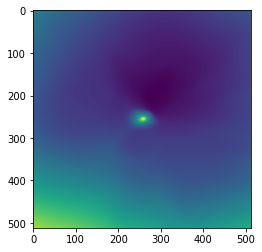

epoch 11301: 49.17083740234375
epoch 11302: 48.9600715637207
epoch 11303: 48.839332580566406
epoch 11304: 48.41790771484375
epoch 11305: 48.77070999145508
epoch 11306: 48.68516540527344
epoch 11307: 48.487831115722656
epoch 11308: 50.174068450927734
epoch 11309: 49.4994010925293
epoch 11311: 49.27696990966797
epoch 11312: 49.94382095336914
epoch 11313: 49.23097229003906
epoch 11314: 49.33424377441406
epoch 11315: 48.936668395996094
epoch 11316: 49.5437126159668
epoch 11317: 48.4051628112793
epoch 11318: 49.598716735839844
epoch 11319: 48.144622802734375
epoch 11321: 49.31418991088867
epoch 11322: 51.77143096923828
epoch 11323: 49.695396423339844
epoch 11324: 48.52102279663086
epoch 11325: 48.69059753417969
epoch 11326: 49.359004974365234
epoch 11327: 49.873050689697266
epoch 11328: 48.47360610961914
epoch 11329: 50.124053955078125
epoch 11331: 48.04777526855469
epoch 11332: 48.883018493652344
epoch 11333: 48.080814361572266
epoch 11334: 48.093238830566406
epoch 11335: 49.61059188842773

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



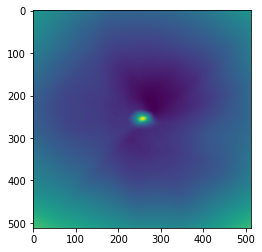

epoch 11401: 49.049560546875
epoch 11402: 48.228248596191406
epoch 11403: 49.18672180175781
epoch 11404: 48.61831283569336
epoch 11405: 49.269073486328125
epoch 11406: 48.45882034301758
epoch 11407: 48.69709777832031
epoch 11408: 48.27883529663086
epoch 11409: 48.54353713989258
epoch 11411: 48.52420425415039
epoch 11412: 49.08174133300781
epoch 11413: 48.890296936035156
epoch 11414: 49.180904388427734
epoch 11415: 49.24730682373047
epoch 11416: 49.07914352416992
epoch 11417: 48.99123001098633
epoch 11418: 48.86993408203125
epoch 11419: 48.4205207824707
epoch 11421: 47.88554382324219
epoch 11422: 49.19217300415039
epoch 11423: 48.87474822998047
epoch 11424: 50.57387161254883
epoch 11425: 48.600250244140625
epoch 11426: 50.02866744995117
epoch 11427: 48.48253631591797
epoch 11428: 49.367591857910156
epoch 11429: 48.632041931152344
epoch 11431: 49.74058532714844
epoch 11432: 48.85739517211914
epoch 11433: 49.3629150390625
epoch 11434: 49.19995880126953
epoch 11435: 49.06167984008789
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



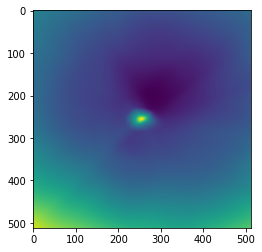

epoch 11501: 48.92081069946289
epoch 11502: 49.62955856323242
epoch 11503: 50.63502502441406
epoch 11504: 48.54921340942383
epoch 11505: 49.11493682861328
epoch 11506: 48.51008987426758
epoch 11507: 48.31537628173828
epoch 11508: 49.4581184387207
epoch 11509: 49.18309783935547
epoch 11511: 49.26088333129883
epoch 11512: 49.01797866821289
epoch 11513: 49.59882736206055
epoch 11514: 48.967533111572266
epoch 11515: 49.48695755004883
epoch 11516: 49.316795349121094
epoch 11517: 48.7364387512207
epoch 11518: 50.65182113647461
epoch 11519: 48.33531188964844
epoch 11521: 48.96052169799805
epoch 11522: 49.2005615234375
epoch 11523: 48.66777420043945
epoch 11524: 51.21614456176758
epoch 11525: 48.37749099731445
epoch 11526: 48.330387115478516
epoch 11527: 49.09577941894531
epoch 11528: 49.31520080566406
epoch 11529: 52.33517074584961
epoch 11531: 48.419715881347656
epoch 11532: 48.69198226928711
epoch 11533: 48.847511291503906
epoch 11534: 48.454620361328125
epoch 11535: 48.911251068115234
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



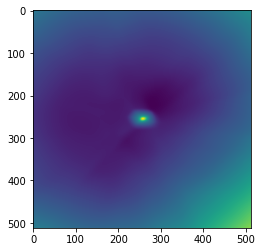

epoch 11601: 48.982147216796875
epoch 11602: 48.98506546020508
epoch 11603: 48.622093200683594
epoch 11604: 49.019805908203125
epoch 11605: 48.51694107055664
epoch 11606: 49.40806579589844
epoch 11607: 47.82814407348633
epoch 11608: 48.402732849121094
epoch 11609: 49.958011627197266
epoch 11611: 49.38645935058594
epoch 11612: 49.710445404052734
epoch 11613: 49.288089752197266
epoch 11614: 49.42315673828125
epoch 11615: 48.75074005126953
epoch 11616: 48.862159729003906
epoch 11617: 49.88985061645508
epoch 11618: 48.46153259277344
epoch 11619: 49.4150390625
epoch 11621: 47.927337646484375
epoch 11622: 48.83150100708008
epoch 11623: 49.12388610839844
epoch 11624: 47.762550354003906
epoch 11625: 48.88943862915039
epoch 11626: 51.975608825683594
epoch 11627: 48.84682083129883
epoch 11628: 49.35464859008789
epoch 11629: 48.21424865722656
epoch 11631: 48.57612228393555
epoch 11632: 48.07132339477539
epoch 11633: 48.57246017456055
epoch 11634: 49.88086700439453
epoch 11635: 55.799095153808594


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



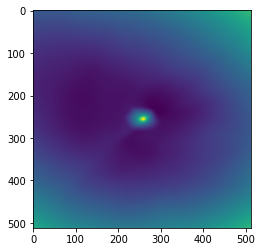

epoch 11701: 49.14301300048828
epoch 11702: 49.678436279296875
epoch 11703: 48.871952056884766
epoch 11704: 49.571170806884766
epoch 11705: 48.654945373535156
epoch 11706: 48.3860969543457
epoch 11707: 47.67653274536133
epoch 11708: 48.52061462402344
epoch 11709: 48.882442474365234
epoch 11711: 48.6029167175293
epoch 11712: 53.17607116699219
epoch 11713: 49.09184646606445
epoch 11714: 48.80027770996094
epoch 11715: 49.384830474853516
epoch 11716: 49.05290222167969
epoch 11717: 50.768192291259766
epoch 11718: 49.71270751953125
epoch 11719: 50.66516876220703
epoch 11721: 49.049285888671875
epoch 11722: 48.53008270263672
epoch 11723: 49.94055938720703
epoch 11724: 49.5095100402832
epoch 11725: 49.03645324707031
epoch 11726: 48.979610443115234
epoch 11727: 50.153011322021484
epoch 11728: 49.12489700317383
epoch 11729: 48.75883865356445
epoch 11731: 48.5461540222168
epoch 11732: 48.986080169677734
epoch 11733: 48.568359375
epoch 11734: 49.424591064453125
epoch 11735: 49.0097541809082
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



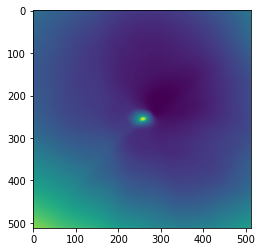

epoch 11801: 48.67745590209961
epoch 11802: 48.82992935180664
epoch 11803: 49.42161178588867
epoch 11804: 49.769527435302734
epoch 11805: 53.677764892578125
epoch 11806: 48.799320220947266
epoch 11807: 48.250946044921875
epoch 11808: 48.43475341796875
epoch 11809: 48.5220832824707
epoch 11811: 49.14091110229492
epoch 11812: 49.38470458984375
epoch 11813: 49.213748931884766
epoch 11814: 49.56232833862305
epoch 11815: 48.96537399291992
epoch 11816: 48.51689529418945
epoch 11817: 48.15061950683594
epoch 11818: 49.057464599609375
epoch 11819: 48.40668487548828
epoch 11821: 48.88756561279297
epoch 11822: 48.58091735839844
epoch 11823: 48.4705696105957
epoch 11824: 49.21064758300781
epoch 11825: 48.205806732177734
epoch 11826: 48.49174880981445
epoch 11827: 48.31136703491211
epoch 11828: 49.331459045410156
epoch 11829: 48.9974479675293
epoch 11831: 49.00926208496094
epoch 11832: 49.725303649902344
epoch 11833: 49.029388427734375
epoch 11834: 48.252464294433594
epoch 11835: 47.85154724121094


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



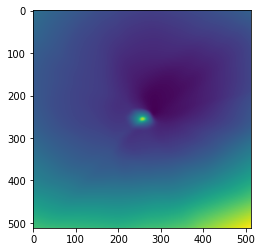

epoch 11901: 49.52268981933594
epoch 11902: 48.41093444824219
epoch 11903: 48.349266052246094
epoch 11904: 49.33478927612305
epoch 11905: 49.1246223449707
epoch 11906: 48.70534896850586
epoch 11907: 49.185630798339844
epoch 11908: 48.17215347290039
epoch 11909: 49.68180465698242
epoch 11911: 48.592376708984375
epoch 11912: 48.32893753051758
epoch 11913: 48.678123474121094
epoch 11914: 48.86989212036133
epoch 11915: 50.2818489074707
epoch 11916: 48.508907318115234
epoch 11917: 48.901973724365234
epoch 11918: 49.06993865966797
epoch 11919: 49.122615814208984
epoch 11921: 48.79016876220703
epoch 11922: 48.487693786621094
epoch 11923: 48.49081802368164
epoch 11924: 48.39317321777344
epoch 11925: 48.43104553222656
epoch 11926: 49.958927154541016
epoch 11927: 48.88526153564453
epoch 11928: 48.89803695678711
epoch 11929: 48.151851654052734
epoch 11931: 48.62480163574219
epoch 11932: 49.0267219543457
epoch 11933: 50.317413330078125
epoch 11934: 48.59219741821289
epoch 11935: 48.29398727416992


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



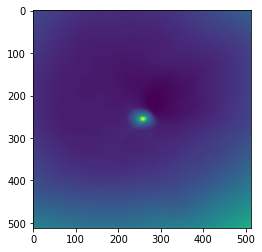

epoch 12001: 49.20248794555664
epoch 12002: 48.47276306152344
epoch 12003: 48.746055603027344
epoch 12004: 48.2132453918457
epoch 12005: 48.199275970458984
epoch 12006: 49.763553619384766
epoch 12007: 48.944339752197266
epoch 12008: 48.93339157104492
epoch 12009: 48.28672409057617
epoch 12011: 48.85154342651367
epoch 12012: 49.44728088378906
epoch 12013: 48.61555099487305
epoch 12014: 48.998565673828125
epoch 12015: 48.97859191894531
epoch 12016: 48.605865478515625
epoch 12017: 49.02909851074219
epoch 12018: 49.1263427734375
epoch 12019: 47.92660140991211
epoch 12021: 49.43266677856445
epoch 12022: 49.41023254394531
epoch 12023: 49.14628601074219
epoch 12024: 49.21674728393555
epoch 12025: 48.94343185424805
epoch 12026: 48.80752944946289
epoch 12027: 49.282135009765625
epoch 12028: 48.184940338134766
epoch 12029: 48.647682189941406
epoch 12031: 48.94442367553711
epoch 12032: 48.889060974121094
epoch 12033: 48.71144104003906
epoch 12034: 48.679222106933594
epoch 12035: 47.77853012084961

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



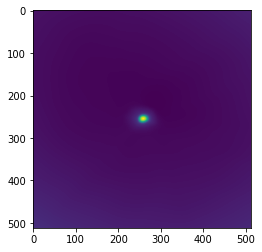

epoch 12101: 48.598663330078125
epoch 12102: 48.694908142089844
epoch 12103: 49.764530181884766
epoch 12104: 48.964996337890625
epoch 12105: 48.169498443603516
epoch 12106: 49.247955322265625
epoch 12107: 48.725685119628906
epoch 12108: 48.4635124206543
epoch 12109: 50.62480163574219
epoch 12111: 48.21855545043945
epoch 12112: 47.67893981933594
epoch 12113: 47.850303649902344
epoch 12114: 49.621925354003906
epoch 12115: 48.27762985229492
epoch 12116: 48.96368408203125
epoch 12117: 49.72684097290039
epoch 12118: 48.13519287109375
epoch 12119: 48.01963424682617
epoch 12121: 47.54484176635742
epoch 12122: 49.78261947631836
epoch 12123: 47.959598541259766
epoch 12124: 48.45517349243164
epoch 12125: 48.465362548828125
epoch 12126: 47.808231353759766
epoch 12127: 48.350616455078125
epoch 12128: 47.54123306274414
epoch 12129: 48.150447845458984
epoch 12131: 49.46581268310547
epoch 12132: 47.85457992553711
epoch 12133: 48.496700286865234
epoch 12134: 50.43414306640625
epoch 12135: 48.184505462

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



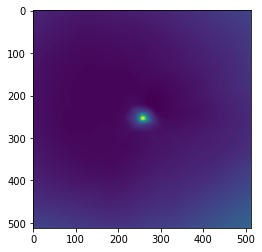

epoch 12201: 48.807891845703125
epoch 12202: 49.21929168701172
epoch 12203: 48.31049728393555
epoch 12204: 48.87010955810547
epoch 12205: 51.93445587158203
epoch 12206: 48.738826751708984
epoch 12207: 49.04704284667969
epoch 12208: 49.21964645385742
epoch 12209: 48.15556335449219
epoch 12211: 48.32272720336914
epoch 12212: 50.058677673339844
epoch 12213: 48.05828094482422
epoch 12214: 48.309112548828125
epoch 12215: 49.49042510986328
epoch 12216: 48.090171813964844
epoch 12217: 49.68567657470703
epoch 12218: 50.85120391845703
epoch 12219: 49.03364181518555
epoch 12221: 49.51036834716797
epoch 12222: 48.46051788330078
epoch 12223: 48.59374237060547
epoch 12224: 48.91537857055664
epoch 12225: 48.48860549926758
epoch 12226: 47.72459030151367
epoch 12227: 48.71016311645508
epoch 12228: 48.96371078491211
epoch 12229: 48.62164306640625
epoch 12231: 48.19847869873047
epoch 12232: 48.90903091430664
epoch 12233: 49.686180114746094
epoch 12234: 49.15287780761719
epoch 12235: 49.06760787963867
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



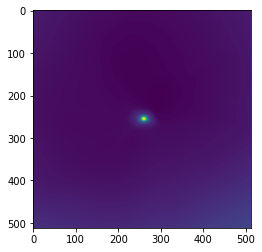

epoch 12301: 49.03485107421875
epoch 12302: 49.37039566040039
epoch 12303: 47.99832534790039
epoch 12304: 48.52983474731445
epoch 12305: 49.48061752319336
epoch 12306: 48.93856430053711
epoch 12307: 48.78763961791992
epoch 12308: 48.81664276123047
epoch 12309: 48.39509201049805
epoch 12311: 48.00238800048828
epoch 12312: 48.315650939941406
epoch 12313: 48.38789367675781
epoch 12314: 49.12620544433594
epoch 12315: 48.153953552246094
epoch 12316: 48.4427375793457
epoch 12317: 49.39006805419922
epoch 12318: 50.69605255126953
epoch 12319: 48.44866180419922
epoch 12321: 48.535972595214844
epoch 12322: 49.068660736083984
epoch 12323: 48.9486198425293
epoch 12324: 48.11158752441406
epoch 12325: 48.00070571899414
epoch 12326: 49.38582992553711
epoch 12327: 49.64503479003906
epoch 12328: 49.71733093261719
epoch 12329: 48.69392013549805
epoch 12331: 49.14693832397461
epoch 12332: 49.11107635498047
epoch 12333: 48.595863342285156
epoch 12334: 49.05058288574219
epoch 12335: 49.35254669189453
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



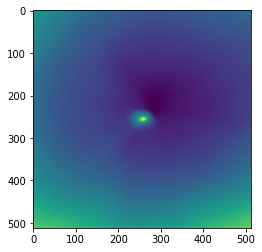

epoch 12401: 48.00904846191406
epoch 12402: 49.03520202636719
epoch 12403: 48.28990936279297
epoch 12404: 47.89234924316406
epoch 12405: 48.435848236083984
epoch 12406: 48.29805374145508
epoch 12407: 49.27033996582031
epoch 12408: 49.38501739501953
epoch 12409: 48.458465576171875
epoch 12411: 49.66030502319336
epoch 12412: 48.782100677490234
epoch 12413: 48.675315856933594
epoch 12414: 49.15441131591797
epoch 12415: 49.039466857910156
epoch 12416: 49.65461349487305
epoch 12417: 49.08690643310547
epoch 12418: 48.2884521484375
epoch 12419: 49.073890686035156
epoch 12421: 49.45106887817383
epoch 12422: 49.92496871948242
epoch 12423: 49.86359786987305
epoch 12424: 54.462276458740234
epoch 12425: 51.20286178588867
epoch 12426: 48.94243240356445
epoch 12427: 48.74662399291992
epoch 12428: 49.38527297973633
epoch 12429: 49.36341094970703
epoch 12431: 49.581504821777344
epoch 12432: 49.63216781616211
epoch 12433: 49.86647415161133
epoch 12434: 49.319053649902344
epoch 12435: 49.64177322387695


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



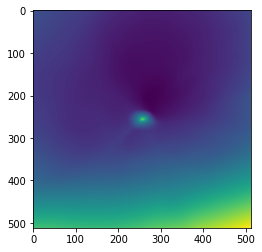

epoch 12501: 49.50831985473633
epoch 12502: 49.2331657409668
epoch 12503: 48.3529052734375
epoch 12504: 48.641693115234375
epoch 12505: 49.51601791381836
epoch 12506: 48.494834899902344
epoch 12507: 48.811668395996094
epoch 12508: 48.172935485839844
epoch 12509: 48.500282287597656
epoch 12511: 47.98893356323242
epoch 12512: 48.0767936706543
epoch 12513: 48.496891021728516
epoch 12514: 48.98195266723633
epoch 12515: 50.1531867980957
epoch 12516: 49.31133270263672
epoch 12517: 48.710018157958984
epoch 12518: 47.89039611816406
epoch 12519: 49.28185272216797
epoch 12521: 50.6091423034668
epoch 12522: 47.80811309814453
epoch 12523: 49.52695846557617
epoch 12524: 48.670494079589844
epoch 12525: 48.479854583740234
epoch 12526: 51.363914489746094
epoch 12527: 49.3833122253418
epoch 12528: 49.47616958618164
epoch 12529: 49.01639938354492
epoch 12531: 50.50483322143555
epoch 12532: 49.948089599609375
epoch 12533: 49.0511474609375
epoch 12534: 49.515235900878906
epoch 12535: 50.239585876464844
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



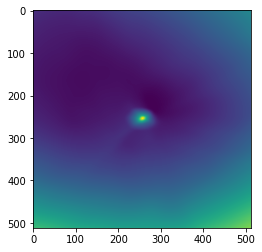

epoch 12601: 49.84486389160156
epoch 12602: 50.70603561401367
epoch 12603: 49.3878173828125
epoch 12604: 48.399600982666016
epoch 12605: 48.84599304199219
epoch 12606: 49.86832046508789
epoch 12607: 49.06401824951172
epoch 12608: 48.57661437988281
epoch 12609: 48.300926208496094
epoch 12611: 48.66135787963867
epoch 12612: 49.37030029296875
epoch 12613: 48.565704345703125
epoch 12614: 48.36383819580078
epoch 12615: 49.12471008300781
epoch 12616: 48.27621841430664
epoch 12617: 48.047325134277344
epoch 12618: 49.37235641479492
epoch 12619: 48.41184997558594
epoch 12621: 49.305419921875
epoch 12622: 48.80078887939453
epoch 12623: 47.756752014160156
epoch 12624: 48.546085357666016
epoch 12625: 48.30375289916992
epoch 12626: 49.280723571777344
epoch 12627: 47.92702865600586
epoch 12628: 48.586944580078125
epoch 12629: 48.515132904052734
epoch 12631: 48.65535354614258
epoch 12632: 48.55802917480469
epoch 12633: 48.36362075805664
epoch 12634: 48.699466705322266
epoch 12635: 48.60698318481445
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



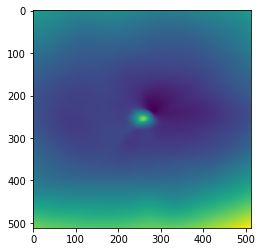

epoch 12701: 50.98633575439453
epoch 12702: 47.93362045288086
epoch 12703: 49.0510368347168
epoch 12704: 49.29393768310547
epoch 12705: 49.314788818359375
epoch 12706: 49.759010314941406
epoch 12707: 49.768882751464844
epoch 12708: 49.51277160644531
epoch 12709: 49.10135269165039
epoch 12711: 48.69940185546875
epoch 12712: 48.54121398925781
epoch 12713: 48.63140869140625
epoch 12714: 49.4653434753418
epoch 12715: 49.06660079956055
epoch 12716: 48.5041618347168
epoch 12717: 48.297569274902344
epoch 12718: 49.29114532470703
epoch 12719: 48.917293548583984
epoch 12721: 48.96415328979492
epoch 12722: 48.68244171142578
epoch 12723: 48.719566345214844
epoch 12724: 48.442230224609375
epoch 12725: 48.044979095458984
epoch 12726: 48.80507278442383
epoch 12727: 48.77842712402344
epoch 12728: 48.97156524658203
epoch 12729: 48.64126205444336
epoch 12731: 48.551841735839844
epoch 12732: 48.42230987548828
epoch 12733: 48.48145294189453
epoch 12734: 47.72996139526367
epoch 12735: 48.29289627075195
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



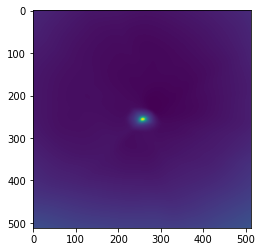

epoch 12801: 49.49713897705078
epoch 12802: 48.5042724609375
epoch 12803: 48.55787658691406
epoch 12804: 48.3729133605957
epoch 12805: 49.245243072509766
epoch 12806: 49.450592041015625
epoch 12807: 49.88892364501953
epoch 12808: 48.50639724731445
epoch 12809: 49.1669807434082
epoch 12811: 48.5375862121582
epoch 12812: 48.44124221801758
epoch 12813: 48.39209747314453
epoch 12814: 49.362152099609375
epoch 12815: 48.571067810058594
epoch 12816: 48.64630889892578
epoch 12817: 48.8878059387207
epoch 12818: 48.5185661315918
epoch 12819: 48.968910217285156
epoch 12821: 50.6802978515625
epoch 12822: 48.0698356628418
epoch 12823: 48.06712341308594
epoch 12824: 48.560997009277344
epoch 12825: 48.41239929199219
epoch 12826: 50.004425048828125
epoch 12827: 48.3038215637207
epoch 12828: 48.14912033081055
epoch 12829: 48.20772171020508
epoch 12831: 48.50874710083008
epoch 12832: 48.27890396118164
epoch 12833: 48.01454162597656
epoch 12834: 47.69895553588867
epoch 12835: 48.7652702331543
epoch 12836

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



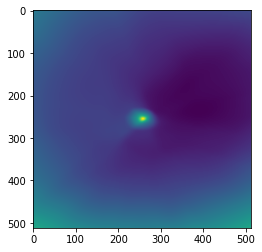

epoch 12901: 49.18335723876953
epoch 12902: 48.280792236328125
epoch 12903: 48.576744079589844
epoch 12904: 48.94780731201172
epoch 12905: 48.32207489013672
epoch 12906: 49.197208404541016
epoch 12907: 48.849830627441406
epoch 12908: 48.871070861816406
epoch 12909: 48.699668884277344
epoch 12911: 49.043556213378906
epoch 12912: 48.062225341796875
epoch 12913: 48.98291778564453
epoch 12914: 48.53584671020508
epoch 12915: 48.46080017089844
epoch 12916: 48.84504318237305
epoch 12917: 48.132137298583984
epoch 12918: 48.10251998901367
epoch 12919: 48.590736389160156
epoch 12921: 48.68064498901367
epoch 12922: 49.678314208984375
epoch 12923: 49.07074737548828
epoch 12924: 49.43595886230469
epoch 12925: 49.506690979003906
epoch 12926: 48.41940689086914
epoch 12927: 48.464942932128906
epoch 12928: 48.14176559448242
epoch 12929: 48.05530548095703
epoch 12931: 48.567047119140625
epoch 12932: 48.645477294921875
epoch 12933: 48.474754333496094
epoch 12934: 48.393314361572266
epoch 12935: 48.477104

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



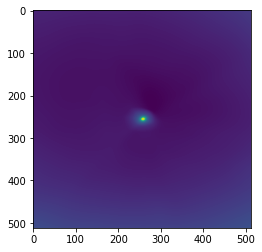

epoch 13001: 48.0505485534668
epoch 13002: 48.827213287353516
epoch 13003: 48.221500396728516
epoch 13004: 48.00707244873047
epoch 13005: 49.01490783691406
epoch 13006: 48.91899108886719
epoch 13007: 49.31752395629883
epoch 13008: 48.66647720336914
epoch 13009: 47.754913330078125
epoch 13011: 49.4957160949707
epoch 13012: 49.00802993774414
epoch 13013: 48.43524932861328
epoch 13014: 50.231441497802734
epoch 13015: 48.485496520996094
epoch 13016: 50.3817138671875
epoch 13017: 48.1582145690918
epoch 13018: 47.82161331176758
epoch 13019: 49.16140365600586
epoch 13021: 48.719215393066406
epoch 13022: 48.978370666503906
epoch 13023: 48.38798904418945
epoch 13024: 48.67031478881836
epoch 13025: 48.89402770996094
epoch 13026: 49.26263427734375
epoch 13027: 48.36769104003906
epoch 13028: 48.52522659301758
epoch 13029: 49.78011703491211
epoch 13031: 49.180294036865234
epoch 13032: 48.016605377197266
epoch 13033: 47.838714599609375
epoch 13034: 49.04003143310547
epoch 13035: 48.59939193725586
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



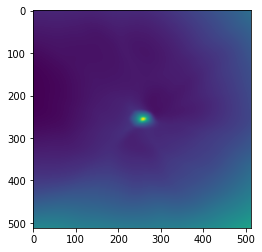

epoch 13101: 48.46935272216797
epoch 13102: 49.17549514770508
epoch 13103: 48.712257385253906
epoch 13104: 49.2500114440918
epoch 13105: 49.134376525878906
epoch 13106: 48.89710998535156
epoch 13107: 48.730281829833984
epoch 13108: 48.632659912109375
epoch 13109: 48.899478912353516
epoch 13111: 48.50991439819336
epoch 13112: 51.18196105957031
epoch 13113: 48.7879753112793
epoch 13114: 48.447540283203125
epoch 13115: 48.22604751586914
epoch 13116: 48.892635345458984
epoch 13117: 49.4631462097168
epoch 13118: 49.04360580444336
epoch 13119: 48.45511245727539
epoch 13121: 48.67490768432617
epoch 13122: 48.253173828125
epoch 13123: 49.8814582824707
epoch 13124: 48.12407302856445
epoch 13125: 49.52642059326172
epoch 13126: 49.07487487792969
epoch 13127: 48.29439163208008
epoch 13128: 48.55950927734375
epoch 13129: 48.26774978637695
epoch 13131: 48.55413818359375
epoch 13132: 49.179866790771484
epoch 13133: 47.87319564819336
epoch 13134: 48.19606018066406
epoch 13135: 47.5676155090332
epoch 1

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



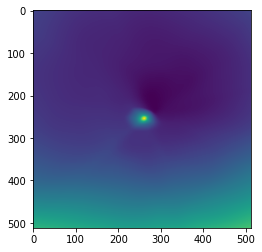

epoch 13201: 48.25529479980469
epoch 13202: 51.93088912963867
epoch 13203: 48.318206787109375
epoch 13204: 48.567596435546875
epoch 13205: 48.47214889526367
epoch 13206: 48.817893981933594
epoch 13207: 48.87258529663086
epoch 13208: 50.50069046020508
epoch 13209: 48.5625114440918
epoch 13211: 48.62699508666992
epoch 13212: 47.458045959472656
epoch 13213: 49.148067474365234
epoch 13214: 48.242496490478516
epoch 13215: 49.36906814575195
epoch 13216: 48.8372917175293
epoch 13217: 48.336204528808594
epoch 13218: 48.59260177612305
epoch 13219: 48.58067321777344
epoch 13221: 49.28764343261719
epoch 13222: 48.26463317871094
epoch 13223: 48.6392822265625
epoch 13224: 48.69525909423828
epoch 13225: 48.391780853271484
epoch 13226: 49.10676574707031
epoch 13227: 48.539405822753906
epoch 13228: 48.261558532714844
epoch 13229: 49.94794845581055
epoch 13231: 48.03878402709961
epoch 13232: 48.42742156982422
epoch 13233: 48.88779067993164
epoch 13234: 48.52934646606445
epoch 13235: 49.4361457824707
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



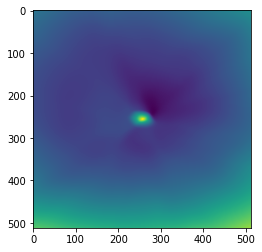

epoch 13301: 48.91493606567383
epoch 13302: 49.425174713134766
epoch 13303: 48.71699523925781
epoch 13304: 49.337318420410156
epoch 13305: 49.028968811035156
epoch 13306: 48.73463439941406
epoch 13307: 48.48302459716797
epoch 13308: 49.112335205078125
epoch 13309: 48.9165153503418
epoch 13311: 48.596771240234375
epoch 13312: 48.79377746582031
epoch 13313: 48.867225646972656
epoch 13314: 47.47003173828125
epoch 13315: 48.94459533691406
epoch 13316: 48.44385528564453
epoch 13317: 48.95343017578125
epoch 13318: 48.805503845214844
epoch 13319: 48.891788482666016
epoch 13321: 48.608863830566406
epoch 13322: 49.40398025512695
epoch 13323: 50.25965881347656
epoch 13324: 50.33406066894531
epoch 13325: 51.07478332519531
epoch 13326: 48.16120147705078
epoch 13327: 48.80091857910156
epoch 13328: 48.6353645324707
epoch 13329: 49.1171875
epoch 13331: 48.95083236694336
epoch 13332: 49.66428756713867
epoch 13333: 48.63621139526367
epoch 13334: 48.7624626159668
epoch 13335: 49.50273895263672
epoch 133

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



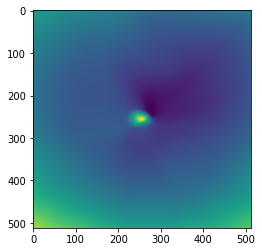

epoch 13401: 49.36796951293945
epoch 13402: 48.91971969604492
epoch 13403: 49.63467025756836
epoch 13404: 49.55364227294922
epoch 13405: 48.730777740478516
epoch 13406: 48.764347076416016
epoch 13407: 50.17731857299805
epoch 13408: 48.709983825683594
epoch 13409: 49.13674545288086
epoch 13411: 49.05307388305664
epoch 13412: 48.21265411376953
epoch 13413: 48.812286376953125
epoch 13414: 49.14286422729492
epoch 13415: 48.47599411010742
epoch 13416: 48.119651794433594
epoch 13417: 48.27446746826172
epoch 13418: 47.95834732055664
epoch 13419: 48.82722091674805
epoch 13421: 49.929298400878906
epoch 13422: 48.74205780029297
epoch 13423: 49.82377243041992
epoch 13424: 49.91171646118164
epoch 13425: 48.56117248535156
epoch 13426: 48.519840240478516
epoch 13427: 49.51660919189453
epoch 13428: 48.7800407409668
epoch 13429: 47.91792678833008
epoch 13431: 49.17637634277344
epoch 13432: 48.9940299987793
epoch 13433: 49.073612213134766
epoch 13434: 48.5839958190918
epoch 13435: 49.69895935058594
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



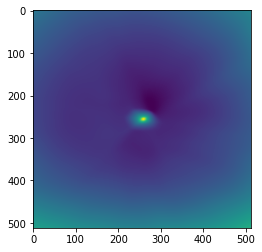

epoch 13501: 49.14091110229492
epoch 13502: 48.58839416503906
epoch 13503: 48.904605865478516
epoch 13504: 47.776023864746094
epoch 13505: 48.42998504638672
epoch 13506: 48.456092834472656
epoch 13507: 48.57646179199219
epoch 13508: 48.905250549316406
epoch 13509: 48.288265228271484
epoch 13511: 48.6569709777832
epoch 13512: 48.417564392089844
epoch 13513: 48.0990104675293
epoch 13514: 50.035614013671875
epoch 13515: 49.80198287963867
epoch 13516: 51.702781677246094
epoch 13517: 47.82424545288086
epoch 13518: 49.88969802856445
epoch 13519: 48.33578109741211
epoch 13521: 49.410526275634766
epoch 13522: 48.45389938354492
epoch 13523: 49.17196273803711
epoch 13524: 47.763980865478516
epoch 13525: 48.937679290771484
epoch 13526: 48.305580139160156
epoch 13527: 48.151466369628906
epoch 13528: 48.34306716918945
epoch 13529: 48.335548400878906
epoch 13531: 48.4671516418457
epoch 13532: 49.23680877685547
epoch 13533: 49.00381088256836
epoch 13534: 48.49058532714844
epoch 13535: 48.632934570312

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



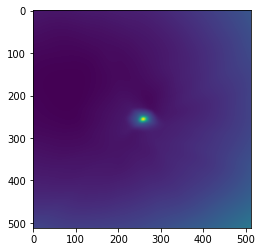

epoch 13601: 48.98146057128906
epoch 13602: 49.66419982910156
epoch 13603: 48.91692352294922
epoch 13604: 49.33595275878906
epoch 13605: 49.84390640258789
epoch 13606: 49.30841827392578
epoch 13607: 50.3728141784668
epoch 13608: 49.8603401184082
epoch 13609: 49.5609130859375
epoch 13611: 48.88743591308594
epoch 13612: 49.010005950927734
epoch 13613: 48.84769821166992
epoch 13614: 48.715293884277344
epoch 13615: 50.1934700012207
epoch 13616: 48.999237060546875
epoch 13617: 48.95308303833008
epoch 13618: 48.45124816894531
epoch 13619: 49.17082214355469
epoch 13621: 49.1540641784668
epoch 13622: 48.543701171875
epoch 13623: 48.516754150390625
epoch 13624: 48.123573303222656
epoch 13625: 50.422508239746094
epoch 13626: 49.26667785644531
epoch 13627: 48.833866119384766
epoch 13628: 48.5967903137207
epoch 13629: 47.73311233520508
epoch 13631: 48.75926208496094
epoch 13632: 48.18262481689453
epoch 13633: 48.511810302734375
epoch 13634: 48.5801887512207
epoch 13635: 50.45270919799805
epoch 136

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



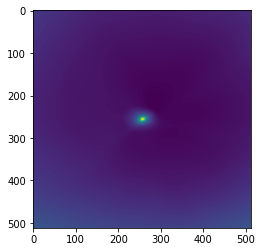

epoch 13701: 48.15522766113281
epoch 13702: 48.96711730957031
epoch 13703: 49.50702667236328
epoch 13704: 47.75082015991211
epoch 13705: 48.49219512939453
epoch 13706: 49.31183624267578
epoch 13707: 49.007408142089844
epoch 13708: 47.83774185180664
epoch 13709: 49.06550598144531
epoch 13711: 48.30977249145508
epoch 13712: 48.46058654785156
epoch 13713: 48.87790298461914
epoch 13714: 48.84147262573242
epoch 13715: 48.6839714050293
epoch 13716: 48.998802185058594
epoch 13717: 48.362911224365234
epoch 13718: 48.394432067871094
epoch 13719: 48.15795135498047
epoch 13721: 47.83004379272461
epoch 13722: 47.904632568359375
epoch 13723: 47.768768310546875
epoch 13724: 48.04838562011719
epoch 13725: 48.18408203125
epoch 13726: 48.12465286254883
epoch 13727: 49.47397994995117
epoch 13728: 48.09233474731445
epoch 13729: 48.47142028808594
epoch 13731: 48.370582580566406
epoch 13732: 49.033119201660156
epoch 13733: 49.15340805053711
epoch 13734: 48.4506721496582
epoch 13735: 49.093162536621094
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



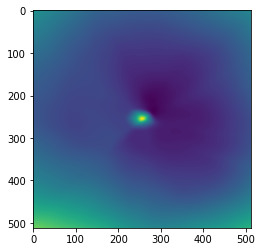

epoch 13801: 48.1127815246582
epoch 13802: 49.741424560546875
epoch 13803: 48.512733459472656
epoch 13804: 49.002113342285156
epoch 13805: 48.15569305419922
epoch 13806: 48.60221481323242
epoch 13807: 48.364227294921875
epoch 13808: 48.68539047241211
epoch 13809: 48.27973937988281
epoch 13811: 48.64595413208008
epoch 13812: 48.4472770690918
epoch 13813: 48.33131790161133
epoch 13814: 49.22456359863281
epoch 13815: 48.263248443603516
epoch 13816: 49.011043548583984
epoch 13817: 47.94337844848633
epoch 13818: 48.94219970703125
epoch 13819: 48.22137451171875
epoch 13821: 48.58184814453125
epoch 13822: 47.923458099365234
epoch 13823: 48.47114562988281
epoch 13824: 49.263511657714844
epoch 13825: 49.38096237182617
epoch 13826: 48.380577087402344
epoch 13827: 48.4732780456543
epoch 13828: 49.33748245239258
epoch 13829: 48.990081787109375
epoch 13831: 48.44124221801758
epoch 13832: 48.58079528808594
epoch 13833: 49.09201431274414
epoch 13834: 48.834930419921875
epoch 13835: 49.4144401550293
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



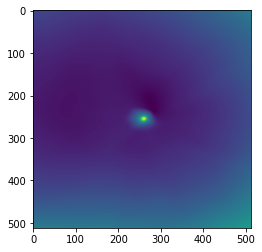

epoch 13901: 49.34953308105469
epoch 13902: 49.67689895629883
epoch 13903: 49.59027862548828
epoch 13904: 48.299224853515625
epoch 13905: 49.14688491821289
epoch 13906: 48.7343864440918
epoch 13907: 49.678924560546875
epoch 13908: 48.339935302734375
epoch 13909: 48.523834228515625
epoch 13911: 49.219207763671875
epoch 13912: 49.39884567260742
epoch 13913: 48.802913665771484
epoch 13914: 49.636985778808594
epoch 13915: 49.33049392700195
epoch 13916: 49.1479606628418
epoch 13917: 49.716102600097656
epoch 13918: 49.22402572631836
epoch 13919: 51.87006378173828
epoch 13921: 49.18134307861328
epoch 13922: 49.43717575073242
epoch 13923: 49.88034439086914
epoch 13924: 47.81898880004883
epoch 13925: 48.9090461730957
epoch 13926: 49.94051742553711
epoch 13927: 48.72541046142578
epoch 13928: 49.470890045166016
epoch 13929: 49.4704475402832
epoch 13931: 48.45855712890625
epoch 13932: 49.542991638183594
epoch 13933: 50.30891418457031
epoch 13934: 49.456626892089844
epoch 13935: 49.57219314575195
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



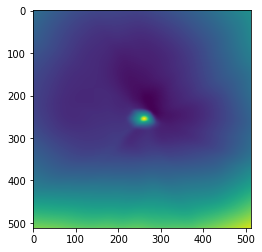

epoch 14001: 48.450950622558594
epoch 14002: 48.6820068359375
epoch 14003: 48.56715393066406
epoch 14004: 49.372215270996094
epoch 14005: 47.951236724853516
epoch 14006: 47.746856689453125
epoch 14007: 49.154273986816406
epoch 14008: 48.45891189575195
epoch 14009: 48.18293762207031
epoch 14011: 47.72848129272461
epoch 14012: 47.48303985595703
epoch 14013: 48.07086944580078
epoch 14014: 48.147274017333984
epoch 14015: 49.50730895996094
epoch 14016: 48.284908294677734
epoch 14017: 48.38237762451172
epoch 14018: 48.2580451965332
epoch 14019: 47.912479400634766
epoch 14021: 48.16922378540039
epoch 14022: 49.90060806274414
epoch 14023: 47.930564880371094
epoch 14024: 47.77587890625
epoch 14025: 47.87595748901367
epoch 14026: 51.118125915527344
epoch 14027: 48.460304260253906
epoch 14028: 48.821624755859375
epoch 14029: 49.02610778808594
epoch 14031: 48.78706359863281
epoch 14032: 48.626583099365234
epoch 14033: 49.26958084106445
epoch 14034: 47.67142868041992
epoch 14035: 48.55023193359375


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



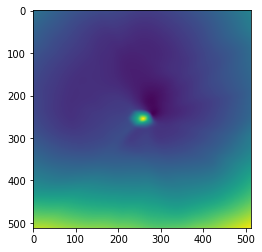

epoch 14101: 49.25801086425781
epoch 14102: 48.7047233581543
epoch 14103: 48.222389221191406
epoch 14104: 49.36360168457031
epoch 14105: 48.174957275390625
epoch 14106: 48.91793441772461
epoch 14107: 48.64236068725586
epoch 14108: 48.45075225830078
epoch 14109: 49.01443862915039
epoch 14111: 48.543121337890625
epoch 14112: 48.41211700439453
epoch 14113: 48.70514678955078
epoch 14114: 47.36927795410156
epoch 14115: 48.249446868896484
epoch 14116: 48.90732955932617
epoch 14117: 47.683868408203125
epoch 14118: 48.151145935058594
epoch 14119: 48.77481460571289
epoch 14121: 48.85099411010742
epoch 14122: 48.59027099609375
epoch 14123: 52.29449462890625
epoch 14124: 50.31903076171875
epoch 14125: 48.50949478149414
epoch 14126: 49.36515808105469
epoch 14127: 48.89906311035156
epoch 14128: 49.1878662109375
epoch 14129: 48.84209060668945
epoch 14131: 48.644901275634766
epoch 14132: 48.14226531982422
epoch 14133: 49.50490188598633
epoch 14134: 49.37499237060547
epoch 14135: 49.23503875732422
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



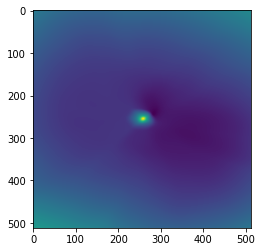

epoch 14201: 48.862205505371094
epoch 14202: 48.23994445800781
epoch 14203: 48.72195816040039
epoch 14204: 49.194358825683594
epoch 14205: 48.54296875
epoch 14206: 48.411865234375
epoch 14207: 48.81591033935547
epoch 14208: 48.79390335083008
epoch 14209: 49.25982666015625
epoch 14211: 48.88101577758789
epoch 14212: 48.472938537597656
epoch 14213: 48.5825080871582
epoch 14214: 48.59333038330078
epoch 14215: 47.935096740722656
epoch 14216: 49.07206726074219
epoch 14217: 48.89145278930664
epoch 14218: 48.535465240478516
epoch 14219: 48.86213684082031
epoch 14221: 48.60658264160156
epoch 14222: 48.41442108154297
epoch 14223: 47.84416580200195
epoch 14224: 48.97784423828125
epoch 14225: 48.734703063964844
epoch 14226: 48.32912826538086
epoch 14227: 47.48337936401367
epoch 14228: 48.50510025024414
epoch 14229: 48.88737106323242
epoch 14231: 48.51578140258789
epoch 14232: 48.776268005371094
epoch 14233: 48.20793533325195
epoch 14234: 50.54929733276367
epoch 14235: 48.249305725097656
epoch 142

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



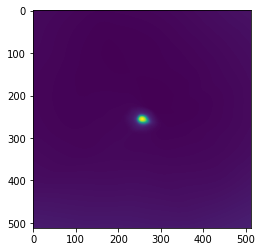

epoch 14301: 49.19488525390625
epoch 14302: 49.56016159057617
epoch 14303: 47.85091781616211
epoch 14304: 49.25489807128906
epoch 14305: 48.2615966796875
epoch 14306: 50.77996063232422
epoch 14307: 49.38893127441406
epoch 14308: 48.85258102416992
epoch 14309: 50.588539123535156
epoch 14311: 50.211387634277344
epoch 14312: 48.516536712646484
epoch 14313: 49.655517578125
epoch 14314: 49.8925895690918
epoch 14315: 49.51698684692383
epoch 14316: 49.0057373046875
epoch 14317: 48.443641662597656
epoch 14318: 49.37174987792969
epoch 14319: 49.49516296386719
epoch 14321: 49.32532501220703
epoch 14322: 50.097110748291016
epoch 14323: 49.35329055786133
epoch 14324: 49.2396354675293
epoch 14325: 49.99020004272461
epoch 14326: 48.90437698364258
epoch 14327: 48.367462158203125
epoch 14328: 49.813758850097656
epoch 14329: 49.76571273803711
epoch 14331: 49.23177719116211
epoch 14332: 49.16018295288086
epoch 14333: 48.68978500366211
epoch 14334: 50.49339294433594
epoch 14335: 49.19472122192383
epoch 1

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



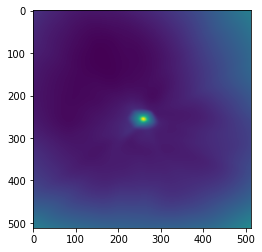

epoch 14401: 49.25663757324219
epoch 14402: 48.723594665527344
epoch 14403: 48.8528938293457
epoch 14404: 48.728633880615234
epoch 14405: 48.65727233886719
epoch 14406: 48.69365310668945
epoch 14407: 48.653289794921875
epoch 14408: 48.459991455078125
epoch 14409: 50.175025939941406
epoch 14411: 48.58594512939453
epoch 14412: 48.42905807495117
epoch 14413: 49.153526306152344
epoch 14414: 48.58787536621094
epoch 14415: 49.48872756958008
epoch 14416: 48.96966552734375
epoch 14417: 49.13455581665039
epoch 14418: 48.49557113647461
epoch 14419: 49.17831802368164
epoch 14421: 48.779632568359375
epoch 14422: 49.96396255493164
epoch 14423: 48.71565246582031
epoch 14424: 49.15836715698242
epoch 14425: 49.289581298828125
epoch 14426: 48.270721435546875
epoch 14427: 49.269317626953125
epoch 14428: 49.48648452758789
epoch 14429: 48.726497650146484
epoch 14431: 48.052894592285156
epoch 14432: 48.72322082519531
epoch 14433: 48.80453872680664
epoch 14434: 47.88531494140625
epoch 14435: 49.074581146240

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



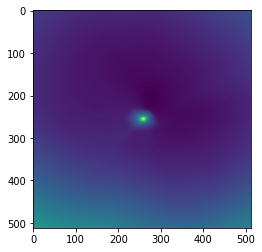

epoch 14501: 49.822017669677734
epoch 14502: 47.904869079589844
epoch 14503: 50.62458419799805
epoch 14504: 48.67484664916992
epoch 14505: 47.48915100097656
epoch 14506: 49.12763977050781
epoch 14507: 49.05360412597656
epoch 14508: 50.80540466308594
epoch 14509: 48.23018264770508
epoch 14511: 48.25811767578125
epoch 14512: 49.10403060913086
epoch 14513: 49.5634880065918
epoch 14514: 49.20681381225586
epoch 14515: 48.29259490966797
epoch 14516: 47.390846252441406
epoch 14517: 51.156166076660156
epoch 14518: 49.641212463378906
epoch 14519: 48.487125396728516
epoch 14521: 49.26866149902344
epoch 14522: 48.43433380126953
epoch 14523: 48.64644241333008
epoch 14524: 48.387451171875
epoch 14525: 49.36322784423828
epoch 14526: 48.69664764404297
epoch 14527: 48.63862609863281
epoch 14528: 49.88663864135742
epoch 14529: 48.365989685058594
epoch 14531: 48.75901412963867
epoch 14532: 49.89466857910156
epoch 14533: 48.462711334228516
epoch 14534: 48.532466888427734
epoch 14535: 48.18620300292969
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



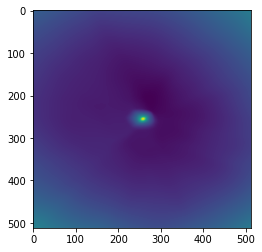

epoch 14601: 48.402870178222656
epoch 14602: 49.144996643066406
epoch 14603: 48.7693977355957
epoch 14604: 48.50975799560547
epoch 14605: 48.62566375732422
epoch 14606: 48.052101135253906
epoch 14607: 48.84696960449219
epoch 14608: 48.549232482910156
epoch 14609: 47.88706970214844
epoch 14611: 48.45153045654297
epoch 14612: 48.42864227294922
epoch 14613: 48.96120071411133
epoch 14614: 48.4606819152832
epoch 14615: 48.46946334838867
epoch 14616: 48.931297302246094
epoch 14617: 48.56637191772461
epoch 14618: 51.175113677978516
epoch 14619: 48.62781524658203
epoch 14621: 49.07915115356445
epoch 14622: 48.95679473876953
epoch 14623: 49.31507873535156
epoch 14624: 48.642189025878906
epoch 14625: 47.79484939575195
epoch 14626: 48.45393371582031
epoch 14627: 52.44147491455078
epoch 14628: 48.013187408447266
epoch 14629: 48.26900863647461
epoch 14631: 49.64417266845703
epoch 14632: 48.53047561645508
epoch 14633: 48.872314453125
epoch 14634: 48.54308319091797
epoch 14635: 49.63411331176758
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



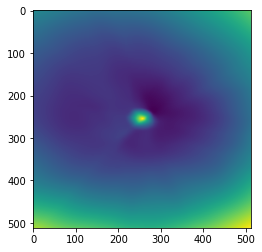

epoch 14701: 48.853816986083984
epoch 14702: 48.22244644165039
epoch 14703: 47.90757751464844
epoch 14704: 48.74851608276367
epoch 14705: 48.39359664916992
epoch 14706: 48.31376647949219
epoch 14707: 48.91011047363281
epoch 14708: 48.58192825317383
epoch 14709: 49.58942794799805
epoch 14711: 48.05865478515625
epoch 14712: 48.689064025878906
epoch 14713: 50.08354949951172
epoch 14714: 48.41218185424805
epoch 14715: 48.6239128112793
epoch 14716: 48.648223876953125
epoch 14717: 47.530826568603516
epoch 14718: 48.39138412475586
epoch 14719: 48.135581970214844
epoch 14721: 49.517578125
epoch 14722: 49.01123809814453
epoch 14723: 48.15601348876953
epoch 14724: 48.564788818359375
epoch 14725: 49.679847717285156
epoch 14726: 49.062835693359375
epoch 14727: 48.164695739746094
epoch 14728: 48.52525329589844
epoch 14729: 48.20421600341797
epoch 14731: 48.29492950439453
epoch 14732: 48.74538040161133
epoch 14733: 48.87861633300781
epoch 14734: 49.67365646362305
epoch 14735: 48.19438552856445
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



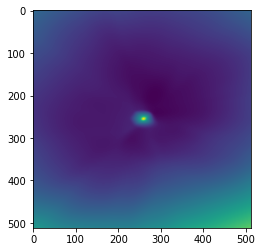

epoch 14801: 48.480873107910156
epoch 14802: 48.299442291259766
epoch 14803: 50.85673522949219
epoch 14804: 49.20325469970703
epoch 14805: 49.13599395751953
epoch 14806: 48.3800048828125
epoch 14807: 49.35028076171875
epoch 14808: 49.756492614746094
epoch 14809: 48.53645324707031
epoch 14811: 49.380977630615234
epoch 14812: 49.51365661621094
epoch 14813: 49.38666534423828
epoch 14814: 48.193603515625
epoch 14815: 48.983951568603516
epoch 14816: 48.38790512084961
epoch 14817: 48.76978302001953
epoch 14818: 49.46018600463867
epoch 14819: 48.38311767578125
epoch 14821: 49.46197509765625
epoch 14822: 48.53025436401367
epoch 14823: 48.527305603027344
epoch 14824: 48.886356353759766
epoch 14825: 47.821922302246094
epoch 14826: 47.811031341552734
epoch 14827: 48.87114334106445
epoch 14828: 48.44211196899414
epoch 14829: 47.926612854003906
epoch 14831: 49.014442443847656
epoch 14832: 48.58721160888672
epoch 14833: 49.51483917236328
epoch 14834: 49.73179244995117
epoch 14835: 48.938602447509766

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



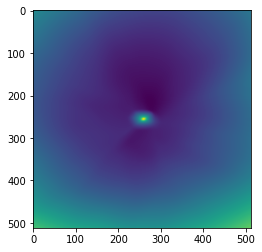

epoch 14901: 48.69178771972656
epoch 14902: 49.111244201660156
epoch 14903: 48.83699035644531
epoch 14904: 48.16185760498047
epoch 14905: 48.921138763427734
epoch 14906: 48.9590950012207
epoch 14907: 48.55531311035156
epoch 14908: 48.57679748535156
epoch 14909: 48.32851791381836
epoch 14911: 53.10032272338867
epoch 14912: 48.70094299316406
epoch 14913: 49.21864318847656
epoch 14914: 49.225154876708984
epoch 14915: 49.228023529052734
epoch 14916: 48.60802459716797
epoch 14917: 49.79135513305664
epoch 14918: 49.504547119140625
epoch 14919: 48.531612396240234
epoch 14921: 48.6907958984375
epoch 14922: 48.044822692871094
epoch 14923: 48.487850189208984
epoch 14924: 47.71131896972656
epoch 14925: 47.857765197753906
epoch 14926: 48.309593200683594
epoch 14927: 48.063228607177734
epoch 14928: 48.4193229675293
epoch 14929: 49.19712829589844
epoch 14931: 48.102684020996094
epoch 14932: 49.19597244262695
epoch 14933: 49.224124908447266
epoch 14934: 48.53242492675781
epoch 14935: 49.2223205566406

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



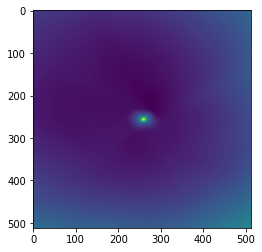

epoch 15001: 49.15696716308594
epoch 15002: 48.99562072753906
epoch 15003: 48.78434371948242
epoch 15004: 51.00147247314453
epoch 15005: 51.563411712646484
epoch 15006: 48.85721969604492
epoch 15007: 49.48113250732422
epoch 15008: 48.501346588134766
epoch 15009: 48.76533508300781
epoch 15011: 48.52946853637695
epoch 15012: 49.048805236816406
epoch 15013: 48.46856689453125
epoch 15014: 49.26871871948242
epoch 15015: 48.55997085571289
epoch 15016: 48.37845993041992
epoch 15017: 48.485626220703125
epoch 15018: 47.55190658569336
epoch 15019: 48.89057540893555
epoch 15021: 49.26542663574219
epoch 15022: 49.13902282714844
epoch 15023: 48.309242248535156
epoch 15024: 48.53343200683594
epoch 15025: 48.334922790527344
epoch 15026: 48.566246032714844
epoch 15027: 47.657127380371094
epoch 15028: 48.75185012817383
epoch 15029: 48.31510543823242
epoch 15031: 47.762176513671875
epoch 15032: 48.09779739379883
epoch 15033: 48.879364013671875
epoch 15034: 48.285987854003906
epoch 15035: 48.841209411621

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



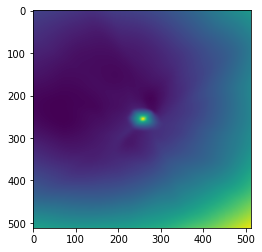

epoch 15101: 47.6196174621582
epoch 15102: 48.22770309448242
epoch 15103: 48.586341857910156
epoch 15104: 47.93147659301758
epoch 15105: 48.05226516723633
epoch 15106: 48.820579528808594
epoch 15107: 48.164241790771484
epoch 15108: 50.852962493896484
epoch 15109: 47.92085647583008
epoch 15111: 47.75841522216797
epoch 15112: 49.07345962524414
epoch 15113: 48.931758880615234
epoch 15114: 48.24061584472656
epoch 15115: 47.91395568847656
epoch 15116: 48.794612884521484
epoch 15117: 50.1302604675293
epoch 15118: 47.70103454589844
epoch 15119: 50.37763595581055
epoch 15121: 47.45501708984375
epoch 15122: 49.38092041015625
epoch 15123: 48.89039611816406
epoch 15124: 47.855690002441406
epoch 15125: 47.88737106323242
epoch 15126: 48.75741195678711
epoch 15127: 49.79615783691406
epoch 15128: 49.381046295166016
epoch 15129: 49.36473846435547
epoch 15131: 48.25387191772461
epoch 15132: 47.74578094482422
epoch 15133: 49.12662124633789
epoch 15134: 49.34990310668945
epoch 15135: 48.984825134277344
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



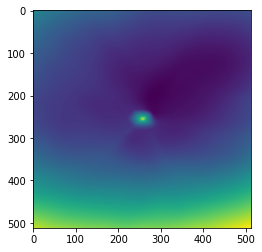

epoch 15201: 48.0396842956543
epoch 15202: 48.322540283203125
epoch 15203: 48.2758674621582
epoch 15204: 48.12852096557617
epoch 15205: 48.47938919067383
epoch 15206: 49.1452751159668
epoch 15207: 49.31271743774414
epoch 15208: 47.7994384765625
epoch 15209: 50.97105407714844
epoch 15211: 49.69825744628906
epoch 15212: 50.542335510253906
epoch 15213: 49.989288330078125
epoch 15214: 48.134315490722656
epoch 15215: 48.28832244873047
epoch 15216: 48.33027267456055
epoch 15217: 48.5052604675293
epoch 15218: 48.323787689208984
epoch 15219: 48.83146667480469
epoch 15221: 47.998722076416016
epoch 15222: 48.568115234375
epoch 15223: 48.74026870727539
epoch 15224: 49.28189468383789
epoch 15225: 48.158443450927734
epoch 15226: 48.39188766479492
epoch 15227: 47.972312927246094
epoch 15228: 49.42258071899414
epoch 15229: 48.278587341308594
epoch 15231: 48.247745513916016
epoch 15232: 48.73644256591797
epoch 15233: 48.99212646484375
epoch 15234: 49.03677749633789
epoch 15235: 48.58815002441406
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



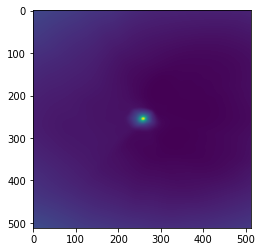

epoch 15301: 48.909603118896484
epoch 15302: 51.69003677368164
epoch 15303: 49.50728225708008
epoch 15304: 48.48994064331055
epoch 15305: 48.652740478515625
epoch 15306: 49.37698745727539
epoch 15307: 49.166690826416016
epoch 15308: 49.15563201904297
epoch 15309: 48.97257995605469
epoch 15311: 48.8725700378418
epoch 15312: 49.47521209716797
epoch 15313: 48.291709899902344
epoch 15314: 48.75051498413086
epoch 15315: 48.869083404541016
epoch 15316: 48.74117660522461
epoch 15317: 48.814491271972656
epoch 15318: 48.93109130859375
epoch 15319: 48.84083938598633
epoch 15321: 48.601749420166016
epoch 15322: 49.60246276855469
epoch 15323: 49.41876983642578
epoch 15324: 48.73362350463867
epoch 15325: 49.51896286010742
epoch 15326: 48.45384216308594
epoch 15327: 49.50956344604492
epoch 15328: 49.00605392456055
epoch 15329: 48.21401596069336
epoch 15331: 49.207008361816406
epoch 15332: 48.54641342163086
epoch 15333: 48.234275817871094
epoch 15334: 48.97381591796875
epoch 15335: 49.4765510559082
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



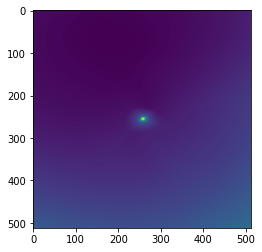

epoch 15401: 48.83598709106445
epoch 15402: 49.35364532470703
epoch 15403: 51.047550201416016
epoch 15404: 48.494720458984375
epoch 15405: 49.01219177246094
epoch 15406: 48.76401138305664
epoch 15407: 49.673641204833984
epoch 15408: 49.25173568725586
epoch 15409: 48.13670349121094
epoch 15411: 48.59674072265625
epoch 15412: 48.6906623840332
epoch 15413: 48.79489517211914
epoch 15414: 47.824119567871094
epoch 15415: 48.90528869628906
epoch 15416: 51.063995361328125
epoch 15417: 48.873226165771484
epoch 15418: 48.69871139526367
epoch 15419: 48.694705963134766
epoch 15421: 49.04867172241211
epoch 15422: 48.26120376586914
epoch 15423: 48.43556594848633
epoch 15424: 48.18321228027344
epoch 15425: 49.261260986328125
epoch 15426: 49.343353271484375
epoch 15427: 48.519901275634766
epoch 15428: 49.72003173828125
epoch 15429: 48.5242919921875
epoch 15431: 48.44895935058594
epoch 15432: 49.660160064697266
epoch 15433: 50.20072937011719
epoch 15434: 47.51835632324219
epoch 15435: 49.08845138549805

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



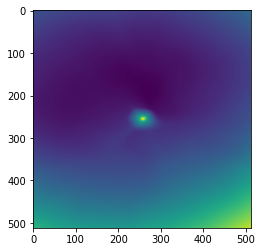

epoch 15501: 48.743282318115234
epoch 15502: 47.6917610168457
epoch 15503: 48.184349060058594
epoch 15504: 47.890602111816406
epoch 15505: 50.83944320678711
epoch 15506: 48.621116638183594
epoch 15507: 48.68154525756836
epoch 15508: 49.089839935302734
epoch 15509: 49.255889892578125
epoch 15511: 48.32039260864258
epoch 15512: 49.45627212524414
epoch 15513: 49.099849700927734
epoch 15514: 48.33673858642578
epoch 15515: 49.00614929199219
epoch 15516: 48.840782165527344
epoch 15517: 49.40522766113281
epoch 15518: 51.33782196044922
epoch 15519: 48.30375289916992
epoch 15521: 49.51869201660156
epoch 15522: 49.61476135253906
epoch 15523: 48.565826416015625
epoch 15524: 48.88370132446289
epoch 15525: 49.432579040527344
epoch 15526: 49.2144889831543
epoch 15527: 48.85035705566406
epoch 15528: 49.35327911376953
epoch 15529: 48.90210723876953
epoch 15531: 48.787391662597656
epoch 15532: 49.8790397644043
epoch 15533: 49.113094329833984
epoch 15534: 50.06594467163086
epoch 15535: 49.20328140258789

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



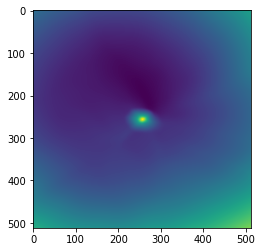

epoch 15601: 48.68344497680664
epoch 15602: 48.26594161987305
epoch 15603: 49.025978088378906
epoch 15604: 48.70431137084961
epoch 15605: 48.126380920410156
epoch 15606: 48.813533782958984
epoch 15607: 47.608055114746094
epoch 15608: 47.52914810180664
epoch 15609: 48.5902099609375
epoch 15611: 48.13337326049805
epoch 15612: 48.60394287109375
epoch 15613: 47.61509323120117
epoch 15614: 48.80553436279297
epoch 15615: 49.074745178222656
epoch 15616: 48.43003463745117
epoch 15617: 49.13814163208008
epoch 15618: 48.0822868347168
epoch 15619: 48.959110260009766
epoch 15621: 48.02081298828125
epoch 15622: 48.18874740600586
epoch 15623: 47.324947357177734
epoch 15624: 48.10111999511719
epoch 15625: 48.43444061279297
epoch 15626: 49.26744842529297
epoch 15627: 48.394508361816406
epoch 15628: 48.299705505371094
epoch 15629: 48.60624694824219
epoch 15631: 49.16448211669922
epoch 15632: 48.23576354980469
epoch 15633: 49.024044036865234
epoch 15634: 47.51462936401367
epoch 15635: 48.115657806396484

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



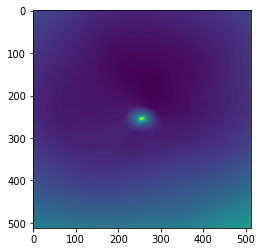

epoch 15701: 47.97675704956055
epoch 15702: 48.35547637939453
epoch 15703: 49.52570724487305
epoch 15704: 48.57127380371094
epoch 15705: 48.55583953857422
epoch 15706: 48.319705963134766
epoch 15707: 48.1721076965332
epoch 15708: 47.462646484375
epoch 15709: 47.6434211730957
epoch 15711: 48.5553092956543
epoch 15712: 48.29936218261719
epoch 15713: 49.427040100097656
epoch 15714: 48.40018081665039
epoch 15715: 47.5793342590332
epoch 15716: 49.09604263305664
epoch 15717: 48.62270736694336
epoch 15718: 48.408660888671875
epoch 15719: 47.11063003540039
epoch 15721: 48.07592010498047
epoch 15722: 48.6136360168457
epoch 15723: 48.01133728027344
epoch 15724: 52.627315521240234
epoch 15725: 47.9736328125
epoch 15726: 47.90816116333008
epoch 15727: 50.156211853027344
epoch 15728: 48.646339416503906
epoch 15729: 48.05789566040039
epoch 15731: 48.423744201660156
epoch 15732: 47.898380279541016
epoch 15733: 49.53892517089844
epoch 15734: 48.420955657958984
epoch 15735: 48.378047943115234
epoch 157

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



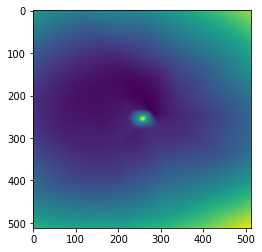

epoch 15801: 48.96554946899414
epoch 15802: 48.122440338134766
epoch 15803: 48.9958381652832
epoch 15804: 48.17747116088867
epoch 15805: 48.13322448730469
epoch 15806: 48.806278228759766
epoch 15807: 49.308284759521484
epoch 15808: 48.758243560791016
epoch 15809: 48.21867370605469
epoch 15811: 48.57249450683594
epoch 15812: 47.68937683105469
epoch 15813: 49.065582275390625
epoch 15814: 48.12493133544922
epoch 15815: 49.25886535644531
epoch 15816: 48.50566101074219
epoch 15817: 48.704315185546875
epoch 15818: 48.72475051879883
epoch 15819: 48.8858642578125
epoch 15821: 48.50315475463867
epoch 15822: 48.53738784790039
epoch 15823: 47.998172760009766
epoch 15824: 48.083003997802734
epoch 15825: 48.39148712158203
epoch 15826: 48.231590270996094
epoch 15827: 48.39255142211914
epoch 15828: 47.803890228271484
epoch 15829: 49.1768798828125
epoch 15831: 49.01092529296875
epoch 15832: 50.05575942993164
epoch 15833: 48.89087677001953
epoch 15834: 48.625919342041016
epoch 15835: 48.935333251953125

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



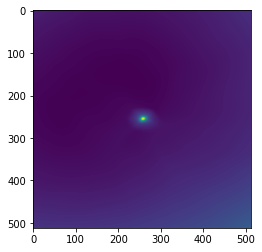

epoch 15901: 48.76093673706055
epoch 15902: 48.69141387939453
epoch 15903: 49.05068588256836
epoch 15904: 48.36610412597656
epoch 15905: 49.102638244628906
epoch 15906: 48.839698791503906
epoch 15907: 48.525447845458984
epoch 15908: 48.28123474121094
epoch 15909: 48.24898910522461
epoch 15911: 48.49861526489258
epoch 15912: 49.252166748046875
epoch 15913: 48.60957336425781
epoch 15914: 48.288978576660156
epoch 15915: 48.42922592163086
epoch 15916: 49.15955352783203
epoch 15917: 47.720577239990234
epoch 15918: 48.723636627197266
epoch 15919: 49.3732795715332
epoch 15921: 50.63311004638672
epoch 15922: 48.76287841796875
epoch 15923: 48.486446380615234
epoch 15924: 48.883033752441406
epoch 15925: 48.782470703125
epoch 15926: 48.629676818847656
epoch 15927: 48.16128158569336
epoch 15928: 48.3503303527832
epoch 15929: 48.894493103027344
epoch 15931: 49.058258056640625
epoch 15932: 49.03142547607422
epoch 15933: 48.45526123046875
epoch 15934: 48.6699333190918
epoch 15935: 49.007015228271484


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



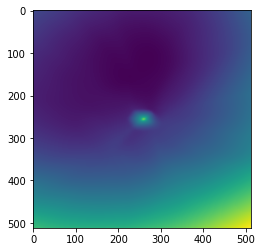

epoch 16001: 49.408790588378906
epoch 16002: 47.62322235107422
epoch 16003: 48.71260452270508
epoch 16004: 48.816890716552734
epoch 16005: 48.38987350463867
epoch 16006: 48.5078125
epoch 16007: 48.90830612182617
epoch 16008: 48.31135177612305
epoch 16009: 48.275630950927734
epoch 16011: 48.02806091308594
epoch 16012: 48.44504165649414
epoch 16013: 52.8680419921875
epoch 16014: 48.61347961425781
epoch 16015: 48.03843307495117
epoch 16016: 48.280982971191406
epoch 16017: 47.74195861816406
epoch 16018: 48.51050567626953
epoch 16019: 49.38341522216797
epoch 16021: 48.62759017944336
epoch 16022: 49.286895751953125
epoch 16023: 49.274818420410156
epoch 16024: 48.2429313659668
epoch 16025: 49.424110412597656
epoch 16026: 48.52297592163086
epoch 16027: 48.0486946105957
epoch 16028: 48.7332649230957
epoch 16029: 48.16689682006836
epoch 16031: 49.23368453979492
epoch 16032: 47.706520080566406
epoch 16033: 48.32886505126953
epoch 16034: 48.46327590942383
epoch 16035: 48.383460998535156
epoch 1603

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



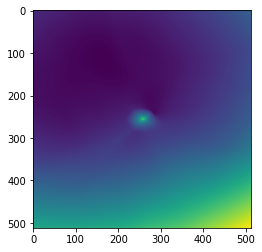

epoch 16101: 48.04874801635742
epoch 16102: 48.94866180419922
epoch 16103: 48.571964263916016
epoch 16104: 50.69025802612305
epoch 16105: 48.40663528442383
epoch 16106: 48.80146408081055
epoch 16107: 48.5765266418457
epoch 16108: 48.44049835205078
epoch 16109: 49.07263946533203
epoch 16111: 48.986454010009766
epoch 16112: 49.62412643432617
epoch 16113: 49.69440841674805
epoch 16114: 49.88447570800781
epoch 16115: 48.1461067199707
epoch 16116: 48.20132064819336
epoch 16117: 48.96647262573242
epoch 16118: 49.98877716064453
epoch 16119: 49.25077438354492
epoch 16121: 48.440673828125
epoch 16122: 49.348453521728516
epoch 16123: 48.72467041015625
epoch 16124: 48.6722526550293
epoch 16125: 48.70791244506836
epoch 16126: 48.59819793701172
epoch 16127: 48.53243637084961
epoch 16128: 48.74921798706055
epoch 16129: 48.20513916015625
epoch 16131: 48.416664123535156
epoch 16132: 48.9041862487793
epoch 16133: 48.832576751708984
epoch 16134: 49.08793640136719
epoch 16135: 48.267120361328125
epoch 16

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



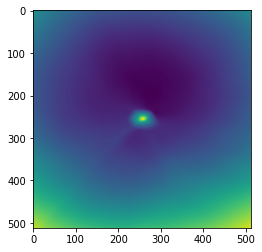

epoch 16201: 48.881126403808594
epoch 16202: 48.31517028808594
epoch 16203: 47.69563293457031
epoch 16204: 48.403324127197266
epoch 16205: 49.719024658203125
epoch 16206: 47.73931121826172
epoch 16207: 49.10004425048828
epoch 16208: 49.387813568115234
epoch 16209: 48.439247131347656
epoch 16211: 47.404624938964844
epoch 16212: 49.13869094848633
epoch 16213: 48.829010009765625
epoch 16214: 47.84756088256836
epoch 16215: 48.100399017333984
epoch 16216: 48.10151672363281
epoch 16217: 48.9103889465332
epoch 16218: 47.90788650512695
epoch 16219: 48.45683670043945
epoch 16221: 48.588470458984375
epoch 16222: 48.224063873291016
epoch 16223: 49.255062103271484
epoch 16224: 48.444000244140625
epoch 16225: 48.461055755615234
epoch 16226: 48.033870697021484
epoch 16227: 48.70880889892578
epoch 16228: 48.799842834472656
epoch 16229: 48.583499908447266
epoch 16231: 48.1939811706543
epoch 16232: 49.34096908569336
epoch 16233: 48.69157791137695
epoch 16234: 49.600685119628906
epoch 16235: 48.46235275

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



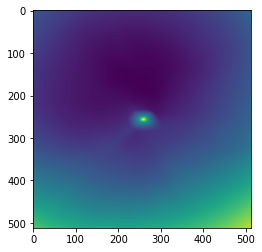

epoch 16301: 48.0842399597168
epoch 16302: 47.97328186035156
epoch 16303: 47.4619140625
epoch 16304: 48.62940216064453
epoch 16305: 48.119224548339844
epoch 16306: 48.67435836791992
epoch 16307: 48.81723403930664
epoch 16308: 48.38037872314453
epoch 16309: 48.20393753051758
epoch 16311: 47.97113800048828
epoch 16312: 47.724761962890625
epoch 16313: 48.06791687011719
epoch 16314: 50.66913604736328
epoch 16315: 48.50136184692383
epoch 16316: 47.45295715332031
epoch 16317: 47.56563186645508
epoch 16318: 49.07011413574219
epoch 16319: 48.18428039550781
epoch 16321: 49.6764030456543
epoch 16322: 47.6968879699707
epoch 16323: 48.36492156982422
epoch 16324: 50.2746467590332
epoch 16325: 48.81074142456055
epoch 16326: 48.86814880371094
epoch 16327: 49.135738372802734
epoch 16328: 48.18563461303711
epoch 16329: 47.96406555175781
epoch 16331: 49.195068359375
epoch 16332: 48.61701965332031
epoch 16333: 48.88238525390625
epoch 16334: 48.2008171081543
epoch 16335: 47.94010543823242
epoch 16336: 48.

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



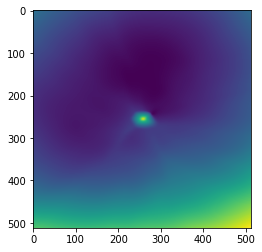

epoch 16401: 48.72369384765625
epoch 16402: 49.31640625
epoch 16403: 48.54954528808594
epoch 16404: 49.01816940307617
epoch 16405: 48.75239944458008
epoch 16406: 48.91787338256836
epoch 16407: 48.092376708984375
epoch 16408: 48.685787200927734
epoch 16409: 48.15036392211914
epoch 16411: 48.510013580322266
epoch 16412: 48.84718704223633
epoch 16413: 47.811832427978516
epoch 16414: 49.400062561035156
epoch 16415: 48.30359649658203
epoch 16416: 49.206886291503906
epoch 16417: 48.536834716796875
epoch 16418: 49.24752426147461
epoch 16419: 49.19879150390625
epoch 16421: 48.16622543334961
epoch 16422: 48.92934036254883
epoch 16423: 48.791282653808594
epoch 16424: 48.11353302001953
epoch 16425: 48.27553176879883
epoch 16426: 48.96958923339844
epoch 16427: 48.65167236328125
epoch 16428: 49.362640380859375
epoch 16429: 48.05381393432617
epoch 16431: 48.865638732910156
epoch 16432: 49.18983840942383
epoch 16433: 47.51099395751953
epoch 16434: 48.55488967895508
epoch 16435: 48.53873825073242
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



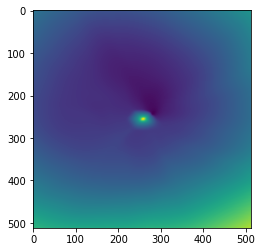

epoch 16501: 48.87962341308594
epoch 16502: 48.31538772583008
epoch 16503: 48.653812408447266
epoch 16504: 48.63637924194336
epoch 16505: 48.94211196899414
epoch 16506: 48.42731857299805
epoch 16507: 48.25971603393555
epoch 16508: 48.88316345214844
epoch 16509: 49.139984130859375
epoch 16511: 48.66471481323242
epoch 16512: 48.83122634887695
epoch 16513: 48.7601318359375
epoch 16514: 48.568058013916016
epoch 16515: 48.71260452270508
epoch 16516: 48.194637298583984
epoch 16517: 48.853023529052734
epoch 16518: 49.1903076171875
epoch 16519: 47.5894889831543
epoch 16521: 47.954891204833984
epoch 16522: 48.30175018310547
epoch 16523: 48.7420539855957
epoch 16524: 49.736488342285156
epoch 16525: 49.03449630737305
epoch 16526: 48.479122161865234
epoch 16527: 47.97494888305664
epoch 16528: 49.58373260498047
epoch 16529: 48.51807403564453
epoch 16531: 48.879608154296875
epoch 16532: 48.00642395019531
epoch 16533: 49.19717025756836
epoch 16534: 48.510135650634766
epoch 16535: 48.46604919433594
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



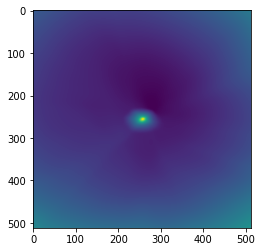

epoch 16601: 48.45464324951172
epoch 16602: 49.937076568603516
epoch 16603: 48.889949798583984
epoch 16604: 49.361961364746094
epoch 16605: 48.61625671386719
epoch 16606: 48.74266052246094
epoch 16607: 48.44073486328125
epoch 16608: 49.049747467041016
epoch 16609: 49.65024185180664
epoch 16611: 48.53691482543945
epoch 16612: 48.86520004272461
epoch 16613: 48.13356018066406
epoch 16614: 48.469337463378906
epoch 16615: 49.24707794189453
epoch 16616: 48.255741119384766
epoch 16617: 49.53275680541992
epoch 16618: 48.128326416015625
epoch 16619: 48.307918548583984
epoch 16621: 47.676063537597656
epoch 16622: 48.455711364746094
epoch 16623: 48.852638244628906
epoch 16624: 49.872554779052734
epoch 16625: 48.85013198852539
epoch 16626: 47.65007400512695
epoch 16627: 48.64274597167969
epoch 16628: 49.448455810546875
epoch 16629: 48.92965316772461
epoch 16631: 49.67674255371094
epoch 16632: 49.09452438354492
epoch 16633: 48.982574462890625
epoch 16634: 48.5184440612793
epoch 16635: 48.9902534484

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



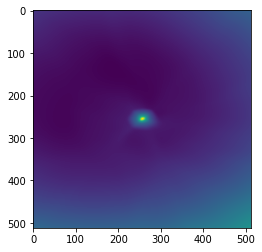

epoch 16701: 48.39246368408203
epoch 16702: 48.09492111206055
epoch 16703: 48.95315170288086
epoch 16704: 48.40839767456055
epoch 16705: 49.48320770263672
epoch 16706: 47.876441955566406
epoch 16707: 51.25117492675781
epoch 16708: 48.394065856933594
epoch 16709: 48.64790725708008
epoch 16711: 48.55043029785156
epoch 16712: 48.57670974731445
epoch 16713: 48.17764663696289
epoch 16714: 48.810951232910156
epoch 16715: 48.20380401611328
epoch 16716: 48.359561920166016
epoch 16717: 48.82371520996094
epoch 16718: 47.6854248046875
epoch 16719: 48.4391975402832
epoch 16721: 47.93855667114258
epoch 16722: 48.21527862548828
epoch 16723: 49.034786224365234
epoch 16724: 48.01398849487305
epoch 16725: 47.99602127075195
epoch 16726: 48.12025451660156
epoch 16727: 48.3388671875
epoch 16728: 49.310394287109375
epoch 16729: 48.77139663696289
epoch 16731: 48.35613250732422
epoch 16732: 48.25593185424805
epoch 16733: 47.303489685058594
epoch 16734: 48.48355484008789
epoch 16735: 48.30834197998047
epoch 1

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



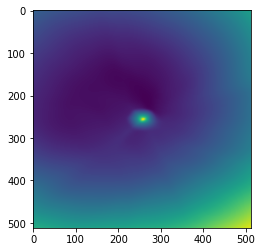

epoch 16801: 47.766944885253906
epoch 16802: 50.333473205566406
epoch 16803: 52.02302932739258
epoch 16804: 47.98009490966797
epoch 16805: 48.5406379699707
epoch 16806: 48.986183166503906
epoch 16807: 48.61076354980469
epoch 16808: 49.40352249145508
epoch 16809: 48.02342224121094
epoch 16811: 49.10847473144531
epoch 16812: 49.66643142700195
epoch 16813: 49.8995361328125
epoch 16814: 50.04734802246094
epoch 16815: 49.66250991821289
epoch 16816: 49.180908203125
epoch 16817: 48.548683166503906
epoch 16818: 48.671852111816406
epoch 16819: 49.844329833984375
epoch 16821: 49.5025749206543
epoch 16822: 49.80636215209961
epoch 16823: 49.48749923706055
epoch 16824: 48.921722412109375
epoch 16825: 48.40821075439453
epoch 16826: 48.85575866699219
epoch 16827: 49.78038787841797
epoch 16828: 48.697261810302734
epoch 16829: 48.5609130859375
epoch 16831: 48.9505729675293
epoch 16832: 49.02146911621094
epoch 16833: 48.7091064453125
epoch 16834: 49.1976432800293
epoch 16835: 49.585025787353516
epoch 16

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



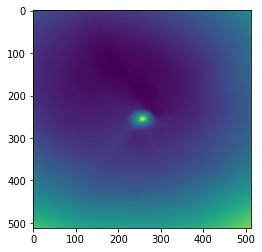

epoch 16901: 47.84477233886719
epoch 16902: 48.93783950805664
epoch 16903: 48.17799377441406
epoch 16904: 47.684417724609375
epoch 16905: 47.694313049316406
epoch 16906: 47.569480895996094
epoch 16907: 48.04850769042969
epoch 16908: 49.099517822265625
epoch 16909: 48.050926208496094
epoch 16911: 48.18307113647461
epoch 16912: 47.8033447265625
epoch 16913: 48.72477340698242
epoch 16914: 48.62731170654297
epoch 16915: 49.00303649902344
epoch 16916: 48.16774368286133
epoch 16917: 49.85004806518555
epoch 16918: 48.921871185302734
epoch 16919: 49.08683395385742
epoch 16921: 48.19721221923828
epoch 16922: 47.935420989990234
epoch 16923: 49.86503982543945
epoch 16924: 49.7542724609375
epoch 16925: 48.99971389770508
epoch 16926: 48.96086120605469
epoch 16927: 49.03240966796875
epoch 16928: 48.457305908203125
epoch 16929: 48.408653259277344
epoch 16931: 48.41532516479492
epoch 16932: 48.6928596496582
epoch 16933: 50.238746643066406
epoch 16934: 48.43775177001953
epoch 16935: 49.6618537902832
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



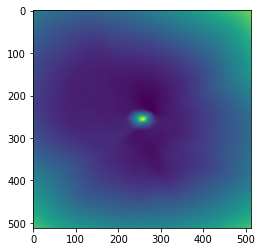

epoch 17001: 48.929283142089844
epoch 17002: 48.97006607055664
epoch 17003: 49.76055908203125
epoch 17004: 48.16194534301758
epoch 17005: 48.41030502319336
epoch 17006: 49.191490173339844
epoch 17007: 50.82829284667969
epoch 17008: 49.736629486083984
epoch 17009: 49.17623519897461
epoch 17011: 49.09075164794922
epoch 17012: 48.08627700805664
epoch 17013: 48.66826629638672
epoch 17014: 49.770263671875
epoch 17015: 49.434791564941406
epoch 17016: 48.934661865234375
epoch 17017: 49.033592224121094
epoch 17018: 48.82362747192383
epoch 17019: 49.20370101928711
epoch 17021: 48.956295013427734
epoch 17022: 48.763954162597656
epoch 17023: 48.6352653503418
epoch 17024: 48.00475311279297
epoch 17025: 48.417327880859375
epoch 17026: 48.6757698059082
epoch 17027: 49.5698356628418
epoch 17028: 48.705039978027344
epoch 17029: 48.6070671081543
epoch 17031: 49.028751373291016
epoch 17032: 48.76756286621094
epoch 17033: 49.109195709228516
epoch 17034: 48.84249496459961
epoch 17035: 49.738651275634766
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



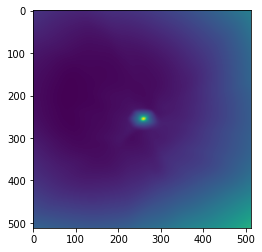

epoch 17101: 48.6545524597168
epoch 17102: 48.986751556396484
epoch 17103: 47.702484130859375
epoch 17104: 47.35988998413086
epoch 17105: 48.825225830078125
epoch 17106: 48.32046890258789
epoch 17107: 48.567420959472656
epoch 17108: 48.220314025878906
epoch 17109: 49.1698112487793
epoch 17111: 47.736629486083984
epoch 17112: 48.01788330078125
epoch 17113: 48.79081344604492
epoch 17114: 49.070716857910156
epoch 17115: 48.64984893798828
epoch 17116: 47.93800354003906
epoch 17117: 49.29087448120117
epoch 17118: 48.28691864013672
epoch 17119: 48.31890106201172
epoch 17121: 48.74104309082031
epoch 17122: 50.30485534667969
epoch 17123: 49.322242736816406
epoch 17124: 48.58162307739258
epoch 17125: 48.79358673095703
epoch 17126: 49.13536071777344
epoch 17127: 49.054290771484375
epoch 17128: 48.29530715942383
epoch 17129: 48.576385498046875
epoch 17131: 47.89590835571289
epoch 17132: 48.14152526855469
epoch 17133: 48.23984146118164
epoch 17134: 48.28541564941406
epoch 17135: 48.29572296142578


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



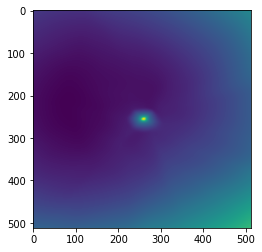

epoch 17201: 48.12873077392578
epoch 17202: 48.18757629394531
epoch 17203: 47.86424255371094
epoch 17204: 47.994728088378906
epoch 17205: 48.70030212402344
epoch 17206: 48.20106506347656
epoch 17207: 52.6412353515625
epoch 17208: 48.392948150634766
epoch 17209: 48.59149169921875
epoch 17211: 47.66507339477539
epoch 17212: 48.22201919555664
epoch 17213: 48.85448455810547
epoch 17214: 47.92660903930664
epoch 17215: 47.57448959350586
epoch 17216: 48.861595153808594
epoch 17217: 48.15338897705078
epoch 17218: 48.96082305908203
epoch 17219: 48.64314270019531
epoch 17221: 48.952396392822266
epoch 17222: 47.80903244018555
epoch 17223: 53.96797561645508
epoch 17224: 48.526893615722656
epoch 17225: 48.753501892089844
epoch 17226: 48.942752838134766
epoch 17227: 49.10089111328125
epoch 17228: 48.96506118774414
epoch 17229: 48.365055084228516
epoch 17231: 49.87128448486328
epoch 17232: 48.34227752685547
epoch 17233: 49.61737823486328
epoch 17234: 48.49892044067383
epoch 17235: 47.860721588134766


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



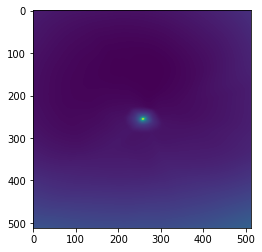

epoch 17301: 48.31982421875
epoch 17302: 48.70823669433594
epoch 17303: 48.7503547668457
epoch 17304: 47.8913459777832
epoch 17305: 48.23820495605469
epoch 17306: 48.57816696166992
epoch 17307: 48.17055892944336
epoch 17308: 48.536231994628906
epoch 17309: 48.279319763183594
epoch 17311: 48.38359451293945
epoch 17312: 49.11819839477539
epoch 17313: 50.235843658447266
epoch 17314: 48.349884033203125
epoch 17315: 48.6933708190918
epoch 17316: 47.894287109375
epoch 17317: 48.89418029785156
epoch 17318: 48.20161819458008
epoch 17319: 47.44187927246094
epoch 17321: 48.233055114746094
epoch 17322: 48.14598083496094
epoch 17323: 48.88917922973633
epoch 17324: 48.98531723022461
epoch 17325: 48.0836181640625
epoch 17326: 48.838436126708984
epoch 17327: 47.6907844543457
epoch 17328: 48.46725845336914
epoch 17329: 48.12159729003906
epoch 17331: 48.87348556518555
epoch 17332: 48.4090576171875
epoch 17333: 48.95830535888672
epoch 17334: 48.62611770629883
epoch 17335: 48.92469787597656
epoch 17336: 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



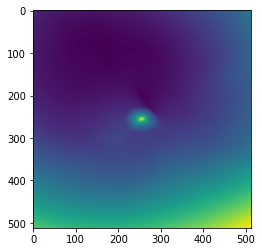

epoch 17401: 47.82904815673828
epoch 17402: 49.54803466796875
epoch 17403: 48.36162567138672
epoch 17404: 49.608272552490234
epoch 17405: 48.15964126586914
epoch 17406: 48.82415771484375
epoch 17407: 50.16170120239258
epoch 17408: 48.578792572021484
epoch 17409: 49.039066314697266
epoch 17411: 49.44502258300781
epoch 17412: 49.585235595703125
epoch 17413: 49.257022857666016
epoch 17414: 48.79106903076172
epoch 17415: 50.092315673828125
epoch 17416: 49.683929443359375
epoch 17417: 49.53362274169922
epoch 17418: 48.99378204345703
epoch 17419: 49.41564178466797
epoch 17421: 50.285438537597656
epoch 17422: 49.221561431884766
epoch 17423: 48.6306037902832
epoch 17424: 49.76580810546875
epoch 17425: 49.23000717163086
epoch 17426: 48.20743179321289
epoch 17427: 48.48187255859375
epoch 17428: 48.030269622802734
epoch 17429: 48.11678695678711
epoch 17431: 48.73191452026367
epoch 17432: 48.734622955322266
epoch 17433: 48.06291961669922
epoch 17434: 48.83371353149414
epoch 17435: 48.6598358154296

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



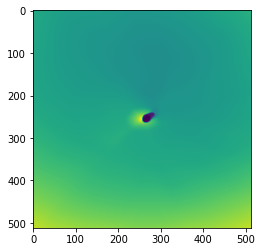

epoch 17501: 50.20254135131836
epoch 17502: 49.15809631347656
epoch 17503: 49.90351867675781
epoch 17504: 48.033531188964844
epoch 17505: 50.682979583740234
epoch 17506: 49.53114318847656
epoch 17507: 49.36341857910156
epoch 17508: 49.039615631103516
epoch 17509: 48.98598861694336
epoch 17511: 48.897159576416016
epoch 17512: 49.75910949707031
epoch 17513: 48.66276931762695
epoch 17514: 49.300750732421875
epoch 17515: 49.66370391845703
epoch 17516: 49.18610382080078
epoch 17517: 49.81916809082031
epoch 17518: 49.63746643066406
epoch 17519: 48.941036224365234
epoch 17521: 49.0491828918457
epoch 17522: 49.0931510925293
epoch 17523: 48.83281326293945
epoch 17524: 48.505714416503906
epoch 17525: 49.124656677246094
epoch 17526: 50.21347427368164
epoch 17527: 51.37908935546875
epoch 17528: 49.867942810058594
epoch 17529: 49.05028533935547
epoch 17531: 49.0994873046875
epoch 17532: 49.87598419189453
epoch 17533: 48.47616958618164
epoch 17534: 49.68540573120117
epoch 17535: 48.63908767700195
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



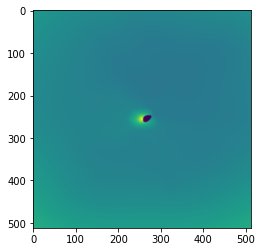

epoch 17601: 49.72408676147461
epoch 17602: 48.71456527709961
epoch 17603: 48.48069763183594
epoch 17604: 48.97871398925781
epoch 17605: 48.92192840576172
epoch 17606: 48.85464096069336
epoch 17607: 49.65639114379883
epoch 17608: 49.389747619628906
epoch 17609: 49.076866149902344
epoch 17611: 48.706546783447266
epoch 17612: 48.763648986816406
epoch 17613: 48.77223587036133
epoch 17614: 49.8459587097168
epoch 17615: 48.90708923339844
epoch 17616: 49.14745330810547
epoch 17617: 48.50520706176758
epoch 17618: 48.60138702392578
epoch 17619: 48.89363098144531
epoch 17621: 48.82773208618164
epoch 17622: 48.36582946777344
epoch 17623: 48.66291046142578
epoch 17624: 49.290313720703125
epoch 17625: 47.785587310791016
epoch 17626: 48.83595275878906
epoch 17627: 48.9214973449707
epoch 17628: 48.56343460083008
epoch 17629: 49.274959564208984
epoch 17631: 49.16001510620117
epoch 17632: 47.96733856201172
epoch 17633: 47.83470916748047
epoch 17634: 48.462947845458984
epoch 17635: 48.603885650634766
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



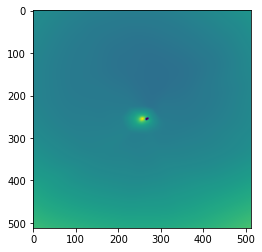

epoch 17701: 48.341346740722656
epoch 17702: 49.60182571411133
epoch 17703: 48.45582962036133
epoch 17704: 48.65242004394531
epoch 17705: 48.250762939453125
epoch 17706: 48.63348388671875
epoch 17707: 47.51621627807617
epoch 17708: 49.19196319580078
epoch 17709: 49.063438415527344
epoch 17711: 49.93234634399414
epoch 17712: 49.780174255371094
epoch 17713: 48.69976806640625
epoch 17714: 48.12676239013672
epoch 17715: 49.701114654541016
epoch 17716: 48.56524658203125
epoch 17717: 48.523738861083984
epoch 17718: 49.9622802734375
epoch 17719: 49.322200775146484
epoch 17721: 49.9580192565918
epoch 17722: 48.505706787109375
epoch 17723: 50.065711975097656
epoch 17724: 48.5968132019043
epoch 17725: 48.618751525878906
epoch 17726: 49.49971008300781
epoch 17727: 48.30500793457031
epoch 17728: 49.001522064208984
epoch 17729: 48.4552001953125
epoch 17731: 48.61628723144531
epoch 17732: 48.64154052734375
epoch 17733: 47.9055061340332
epoch 17734: 48.487613677978516
epoch 17735: 48.06169509887695
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



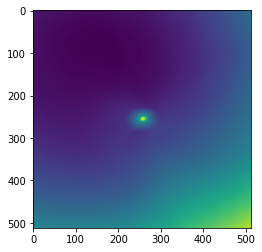

epoch 17801: 49.38026428222656
epoch 17802: 49.042423248291016
epoch 17803: 48.672821044921875
epoch 17804: 48.39598083496094
epoch 17805: 48.55369567871094
epoch 17806: 48.940059661865234
epoch 17807: 48.2910041809082
epoch 17808: 50.48161315917969
epoch 17809: 49.241397857666016
epoch 17811: 48.33623123168945
epoch 17812: 48.201141357421875
epoch 17813: 48.35022735595703
epoch 17814: 48.64569854736328
epoch 17815: 49.08449172973633
epoch 17816: 48.59569549560547
epoch 17817: 48.372493743896484
epoch 17818: 48.27019500732422
epoch 17819: 49.06230545043945
epoch 17821: 48.351863861083984
epoch 17822: 48.864776611328125
epoch 17823: 48.06462860107422
epoch 17824: 48.240638732910156
epoch 17825: 48.49934005737305
epoch 17826: 48.93366622924805
epoch 17827: 47.84087371826172
epoch 17828: 48.38393783569336
epoch 17829: 48.915733337402344
epoch 17831: 47.71196365356445
epoch 17832: 49.44225311279297
epoch 17833: 48.20252990722656
epoch 17834: 48.0289306640625
epoch 17835: 48.85690689086914


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



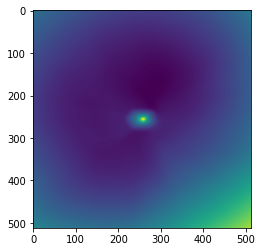

epoch 17901: 48.71025085449219
epoch 17902: 49.38615417480469
epoch 17903: 48.4279899597168
epoch 17904: 48.58372497558594
epoch 17905: 49.103878021240234
epoch 17906: 49.182125091552734
epoch 17907: 47.90543746948242
epoch 17908: 48.871337890625
epoch 17909: 48.4782600402832
epoch 17911: 50.181114196777344
epoch 17912: 48.27941131591797
epoch 17913: 48.31119918823242
epoch 17914: 48.487144470214844
epoch 17915: 48.92392349243164
epoch 17916: 49.05590057373047
epoch 17917: 48.66025161743164
epoch 17918: 48.48513412475586
epoch 17919: 48.584625244140625
epoch 17921: 47.984710693359375
epoch 17922: 48.475826263427734
epoch 17923: 49.07291030883789
epoch 17924: 48.21826934814453
epoch 17925: 47.985843658447266
epoch 17926: 48.34334182739258
epoch 17927: 48.0192985534668
epoch 17928: 48.88037872314453
epoch 17929: 48.69438552856445
epoch 17931: 48.30286407470703
epoch 17932: 48.490699768066406
epoch 17933: 48.18171691894531
epoch 17934: 48.471866607666016
epoch 17935: 48.56974792480469
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



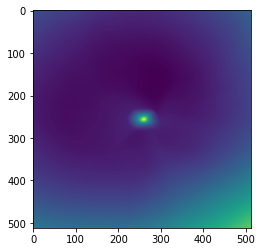

epoch 18001: 49.21120071411133
epoch 18002: 48.84763717651367
epoch 18003: 49.18965530395508
epoch 18004: 48.7812385559082
epoch 18005: 49.03965759277344
epoch 18006: 48.289703369140625
epoch 18007: 49.44295120239258
epoch 18008: 48.665374755859375
epoch 18009: 48.43370056152344
epoch 18011: 47.91530227661133
epoch 18012: 48.67234802246094
epoch 18013: 49.0469970703125
epoch 18014: 50.173301696777344
epoch 18015: 48.78379440307617
epoch 18016: 48.47322082519531
epoch 18017: 48.598880767822266
epoch 18018: 48.19021224975586
epoch 18019: 47.895973205566406
epoch 18021: 48.91424560546875
epoch 18022: 48.44799041748047
epoch 18023: 49.50738525390625
epoch 18024: 48.891502380371094
epoch 18025: 48.72386169433594
epoch 18026: 49.58242416381836
epoch 18027: 49.59312438964844
epoch 18028: 48.80924987792969
epoch 18029: 49.68796157836914
epoch 18031: 49.28942108154297
epoch 18032: 49.32649230957031
epoch 18033: 48.45187759399414
epoch 18034: 48.254981994628906
epoch 18035: 48.710960388183594
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



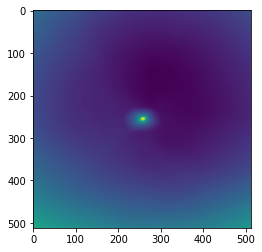

epoch 18101: 48.11637878417969
epoch 18102: 48.617279052734375
epoch 18103: 49.241363525390625
epoch 18104: 49.02675247192383
epoch 18105: 48.36490249633789
epoch 18106: 48.85978317260742
epoch 18107: 48.42332458496094
epoch 18108: 48.82330322265625
epoch 18109: 49.399192810058594
epoch 18111: 51.0733642578125
epoch 18112: 49.02337646484375
epoch 18113: 48.836448669433594
epoch 18114: 49.48375701904297
epoch 18115: 48.774959564208984
epoch 18116: 52.731388092041016
epoch 18117: 48.295040130615234
epoch 18118: 48.80870819091797
epoch 18119: 49.5478401184082
epoch 18121: 48.907901763916016
epoch 18122: 48.74873352050781
epoch 18123: 49.469322204589844
epoch 18124: 49.14780807495117
epoch 18125: 48.78601837158203
epoch 18126: 49.79230880737305
epoch 18127: 48.5754280090332
epoch 18128: 48.57579803466797
epoch 18129: 49.65874481201172
epoch 18131: 49.57897186279297
epoch 18132: 48.37594223022461
epoch 18133: 48.48585510253906
epoch 18134: 48.704166412353516
epoch 18135: 48.70164489746094
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



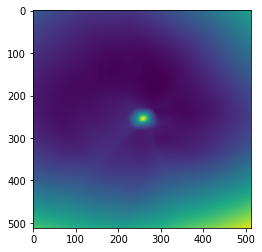

epoch 18201: 49.13545227050781
epoch 18202: 48.18806076049805
epoch 18203: 48.29612350463867
epoch 18204: 48.86223602294922
epoch 18205: 47.9334602355957
epoch 18206: 48.52111053466797
epoch 18207: 47.85295486450195
epoch 18208: 48.13977813720703
epoch 18209: 48.26793670654297
epoch 18211: 48.88455581665039
epoch 18212: 48.80600357055664
epoch 18213: 48.85381317138672
epoch 18214: 48.89364242553711
epoch 18215: 48.64596176147461
epoch 18216: 49.128089904785156
epoch 18217: 47.593910217285156
epoch 18218: 48.891090393066406
epoch 18219: 48.572418212890625
epoch 18221: 48.81544494628906
epoch 18222: 48.95398712158203
epoch 18223: 48.46248245239258
epoch 18224: 49.19316864013672
epoch 18225: 49.51701354980469
epoch 18226: 48.98664093017578
epoch 18227: 49.17005157470703
epoch 18228: 48.64297103881836
epoch 18229: 48.875396728515625
epoch 18231: 48.98456573486328
epoch 18232: 48.996849060058594
epoch 18233: 47.99321746826172
epoch 18234: 48.85050964355469
epoch 18235: 48.871456146240234
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



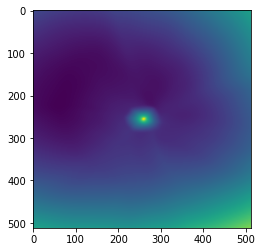

epoch 18301: 47.5345344543457
epoch 18302: 48.05914306640625
epoch 18303: 48.464599609375
epoch 18304: 48.771854400634766
epoch 18305: 48.4041862487793
epoch 18306: 47.892948150634766
epoch 18307: 47.96955871582031
epoch 18308: 48.89386749267578
epoch 18309: 47.69070053100586
epoch 18311: 47.960262298583984
epoch 18312: 47.970306396484375
epoch 18313: 48.22139358520508
epoch 18314: 47.43243408203125
epoch 18315: 48.16691589355469
epoch 18316: 47.352394104003906
epoch 18317: 47.37069320678711
epoch 18318: 48.1492919921875
epoch 18319: 47.74789810180664
epoch 18321: 48.332027435302734
epoch 18322: 48.764591217041016
epoch 18323: 47.93095016479492
epoch 18324: 47.969608306884766
epoch 18325: 47.338340759277344
epoch 18326: 48.517921447753906
epoch 18327: 47.53605270385742
epoch 18328: 48.557594299316406
epoch 18329: 48.04237365722656
epoch 18331: 48.83793640136719
epoch 18332: 47.38374328613281
epoch 18333: 48.878326416015625
epoch 18334: 48.56428527832031
epoch 18335: 48.3021354675293
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



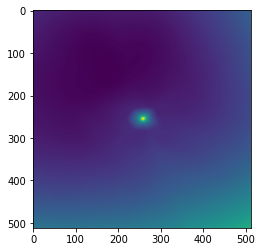

epoch 18401: 48.8828239440918
epoch 18402: 48.52253723144531
epoch 18403: 49.40339660644531
epoch 18404: 48.82403564453125
epoch 18405: 48.514339447021484
epoch 18406: 48.47568893432617
epoch 18407: 49.7490119934082
epoch 18408: 48.460689544677734
epoch 18409: 47.800174713134766
epoch 18411: 48.198158264160156
epoch 18412: 47.907100677490234
epoch 18413: 48.21685028076172
epoch 18414: 47.78624725341797
epoch 18415: 48.34782409667969
epoch 18416: 47.664306640625
epoch 18417: 49.185150146484375
epoch 18418: 47.6518669128418
epoch 18419: 47.48423767089844
epoch 18421: 49.6174201965332
epoch 18422: 49.50148391723633
epoch 18423: 48.73806381225586
epoch 18424: 48.181915283203125
epoch 18425: 48.06803894042969
epoch 18426: 48.60509490966797
epoch 18427: 48.36338424682617
epoch 18428: 47.720062255859375
epoch 18429: 48.24285888671875
epoch 18431: 47.79050064086914
epoch 18432: 48.40952682495117
epoch 18433: 48.76484298706055
epoch 18434: 47.45646667480469
epoch 18435: 49.00341033935547
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



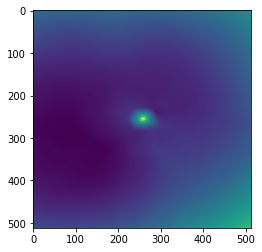

epoch 18501: 48.038543701171875
epoch 18502: 48.79249954223633
epoch 18503: 48.83418655395508
epoch 18504: 49.491580963134766
epoch 18505: 49.6601676940918
epoch 18506: 48.786888122558594
epoch 18507: 49.014793395996094
epoch 18508: 49.30795669555664
epoch 18509: 48.508445739746094
epoch 18511: 50.019351959228516
epoch 18512: 48.664432525634766
epoch 18513: 49.41755676269531
epoch 18514: 48.53483581542969
epoch 18515: 50.219505310058594
epoch 18516: 47.564422607421875
epoch 18517: 48.5665283203125
epoch 18518: 49.202964782714844
epoch 18519: 48.733768463134766
epoch 18521: 47.778865814208984
epoch 18522: 48.58164596557617
epoch 18523: 48.901309967041016
epoch 18524: 49.01162338256836
epoch 18525: 49.454402923583984
epoch 18526: 48.82133865356445
epoch 18527: 48.38995361328125
epoch 18528: 48.149452209472656
epoch 18529: 47.64936447143555
epoch 18531: 49.97186279296875
epoch 18532: 48.017059326171875
epoch 18533: 48.57054138183594
epoch 18534: 48.56018829345703
epoch 18535: 48.176136016

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



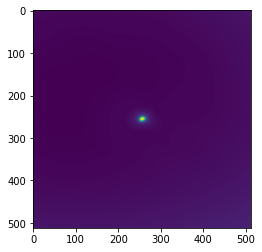

epoch 18601: 48.986419677734375
epoch 18602: 48.879276275634766
epoch 18603: 49.13082504272461
epoch 18604: 49.19205093383789
epoch 18605: 49.17368698120117
epoch 18606: 49.904056549072266
epoch 18607: 49.240013122558594
epoch 18608: 49.224884033203125
epoch 18609: 48.320350646972656
epoch 18611: 48.35424041748047
epoch 18612: 49.149715423583984
epoch 18613: 48.82002258300781
epoch 18614: 48.468963623046875
epoch 18615: 49.02076721191406
epoch 18616: 48.58363723754883
epoch 18617: 49.11396408081055
epoch 18618: 48.290096282958984
epoch 18619: 49.22180938720703
epoch 18621: 49.75734329223633
epoch 18622: 48.8148193359375
epoch 18623: 47.69903564453125
epoch 18624: 48.629093170166016
epoch 18625: 48.24795150756836
epoch 18626: 47.98374557495117
epoch 18627: 49.20265197753906
epoch 18628: 49.18502426147461
epoch 18629: 48.27216339111328
epoch 18631: 48.77916717529297
epoch 18632: 49.41337966918945
epoch 18633: 48.57954025268555
epoch 18634: 48.5161247253418
epoch 18635: 48.19420623779297


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



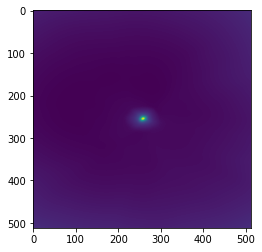

epoch 18701: 47.7496452331543
epoch 18702: 49.138221740722656
epoch 18703: 49.50403594970703
epoch 18704: 48.364906311035156
epoch 18705: 47.98255920410156
epoch 18706: 48.45144271850586
epoch 18707: 47.94052505493164
epoch 18708: 48.95875549316406
epoch 18709: 48.833736419677734
epoch 18711: 48.331424713134766
epoch 18712: 48.090328216552734
epoch 18713: 48.669734954833984
epoch 18714: 47.0964469909668
epoch 18715: 48.537269592285156
epoch 18716: 49.534027099609375
epoch 18717: 48.7099494934082
epoch 18718: 48.77207565307617
epoch 18719: 49.54928207397461
epoch 18721: 49.41118240356445
epoch 18722: 48.36540603637695
epoch 18723: 47.42953872680664
epoch 18724: 48.9256706237793
epoch 18725: 48.71162033081055
epoch 18726: 49.102516174316406
epoch 18727: 48.47212600708008
epoch 18728: 47.73447799682617
epoch 18729: 49.47811508178711
epoch 18731: 48.42734146118164
epoch 18732: 47.50572204589844
epoch 18733: 48.491294860839844
epoch 18734: 49.1971549987793
epoch 18735: 48.382930755615234
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



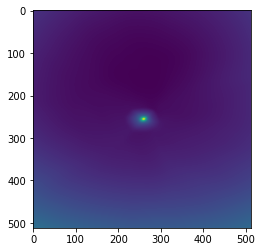

epoch 18801: 49.729976654052734
epoch 18802: 48.0443229675293
epoch 18803: 48.5903205871582
epoch 18804: 49.158817291259766
epoch 18805: 48.75812911987305
epoch 18806: 48.78450012207031
epoch 18807: 49.972408294677734
epoch 18808: 49.593448638916016
epoch 18809: 48.83660125732422
epoch 18811: 49.35523223876953
epoch 18812: 49.21549987792969
epoch 18813: 49.24872970581055
epoch 18814: 49.38359069824219
epoch 18815: 49.08549880981445
epoch 18816: 48.406494140625
epoch 18817: 49.41741180419922
epoch 18818: 48.168922424316406
epoch 18819: 49.447235107421875
epoch 18821: 49.597110748291016
epoch 18822: 48.77503967285156
epoch 18823: 48.845027923583984
epoch 18824: 48.42009353637695
epoch 18825: 48.8458366394043
epoch 18826: 51.94779586791992
epoch 18827: 49.01751708984375
epoch 18828: 50.1666374206543
epoch 18829: 48.784732818603516
epoch 18831: 48.51075744628906
epoch 18832: 49.32314682006836
epoch 18833: 49.191009521484375
epoch 18834: 48.02766036987305
epoch 18835: 48.955238342285156
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



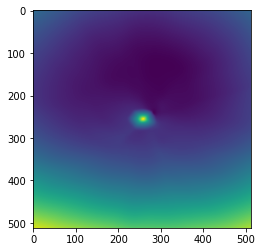

epoch 18901: 48.112709045410156
epoch 18902: 48.08526611328125
epoch 18903: 48.300071716308594
epoch 18904: 49.242740631103516
epoch 18905: 47.84243392944336
epoch 18906: 48.333194732666016
epoch 18907: 48.05706787109375
epoch 18908: 48.63788986206055
epoch 18909: 48.20469665527344
epoch 18911: 49.13163375854492
epoch 18912: 48.751094818115234
epoch 18913: 48.99787902832031
epoch 18914: 47.34601974487305
epoch 18915: 48.25375747680664
epoch 18916: 49.54066467285156
epoch 18917: 48.95274353027344
epoch 18918: 48.2505989074707
epoch 18919: 48.55012893676758
epoch 18921: 49.75327682495117
epoch 18922: 48.611576080322266
epoch 18923: 47.96192932128906
epoch 18924: 48.536460876464844
epoch 18925: 49.298316955566406
epoch 18926: 48.32902908325195
epoch 18927: 48.12162780761719
epoch 18928: 48.49054718017578
epoch 18929: 49.83142852783203
epoch 18931: 48.32975769042969
epoch 18932: 48.76166915893555
epoch 18933: 48.14460754394531
epoch 18934: 48.07758331298828
epoch 18935: 48.000823974609375


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



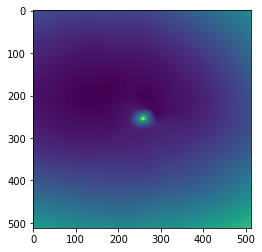

epoch 19001: 48.58807373046875
epoch 19002: 49.33452224731445
epoch 19003: 49.01911926269531
epoch 19004: 48.772254943847656
epoch 19005: 48.825626373291016
epoch 19006: 48.28496170043945
epoch 19007: 48.850807189941406
epoch 19008: 48.36476135253906
epoch 19009: 48.56552505493164
epoch 19011: 48.62301254272461
epoch 19012: 48.62467575073242
epoch 19013: 49.338443756103516
epoch 19014: 48.573455810546875
epoch 19015: 48.493404388427734
epoch 19016: 48.758056640625
epoch 19017: 48.61690902709961
epoch 19018: 48.55966567993164
epoch 19019: 48.68955612182617
epoch 19021: 51.009132385253906
epoch 19022: 48.15918731689453
epoch 19023: 48.04473876953125
epoch 19024: 47.77851486206055
epoch 19025: 48.207672119140625
epoch 19026: 48.181480407714844
epoch 19027: 48.983238220214844
epoch 19028: 48.4927864074707
epoch 19029: 48.229496002197266
epoch 19031: 49.09083557128906
epoch 19032: 47.155059814453125
epoch 19033: 48.39381790161133
epoch 19034: 47.986637115478516
epoch 19035: 48.6577453613281

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



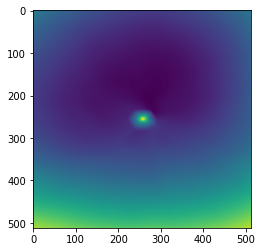

epoch 19101: 48.84023666381836
epoch 19102: 49.11626052856445
epoch 19103: 48.56945037841797
epoch 19104: 47.59421157836914
epoch 19105: 48.64409637451172
epoch 19106: 48.594608306884766
epoch 19107: 48.25689697265625
epoch 19108: 48.32817840576172
epoch 19109: 48.46480178833008
epoch 19111: 48.162139892578125
epoch 19112: 47.99580383300781
epoch 19113: 47.77766799926758
epoch 19114: 47.596214294433594
epoch 19115: 47.93885803222656
epoch 19116: 47.20160675048828
epoch 19117: 48.700016021728516
epoch 19118: 48.74592971801758
epoch 19119: 48.691532135009766
epoch 19121: 48.11972427368164
epoch 19122: 48.47508239746094
epoch 19123: 48.725162506103516
epoch 19124: 49.086124420166016
epoch 19125: 48.14774703979492
epoch 19126: 51.08597946166992
epoch 19127: 47.89762496948242
epoch 19128: 48.08295440673828
epoch 19129: 48.367652893066406
epoch 19131: 48.94513702392578
epoch 19132: 47.409645080566406
epoch 19133: 47.70172119140625
epoch 19134: 48.4302864074707
epoch 19135: 48.64704513549805


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



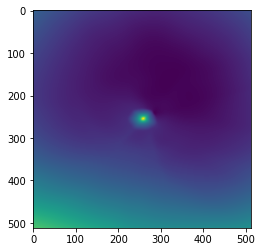

epoch 19201: 48.38584899902344
epoch 19202: 48.37407684326172
epoch 19203: 48.92959976196289
epoch 19204: 49.17759704589844
epoch 19205: 48.764442443847656
epoch 19206: 48.05027389526367
epoch 19207: 48.851200103759766
epoch 19208: 49.03498840332031
epoch 19209: 48.8468017578125
epoch 19211: 48.079647064208984
epoch 19212: 48.92762756347656
epoch 19213: 49.04670333862305
epoch 19214: 48.679786682128906
epoch 19215: 48.7515983581543
epoch 19216: 49.37166976928711
epoch 19217: 48.63521194458008
epoch 19218: 48.53495407104492
epoch 19219: 48.64125061035156
epoch 19221: 47.79696273803711
epoch 19222: 49.069950103759766
epoch 19223: 48.23699188232422
epoch 19224: 51.85205841064453
epoch 19225: 48.32298278808594
epoch 19226: 49.25951385498047
epoch 19227: 49.446041107177734
epoch 19228: 47.66958999633789
epoch 19229: 48.3569221496582
epoch 19231: 49.486732482910156
epoch 19232: 48.59733200073242
epoch 19233: 49.34398651123047
epoch 19234: 48.19700622558594
epoch 19235: 48.41907501220703
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



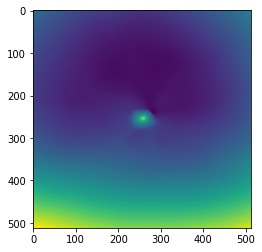

epoch 19301: 48.707275390625
epoch 19302: 48.3521728515625
epoch 19303: 48.14125442504883
epoch 19304: 48.00380325317383
epoch 19305: 48.88631820678711
epoch 19306: 48.20330047607422
epoch 19307: 48.7762451171875
epoch 19308: 48.93134307861328
epoch 19309: 48.1440544128418
epoch 19311: 48.62699890136719
epoch 19312: 47.90544891357422
epoch 19313: 47.9578742980957
epoch 19314: 48.446414947509766
epoch 19315: 49.13268280029297
epoch 19316: 48.694366455078125
epoch 19317: 48.61655044555664
epoch 19318: 49.53617477416992
epoch 19319: 48.4760856628418
epoch 19321: 47.9304313659668
epoch 19322: 47.243309020996094
epoch 19323: 52.919437408447266
epoch 19324: 48.753440856933594
epoch 19325: 48.149452209472656
epoch 19326: 47.57273864746094
epoch 19327: 48.45512390136719
epoch 19328: 51.60857009887695
epoch 19329: 48.684608459472656
epoch 19331: 48.71290969848633
epoch 19332: 47.92221450805664
epoch 19333: 48.108978271484375
epoch 19334: 48.41996383666992
epoch 19335: 49.029014587402344
epoch 1

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



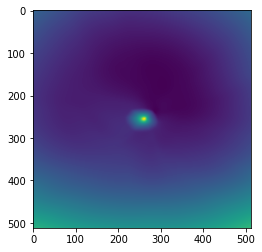

epoch 19401: 48.570003509521484
epoch 19402: 48.735328674316406
epoch 19403: 48.72068786621094
epoch 19404: 49.02554702758789
epoch 19405: 48.829715728759766
epoch 19406: 48.192047119140625
epoch 19407: 48.669647216796875
epoch 19408: 49.09128952026367
epoch 19409: 48.01601028442383
epoch 19411: 48.768104553222656
epoch 19412: 48.69257736206055
epoch 19413: 49.29121017456055
epoch 19414: 49.186607360839844
epoch 19415: 48.10663986206055
epoch 19416: 48.2620964050293
epoch 19417: 47.514408111572266
epoch 19418: 48.33938217163086
epoch 19419: 49.58747863769531
epoch 19421: 48.01631546020508
epoch 19422: 48.23929977416992
epoch 19423: 49.23426818847656
epoch 19424: 49.35785675048828
epoch 19425: 48.35621643066406
epoch 19426: 49.15791320800781
epoch 19427: 48.246639251708984
epoch 19428: 48.781341552734375
epoch 19429: 48.3139762878418
epoch 19431: 47.81694793701172
epoch 19432: 47.62150955200195
epoch 19433: 48.160675048828125
epoch 19434: 48.15796661376953
epoch 19435: 48.54687881469726

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



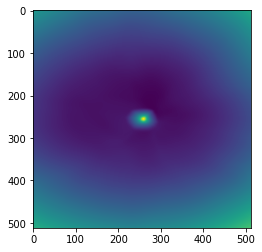

epoch 19501: 50.528560638427734
epoch 19502: 48.68675994873047
epoch 19503: 48.3317756652832
epoch 19504: 48.19969177246094
epoch 19505: 48.85051727294922
epoch 19506: 48.7244987487793
epoch 19507: 48.254947662353516
epoch 19508: 48.17220687866211
epoch 19509: 49.223453521728516
epoch 19511: 48.404937744140625
epoch 19512: 48.434024810791016
epoch 19513: 48.025535583496094
epoch 19514: 48.54326248168945
epoch 19515: 47.56117630004883
epoch 19516: 48.51288986206055
epoch 19517: 47.530330657958984
epoch 19518: 47.666439056396484
epoch 19519: 48.72594451904297
epoch 19521: 48.37809753417969
epoch 19522: 48.26084899902344
epoch 19523: 49.437015533447266
epoch 19524: 49.133460998535156
epoch 19525: 48.51338195800781
epoch 19526: 49.41335678100586
epoch 19527: 48.2818603515625
epoch 19528: 49.41874694824219
epoch 19529: 48.22509002685547
epoch 19531: 48.932247161865234
epoch 19532: 48.67934036254883
epoch 19533: 48.07246780395508
epoch 19534: 49.318382263183594
epoch 19535: 52.9820671081543


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



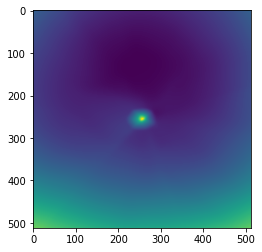

epoch 19601: 48.841121673583984
epoch 19602: 48.657249450683594
epoch 19603: 47.53982925415039
epoch 19604: 47.9811897277832
epoch 19605: 48.546119689941406
epoch 19606: 48.217552185058594
epoch 19607: 47.91450881958008
epoch 19608: 48.354774475097656
epoch 19609: 48.56182098388672
epoch 19611: 49.833404541015625
epoch 19612: 48.81932067871094
epoch 19613: 48.09316635131836
epoch 19614: 48.2756462097168
epoch 19615: 48.86084747314453
epoch 19616: 48.95905685424805
epoch 19617: 50.63728332519531
epoch 19618: 49.226356506347656
epoch 19619: 48.967159271240234
epoch 19621: 48.979515075683594
epoch 19622: 48.20640563964844
epoch 19623: 48.043357849121094
epoch 19624: 48.39330291748047
epoch 19625: 48.617794036865234
epoch 19626: 49.16303634643555
epoch 19627: 48.847660064697266
epoch 19628: 48.6183967590332
epoch 19629: 49.10466766357422
epoch 19631: 47.4795036315918
epoch 19632: 49.38227081298828
epoch 19633: 47.569515228271484
epoch 19634: 48.79759979248047
epoch 19635: 48.20975875854492

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



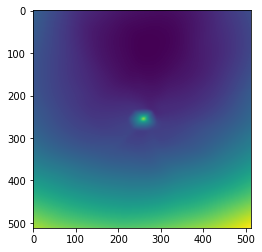

epoch 19701: 48.75847625732422
epoch 19702: 48.27119445800781
epoch 19703: 47.83008575439453
epoch 19704: 48.407264709472656
epoch 19705: 47.772403717041016
epoch 19706: 51.77976989746094
epoch 19707: 48.19560623168945
epoch 19708: 48.12045669555664
epoch 19709: 48.46059799194336
epoch 19711: 48.91592788696289
epoch 19712: 48.816898345947266
epoch 19713: 48.25017166137695
epoch 19714: 49.17259216308594
epoch 19715: 47.52072525024414
epoch 19716: 48.326019287109375
epoch 19717: 48.39030456542969
epoch 19718: 47.83746337890625
epoch 19719: 48.534664154052734
epoch 19721: 48.52946472167969
epoch 19722: 47.61185836791992
epoch 19723: 48.19288635253906
epoch 19724: 48.61811828613281
epoch 19725: 48.92667770385742
epoch 19726: 48.821510314941406
epoch 19727: 48.44838333129883
epoch 19728: 48.48151779174805
epoch 19729: 48.717350006103516
epoch 19731: 48.466468811035156
epoch 19732: 48.25471878051758
epoch 19733: 49.579559326171875
epoch 19734: 48.53062057495117
epoch 19735: 48.06188201904297

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



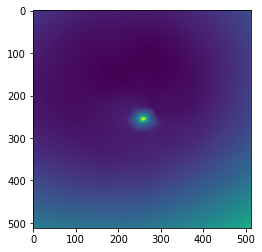

epoch 19801: 49.66603469848633
epoch 19802: 49.36208724975586
epoch 19803: 49.13134002685547
epoch 19804: 48.15021896362305
epoch 19805: 48.00306701660156
epoch 19806: 49.396453857421875
epoch 19807: 49.96103286743164
epoch 19808: 48.579959869384766
epoch 19809: 49.103179931640625
epoch 19811: 48.2001953125
epoch 19812: 48.418365478515625
epoch 19813: 48.19743347167969
epoch 19814: 48.695159912109375
epoch 19815: 47.52571105957031
epoch 19816: 48.52695846557617
epoch 19817: 50.25834655761719
epoch 19818: 47.67782211303711
epoch 19819: 48.840492248535156
epoch 19821: 48.89140319824219
epoch 19822: 48.3706169128418
epoch 19823: 48.35919952392578
epoch 19824: 48.47565841674805
epoch 19825: 48.354087829589844
epoch 19826: 48.2442512512207
epoch 19827: 48.36590576171875
epoch 19828: 48.882354736328125
epoch 19829: 49.34608840942383
epoch 19831: 48.579471588134766
epoch 19832: 48.452735900878906
epoch 19833: 48.166202545166016
epoch 19834: 49.19999313354492
epoch 19835: 48.70341110229492
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



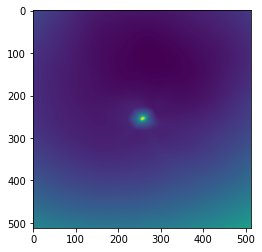

epoch 19901: 48.689720153808594
epoch 19902: 49.371131896972656
epoch 19903: 48.10959243774414
epoch 19904: 48.708274841308594
epoch 19905: 48.39898681640625
epoch 19906: 48.49766159057617
epoch 19907: 48.87622833251953
epoch 19908: 48.933319091796875
epoch 19909: 48.9091682434082
epoch 19911: 48.543670654296875
epoch 19912: 48.70050048828125
epoch 19913: 48.263694763183594
epoch 19914: 48.70131301879883
epoch 19915: 48.49848175048828
epoch 19916: 48.05817413330078
epoch 19917: 49.112770080566406
epoch 19918: 48.96025085449219
epoch 19919: 48.671539306640625
epoch 19921: 47.6287727355957
epoch 19922: 49.0305061340332
epoch 19923: 48.31504821777344
epoch 19924: 48.59077835083008
epoch 19925: 48.67019271850586
epoch 19926: 47.51121139526367
epoch 19927: 48.4836311340332
epoch 19928: 48.07362365722656
epoch 19929: 47.934730529785156
epoch 19931: 48.743587493896484
epoch 19932: 49.030906677246094
epoch 19933: 47.5012092590332
epoch 19934: 48.97260665893555
epoch 19935: 49.10326385498047
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



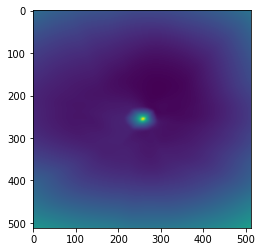

epoch 20001: 48.68265914916992
epoch 20002: 48.884063720703125
epoch 20003: 48.57145690917969
epoch 20004: 47.80576705932617
epoch 20005: 48.534507751464844
epoch 20006: 49.048851013183594
epoch 20007: 48.95354461669922
epoch 20008: 48.633705139160156
epoch 20009: 48.00187301635742
epoch 20011: 48.85476303100586
epoch 20012: 49.57984924316406
epoch 20013: 47.983821868896484
epoch 20014: 48.066444396972656
epoch 20015: 48.750396728515625
epoch 20016: 49.780025482177734
epoch 20017: 49.385955810546875
epoch 20018: 48.767417907714844
epoch 20019: 48.197994232177734
epoch 20021: 48.88357925415039
epoch 20022: 48.76133728027344
epoch 20023: 47.998809814453125
epoch 20024: 48.20896530151367
epoch 20025: 48.12822723388672
epoch 20026: 48.44110107421875
epoch 20027: 48.272682189941406
epoch 20028: 47.89830780029297
epoch 20029: 48.51774978637695
epoch 20031: 48.14246368408203
epoch 20032: 48.34856414794922
epoch 20033: 48.16609191894531
epoch 20034: 48.02164077758789
epoch 20035: 48.2532577514

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



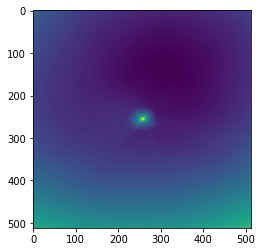

epoch 20101: 47.66089630126953
epoch 20102: 47.539825439453125
epoch 20103: 47.95744323730469
epoch 20104: 47.73678970336914
epoch 20105: 48.263973236083984
epoch 20106: 47.80741500854492
epoch 20107: 47.92355728149414
epoch 20108: 48.451778411865234
epoch 20109: 49.58519744873047
epoch 20111: 49.15353012084961
epoch 20112: 48.1794319152832
epoch 20113: 48.13035202026367
epoch 20114: 48.06660842895508
epoch 20115: 47.974365234375
epoch 20116: 49.08634567260742
epoch 20117: 49.55284881591797
epoch 20118: 48.66729736328125
epoch 20119: 48.35858917236328
epoch 20121: 58.77983856201172
epoch 20122: 48.85669708251953
epoch 20123: 48.711177825927734
epoch 20124: 49.25514221191406
epoch 20125: 48.43036651611328
epoch 20126: 48.64487838745117
epoch 20127: 49.18630599975586
epoch 20128: 48.678688049316406
epoch 20129: 47.984683990478516
epoch 20131: 48.77476119995117
epoch 20132: 48.17329025268555
epoch 20133: 50.386024475097656
epoch 20134: 51.25983810424805
epoch 20135: 49.078609466552734
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



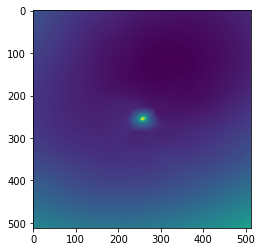

epoch 20201: 49.14128112792969
epoch 20202: 48.428810119628906
epoch 20203: 49.496551513671875
epoch 20204: 47.820045471191406
epoch 20205: 47.82334518432617
epoch 20206: 49.010719299316406
epoch 20207: 49.123680114746094
epoch 20208: 47.62240982055664
epoch 20209: 48.61396026611328
epoch 20211: 48.53240966796875
epoch 20212: 48.98656463623047
epoch 20213: 48.48948669433594
epoch 20214: 47.50212860107422
epoch 20215: 49.04487991333008
epoch 20216: 48.222381591796875
epoch 20217: 48.83787536621094
epoch 20218: 48.8889274597168
epoch 20219: 48.13566589355469
epoch 20221: 48.61101150512695
epoch 20222: 48.1845588684082
epoch 20223: 48.77845001220703
epoch 20224: 48.1827278137207
epoch 20225: 47.607582092285156
epoch 20226: 47.56339645385742
epoch 20227: 48.61262512207031
epoch 20228: 48.18862533569336
epoch 20229: 48.00627517700195
epoch 20231: 47.841434478759766
epoch 20232: 48.13618469238281
epoch 20233: 47.99868392944336
epoch 20234: 48.550025939941406
epoch 20235: 47.743751525878906
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



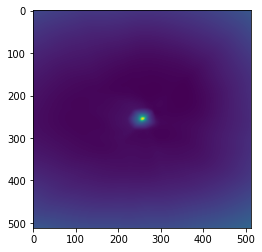

epoch 20301: 49.60702896118164
epoch 20302: 48.233638763427734
epoch 20303: 47.84672927856445
epoch 20304: 47.67195129394531
epoch 20305: 48.475730895996094
epoch 20306: 48.68423080444336
epoch 20307: 48.211151123046875
epoch 20308: 49.35625076293945
epoch 20309: 48.20243835449219
epoch 20311: 47.97111892700195
epoch 20312: 49.2432975769043
epoch 20313: 48.115882873535156
epoch 20314: 48.522403717041016
epoch 20315: 47.88787841796875
epoch 20316: 47.84327697753906
epoch 20317: 48.177425384521484
epoch 20318: 48.484344482421875
epoch 20319: 48.66716766357422
epoch 20321: 48.8458251953125
epoch 20322: 48.47919464111328
epoch 20323: 48.47333526611328
epoch 20324: 49.252437591552734
epoch 20325: 48.200504302978516
epoch 20326: 49.698219299316406
epoch 20327: 48.55094909667969
epoch 20328: 47.631988525390625
epoch 20329: 48.809326171875
epoch 20331: 48.650047302246094
epoch 20332: 48.5112190246582
epoch 20333: 48.227237701416016
epoch 20334: 49.656063079833984
epoch 20335: 48.45854568481445

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



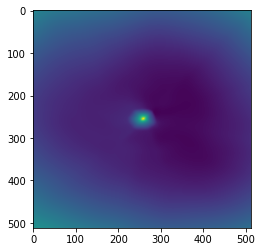

epoch 20401: 48.54115295410156
epoch 20402: 48.638763427734375
epoch 20403: 49.7559814453125
epoch 20404: 49.169281005859375
epoch 20405: 49.335697174072266
epoch 20406: 49.316139221191406
epoch 20407: 48.29228973388672
epoch 20408: 50.25360870361328
epoch 20409: 48.278053283691406
epoch 20411: 50.09916687011719
epoch 20412: 49.07157516479492
epoch 20413: 48.74456024169922
epoch 20414: 48.09457778930664
epoch 20415: 48.23638916015625
epoch 20416: 48.21575164794922
epoch 20417: 48.2652702331543
epoch 20418: 48.08869552612305
epoch 20419: 47.86988830566406
epoch 20421: 48.456424713134766
epoch 20422: 48.90827941894531
epoch 20423: 48.72122573852539
epoch 20424: 48.262996673583984
epoch 20425: 47.86070251464844
epoch 20426: 47.742462158203125
epoch 20427: 49.359642028808594
epoch 20428: 48.355064392089844
epoch 20429: 48.0774040222168
epoch 20431: 47.9176139831543
epoch 20432: 47.936668395996094
epoch 20433: 48.43291091918945
epoch 20434: 48.233314514160156
epoch 20435: 48.11520004272461


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



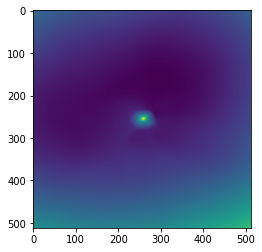

epoch 20501: 48.84233474731445
epoch 20502: 48.55408477783203
epoch 20503: 48.38942337036133
epoch 20504: 48.88568878173828
epoch 20505: 48.60579299926758
epoch 20506: 47.84975814819336
epoch 20507: 49.66770935058594
epoch 20508: 48.73120880126953
epoch 20509: 49.51166915893555
epoch 20511: 47.32167434692383
epoch 20512: 48.364723205566406
epoch 20513: 48.604549407958984
epoch 20514: 48.103763580322266
epoch 20515: 48.06740951538086
epoch 20516: 49.256011962890625
epoch 20517: 48.38172912597656
epoch 20518: 48.126441955566406
epoch 20519: 49.284664154052734
epoch 20521: 48.536468505859375
epoch 20522: 49.18427658081055
epoch 20523: 47.992279052734375
epoch 20524: 48.5506591796875
epoch 20525: 48.657073974609375
epoch 20526: 47.563758850097656
epoch 20527: 48.83442687988281
epoch 20528: 48.68935012817383
epoch 20529: 51.68830108642578
epoch 20531: 48.169944763183594
epoch 20532: 47.98688507080078
epoch 20533: 48.16065216064453
epoch 20534: 48.78916931152344
epoch 20535: 47.7479248046875

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



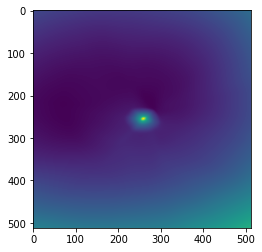

epoch 20601: 49.0161247253418
epoch 20602: 48.131221771240234
epoch 20603: 47.96406936645508
epoch 20604: 48.62826156616211
epoch 20605: 47.440528869628906
epoch 20606: 48.76285934448242
epoch 20607: 47.659793853759766
epoch 20608: 48.82051467895508
epoch 20609: 47.470314025878906
epoch 20611: 51.57472229003906
epoch 20612: 47.923614501953125
epoch 20613: 47.62032699584961
epoch 20614: 48.357879638671875
epoch 20615: 48.25569152832031
epoch 20616: 48.24922561645508
epoch 20617: 48.36467361450195
epoch 20618: 47.55790328979492
epoch 20619: 48.83567428588867
epoch 20621: 48.63474655151367
epoch 20622: 48.5607795715332
epoch 20623: 48.268402099609375
epoch 20624: 49.1480712890625
epoch 20625: 48.30718231201172
epoch 20626: 48.433773040771484
epoch 20627: 47.80083465576172
epoch 20628: 49.848297119140625
epoch 20629: 48.700408935546875
epoch 20631: 48.10192108154297
epoch 20632: 47.60966873168945
epoch 20633: 48.223201751708984
epoch 20634: 47.97712707519531
epoch 20635: 49.22258377075195


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



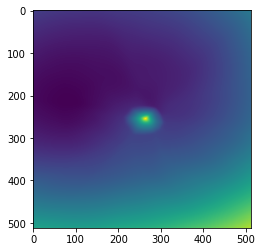

epoch 20701: 48.59307098388672
epoch 20702: 48.63182830810547
epoch 20703: 50.06515884399414
epoch 20704: 48.4399528503418
epoch 20705: 48.140846252441406
epoch 20706: 47.45915985107422
epoch 20707: 48.49502182006836
epoch 20708: 52.75987243652344
epoch 20709: 49.854427337646484
epoch 20711: 50.4448356628418
epoch 20712: 48.00080871582031
epoch 20713: 48.60201644897461
epoch 20714: 48.33771514892578
epoch 20715: 48.840267181396484
epoch 20716: 49.03632736206055
epoch 20717: 47.856544494628906
epoch 20718: 48.471778869628906
epoch 20719: 47.96006774902344
epoch 20721: 48.11013412475586
epoch 20722: 48.937034606933594
epoch 20723: 48.5714225769043
epoch 20724: 48.2230224609375
epoch 20725: 48.382076263427734
epoch 20726: 48.152854919433594
epoch 20727: 48.718414306640625
epoch 20728: 50.35773468017578
epoch 20729: 49.5705451965332
epoch 20731: 49.46217727661133
epoch 20732: 48.53315353393555
epoch 20733: 48.70150375366211
epoch 20734: 49.72783279418945
epoch 20735: 48.20926284790039
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



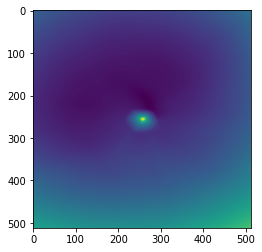

epoch 20801: 48.30522918701172
epoch 20802: 48.467559814453125
epoch 20803: 47.7092399597168
epoch 20804: 47.8810920715332
epoch 20805: 48.740081787109375
epoch 20806: 48.64608383178711
epoch 20807: 47.93476867675781
epoch 20808: 48.835548400878906
epoch 20809: 47.756919860839844
epoch 20811: 48.66599655151367
epoch 20812: 47.767723083496094
epoch 20813: 48.5449104309082
epoch 20814: 48.38574981689453
epoch 20815: 48.458396911621094
epoch 20816: 47.87898254394531
epoch 20817: 49.88829803466797
epoch 20818: 48.695899963378906
epoch 20819: 48.64752197265625
epoch 20821: 48.27833938598633
epoch 20822: 48.63336944580078
epoch 20823: 48.84733963012695
epoch 20824: 48.90199661254883
epoch 20825: 48.475379943847656
epoch 20826: 50.73048400878906
epoch 20827: 48.83331298828125
epoch 20828: 49.47730255126953
epoch 20829: 48.18794631958008
epoch 20831: 48.37113952636719
epoch 20832: 49.17919921875
epoch 20833: 48.084007263183594
epoch 20834: 48.87783432006836
epoch 20835: 48.09991455078125
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



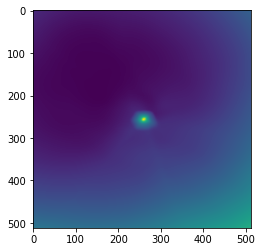

epoch 20901: 48.42609786987305
epoch 20902: 48.25068283081055
epoch 20903: 50.00367736816406
epoch 20904: 48.84878158569336
epoch 20905: 48.36652374267578
epoch 20906: 49.31957244873047
epoch 20907: 48.759361267089844
epoch 20908: 49.10958480834961
epoch 20909: 48.00705337524414
epoch 20911: 48.446144104003906
epoch 20912: 50.03420639038086
epoch 20913: 48.517730712890625
epoch 20914: 48.11005401611328
epoch 20915: 49.546844482421875
epoch 20916: 48.78950881958008
epoch 20917: 48.41469955444336
epoch 20918: 49.92451477050781
epoch 20919: 48.62498092651367
epoch 20921: 48.35736083984375
epoch 20922: 49.32939529418945
epoch 20923: 49.46255111694336
epoch 20924: 49.0246467590332
epoch 20925: 48.39783477783203
epoch 20926: 49.06366729736328
epoch 20927: 48.37800598144531
epoch 20928: 48.75243377685547
epoch 20929: 48.52256774902344
epoch 20931: 48.60332489013672
epoch 20932: 50.288211822509766
epoch 20933: 49.8193244934082
epoch 20934: 47.53287124633789
epoch 20935: 47.7302360534668
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



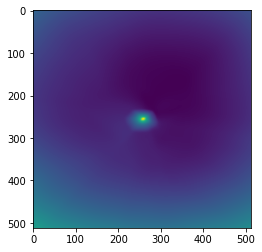

epoch 21001: 47.99658966064453
epoch 21002: 49.24467086791992
epoch 21003: 48.42371368408203
epoch 21004: 50.35226821899414
epoch 21005: 48.146697998046875
epoch 21006: 48.45029067993164
epoch 21007: 49.0237922668457
epoch 21008: 48.84273910522461
epoch 21009: 48.20750045776367
epoch 21011: 47.877750396728516
epoch 21012: 48.092864990234375
epoch 21013: 49.34648132324219
epoch 21014: 47.95770263671875
epoch 21015: 47.36838912963867
epoch 21016: 49.429656982421875
epoch 21017: 49.22407531738281
epoch 21018: 47.86293029785156
epoch 21019: 48.2609748840332
epoch 21021: 47.48884201049805
epoch 21022: 47.2189826965332
epoch 21023: 48.35989761352539
epoch 21024: 48.45528030395508
epoch 21025: 49.59404373168945
epoch 21026: 48.17138671875
epoch 21027: 48.51707458496094
epoch 21028: 48.107086181640625
epoch 21029: 48.89314270019531
epoch 21031: 48.61050033569336
epoch 21032: 48.444114685058594
epoch 21033: 48.091514587402344
epoch 21034: 48.06150436401367
epoch 21035: 49.23639678955078
epoch 2

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



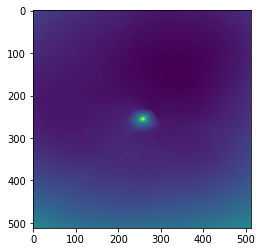

epoch 21101: 48.56333541870117
epoch 21102: 47.67021560668945
epoch 21103: 48.179725646972656
epoch 21104: 47.63249588012695
epoch 21105: 49.55703353881836
epoch 21106: 47.75999069213867
epoch 21107: 48.96084213256836
epoch 21108: 48.1231575012207
epoch 21109: 48.985782623291016
epoch 21111: 47.93443298339844
epoch 21112: 48.753997802734375
epoch 21113: 48.4041633605957
epoch 21114: 48.773948669433594
epoch 21115: 48.26129913330078
epoch 21116: 48.369171142578125
epoch 21117: 47.577335357666016
epoch 21118: 48.51284408569336
epoch 21119: 48.92809295654297
epoch 21121: 48.80815887451172
epoch 21122: 47.814613342285156
epoch 21123: 48.277469635009766
epoch 21124: 47.98414993286133
epoch 21125: 49.80186462402344
epoch 21126: 48.654170989990234
epoch 21127: 47.73617172241211
epoch 21128: 47.963783264160156
epoch 21129: 47.98807907104492
epoch 21131: 49.387939453125
epoch 21132: 47.77687454223633
epoch 21133: 49.060203552246094
epoch 21134: 50.51779556274414
epoch 21135: 48.29592514038086
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



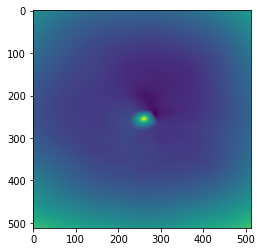

epoch 21201: 48.15952682495117
epoch 21202: 48.160404205322266
epoch 21203: 48.31304168701172
epoch 21204: 47.990875244140625
epoch 21205: 48.886775970458984
epoch 21206: 47.48270797729492
epoch 21207: 48.18907165527344
epoch 21208: 48.55574417114258
epoch 21209: 48.31082534790039
epoch 21211: 48.81895065307617
epoch 21212: 48.36528015136719
epoch 21213: 49.14976501464844
epoch 21214: 48.41191482543945
epoch 21215: 48.952003479003906
epoch 21216: 49.22105026245117
epoch 21217: 48.335121154785156
epoch 21218: 48.708736419677734
epoch 21219: 48.8873176574707
epoch 21221: 47.57130813598633
epoch 21222: 49.96718215942383
epoch 21223: 48.21079635620117
epoch 21224: 48.02360534667969
epoch 21225: 48.17741012573242
epoch 21226: 48.40627670288086
epoch 21227: 49.00995635986328
epoch 21228: 48.32964324951172
epoch 21229: 48.19340515136719
epoch 21231: 47.61310958862305
epoch 21232: 48.828269958496094
epoch 21233: 48.25116729736328
epoch 21234: 47.817115783691406
epoch 21235: 48.27898025512695
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



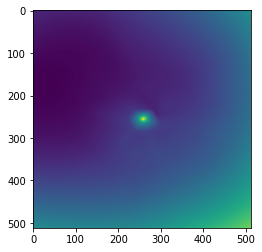

epoch 21301: 49.39999771118164
epoch 21302: 48.354286193847656
epoch 21303: 48.20793151855469
epoch 21304: 48.6634635925293
epoch 21305: 47.461769104003906
epoch 21306: 48.58356857299805
epoch 21307: 48.20541763305664
epoch 21308: 47.74763870239258
epoch 21309: 48.3892822265625
epoch 21311: 47.746978759765625
epoch 21312: 48.3543586730957
epoch 21313: 48.14949417114258
epoch 21314: 47.58720779418945
epoch 21315: 47.87799072265625
epoch 21316: 48.14434814453125
epoch 21317: 47.769187927246094
epoch 21318: 48.05171203613281
epoch 21319: 47.00825500488281
epoch 21321: 48.207542419433594
epoch 21322: 47.45890808105469
epoch 21323: 51.441959381103516
epoch 21324: 47.679386138916016
epoch 21325: 47.545841217041016
epoch 21326: 48.3245735168457
epoch 21327: 47.30664825439453
epoch 21328: 47.563236236572266
epoch 21329: 51.421756744384766
epoch 21331: 48.740840911865234
epoch 21332: 48.83671188354492
epoch 21333: 49.0905647277832
epoch 21334: 48.165531158447266
epoch 21335: 47.52393341064453
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



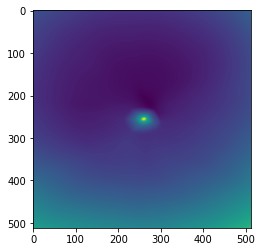

epoch 21401: 48.237850189208984
epoch 21402: 48.657901763916016
epoch 21403: 48.83567810058594
epoch 21404: 48.247859954833984
epoch 21405: 48.49985885620117
epoch 21406: 48.9614372253418
epoch 21407: 48.476959228515625
epoch 21408: 48.88005828857422
epoch 21409: 48.48667907714844
epoch 21411: 48.03471755981445
epoch 21412: 47.99627685546875
epoch 21413: 47.97060012817383
epoch 21414: 49.145240783691406
epoch 21415: 48.00615692138672
epoch 21416: 49.78301239013672
epoch 21417: 48.841712951660156
epoch 21418: 49.327491760253906
epoch 21419: 47.7078971862793
epoch 21421: 47.98456573486328
epoch 21422: 48.442832946777344
epoch 21423: 48.43427276611328
epoch 21424: 48.786376953125
epoch 21425: 49.05598068237305
epoch 21426: 49.264732360839844
epoch 21427: 50.051300048828125
epoch 21428: 48.45265579223633
epoch 21429: 47.90056610107422
epoch 21431: 47.180999755859375
epoch 21432: 47.75779342651367
epoch 21433: 47.568233489990234
epoch 21434: 49.28086853027344
epoch 21435: 47.91205978393555


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



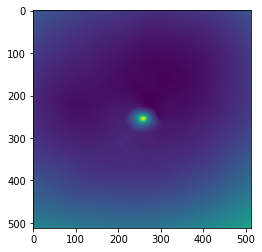

epoch 21501: 49.13778305053711
epoch 21502: 48.632667541503906
epoch 21503: 48.806365966796875
epoch 21504: 48.621978759765625
epoch 21505: 48.46262741088867
epoch 21506: 49.17641067504883
epoch 21507: 48.54655838012695
epoch 21508: 48.276206970214844
epoch 21509: 49.09737777709961
epoch 21511: 48.134098052978516
epoch 21512: 48.79808807373047
epoch 21513: 47.7372932434082
epoch 21514: 47.802215576171875
epoch 21515: 48.21245574951172
epoch 21516: 49.06010055541992
epoch 21517: 47.71742248535156
epoch 21518: 49.25400161743164
epoch 21519: 47.87052536010742
epoch 21521: 47.752281188964844
epoch 21522: 48.68075942993164
epoch 21523: 47.900230407714844
epoch 21524: 47.71527862548828
epoch 21525: 47.7407341003418
epoch 21526: 47.76565170288086
epoch 21527: 47.554203033447266
epoch 21528: 49.031959533691406
epoch 21529: 47.86035919189453
epoch 21531: 48.253170013427734
epoch 21532: 48.34351348876953
epoch 21533: 48.500118255615234
epoch 21534: 48.56192398071289
epoch 21535: 48.6884727478027

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



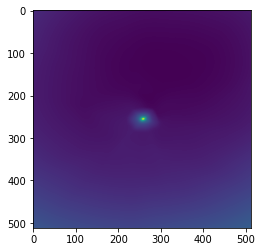

epoch 21601: 48.472537994384766
epoch 21602: 47.52462387084961
epoch 21603: 51.5154914855957
epoch 21604: 47.83017349243164
epoch 21605: 56.1203727722168
epoch 21606: 52.0826530456543
epoch 21607: 51.05514144897461
epoch 21608: 50.36954116821289
epoch 21609: 50.822113037109375
epoch 21611: 50.223304748535156
epoch 21612: 49.4888916015625
epoch 21613: 49.144649505615234
epoch 21614: 49.08839416503906
epoch 21615: 48.44021224975586
epoch 21616: 48.785423278808594
epoch 21617: 49.9360466003418
epoch 21618: 49.10772705078125
epoch 21619: 48.778621673583984
epoch 21621: 48.93210220336914
epoch 21622: 49.69355392456055
epoch 21623: 48.64029312133789
epoch 21624: 48.67687225341797
epoch 21625: 48.5169677734375
epoch 21626: 48.681190490722656
epoch 21627: 49.18425369262695
epoch 21628: 48.741390228271484
epoch 21629: 48.55171585083008
epoch 21631: 48.19398498535156
epoch 21632: 48.225738525390625
epoch 21633: 47.641563415527344
epoch 21634: 48.6425666809082
epoch 21635: 48.35566711425781
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



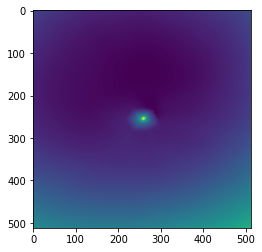

epoch 21701: 48.586082458496094
epoch 21702: 48.37849807739258
epoch 21703: 48.66769027709961
epoch 21704: 48.79893493652344
epoch 21705: 48.42942428588867
epoch 21706: 48.53419494628906
epoch 21707: 47.97019577026367
epoch 21708: 47.76831817626953
epoch 21709: 47.56703567504883
epoch 21711: 48.45503234863281
epoch 21712: 47.34329605102539
epoch 21713: 48.99209976196289
epoch 21714: 49.08100128173828
epoch 21715: 48.132930755615234
epoch 21716: 48.31825637817383
epoch 21717: 47.640323638916016
epoch 21718: 48.3300895690918
epoch 21719: 48.158119201660156
epoch 21721: 49.333656311035156
epoch 21722: 47.71754837036133
epoch 21723: 47.95836639404297
epoch 21724: 49.2966194152832
epoch 21725: 48.58577346801758
epoch 21726: 50.57734680175781
epoch 21727: 48.46327209472656
epoch 21728: 48.48986053466797
epoch 21729: 48.75139617919922
epoch 21731: 47.68926239013672
epoch 21732: 48.441776275634766
epoch 21733: 48.32764434814453
epoch 21734: 50.381874084472656
epoch 21735: 47.702545166015625
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



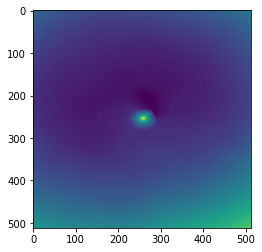

epoch 21801: 48.23188781738281
epoch 21802: 49.08994674682617
epoch 21803: 48.14362716674805
epoch 21804: 48.1416015625
epoch 21805: 51.867740631103516
epoch 21806: 49.065311431884766
epoch 21807: 47.996551513671875
epoch 21808: 48.09403991699219
epoch 21809: 48.925010681152344
epoch 21811: 48.258506774902344
epoch 21812: 48.3413200378418
epoch 21813: 48.57746887207031
epoch 21814: 48.673004150390625
epoch 21815: 48.295963287353516
epoch 21816: 49.31727981567383
epoch 21817: 47.9820442199707
epoch 21818: 47.93148422241211
epoch 21819: 48.454734802246094
epoch 21821: 47.558082580566406
epoch 21822: 49.49433517456055
epoch 21823: 49.107242584228516
epoch 21824: 48.546382904052734
epoch 21825: 48.47213363647461
epoch 21826: 49.4449348449707
epoch 21827: 49.218017578125
epoch 21828: 48.03870391845703
epoch 21829: 47.41157150268555
epoch 21831: 47.95649337768555
epoch 21832: 48.585689544677734
epoch 21833: 47.61296844482422
epoch 21834: 49.29745864868164
epoch 21835: 48.062442779541016
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



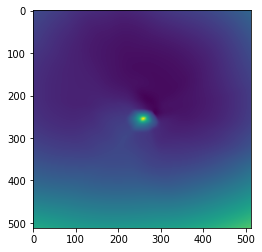

epoch 21901: 47.8032112121582
epoch 21902: 47.60691452026367
epoch 21903: 48.48131561279297
epoch 21904: 48.506813049316406
epoch 21905: 48.9020881652832
epoch 21906: 48.683353424072266
epoch 21907: 48.2935905456543
epoch 21908: 48.98261260986328
epoch 21909: 48.54761505126953
epoch 21911: 48.56187438964844
epoch 21912: 47.58183288574219
epoch 21913: 48.53430938720703
epoch 21914: 48.42288589477539
epoch 21915: 48.453147888183594
epoch 21916: 47.52132797241211
epoch 21917: 48.805965423583984
epoch 21918: 48.08128356933594
epoch 21919: 48.814476013183594
epoch 21921: 48.764190673828125
epoch 21922: 48.46221923828125
epoch 21923: 48.65276336669922
epoch 21924: 48.6225700378418
epoch 21925: 47.85127639770508
epoch 21926: 49.7267951965332
epoch 21927: 48.97860336303711
epoch 21928: 48.61175537109375
epoch 21929: 48.11362075805664
epoch 21931: 48.002410888671875
epoch 21932: 48.162540435791016
epoch 21933: 48.308998107910156
epoch 21934: 48.21986770629883
epoch 21935: 49.78076934814453
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



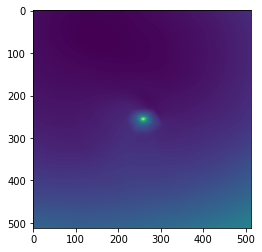

epoch 22001: 48.141357421875
epoch 22002: 48.363094329833984
epoch 22003: 48.01165771484375
epoch 22004: 48.933021545410156
epoch 22005: 48.490318298339844
epoch 22006: 48.5615348815918
epoch 22007: 48.3685188293457
epoch 22008: 47.81523513793945
epoch 22009: 48.39921951293945
epoch 22011: 48.98405838012695
epoch 22012: 48.4427490234375
epoch 22013: 48.66923141479492
epoch 22014: 48.391204833984375
epoch 22015: 49.193023681640625
epoch 22016: 49.00453186035156
epoch 22017: 48.82133483886719
epoch 22018: 47.72414016723633
epoch 22019: 48.4315299987793
epoch 22021: 48.6547737121582
epoch 22022: 49.811180114746094
epoch 22023: 49.54621124267578
epoch 22024: 48.41830825805664
epoch 22025: 48.19824981689453
epoch 22026: 49.05140686035156
epoch 22027: 47.19341278076172
epoch 22028: 48.30557632446289
epoch 22029: 48.656410217285156
epoch 22031: 48.00102233886719
epoch 22032: 47.92798614501953
epoch 22033: 47.94054412841797
epoch 22034: 47.927791595458984
epoch 22035: 48.75707244873047
epoch 2

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



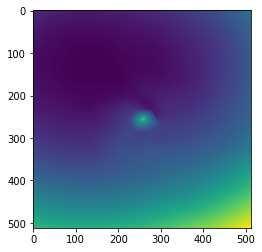

epoch 22101: 48.753448486328125
epoch 22102: 49.89826965332031
epoch 22103: 49.3570442199707
epoch 22104: 50.61081314086914
epoch 22105: 49.35929870605469
epoch 22106: 47.20903778076172
epoch 22107: 48.29397201538086
epoch 22108: 47.62255859375
epoch 22109: 47.713375091552734
epoch 22111: 48.029388427734375
epoch 22112: 48.45248794555664
epoch 22113: 47.769657135009766
epoch 22114: 48.30971145629883
epoch 22115: 48.38722229003906
epoch 22116: 47.740543365478516
epoch 22117: 47.78642654418945
epoch 22118: 47.794612884521484
epoch 22119: 47.6175537109375
epoch 22121: 48.40309143066406
epoch 22122: 48.828529357910156
epoch 22123: 48.60936737060547
epoch 22124: 48.545799255371094
epoch 22125: 47.89964294433594
epoch 22126: 47.40853500366211
epoch 22127: 49.033836364746094
epoch 22128: 48.1806640625
epoch 22129: 47.76608657836914
epoch 22131: 49.1218376159668
epoch 22132: 48.32145690917969
epoch 22133: 48.841068267822266
epoch 22134: 47.370670318603516
epoch 22135: 47.9710578918457
epoch 22

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



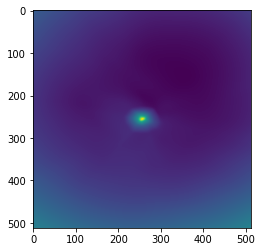

epoch 22201: 47.95048522949219
epoch 22202: 48.16740036010742
epoch 22203: 49.311195373535156
epoch 22204: 48.51579666137695
epoch 22205: 48.679420471191406
epoch 22206: 49.3172607421875
epoch 22207: 48.2664909362793
epoch 22208: 47.85717010498047
epoch 22209: 47.876564025878906
epoch 22211: 50.520118713378906
epoch 22212: 49.21112060546875
epoch 22213: 47.739463806152344
epoch 22214: 48.72929382324219
epoch 22215: 48.57028579711914
epoch 22216: 48.2773551940918
epoch 22217: 48.58232879638672
epoch 22218: 48.0129280090332
epoch 22219: 48.45096969604492
epoch 22221: 50.97918701171875
epoch 22222: 48.864234924316406
epoch 22223: 47.354339599609375
epoch 22224: 48.28870391845703
epoch 22225: 48.21489334106445
epoch 22226: 48.90134811401367
epoch 22227: 49.099769592285156
epoch 22228: 48.149436950683594
epoch 22229: 48.50050354003906
epoch 22231: 47.841468811035156
epoch 22232: 48.79376220703125
epoch 22233: 50.02962875366211
epoch 22234: 48.186363220214844
epoch 22235: 48.90989685058594
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



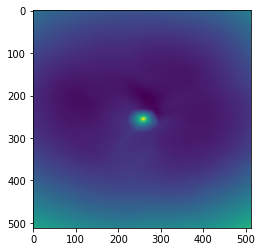

epoch 22301: 47.61701965332031
epoch 22302: 48.08089065551758
epoch 22303: 48.0566291809082
epoch 22304: 49.53327178955078
epoch 22305: 48.77883529663086
epoch 22306: 48.2780876159668
epoch 22307: 48.717464447021484
epoch 22308: 48.07773971557617
epoch 22309: 48.720458984375
epoch 22311: 48.73499298095703
epoch 22312: 48.24309158325195
epoch 22313: 48.061222076416016
epoch 22314: 48.40538787841797
epoch 22315: 49.035545349121094
epoch 22316: 49.56476974487305
epoch 22317: 49.004051208496094
epoch 22318: 48.5136604309082
epoch 22319: 52.498722076416016
epoch 22321: 49.281620025634766
epoch 22322: 48.982566833496094
epoch 22323: 47.62651443481445
epoch 22324: 48.900787353515625
epoch 22325: 49.40143966674805
epoch 22326: 48.564247131347656
epoch 22327: 49.58393859863281
epoch 22328: 49.889320373535156
epoch 22329: 48.894405364990234
epoch 22331: 49.2738151550293
epoch 22332: 48.96062469482422
epoch 22333: 49.3300666809082
epoch 22334: 48.84265899658203
epoch 22335: 48.700382232666016
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



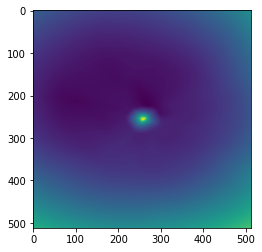

epoch 22401: 48.9039421081543
epoch 22402: 48.87665939331055
epoch 22403: 48.18645477294922
epoch 22404: 48.61806106567383
epoch 22405: 50.330928802490234
epoch 22406: 48.32366943359375
epoch 22407: 48.300479888916016
epoch 22408: 47.93628692626953
epoch 22409: 48.613277435302734
epoch 22411: 48.585636138916016
epoch 22412: 48.4822998046875
epoch 22413: 49.37799835205078
epoch 22414: 48.99566650390625
epoch 22415: 48.6191520690918
epoch 22416: 48.61103820800781
epoch 22417: 48.19704055786133
epoch 22418: 48.47999954223633
epoch 22419: 48.34929656982422
epoch 22421: 48.52389907836914
epoch 22422: 48.33613204956055
epoch 22423: 48.918670654296875
epoch 22424: 48.33559036254883
epoch 22425: 48.21891784667969
epoch 22426: 48.12612533569336
epoch 22427: 48.585975646972656
epoch 22428: 48.09306335449219
epoch 22429: 49.02375793457031
epoch 22431: 48.26374816894531
epoch 22432: 48.56151580810547
epoch 22433: 48.64710998535156
epoch 22434: 48.67577362060547
epoch 22435: 47.99350357055664
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



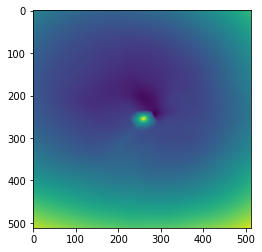

epoch 22501: 48.049949645996094
epoch 22502: 47.5255012512207
epoch 22503: 47.757083892822266
epoch 22504: 48.31874465942383
epoch 22505: 48.91363525390625
epoch 22506: 47.69935989379883
epoch 22507: 48.784332275390625
epoch 22508: 48.20655059814453
epoch 22509: 48.704315185546875
epoch 22511: 47.84624099731445
epoch 22512: 48.7096061706543
epoch 22513: 48.36385726928711
epoch 22514: 48.22028350830078
epoch 22515: 49.35297393798828
epoch 22516: 48.50504684448242
epoch 22517: 47.8188591003418
epoch 22518: 49.0709228515625
epoch 22519: 48.39408493041992
epoch 22521: 47.56047821044922
epoch 22522: 48.35945510864258
epoch 22523: 47.775936126708984
epoch 22524: 48.049381256103516
epoch 22525: 48.15724182128906
epoch 22526: 49.2781867980957
epoch 22527: 48.433937072753906
epoch 22528: 47.712074279785156
epoch 22529: 47.402915954589844
epoch 22531: 48.3259391784668
epoch 22532: 48.87229537963867
epoch 22533: 49.116268157958984
epoch 22534: 48.003990173339844
epoch 22535: 48.67414474487305
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



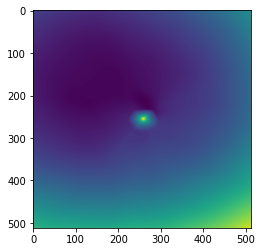

epoch 22601: 47.835594177246094
epoch 22602: 47.573673248291016
epoch 22603: 48.59502410888672
epoch 22604: 47.704132080078125
epoch 22605: 48.802940368652344
epoch 22606: 49.2166862487793
epoch 22607: 47.66865158081055
epoch 22608: 47.45048904418945
epoch 22609: 48.02635192871094
epoch 22611: 48.46712875366211
epoch 22612: 50.45234298706055
epoch 22613: 48.21118927001953
epoch 22614: 49.10961151123047
epoch 22615: 48.551395416259766
epoch 22616: 50.32273864746094
epoch 22617: 48.93734359741211
epoch 22618: 49.715797424316406
epoch 22619: 47.845706939697266
epoch 22621: 48.21934509277344
epoch 22622: 47.71782684326172
epoch 22623: 49.180458068847656
epoch 22624: 48.34420394897461
epoch 22625: 47.41794204711914
epoch 22626: 48.66557693481445
epoch 22627: 49.426734924316406
epoch 22628: 48.40237045288086
epoch 22629: 49.006797790527344
epoch 22631: 49.179237365722656
epoch 22632: 48.69102478027344
epoch 22633: 48.39936828613281
epoch 22634: 49.39643096923828
epoch 22635: 48.4658927917480

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



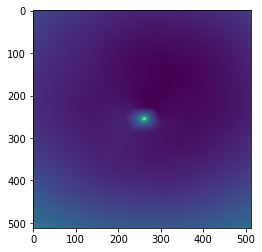

epoch 22701: 48.6186637878418
epoch 22702: 48.403236389160156
epoch 22703: 48.69953918457031
epoch 22704: 48.25704574584961
epoch 22705: 48.88079833984375
epoch 22706: 48.40715408325195
epoch 22707: 48.7998161315918
epoch 22708: 48.59064865112305
epoch 22709: 49.077598571777344
epoch 22711: 48.973411560058594
epoch 22712: 48.19088363647461
epoch 22713: 50.95026779174805
epoch 22714: 48.07942199707031
epoch 22715: 48.08893966674805
epoch 22716: 48.421043395996094
epoch 22717: 48.17585372924805
epoch 22718: 49.19218063354492
epoch 22719: 47.21877670288086
epoch 22721: 48.332923889160156
epoch 22722: 48.16176223754883
epoch 22723: 49.409446716308594
epoch 22724: 48.512298583984375
epoch 22725: 48.69927978515625
epoch 22726: 48.26218795776367
epoch 22727: 48.19548797607422
epoch 22728: 47.67314529418945
epoch 22729: 48.1328010559082
epoch 22731: 48.83639907836914
epoch 22732: 48.545955657958984
epoch 22733: 47.872501373291016
epoch 22734: 48.71108627319336
epoch 22735: 48.885276794433594
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



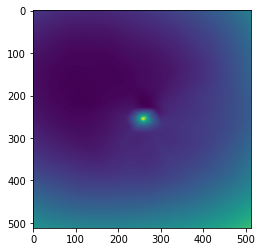

epoch 22801: 49.55531311035156
epoch 22802: 48.93975067138672
epoch 22803: 48.453224182128906
epoch 22804: 47.85858917236328
epoch 22805: 48.757083892822266
epoch 22806: 48.10932922363281
epoch 22807: 48.91661834716797
epoch 22808: 48.543418884277344
epoch 22809: 48.18646240234375
epoch 22811: 48.53520965576172
epoch 22812: 49.512638092041016
epoch 22813: 49.82728576660156
epoch 22814: 49.0039176940918
epoch 22815: 49.93457794189453
epoch 22816: 49.14167785644531
epoch 22817: 48.57817077636719
epoch 22818: 48.22038269042969
epoch 22819: 48.522701263427734
epoch 22821: 49.02006912231445
epoch 22822: 49.06299591064453
epoch 22823: 49.20216369628906
epoch 22824: 49.10553741455078
epoch 22825: 48.194618225097656
epoch 22826: 49.914817810058594
epoch 22827: 48.52910614013672
epoch 22828: 49.26395034790039
epoch 22829: 48.59402084350586
epoch 22831: 49.51929473876953
epoch 22832: 48.11450958251953
epoch 22833: 48.75419616699219
epoch 22834: 47.70451736450195
epoch 22835: 48.481712341308594
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



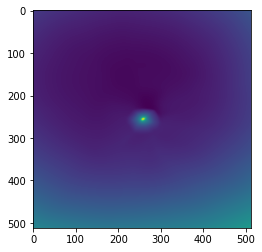

epoch 22901: 47.900611877441406
epoch 22902: 49.33586120605469
epoch 22903: 47.99757385253906
epoch 22904: 49.534088134765625
epoch 22905: 48.41011428833008
epoch 22906: 48.40420150756836
epoch 22907: 47.76551818847656
epoch 22908: 47.94170379638672
epoch 22909: 48.93449783325195
epoch 22911: 48.71589279174805
epoch 22912: 48.77976608276367
epoch 22913: 47.936065673828125
epoch 22914: 47.81223678588867
epoch 22915: 49.803184509277344
epoch 22916: 48.19781494140625
epoch 22917: 48.951351165771484
epoch 22918: 48.86552047729492
epoch 22919: 48.75853729248047
epoch 22921: 50.20362854003906
epoch 22922: 47.61774444580078
epoch 22923: 49.35416793823242
epoch 22924: 48.44749069213867
epoch 22925: 49.250144958496094
epoch 22926: 48.50797653198242
epoch 22927: 47.85710906982422
epoch 22928: 48.30134201049805
epoch 22929: 48.77439498901367
epoch 22931: 48.27336120605469
epoch 22932: 48.00049591064453
epoch 22933: 49.22266387939453
epoch 22934: 48.041595458984375
epoch 22935: 47.737796783447266


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



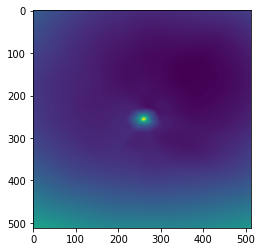

epoch 23001: 48.097496032714844
epoch 23002: 48.74971389770508
epoch 23003: 48.24711990356445
epoch 23004: 48.79429244995117
epoch 23005: 48.69031524658203
epoch 23006: 48.604095458984375
epoch 23007: 48.53260040283203
epoch 23008: 48.650115966796875
epoch 23009: 48.325138092041016
epoch 23011: 47.755279541015625
epoch 23012: 48.3753776550293
epoch 23013: 47.908023834228516
epoch 23014: 48.5568962097168
epoch 23015: 48.26905822753906
epoch 23016: 48.43849563598633
epoch 23017: 47.98781967163086
epoch 23018: 48.180938720703125
epoch 23019: 47.99979782104492
epoch 23021: 47.61983108520508
epoch 23022: 47.826576232910156
epoch 23023: 47.53629684448242
epoch 23024: 48.46186828613281
epoch 23025: 48.11670684814453
epoch 23026: 48.5423583984375
epoch 23027: 47.91011428833008
epoch 23028: 47.47500991821289
epoch 23029: 48.27959442138672
epoch 23031: 48.227176666259766
epoch 23032: 48.1644287109375
epoch 23033: 48.26450729370117
epoch 23034: 48.17129135131836
epoch 23035: 47.72648239135742
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



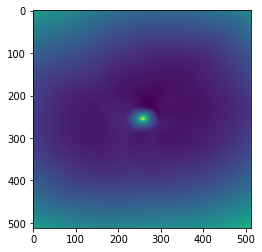

epoch 23101: 51.82241439819336
epoch 23102: 47.69535446166992
epoch 23103: 48.234710693359375
epoch 23104: 48.461124420166016
epoch 23105: 48.751590728759766
epoch 23106: 48.73117446899414
epoch 23107: 48.89338684082031
epoch 23108: 49.30141830444336
epoch 23109: 49.69793701171875
epoch 23111: 48.085235595703125
epoch 23112: 49.05343246459961
epoch 23113: 49.641754150390625
epoch 23114: 50.154300689697266
epoch 23115: 49.214969635009766
epoch 23116: 49.66061019897461
epoch 23117: 48.03791809082031
epoch 23118: 49.3251838684082
epoch 23119: 48.17485809326172
epoch 23121: 48.383052825927734
epoch 23122: 48.92904281616211
epoch 23123: 49.04739761352539
epoch 23124: 48.78179168701172
epoch 23125: 48.030399322509766
epoch 23126: 48.95140838623047
epoch 23127: 48.731483459472656
epoch 23128: 48.851619720458984
epoch 23129: 48.25111770629883
epoch 23131: 49.44095230102539
epoch 23132: 48.73834228515625
epoch 23133: 48.37755584716797
epoch 23134: 48.550724029541016
epoch 23135: 48.463439941406

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



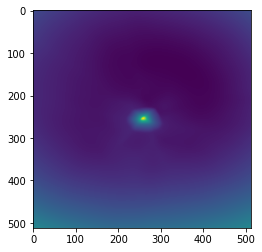

epoch 23201: 48.171905517578125
epoch 23202: 48.9941520690918
epoch 23203: 48.636131286621094
epoch 23204: 48.92731475830078
epoch 23205: 47.71255874633789
epoch 23206: 47.8597526550293
epoch 23207: 48.63638687133789
epoch 23208: 47.70403289794922
epoch 23209: 48.85276794433594
epoch 23211: 48.713165283203125
epoch 23212: 47.717308044433594
epoch 23213: 48.47919464111328
epoch 23214: 48.27532196044922
epoch 23215: 47.74094009399414
epoch 23216: 48.357025146484375
epoch 23217: 48.71259307861328
epoch 23218: 48.45709228515625
epoch 23219: 47.49095916748047
epoch 23221: 47.58963394165039
epoch 23222: 49.327308654785156
epoch 23223: 48.10700988769531
epoch 23224: 48.85881042480469
epoch 23225: 47.59267807006836
epoch 23226: 51.588836669921875
epoch 23227: 48.32353591918945
epoch 23228: 48.67181396484375
epoch 23229: 48.319393157958984
epoch 23231: 48.371856689453125
epoch 23232: 49.80375671386719
epoch 23233: 47.96542739868164
epoch 23234: 49.21180725097656
epoch 23235: 48.1160888671875
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



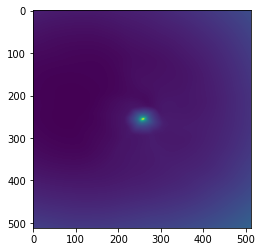

epoch 23301: 49.15396499633789
epoch 23302: 48.045936584472656
epoch 23303: 48.22136688232422
epoch 23304: 49.028961181640625
epoch 23305: 48.91754913330078
epoch 23306: 48.651485443115234
epoch 23307: 47.753562927246094
epoch 23308: 48.05796432495117
epoch 23309: 54.92531967163086
epoch 23311: 50.36793518066406
epoch 23312: 48.43986129760742
epoch 23313: 48.95078659057617
epoch 23314: 48.500728607177734
epoch 23315: 48.310386657714844
epoch 23316: 47.827510833740234
epoch 23317: 48.97312927246094
epoch 23318: 48.63832473754883
epoch 23319: 48.43769836425781
epoch 23321: 47.59129333496094
epoch 23322: 48.41062927246094
epoch 23323: 48.92939758300781
epoch 23324: 48.176151275634766
epoch 23325: 48.43313217163086
epoch 23326: 49.28489685058594
epoch 23327: 48.053016662597656
epoch 23328: 49.6007194519043
epoch 23329: 49.85108184814453
epoch 23331: 48.33073043823242
epoch 23332: 47.42882537841797
epoch 23333: 48.6773681640625
epoch 23334: 48.449214935302734
epoch 23335: 48.37328338623047


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



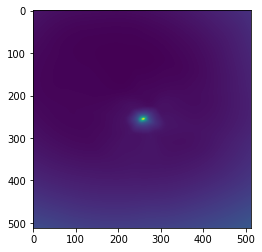

epoch 23401: 49.00136184692383
epoch 23402: 48.775177001953125
epoch 23403: 48.438995361328125
epoch 23404: 48.19584655761719
epoch 23405: 48.87128448486328
epoch 23406: 47.811946868896484
epoch 23407: 48.376434326171875
epoch 23408: 47.72610092163086
epoch 23409: 49.41156768798828
epoch 23411: 48.667694091796875
epoch 23412: 48.54924011230469
epoch 23413: 48.241172790527344
epoch 23414: 48.76153564453125
epoch 23415: 48.66140365600586
epoch 23416: 48.04317855834961
epoch 23417: 47.83860778808594
epoch 23418: 48.25151824951172
epoch 23419: 51.63475036621094
epoch 23421: 47.90835189819336
epoch 23422: 48.69872283935547
epoch 23423: 48.782894134521484
epoch 23424: 47.78516387939453
epoch 23425: 48.896392822265625
epoch 23426: 48.38468933105469
epoch 23427: 48.050384521484375
epoch 23428: 49.13096618652344
epoch 23429: 50.32298278808594
epoch 23431: 48.21162414550781
epoch 23432: 47.80924987792969
epoch 23433: 48.12380599975586
epoch 23434: 48.201499938964844
epoch 23435: 49.2154617309570

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



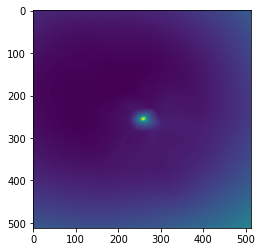

epoch 23501: 48.94279861450195
epoch 23502: 48.383262634277344
epoch 23503: 49.08367919921875
epoch 23504: 48.610599517822266
epoch 23505: 47.77421951293945
epoch 23506: 48.32353591918945
epoch 23507: 48.67784118652344
epoch 23508: 48.50032043457031
epoch 23509: 48.17800521850586
epoch 23511: 48.305992126464844
epoch 23512: 49.25041580200195
epoch 23513: 47.55601501464844
epoch 23514: 48.25168991088867
epoch 23515: 48.516414642333984
epoch 23516: 48.661293029785156
epoch 23517: 48.27900314331055
epoch 23518: 48.62614440917969
epoch 23519: 48.011444091796875
epoch 23521: 47.78962707519531
epoch 23522: 48.26952362060547
epoch 23523: 47.68422317504883
epoch 23524: 49.2376708984375
epoch 23525: 48.70624923706055
epoch 23526: 48.46171569824219
epoch 23527: 48.0739631652832
epoch 23528: 48.9169921875
epoch 23529: 48.476600646972656
epoch 23531: 48.37522506713867
epoch 23532: 48.62934112548828
epoch 23533: 48.07363510131836
epoch 23534: 48.90126037597656
epoch 23535: 47.80502700805664
epoch 2

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



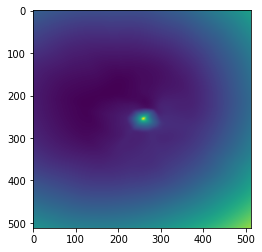

epoch 23601: 48.238338470458984
epoch 23602: 48.305419921875
epoch 23603: 48.44233322143555
epoch 23604: 48.31555938720703
epoch 23605: 49.060970306396484
epoch 23606: 48.03818130493164
epoch 23607: 48.47612380981445
epoch 23608: 49.669158935546875
epoch 23609: 48.56529998779297
epoch 23611: 48.15813064575195
epoch 23612: 48.06824493408203
epoch 23613: 47.87715148925781
epoch 23614: 49.785770416259766
epoch 23615: 47.78142547607422
epoch 23616: 50.50426483154297
epoch 23617: 48.355308532714844
epoch 23618: 49.9201774597168
epoch 23619: 48.266136169433594
epoch 23621: 48.80277633666992
epoch 23622: 49.0249137878418
epoch 23623: 47.99360275268555
epoch 23624: 49.76955032348633
epoch 23625: 48.29982376098633
epoch 23626: 48.05641174316406
epoch 23627: 47.62136459350586
epoch 23628: 48.689247131347656
epoch 23629: 48.486019134521484
epoch 23631: 48.3758430480957
epoch 23632: 49.80289077758789
epoch 23633: 48.029964447021484
epoch 23634: 48.56855010986328
epoch 23635: 48.240413665771484
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



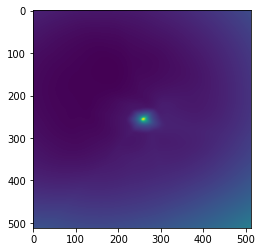

epoch 23701: 48.394901275634766
epoch 23702: 48.9201545715332
epoch 23703: 48.67409896850586
epoch 23704: 48.483299255371094
epoch 23705: 48.345401763916016
epoch 23706: 47.82804870605469
epoch 23707: 47.454830169677734
epoch 23708: 48.34223937988281
epoch 23709: 47.415687561035156
epoch 23711: 48.46220397949219
epoch 23712: 48.433013916015625
epoch 23713: 48.62765121459961
epoch 23714: 48.10850524902344
epoch 23715: 47.66319274902344
epoch 23716: 48.712013244628906
epoch 23717: 47.75761795043945
epoch 23718: 48.19155502319336
epoch 23719: 48.5245361328125
epoch 23721: 48.66538619995117
epoch 23722: 48.273555755615234
epoch 23723: 50.24821853637695
epoch 23724: 50.56053924560547
epoch 23725: 48.69136428833008
epoch 23726: 48.21520233154297
epoch 23727: 48.449256896972656
epoch 23728: 47.690269470214844
epoch 23729: 48.09034729003906
epoch 23731: 48.24074172973633
epoch 23732: 48.62107467651367
epoch 23733: 48.47624588012695
epoch 23734: 48.16702651977539
epoch 23735: 48.22280502319336


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



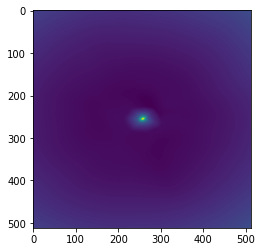

epoch 23801: 49.07652282714844
epoch 23802: 48.835758209228516
epoch 23803: 48.43648147583008
epoch 23804: 49.97231674194336
epoch 23805: 50.491668701171875
epoch 23806: 48.52122497558594
epoch 23807: 48.75935745239258
epoch 23808: 48.86371994018555
epoch 23809: 48.433074951171875
epoch 23811: 49.93368148803711
epoch 23812: 49.27898025512695
epoch 23813: 48.7118034362793
epoch 23814: 48.645263671875
epoch 23815: 49.202842712402344
epoch 23816: 48.746124267578125
epoch 23817: 48.43736267089844
epoch 23818: 49.042972564697266
epoch 23819: 48.17515563964844
epoch 23821: 48.550846099853516
epoch 23822: 49.220359802246094
epoch 23823: 48.53437805175781
epoch 23824: 48.405147552490234
epoch 23825: 48.68683624267578
epoch 23826: 48.01716232299805
epoch 23827: 47.607601165771484
epoch 23828: 48.896568298339844
epoch 23829: 48.51481246948242
epoch 23831: 48.86897659301758
epoch 23832: 48.598228454589844
epoch 23833: 47.89208984375
epoch 23834: 48.59370803833008
epoch 23835: 48.49374771118164
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



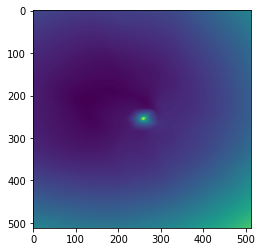

epoch 23901: 48.2620964050293
epoch 23902: 48.0833740234375
epoch 23903: 50.63817596435547
epoch 23904: 48.52557373046875
epoch 23905: 48.21199417114258
epoch 23906: 48.10213851928711
epoch 23907: 48.08513641357422
epoch 23908: 50.30377960205078
epoch 23909: 48.25831604003906
epoch 23911: 47.5190315246582
epoch 23912: 48.90436553955078
epoch 23913: 47.96529769897461
epoch 23914: 48.31874465942383
epoch 23915: 49.53772735595703
epoch 23916: 48.32278060913086
epoch 23917: 48.79750061035156
epoch 23918: 48.06932067871094
epoch 23919: 47.80083084106445
epoch 23921: 48.22496032714844
epoch 23922: 47.81365966796875
epoch 23923: 48.259490966796875
epoch 23924: 48.55598068237305
epoch 23925: 47.34676742553711
epoch 23926: 49.28481674194336
epoch 23927: 48.24498748779297
epoch 23928: 49.03470993041992
epoch 23929: 48.74751663208008
epoch 23931: 49.247806549072266
epoch 23932: 47.95213317871094
epoch 23933: 48.418758392333984
epoch 23934: 47.88064956665039
epoch 23935: 48.04862976074219
epoch 23

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



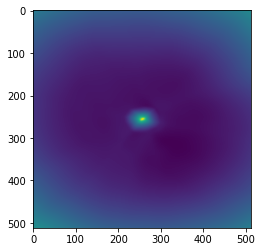

epoch 24001: 49.457698822021484
epoch 24002: 48.21056365966797
epoch 24003: 48.54690933227539
epoch 24004: 48.02029800415039
epoch 24005: 47.87525177001953
epoch 24006: 49.18745040893555
epoch 24007: 49.323570251464844
epoch 24008: 48.68595886230469
epoch 24009: 49.09556579589844
epoch 24011: 49.80730438232422
epoch 24012: 49.26441955566406
epoch 24013: 48.77553176879883
epoch 24014: 48.806358337402344
epoch 24015: 48.330955505371094
epoch 24016: 48.100990295410156
epoch 24017: 48.60124588012695
epoch 24018: 47.49292755126953
epoch 24019: 48.79243087768555
epoch 24021: 48.63019943237305
epoch 24022: 48.663028717041016
epoch 24023: 47.84058380126953
epoch 24024: 47.767608642578125
epoch 24025: 48.94721221923828
epoch 24026: 48.385169982910156
epoch 24027: 48.83414077758789
epoch 24028: 48.46237564086914
epoch 24029: 50.471710205078125
epoch 24031: 48.20403289794922
epoch 24032: 47.94065475463867
epoch 24033: 48.61721420288086
epoch 24034: 49.48167037963867
epoch 24035: 48.14554595947265

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



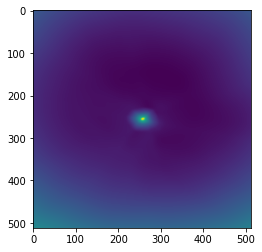

epoch 24101: 48.69173812866211
epoch 24102: 48.067413330078125
epoch 24103: 49.74241256713867
epoch 24104: 49.347869873046875
epoch 24105: 48.00635528564453
epoch 24106: 49.673465728759766
epoch 24107: 48.50333023071289
epoch 24108: 48.12638473510742
epoch 24109: 47.42942428588867
epoch 24111: 48.827091217041016
epoch 24112: 47.745723724365234
epoch 24113: 48.34772872924805
epoch 24114: 48.52494430541992
epoch 24115: 48.24595642089844
epoch 24116: 48.65926742553711
epoch 24117: 48.69947052001953
epoch 24118: 48.54648208618164
epoch 24119: 48.29589080810547
epoch 24121: 47.8333625793457
epoch 24122: 48.274200439453125
epoch 24123: 47.97056198120117
epoch 24124: 48.43034362792969
epoch 24125: 48.02433776855469
epoch 24126: 48.86872482299805
epoch 24127: 49.190399169921875
epoch 24128: 47.93345260620117
epoch 24129: 48.28827667236328
epoch 24131: 48.138160705566406
epoch 24132: 48.62500762939453
epoch 24133: 48.4747314453125
epoch 24134: 47.56644821166992
epoch 24135: 48.004005432128906
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



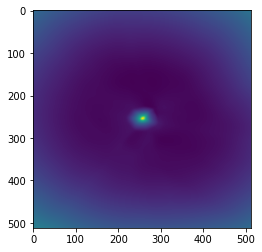

epoch 24201: 49.23775100708008
epoch 24202: 48.632999420166016
epoch 24203: 48.34610366821289
epoch 24204: 48.711387634277344
epoch 24205: 47.19015884399414
epoch 24206: 48.23847579956055
epoch 24207: 49.18916320800781
epoch 24208: 48.069705963134766
epoch 24209: 48.31017303466797
epoch 24211: 48.369564056396484
epoch 24212: 48.807212829589844
epoch 24213: 48.37483596801758
epoch 24214: 48.21318054199219
epoch 24215: 48.386940002441406
epoch 24216: 54.832618713378906
epoch 24217: 48.8218879699707
epoch 24218: 48.63981246948242
epoch 24219: 47.83834457397461
epoch 24221: 48.91891860961914
epoch 24222: 48.5130500793457
epoch 24223: 47.83681106567383
epoch 24224: 48.659400939941406
epoch 24225: 48.308380126953125
epoch 24226: 48.56165313720703
epoch 24227: 48.0783576965332
epoch 24228: 48.1966667175293
epoch 24229: 48.35432434082031
epoch 24231: 48.347801208496094
epoch 24232: 48.5001335144043
epoch 24233: 47.67893600463867
epoch 24234: 50.82966995239258
epoch 24235: 48.39997100830078
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



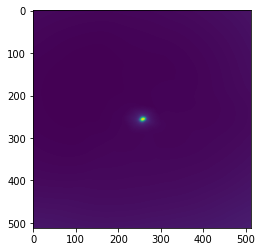

epoch 24301: 48.245262145996094
epoch 24302: 48.6110725402832
epoch 24303: 48.06133270263672
epoch 24304: 48.04493713378906
epoch 24305: 48.388389587402344
epoch 24306: 50.160118103027344
epoch 24307: 48.6927604675293
epoch 24308: 48.72488784790039
epoch 24309: 48.90129470825195
epoch 24311: 49.22916793823242
epoch 24312: 49.726654052734375
epoch 24313: 49.38986587524414
epoch 24314: 49.47228240966797
epoch 24315: 49.528160095214844
epoch 24316: 50.66131591796875
epoch 24317: 48.92305374145508
epoch 24318: 50.74943161010742
epoch 24319: 48.90751647949219
epoch 24321: 49.19000244140625
epoch 24322: 49.44187545776367
epoch 24323: 49.85680389404297
epoch 24324: 49.562564849853516
epoch 24325: 49.33506774902344
epoch 24326: 48.93428039550781
epoch 24327: 47.89449691772461
epoch 24328: 49.15799331665039
epoch 24329: 48.64077377319336
epoch 24331: 48.812522888183594
epoch 24332: 49.52332305908203
epoch 24333: 48.801116943359375
epoch 24334: 48.45087432861328
epoch 24335: 48.84098434448242
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



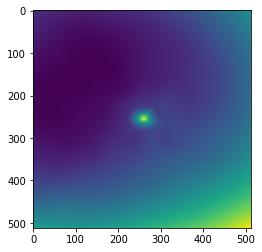

epoch 24401: 48.675384521484375
epoch 24402: 48.82795715332031
epoch 24403: 48.546661376953125
epoch 24404: 48.3677864074707
epoch 24405: 48.01795959472656
epoch 24406: 48.14069747924805
epoch 24407: 47.94799041748047
epoch 24408: 47.552310943603516
epoch 24409: 47.93362808227539
epoch 24411: 49.54368209838867
epoch 24412: 48.18826675415039
epoch 24413: 49.66200637817383
epoch 24414: 47.848167419433594
epoch 24415: 48.460479736328125
epoch 24416: 47.76109313964844
epoch 24417: 47.908103942871094
epoch 24418: 47.87816619873047
epoch 24419: 48.138763427734375
epoch 24421: 47.97673416137695
epoch 24422: 48.0423469543457
epoch 24423: 47.97241973876953
epoch 24424: 48.83192825317383
epoch 24425: 49.05792999267578
epoch 24426: 48.97206497192383
epoch 24427: 49.284358978271484
epoch 24428: 48.19681930541992
epoch 24429: 48.52199172973633
epoch 24431: 48.069576263427734
epoch 24432: 48.87202453613281
epoch 24433: 48.149410247802734
epoch 24434: 48.332401275634766
epoch 24435: 48.84301376342773

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



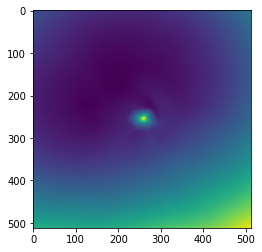

epoch 24501: 49.2008056640625
epoch 24502: 47.78059768676758
epoch 24503: 47.95249938964844
epoch 24504: 48.55109786987305
epoch 24505: 48.19108963012695
epoch 24506: 48.30693435668945
epoch 24507: 49.4778938293457
epoch 24508: 48.227325439453125
epoch 24509: 47.613189697265625
epoch 24511: 48.26626968383789
epoch 24512: 48.05063247680664
epoch 24513: 48.70735549926758
epoch 24514: 48.3250617980957
epoch 24515: 48.280120849609375
epoch 24516: 48.17805099487305
epoch 24517: 47.7786750793457
epoch 24518: 48.200504302978516
epoch 24519: 48.22785949707031
epoch 24521: 49.276275634765625
epoch 24522: 48.0150032043457
epoch 24523: 47.95512008666992
epoch 24524: 47.88530731201172
epoch 24525: 48.03392791748047
epoch 24526: 49.356475830078125
epoch 24527: 47.97418975830078
epoch 24528: 47.72230911254883
epoch 24529: 47.965576171875
epoch 24531: 48.18716049194336
epoch 24532: 48.5455436706543
epoch 24533: 48.30067825317383
epoch 24534: 48.672183990478516
epoch 24535: 48.73920822143555
epoch 245

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



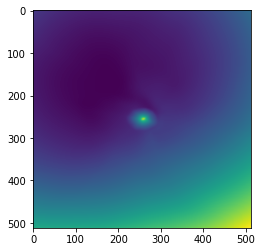

epoch 24601: 49.154415130615234
epoch 24602: 48.790287017822266
epoch 24603: 48.153602600097656
epoch 24604: 49.96568298339844
epoch 24605: 47.96556091308594
epoch 24606: 47.82707977294922
epoch 24607: 48.32923126220703
epoch 24608: 47.68730926513672
epoch 24609: 47.536216735839844
epoch 24611: 49.559967041015625
epoch 24612: 48.05973434448242
epoch 24613: 48.090606689453125
epoch 24614: 48.165855407714844
epoch 24615: 47.95981979370117
epoch 24616: 47.714508056640625
epoch 24617: 48.5237922668457
epoch 24618: 50.0450325012207
epoch 24619: 48.758243560791016
epoch 24621: 47.74909210205078
epoch 24622: 48.837730407714844
epoch 24623: 48.770477294921875
epoch 24624: 49.72358322143555
epoch 24625: 48.34726333618164
epoch 24626: 48.077880859375
epoch 24627: 48.8050422668457
epoch 24628: 47.29130935668945
epoch 24629: 48.5274772644043
epoch 24631: 48.86066436767578
epoch 24632: 48.23335266113281
epoch 24633: 48.63304901123047
epoch 24634: 48.64684295654297
epoch 24635: 47.821041107177734
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



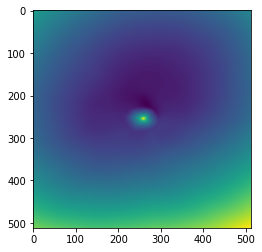

epoch 24701: 48.363441467285156
epoch 24702: 48.60299301147461
epoch 24703: 48.09202575683594
epoch 24704: 49.1513786315918
epoch 24705: 47.49843215942383
epoch 24706: 48.58207702636719
epoch 24707: 48.852054595947266
epoch 24708: 48.616573333740234
epoch 24709: 47.762535095214844
epoch 24711: 47.447208404541016
epoch 24712: 48.04289627075195
epoch 24713: 47.01502227783203
epoch 24714: 48.46222686767578
epoch 24715: 48.310523986816406
epoch 24716: 47.801551818847656
epoch 24717: 47.77229309082031
epoch 24718: 48.342464447021484
epoch 24719: 49.077510833740234
epoch 24721: 49.00098419189453
epoch 24722: 48.45598602294922
epoch 24723: 48.29011917114258
epoch 24724: 47.87734603881836
epoch 24725: 48.28361892700195
epoch 24726: 49.293880462646484
epoch 24727: 48.364009857177734
epoch 24728: 47.824710845947266
epoch 24729: 47.800594329833984
epoch 24731: 48.11998748779297
epoch 24732: 48.130165100097656
epoch 24733: 47.65481948852539
epoch 24734: 48.664432525634766
epoch 24735: 48.010047912

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



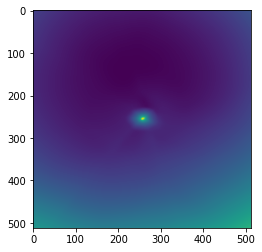

epoch 24801: 47.287200927734375
epoch 24802: 47.91407012939453
epoch 24803: 47.77915573120117
epoch 24804: 48.044795989990234
epoch 24805: 48.06428527832031
epoch 24806: 47.72956085205078
epoch 24807: 48.69693374633789
epoch 24808: 48.47057342529297
epoch 24809: 49.15681457519531
epoch 24811: 47.768646240234375
epoch 24812: 47.442962646484375
epoch 24813: 47.58821487426758
epoch 24814: 49.011573791503906
epoch 24815: 47.72611999511719
epoch 24816: 54.3540153503418
epoch 24817: 48.26959228515625
epoch 24818: 48.094970703125
epoch 24819: 48.30807876586914
epoch 24821: 49.01939010620117
epoch 24822: 48.80623245239258
epoch 24823: 47.717079162597656
epoch 24824: 47.109004974365234
epoch 24825: 47.9766731262207
epoch 24826: 48.228790283203125
epoch 24827: 48.27130126953125
epoch 24828: 47.691768646240234
epoch 24829: 48.328765869140625
epoch 24831: 50.56718063354492
epoch 24832: 48.21561813354492
epoch 24833: 47.780067443847656
epoch 24834: 48.478763580322266
epoch 24835: 50.18809509277344


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



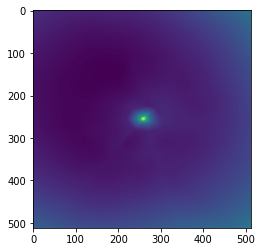

epoch 24901: 49.19793701171875
epoch 24902: 49.06987380981445
epoch 24903: 48.16066360473633
epoch 24904: 48.13777160644531
epoch 24905: 48.470489501953125
epoch 24906: 48.84297561645508
epoch 24907: 47.797603607177734
epoch 24908: 48.017822265625
epoch 24909: 47.66935348510742
epoch 24911: 47.82613754272461
epoch 24912: 48.78533172607422
epoch 24913: 47.43088150024414
epoch 24914: 47.83676528930664
epoch 24915: 47.65081787109375
epoch 24916: 50.3874397277832
epoch 24917: 47.65361404418945
epoch 24918: 55.27790069580078
epoch 24919: 47.903438568115234
epoch 24921: 48.92536163330078
epoch 24922: 48.03632354736328
epoch 24923: 48.58346939086914
epoch 24924: 48.46438980102539
epoch 24925: 48.85087966918945
epoch 24926: 49.02117156982422
epoch 24927: 49.087886810302734
epoch 24928: 48.43008804321289
epoch 24929: 48.11994171142578
epoch 24931: 50.069549560546875
epoch 24932: 48.910240173339844
epoch 24933: 48.10505294799805
epoch 24934: 49.16978073120117
epoch 24935: 48.38774871826172
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



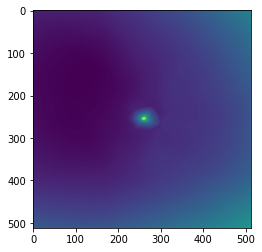

epoch 25001: 48.73257064819336
epoch 25002: 48.877288818359375
epoch 25003: 48.3170051574707
epoch 25004: 48.193607330322266
epoch 25005: 48.79328155517578
epoch 25006: 47.99738693237305
epoch 25007: 48.418235778808594
epoch 25008: 48.78740310668945
epoch 25009: 49.06196594238281
epoch 25011: 49.136085510253906
epoch 25012: 48.644927978515625
epoch 25013: 48.738319396972656
epoch 25014: 48.414268493652344
epoch 25015: 48.64801788330078
epoch 25016: 47.84883117675781
epoch 25017: 48.188358306884766
epoch 25018: 48.52212142944336
epoch 25019: 49.67588806152344
epoch 25021: 49.954715728759766
epoch 25022: 49.38008117675781
epoch 25023: 49.326904296875
epoch 25024: 48.56209945678711
epoch 25025: 49.416038513183594
epoch 25026: 49.27451705932617
epoch 25027: 48.80174255371094
epoch 25028: 48.50465393066406
epoch 25029: 48.31511688232422
epoch 25031: 48.63917541503906
epoch 25032: 48.71688461303711
epoch 25033: 47.91081237792969
epoch 25034: 48.23445129394531
epoch 25035: 49.727867126464844


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



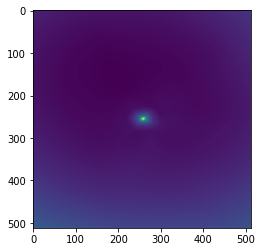

epoch 25101: 47.91345977783203
epoch 25102: 53.04897689819336
epoch 25103: 48.01140213012695
epoch 25104: 49.20355987548828
epoch 25105: 49.455780029296875
epoch 25106: 51.853675842285156
epoch 25107: 49.772708892822266
epoch 25108: 50.43206024169922
epoch 25109: 49.117374420166016
epoch 25111: 48.38829803466797
epoch 25112: 48.72433090209961
epoch 25113: 48.83686447143555
epoch 25114: 48.73808288574219
epoch 25115: 49.15665817260742
epoch 25116: 48.60335159301758
epoch 25117: 49.68439865112305
epoch 25118: 48.79747772216797
epoch 25119: 48.8596076965332
epoch 25121: 48.75012969970703
epoch 25122: 49.02745819091797
epoch 25123: 49.34251022338867
epoch 25124: 49.508758544921875
epoch 25125: 48.615447998046875
epoch 25126: 49.05414581298828
epoch 25127: 48.142913818359375
epoch 25128: 48.61613845825195
epoch 25129: 48.83985900878906
epoch 25131: 47.834617614746094
epoch 25132: 48.609134674072266
epoch 25133: 48.27634811401367
epoch 25134: 48.54911422729492
epoch 25135: 48.49448776245117


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



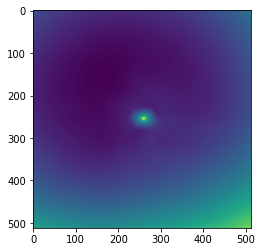

epoch 25201: 47.75742721557617
epoch 25202: 47.56404495239258
epoch 25203: 47.80589294433594
epoch 25204: 48.860687255859375
epoch 25205: 47.556182861328125
epoch 25206: 48.09444046020508
epoch 25207: 54.30646514892578
epoch 25208: 47.727108001708984
epoch 25209: 49.1060676574707
epoch 25211: 51.557979583740234
epoch 25212: 49.6275634765625
epoch 25213: 47.79289627075195
epoch 25214: 48.26961898803711
epoch 25215: 48.81552505493164
epoch 25216: 48.2140007019043
epoch 25217: 48.14069366455078
epoch 25218: 48.583003997802734
epoch 25219: 48.23955154418945
epoch 25221: 48.58371353149414
epoch 25222: 48.89302444458008
epoch 25223: 48.64993667602539
epoch 25224: 47.49604034423828
epoch 25225: 49.06248092651367
epoch 25226: 48.33831024169922
epoch 25227: 48.44753646850586
epoch 25228: 48.270755767822266
epoch 25229: 47.6164665222168
epoch 25231: 48.558284759521484
epoch 25232: 47.94385528564453
epoch 25233: 48.29899597167969
epoch 25234: 47.79926300048828
epoch 25235: 48.177181243896484
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



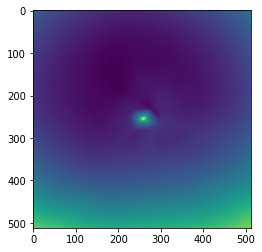

epoch 25301: 47.20083999633789
epoch 25302: 48.38590621948242
epoch 25303: 48.49815368652344
epoch 25304: 48.80247497558594
epoch 25305: 48.46120071411133
epoch 25306: 47.94792938232422
epoch 25307: 47.789451599121094
epoch 25308: 47.07930374145508
epoch 25309: 47.905235290527344
epoch 25311: 49.02021789550781
epoch 25312: 47.99681091308594
epoch 25313: 47.937957763671875
epoch 25314: 47.31633377075195
epoch 25315: 48.36617660522461
epoch 25316: 48.090110778808594
epoch 25317: 48.194969177246094
epoch 25318: 47.88365173339844
epoch 25319: 48.030086517333984
epoch 25321: 48.06056213378906
epoch 25322: 48.6235466003418
epoch 25323: 48.52524948120117
epoch 25324: 47.73814010620117
epoch 25325: 48.594669342041016
epoch 25326: 48.382320404052734
epoch 25327: 47.512203216552734
epoch 25328: 48.04960632324219
epoch 25329: 47.82988739013672
epoch 25331: 48.00865173339844
epoch 25332: 48.35569381713867
epoch 25333: 47.82170486450195
epoch 25334: 48.578548431396484
epoch 25335: 48.80363464355469

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



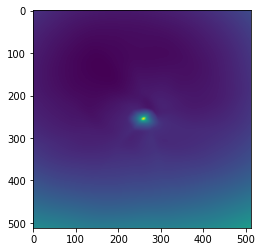

epoch 25401: 48.35722351074219
epoch 25402: 48.841217041015625
epoch 25403: 47.87041473388672
epoch 25404: 48.05641555786133
epoch 25405: 47.70682907104492
epoch 25406: 48.329437255859375
epoch 25407: 47.799354553222656
epoch 25408: 48.28153991699219
epoch 25409: 51.81952667236328
epoch 25411: 48.0204963684082
epoch 25412: 47.97128677368164
epoch 25413: 47.881996154785156
epoch 25414: 49.64205551147461
epoch 25415: 47.72046661376953
epoch 25416: 48.40587615966797
epoch 25417: 47.88593292236328
epoch 25418: 49.36141586303711
epoch 25419: 48.65800476074219
epoch 25421: 48.22425842285156
epoch 25422: 48.51978302001953
epoch 25423: 49.334720611572266
epoch 25424: 48.349891662597656
epoch 25425: 47.99369812011719
epoch 25426: 48.188724517822266
epoch 25427: 48.5036506652832
epoch 25428: 48.202049255371094
epoch 25429: 48.071563720703125
epoch 25431: 48.60546875
epoch 25432: 48.62468719482422
epoch 25433: 48.33661651611328
epoch 25434: 47.81713104248047
epoch 25435: 48.11334991455078
epoch 2

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



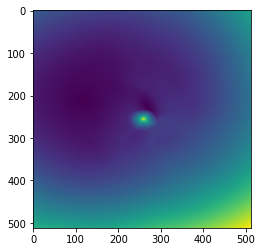

epoch 25501: 48.75904846191406
epoch 25502: 48.4359016418457
epoch 25503: 48.49059295654297
epoch 25504: 49.38206100463867
epoch 25505: 48.05210494995117
epoch 25506: 48.17047882080078
epoch 25507: 48.436824798583984
epoch 25508: 47.923194885253906
epoch 25509: 49.584266662597656
epoch 25511: 47.98029708862305
epoch 25512: 49.430511474609375
epoch 25513: 48.044769287109375
epoch 25514: 48.6211051940918
epoch 25515: 47.874839782714844
epoch 25516: 47.955162048339844
epoch 25517: 48.81062316894531
epoch 25518: 47.6652946472168
epoch 25519: 48.1922607421875
epoch 25521: 48.68755340576172
epoch 25522: 47.702938079833984
epoch 25523: 48.21980285644531
epoch 25524: 48.08624267578125
epoch 25525: 48.49433898925781
epoch 25526: 48.403900146484375
epoch 25527: 48.765899658203125
epoch 25528: 48.29950714111328
epoch 25529: 47.5755729675293
epoch 25531: 48.92266082763672
epoch 25532: 48.38551712036133
epoch 25533: 48.3442497253418
epoch 25534: 47.845603942871094
epoch 25535: 48.42586898803711
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



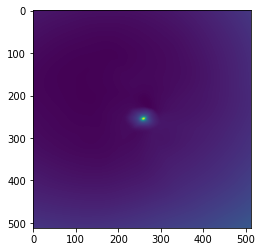

epoch 25601: 48.6023063659668
epoch 25602: 48.550010681152344
epoch 25603: 47.91497802734375
epoch 25604: 48.101192474365234
epoch 25605: 48.85791778564453
epoch 25606: 47.842464447021484
epoch 25607: 48.32372283935547
epoch 25608: 48.2545280456543
epoch 25609: 50.12199783325195
epoch 25611: 48.65809631347656
epoch 25612: 47.590999603271484
epoch 25613: 48.36947250366211
epoch 25614: 48.255126953125
epoch 25615: 48.315269470214844
epoch 25616: 47.976348876953125
epoch 25617: 49.009010314941406
epoch 25618: 49.741554260253906
epoch 25619: 47.73858642578125
epoch 25621: 49.49462127685547
epoch 25622: 48.53533935546875
epoch 25623: 48.61061096191406
epoch 25624: 48.53693771362305
epoch 25625: 48.556983947753906
epoch 25626: 47.62603759765625
epoch 25627: 49.23560333251953
epoch 25628: 48.3234748840332
epoch 25629: 48.33790969848633
epoch 25631: 48.9039421081543
epoch 25632: 49.11536407470703
epoch 25633: 48.99287414550781
epoch 25634: 48.234649658203125
epoch 25635: 48.29692459106445
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



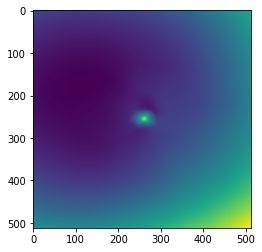

epoch 25701: 48.5806884765625
epoch 25702: 48.4642333984375
epoch 25703: 48.002403259277344
epoch 25704: 47.46172332763672
epoch 25705: 47.60043716430664
epoch 25706: 47.989784240722656
epoch 25707: 47.53559494018555
epoch 25708: 48.251346588134766
epoch 25709: 48.238609313964844
epoch 25711: 48.4501953125
epoch 25712: 48.033180236816406
epoch 25713: 48.39181900024414
epoch 25714: 50.896949768066406
epoch 25715: 48.00688934326172
epoch 25716: 47.77322769165039
epoch 25717: 48.733428955078125
epoch 25718: 48.27926254272461
epoch 25719: 47.616050720214844
epoch 25721: 47.48408508300781
epoch 25722: 48.670536041259766
epoch 25723: 48.27748489379883
epoch 25724: 48.354026794433594
epoch 25725: 47.82039260864258
epoch 25726: 48.07284927368164
epoch 25727: 48.466880798339844
epoch 25728: 47.70603942871094
epoch 25729: 48.99337387084961
epoch 25731: 47.988677978515625
epoch 25732: 48.55693054199219
epoch 25733: 48.56610107421875
epoch 25734: 47.93204116821289
epoch 25735: 49.199195861816406
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



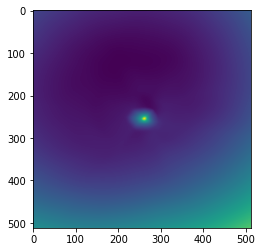

epoch 25801: 47.48346710205078
epoch 25802: 48.552276611328125
epoch 25803: 47.442657470703125
epoch 25804: 47.73912811279297
epoch 25805: 48.31901168823242
epoch 25806: 48.06684112548828
epoch 25807: 47.10757064819336
epoch 25808: 47.988128662109375
epoch 25809: 48.377784729003906
epoch 25811: 48.02800750732422
epoch 25812: 47.71131896972656
epoch 25813: 48.56524658203125
epoch 25814: 47.72562789916992
epoch 25815: 51.43613815307617
epoch 25816: 47.826148986816406
epoch 25817: 48.139713287353516
epoch 25818: 48.66337203979492
epoch 25819: 48.6309928894043
epoch 25821: 48.53068923950195
epoch 25822: 48.53865432739258
epoch 25823: 47.289405822753906
epoch 25824: 48.30075454711914
epoch 25825: 48.73249816894531
epoch 25826: 48.37348175048828
epoch 25827: 48.341697692871094
epoch 25828: 48.05332946777344
epoch 25829: 48.427547454833984
epoch 25831: 48.367862701416016
epoch 25832: 48.066429138183594
epoch 25833: 49.01543426513672
epoch 25834: 48.83623123168945
epoch 25835: 48.6188812255859

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



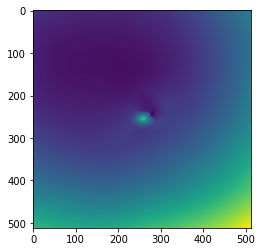

epoch 25901: 49.57160186767578
epoch 25902: 49.086456298828125
epoch 25903: 49.25761413574219
epoch 25904: 48.01340103149414
epoch 25905: 48.765079498291016
epoch 25906: 48.52154541015625
epoch 25907: 48.535282135009766
epoch 25908: 48.397727966308594
epoch 25909: 48.55644607543945
epoch 25911: 48.05985641479492
epoch 25912: 47.722511291503906
epoch 25913: 49.079715728759766
epoch 25914: 47.80323791503906
epoch 25915: 47.69534683227539
epoch 25916: 48.255455017089844
epoch 25917: 49.115962982177734
epoch 25918: 48.641387939453125
epoch 25919: 48.754913330078125
epoch 25921: 48.2473030090332
epoch 25922: 48.71116638183594
epoch 25923: 48.38312530517578
epoch 25924: 48.48439407348633
epoch 25925: 48.79039764404297
epoch 25926: 48.63728332519531
epoch 25927: 47.90087890625
epoch 25928: 48.97370147705078
epoch 25929: 47.861873626708984
epoch 25931: 48.379295349121094
epoch 25932: 48.97539520263672
epoch 25933: 48.136905670166016
epoch 25934: 49.03910827636719
epoch 25935: 49.78748321533203

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



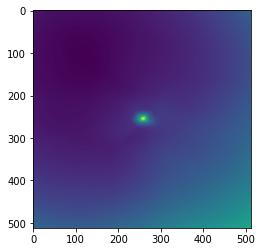

epoch 26001: 48.66584777832031
epoch 26002: 49.6092414855957
epoch 26003: 47.95970153808594
epoch 26004: 50.76572799682617
epoch 26005: 48.4904899597168
epoch 26006: 49.436134338378906
epoch 26007: 48.923614501953125
epoch 26008: 48.71833801269531
epoch 26009: 48.752010345458984
epoch 26011: 48.590553283691406
epoch 26012: 48.19517517089844
epoch 26013: 49.23906707763672
epoch 26014: 48.47767639160156
epoch 26015: 48.50825500488281
epoch 26016: 48.13307189941406
epoch 26017: 48.128108978271484
epoch 26018: 48.4390983581543
epoch 26019: 48.966556549072266
epoch 26021: 47.96440505981445
epoch 26022: 48.678279876708984
epoch 26023: 47.501914978027344
epoch 26024: 48.03610610961914
epoch 26025: 48.13496398925781
epoch 26026: 48.091407775878906
epoch 26027: 49.08671569824219
epoch 26028: 47.9364128112793
epoch 26029: 48.09382629394531
epoch 26031: 47.933963775634766
epoch 26032: 49.07495880126953
epoch 26033: 48.342323303222656
epoch 26034: 47.85544204711914
epoch 26035: 48.08189010620117
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



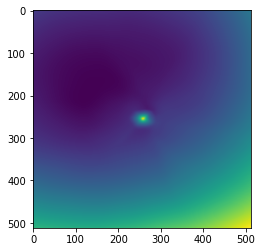

epoch 26101: 48.65442657470703
epoch 26102: 48.1907958984375
epoch 26103: 48.9471321105957
epoch 26104: 48.29182434082031
epoch 26105: 48.19163513183594
epoch 26106: 48.39313888549805
epoch 26107: 48.815147399902344
epoch 26108: 47.76473617553711
epoch 26109: 47.94711685180664
epoch 26111: 48.293128967285156
epoch 26112: 47.49907684326172
epoch 26113: 48.5174560546875
epoch 26114: 48.69215774536133
epoch 26115: 47.73223876953125
epoch 26116: 48.695159912109375
epoch 26117: 47.48778533935547
epoch 26118: 47.869041442871094
epoch 26119: 48.818023681640625
epoch 26121: 48.526729583740234
epoch 26122: 48.561222076416016
epoch 26123: 47.70077896118164
epoch 26124: 47.82295608520508
epoch 26125: 48.26255798339844
epoch 26126: 47.72700119018555
epoch 26127: 47.84232711791992
epoch 26128: 48.8276481628418
epoch 26129: 48.21841812133789
epoch 26131: 47.322940826416016
epoch 26132: 48.259803771972656
epoch 26133: 48.786685943603516
epoch 26134: 48.34156799316406
epoch 26135: 47.97426986694336
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



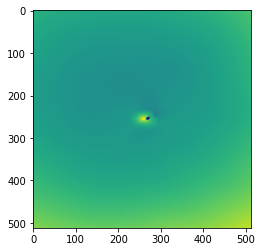

epoch 26201: 49.31052780151367
epoch 26202: 48.73606491088867
epoch 26203: 49.03681945800781
epoch 26204: 49.28075408935547
epoch 26205: 48.20393753051758
epoch 26206: 49.13996505737305
epoch 26207: 48.07886505126953
epoch 26208: 48.816280364990234
epoch 26209: 49.37041473388672
epoch 26211: 48.73401641845703
epoch 26212: 48.93628692626953
epoch 26213: 49.446311950683594
epoch 26214: 48.3821907043457
epoch 26215: 50.92775344848633
epoch 26216: 48.85749053955078
epoch 26217: 49.16546630859375
epoch 26218: 49.88385009765625
epoch 26219: 48.69078826904297
epoch 26221: 48.2312126159668
epoch 26222: 49.5797119140625
epoch 26223: 48.83917236328125
epoch 26224: 48.544036865234375
epoch 26225: 48.40455627441406
epoch 26226: 48.11478042602539
epoch 26227: 49.42529296875
epoch 26228: 48.70069885253906
epoch 26229: 48.95492172241211
epoch 26231: 49.32870864868164
epoch 26232: 49.26362609863281
epoch 26233: 48.33414077758789
epoch 26234: 49.12606430053711
epoch 26235: 48.50502014160156
epoch 26236

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



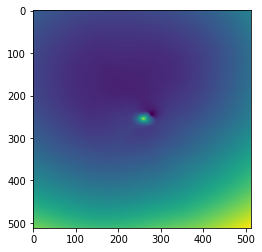

epoch 26301: 48.998626708984375
epoch 26302: 47.60411834716797
epoch 26303: 48.33544158935547
epoch 26304: 48.45464324951172
epoch 26305: 47.90081024169922
epoch 26306: 48.60765838623047
epoch 26307: 48.5318717956543
epoch 26308: 48.111541748046875
epoch 26309: 48.02032470703125
epoch 26311: 48.394447326660156
epoch 26312: 48.64557647705078
epoch 26313: 48.618553161621094
epoch 26314: 47.87945556640625
epoch 26315: 49.093074798583984
epoch 26316: 49.15694046020508
epoch 26317: 48.249267578125
epoch 26318: 48.7468376159668
epoch 26319: 48.831443786621094
epoch 26321: 49.106632232666016
epoch 26322: 48.5024528503418
epoch 26323: 48.60936737060547
epoch 26324: 47.98604965209961
epoch 26325: 48.21147918701172
epoch 26326: 48.38119888305664
epoch 26327: 47.85736083984375
epoch 26328: 49.97212219238281
epoch 26329: 48.0357666015625
epoch 26331: 48.5089111328125
epoch 26332: 47.8934211730957
epoch 26333: 48.31703567504883
epoch 26334: 48.62382507324219
epoch 26335: 48.84317398071289
epoch 263

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



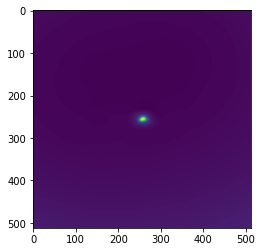

epoch 26401: 48.342105865478516
epoch 26402: 48.50557327270508
epoch 26403: 49.389060974121094
epoch 26404: 49.38378143310547
epoch 26405: 50.07386016845703
epoch 26406: 48.31715393066406
epoch 26407: 48.466609954833984
epoch 26408: 47.850006103515625
epoch 26409: 48.28679656982422
epoch 26411: 47.80387496948242
epoch 26412: 47.85778045654297
epoch 26413: 48.6488037109375
epoch 26414: 48.60603332519531
epoch 26415: 48.68610382080078
epoch 26416: 48.596317291259766
epoch 26417: 48.44175338745117
epoch 26418: 49.01057815551758
epoch 26419: 48.009132385253906
epoch 26421: 47.72243118286133
epoch 26422: 47.94100570678711
epoch 26423: 48.043582916259766
epoch 26424: 48.08590316772461
epoch 26425: 48.38811111450195
epoch 26426: 47.584354400634766
epoch 26427: 49.21132278442383
epoch 26428: 48.34111785888672
epoch 26429: 49.84874725341797
epoch 26431: 47.74839401245117
epoch 26432: 48.353336334228516
epoch 26433: 60.78019714355469
epoch 26434: 49.38910675048828
epoch 26435: 51.33411407470703


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



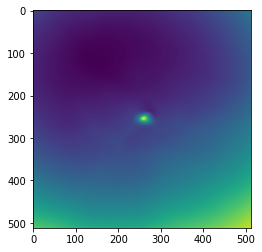

epoch 26501: 48.320350646972656
epoch 26502: 47.71649932861328
epoch 26503: 48.256248474121094
epoch 26504: 48.10292434692383
epoch 26505: 48.315582275390625
epoch 26506: 47.63905715942383
epoch 26507: 48.16284942626953
epoch 26508: 48.172607421875
epoch 26509: 48.1491813659668
epoch 26511: 48.05263137817383
epoch 26512: 48.46477127075195
epoch 26513: 48.290889739990234
epoch 26514: 48.36813735961914
epoch 26515: 47.1495475769043
epoch 26516: 47.864864349365234
epoch 26517: 48.71168518066406
epoch 26518: 48.79115295410156
epoch 26519: 48.09428787231445
epoch 26521: 48.594608306884766
epoch 26522: 48.773277282714844
epoch 26523: 48.22123718261719
epoch 26524: 47.651634216308594
epoch 26525: 47.75631332397461
epoch 26526: 48.04824447631836
epoch 26527: 47.66986083984375
epoch 26528: 47.47025680541992
epoch 26529: 48.41242218017578
epoch 26531: 47.8714599609375
epoch 26532: 47.57997512817383
epoch 26533: 47.80469512939453
epoch 26534: 47.916236877441406
epoch 26535: 49.2803955078125
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



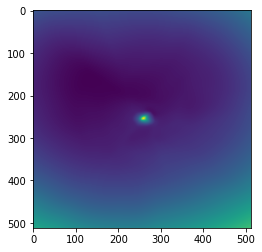

epoch 26601: 51.80705642700195
epoch 26602: 48.789649963378906
epoch 26603: 49.04475784301758
epoch 26604: 48.35536575317383
epoch 26605: 48.10810470581055
epoch 26606: 48.1358642578125
epoch 26607: 49.043861389160156
epoch 26608: 48.98701095581055
epoch 26609: 49.135887145996094
epoch 26611: 48.8760871887207
epoch 26612: 48.65662384033203
epoch 26613: 49.42843246459961
epoch 26614: 48.04328918457031
epoch 26615: 49.79878234863281
epoch 26616: 48.82701110839844
epoch 26617: 48.47734451293945
epoch 26618: 48.358394622802734
epoch 26619: 48.46284484863281
epoch 26621: 48.50056457519531
epoch 26622: 47.709144592285156
epoch 26623: 49.209632873535156
epoch 26624: 48.555789947509766
epoch 26625: 47.92519760131836
epoch 26626: 49.110389709472656
epoch 26627: 49.11128234863281
epoch 26628: 48.46112823486328
epoch 26629: 47.817237854003906
epoch 26631: 48.38290023803711
epoch 26632: 48.19163131713867
epoch 26633: 48.006370544433594
epoch 26634: 48.056941986083984
epoch 26635: 47.99181365966797

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



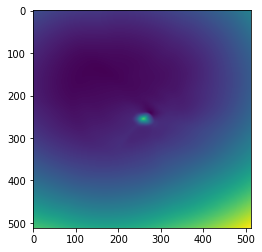

epoch 26701: 48.09172439575195
epoch 26702: 47.98750305175781
epoch 26703: 49.16426086425781
epoch 26704: 48.22080993652344
epoch 26705: 47.81216049194336
epoch 26706: 48.7540397644043
epoch 26707: 48.16960144042969
epoch 26708: 47.526283264160156
epoch 26709: 48.00429153442383
epoch 26711: 48.87765121459961
epoch 26712: 48.522743225097656
epoch 26713: 47.505210876464844
epoch 26714: 48.369388580322266
epoch 26715: 48.090572357177734
epoch 26716: 48.659000396728516
epoch 26717: 47.981082916259766
epoch 26718: 48.333702087402344
epoch 26719: 47.61967468261719
epoch 26721: 48.86066436767578
epoch 26722: 48.5995979309082
epoch 26723: 47.48277282714844
epoch 26724: 48.21142578125
epoch 26725: 48.073368072509766
epoch 26726: 47.86039352416992
epoch 26727: 49.50221633911133
epoch 26728: 48.892635345458984
epoch 26729: 48.56428146362305
epoch 26731: 48.697593688964844
epoch 26732: 48.417381286621094
epoch 26733: 48.69382095336914
epoch 26734: 49.10808181762695
epoch 26735: 49.14259719848633
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



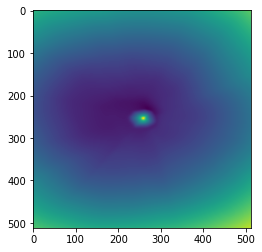

epoch 26801: 48.10636901855469
epoch 26802: 49.29642105102539
epoch 26803: 50.29411315917969
epoch 26804: 49.44995880126953
epoch 26805: 49.38536071777344
epoch 26806: 49.341575622558594
epoch 26807: 49.207950592041016
epoch 26808: 48.460052490234375
epoch 26809: 48.14464569091797
epoch 26811: 48.33394241333008
epoch 26812: 48.00308609008789
epoch 26813: 48.40109634399414
epoch 26814: 48.72562026977539
epoch 26815: 47.671627044677734
epoch 26816: 47.867332458496094
epoch 26817: 48.64447021484375
epoch 26818: 48.75785446166992
epoch 26819: 48.60565948486328
epoch 26821: 48.243507385253906
epoch 26822: 48.25482940673828
epoch 26823: 48.47813415527344
epoch 26824: 48.9473876953125
epoch 26825: 48.47013473510742
epoch 26826: 48.96241760253906
epoch 26827: 48.97968292236328
epoch 26828: 48.80571365356445
epoch 26829: 49.69184875488281
epoch 26831: 49.3936653137207
epoch 26832: 48.317344665527344
epoch 26833: 49.242801666259766
epoch 26834: 48.63176345825195
epoch 26835: 49.07369613647461
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



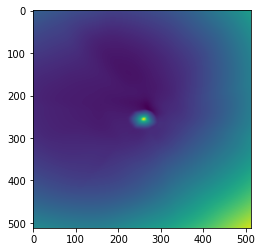

epoch 26901: 48.51100158691406
epoch 26902: 49.16454315185547
epoch 26903: 51.83036804199219
epoch 26904: 49.110652923583984
epoch 26905: 48.12588119506836
epoch 26906: 47.99727249145508
epoch 26907: 49.27610397338867
epoch 26908: 49.58777618408203
epoch 26909: 48.26061248779297
epoch 26911: 48.791622161865234
epoch 26912: 47.719276428222656
epoch 26913: 51.134132385253906
epoch 26914: 49.45530319213867
epoch 26915: 47.89591598510742
epoch 26916: 49.02754211425781
epoch 26917: 48.35502624511719
epoch 26918: 49.37376403808594
epoch 26919: 48.63702392578125
epoch 26921: 48.46957015991211
epoch 26922: 49.82008361816406
epoch 26923: 48.6651611328125
epoch 26924: 48.513057708740234
epoch 26925: 50.14470672607422
epoch 26926: 49.026161193847656
epoch 26927: 48.53191375732422
epoch 26928: 48.50193786621094
epoch 26929: 48.89809036254883
epoch 26931: 48.8686637878418
epoch 26932: 48.52509689331055
epoch 26933: 48.43281173706055
epoch 26934: 48.272727966308594
epoch 26935: 49.132057189941406
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



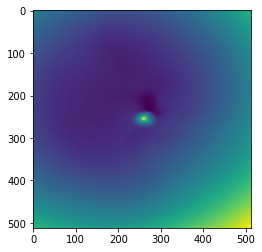

epoch 27001: 47.74545669555664
epoch 27002: 48.39714813232422
epoch 27003: 50.18000793457031
epoch 27004: 48.87044143676758
epoch 27005: 48.52036666870117
epoch 27006: 48.109561920166016
epoch 27007: 48.05596160888672
epoch 27008: 48.18709182739258
epoch 27009: 47.98500061035156
epoch 27011: 48.15777587890625
epoch 27012: 49.042728424072266
epoch 27013: 48.738739013671875
epoch 27014: 48.339969635009766
epoch 27015: 47.645206451416016
epoch 27016: 47.85852813720703
epoch 27017: 48.19365692138672
epoch 27018: 49.06816864013672
epoch 27019: 48.61195373535156
epoch 27021: 48.855506896972656
epoch 27022: 48.17967987060547
epoch 27023: 49.745723724365234
epoch 27024: 48.647464752197266
epoch 27025: 48.88713455200195
epoch 27026: 48.60343933105469
epoch 27027: 49.02192687988281
epoch 27028: 48.92760467529297
epoch 27029: 47.77449417114258
epoch 27031: 47.96432113647461
epoch 27032: 48.270565032958984
epoch 27033: 47.764320373535156
epoch 27034: 47.93758773803711
epoch 27035: 47.5242805480957

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



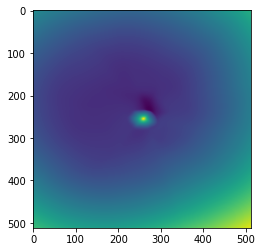

epoch 27101: 47.90019607543945
epoch 27102: 49.81769561767578
epoch 27103: 48.49160385131836
epoch 27104: 48.81523895263672
epoch 27105: 48.68415451049805
epoch 27106: 47.32057571411133
epoch 27107: 48.37352752685547
epoch 27108: 48.51080322265625
epoch 27109: 47.65447998046875
epoch 27111: 50.64710235595703
epoch 27112: 48.00307083129883
epoch 27113: 48.6404914855957
epoch 27114: 49.571712493896484
epoch 27115: 49.15376281738281
epoch 27116: 47.737274169921875
epoch 27117: 47.999088287353516
epoch 27118: 48.388893127441406
epoch 27119: 47.98518371582031
epoch 27121: 47.81819152832031
epoch 27122: 47.540252685546875
epoch 27123: 48.31012725830078
epoch 27124: 48.22282028198242
epoch 27125: 47.7620849609375
epoch 27126: 47.54157638549805
epoch 27127: 48.84941864013672
epoch 27128: 48.08185577392578
epoch 27129: 48.27089309692383
epoch 27131: 47.94609832763672
epoch 27132: 49.08485794067383
epoch 27133: 48.14872741699219
epoch 27134: 47.81757736206055
epoch 27135: 48.81987380981445
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



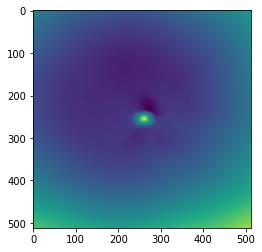

epoch 27201: 47.67025375366211
epoch 27202: 48.57676696777344
epoch 27203: 47.80253219604492
epoch 27204: 47.921749114990234
epoch 27205: 48.003578186035156
epoch 27206: 48.30680847167969
epoch 27207: 48.325035095214844
epoch 27208: 47.957794189453125
epoch 27209: 48.14834213256836
epoch 27211: 48.30514907836914
epoch 27212: 48.295650482177734
epoch 27213: 48.58167266845703
epoch 27214: 47.36018753051758
epoch 27215: 47.9576416015625
epoch 27216: 48.172489166259766
epoch 27217: 47.885902404785156
epoch 27218: 47.90090560913086
epoch 27219: 48.2295036315918
epoch 27221: 48.09880828857422
epoch 27222: 47.70102310180664
epoch 27223: 48.152992248535156
epoch 27224: 47.13219451904297
epoch 27225: 47.1004753112793
epoch 27226: 48.8695068359375
epoch 27227: 48.623313903808594
epoch 27228: 47.82676315307617
epoch 27229: 47.6132698059082
epoch 27231: 48.1700325012207
epoch 27232: 48.8629150390625
epoch 27233: 48.005088806152344
epoch 27234: 47.5842170715332
epoch 27235: 48.80495071411133
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



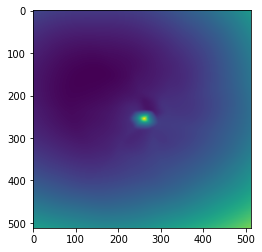

epoch 27301: 47.721046447753906
epoch 27302: 47.95520782470703
epoch 27303: 50.02845001220703
epoch 27304: 47.238433837890625
epoch 27305: 49.21876907348633
epoch 27306: 47.730655670166016
epoch 27307: 47.02726745605469
epoch 27308: 47.440330505371094
epoch 27309: 48.40813064575195
epoch 27311: 49.16320037841797
epoch 27312: 49.2984733581543
epoch 27313: 48.63005065917969
epoch 27314: 48.22914123535156
epoch 27315: 48.800376892089844
epoch 27316: 48.88644027709961
epoch 27317: 47.79495620727539
epoch 27318: 48.149600982666016
epoch 27319: 47.58611297607422
epoch 27321: 47.761959075927734
epoch 27322: 49.10585021972656
epoch 27323: 47.742210388183594
epoch 27324: 48.43312072753906
epoch 27325: 47.76935958862305
epoch 27326: 48.81568908691406
epoch 27327: 48.101810455322266
epoch 27328: 47.512691497802734
epoch 27329: 48.42847442626953
epoch 27331: 48.838653564453125
epoch 27332: 48.50142288208008
epoch 27333: 47.49820327758789
epoch 27334: 48.44546890258789
epoch 27335: 48.1408081054687

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



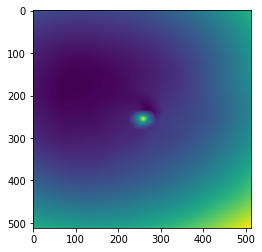

epoch 27401: 48.633514404296875
epoch 27402: 48.430049896240234
epoch 27403: 48.25639343261719
epoch 27404: 47.16249084472656
epoch 27405: 48.10674285888672
epoch 27406: 48.30337142944336
epoch 27407: 48.0449333190918
epoch 27408: 49.17216873168945
epoch 27409: 47.73025131225586
epoch 27411: 48.46159362792969
epoch 27412: 48.31357192993164
epoch 27413: 47.73837661743164
epoch 27414: 47.494449615478516
epoch 27415: 48.63087463378906
epoch 27416: 47.95062255859375
epoch 27417: 48.35775375366211
epoch 27418: 48.39710998535156
epoch 27419: 48.51864242553711
epoch 27421: 47.29917526245117
epoch 27422: 48.44633483886719
epoch 27423: 48.615055084228516
epoch 27424: 47.77980422973633
epoch 27425: 48.85977554321289
epoch 27426: 48.59519577026367
epoch 27427: 47.903995513916016
epoch 27428: 47.04653549194336
epoch 27429: 47.53658676147461
epoch 27431: 48.01005554199219
epoch 27432: 47.2991828918457
epoch 27433: 48.28490447998047
epoch 27434: 47.676055908203125
epoch 27435: 47.998443603515625
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



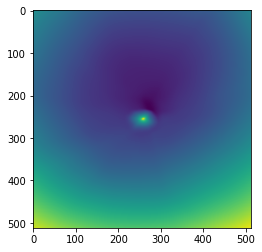

epoch 27501: 48.94281768798828
epoch 27502: 48.74990463256836
epoch 27503: 48.39323043823242
epoch 27504: 48.16157913208008
epoch 27505: 49.099937438964844
epoch 27506: 49.05071258544922
epoch 27507: 47.72621154785156
epoch 27508: 48.09876251220703
epoch 27509: 48.459266662597656
epoch 27511: 49.0000114440918
epoch 27512: 48.861209869384766
epoch 27513: 47.98717498779297
epoch 27514: 49.734130859375
epoch 27515: 48.58725357055664
epoch 27516: 48.912933349609375
epoch 27517: 48.6402702331543
epoch 27518: 48.55628967285156
epoch 27519: 48.45479202270508
epoch 27521: 47.2133674621582
epoch 27522: 48.05122756958008
epoch 27523: 48.31987762451172
epoch 27524: 48.309104919433594
epoch 27525: 47.63327407836914
epoch 27526: 47.861080169677734
epoch 27527: 47.938804626464844
epoch 27528: 47.80892562866211
epoch 27529: 49.03192901611328
epoch 27531: 47.917972564697266
epoch 27532: 48.55445098876953
epoch 27533: 48.01264953613281
epoch 27534: 49.013221740722656
epoch 27535: 48.2859001159668
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



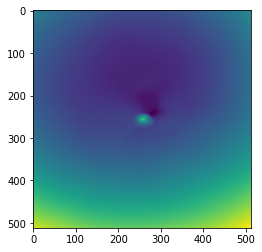

epoch 27601: 47.88138198852539
epoch 27602: 48.6285514831543
epoch 27603: 48.608116149902344
epoch 27604: 48.323585510253906
epoch 27605: 49.47008514404297
epoch 27606: 48.6282958984375
epoch 27607: 48.023536682128906
epoch 27608: 47.06660079956055
epoch 27609: 48.3765983581543
epoch 27611: 48.597835540771484
epoch 27612: 48.368228912353516
epoch 27613: 48.21778106689453
epoch 27614: 48.17023468017578
epoch 27615: 49.15909957885742
epoch 27616: 47.63813781738281
epoch 27617: 47.756561279296875
epoch 27618: 48.328285217285156
epoch 27619: 48.10049819946289
epoch 27621: 48.44956970214844
epoch 27622: 47.797969818115234
epoch 27623: 48.188934326171875
epoch 27624: 49.657875061035156
epoch 27625: 48.55608367919922
epoch 27626: 48.21446990966797
epoch 27627: 48.527061462402344
epoch 27628: 48.227760314941406
epoch 27629: 48.063602447509766
epoch 27631: 48.799110412597656
epoch 27632: 47.717647552490234
epoch 27633: 48.14244842529297
epoch 27634: 49.84562683105469
epoch 27635: 47.79788208007

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



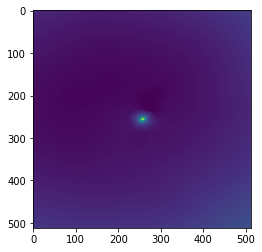

epoch 27701: 50.381107330322266
epoch 27702: 47.74834060668945
epoch 27703: 48.608070373535156
epoch 27704: 48.74977493286133
epoch 27705: 48.814781188964844
epoch 27706: 48.676509857177734
epoch 27707: 48.253623962402344
epoch 27708: 48.08699035644531
epoch 27709: 47.91489791870117
epoch 27711: 47.75603485107422
epoch 27712: 48.691062927246094
epoch 27713: 47.323448181152344
epoch 27714: 48.27669143676758
epoch 27715: 47.85121154785156
epoch 27716: 47.77519607543945
epoch 27717: 47.54753112792969
epoch 27718: 48.38893127441406
epoch 27719: 48.15705108642578
epoch 27721: 49.41924285888672
epoch 27722: 47.96424865722656
epoch 27723: 48.792049407958984
epoch 27724: 48.72823715209961
epoch 27725: 47.643192291259766
epoch 27726: 48.84625244140625
epoch 27727: 49.64781188964844
epoch 27728: 47.99571228027344
epoch 27729: 47.459712982177734
epoch 27731: 48.72446060180664
epoch 27732: 48.5263557434082
epoch 27733: 49.29766082763672
epoch 27734: 47.787471771240234
epoch 27735: 47.8875885009765

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



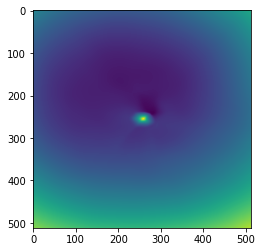

epoch 27801: 47.87622833251953
epoch 27802: 47.732059478759766
epoch 27803: 49.25058364868164
epoch 27804: 48.66952896118164
epoch 27805: 48.00882339477539
epoch 27806: 48.15883255004883
epoch 27807: 47.93600845336914
epoch 27808: 47.60763168334961
epoch 27809: 48.76931381225586
epoch 27811: 48.75621032714844
epoch 27812: 47.41249084472656
epoch 27813: 49.12356948852539
epoch 27814: 48.18056106567383
epoch 27815: 48.380943298339844
epoch 27816: 49.07037353515625
epoch 27817: 48.41057205200195
epoch 27818: 47.9141731262207
epoch 27819: 48.184024810791016
epoch 27821: 48.256614685058594
epoch 27822: 49.874900817871094
epoch 27823: 48.90361785888672
epoch 27824: 48.30565643310547
epoch 27825: 48.411590576171875
epoch 27826: 48.432861328125
epoch 27827: 47.73846435546875
epoch 27828: 48.00568389892578
epoch 27829: 49.38945770263672
epoch 27831: 48.02414321899414
epoch 27832: 47.6336784362793
epoch 27833: 49.219913482666016
epoch 27834: 48.41975021362305
epoch 27835: 48.37948989868164
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



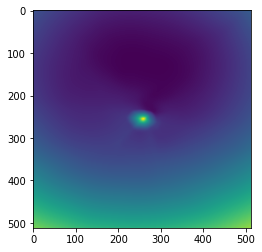

epoch 27901: 49.62809753417969
epoch 27902: 48.11106872558594
epoch 27903: 48.365360260009766
epoch 27904: 47.68111038208008
epoch 27905: 48.53022003173828
epoch 27906: 47.99296188354492
epoch 27907: 50.19931411743164
epoch 27908: 48.13053894042969
epoch 27909: 47.86048889160156
epoch 27911: 48.25752639770508
epoch 27912: 49.21731185913086
epoch 27913: 48.98320770263672
epoch 27914: 48.586490631103516
epoch 27915: 47.671730041503906
epoch 27916: 48.6468505859375
epoch 27917: 48.612789154052734
epoch 27918: 48.215518951416016
epoch 27919: 48.347198486328125
epoch 27921: 48.474090576171875
epoch 27922: 48.11665344238281
epoch 27923: 48.46116638183594
epoch 27924: 48.14371871948242
epoch 27925: 48.35818862915039
epoch 27926: 48.54026412963867
epoch 27927: 48.16270065307617
epoch 27928: 48.01742172241211
epoch 27929: 50.02383041381836
epoch 27931: 48.63571548461914
epoch 27932: 48.84384536743164
epoch 27933: 48.319496154785156
epoch 27934: 49.15592956542969
epoch 27935: 48.47941589355469
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



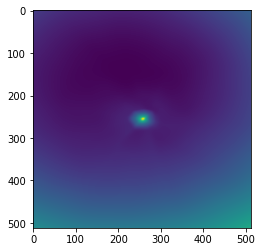

epoch 28001: 48.485382080078125
epoch 28002: 47.31452178955078
epoch 28003: 47.89273452758789
epoch 28004: 48.29781723022461
epoch 28005: 48.725807189941406
epoch 28006: 48.3826904296875
epoch 28007: 47.62929916381836
epoch 28008: 47.29487609863281
epoch 28009: 47.28780746459961
epoch 28011: 48.262474060058594
epoch 28012: 47.75992965698242
epoch 28013: 47.65780258178711
epoch 28014: 50.86872100830078
epoch 28015: 48.63591766357422
epoch 28016: 47.42814636230469
epoch 28017: 47.6680908203125
epoch 28018: 48.047698974609375
epoch 28019: 48.46830368041992
epoch 28021: 47.56743240356445
epoch 28022: 48.636260986328125
epoch 28023: 48.134098052978516
epoch 28024: 47.960060119628906
epoch 28025: 48.16422653198242
epoch 28026: 48.26218795776367
epoch 28027: 48.0518684387207
epoch 28028: 48.01335525512695
epoch 28029: 47.449806213378906
epoch 28031: 48.28746795654297
epoch 28032: 48.78851318359375
epoch 28033: 47.620628356933594
epoch 28034: 48.53846740722656
epoch 28035: 48.438175201416016
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



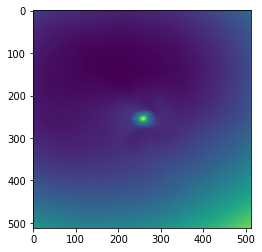

epoch 28101: 48.136146545410156
epoch 28102: 48.472599029541016
epoch 28103: 49.05149841308594
epoch 28104: 48.86399459838867
epoch 28105: 48.2309684753418
epoch 28106: 48.760101318359375
epoch 28107: 47.69310760498047
epoch 28108: 48.50593948364258
epoch 28109: 48.048484802246094
epoch 28111: 48.261810302734375
epoch 28112: 48.8908576965332
epoch 28113: 48.01409149169922
epoch 28114: 47.6666145324707
epoch 28115: 48.12183380126953
epoch 28116: 48.839210510253906
epoch 28117: 49.16224670410156
epoch 28118: 47.65087890625
epoch 28119: 48.184932708740234
epoch 28121: 47.969356536865234
epoch 28122: 47.7641716003418
epoch 28123: 50.126956939697266
epoch 28124: 48.46425247192383
epoch 28125: 48.85753631591797
epoch 28126: 47.58723831176758
epoch 28127: 48.40685272216797
epoch 28128: 48.34699630737305
epoch 28129: 48.57365798950195
epoch 28131: 48.28086471557617
epoch 28132: 48.343162536621094
epoch 28133: 48.859920501708984
epoch 28134: 48.016361236572266
epoch 28135: 48.24164962768555
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



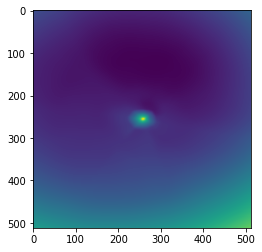

epoch 28201: 48.857460021972656
epoch 28202: 47.91361999511719
epoch 28203: 47.678794860839844
epoch 28204: 48.110267639160156
epoch 28205: 48.13173294067383
epoch 28206: 48.069305419921875
epoch 28207: 48.219451904296875
epoch 28208: 48.295082092285156
epoch 28209: 48.81802749633789
epoch 28211: 47.72528076171875
epoch 28212: 47.920196533203125
epoch 28213: 49.310028076171875
epoch 28214: 48.057003021240234
epoch 28215: 49.110260009765625
epoch 28216: 47.76072311401367
epoch 28217: 47.77529525756836
epoch 28218: 48.386680603027344
epoch 28219: 48.52223587036133
epoch 28221: 48.0490837097168
epoch 28222: 48.0449104309082
epoch 28223: 49.26805877685547
epoch 28224: 49.10297775268555
epoch 28225: 48.14084243774414
epoch 28226: 48.176204681396484
epoch 28227: 48.02781295776367
epoch 28228: 49.16194534301758
epoch 28229: 48.02775955200195
epoch 28231: 48.80197525024414
epoch 28232: 48.421630859375
epoch 28233: 48.20751190185547
epoch 28234: 47.690643310546875
epoch 28235: 47.42121887207031

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



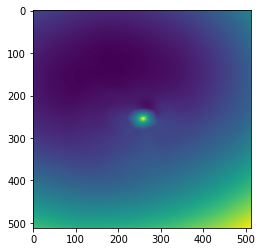

epoch 28301: 47.883304595947266
epoch 28302: 49.235923767089844
epoch 28303: 48.93404006958008
epoch 28304: 48.17267990112305
epoch 28305: 48.32536697387695
epoch 28306: 48.513145446777344
epoch 28307: 47.590736389160156
epoch 28308: 48.141788482666016
epoch 28309: 47.94681167602539
epoch 28311: 48.086307525634766
epoch 28312: 48.155818939208984
epoch 28313: 47.858154296875
epoch 28314: 47.7562255859375
epoch 28315: 48.30176544189453
epoch 28316: 48.51205825805664
epoch 28317: 47.78696060180664
epoch 28318: 49.136199951171875
epoch 28319: 48.534793853759766
epoch 28321: 47.325279235839844
epoch 28322: 48.035770416259766
epoch 28323: 49.193328857421875
epoch 28324: 47.962074279785156
epoch 28325: 48.44062805175781
epoch 28326: 47.25132369995117
epoch 28327: 47.631404876708984
epoch 28328: 47.94987487792969
epoch 28329: 48.73198699951172
epoch 28331: 47.06707763671875
epoch 28332: 48.305850982666016
epoch 28333: 48.37746047973633
epoch 28334: 51.755950927734375
epoch 28335: 47.8188247680

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



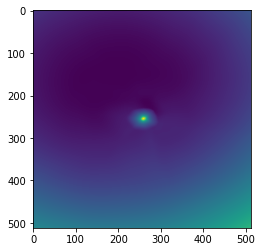

epoch 28401: 47.78852844238281
epoch 28402: 47.891021728515625
epoch 28403: 48.469146728515625
epoch 28404: 48.36868667602539
epoch 28405: 47.312313079833984
epoch 28406: 48.893367767333984
epoch 28407: 47.95955276489258
epoch 28408: 47.88250732421875
epoch 28409: 48.182647705078125
epoch 28411: 48.52067947387695
epoch 28412: 48.77384567260742
epoch 28413: 49.282379150390625
epoch 28414: 48.96279525756836
epoch 28415: 47.7700309753418
epoch 28416: 48.835426330566406
epoch 28417: 47.609458923339844
epoch 28418: 47.74748611450195
epoch 28419: 49.536869049072266
epoch 28421: 49.848323822021484
epoch 28422: 47.4453010559082
epoch 28423: 47.93806838989258
epoch 28424: 47.65153884887695
epoch 28425: 48.4605712890625
epoch 28426: 48.096466064453125
epoch 28427: 48.949737548828125
epoch 28428: 48.004791259765625
epoch 28429: 49.679534912109375
epoch 28431: 49.24843978881836
epoch 28432: 48.14070129394531
epoch 28433: 48.697906494140625
epoch 28434: 47.70155715942383
epoch 28435: 48.95240020751

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



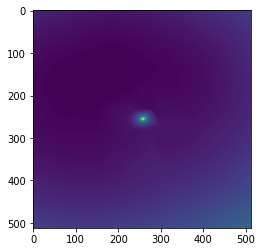

epoch 28501: 48.920814514160156
epoch 28502: 48.69386291503906
epoch 28503: 48.28569030761719
epoch 28504: 48.705291748046875
epoch 28505: 48.2913818359375
epoch 28506: 48.70930480957031
epoch 28507: 47.68495559692383
epoch 28508: 49.10810852050781
epoch 28509: 48.15605163574219
epoch 28511: 47.84685134887695
epoch 28512: 48.217430114746094
epoch 28513: 48.85509490966797
epoch 28514: 48.653350830078125
epoch 28515: 48.32786178588867
epoch 28516: 48.08395004272461
epoch 28517: 47.74242401123047
epoch 28518: 47.63233947753906
epoch 28519: 48.855712890625
epoch 28521: 48.43424987792969
epoch 28522: 48.91032028198242
epoch 28523: 48.13223648071289
epoch 28524: 49.11457824707031
epoch 28525: 47.8199577331543
epoch 28526: 47.39142608642578
epoch 28527: 49.41869354248047
epoch 28528: 47.70294952392578
epoch 28529: 47.644805908203125
epoch 28531: 47.605533599853516
epoch 28532: 47.98088455200195
epoch 28533: 48.30712127685547
epoch 28534: 47.38826370239258
epoch 28535: 48.00436019897461
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



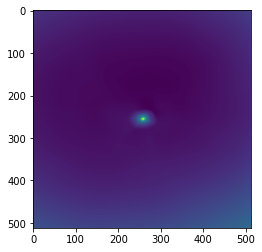

epoch 28601: 48.40056228637695
epoch 28602: 48.29922103881836
epoch 28603: 48.71708679199219
epoch 28604: 48.891517639160156
epoch 28605: 48.77260208129883
epoch 28606: 47.99535369873047
epoch 28607: 48.2128791809082
epoch 28608: 48.153743743896484
epoch 28609: 48.890403747558594
epoch 28611: 47.92473220825195
epoch 28612: 48.40059280395508
epoch 28613: 48.72581481933594
epoch 28614: 48.79448318481445
epoch 28615: 49.471771240234375
epoch 28616: 48.10979080200195
epoch 28617: 47.95768356323242
epoch 28618: 47.92356872558594
epoch 28619: 47.84062957763672
epoch 28621: 48.075401306152344
epoch 28622: 48.99714660644531
epoch 28623: 47.751163482666016
epoch 28624: 47.68705749511719
epoch 28625: 47.27827835083008
epoch 28626: 48.791465759277344
epoch 28627: 48.19377517700195
epoch 28628: 48.04753875732422
epoch 28629: 48.37704086303711
epoch 28631: 47.089622497558594
epoch 28632: 47.975624084472656
epoch 28633: 48.601322174072266
epoch 28634: 47.35642623901367
epoch 28635: 48.77338409423828

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



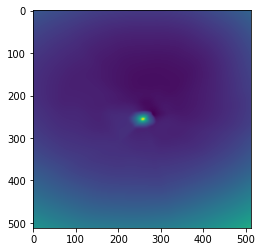

epoch 28701: 48.82765197753906
epoch 28702: 49.01785659790039
epoch 28703: 48.06360626220703
epoch 28704: 48.3795166015625
epoch 28705: 48.295589447021484
epoch 28706: 48.86337661743164
epoch 28707: 48.525535583496094
epoch 28708: 48.653995513916016
epoch 28709: 48.02708053588867
epoch 28711: 48.7431640625
epoch 28712: 48.67434310913086
epoch 28713: 48.22904968261719
epoch 28714: 49.36227035522461
epoch 28715: 47.600059509277344
epoch 28716: 48.23478317260742
epoch 28717: 48.792720794677734
epoch 28718: 49.15531921386719
epoch 28719: 48.375343322753906
epoch 28721: 47.977691650390625
epoch 28722: 48.359466552734375
epoch 28723: 48.619529724121094
epoch 28724: 47.911991119384766
epoch 28725: 48.162872314453125
epoch 28726: 48.952701568603516
epoch 28727: 48.41415023803711
epoch 28728: 48.833553314208984
epoch 28729: 48.79785919189453
epoch 28731: 49.61127853393555
epoch 28732: 47.48146057128906
epoch 28733: 47.54964065551758
epoch 28734: 47.6484375
epoch 28735: 47.845035552978516
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



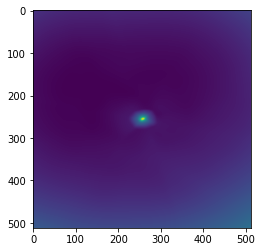

epoch 28801: 48.417884826660156
epoch 28802: 49.42168045043945
epoch 28803: 48.26393127441406
epoch 28804: 49.52898406982422
epoch 28805: 48.52086639404297
epoch 28806: 47.65800476074219
epoch 28807: 48.715518951416016
epoch 28808: 48.74054718017578
epoch 28809: 48.73024368286133
epoch 28811: 48.52006530761719
epoch 28812: 48.243473052978516
epoch 28813: 48.460357666015625
epoch 28814: 48.179412841796875
epoch 28815: 48.394962310791016
epoch 28816: 48.568973541259766
epoch 28817: 49.365665435791016
epoch 28818: 49.106689453125
epoch 28819: 47.67526626586914
epoch 28821: 48.80534744262695
epoch 28822: 47.6913948059082
epoch 28823: 48.209190368652344
epoch 28824: 48.817840576171875
epoch 28825: 47.290748596191406
epoch 28826: 47.79888153076172
epoch 28827: 49.183250427246094
epoch 28828: 48.3488655090332
epoch 28829: 49.281490325927734
epoch 28831: 48.654048919677734
epoch 28832: 49.401031494140625
epoch 28833: 48.97895431518555
epoch 28834: 49.001834869384766
epoch 28835: 48.87147521972

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



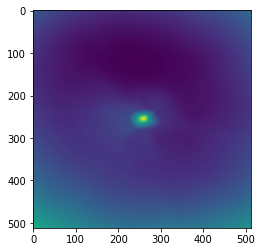

epoch 28901: 49.4596061706543
epoch 28902: 47.66782760620117
epoch 28903: 48.43306350708008
epoch 28904: 48.270206451416016
epoch 28905: 47.97151184082031
epoch 28906: 48.407989501953125
epoch 28907: 49.18575668334961
epoch 28908: 48.12733459472656
epoch 28909: 48.77629852294922
epoch 28911: 48.93536376953125
epoch 28912: 48.57756805419922
epoch 28913: 49.9610595703125
epoch 28914: 48.48613357543945
epoch 28915: 48.60810470581055
epoch 28916: 49.04113006591797
epoch 28917: 47.65645980834961
epoch 28918: 48.07594299316406
epoch 28919: 48.07127380371094
epoch 28921: 48.257450103759766
epoch 28922: 47.87814712524414
epoch 28923: 47.55447769165039
epoch 28924: 48.81118392944336
epoch 28925: 47.7473258972168
epoch 28926: 47.634586334228516
epoch 28927: 48.96659851074219
epoch 28928: 48.19499206542969
epoch 28929: 47.899375915527344
epoch 28931: 48.26303482055664
epoch 28932: 48.22322082519531
epoch 28933: 47.986602783203125
epoch 28934: 49.07160568237305
epoch 28935: 48.19936752319336
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



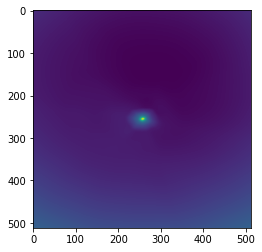

epoch 29001: 47.713768005371094
epoch 29002: 48.4387092590332
epoch 29003: 49.0999641418457
epoch 29004: 48.24440383911133
epoch 29005: 47.983795166015625
epoch 29006: 47.50813674926758
epoch 29007: 48.442543029785156
epoch 29008: 47.79393768310547
epoch 29009: 48.523963928222656
epoch 29011: 48.09687423706055
epoch 29012: 48.20845031738281
epoch 29013: 48.3698616027832
epoch 29014: 49.51750564575195
epoch 29015: 47.440345764160156
epoch 29016: 48.578617095947266
epoch 29017: 48.11116027832031
epoch 29018: 48.25300979614258
epoch 29019: 48.49305725097656
epoch 29021: 48.383056640625
epoch 29022: 47.79987716674805
epoch 29023: 48.36140441894531
epoch 29024: 48.15549087524414
epoch 29025: 47.92456817626953
epoch 29026: 46.87384033203125
epoch 29027: 48.47974395751953
epoch 29028: 47.52090835571289
epoch 29029: 48.14032745361328
epoch 29031: 48.199363708496094
epoch 29032: 48.2020263671875
epoch 29033: 48.26109313964844
epoch 29034: 48.990501403808594
epoch 29035: 50.08175277709961
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



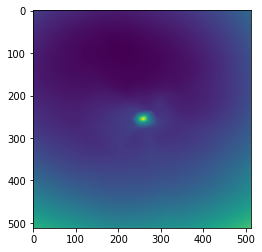

epoch 29101: 48.622825622558594
epoch 29102: 48.80415725708008
epoch 29103: 48.29012680053711
epoch 29104: 48.626380920410156
epoch 29105: 49.444305419921875
epoch 29106: 48.78962326049805
epoch 29107: 48.77374267578125
epoch 29108: 48.06403350830078
epoch 29109: 48.35325241088867
epoch 29111: 47.806396484375
epoch 29112: 47.7815055847168
epoch 29113: 48.12434387207031
epoch 29114: 48.70429611206055
epoch 29115: 49.691123962402344
epoch 29116: 48.16834259033203
epoch 29117: 48.334529876708984
epoch 29118: 47.97237014770508
epoch 29119: 48.330078125
epoch 29121: 48.12002182006836
epoch 29122: 47.6750602722168
epoch 29123: 48.59968566894531
epoch 29124: 47.65180969238281
epoch 29125: 48.229103088378906
epoch 29126: 48.26898956298828
epoch 29127: 48.66465377807617
epoch 29128: 48.92382049560547
epoch 29129: 48.74424362182617
epoch 29131: 48.3097038269043
epoch 29132: 48.18174743652344
epoch 29133: 48.19830322265625
epoch 29134: 48.48870086669922
epoch 29135: 48.44023895263672
epoch 29136:

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



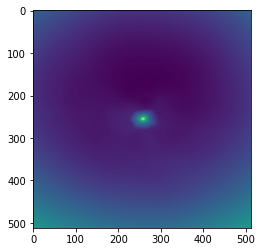

epoch 29201: 48.32773208618164
epoch 29202: 48.08181381225586
epoch 29203: 47.752532958984375
epoch 29204: 48.428890228271484
epoch 29205: 48.58271408081055
epoch 29206: 47.920352935791016
epoch 29207: 47.90852737426758
epoch 29208: 48.2080078125
epoch 29209: 48.09992980957031
epoch 29211: 47.95201873779297
epoch 29212: 48.1884651184082
epoch 29213: 47.78224563598633
epoch 29214: 48.27802658081055
epoch 29215: 47.960723876953125
epoch 29216: 48.44514083862305
epoch 29217: 47.32337188720703
epoch 29218: 48.5740966796875
epoch 29219: 48.428016662597656
epoch 29221: 48.32468032836914
epoch 29222: 47.92424774169922
epoch 29223: 47.642879486083984
epoch 29224: 48.20142364501953
epoch 29225: 48.973899841308594
epoch 29226: 48.03019332885742
epoch 29227: 48.973419189453125
epoch 29228: 47.916290283203125
epoch 29229: 48.38627624511719
epoch 29231: 48.14894104003906
epoch 29232: 48.11411666870117
epoch 29233: 48.10688400268555
epoch 29234: 48.49531173706055
epoch 29235: 47.84248352050781
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



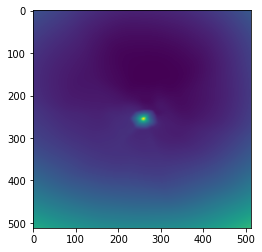

epoch 29301: 47.92565155029297
epoch 29302: 47.94519805908203
epoch 29303: 48.023170471191406
epoch 29304: 47.4686393737793
epoch 29305: 49.530311584472656
epoch 29306: 48.21794891357422
epoch 29307: 48.17765808105469
epoch 29308: 48.21645736694336
epoch 29309: 47.90335464477539
epoch 29311: 48.74752426147461
epoch 29312: 48.14446258544922
epoch 29313: 48.45943832397461
epoch 29314: 48.438560485839844
epoch 29315: 47.74179458618164
epoch 29316: 47.30221176147461
epoch 29317: 48.36892318725586
epoch 29318: 47.868404388427734
epoch 29319: 47.86279296875
epoch 29321: 47.41948318481445
epoch 29322: 47.71399688720703
epoch 29323: 48.29136657714844
epoch 29324: 48.478126525878906
epoch 29325: 47.88033676147461
epoch 29326: 47.42576599121094
epoch 29327: 48.28382873535156
epoch 29328: 48.062042236328125
epoch 29329: 51.75624465942383
epoch 29331: 47.723995208740234
epoch 29332: 47.27825927734375
epoch 29333: 48.73429870605469
epoch 29334: 48.038944244384766
epoch 29335: 47.521175384521484
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



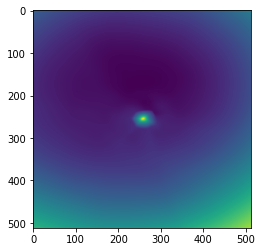

epoch 29401: 48.21558380126953
epoch 29402: 47.466617584228516
epoch 29403: 47.83725357055664
epoch 29404: 47.729957580566406
epoch 29405: 48.636844635009766
epoch 29406: 49.3380126953125
epoch 29407: 48.248287200927734
epoch 29408: 48.65187072753906
epoch 29409: 48.47577667236328
epoch 29411: 47.572784423828125
epoch 29412: 47.692909240722656
epoch 29413: 48.01366424560547
epoch 29414: 47.40785598754883
epoch 29415: 47.98409652709961
epoch 29416: 48.201942443847656
epoch 29417: 48.16075897216797
epoch 29418: 48.386756896972656
epoch 29419: 47.975860595703125
epoch 29421: 48.09592819213867
epoch 29422: 48.362762451171875
epoch 29423: 47.55105972290039
epoch 29424: 47.86540603637695
epoch 29425: 48.01017761230469
epoch 29426: 47.75803756713867
epoch 29427: 48.56840515136719
epoch 29428: 48.201568603515625
epoch 29429: 47.87000274658203
epoch 29431: 48.2200927734375
epoch 29432: 48.09456253051758
epoch 29433: 48.06492233276367
epoch 29434: 47.90440368652344
epoch 29435: 47.29480361938476

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



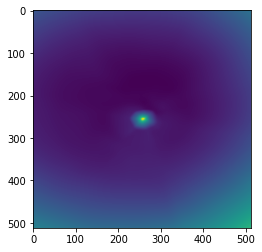

epoch 29501: 48.17782211303711
epoch 29502: 49.14450454711914
epoch 29503: 48.603275299072266
epoch 29504: 48.087379455566406
epoch 29505: 47.48402404785156
epoch 29506: 48.07527542114258
epoch 29507: 47.84621810913086
epoch 29508: 48.077091217041016
epoch 29509: 47.86174392700195
epoch 29511: 48.15028762817383
epoch 29512: 48.480525970458984
epoch 29513: 48.11447525024414
epoch 29514: 48.34761047363281
epoch 29515: 48.4047737121582
epoch 29516: 48.13129806518555
epoch 29517: 47.491886138916016
epoch 29518: 47.62234115600586
epoch 29519: 48.24012756347656
epoch 29521: 47.321712493896484
epoch 29522: 47.42322540283203
epoch 29523: 47.86846160888672
epoch 29524: 47.66379928588867
epoch 29525: 48.054195404052734
epoch 29526: 49.43938446044922
epoch 29527: 48.31712341308594
epoch 29528: 47.82644271850586
epoch 29529: 47.888790130615234
epoch 29531: 48.143096923828125
epoch 29532: 48.808021545410156
epoch 29533: 47.6646728515625
epoch 29534: 48.56332015991211
epoch 29535: 47.371578216552734

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



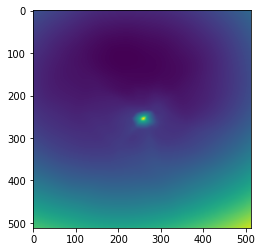

epoch 29601: 48.27766036987305
epoch 29602: 48.545166015625
epoch 29603: 47.81377029418945
epoch 29604: 48.30873107910156
epoch 29605: 48.03891372680664
epoch 29606: 48.56673812866211
epoch 29607: 48.3016471862793
epoch 29608: 48.77561569213867
epoch 29609: 47.211978912353516
epoch 29611: 47.199893951416016
epoch 29612: 48.592124938964844
epoch 29613: 48.01611328125
epoch 29614: 47.862064361572266
epoch 29615: 48.41048049926758
epoch 29616: 48.957942962646484
epoch 29617: 47.754878997802734
epoch 29618: 48.49201965332031
epoch 29619: 47.956111907958984
epoch 29621: 47.758697509765625
epoch 29622: 48.35201644897461
epoch 29623: 47.411434173583984
epoch 29624: 47.89236068725586
epoch 29625: 48.476593017578125
epoch 29626: 48.52836227416992
epoch 29627: 48.34890365600586
epoch 29628: 47.80390548706055
epoch 29629: 48.00580596923828
epoch 29631: 47.720298767089844
epoch 29632: 48.03430938720703
epoch 29633: 47.839603424072266
epoch 29634: 48.562049865722656
epoch 29635: 48.58983612060547
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



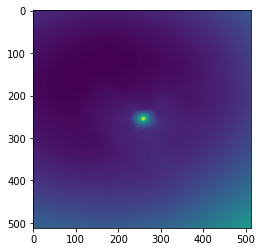

epoch 29701: 48.86164474487305
epoch 29702: 48.08773422241211
epoch 29703: 48.81064224243164
epoch 29704: 47.95612335205078
epoch 29705: 48.43356704711914
epoch 29706: 47.540225982666016
epoch 29707: 47.25825119018555
epoch 29708: 47.95886993408203
epoch 29709: 48.30946731567383
epoch 29711: 48.161190032958984
epoch 29712: 48.43069076538086
epoch 29713: 48.07167053222656
epoch 29714: 48.27431106567383
epoch 29715: 48.37921142578125
epoch 29716: 48.20128631591797
epoch 29717: 47.699947357177734
epoch 29718: 48.00133514404297
epoch 29719: 48.0496711730957
epoch 29721: 48.405677795410156
epoch 29722: 47.48027038574219
epoch 29723: 49.33650207519531
epoch 29724: 48.00532913208008
epoch 29725: 48.57984924316406
epoch 29726: 48.14008712768555
epoch 29727: 48.48377227783203
epoch 29728: 48.35576629638672
epoch 29729: 48.594112396240234
epoch 29731: 48.54209899902344
epoch 29732: 48.26357650756836
epoch 29733: 47.746803283691406
epoch 29734: 48.05887222290039
epoch 29735: 48.80105209350586
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



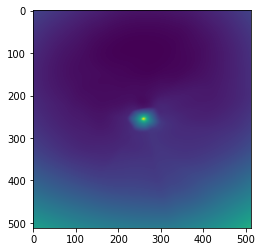

epoch 29801: 47.741241455078125
epoch 29802: 48.60719299316406
epoch 29803: 48.10714340209961
epoch 29804: 49.24987030029297
epoch 29805: 48.014400482177734
epoch 29806: 48.48106002807617
epoch 29807: 47.67938995361328
epoch 29808: 47.73455047607422
epoch 29809: 48.58694076538086
epoch 29811: 47.78904342651367
epoch 29812: 47.67164993286133
epoch 29813: 48.808712005615234
epoch 29814: 48.276283264160156
epoch 29815: 49.38881301879883
epoch 29816: 47.969627380371094
epoch 29817: 49.570865631103516
epoch 29818: 50.24338150024414
epoch 29819: 48.3488655090332
epoch 29821: 47.42914962768555
epoch 29822: 47.855525970458984
epoch 29823: 48.175453186035156
epoch 29824: 47.361873626708984
epoch 29825: 48.20951843261719
epoch 29826: 48.449214935302734
epoch 29827: 49.50706481933594
epoch 29828: 48.2574348449707
epoch 29829: 48.186798095703125
epoch 29831: 47.80339813232422
epoch 29832: 47.790897369384766
epoch 29833: 48.34054946899414
epoch 29834: 48.659820556640625
epoch 29835: 48.524612426757

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



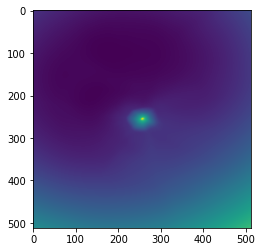

epoch 29901: 47.33685302734375
epoch 29902: 48.60908508300781
epoch 29903: 48.696929931640625
epoch 29904: 47.46938705444336
epoch 29905: 48.42698287963867
epoch 29906: 47.83149719238281
epoch 29907: 50.050880432128906
epoch 29908: 48.34746551513672
epoch 29909: 48.196781158447266
epoch 29911: 49.2498779296875
epoch 29912: 49.036346435546875
epoch 29913: 48.56140899658203
epoch 29914: 48.21821594238281
epoch 29915: 48.05691909790039
epoch 29916: 47.53569412231445
epoch 29917: 47.80464172363281
epoch 29918: 48.06863021850586
epoch 29919: 47.725608825683594
epoch 29921: 48.38302993774414
epoch 29922: 48.21786880493164
epoch 29923: 48.59549331665039
epoch 29924: 48.322021484375
epoch 29925: 48.5224494934082
epoch 29926: 48.08656692504883
epoch 29927: 48.834293365478516
epoch 29928: 48.815086364746094
epoch 29929: 47.854244232177734
epoch 29931: 48.2243537902832
epoch 29932: 47.768959045410156
epoch 29933: 48.170326232910156
epoch 29934: 47.79396057128906
epoch 29935: 47.909446716308594
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



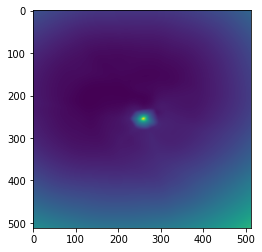

epoch 30001: 48.001670837402344
epoch 30002: 48.60748291015625
epoch 30003: 47.79606246948242
epoch 30004: 48.23575973510742
epoch 30005: 47.602394104003906
epoch 30006: 48.42203140258789
epoch 30007: 48.59599304199219
epoch 30008: 49.02109909057617
epoch 30009: 51.848968505859375
epoch 30011: 50.250518798828125
epoch 30012: 47.83770751953125
epoch 30013: 48.730709075927734
epoch 30014: 48.61875915527344
epoch 30015: 48.916446685791016
epoch 30016: 49.39726257324219
epoch 30017: 49.12259292602539
epoch 30018: 48.97381591796875
epoch 30019: 49.341102600097656
epoch 30021: 48.70292282104492
epoch 30022: 47.76335525512695
epoch 30023: 48.85927963256836
epoch 30024: 48.912105560302734
epoch 30025: 49.772132873535156
epoch 30026: 48.630619049072266
epoch 30027: 48.15801239013672
epoch 30028: 48.965946197509766
epoch 30029: 48.69282150268555
epoch 30031: 48.45479202270508
epoch 30032: 48.163997650146484
epoch 30033: 48.36280822753906
epoch 30034: 48.004695892333984
epoch 30035: 48.1244239807

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



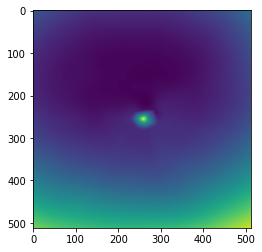

epoch 30101: 48.977073669433594
epoch 30102: 47.93943786621094
epoch 30103: 48.20988082885742
epoch 30104: 47.79597854614258
epoch 30105: 47.58887481689453
epoch 30106: 48.03407287597656
epoch 30107: 48.487693786621094
epoch 30108: 48.272743225097656
epoch 30109: 48.470558166503906
epoch 30111: 48.66891098022461
epoch 30112: 48.73259353637695
epoch 30113: 47.31843948364258
epoch 30114: 48.25190353393555
epoch 30115: 48.406333923339844
epoch 30116: 48.39481735229492
epoch 30117: 48.276512145996094
epoch 30118: 48.36431121826172
epoch 30119: 48.085269927978516
epoch 30121: 48.113895416259766
epoch 30122: 48.23598861694336
epoch 30123: 48.54481887817383
epoch 30124: 47.87152099609375
epoch 30125: 47.31073760986328
epoch 30126: 48.19578170776367
epoch 30127: 48.734458923339844
epoch 30128: 48.17662048339844
epoch 30129: 48.383426666259766
epoch 30131: 49.00104904174805
epoch 30132: 48.438453674316406
epoch 30133: 47.42410659790039
epoch 30134: 48.12953186035156
epoch 30135: 48.454639434814

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



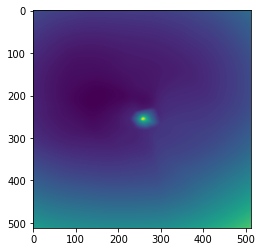

epoch 30201: 48.23091125488281
epoch 30202: 47.896671295166016
epoch 30203: 48.431732177734375
epoch 30204: 49.07668685913086
epoch 30205: 47.34452438354492
epoch 30206: 47.98126220703125
epoch 30207: 48.68494415283203
epoch 30208: 47.82789993286133
epoch 30209: 48.2782096862793
epoch 30211: 47.64789581298828
epoch 30212: 48.422203063964844
epoch 30213: 47.49555587768555
epoch 30214: 48.24369812011719
epoch 30215: 48.0390625
epoch 30216: 47.91961669921875
epoch 30217: 48.26455307006836
epoch 30218: 48.12294006347656
epoch 30219: 49.14262771606445
epoch 30221: 48.30207061767578
epoch 30222: 48.09144592285156
epoch 30223: 47.93072509765625
epoch 30224: 48.45092010498047
epoch 30225: 48.34354019165039
epoch 30226: 51.14165496826172
epoch 30227: 48.5681037902832
epoch 30228: 48.39107894897461
epoch 30229: 48.133514404296875
epoch 30231: 47.3564338684082
epoch 30232: 48.66962814331055
epoch 30233: 48.4549674987793
epoch 30234: 48.168914794921875
epoch 30235: 49.38571548461914
epoch 30236: 4

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



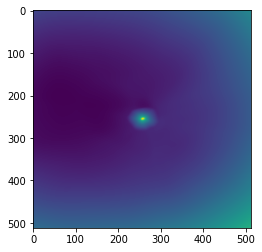

epoch 30301: 47.88116455078125
epoch 30302: 48.39534378051758
epoch 30303: 48.68065643310547
epoch 30304: 48.07062530517578
epoch 30305: 48.42010498046875
epoch 30306: 48.09577178955078
epoch 30307: 48.247589111328125
epoch 30308: 48.39728927612305
epoch 30309: 48.24171829223633
epoch 30311: 48.75731658935547
epoch 30312: 47.97742462158203
epoch 30313: 48.94316101074219
epoch 30314: 47.73814010620117
epoch 30315: 48.199729919433594
epoch 30316: 47.80018615722656
epoch 30317: 48.05852508544922
epoch 30318: 47.97040557861328
epoch 30319: 48.36296844482422
epoch 30321: 48.37038803100586
epoch 30322: 48.06410217285156
epoch 30323: 48.3474006652832
epoch 30324: 48.429927825927734
epoch 30325: 48.23434066772461
epoch 30326: 48.42222213745117
epoch 30327: 47.91637420654297
epoch 30328: 48.2157096862793
epoch 30329: 53.468929290771484
epoch 30331: 47.952880859375
epoch 30332: 49.20427322387695
epoch 30333: 48.49338150024414
epoch 30334: 48.16838836669922
epoch 30335: 47.79121780395508
epoch 30

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



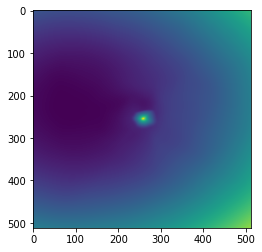

epoch 30401: 48.32313919067383
epoch 30402: 47.809295654296875
epoch 30403: 48.59331512451172
epoch 30404: 48.86528396606445
epoch 30405: 48.671478271484375
epoch 30406: 48.17763137817383
epoch 30407: 49.78459167480469
epoch 30408: 47.59737777709961
epoch 30409: 47.912391662597656
epoch 30411: 48.43782424926758
epoch 30412: 48.13747024536133
epoch 30413: 48.621498107910156
epoch 30414: 47.81271743774414
epoch 30415: 47.41161346435547
epoch 30416: 48.004600524902344
epoch 30417: 47.69980239868164
epoch 30418: 47.93639373779297
epoch 30419: 48.20327377319336
epoch 30421: 48.49163818359375
epoch 30422: 47.68947982788086
epoch 30423: 48.422733306884766
epoch 30424: 48.7686653137207
epoch 30425: 48.267250061035156
epoch 30426: 48.872215270996094
epoch 30427: 48.418663024902344
epoch 30428: 48.878475189208984
epoch 30429: 49.010902404785156
epoch 30431: 48.17683029174805
epoch 30432: 48.25603103637695
epoch 30433: 48.510929107666016
epoch 30434: 48.45110321044922
epoch 30435: 49.866096496582

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



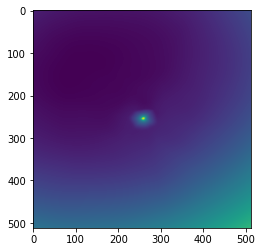

epoch 30501: 47.96461486816406
epoch 30502: 47.68574905395508
epoch 30503: 47.705963134765625
epoch 30504: 48.506248474121094
epoch 30505: 48.46079635620117
epoch 30506: 49.3941535949707
epoch 30507: 48.26649856567383
epoch 30508: 48.33171081542969
epoch 30509: 48.10573959350586
epoch 30511: 48.1786003112793
epoch 30512: 47.989891052246094
epoch 30513: 48.362892150878906
epoch 30514: 47.87675857543945
epoch 30515: 48.240257263183594
epoch 30516: 48.19725036621094
epoch 30517: 49.04248046875
epoch 30518: 48.112876892089844
epoch 30519: 48.55648422241211
epoch 30521: 50.07210159301758
epoch 30522: 48.26962661743164
epoch 30523: 48.994781494140625
epoch 30524: 47.96591567993164
epoch 30525: 47.49742889404297
epoch 30526: 48.89466094970703
epoch 30527: 47.8997802734375
epoch 30528: 48.608463287353516
epoch 30529: 48.96902084350586
epoch 30531: 48.928016662597656
epoch 30532: 48.654884338378906
epoch 30533: 47.84587097167969
epoch 30534: 48.47153854370117
epoch 30535: 48.149879455566406
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



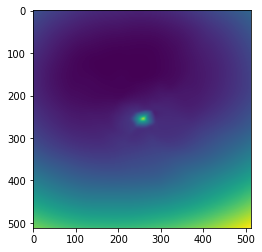

epoch 30601: 48.04745864868164
epoch 30602: 47.56292724609375
epoch 30603: 48.92094802856445
epoch 30604: 47.98215103149414
epoch 30605: 48.612186431884766
epoch 30606: 48.787654876708984
epoch 30607: 48.18706130981445
epoch 30608: 48.32069396972656
epoch 30609: 47.17045211791992
epoch 30611: 48.74424362182617
epoch 30612: 48.786590576171875
epoch 30613: 49.215328216552734
epoch 30614: 47.738441467285156
epoch 30615: 48.181175231933594
epoch 30616: 48.674869537353516
epoch 30617: 48.09203338623047
epoch 30618: 48.028995513916016
epoch 30619: 49.11112976074219
epoch 30621: 48.31654357910156
epoch 30622: 47.964393615722656
epoch 30623: 48.284446716308594
epoch 30624: 48.1719970703125
epoch 30625: 48.90643310546875
epoch 30626: 48.34977340698242
epoch 30627: 47.569522857666016
epoch 30628: 48.39737319946289
epoch 30629: 48.58769989013672
epoch 30631: 48.55951690673828
epoch 30632: 47.505218505859375
epoch 30633: 47.67335510253906
epoch 30634: 48.162330627441406
epoch 30635: 48.06449508666

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



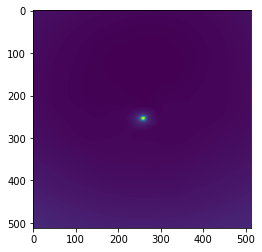

epoch 30701: 49.01226043701172
epoch 30702: 48.58432388305664
epoch 30703: 48.7328987121582
epoch 30704: 48.58298110961914
epoch 30705: 48.9232177734375
epoch 30706: 49.24421691894531
epoch 30707: 48.29971694946289
epoch 30708: 48.13847732543945
epoch 30709: 48.73801040649414
epoch 30711: 48.300941467285156
epoch 30712: 49.11199951171875
epoch 30713: 49.18662643432617
epoch 30714: 48.86466598510742
epoch 30715: 48.31559371948242
epoch 30716: 48.41474914550781
epoch 30717: 48.576416015625
epoch 30718: 48.5877799987793
epoch 30719: 48.17711639404297
epoch 30721: 49.29474639892578
epoch 30722: 48.212745666503906
epoch 30723: 48.644840240478516
epoch 30724: 48.77230453491211
epoch 30725: 48.350746154785156
epoch 30726: 48.47068786621094
epoch 30727: 48.47811508178711
epoch 30728: 47.69414520263672
epoch 30729: 49.443153381347656
epoch 30731: 47.819313049316406
epoch 30732: 47.773536682128906
epoch 30733: 48.5915412902832
epoch 30734: 48.23772430419922
epoch 30735: 47.319828033447266
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



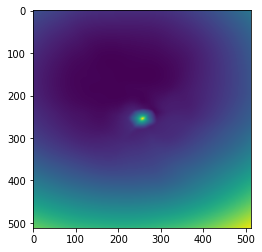

epoch 30801: 47.918251037597656
epoch 30802: 48.29958724975586
epoch 30803: 48.69892883300781
epoch 30804: 48.08700180053711
epoch 30805: 47.820838928222656
epoch 30806: 48.221595764160156
epoch 30807: 49.30717086791992
epoch 30808: 49.313411712646484
epoch 30809: 48.43339920043945
epoch 30811: 48.25514602661133
epoch 30812: 48.73961639404297
epoch 30813: 47.33822250366211
epoch 30814: 47.96330642700195
epoch 30815: 48.19505310058594
epoch 30816: 47.53331756591797
epoch 30817: 47.95250701904297
epoch 30818: 47.848541259765625
epoch 30819: 48.656986236572266
epoch 30821: 49.21769714355469
epoch 30822: 48.29600524902344
epoch 30823: 47.48664855957031
epoch 30824: 47.72816467285156
epoch 30825: 48.021240234375
epoch 30826: 48.152339935302734
epoch 30827: 49.52614974975586
epoch 30828: 49.28438949584961
epoch 30829: 51.00380325317383
epoch 30831: 48.0599479675293
epoch 30832: 47.92903518676758
epoch 30833: 48.11190414428711
epoch 30834: 48.81370162963867
epoch 30835: 48.11386489868164
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



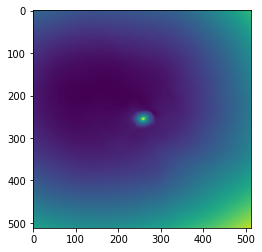

epoch 30901: 48.456077575683594
epoch 30902: 48.3521728515625
epoch 30903: 48.57906723022461
epoch 30904: 48.31840515136719
epoch 30905: 49.00437927246094
epoch 30906: 49.27278137207031
epoch 30907: 48.48246765136719
epoch 30908: 48.305450439453125
epoch 30909: 48.45664596557617
epoch 30911: 48.39736557006836
epoch 30912: 47.21601104736328
epoch 30913: 48.62954330444336
epoch 30914: 48.2825813293457
epoch 30915: 48.486000061035156
epoch 30916: 48.77616882324219
epoch 30917: 48.155426025390625
epoch 30918: 48.22698974609375
epoch 30919: 47.948177337646484
epoch 30921: 47.99441909790039
epoch 30922: 48.110252380371094
epoch 30923: 48.8712272644043
epoch 30924: 48.86593246459961
epoch 30925: 48.28480529785156
epoch 30926: 48.39925003051758
epoch 30927: 49.11962890625
epoch 30928: 48.448143005371094
epoch 30929: 48.56401062011719
epoch 30931: 48.69222640991211
epoch 30932: 48.486412048339844
epoch 30933: 47.19020462036133
epoch 30934: 48.27602767944336
epoch 30935: 47.45921325683594
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



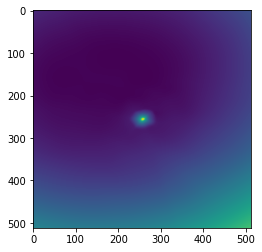

epoch 31001: 47.912872314453125
epoch 31002: 48.479461669921875
epoch 31003: 48.35393524169922
epoch 31004: 48.1766357421875
epoch 31005: 48.179847717285156
epoch 31006: 47.921390533447266
epoch 31007: 48.38395309448242
epoch 31008: 47.886878967285156
epoch 31009: 48.048465728759766
epoch 31011: 48.70431900024414
epoch 31012: 48.57781982421875
epoch 31013: 48.683837890625
epoch 31014: 48.26753616333008
epoch 31015: 48.33037567138672
epoch 31016: 47.76411819458008
epoch 31017: 47.66122817993164
epoch 31018: 48.35402297973633
epoch 31019: 49.2642822265625
epoch 31021: 47.89630889892578
epoch 31022: 48.60944366455078
epoch 31023: 49.13666915893555
epoch 31024: 48.70384979248047
epoch 31025: 48.69956970214844
epoch 31026: 48.37381362915039
epoch 31027: 48.142494201660156
epoch 31028: 48.929264068603516
epoch 31029: 48.45532989501953
epoch 31031: 47.39580154418945
epoch 31032: 48.04896545410156
epoch 31033: 47.782806396484375
epoch 31034: 47.72208786010742
epoch 31035: 48.99737548828125
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



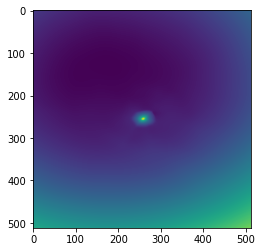

epoch 31101: 47.8376350402832
epoch 31102: 48.61381530761719
epoch 31103: 48.612693786621094
epoch 31104: 48.1994514465332
epoch 31105: 49.33441162109375
epoch 31106: 47.57242965698242
epoch 31107: 47.685325622558594
epoch 31108: 48.61809539794922
epoch 31109: 48.79114532470703
epoch 31111: 48.55595779418945
epoch 31112: 48.539703369140625
epoch 31113: 48.27223205566406
epoch 31114: 48.163841247558594
epoch 31115: 47.216087341308594
epoch 31116: 48.41074752807617
epoch 31117: 48.20841598510742
epoch 31118: 48.426795959472656
epoch 31119: 47.98290252685547
epoch 31121: 47.814353942871094
epoch 31122: 48.77106857299805
epoch 31123: 48.69640350341797
epoch 31124: 48.90378952026367
epoch 31125: 48.558956146240234
epoch 31126: 48.02605438232422
epoch 31127: 48.47569274902344
epoch 31128: 49.830810546875
epoch 31129: 48.14564895629883
epoch 31131: 49.001651763916016
epoch 31132: 48.16018295288086
epoch 31133: 47.954017639160156
epoch 31134: 48.32332229614258
epoch 31135: 48.32632827758789
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



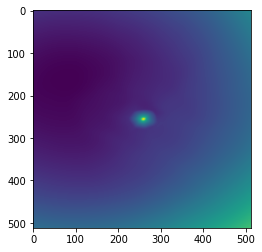

epoch 31201: 48.40903854370117
epoch 31202: 48.3957633972168
epoch 31203: 47.71843719482422
epoch 31204: 47.99234390258789
epoch 31205: 48.21529006958008
epoch 31206: 48.49432373046875
epoch 31207: 48.523624420166016
epoch 31208: 48.72096252441406
epoch 31209: 48.437347412109375
epoch 31211: 47.79918670654297
epoch 31212: 48.50442886352539
epoch 31213: 47.96508026123047
epoch 31214: 48.093467712402344
epoch 31215: 47.79557800292969
epoch 31216: 48.216609954833984
epoch 31217: 47.68862533569336
epoch 31218: 48.97939682006836
epoch 31219: 48.32164001464844
epoch 31221: 48.08979415893555
epoch 31222: 48.3935546875
epoch 31223: 48.179771423339844
epoch 31224: 48.27299499511719
epoch 31225: 47.35173034667969
epoch 31226: 48.4752197265625
epoch 31227: 47.66613006591797
epoch 31228: 48.345577239990234
epoch 31229: 47.880306243896484
epoch 31231: 47.42258071899414
epoch 31232: 47.27066421508789
epoch 31233: 47.75076675415039
epoch 31234: 48.463645935058594
epoch 31235: 47.71504592895508
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



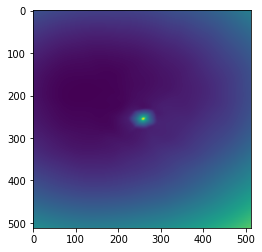

epoch 31301: 48.20615005493164
epoch 31302: 47.93083572387695
epoch 31303: 47.31324005126953
epoch 31304: 47.416229248046875
epoch 31305: 47.76250076293945
epoch 31306: 47.88432693481445
epoch 31307: 49.239925384521484
epoch 31308: 47.3921012878418
epoch 31309: 47.717735290527344
epoch 31311: 47.938419342041016
epoch 31312: 47.99980926513672
epoch 31313: 48.30463790893555
epoch 31314: 48.17900848388672
epoch 31315: 48.142879486083984
epoch 31316: 47.911380767822266
epoch 31317: 48.51108169555664
epoch 31318: 48.25099563598633
epoch 31319: 47.52846908569336
epoch 31321: 48.257877349853516
epoch 31322: 48.41706085205078
epoch 31323: 48.23088073730469
epoch 31324: 47.833106994628906
epoch 31325: 48.15555191040039
epoch 31326: 47.75986099243164
epoch 31327: 47.19748306274414
epoch 31328: 47.930519104003906
epoch 31329: 47.57560348510742
epoch 31331: 48.374267578125
epoch 31332: 47.71004104614258
epoch 31333: 48.229705810546875
epoch 31334: 48.48089599609375
epoch 31335: 47.82533264160156
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



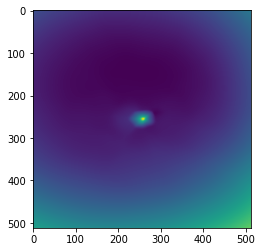

epoch 31401: 50.07826614379883
epoch 31402: 48.462684631347656
epoch 31403: 48.913604736328125
epoch 31404: 48.695335388183594
epoch 31405: 48.08359146118164
epoch 31406: 48.19097137451172
epoch 31407: 48.412235260009766
epoch 31408: 48.264949798583984
epoch 31409: 47.81303405761719
epoch 31411: 48.27511978149414
epoch 31412: 47.952537536621094
epoch 31413: 48.62495422363281
epoch 31414: 48.361244201660156
epoch 31415: 48.397186279296875
epoch 31416: 47.741111755371094
epoch 31417: 48.77397537231445
epoch 31418: 48.55024337768555
epoch 31419: 48.59100341796875
epoch 31421: 47.72263717651367
epoch 31422: 48.766868591308594
epoch 31423: 47.760257720947266
epoch 31424: 48.084983825683594
epoch 31425: 48.43619155883789
epoch 31426: 47.5821533203125
epoch 31427: 48.651336669921875
epoch 31428: 47.89238739013672
epoch 31429: 47.967594146728516
epoch 31431: 48.437843322753906
epoch 31432: 48.96012878417969
epoch 31433: 50.82475662231445
epoch 31434: 49.111785888671875
epoch 31435: 47.79132461

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



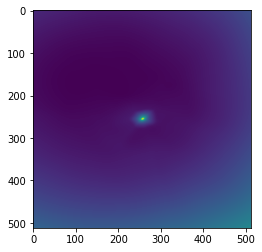

epoch 31501: 48.02370834350586
epoch 31502: 48.472869873046875
epoch 31503: 49.012306213378906
epoch 31504: 47.80286407470703
epoch 31505: 48.381778717041016
epoch 31506: 49.98212814331055
epoch 31507: 47.576961517333984
epoch 31508: 48.462684631347656
epoch 31509: 47.84489440917969
epoch 31511: 48.194339752197266
epoch 31512: 47.945777893066406
epoch 31513: 48.71479797363281
epoch 31514: 47.82511901855469
epoch 31515: 48.1221923828125
epoch 31516: 47.8692512512207
epoch 31517: 47.610321044921875
epoch 31518: 47.54335021972656
epoch 31519: 47.7843132019043
epoch 31521: 48.506507873535156
epoch 31522: 48.872074127197266
epoch 31523: 48.37211227416992
epoch 31524: 49.043636322021484
epoch 31525: 48.58807373046875
epoch 31526: 47.756324768066406
epoch 31527: 47.92361831665039
epoch 31528: 46.91960144042969
epoch 31529: 47.99946975708008
epoch 31531: 49.30937194824219
epoch 31532: 47.95587921142578
epoch 31533: 47.65650177001953
epoch 31534: 48.23735809326172
epoch 31535: 48.40280914306640

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



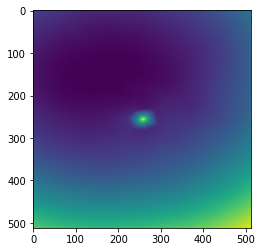

epoch 31601: 49.1916618347168
epoch 31602: 48.9720573425293
epoch 31603: 48.12399673461914
epoch 31604: 47.65305709838867
epoch 31605: 48.62833786010742
epoch 31606: 47.75999450683594
epoch 31607: 48.17478942871094
epoch 31608: 49.4866943359375
epoch 31609: 48.67839050292969
epoch 31611: 48.8975715637207
epoch 31612: 48.070064544677734
epoch 31613: 48.2182502746582
epoch 31614: 48.08019256591797
epoch 31615: 50.245750427246094
epoch 31616: 48.02546691894531
epoch 31617: 49.100013732910156
epoch 31618: 47.71725082397461
epoch 31619: 48.60615539550781
epoch 31621: 49.50285720825195
epoch 31622: 49.902984619140625
epoch 31623: 48.351688385009766
epoch 31624: 48.30217742919922
epoch 31625: 49.53373336791992
epoch 31626: 48.146541595458984
epoch 31627: 48.00519943237305
epoch 31628: 47.654911041259766
epoch 31629: 48.51435852050781
epoch 31631: 48.116031646728516
epoch 31632: 47.72044372558594
epoch 31633: 48.461830139160156
epoch 31634: 48.15186309814453
epoch 31635: 48.195682525634766
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



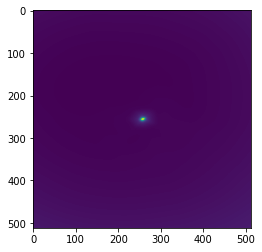

epoch 31701: 47.74875259399414
epoch 31702: 48.44641876220703
epoch 31703: 48.32975387573242
epoch 31704: 47.70103073120117
epoch 31705: 48.56690979003906
epoch 31706: 48.24211120605469
epoch 31707: 47.72592544555664
epoch 31708: 49.09748840332031
epoch 31709: 48.655609130859375
epoch 31711: 47.506107330322266
epoch 31712: 48.02897644042969
epoch 31713: 48.152103424072266
epoch 31714: 47.97681427001953
epoch 31715: 48.1085319519043
epoch 31716: 48.33924102783203
epoch 31717: 48.20653533935547
epoch 31718: 48.189002990722656
epoch 31719: 47.93389892578125
epoch 31721: 48.61973190307617
epoch 31722: 47.424468994140625
epoch 31723: 47.59493637084961
epoch 31724: 48.125328063964844
epoch 31725: 48.38664245605469
epoch 31726: 48.24617004394531
epoch 31727: 48.19843673706055
epoch 31728: 48.54740905761719
epoch 31729: 48.0865478515625
epoch 31731: 47.83970260620117
epoch 31732: 48.91945266723633
epoch 31733: 47.70159149169922
epoch 31734: 48.42835235595703
epoch 31735: 48.451175689697266
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



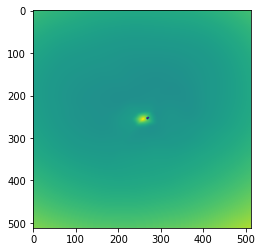

epoch 31801: 48.25319290161133
epoch 31802: 48.260929107666016
epoch 31803: 48.262664794921875
epoch 31804: 48.871253967285156
epoch 31805: 48.86555099487305
epoch 31806: 48.59347915649414
epoch 31807: 48.23286437988281
epoch 31808: 49.09693145751953
epoch 31809: 48.57706069946289
epoch 31811: 48.894615173339844
epoch 31812: 50.8140754699707
epoch 31813: 48.34157943725586
epoch 31814: 48.43352127075195
epoch 31815: 48.345008850097656
epoch 31816: 48.530235290527344
epoch 31817: 48.350948333740234
epoch 31818: 48.4316291809082
epoch 31819: 49.35783386230469
epoch 31821: 49.442623138427734
epoch 31822: 48.02740478515625
epoch 31823: 48.35521697998047
epoch 31824: 48.47467041015625
epoch 31825: 48.070396423339844
epoch 31826: 48.28460693359375
epoch 31827: 48.311737060546875
epoch 31828: 48.222991943359375
epoch 31829: 48.74443054199219
epoch 31831: 48.317474365234375
epoch 31832: 48.427162170410156
epoch 31833: 48.737884521484375
epoch 31834: 47.6900634765625
epoch 31835: 48.183010101318

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



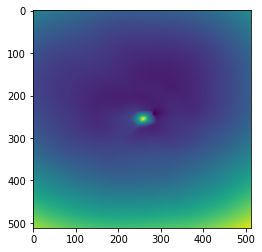

epoch 31901: 48.2564582824707
epoch 31902: 48.62507629394531
epoch 31903: 48.579830169677734
epoch 31904: 48.040809631347656
epoch 31905: 48.7088737487793
epoch 31906: 47.964439392089844
epoch 31907: 48.68880081176758
epoch 31908: 48.78018569946289
epoch 31909: 48.710445404052734
epoch 31911: 48.21138381958008
epoch 31912: 48.02424621582031
epoch 31913: 48.414546966552734
epoch 31914: 48.63218688964844
epoch 31915: 47.71218490600586
epoch 31916: 48.02140808105469
epoch 31917: 48.50470733642578
epoch 31918: 47.98048400878906
epoch 31919: 48.02752685546875
epoch 31921: 48.40628433227539
epoch 31922: 48.01615905761719
epoch 31923: 48.574119567871094
epoch 31924: 47.415340423583984
epoch 31925: 47.74824142456055
epoch 31926: 51.98957443237305
epoch 31927: 48.69725036621094
epoch 31928: 48.107215881347656
epoch 31929: 47.884273529052734
epoch 31931: 48.7326545715332
epoch 31932: 47.94758987426758
epoch 31933: 48.177127838134766
epoch 31934: 48.48146438598633
epoch 31935: 48.11094284057617
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



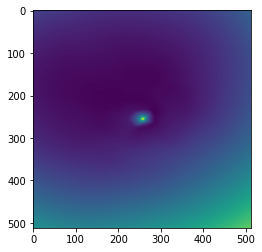

epoch 32001: 48.0728759765625
epoch 32002: 48.91763687133789
epoch 32003: 48.57373046875
epoch 32004: 49.22114944458008
epoch 32005: 48.28742218017578
epoch 32006: 49.09193420410156
epoch 32007: 48.50147247314453
epoch 32008: 48.06193161010742
epoch 32009: 48.24104309082031
epoch 32011: 48.66651916503906
epoch 32012: 48.355491638183594
epoch 32013: 47.783878326416016
epoch 32014: 48.69020462036133
epoch 32015: 48.21906280517578
epoch 32016: 48.634376525878906
epoch 32017: 48.086097717285156
epoch 32018: 47.7777214050293
epoch 32019: 48.249900817871094
epoch 32021: 47.653228759765625
epoch 32022: 49.260040283203125
epoch 32023: 47.768043518066406
epoch 32024: 48.64610290527344
epoch 32025: 47.40294647216797
epoch 32026: 47.731712341308594
epoch 32027: 48.0501823425293
epoch 32028: 48.611732482910156
epoch 32029: 48.108642578125
epoch 32031: 48.29506301879883
epoch 32032: 48.78700256347656
epoch 32033: 48.870811462402344
epoch 32034: 48.056488037109375
epoch 32035: 48.16194152832031
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



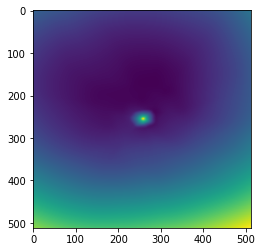

epoch 32101: 48.24137878417969
epoch 32102: 48.086708068847656
epoch 32103: 47.985408782958984
epoch 32104: 48.1203727722168
epoch 32105: 48.59941101074219
epoch 32106: 48.05658721923828
epoch 32107: 48.12488555908203
epoch 32108: 47.3667106628418
epoch 32109: 48.236114501953125
epoch 32111: 51.51007843017578
epoch 32112: 47.74546813964844
epoch 32113: 48.000911712646484
epoch 32114: 48.485565185546875
epoch 32115: 48.310970306396484
epoch 32116: 48.22678756713867
epoch 32117: 47.6406135559082
epoch 32118: 47.38351821899414
epoch 32119: 48.73227310180664
epoch 32121: 47.85556411743164
epoch 32122: 48.92302322387695
epoch 32123: 48.40245819091797
epoch 32124: 48.308753967285156
epoch 32125: 48.81527328491211
epoch 32126: 48.444496154785156
epoch 32127: 48.978824615478516
epoch 32128: 48.84417724609375
epoch 32129: 48.59117889404297
epoch 32131: 48.62025451660156
epoch 32132: 48.807472229003906
epoch 32133: 47.8710823059082
epoch 32134: 48.20756149291992
epoch 32135: 47.97292709350586
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



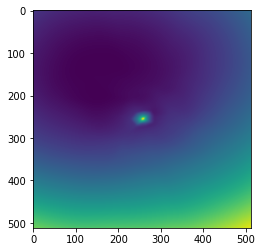

epoch 32201: 47.83588790893555
epoch 32202: 48.77851867675781
epoch 32203: 48.42261505126953
epoch 32204: 47.97942352294922
epoch 32205: 47.78463363647461
epoch 32206: 49.01406478881836
epoch 32207: 48.62470245361328
epoch 32208: 47.951560974121094
epoch 32209: 50.131919860839844
epoch 32211: 49.68711853027344
epoch 32212: 48.873207092285156
epoch 32213: 48.651851654052734
epoch 32214: 49.494239807128906
epoch 32215: 48.9818115234375
epoch 32216: 48.80645751953125
epoch 32217: 48.06203842163086
epoch 32218: 48.648319244384766
epoch 32219: 48.877750396728516
epoch 32221: 48.319313049316406
epoch 32222: 47.90567398071289
epoch 32223: 49.16843795776367
epoch 32224: 48.907772064208984
epoch 32225: 49.17177963256836
epoch 32226: 47.95623779296875
epoch 32227: 49.265953063964844
epoch 32228: 48.40815353393555
epoch 32229: 48.61750030517578
epoch 32231: 48.180320739746094
epoch 32232: 48.8265495300293
epoch 32233: 48.3372688293457
epoch 32234: 48.47075653076172
epoch 32235: 48.17120361328125


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



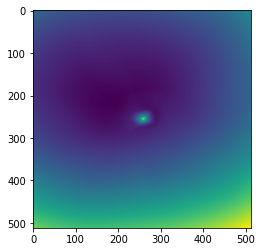

epoch 32301: 48.561973571777344
epoch 32302: 47.72412872314453
epoch 32303: 49.4834098815918
epoch 32304: 47.594520568847656
epoch 32305: 48.80451965332031
epoch 32306: 48.70563888549805
epoch 32307: 49.06386184692383
epoch 32308: 48.34526824951172
epoch 32309: 49.20417404174805
epoch 32311: 47.67741394042969
epoch 32312: 47.43809127807617
epoch 32313: 47.82988739013672
epoch 32314: 47.76291275024414
epoch 32315: 48.08407211303711
epoch 32316: 48.41835021972656
epoch 32317: 47.79424285888672
epoch 32318: 47.31098175048828
epoch 32319: 47.612449645996094
epoch 32321: 47.514183044433594
epoch 32322: 48.045509338378906
epoch 32323: 47.415916442871094
epoch 32324: 48.19721984863281
epoch 32325: 47.629486083984375
epoch 32326: 48.54664993286133
epoch 32327: 48.026634216308594
epoch 32328: 48.258056640625
epoch 32329: 48.86726379394531
epoch 32331: 48.24924087524414
epoch 32332: 48.302520751953125
epoch 32333: 47.40563201904297
epoch 32334: 47.85004425048828
epoch 32335: 48.163543701171875
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



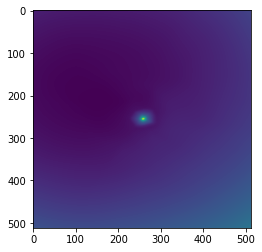

epoch 32401: 47.88835144042969
epoch 32402: 48.0877685546875
epoch 32403: 48.36226272583008
epoch 32404: 47.85281753540039
epoch 32405: 48.13645935058594
epoch 32406: 48.57227325439453
epoch 32407: 48.081581115722656
epoch 32408: 48.28164291381836
epoch 32409: 50.13677978515625
epoch 32411: 48.034263610839844
epoch 32412: 48.40353012084961
epoch 32413: 50.02544021606445
epoch 32414: 47.766029357910156
epoch 32415: 49.330989837646484
epoch 32416: 48.444515228271484
epoch 32417: 48.64891052246094
epoch 32418: 48.26097106933594
epoch 32419: 48.498165130615234
epoch 32421: 48.742027282714844
epoch 32422: 47.87251281738281
epoch 32423: 48.116695404052734
epoch 32424: 48.50033187866211
epoch 32425: 48.027374267578125
epoch 32426: 48.174072265625
epoch 32427: 48.19731903076172
epoch 32428: 48.32468032836914
epoch 32429: 48.470096588134766
epoch 32431: 48.21224594116211
epoch 32432: 48.36948776245117
epoch 32433: 48.73759841918945
epoch 32434: 47.79476547241211
epoch 32435: 48.395355224609375


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



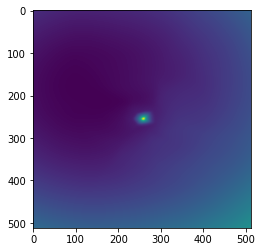

epoch 32501: 48.58347702026367
epoch 32502: 48.180076599121094
epoch 32503: 47.770267486572266
epoch 32504: 48.31565856933594
epoch 32505: 47.743961334228516
epoch 32506: 47.7230110168457
epoch 32507: 50.20374298095703
epoch 32508: 48.178958892822266
epoch 32509: 48.163822174072266
epoch 32511: 49.15778350830078
epoch 32512: 47.63954162597656
epoch 32513: 48.825233459472656
epoch 32514: 47.48517608642578
epoch 32515: 48.3327751159668
epoch 32516: 48.59904861450195
epoch 32517: 48.18212127685547
epoch 32518: 49.11554718017578
epoch 32519: 47.80979537963867
epoch 32521: 48.090240478515625
epoch 32522: 48.19629669189453
epoch 32523: 47.803714752197266
epoch 32524: 48.4969482421875
epoch 32525: 48.264976501464844
epoch 32526: 47.799869537353516
epoch 32527: 48.25495910644531
epoch 32528: 48.6497917175293
epoch 32529: 49.0594482421875
epoch 32531: 48.316650390625
epoch 32532: 47.64463806152344
epoch 32533: 49.43706512451172
epoch 32534: 48.039894104003906
epoch 32535: 47.699501037597656
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



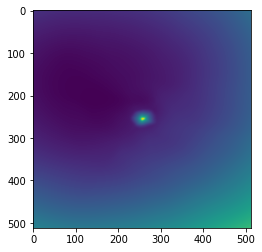

epoch 32601: 48.02043914794922
epoch 32602: 48.10597610473633
epoch 32603: 47.915321350097656
epoch 32604: 48.25445556640625
epoch 32605: 48.21122360229492
epoch 32606: 47.55929946899414
epoch 32607: 47.223297119140625
epoch 32608: 47.432430267333984
epoch 32609: 47.7524528503418
epoch 32611: 47.62814712524414
epoch 32612: 47.3641357421875
epoch 32613: 48.45607376098633
epoch 32614: 47.8855094909668
epoch 32615: 47.53848648071289
epoch 32616: 47.61175537109375
epoch 32617: 48.28866195678711
epoch 32618: 48.488433837890625
epoch 32619: 48.27943801879883
epoch 32621: 47.69117736816406
epoch 32622: 47.79240417480469
epoch 32623: 47.91810989379883
epoch 32624: 47.788761138916016
epoch 32625: 48.01105880737305
epoch 32626: 48.25940704345703
epoch 32627: 48.7386474609375
epoch 32628: 48.81211853027344
epoch 32629: 47.81426239013672
epoch 32631: 47.943626403808594
epoch 32632: 48.078311920166016
epoch 32633: 48.42049026489258
epoch 32634: 48.30971145629883
epoch 32635: 48.289573669433594
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



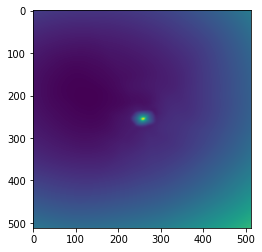

epoch 32701: 49.0643310546875
epoch 32702: 48.75799560546875
epoch 32703: 49.182498931884766
epoch 32704: 47.94773483276367
epoch 32705: 50.10701370239258
epoch 32706: 48.32868576049805
epoch 32707: 48.343292236328125
epoch 32708: 48.27778625488281
epoch 32709: 48.23457717895508
epoch 32711: 48.78215026855469
epoch 32712: 47.419830322265625
epoch 32713: 48.02961349487305
epoch 32714: 48.823848724365234
epoch 32715: 48.602054595947266
epoch 32716: 48.26709747314453
epoch 32717: 49.3438606262207
epoch 32718: 48.58720016479492
epoch 32719: 47.75749588012695
epoch 32721: 48.428958892822266
epoch 32722: 47.492130279541016
epoch 32723: 47.54070281982422
epoch 32724: 48.281463623046875
epoch 32725: 48.26200485229492
epoch 32726: 48.12836456298828
epoch 32727: 49.10884475708008
epoch 32728: 48.63958740234375
epoch 32729: 47.93873977661133
epoch 32731: 49.532203674316406
epoch 32732: 48.02949142456055
epoch 32733: 48.630149841308594
epoch 32734: 48.5296630859375
epoch 32735: 47.93745040893555
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



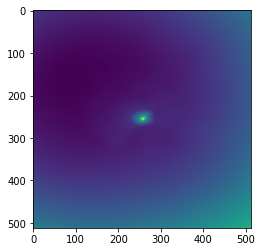

epoch 32801: 48.60959243774414
epoch 32802: 46.865474700927734
epoch 32803: 49.00746154785156
epoch 32804: 47.89338302612305
epoch 32805: 49.068077087402344
epoch 32806: 48.22996520996094
epoch 32807: 48.23085403442383
epoch 32808: 48.257530212402344
epoch 32809: 48.42021942138672
epoch 32811: 48.402381896972656
epoch 32812: 48.521636962890625
epoch 32813: 48.822425842285156
epoch 32814: 48.46070098876953
epoch 32815: 47.91535949707031
epoch 32816: 47.530479431152344
epoch 32817: 48.31665802001953
epoch 32818: 48.484893798828125
epoch 32819: 47.57843017578125
epoch 32821: 48.06224060058594
epoch 32822: 49.39613723754883
epoch 32823: 48.205631256103516
epoch 32824: 48.112613677978516
epoch 32825: 48.69999313354492
epoch 32826: 48.74134063720703
epoch 32827: 48.21482467651367
epoch 32828: 47.710411071777344
epoch 32829: 48.043609619140625
epoch 32831: 48.2162971496582
epoch 32832: 48.007911682128906
epoch 32833: 47.68918991088867
epoch 32834: 48.741981506347656
epoch 32835: 48.4387092590

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



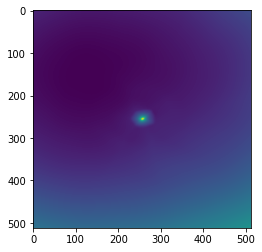

epoch 32901: 48.22119903564453
epoch 32902: 47.93394470214844
epoch 32903: 47.49159622192383
epoch 32904: 48.791194915771484
epoch 32905: 47.524906158447266
epoch 32906: 47.70830535888672
epoch 32907: 52.260650634765625
epoch 32908: 47.238494873046875
epoch 32909: 47.86037063598633
epoch 32911: 47.70667266845703
epoch 32912: 48.49269485473633
epoch 32913: 48.13340759277344
epoch 32914: 47.910484313964844
epoch 32915: 47.81467819213867
epoch 32916: 48.131752014160156
epoch 32917: 48.11958312988281
epoch 32918: 48.493350982666016
epoch 32919: 47.46405029296875
epoch 32921: 47.92546844482422
epoch 32922: 48.212547302246094
epoch 32923: 48.5300178527832
epoch 32924: 49.422996520996094
epoch 32925: 48.69440841674805
epoch 32926: 48.814151763916016
epoch 32927: 48.84196853637695
epoch 32928: 48.306541442871094
epoch 32929: 49.276397705078125
epoch 32931: 47.728946685791016
epoch 32932: 47.62594223022461
epoch 32933: 48.414405822753906
epoch 32934: 48.17817687988281
epoch 32935: 47.9588508605

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



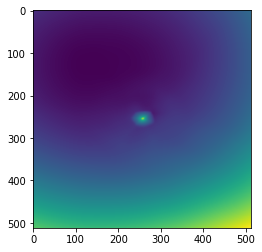

epoch 33001: 47.93882369995117
epoch 33002: 47.610626220703125
epoch 33003: 49.0993537902832
epoch 33004: 48.08176803588867
epoch 33005: 48.45582580566406
epoch 33006: 47.88601303100586
epoch 33007: 48.349483489990234
epoch 33008: 48.693973541259766
epoch 33009: 47.984596252441406
epoch 33011: 47.62590408325195
epoch 33012: 48.38579559326172
epoch 33013: 49.02685546875
epoch 33014: 47.41360092163086
epoch 33015: 48.35556411743164
epoch 33016: 48.17615509033203
epoch 33017: 47.93654251098633
epoch 33018: 47.99354934692383
epoch 33019: 46.98212814331055
epoch 33021: 47.00545120239258
epoch 33022: 48.287593841552734
epoch 33023: 47.89203643798828
epoch 33024: 47.371280670166016
epoch 33025: 47.7067985534668
epoch 33026: 47.8315315246582
epoch 33027: 48.5169563293457
epoch 33028: 48.66788864135742
epoch 33029: 47.61077117919922
epoch 33031: 48.63662338256836
epoch 33032: 47.95773696899414
epoch 33033: 49.31608581542969
epoch 33034: 48.652103424072266
epoch 33035: 48.75089645385742
epoch 33

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



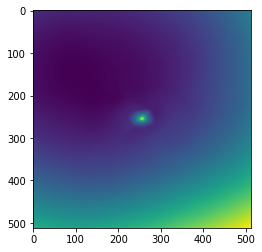

epoch 33101: 48.34883499145508
epoch 33102: 49.377471923828125
epoch 33103: 48.92758560180664
epoch 33104: 48.31578826904297
epoch 33105: 47.857452392578125
epoch 33106: 48.73033905029297
epoch 33107: 48.211177825927734
epoch 33108: 49.82587814331055
epoch 33109: 48.402950286865234
epoch 33111: 48.917236328125
epoch 33112: 48.13911056518555
epoch 33113: 47.94209671020508
epoch 33114: 49.03185272216797
epoch 33115: 48.48630142211914
epoch 33116: 48.20342254638672
epoch 33117: 48.78990173339844
epoch 33118: 49.160919189453125
epoch 33119: 47.84449768066406
epoch 33121: 48.059574127197266
epoch 33122: 49.514007568359375
epoch 33123: 48.419586181640625
epoch 33124: 48.27254104614258
epoch 33125: 49.224552154541016
epoch 33126: 48.30791091918945
epoch 33127: 49.01818084716797
epoch 33128: 48.4785270690918
epoch 33129: 49.58995819091797
epoch 33131: 49.393341064453125
epoch 33132: 49.495052337646484
epoch 33133: 48.654296875
epoch 33134: 48.660213470458984
epoch 33135: 48.606719970703125
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



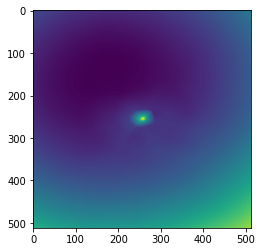

epoch 33201: 48.25167465209961
epoch 33202: 48.142417907714844
epoch 33203: 48.247711181640625
epoch 33204: 48.31466293334961
epoch 33205: 48.40312194824219
epoch 33206: 48.32360076904297
epoch 33207: 48.38960266113281
epoch 33208: 48.2049446105957
epoch 33209: 48.81853485107422
epoch 33211: 48.150264739990234
epoch 33212: 48.357948303222656
epoch 33213: 47.59660339355469
epoch 33214: 48.61552429199219
epoch 33215: 48.16514205932617
epoch 33216: 48.51816940307617
epoch 33217: 48.78530502319336
epoch 33218: 47.50603103637695
epoch 33219: 47.98858642578125
epoch 33221: 47.716583251953125
epoch 33222: 48.122840881347656
epoch 33223: 47.62799072265625
epoch 33224: 47.894798278808594
epoch 33225: 48.19588088989258
epoch 33226: 47.60900115966797
epoch 33227: 47.3269157409668
epoch 33228: 47.74870681762695
epoch 33229: 48.323604583740234
epoch 33231: 47.806358337402344
epoch 33232: 47.15987777709961
epoch 33233: 48.323734283447266
epoch 33234: 47.6268310546875
epoch 33235: 47.59012222290039
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



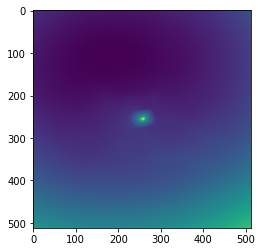

epoch 33301: 47.92821502685547
epoch 33302: 47.94161605834961
epoch 33303: 48.00105285644531
epoch 33304: 50.651451110839844
epoch 33305: 48.98506546020508
epoch 33306: 48.24251937866211
epoch 33307: 47.870765686035156
epoch 33308: 48.75434875488281
epoch 33309: 47.64628219604492
epoch 33311: 48.241546630859375
epoch 33312: 47.81586837768555
epoch 33313: 47.92894744873047
epoch 33314: 47.793190002441406
epoch 33315: 48.48590087890625
epoch 33316: 48.02251434326172
epoch 33317: 48.26113510131836
epoch 33318: 48.486976623535156
epoch 33319: 49.35047149658203
epoch 33321: 47.63056564331055
epoch 33322: 48.07903289794922
epoch 33323: 48.057037353515625
epoch 33324: 48.572654724121094
epoch 33325: 48.099239349365234
epoch 33326: 47.66968536376953
epoch 33327: 47.37556457519531
epoch 33328: 48.556243896484375
epoch 33329: 47.88154220581055
epoch 33331: 48.16917419433594
epoch 33332: 48.24217224121094
epoch 33333: 47.75214767456055
epoch 33334: 48.7786750793457
epoch 33335: 47.85169982910156


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



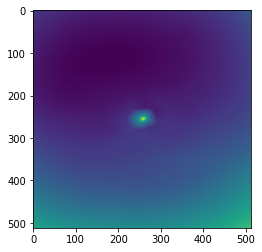

epoch 33401: 48.154640197753906
epoch 33402: 48.173362731933594
epoch 33403: 48.67724609375
epoch 33404: 47.77993392944336
epoch 33405: 48.25027847290039
epoch 33406: 47.961891174316406
epoch 33407: 47.43918991088867
epoch 33408: 48.439544677734375
epoch 33409: 47.995296478271484
epoch 33411: 48.20977020263672
epoch 33412: 48.51945495605469
epoch 33413: 48.107749938964844
epoch 33414: 48.29254150390625
epoch 33415: 48.19791793823242
epoch 33416: 48.27787399291992
epoch 33417: 48.46662902832031
epoch 33418: 47.945125579833984
epoch 33419: 48.003631591796875
epoch 33421: 47.734256744384766
epoch 33422: 48.55659484863281
epoch 33423: 48.07061004638672
epoch 33424: 48.43075180053711
epoch 33425: 48.34583282470703
epoch 33426: 48.9105224609375
epoch 33427: 47.65763854980469
epoch 33428: 47.834197998046875
epoch 33429: 48.5819206237793
epoch 33431: 47.38840103149414
epoch 33432: 48.08526611328125
epoch 33433: 48.389678955078125
epoch 33434: 48.66848373413086
epoch 33435: 48.88732147216797
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



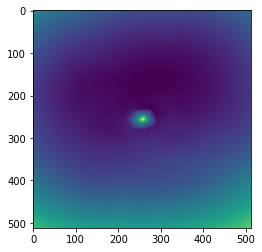

epoch 33501: 48.92173385620117
epoch 33502: 47.515602111816406
epoch 33503: 48.711204528808594
epoch 33504: 47.95266342163086
epoch 33505: 47.813663482666016
epoch 33506: 48.846885681152344
epoch 33507: 47.57781219482422
epoch 33508: 47.914798736572266
epoch 33509: 47.72521209716797
epoch 33511: 56.679603576660156
epoch 33512: 47.968544006347656
epoch 33513: 47.813968658447266
epoch 33514: 48.469154357910156
epoch 33515: 47.807342529296875
epoch 33516: 49.02956008911133
epoch 33517: 47.60674285888672
epoch 33518: 48.306270599365234
epoch 33519: 49.302330017089844
epoch 33521: 48.57482147216797
epoch 33522: 47.50937271118164
epoch 33523: 47.50749206542969
epoch 33524: 47.945640563964844
epoch 33525: 48.265296936035156
epoch 33526: 48.38211441040039
epoch 33527: 48.18317794799805
epoch 33528: 48.311805725097656
epoch 33529: 48.89105987548828
epoch 33531: 49.02225112915039
epoch 33532: 49.54495620727539
epoch 33533: 49.44593811035156
epoch 33534: 48.14144515991211
epoch 33535: 47.74121093

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



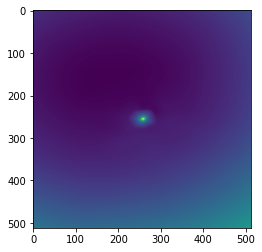

epoch 33601: 48.699317932128906
epoch 33602: 49.186092376708984
epoch 33603: 47.6678581237793
epoch 33604: 49.27623748779297
epoch 33605: 48.23090362548828
epoch 33606: 47.426116943359375
epoch 33607: 49.21827697753906
epoch 33608: 48.322994232177734
epoch 33609: 48.01139831542969
epoch 33611: 46.92866516113281
epoch 33612: 47.95762634277344
epoch 33613: 47.9455680847168
epoch 33614: 48.042118072509766
epoch 33615: 48.005096435546875
epoch 33616: 48.560001373291016
epoch 33617: 47.27988815307617
epoch 33618: 47.6197395324707
epoch 33619: 49.216529846191406
epoch 33621: 47.97804641723633
epoch 33622: 48.34101486206055
epoch 33623: 47.69192123413086
epoch 33624: 47.98216247558594
epoch 33625: 48.29335403442383
epoch 33626: 47.5739631652832
epoch 33627: 48.40038299560547
epoch 33628: 48.063873291015625
epoch 33629: 48.20244598388672
epoch 33631: 48.799522399902344
epoch 33632: 47.88496017456055
epoch 33633: 48.77115249633789
epoch 33634: 47.923797607421875
epoch 33635: 48.178707122802734


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



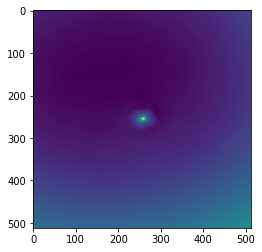

epoch 33701: 48.870155334472656
epoch 33702: 49.22916030883789
epoch 33703: 49.38916778564453
epoch 33704: 48.78525924682617
epoch 33705: 49.5162353515625
epoch 33706: 48.35042953491211
epoch 33707: 48.55840301513672
epoch 33708: 48.630924224853516
epoch 33709: 49.05701446533203
epoch 33711: 49.07706069946289
epoch 33712: 48.64900588989258
epoch 33713: 47.96942901611328
epoch 33714: 48.49795150756836
epoch 33715: 48.80755615234375
epoch 33716: 47.57627868652344
epoch 33717: 49.26459884643555
epoch 33718: 48.62093734741211
epoch 33719: 48.75794219970703
epoch 33721: 48.559059143066406
epoch 33722: 48.37721633911133
epoch 33723: 49.24203109741211
epoch 33724: 47.80516052246094
epoch 33725: 48.32119369506836
epoch 33726: 48.071510314941406
epoch 33727: 49.052040100097656
epoch 33728: 48.09700012207031
epoch 33729: 49.21458435058594
epoch 33731: 49.56493377685547
epoch 33732: 48.44843673706055
epoch 33733: 48.59724426269531
epoch 33734: 48.0967903137207
epoch 33735: 48.35878372192383
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



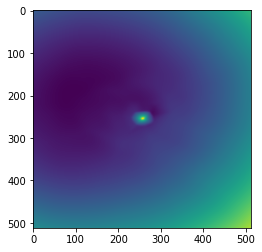

epoch 33801: 47.63417434692383
epoch 33802: 49.24695587158203
epoch 33803: 47.810401916503906
epoch 33804: 48.25114059448242
epoch 33805: 47.789398193359375
epoch 33806: 47.32891082763672
epoch 33807: 47.97622299194336
epoch 33808: 48.84059524536133
epoch 33809: 48.00123977661133
epoch 33811: 48.254276275634766
epoch 33812: 48.17072296142578
epoch 33813: 47.3642692565918
epoch 33814: 48.32577896118164
epoch 33815: 48.728912353515625
epoch 33816: 47.46459197998047
epoch 33817: 48.13973617553711
epoch 33818: 48.75811767578125
epoch 33819: 48.230865478515625
epoch 33821: 47.40247344970703
epoch 33822: 48.622596740722656
epoch 33823: 47.72396469116211
epoch 33824: 49.077640533447266
epoch 33825: 48.301998138427734
epoch 33826: 47.863277435302734
epoch 33827: 47.87724304199219
epoch 33828: 49.21184158325195
epoch 33829: 48.13493347167969
epoch 33831: 47.900596618652344
epoch 33832: 48.40656280517578
epoch 33833: 47.53500747680664
epoch 33834: 48.00048828125
epoch 33835: 48.61101150512695
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



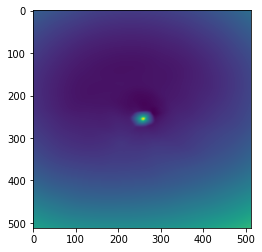

epoch 33901: 48.937599182128906
epoch 33902: 47.56566619873047
epoch 33903: 48.48386764526367
epoch 33904: 48.319393157958984
epoch 33905: 48.76411437988281
epoch 33906: 48.919883728027344
epoch 33907: 48.285797119140625
epoch 33908: 48.231040954589844
epoch 33909: 48.41767501831055
epoch 33911: 48.143287658691406
epoch 33912: 48.55520248413086
epoch 33913: 47.706295013427734
epoch 33914: 48.215641021728516
epoch 33915: 48.285648345947266
epoch 33916: 48.90357971191406
epoch 33917: 48.18641662597656
epoch 33918: 48.42121124267578
epoch 33919: 47.845619201660156
epoch 33921: 48.29140853881836
epoch 33922: 47.64056396484375
epoch 33923: 47.43747329711914
epoch 33924: 47.6162223815918
epoch 33925: 48.6956901550293
epoch 33926: 47.41025924682617
epoch 33927: 47.83193588256836
epoch 33928: 47.98767852783203
epoch 33929: 47.21581268310547
epoch 33931: 48.38343048095703
epoch 33932: 47.91742706298828
epoch 33933: 48.726341247558594
epoch 33934: 47.515357971191406
epoch 33935: 48.8117980957031

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



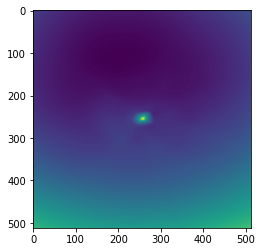

epoch 34001: 48.992027282714844
epoch 34002: 48.16763687133789
epoch 34003: 47.82115936279297
epoch 34004: 48.70452880859375
epoch 34005: 49.730377197265625
epoch 34006: 48.01374816894531
epoch 34007: 49.16133499145508
epoch 34008: 48.6248779296875
epoch 34009: 48.855281829833984
epoch 34011: 48.90313720703125
epoch 34012: 48.31238555908203
epoch 34013: 48.40894317626953
epoch 34014: 48.149757385253906
epoch 34015: 48.48459243774414
epoch 34016: 48.939273834228516
epoch 34017: 47.59501647949219
epoch 34018: 48.4162483215332
epoch 34019: 48.23323440551758
epoch 34021: 47.54792785644531
epoch 34022: 48.517486572265625
epoch 34023: 47.82215118408203
epoch 34024: 47.95489501953125
epoch 34025: 48.01871871948242
epoch 34026: 47.75133514404297
epoch 34027: 48.37027359008789
epoch 34028: 48.62460708618164
epoch 34029: 47.893638610839844
epoch 34031: 48.34130096435547
epoch 34032: 49.23801803588867
epoch 34033: 48.56101608276367
epoch 34034: 47.39134216308594
epoch 34035: 48.93644332885742
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



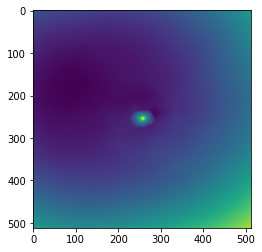

epoch 34101: 48.23225021362305
epoch 34102: 48.74100112915039
epoch 34103: 49.10083770751953
epoch 34104: 48.198909759521484
epoch 34105: 48.286380767822266
epoch 34106: 47.52965545654297
epoch 34107: 48.003971099853516
epoch 34108: 48.6433219909668
epoch 34109: 47.59125900268555
epoch 34111: 48.550907135009766
epoch 34112: 48.32823944091797
epoch 34113: 48.0921745300293
epoch 34114: 48.385162353515625
epoch 34115: 47.751617431640625
epoch 34116: 47.521705627441406
epoch 34117: 48.31565856933594
epoch 34118: 47.479122161865234
epoch 34119: 48.12285614013672
epoch 34121: 48.31692886352539
epoch 34122: 48.19390106201172
epoch 34123: 47.45882034301758
epoch 34124: 48.438411712646484
epoch 34125: 49.22645950317383
epoch 34126: 49.08146286010742
epoch 34127: 47.66128921508789
epoch 34128: 48.12862014770508
epoch 34129: 47.91818618774414
epoch 34131: 49.108516693115234
epoch 34132: 48.93434143066406
epoch 34133: 48.64698028564453
epoch 34134: 47.66350555419922
epoch 34135: 48.426429748535156

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



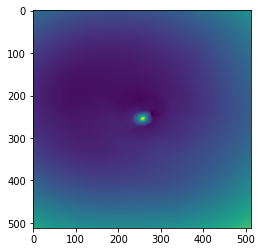

epoch 34201: 48.420753479003906
epoch 34202: 47.943695068359375
epoch 34203: 48.63115310668945
epoch 34204: 48.51327896118164
epoch 34205: 47.507877349853516
epoch 34206: 47.88896179199219
epoch 34207: 48.36114501953125
epoch 34208: 49.27619934082031
epoch 34209: 48.312374114990234
epoch 34211: 48.49985885620117
epoch 34212: 47.577415466308594
epoch 34213: 48.145042419433594
epoch 34214: 48.231876373291016
epoch 34215: 47.861175537109375
epoch 34216: 47.76376724243164
epoch 34217: 48.515167236328125
epoch 34218: 49.43082046508789
epoch 34219: 48.14878845214844
epoch 34221: 48.30388641357422
epoch 34222: 47.98978042602539
epoch 34223: 48.194828033447266
epoch 34224: 48.1094856262207
epoch 34225: 47.64962387084961
epoch 34226: 48.88189697265625
epoch 34227: 48.55875778198242
epoch 34228: 48.273193359375
epoch 34229: 48.26515197753906
epoch 34231: 51.9932746887207
epoch 34232: 47.93663024902344
epoch 34233: 47.3583984375
epoch 34234: 47.60234451293945
epoch 34235: 50.6970329284668
epoch 3

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



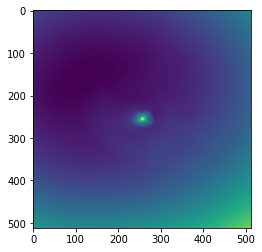

epoch 34301: 47.76123809814453
epoch 34302: 49.28584289550781
epoch 34303: 48.6317253112793
epoch 34304: 47.197818756103516
epoch 34305: 48.7476921081543
epoch 34306: 48.371334075927734
epoch 34307: 48.703922271728516
epoch 34308: 49.431941986083984
epoch 34309: 48.20626449584961
epoch 34311: 48.17637252807617
epoch 34312: 49.47878646850586
epoch 34313: 48.55559539794922
epoch 34314: 48.64176940917969
epoch 34315: 48.02062225341797
epoch 34316: 48.245845794677734
epoch 34317: 47.74269485473633
epoch 34318: 48.770729064941406
epoch 34319: 48.81572723388672
epoch 34321: 49.14631271362305
epoch 34322: 48.15325164794922
epoch 34323: 47.8230094909668
epoch 34324: 47.829471588134766
epoch 34325: 48.33513641357422
epoch 34326: 48.29463195800781
epoch 34327: 48.43555450439453
epoch 34328: 47.67791748046875
epoch 34329: 48.45008087158203
epoch 34331: 48.31075668334961
epoch 34332: 48.51909255981445
epoch 34333: 48.204750061035156
epoch 34334: 48.689788818359375
epoch 34335: 48.76618194580078
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



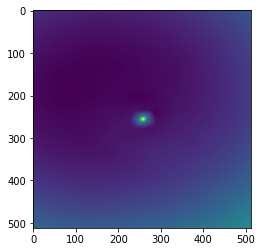

epoch 34401: 48.253753662109375
epoch 34402: 47.85724639892578
epoch 34403: 47.69781494140625
epoch 34404: 47.885990142822266
epoch 34405: 47.613792419433594
epoch 34406: 48.61347961425781
epoch 34407: 47.55829620361328
epoch 34408: 47.769962310791016
epoch 34409: 49.15583419799805
epoch 34411: 48.782859802246094
epoch 34412: 47.47154998779297
epoch 34413: 48.07868957519531
epoch 34414: 48.05803680419922
epoch 34415: 48.936614990234375
epoch 34416: 48.13465118408203
epoch 34417: 47.745018005371094
epoch 34418: 48.56829833984375
epoch 34419: 48.03171920776367
epoch 34421: 47.440128326416016
epoch 34422: 47.780208587646484
epoch 34423: 47.687984466552734
epoch 34424: 48.507904052734375
epoch 34425: 48.01649856567383
epoch 34426: 48.786415100097656
epoch 34427: 48.36867904663086
epoch 34428: 48.273624420166016
epoch 34429: 48.672977447509766
epoch 34431: 48.19591522216797
epoch 34432: 48.127681732177734
epoch 34433: 48.90922546386719
epoch 34434: 48.45480728149414
epoch 34435: 48.09682083

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



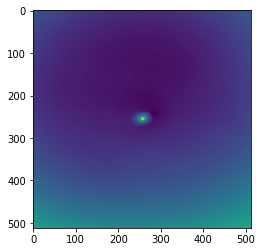

epoch 34501: 47.68861389160156
epoch 34502: 48.155460357666016
epoch 34503: 47.673492431640625
epoch 34504: 49.39781188964844
epoch 34505: 47.642494201660156
epoch 34506: 49.02753448486328
epoch 34507: 48.198692321777344
epoch 34508: 47.846046447753906
epoch 34509: 48.69253158569336
epoch 34511: 47.477928161621094
epoch 34512: 49.01877212524414
epoch 34513: 47.57368087768555
epoch 34514: 47.64237976074219
epoch 34515: 47.704139709472656
epoch 34516: 47.21771240234375
epoch 34517: 47.7442626953125
epoch 34518: 48.77165985107422
epoch 34519: 47.53350830078125
epoch 34521: 48.69076156616211
epoch 34522: 47.7817497253418
epoch 34523: 48.77327346801758
epoch 34524: 47.38093566894531
epoch 34525: 47.93287658691406
epoch 34526: 47.40988540649414
epoch 34527: 47.32268524169922
epoch 34528: 49.26891326904297
epoch 34529: 48.24089813232422
epoch 34531: 47.47673416137695
epoch 34532: 48.96371841430664
epoch 34533: 47.22481918334961
epoch 34534: 49.42588424682617
epoch 34535: 49.6209831237793
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



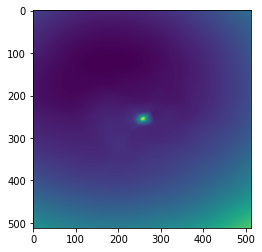

epoch 34601: 48.230770111083984
epoch 34602: 48.02789306640625
epoch 34603: 47.53026580810547
epoch 34604: 47.9712028503418
epoch 34605: 48.68783187866211
epoch 34606: 47.87068176269531
epoch 34607: 47.92277908325195
epoch 34608: 48.244686126708984
epoch 34609: 48.07074737548828
epoch 34611: 48.50068664550781
epoch 34612: 47.8121223449707
epoch 34613: 47.85855484008789
epoch 34614: 48.667274475097656
epoch 34615: 48.60436248779297
epoch 34616: 47.86099624633789
epoch 34617: 48.85722732543945
epoch 34618: 49.07169723510742
epoch 34619: 48.66291046142578
epoch 34621: 48.40080261230469
epoch 34622: 48.93368911743164
epoch 34623: 47.0947151184082
epoch 34624: 47.879417419433594
epoch 34625: 48.666324615478516
epoch 34626: 48.32075500488281
epoch 34627: 47.8444938659668
epoch 34628: 47.73294448852539
epoch 34629: 49.06599807739258
epoch 34631: 47.92557907104492
epoch 34632: 49.00654602050781
epoch 34633: 48.361427307128906
epoch 34634: 47.993385314941406
epoch 34635: 48.83689498901367
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



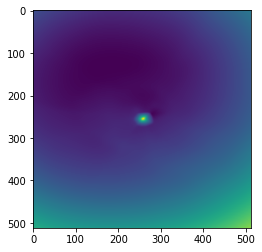

epoch 34701: 48.568359375
epoch 34702: 48.25079345703125
epoch 34703: 48.33320999145508
epoch 34704: 48.40021514892578
epoch 34705: 48.092079162597656
epoch 34706: 47.94678497314453
epoch 34707: 48.95874786376953
epoch 34708: 48.81513595581055
epoch 34709: 47.98644256591797
epoch 34711: 47.83436584472656
epoch 34712: 49.62858581542969
epoch 34713: 48.79027557373047
epoch 34714: 48.28882598876953
epoch 34715: 47.37171173095703
epoch 34716: 48.38246536254883
epoch 34717: 48.33504867553711
epoch 34718: 47.96317672729492
epoch 34719: 47.96004104614258
epoch 34721: 48.35844421386719
epoch 34722: 48.867740631103516
epoch 34723: 48.65363693237305
epoch 34724: 48.45046615600586
epoch 34725: 47.704776763916016
epoch 34726: 47.7063102722168
epoch 34727: 48.148109436035156
epoch 34728: 47.970970153808594
epoch 34729: 47.344390869140625
epoch 34731: 48.22225570678711
epoch 34732: 48.6611328125
epoch 34733: 48.165870666503906
epoch 34734: 47.37662887573242
epoch 34735: 48.286197662353516
epoch 3473

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



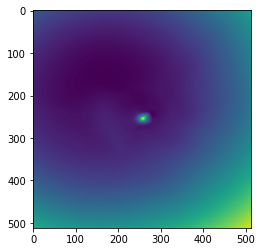

epoch 34801: 47.96451187133789
epoch 34802: 47.400089263916016
epoch 34803: 47.9079475402832
epoch 34804: 47.55012512207031
epoch 34805: 49.10720443725586
epoch 34806: 49.70140838623047
epoch 34807: 48.39541244506836
epoch 34808: 47.322452545166016
epoch 34809: 47.850826263427734
epoch 34811: 49.158203125
epoch 34812: 47.904327392578125
epoch 34813: 48.911766052246094
epoch 34814: 47.9775276184082
epoch 34815: 49.80906295776367
epoch 34816: 47.5709114074707
epoch 34817: 47.707862854003906
epoch 34818: 47.375125885009766
epoch 34819: 48.49404525756836
epoch 34821: 47.240299224853516
epoch 34822: 48.139583587646484
epoch 34823: 49.064510345458984
epoch 34824: 49.20416259765625
epoch 34825: 47.712066650390625
epoch 34826: 47.91837692260742
epoch 34827: 48.1115837097168
epoch 34828: 48.1690559387207
epoch 34829: 48.00438690185547
epoch 34831: 49.11717224121094
epoch 34832: 48.74298858642578
epoch 34833: 48.38827896118164
epoch 34834: 47.612815856933594
epoch 34835: 47.61881637573242
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



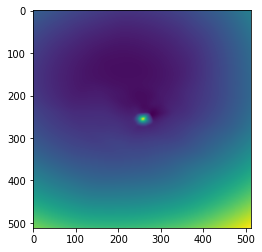

epoch 34901: 48.315311431884766
epoch 34902: 48.057159423828125
epoch 34903: 48.330928802490234
epoch 34904: 49.39962387084961
epoch 34905: 48.465763092041016
epoch 34906: 48.60628128051758
epoch 34907: 47.6345329284668
epoch 34908: 47.73662567138672
epoch 34909: 47.78514099121094
epoch 34911: 47.86372375488281
epoch 34912: 47.993839263916016
epoch 34913: 48.27130889892578
epoch 34914: 47.75263214111328
epoch 34915: 48.0398063659668
epoch 34916: 47.57591247558594
epoch 34917: 48.06922912597656
epoch 34918: 47.93617248535156
epoch 34919: 47.41735076904297
epoch 34921: 48.39958190917969
epoch 34922: 48.72183609008789
epoch 34923: 47.234195709228516
epoch 34924: 47.40414047241211
epoch 34925: 48.28254318237305
epoch 34926: 47.6501350402832
epoch 34927: 48.096519470214844
epoch 34928: 48.041568756103516
epoch 34929: 47.51274108886719
epoch 34931: 47.54178237915039
epoch 34932: 47.47705841064453
epoch 34933: 47.622779846191406
epoch 34934: 47.7260856628418
epoch 34935: 48.14551544189453
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



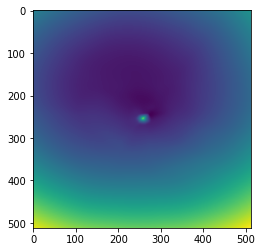

epoch 35001: 48.08409881591797
epoch 35002: 47.66109848022461
epoch 35003: 47.82375717163086
epoch 35004: 48.10050964355469
epoch 35005: 48.2978515625
epoch 35006: 48.014564514160156
epoch 35007: 50.639305114746094
epoch 35008: 47.713722229003906
epoch 35009: 48.247711181640625
epoch 35011: 47.69607162475586
epoch 35012: 48.82550811767578
epoch 35013: 47.90065002441406
epoch 35014: 47.77212142944336
epoch 35015: 48.243228912353516
epoch 35016: 48.228599548339844
epoch 35017: 47.85960006713867
epoch 35018: 47.593624114990234
epoch 35019: 48.25843811035156
epoch 35021: 47.9334602355957
epoch 35022: 47.44650650024414
epoch 35023: 47.353607177734375
epoch 35024: 48.82489776611328
epoch 35025: 47.55912399291992
epoch 35026: 48.45085906982422
epoch 35027: 48.158267974853516
epoch 35028: 47.67523956298828
epoch 35029: 48.963645935058594
epoch 35031: 47.436893463134766
epoch 35032: 47.63517761230469
epoch 35033: 47.85478210449219
epoch 35034: 48.24445343017578
epoch 35035: 47.565818786621094
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



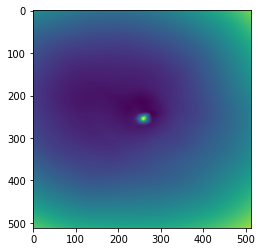

epoch 35101: 48.01247024536133
epoch 35102: 48.4404296875
epoch 35103: 48.231319427490234
epoch 35104: 48.385597229003906
epoch 35105: 48.72816467285156
epoch 35106: 48.072566986083984
epoch 35107: 47.937923431396484
epoch 35108: 48.883548736572266
epoch 35109: 48.55447006225586
epoch 35111: 47.825843811035156
epoch 35112: 47.90961837768555
epoch 35113: 48.20866394042969
epoch 35114: 47.73556137084961
epoch 35115: 48.481319427490234
epoch 35116: 48.152427673339844
epoch 35117: 47.9815788269043
epoch 35118: 48.20717239379883
epoch 35119: 47.94028854370117
epoch 35121: 47.69239044189453
epoch 35122: 48.15864181518555
epoch 35123: 48.437828063964844
epoch 35124: 48.957008361816406
epoch 35125: 48.305763244628906
epoch 35126: 48.15274429321289
epoch 35127: 47.624752044677734
epoch 35128: 47.61684036254883
epoch 35129: 48.361900329589844
epoch 35131: 47.84637451171875
epoch 35132: 48.03742599487305
epoch 35133: 48.09105682373047
epoch 35134: 48.64125442504883
epoch 35135: 47.949153900146484

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



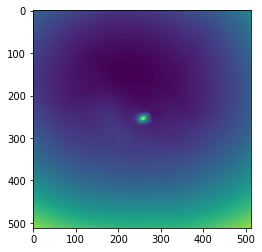

epoch 35201: 47.772979736328125
epoch 35202: 48.318878173828125
epoch 35203: 47.58979797363281
epoch 35204: 48.46124267578125
epoch 35205: 47.83919906616211
epoch 35206: 49.17560958862305
epoch 35207: 46.97999572753906
epoch 35208: 47.95476150512695
epoch 35209: 48.32472610473633
epoch 35211: 47.8145751953125
epoch 35212: 48.49882888793945
epoch 35213: 47.21526336669922
epoch 35214: 46.8021125793457
epoch 35215: 47.7332649230957
epoch 35216: 49.68956756591797
epoch 35217: 47.90549087524414
epoch 35218: 47.4038200378418
epoch 35219: 48.138038635253906
epoch 35221: 48.59978103637695
epoch 35222: 47.72520446777344
epoch 35223: 47.56722640991211
epoch 35224: 48.08207321166992
epoch 35225: 47.58979797363281
epoch 35226: 48.31796646118164
epoch 35227: 48.308128356933594
epoch 35228: 47.67164993286133
epoch 35229: 47.96578598022461
epoch 35231: 48.44451904296875
epoch 35232: 48.2525634765625
epoch 35233: 47.82340621948242
epoch 35234: 48.61228942871094
epoch 35235: 48.47761535644531
epoch 352

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



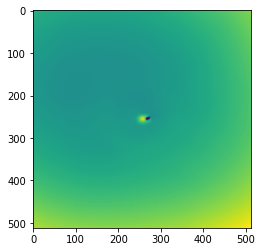

epoch 35301: 48.253944396972656
epoch 35302: 47.85725784301758
epoch 35303: 48.52555465698242
epoch 35304: 48.75565719604492
epoch 35305: 48.430686950683594
epoch 35306: 47.660888671875
epoch 35307: 47.80471420288086
epoch 35308: 48.203956604003906
epoch 35309: 48.79000473022461
epoch 35311: 47.72945785522461
epoch 35312: 48.13165283203125
epoch 35313: 48.5872917175293
epoch 35314: 48.123287200927734
epoch 35315: 48.53514099121094
epoch 35316: 49.06305694580078
epoch 35317: 48.007225036621094
epoch 35318: 49.2303466796875
epoch 35319: 48.56875991821289
epoch 35321: 48.7545166015625
epoch 35322: 52.62785339355469
epoch 35323: 47.93471145629883
epoch 35324: 48.25028991699219
epoch 35325: 49.00202178955078
epoch 35326: 48.743553161621094
epoch 35327: 49.02070617675781
epoch 35328: 49.181068420410156
epoch 35329: 48.17253494262695
epoch 35331: 48.828025817871094
epoch 35332: 48.07304000854492
epoch 35333: 48.363895416259766
epoch 35334: 47.71136474609375
epoch 35335: 48.535423278808594
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



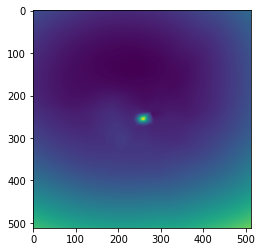

epoch 35401: 48.49802017211914
epoch 35402: 48.1357536315918
epoch 35403: 47.270450592041016
epoch 35404: 47.88843536376953
epoch 35405: 47.94544219970703
epoch 35406: 48.644500732421875
epoch 35407: 49.24235534667969
epoch 35408: 48.719627380371094
epoch 35409: 47.79510498046875
epoch 35411: 48.105979919433594
epoch 35412: 48.03643798828125
epoch 35413: 48.69676971435547
epoch 35414: 48.37799835205078
epoch 35415: 48.04467010498047
epoch 35416: 47.55259704589844
epoch 35417: 48.4842414855957
epoch 35418: 47.53214645385742
epoch 35419: 48.541351318359375
epoch 35421: 47.89604187011719
epoch 35422: 47.859161376953125
epoch 35423: 48.47325897216797
epoch 35424: 48.459266662597656
epoch 35425: 49.129119873046875
epoch 35426: 48.05776596069336
epoch 35427: 48.79167175292969
epoch 35428: 48.761268615722656
epoch 35429: 48.92966079711914
epoch 35431: 49.3134880065918
epoch 35432: 48.670467376708984
epoch 35433: 48.082420349121094
epoch 35434: 47.793846130371094
epoch 35435: 48.14387130737305

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



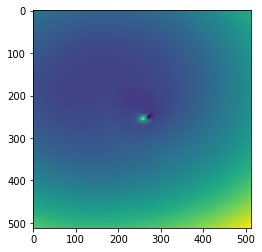

epoch 35501: 48.03047561645508
epoch 35502: 48.351905822753906
epoch 35503: 48.5238037109375
epoch 35504: 47.874691009521484
epoch 35505: 47.999610900878906
epoch 35506: 48.3195686340332
epoch 35507: 48.477813720703125
epoch 35508: 48.11984634399414
epoch 35509: 47.37542724609375
epoch 35511: 48.48159408569336
epoch 35512: 48.37287139892578
epoch 35513: 47.93661117553711
epoch 35514: 48.96662902832031
epoch 35515: 48.60175323486328
epoch 35516: 48.51631546020508
epoch 35517: 47.97126770019531
epoch 35518: 49.238372802734375
epoch 35519: 49.344234466552734
epoch 35521: 48.22062683105469
epoch 35522: 47.94973373413086
epoch 35523: 48.937355041503906
epoch 35524: 47.8671875
epoch 35525: 48.71932601928711
epoch 35526: 48.38152313232422
epoch 35527: 48.1541748046875
epoch 35528: 48.25814437866211
epoch 35529: 47.75853729248047
epoch 35531: 48.30486297607422
epoch 35532: 48.270484924316406
epoch 35533: 48.18878936767578
epoch 35534: 48.89106369018555
epoch 35535: 48.16965103149414
epoch 3553

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



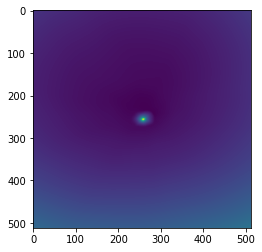

epoch 35601: 48.17405700683594
epoch 35602: 48.78780746459961
epoch 35603: 49.03273010253906
epoch 35604: 48.499027252197266
epoch 35605: 48.354026794433594
epoch 35606: 49.7216796875
epoch 35607: 48.502262115478516
epoch 35608: 48.63398361206055
epoch 35609: 47.22978210449219
epoch 35611: 47.63899230957031
epoch 35612: 48.748558044433594
epoch 35613: 48.071170806884766
epoch 35614: 47.85306930541992
epoch 35615: 50.1634521484375
epoch 35616: 48.166778564453125
epoch 35617: 48.768680572509766
epoch 35618: 48.831966400146484
epoch 35619: 48.22150802612305
epoch 35621: 48.5036506652832
epoch 35622: 48.23088073730469
epoch 35623: 48.06291961669922
epoch 35624: 48.45072937011719
epoch 35625: 48.36677551269531
epoch 35626: 48.03699493408203
epoch 35627: 47.77252960205078
epoch 35628: 47.9964485168457
epoch 35629: 48.49550247192383
epoch 35631: 49.7595329284668
epoch 35632: 48.54596710205078
epoch 35633: 47.663368225097656
epoch 35634: 48.11103439331055
epoch 35635: 48.690425872802734
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



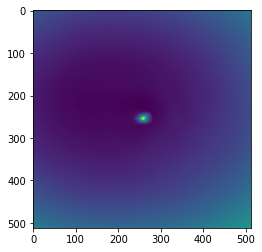

epoch 35701: 47.8278923034668
epoch 35702: 47.28046417236328
epoch 35703: 47.47285842895508
epoch 35704: 47.997379302978516
epoch 35705: 48.20789337158203
epoch 35706: 47.89617919921875
epoch 35707: 50.595497131347656
epoch 35708: 48.0774040222168
epoch 35709: 48.38166046142578
epoch 35711: 47.57672119140625
epoch 35712: 47.8453369140625
epoch 35713: 48.141387939453125
epoch 35714: 47.37602996826172
epoch 35715: 48.20531463623047
epoch 35716: 47.39616012573242
epoch 35717: 48.58753204345703
epoch 35718: 47.970726013183594
epoch 35719: 48.6083984375
epoch 35721: 47.67328643798828
epoch 35722: 53.448917388916016
epoch 35723: 49.41925811767578
epoch 35724: 48.692230224609375
epoch 35725: 49.352378845214844
epoch 35726: 48.35551452636719
epoch 35727: 48.8392448425293
epoch 35728: 47.83751678466797
epoch 35729: 48.13888168334961
epoch 35731: 49.28250503540039
epoch 35732: 48.69055938720703
epoch 35733: 48.637630462646484
epoch 35734: 49.099178314208984
epoch 35735: 47.425296783447266
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



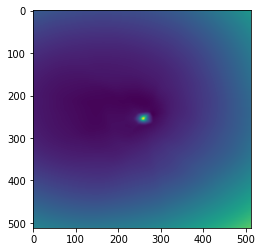

epoch 35801: 49.34610366821289
epoch 35802: 48.55980682373047
epoch 35803: 47.56869125366211
epoch 35804: 48.68202209472656
epoch 35805: 49.102046966552734
epoch 35806: 48.53129196166992
epoch 35807: 47.87053298950195
epoch 35808: 48.55851364135742
epoch 35809: 49.000614166259766
epoch 35811: 49.29672622680664
epoch 35812: 48.82158660888672
epoch 35813: 48.11838150024414
epoch 35814: 49.35403060913086
epoch 35815: 49.448089599609375
epoch 35816: 48.23197937011719
epoch 35817: 48.67731857299805
epoch 35818: 48.95647048950195
epoch 35819: 49.077266693115234
epoch 35821: 48.96597671508789
epoch 35822: 48.72666549682617
epoch 35823: 48.436241149902344
epoch 35824: 50.07008361816406
epoch 35825: 48.81459045410156
epoch 35826: 48.95211410522461
epoch 35827: 49.791748046875
epoch 35828: 48.71963882446289
epoch 35829: 49.05667495727539
epoch 35831: 49.61907958984375
epoch 35832: 48.69023895263672
epoch 35833: 48.55050277709961
epoch 35834: 49.56226348876953
epoch 35835: 49.03477478027344
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



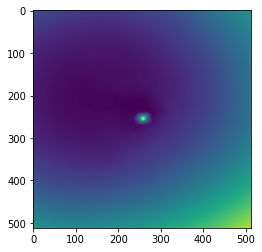

epoch 35901: 48.61607360839844
epoch 35902: 47.54363250732422
epoch 35903: 47.75448226928711
epoch 35904: 47.66403579711914
epoch 35905: 48.06854248046875
epoch 35906: 48.53216552734375
epoch 35907: 47.07843017578125
epoch 35908: 47.86669158935547
epoch 35909: 47.865821838378906
epoch 35911: 47.915096282958984
epoch 35912: 47.893314361572266
epoch 35913: 47.806373596191406
epoch 35914: 48.356536865234375
epoch 35915: 47.5155143737793
epoch 35916: 53.55962371826172
epoch 35917: 48.10163497924805
epoch 35918: 47.852691650390625
epoch 35919: 47.7658805847168
epoch 35921: 49.56649398803711
epoch 35922: 47.78936767578125
epoch 35923: 47.86351776123047
epoch 35924: 47.86321258544922
epoch 35925: 49.339317321777344
epoch 35926: 47.255699157714844
epoch 35927: 48.31232452392578
epoch 35928: 47.20943832397461
epoch 35929: 47.751983642578125
epoch 35931: 47.86809539794922
epoch 35932: 48.318267822265625
epoch 35933: 48.64756393432617
epoch 35934: 47.646121978759766
epoch 35935: 48.9786491394043


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



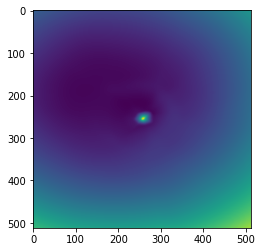

epoch 36001: 47.23019790649414
epoch 36002: 48.850616455078125
epoch 36003: 48.29965591430664
epoch 36004: 48.06633377075195
epoch 36005: 48.24720764160156
epoch 36006: 49.144351959228516
epoch 36007: 47.73550033569336
epoch 36008: 48.09675216674805
epoch 36009: 47.58525085449219
epoch 36011: 47.05180358886719
epoch 36012: 47.16139221191406
epoch 36013: 48.016727447509766
epoch 36014: 47.277732849121094
epoch 36015: 47.869903564453125
epoch 36016: 47.198463439941406
epoch 36017: 48.084228515625
epoch 36018: 48.58378982543945
epoch 36019: 48.545654296875
epoch 36021: 47.74116134643555
epoch 36022: 48.724151611328125
epoch 36023: 47.6823616027832
epoch 36024: 47.70798110961914
epoch 36025: 47.99055099487305
epoch 36026: 47.992618560791016
epoch 36027: 48.44194030761719
epoch 36028: 47.62232971191406
epoch 36029: 47.89613723754883
epoch 36031: 48.87131118774414
epoch 36032: 48.15068817138672
epoch 36033: 47.687828063964844
epoch 36034: 47.750179290771484
epoch 36035: 48.140281677246094
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



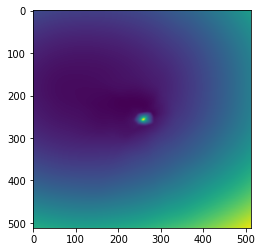

epoch 36101: 48.169189453125
epoch 36102: 48.73300552368164
epoch 36103: 48.462074279785156
epoch 36104: 48.016754150390625
epoch 36105: 48.2712287902832
epoch 36106: 48.475955963134766
epoch 36107: 49.8106689453125
epoch 36108: 47.76371765136719
epoch 36109: 47.854610443115234
epoch 36111: 48.4393196105957
epoch 36112: 48.105289459228516
epoch 36113: 47.909385681152344
epoch 36114: 48.36127471923828
epoch 36115: 48.03195571899414
epoch 36116: 47.99429702758789
epoch 36117: 48.180137634277344
epoch 36118: 47.92964172363281
epoch 36119: 47.93988800048828
epoch 36121: 48.26421356201172
epoch 36122: 48.161842346191406
epoch 36123: 48.81016540527344
epoch 36124: 47.69599533081055
epoch 36125: 48.141868591308594
epoch 36126: 47.86166763305664
epoch 36127: 48.329776763916016
epoch 36128: 47.286869049072266
epoch 36129: 48.26069259643555
epoch 36131: 47.40058135986328
epoch 36132: 48.270240783691406
epoch 36133: 48.12919235229492
epoch 36134: 48.909969329833984
epoch 36135: 48.937625885009766

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



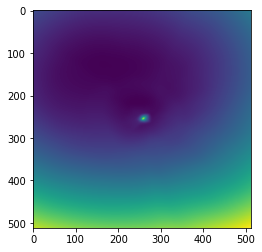

epoch 36201: 47.71342849731445
epoch 36202: 47.64823532104492
epoch 36203: 53.49673843383789
epoch 36204: 48.76974105834961
epoch 36205: 47.978797912597656
epoch 36206: 48.479122161865234
epoch 36207: 48.18573760986328
epoch 36208: 47.469051361083984
epoch 36209: 47.60999298095703
epoch 36211: 48.19247817993164
epoch 36212: 52.12705993652344
epoch 36213: 48.749061584472656
epoch 36214: 48.26704025268555
epoch 36215: 47.67106628417969
epoch 36216: 48.22575378417969
epoch 36217: 48.59584426879883
epoch 36218: 47.856719970703125
epoch 36219: 48.49256134033203
epoch 36221: 48.092567443847656
epoch 36222: 48.29368209838867
epoch 36223: 47.93141555786133
epoch 36224: 48.2894401550293
epoch 36225: 47.68333053588867
epoch 36226: 48.505409240722656
epoch 36227: 48.17447280883789
epoch 36228: 47.775657653808594
epoch 36229: 48.00355529785156
epoch 36231: 48.706932067871094
epoch 36232: 47.57139587402344
epoch 36233: 48.68364334106445
epoch 36234: 48.494510650634766
epoch 36235: 47.91440963745117

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



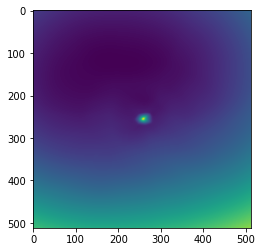

epoch 36301: 48.34994888305664
epoch 36302: 48.38248825073242
epoch 36303: 47.45939254760742
epoch 36304: 47.80470657348633
epoch 36305: 47.61566925048828
epoch 36306: 48.47408676147461
epoch 36307: 48.316802978515625
epoch 36308: 47.51874923706055
epoch 36309: 47.57477951049805
epoch 36311: 47.62270736694336
epoch 36312: 47.347145080566406
epoch 36313: 47.78852081298828
epoch 36314: 47.68838119506836
epoch 36315: 47.70138931274414
epoch 36316: 47.9980583190918
epoch 36317: 47.85836410522461
epoch 36318: 46.949913024902344
epoch 36319: 48.55036926269531
epoch 36321: 47.869258880615234
epoch 36322: 47.76715850830078
epoch 36323: 47.43761444091797
epoch 36324: 47.551021575927734
epoch 36325: 48.25830078125
epoch 36326: 47.305171966552734
epoch 36327: 47.92326354980469
epoch 36328: 52.178218841552734
epoch 36329: 49.267539978027344
epoch 36331: 47.721614837646484
epoch 36332: 47.55719757080078
epoch 36333: 47.8551139831543
epoch 36334: 48.37232971191406
epoch 36335: 48.24655532836914
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



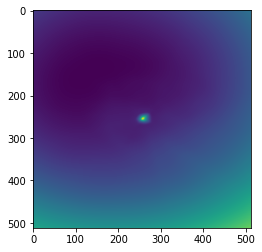

epoch 36401: 48.01518630981445
epoch 36402: 48.52982711791992
epoch 36403: 48.12215805053711
epoch 36404: 47.334083557128906
epoch 36405: 48.14503479003906
epoch 36406: 48.33524703979492
epoch 36407: 48.66777420043945
epoch 36408: 48.7559814453125
epoch 36409: 48.081787109375
epoch 36411: 48.56285858154297
epoch 36412: 49.194366455078125
epoch 36413: 47.57380676269531
epoch 36414: 47.474937438964844
epoch 36415: 49.044525146484375
epoch 36416: 47.49361038208008
epoch 36417: 48.51517105102539
epoch 36418: 48.29405975341797
epoch 36419: 48.143802642822266
epoch 36421: 48.69512939453125
epoch 36422: 47.925357818603516
epoch 36423: 48.84746551513672
epoch 36424: 47.368900299072266
epoch 36425: 48.50522994995117
epoch 36426: 48.901851654052734
epoch 36427: 48.13063049316406
epoch 36428: 47.923465728759766
epoch 36429: 48.317481994628906
epoch 36431: 47.456932067871094
epoch 36432: 47.789459228515625
epoch 36433: 48.22197341918945
epoch 36434: 47.48324203491211
epoch 36435: 48.30677032470703

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



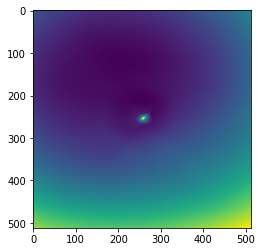

epoch 36501: 49.31836700439453
epoch 36502: 49.30674362182617
epoch 36503: 48.31874084472656
epoch 36504: 47.78675842285156
epoch 36505: 48.367103576660156
epoch 36506: 48.54755783081055
epoch 36507: 48.891441345214844
epoch 36508: 48.58179473876953
epoch 36509: 48.1641845703125
epoch 36511: 47.625152587890625
epoch 36512: 48.18734359741211
epoch 36513: 48.96302795410156
epoch 36514: 47.808509826660156
epoch 36515: 48.742347717285156
epoch 36516: 48.10548782348633
epoch 36517: 48.69617462158203
epoch 36518: 48.848384857177734
epoch 36519: 49.091590881347656
epoch 36521: 48.72743225097656
epoch 36522: 47.537574768066406
epoch 36523: 49.20637893676758
epoch 36524: 48.75020980834961
epoch 36525: 47.23756408691406
epoch 36526: 49.68772888183594
epoch 36527: 48.52477264404297
epoch 36528: 48.412410736083984
epoch 36529: 47.58699035644531
epoch 36531: 47.92298126220703
epoch 36532: 48.08050537109375
epoch 36533: 48.723388671875
epoch 36534: 49.443031311035156
epoch 36535: 47.82818603515625
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



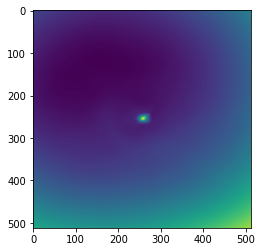

epoch 36601: 48.23640060424805
epoch 36602: 48.04996109008789
epoch 36603: 50.12269973754883
epoch 36604: 47.35803985595703
epoch 36605: 47.980594635009766
epoch 36606: 49.23188018798828
epoch 36607: 47.96328353881836
epoch 36608: 48.740684509277344
epoch 36609: 47.60869598388672
epoch 36611: 48.881778717041016
epoch 36612: 48.78921127319336
epoch 36613: 48.31749725341797
epoch 36614: 48.28414535522461
epoch 36615: 48.73784637451172
epoch 36616: 47.99441146850586
epoch 36617: 47.80710983276367
epoch 36618: 47.66971206665039
epoch 36619: 48.31527328491211
epoch 36621: 48.76346206665039
epoch 36622: 48.40578079223633
epoch 36623: 48.900062561035156
epoch 36624: 48.70248031616211
epoch 36625: 48.16542434692383
epoch 36626: 48.39796829223633
epoch 36627: 47.99847412109375
epoch 36628: 48.4592399597168
epoch 36629: 48.92442321777344
epoch 36631: 49.41340637207031
epoch 36632: 47.92571258544922
epoch 36633: 48.306087493896484
epoch 36634: 48.105506896972656
epoch 36635: 48.69477462768555
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



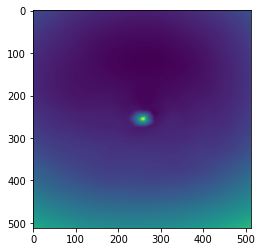

epoch 36701: 48.56779479980469
epoch 36702: 47.81764221191406
epoch 36703: 48.29894256591797
epoch 36704: 48.363311767578125
epoch 36705: 48.04353713989258
epoch 36706: 49.004432678222656
epoch 36707: 47.78157424926758
epoch 36708: 47.973201751708984
epoch 36709: 48.103118896484375
epoch 36711: 48.330284118652344
epoch 36712: 47.711883544921875
epoch 36713: 47.87306594848633
epoch 36714: 49.0191535949707
epoch 36715: 48.21022033691406
epoch 36716: 47.88417053222656
epoch 36717: 48.520328521728516
epoch 36718: 47.8218994140625
epoch 36719: 47.80548095703125
epoch 36721: 47.040992736816406
epoch 36722: 47.9772834777832
epoch 36723: 47.02829360961914
epoch 36724: 48.27299118041992
epoch 36725: 48.26938247680664
epoch 36726: 48.24578094482422
epoch 36727: 47.731964111328125
epoch 36728: 47.90840530395508
epoch 36729: 47.666160583496094
epoch 36731: 48.907169342041016
epoch 36732: 50.11576461791992
epoch 36733: 48.47328186035156
epoch 36734: 48.603450775146484
epoch 36735: 47.72418212890625

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



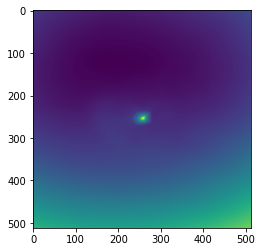

epoch 36801: 48.69704818725586
epoch 36802: 48.9024772644043
epoch 36803: 48.1972541809082
epoch 36804: 47.72589111328125
epoch 36805: 48.025089263916016
epoch 36806: 48.007484436035156
epoch 36807: 48.02458572387695
epoch 36808: 47.63656997680664
epoch 36809: 47.69976806640625
epoch 36811: 47.578956604003906
epoch 36812: 48.308372497558594
epoch 36813: 47.54293441772461
epoch 36814: 47.9529914855957
epoch 36815: 48.293182373046875
epoch 36816: 47.17110061645508
epoch 36817: 47.960662841796875
epoch 36818: 49.64471435546875
epoch 36819: 48.18216323852539
epoch 36821: 48.09490203857422
epoch 36822: 48.75809860229492
epoch 36823: 49.327674865722656
epoch 36824: 47.66764831542969
epoch 36825: 47.8519401550293
epoch 36826: 47.98412322998047
epoch 36827: 48.549842834472656
epoch 36828: 48.37025833129883
epoch 36829: 48.86954116821289
epoch 36831: 48.5840950012207
epoch 36832: 48.44334411621094
epoch 36833: 48.160301208496094
epoch 36834: 49.18077850341797
epoch 36835: 47.547264099121094
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



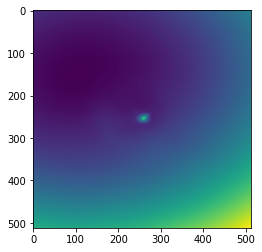

epoch 36901: 47.90809631347656
epoch 36902: 47.757530212402344
epoch 36903: 50.010746002197266
epoch 36904: 48.421485900878906
epoch 36905: 48.806453704833984
epoch 36906: 48.89457702636719
epoch 36907: 48.826114654541016
epoch 36908: 48.04442596435547
epoch 36909: 48.342952728271484
epoch 36911: 48.5936164855957
epoch 36912: 48.419612884521484
epoch 36913: 47.93022918701172
epoch 36914: 47.10082244873047
epoch 36915: 48.55249786376953
epoch 36916: 47.96342086791992
epoch 36917: 47.756038665771484
epoch 36918: 47.697792053222656
epoch 36919: 48.65668487548828
epoch 36921: 48.35368347167969
epoch 36922: 47.79706573486328
epoch 36923: 47.93170928955078
epoch 36924: 49.26630783081055
epoch 36925: 47.75235366821289
epoch 36926: 48.57855987548828
epoch 36927: 47.124488830566406
epoch 36928: 47.721290588378906
epoch 36929: 49.11799240112305
epoch 36931: 48.916526794433594
epoch 36932: 47.59247970581055
epoch 36933: 47.87971496582031
epoch 36934: 49.7802848815918
epoch 36935: 48.6401519775390

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



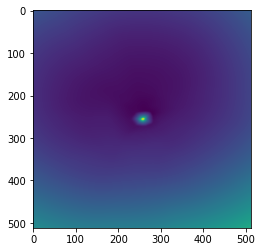

epoch 37001: 48.74553298950195
epoch 37002: 47.9656982421875
epoch 37003: 47.890769958496094
epoch 37004: 48.905189514160156
epoch 37005: 48.07364273071289
epoch 37006: 47.79861831665039
epoch 37007: 47.656131744384766
epoch 37008: 47.77680587768555
epoch 37009: 47.21295928955078
epoch 37011: 48.56099319458008
epoch 37012: 47.43367385864258
epoch 37013: 48.20364761352539
epoch 37014: 48.16823959350586
epoch 37015: 47.56141662597656
epoch 37016: 48.85566711425781
epoch 37017: 50.20746612548828
epoch 37018: 49.17066192626953
epoch 37019: 48.47354507446289
epoch 37021: 47.94916915893555
epoch 37022: 48.977439880371094
epoch 37023: 48.830543518066406
epoch 37024: 48.40563201904297
epoch 37025: 48.31917190551758
epoch 37026: 47.7568244934082
epoch 37027: 49.477073669433594
epoch 37028: 48.85798645019531
epoch 37029: 47.86087417602539
epoch 37031: 48.306846618652344
epoch 37032: 48.290252685546875
epoch 37033: 48.04046630859375
epoch 37034: 47.71370315551758
epoch 37035: 49.104393005371094
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



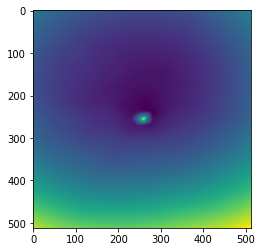

epoch 37101: 48.04726028442383
epoch 37102: 48.701560974121094
epoch 37103: 47.46250915527344
epoch 37104: 49.82624053955078
epoch 37105: 49.093482971191406
epoch 37106: 48.22404479980469
epoch 37107: 48.3184928894043
epoch 37108: 48.17464065551758
epoch 37109: 47.80962371826172
epoch 37111: 47.74415969848633
epoch 37112: 48.89552688598633
epoch 37113: 47.63469314575195
epoch 37114: 47.8371696472168
epoch 37115: 49.34031295776367
epoch 37116: 48.60603332519531
epoch 37117: 47.8797607421875
epoch 37118: 49.16437530517578
epoch 37119: 48.444522857666016
epoch 37121: 48.133934020996094
epoch 37122: 48.49041748046875
epoch 37123: 50.050785064697266
epoch 37124: 48.03457260131836
epoch 37125: 49.21711730957031
epoch 37126: 48.278221130371094
epoch 37127: 47.954532623291016
epoch 37128: 48.40270233154297
epoch 37129: 47.94656753540039
epoch 37131: 48.691650390625
epoch 37132: 48.64566421508789
epoch 37133: 48.86061096191406
epoch 37134: 49.41070556640625
epoch 37135: 47.906288146972656
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



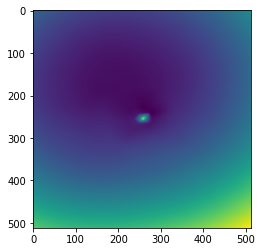

epoch 37201: 48.35170364379883
epoch 37202: 48.7347297668457
epoch 37203: 48.151695251464844
epoch 37204: 48.793724060058594
epoch 37205: 48.30320739746094
epoch 37206: 47.487510681152344
epoch 37207: 48.46818542480469
epoch 37208: 48.987850189208984
epoch 37209: 47.28452682495117
epoch 37211: 48.128875732421875
epoch 37212: 48.295188903808594
epoch 37213: 48.0926628112793
epoch 37214: 47.32463455200195
epoch 37215: 47.941978454589844
epoch 37216: 48.14624786376953
epoch 37217: 47.85437774658203
epoch 37218: 48.218177795410156
epoch 37219: 47.9783935546875
epoch 37221: 48.02278518676758
epoch 37222: 47.578453063964844
epoch 37223: 48.70741653442383
epoch 37224: 47.60014343261719
epoch 37225: 48.05607223510742
epoch 37226: 48.831905364990234
epoch 37227: 48.72660446166992
epoch 37228: 48.636444091796875
epoch 37229: 47.33295822143555
epoch 37231: 48.017051696777344
epoch 37232: 49.378265380859375
epoch 37233: 48.79302215576172
epoch 37234: 51.322601318359375
epoch 37235: 48.333908081054

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



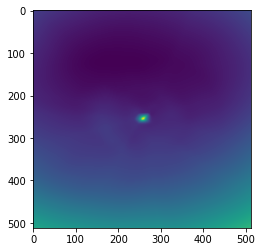

epoch 37301: 49.12972640991211
epoch 37302: 48.84450149536133
epoch 37303: 48.90220260620117
epoch 37304: 48.77268600463867
epoch 37305: 48.359954833984375
epoch 37306: 48.359249114990234
epoch 37307: 48.28781509399414
epoch 37308: 48.77888488769531
epoch 37309: 48.2186279296875
epoch 37311: 49.210262298583984
epoch 37312: 49.351661682128906
epoch 37313: 47.98551940917969
epoch 37314: 49.27478790283203
epoch 37315: 48.34184646606445
epoch 37316: 48.48299026489258
epoch 37317: 49.308746337890625
epoch 37318: 49.487770080566406
epoch 37319: 48.07649230957031
epoch 37321: 48.55916976928711
epoch 37322: 51.442115783691406
epoch 37323: 48.03053283691406
epoch 37324: 48.110958099365234
epoch 37325: 47.81819534301758
epoch 37326: 48.47478485107422
epoch 37327: 47.66404342651367
epoch 37328: 47.810611724853516
epoch 37329: 48.078765869140625
epoch 37331: 48.68778610229492
epoch 37332: 48.25496292114258
epoch 37333: 47.99364471435547
epoch 37334: 48.13648223876953
epoch 37335: 47.78879547119140

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



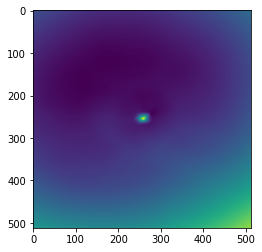

epoch 37401: 48.495208740234375
epoch 37402: 47.56101608276367
epoch 37403: 47.798072814941406
epoch 37404: 48.034427642822266
epoch 37405: 47.717830657958984
epoch 37406: 47.58975601196289
epoch 37407: 47.925025939941406
epoch 37408: 47.727867126464844
epoch 37409: 48.04851531982422
epoch 37411: 47.886985778808594
epoch 37412: 48.3970947265625
epoch 37413: 48.45058059692383
epoch 37414: 49.08281707763672
epoch 37415: 48.546932220458984
epoch 37416: 47.75951385498047
epoch 37417: 49.832740783691406
epoch 37418: 48.817142486572266
epoch 37419: 48.75312042236328
epoch 37421: 48.116451263427734
epoch 37422: 47.88688659667969
epoch 37423: 47.49174880981445
epoch 37424: 48.17960739135742
epoch 37425: 48.72987365722656
epoch 37426: 48.02549362182617
epoch 37427: 47.017662048339844
epoch 37428: 48.1328010559082
epoch 37429: 48.821475982666016
epoch 37431: 48.762855529785156
epoch 37432: 48.74020767211914
epoch 37433: 47.66059494018555
epoch 37434: 48.76850509643555
epoch 37435: 47.56027221679

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



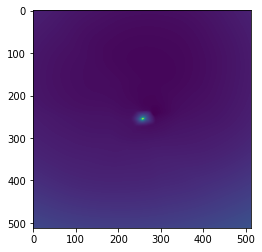

epoch 37501: 48.13310241699219
epoch 37502: 49.15936279296875
epoch 37503: 48.480018615722656
epoch 37504: 48.87798309326172
epoch 37505: 49.004276275634766
epoch 37506: 47.590721130371094
epoch 37507: 49.588897705078125
epoch 37508: 48.660743713378906
epoch 37509: 48.19165802001953
epoch 37511: 48.96868896484375
epoch 37512: 47.7310905456543
epoch 37513: 48.54965591430664
epoch 37514: 48.71270751953125
epoch 37515: 48.45976257324219
epoch 37516: 48.19685745239258
epoch 37517: 48.1710319519043
epoch 37518: 47.91086959838867
epoch 37519: 48.107810974121094
epoch 37521: 47.55635070800781
epoch 37522: 47.47401809692383
epoch 37523: 47.831871032714844
epoch 37524: 48.991207122802734
epoch 37525: 47.545833587646484
epoch 37526: 48.24007034301758
epoch 37527: 48.462303161621094
epoch 37528: 48.25448226928711
epoch 37529: 48.73845672607422
epoch 37531: 47.82661437988281
epoch 37532: 47.09040832519531
epoch 37533: 48.22335433959961
epoch 37534: 47.94626998901367
epoch 37535: 47.989532470703125

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



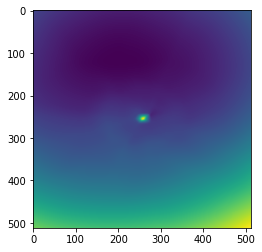

epoch 37601: 48.77165603637695
epoch 37602: 47.967041015625
epoch 37603: 49.047733306884766
epoch 37604: 48.12499237060547
epoch 37605: 47.976646423339844
epoch 37606: 48.375789642333984
epoch 37607: 48.87824249267578
epoch 37608: 48.486820220947266
epoch 37609: 48.30266571044922
epoch 37611: 47.89298629760742
epoch 37612: 48.45291519165039
epoch 37613: 48.729286193847656
epoch 37614: 48.0207405090332
epoch 37615: 47.59000015258789
epoch 37616: 48.35759353637695
epoch 37617: 48.47988510131836
epoch 37618: 48.74974822998047
epoch 37619: 48.72148513793945
epoch 37621: 49.68196105957031
epoch 37622: 48.63214874267578
epoch 37623: 47.84005355834961
epoch 37624: 49.071388244628906
epoch 37625: 48.72168731689453
epoch 37626: 49.014015197753906
epoch 37627: 49.085472106933594
epoch 37628: 48.034114837646484
epoch 37629: 48.74909591674805
epoch 37631: 49.1448860168457
epoch 37632: 48.83197021484375
epoch 37633: 48.88257598876953
epoch 37634: 48.82141876220703
epoch 37635: 48.71160125732422
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



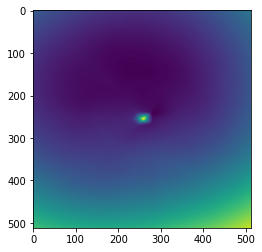

epoch 37701: 47.35533905029297
epoch 37702: 49.11184310913086
epoch 37703: 48.305171966552734
epoch 37704: 47.504798889160156
epoch 37705: 48.12247085571289
epoch 37706: 47.715087890625
epoch 37707: 47.406951904296875
epoch 37708: 47.768245697021484
epoch 37709: 48.1701774597168
epoch 37711: 49.969356536865234
epoch 37712: 47.67818069458008
epoch 37713: 47.994300842285156
epoch 37714: 48.01957321166992
epoch 37715: 47.70676803588867
epoch 37716: 49.15093994140625
epoch 37717: 48.491180419921875
epoch 37718: 48.59126663208008
epoch 37719: 48.32807540893555
epoch 37721: 48.06666564941406
epoch 37722: 48.50144577026367
epoch 37723: 49.023834228515625
epoch 37724: 48.127601623535156
epoch 37725: 48.742679595947266
epoch 37726: 48.46134567260742
epoch 37727: 47.76551818847656
epoch 37728: 47.935386657714844
epoch 37729: 48.95782470703125
epoch 37731: 47.68577575683594
epoch 37732: 48.28654098510742
epoch 37733: 48.50822830200195
epoch 37734: 48.769142150878906
epoch 37735: 48.05239105224609

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



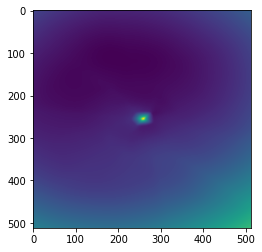

epoch 37801: 49.007015228271484
epoch 37802: 48.28789520263672
epoch 37803: 48.16047668457031
epoch 37804: 48.491233825683594
epoch 37805: 47.94182205200195
epoch 37806: 47.69832229614258
epoch 37807: 47.76094436645508
epoch 37808: 47.7088737487793
epoch 37809: 47.66410827636719
epoch 37811: 49.185302734375
epoch 37812: 47.612762451171875
epoch 37813: 47.953224182128906
epoch 37814: 49.137962341308594
epoch 37815: 48.02436065673828
epoch 37816: 47.6453742980957
epoch 37817: 48.91956329345703
epoch 37818: 48.82767105102539
epoch 37819: 48.81464767456055
epoch 37821: 48.493751525878906
epoch 37822: 49.09294891357422
epoch 37823: 47.442073822021484
epoch 37824: 49.57556915283203
epoch 37825: 48.322418212890625
epoch 37826: 48.98523712158203
epoch 37827: 47.680389404296875
epoch 37828: 48.97074890136719
epoch 37829: 47.948116302490234
epoch 37831: 48.6159553527832
epoch 37832: 48.10122299194336
epoch 37833: 47.53490447998047
epoch 37834: 49.3669548034668
epoch 37835: 48.161277770996094
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



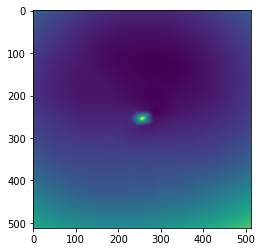

epoch 37901: 47.44178009033203
epoch 37902: 47.87856674194336
epoch 37903: 48.02465057373047
epoch 37904: 50.2174072265625
epoch 37905: 49.086055755615234
epoch 37906: 49.08986282348633
epoch 37907: 48.224708557128906
epoch 37908: 48.85177230834961
epoch 37909: 48.20363235473633
epoch 37911: 48.05335998535156
epoch 37912: 48.68085479736328
epoch 37913: 48.40422821044922
epoch 37914: 48.266944885253906
epoch 37915: 48.28828048706055
epoch 37916: 48.564876556396484
epoch 37917: 47.85964584350586
epoch 37918: 47.51641082763672
epoch 37919: 48.780147552490234
epoch 37921: 48.36393356323242
epoch 37922: 47.890838623046875
epoch 37923: 48.48697280883789
epoch 37924: 47.996726989746094
epoch 37925: 48.265350341796875
epoch 37926: 48.2127799987793
epoch 37927: 47.757179260253906
epoch 37928: 48.01767349243164
epoch 37929: 49.824371337890625
epoch 37931: 47.88502883911133
epoch 37932: 48.098182678222656
epoch 37933: 48.836753845214844
epoch 37934: 48.6610107421875
epoch 37935: 48.26018142700195

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



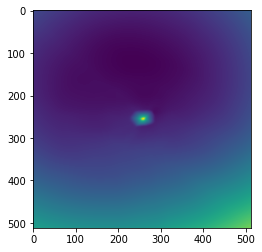

epoch 38001: 47.874908447265625
epoch 38002: 48.62928009033203
epoch 38003: 47.73226547241211
epoch 38004: 47.47099685668945
epoch 38005: 47.8896369934082
epoch 38006: 47.22190475463867
epoch 38007: 48.51545715332031
epoch 38008: 47.50739288330078
epoch 38009: 48.105552673339844
epoch 38011: 47.983585357666016
epoch 38012: 48.56725311279297
epoch 38013: 48.03981018066406
epoch 38014: 48.59983825683594
epoch 38015: 49.36880874633789
epoch 38016: 48.57490539550781
epoch 38017: 48.4452018737793
epoch 38018: 47.7847900390625
epoch 38019: 47.990509033203125
epoch 38021: 48.19499206542969
epoch 38022: 47.985904693603516
epoch 38023: 48.07239532470703
epoch 38024: 48.688899993896484
epoch 38025: 47.24772262573242
epoch 38026: 48.3497314453125
epoch 38027: 48.836238861083984
epoch 38028: 48.43574523925781
epoch 38029: 47.62596893310547
epoch 38031: 47.56047821044922
epoch 38032: 47.77226257324219
epoch 38033: 47.57148361206055
epoch 38034: 47.751983642578125
epoch 38035: 47.97525405883789
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



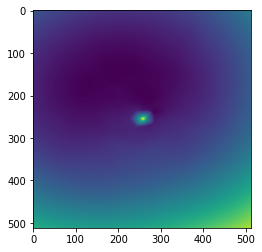

epoch 38101: 48.37058639526367
epoch 38102: 47.563228607177734
epoch 38103: 48.04087829589844
epoch 38104: 47.285057067871094
epoch 38105: 48.03805160522461
epoch 38106: 48.73991394042969
epoch 38107: 47.86272048950195
epoch 38108: 47.98544692993164
epoch 38109: 47.79133224487305
epoch 38111: 47.40730667114258
epoch 38112: 48.8309440612793
epoch 38113: 48.38565444946289
epoch 38114: 48.92572784423828
epoch 38115: 48.27431869506836
epoch 38116: 48.094825744628906
epoch 38117: 48.996543884277344
epoch 38118: 47.97687911987305
epoch 38119: 48.34099197387695
epoch 38121: 48.062225341796875
epoch 38122: 47.74835205078125
epoch 38123: 48.47975158691406
epoch 38124: 49.57511901855469
epoch 38125: 48.865108489990234
epoch 38126: 47.679412841796875
epoch 38127: 48.61663055419922
epoch 38128: 49.04007339477539
epoch 38129: 48.67425537109375
epoch 38131: 48.099117279052734
epoch 38132: 48.09136962890625
epoch 38133: 48.04536056518555
epoch 38134: 48.50480651855469
epoch 38135: 49.50542068481445
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



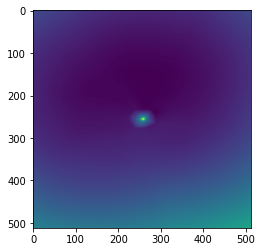

epoch 38201: 48.20651626586914
epoch 38202: 48.51704788208008
epoch 38203: 48.705020904541016
epoch 38204: 48.12897872924805
epoch 38205: 47.63051223754883
epoch 38206: 48.920310974121094
epoch 38207: 47.71512985229492
epoch 38208: 47.797481536865234
epoch 38209: 48.59819030761719
epoch 38211: 47.72916793823242
epoch 38212: 48.783180236816406
epoch 38213: 48.10727310180664
epoch 38214: 48.416038513183594
epoch 38215: 48.8096923828125
epoch 38216: 48.04720687866211
epoch 38217: 48.539947509765625
epoch 38218: 47.94255828857422
epoch 38219: 47.961273193359375
epoch 38221: 47.589439392089844
epoch 38222: 48.417259216308594
epoch 38223: 48.18220520019531
epoch 38224: 48.149322509765625
epoch 38225: 48.68082046508789
epoch 38226: 47.95454025268555
epoch 38227: 48.495750427246094
epoch 38228: 48.503944396972656
epoch 38229: 49.89223098754883
epoch 38231: 48.36464309692383
epoch 38232: 47.961238861083984
epoch 38233: 48.85006332397461
epoch 38234: 47.95775604248047
epoch 38235: 49.36265945434

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



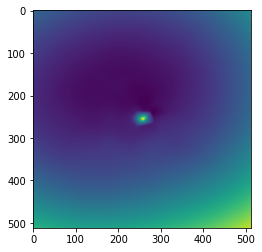

epoch 38301: 47.80827713012695
epoch 38302: 47.69855499267578
epoch 38303: 47.223846435546875
epoch 38304: 47.8165168762207
epoch 38305: 47.705833435058594
epoch 38306: 47.17835235595703
epoch 38307: 48.238975524902344
epoch 38308: 51.466217041015625
epoch 38309: 48.28157424926758
epoch 38311: 48.04225540161133
epoch 38312: 47.68825149536133
epoch 38313: 48.62767791748047
epoch 38314: 48.121116638183594
epoch 38315: 48.54888153076172
epoch 38316: 47.87138748168945
epoch 38317: 49.56393814086914
epoch 38318: 48.221797943115234
epoch 38319: 47.87335205078125
epoch 38321: 48.209190368652344
epoch 38322: 48.178321838378906
epoch 38323: 46.847923278808594
epoch 38324: 48.811790466308594
epoch 38325: 48.5260009765625
epoch 38326: 47.51254653930664
epoch 38327: 49.56812286376953
epoch 38328: 49.137176513671875
epoch 38329: 47.40894317626953
epoch 38331: 48.38158416748047
epoch 38332: 49.12224197387695
epoch 38333: 48.23288345336914
epoch 38334: 47.77107238769531
epoch 38335: 48.33740997314453

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



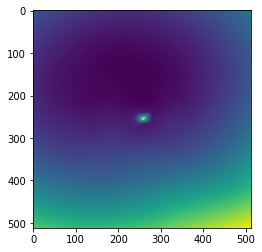

epoch 38401: 47.24733352661133
epoch 38402: 48.48881912231445
epoch 38403: 48.431419372558594
epoch 38404: 48.517547607421875
epoch 38405: 48.04389190673828
epoch 38406: 47.251373291015625
epoch 38407: 47.902259826660156
epoch 38408: 48.51763153076172
epoch 38409: 47.85417556762695
epoch 38411: 48.051353454589844
epoch 38412: 49.175376892089844
epoch 38413: 48.447696685791016
epoch 38414: 48.1112174987793
epoch 38415: 48.097137451171875
epoch 38416: 47.99154281616211
epoch 38417: 48.5575065612793
epoch 38418: 48.63313293457031
epoch 38419: 47.931541442871094
epoch 38421: 48.852752685546875
epoch 38422: 48.99443435668945
epoch 38423: 48.37126541137695
epoch 38424: 47.829872131347656
epoch 38425: 47.943565368652344
epoch 38426: 48.63538360595703
epoch 38427: 48.37058639526367
epoch 38428: 48.40241241455078
epoch 38429: 48.48011779785156
epoch 38431: 49.14247512817383
epoch 38432: 48.522804260253906
epoch 38433: 48.1616096496582
epoch 38434: 47.81265640258789
epoch 38435: 47.4674720764160

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



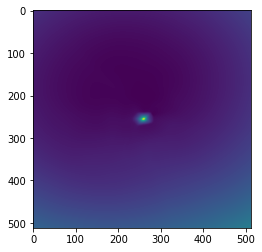

epoch 38501: 48.00071716308594
epoch 38502: 48.160057067871094
epoch 38503: 48.229618072509766
epoch 38504: 48.56300354003906
epoch 38505: 49.082000732421875
epoch 38506: 48.71464157104492
epoch 38507: 49.348602294921875
epoch 38508: 49.25142288208008
epoch 38509: 47.870697021484375
epoch 38511: 48.2260856628418
epoch 38512: 48.50700759887695
epoch 38513: 48.06565856933594
epoch 38514: 47.38657760620117
epoch 38515: 47.27922058105469
epoch 38516: 48.869503021240234
epoch 38517: 49.497711181640625
epoch 38518: 48.45619201660156
epoch 38519: 48.90815353393555
epoch 38521: 48.376739501953125
epoch 38522: 48.43280029296875
epoch 38523: 48.393959045410156
epoch 38524: 48.37827682495117
epoch 38525: 49.696044921875
epoch 38526: 47.40884780883789
epoch 38527: 48.218379974365234
epoch 38528: 47.3347053527832
epoch 38529: 47.723655700683594
epoch 38531: 48.63699722290039
epoch 38532: 48.062110900878906
epoch 38533: 48.96013641357422
epoch 38534: 48.073448181152344
epoch 38535: 49.50304412841797

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



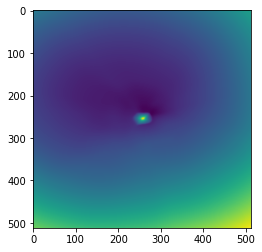

epoch 38601: 47.979278564453125
epoch 38602: 47.06972885131836
epoch 38603: 48.47301483154297
epoch 38604: 48.51264190673828
epoch 38605: 47.66295623779297
epoch 38606: 47.63009262084961
epoch 38607: 47.8563346862793
epoch 38608: 47.84586715698242
epoch 38609: 50.549678802490234
epoch 38611: 48.00718688964844
epoch 38612: 47.66972351074219
epoch 38613: 48.587955474853516
epoch 38614: 48.335975646972656
epoch 38615: 47.607139587402344
epoch 38616: 47.92898178100586
epoch 38617: 47.494327545166016
epoch 38618: 47.48698425292969
epoch 38619: 48.12915802001953
epoch 38621: 48.73805618286133
epoch 38622: 47.932552337646484
epoch 38623: 50.45476531982422
epoch 38624: 49.11748123168945
epoch 38625: 48.175697326660156
epoch 38626: 49.29910659790039
epoch 38627: 48.624549865722656
epoch 38628: 48.08582305908203
epoch 38629: 47.71792984008789
epoch 38631: 48.44986343383789
epoch 38632: 49.395729064941406
epoch 38633: 48.14383316040039
epoch 38634: 48.70938491821289
epoch 38635: 48.31828689575195

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



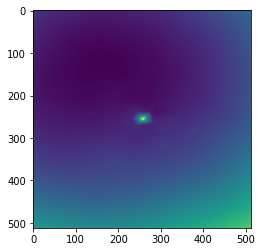

epoch 38701: 48.17473220825195
epoch 38702: 48.11912536621094
epoch 38703: 47.96686553955078
epoch 38704: 48.069847106933594
epoch 38705: 47.897987365722656
epoch 38706: 47.954673767089844
epoch 38707: 47.73280715942383
epoch 38708: 47.540950775146484
epoch 38709: 47.808555603027344
epoch 38711: 47.86677169799805
epoch 38712: 47.38767623901367
epoch 38713: 48.50847244262695
epoch 38714: 47.85920333862305
epoch 38715: 47.35823059082031
epoch 38716: 48.409786224365234
epoch 38717: 48.58849334716797
epoch 38718: 47.99576950073242
epoch 38719: 48.272212982177734
epoch 38721: 48.222164154052734
epoch 38722: 48.16071701049805
epoch 38723: 48.26056671142578
epoch 38724: 47.338905334472656
epoch 38725: 48.45273971557617
epoch 38726: 48.27523422241211
epoch 38727: 48.60507583618164
epoch 38728: 48.467193603515625
epoch 38729: 47.52263259887695
epoch 38731: 48.43541717529297
epoch 38732: 48.33573913574219
epoch 38733: 47.618125915527344
epoch 38734: 48.2702522277832
epoch 38735: 48.7959213256835

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



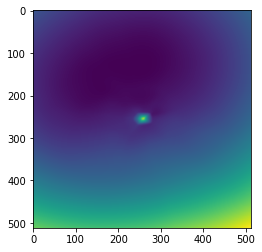

epoch 38801: 51.0306396484375
epoch 38802: 48.58195877075195
epoch 38803: 47.10963439941406
epoch 38804: 48.0930290222168
epoch 38805: 48.806556701660156
epoch 38806: 47.42763900756836
epoch 38807: 48.34608840942383
epoch 38808: 48.933040618896484
epoch 38809: 47.29130554199219
epoch 38811: 47.83515930175781
epoch 38812: 47.84463119506836
epoch 38813: 48.030120849609375
epoch 38814: 48.934730529785156
epoch 38815: 48.18800354003906
epoch 38816: 47.94129943847656
epoch 38817: 46.761051177978516
epoch 38818: 48.06429672241211
epoch 38819: 48.4154167175293
epoch 38821: 49.07111740112305
epoch 38822: 48.49595642089844
epoch 38823: 48.22330856323242
epoch 38824: 48.737152099609375
epoch 38825: 47.6917839050293
epoch 38826: 48.9680290222168
epoch 38827: 48.18315887451172
epoch 38828: 48.58890914916992
epoch 38829: 47.99094009399414
epoch 38831: 48.439849853515625
epoch 38832: 47.84292984008789
epoch 38833: 48.648223876953125
epoch 38834: 48.83938217163086
epoch 38835: 48.2805061340332
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



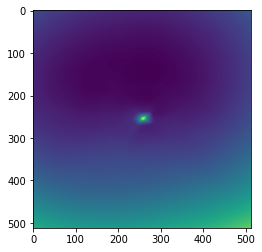

epoch 38901: 48.10936737060547
epoch 38902: 48.950557708740234
epoch 38903: 47.973060607910156
epoch 38904: 47.94791793823242
epoch 38905: 47.93853759765625
epoch 38906: 48.85210037231445
epoch 38907: 48.47785949707031
epoch 38908: 48.11635208129883
epoch 38909: 48.07866287231445
epoch 38911: 48.19389724731445
epoch 38912: 48.17863082885742
epoch 38913: 48.83692932128906
epoch 38914: 48.72256088256836
epoch 38915: 48.56657409667969
epoch 38916: 48.6651496887207
epoch 38917: 48.37520980834961
epoch 38918: 48.44308090209961
epoch 38919: 47.45427703857422
epoch 38921: 47.932674407958984
epoch 38922: 48.9393310546875
epoch 38923: 48.76729202270508
epoch 38924: 49.08717346191406
epoch 38925: 48.2578010559082
epoch 38926: 47.79299545288086
epoch 38927: 47.363685607910156
epoch 38928: 47.81732940673828
epoch 38929: 48.558372497558594
epoch 38931: 48.507999420166016
epoch 38932: 47.767608642578125
epoch 38933: 48.30959701538086
epoch 38934: 49.02366638183594
epoch 38935: 49.32644271850586
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



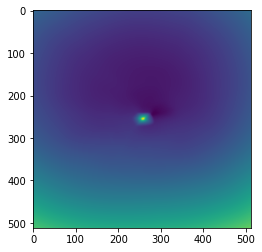

epoch 39001: 47.81698226928711
epoch 39002: 49.151283264160156
epoch 39003: 47.3837776184082
epoch 39004: 47.8560676574707
epoch 39005: 48.213722229003906
epoch 39006: 49.58367919921875
epoch 39007: 48.26383590698242
epoch 39008: 50.66965103149414
epoch 39009: 47.90787887573242
epoch 39011: 47.39265060424805
epoch 39012: 47.81127166748047
epoch 39013: 47.80442428588867
epoch 39014: 48.260833740234375
epoch 39015: 47.9947509765625
epoch 39016: 47.98758316040039
epoch 39017: 48.19477844238281
epoch 39018: 48.22412109375
epoch 39019: 48.33417510986328
epoch 39021: 47.75009536743164
epoch 39022: 48.38813781738281
epoch 39023: 48.911705017089844
epoch 39024: 47.96913146972656
epoch 39025: 48.231689453125
epoch 39026: 48.41475296020508
epoch 39027: 48.546138763427734
epoch 39028: 47.648406982421875
epoch 39029: 48.46613693237305
epoch 39031: 48.14529037475586
epoch 39032: 48.446407318115234
epoch 39033: 48.612327575683594
epoch 39034: 47.736289978027344
epoch 39035: 47.558448791503906
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



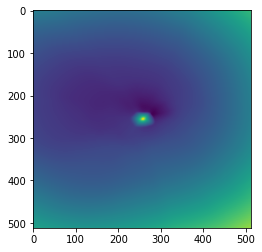

epoch 39101: 47.9161376953125
epoch 39102: 48.4841194152832
epoch 39103: 47.79451370239258
epoch 39104: 48.76002502441406
epoch 39105: 48.366024017333984
epoch 39106: 47.77363586425781
epoch 39107: 47.86309051513672
epoch 39108: 48.869407653808594
epoch 39109: 48.888301849365234
epoch 39111: 48.20939254760742
epoch 39112: 48.483646392822266
epoch 39113: 47.66859817504883
epoch 39114: 47.996829986572266
epoch 39115: 48.776649475097656
epoch 39116: 47.20615005493164
epoch 39117: 47.468666076660156
epoch 39118: 47.45877456665039
epoch 39119: 47.483970642089844
epoch 39121: 50.71400833129883
epoch 39122: 47.81211471557617
epoch 39123: 48.8961296081543
epoch 39124: 47.83464813232422
epoch 39125: 47.596805572509766
epoch 39126: 48.25185775756836
epoch 39127: 50.394500732421875
epoch 39128: 48.12574768066406
epoch 39129: 47.909061431884766
epoch 39131: 48.54955291748047
epoch 39132: 48.40286636352539
epoch 39133: 48.02015686035156
epoch 39134: 47.54106521606445
epoch 39135: 48.40618896484375


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



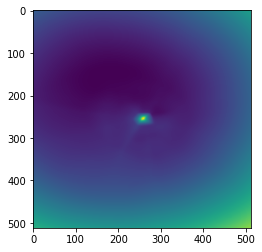

epoch 39201: 48.17534255981445
epoch 39202: 47.43087387084961
epoch 39203: 48.0780029296875
epoch 39204: 48.57102584838867
epoch 39205: 47.94861602783203
epoch 39206: 48.394962310791016
epoch 39207: 47.8773193359375
epoch 39208: 49.98048782348633
epoch 39209: 47.55439376831055
epoch 39211: 47.82499694824219
epoch 39212: 48.45212173461914
epoch 39213: 47.5096435546875
epoch 39214: 48.1174201965332
epoch 39215: 47.50827407836914
epoch 39216: 49.112876892089844
epoch 39217: 48.84125900268555
epoch 39218: 48.6072998046875
epoch 39219: 48.42690658569336
epoch 39221: 48.13777160644531
epoch 39222: 48.761417388916016
epoch 39223: 47.48257827758789
epoch 39224: 48.53487014770508
epoch 39225: 48.64085388183594
epoch 39226: 48.9403190612793
epoch 39227: 48.36579895019531
epoch 39228: 48.23690414428711
epoch 39229: 48.36762237548828
epoch 39231: 47.36151123046875
epoch 39232: 48.05254364013672
epoch 39233: 47.54609680175781
epoch 39234: 48.45412826538086
epoch 39235: 47.46147918701172
epoch 39236

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



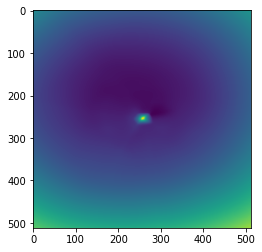

epoch 39301: 47.868186950683594
epoch 39302: 47.98149108886719
epoch 39303: 48.11568069458008
epoch 39304: 47.676353454589844
epoch 39305: 51.056854248046875
epoch 39306: 48.29901885986328
epoch 39307: 48.46412658691406
epoch 39308: 47.65943908691406
epoch 39309: 47.98711395263672
epoch 39311: 48.307437896728516
epoch 39312: 48.147613525390625
epoch 39313: 48.722923278808594
epoch 39314: 48.78183364868164
epoch 39315: 48.34395980834961
epoch 39316: 48.03636932373047
epoch 39317: 47.654258728027344
epoch 39318: 47.92637634277344
epoch 39319: 47.865962982177734
epoch 39321: 47.75593948364258
epoch 39322: 47.31123733520508
epoch 39323: 48.35369873046875
epoch 39324: 47.82465744018555
epoch 39325: 47.56781005859375
epoch 39326: 48.0979118347168
epoch 39327: 48.603492736816406
epoch 39328: 48.58832550048828
epoch 39329: 48.02801513671875
epoch 39331: 47.83037185668945
epoch 39332: 49.15999221801758
epoch 39333: 47.65227508544922
epoch 39334: 47.612709045410156
epoch 39335: 47.82640075683594

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



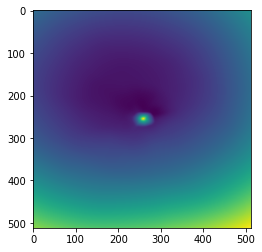

epoch 39401: 48.40912628173828
epoch 39402: 47.60625076293945
epoch 39403: 47.91155242919922
epoch 39404: 48.650733947753906
epoch 39405: 47.61162567138672
epoch 39406: 48.438716888427734
epoch 39407: 47.74270248413086
epoch 39408: 48.48524475097656
epoch 39409: 48.92321014404297
epoch 39411: 47.631744384765625
epoch 39412: 49.07997131347656
epoch 39413: 47.380706787109375
epoch 39414: 47.4273567199707
epoch 39415: 47.95509338378906
epoch 39416: 47.68901443481445
epoch 39417: 47.98463821411133
epoch 39418: 47.605186462402344
epoch 39419: 48.019222259521484
epoch 39421: 48.163726806640625
epoch 39422: 48.58903121948242
epoch 39423: 47.42042541503906
epoch 39424: 47.4768180847168
epoch 39425: 47.96651840209961
epoch 39426: 48.03337097167969
epoch 39427: 47.76945114135742
epoch 39428: 48.09255599975586
epoch 39429: 47.53465270996094
epoch 39431: 47.991634368896484
epoch 39432: 47.74330520629883
epoch 39433: 47.93877029418945
epoch 39434: 47.83934020996094
epoch 39435: 47.59435272216797
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



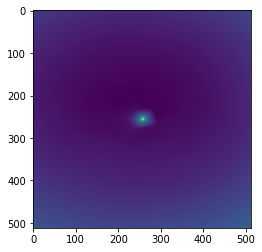

epoch 39501: 48.769775390625
epoch 39502: 48.212554931640625
epoch 39503: 48.7530517578125
epoch 39504: 47.57301330566406
epoch 39505: 48.55390930175781
epoch 39506: 47.860443115234375
epoch 39507: 48.89700698852539
epoch 39508: 48.3668212890625
epoch 39509: 47.94123077392578
epoch 39511: 48.56748962402344
epoch 39512: 47.74229431152344
epoch 39513: 48.213294982910156
epoch 39514: 55.08192443847656
epoch 39515: 48.40587615966797
epoch 39516: 48.40333938598633
epoch 39517: 48.2606201171875
epoch 39518: 48.662109375
epoch 39519: 48.094451904296875
epoch 39521: 48.40742874145508
epoch 39522: 47.82748794555664
epoch 39523: 48.60871505737305
epoch 39524: 48.0294189453125
epoch 39525: 48.489234924316406
epoch 39526: 49.29231262207031
epoch 39527: 48.12051010131836
epoch 39528: 48.028568267822266
epoch 39529: 48.67119598388672
epoch 39531: 48.52284240722656
epoch 39532: 48.126712799072266
epoch 39533: 48.76091766357422
epoch 39534: 47.56559371948242
epoch 39535: 47.88719940185547
epoch 39536:

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



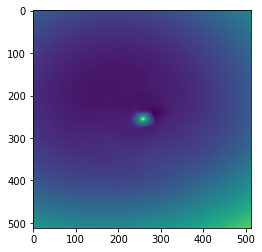

epoch 39601: 47.545860290527344
epoch 39602: 48.824012756347656
epoch 39603: 48.22475051879883
epoch 39604: 48.059608459472656
epoch 39605: 47.43035888671875
epoch 39606: 48.007896423339844
epoch 39607: 47.99162673950195
epoch 39608: 47.862247467041016
epoch 39609: 48.52010726928711
epoch 39611: 47.82710647583008
epoch 39612: 47.92774963378906
epoch 39613: 48.277217864990234
epoch 39614: 47.71619415283203
epoch 39615: 47.690921783447266
epoch 39616: 51.63575744628906
epoch 39617: 48.210540771484375
epoch 39618: 48.793704986572266
epoch 39619: 48.003631591796875
epoch 39621: 48.6843147277832
epoch 39622: 48.44643783569336
epoch 39623: 47.83369064331055
epoch 39624: 48.70105743408203
epoch 39625: 48.58992004394531
epoch 39626: 47.38514709472656
epoch 39627: 47.801090240478516
epoch 39628: 48.290428161621094
epoch 39629: 48.10686111450195
epoch 39631: 48.69490051269531
epoch 39632: 48.61762237548828
epoch 39633: 48.45615005493164
epoch 39634: 48.128692626953125
epoch 39635: 48.71189498901

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



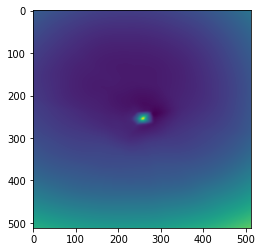

epoch 39701: 48.00713348388672
epoch 39702: 47.821083068847656
epoch 39703: 48.118324279785156
epoch 39704: 48.48838806152344
epoch 39705: 47.82918930053711
epoch 39706: 47.40947341918945
epoch 39707: 47.79795455932617
epoch 39708: 47.4746208190918
epoch 39709: 47.69773864746094
epoch 39711: 47.72677230834961
epoch 39712: 47.77451705932617
epoch 39713: 47.78999328613281
epoch 39714: 48.795379638671875
epoch 39715: 48.4471435546875
epoch 39716: 48.66326904296875
epoch 39717: 47.31642150878906
epoch 39718: 47.478755950927734
epoch 39719: 48.901817321777344
epoch 39721: 48.293846130371094
epoch 39722: 48.20224380493164
epoch 39723: 47.8954963684082
epoch 39724: 47.75612258911133
epoch 39725: 48.65019226074219
epoch 39726: 47.87642288208008
epoch 39727: 47.81272506713867
epoch 39728: 48.868988037109375
epoch 39729: 47.92290496826172
epoch 39731: 47.9735107421875
epoch 39732: 48.0610466003418
epoch 39733: 48.05893325805664
epoch 39734: 47.444339752197266
epoch 39735: 48.24161148071289
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



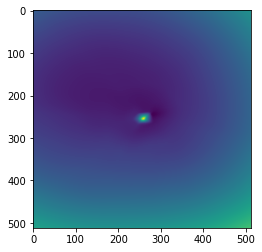

epoch 39801: 49.43243408203125
epoch 39802: 48.722755432128906
epoch 39803: 49.08599090576172
epoch 39804: 48.45992660522461
epoch 39805: 48.169376373291016
epoch 39806: 48.038509368896484
epoch 39807: 48.00657272338867
epoch 39808: 47.7751350402832
epoch 39809: 47.39067077636719
epoch 39811: 47.800655364990234
epoch 39812: 47.71590042114258
epoch 39813: 47.20215606689453
epoch 39814: 48.177642822265625
epoch 39815: 47.50630187988281
epoch 39816: 48.43021011352539
epoch 39817: 47.638126373291016
epoch 39818: 47.68606948852539
epoch 39819: 47.581260681152344
epoch 39821: 48.52268600463867
epoch 39822: 47.84217834472656
epoch 39823: 47.84678649902344
epoch 39824: 48.66405487060547
epoch 39825: 48.02312469482422
epoch 39826: 49.151737213134766
epoch 39827: 48.362060546875
epoch 39828: 48.109764099121094
epoch 39829: 47.90333938598633
epoch 39831: 48.27220153808594
epoch 39832: 48.33806610107422
epoch 39833: 48.17893600463867
epoch 39834: 49.28404998779297
epoch 39835: 47.04910659790039
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



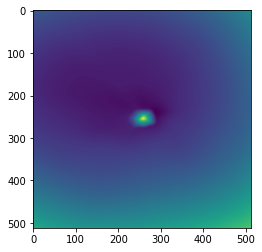

epoch 39901: 48.40511703491211
epoch 39902: 48.21772766113281
epoch 39903: 48.224021911621094
epoch 39904: 49.34060287475586
epoch 39905: 48.4044075012207
epoch 39906: 48.4359245300293
epoch 39907: 48.17058563232422
epoch 39908: 48.60893249511719
epoch 39909: 48.21897888183594
epoch 39911: 47.717838287353516
epoch 39912: 48.368099212646484
epoch 39913: 47.84104537963867
epoch 39914: 48.32146453857422
epoch 39915: 48.26841735839844
epoch 39916: 48.48232650756836
epoch 39917: 50.138980865478516
epoch 39918: 48.457305908203125
epoch 39919: 47.94480895996094
epoch 39921: 47.94502639770508
epoch 39922: 48.575565338134766
epoch 39923: 47.93301773071289
epoch 39924: 47.846126556396484
epoch 39925: 47.97932052612305
epoch 39926: 48.12775421142578
epoch 39927: 47.88992691040039
epoch 39928: 48.619205474853516
epoch 39929: 47.85643005371094
epoch 39931: 47.78874969482422
epoch 39932: 47.45212173461914
epoch 39933: 47.90107727050781
epoch 39934: 48.256141662597656
epoch 39935: 47.54265213012695
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



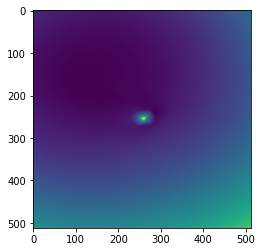

epoch 40001: 48.203617095947266
epoch 40002: 48.460121154785156
epoch 40003: 48.398399353027344
epoch 40004: 48.27570724487305
epoch 40005: 48.189483642578125
epoch 40006: 48.6736946105957
epoch 40007: 47.597904205322266
epoch 40008: 47.994903564453125
epoch 40009: 48.19096755981445
epoch 40011: 48.978981018066406
epoch 40012: 48.42009353637695
epoch 40013: 47.80672073364258
epoch 40014: 48.1765022277832
epoch 40015: 48.08597946166992
epoch 40016: 48.18598556518555
epoch 40017: 47.161495208740234
epoch 40018: 48.034183502197266
epoch 40019: 48.25444412231445
epoch 40021: 47.8952522277832
epoch 40022: 47.69340133666992
epoch 40023: 48.07770538330078
epoch 40024: 48.54326629638672
epoch 40025: 48.51559829711914
epoch 40026: 47.74342727661133
epoch 40027: 47.77239990234375
epoch 40028: 49.628440856933594
epoch 40029: 47.6083984375
epoch 40031: 48.7100944519043
epoch 40032: 48.784427642822266
epoch 40033: 47.32929611206055
epoch 40034: 48.30891799926758
epoch 40035: 48.009883880615234
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



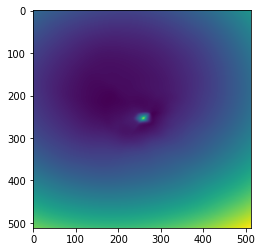

epoch 40101: 47.80192947387695
epoch 40102: 48.44679641723633
epoch 40103: 48.29792022705078
epoch 40104: 48.00582504272461
epoch 40105: 48.63020706176758
epoch 40106: 47.717552185058594
epoch 40107: 48.67705535888672
epoch 40108: 47.80790328979492
epoch 40109: 47.2148323059082
epoch 40111: 48.46477127075195
epoch 40112: 47.67212677001953
epoch 40113: 48.19763946533203
epoch 40114: 48.40485382080078
epoch 40115: 48.54481506347656
epoch 40116: 47.87424850463867
epoch 40117: 49.177581787109375
epoch 40118: 48.056209564208984
epoch 40119: 47.21162033081055
epoch 40121: 47.78924560546875
epoch 40122: 47.721641540527344
epoch 40123: 48.35649108886719
epoch 40124: 47.59814453125
epoch 40125: 47.746795654296875
epoch 40126: 47.82164764404297
epoch 40127: 48.04460144042969
epoch 40128: 48.630672454833984
epoch 40129: 47.95758819580078
epoch 40131: 48.23073959350586
epoch 40132: 48.6335563659668
epoch 40133: 48.287086486816406
epoch 40134: 48.2358283996582
epoch 40135: 47.72883224487305
epoch 4

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



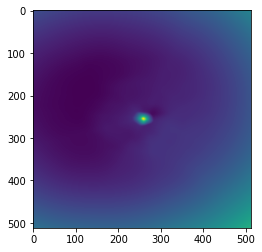

epoch 40201: 47.75499725341797
epoch 40202: 48.647823333740234
epoch 40203: 47.31040573120117
epoch 40204: 47.76581573486328
epoch 40205: 48.595985412597656
epoch 40206: 48.720584869384766
epoch 40207: 49.10938262939453
epoch 40208: 47.29643630981445
epoch 40209: 48.35163879394531
epoch 40211: 47.83297348022461
epoch 40212: 47.678123474121094
epoch 40213: 49.0927848815918
epoch 40214: 48.14922332763672
epoch 40215: 48.1211051940918
epoch 40216: 47.872745513916016
epoch 40217: 48.293575286865234
epoch 40218: 48.0022087097168
epoch 40219: 47.77294158935547
epoch 40221: 48.3994026184082
epoch 40222: 48.3311882019043
epoch 40223: 48.18419647216797
epoch 40224: 48.20621109008789
epoch 40225: 48.21324157714844
epoch 40226: 49.31283187866211
epoch 40227: 47.863563537597656
epoch 40228: 47.309940338134766
epoch 40229: 47.676570892333984
epoch 40231: 48.69275665283203
epoch 40232: 47.87152862548828
epoch 40233: 48.22578430175781
epoch 40234: 47.306541442871094
epoch 40235: 48.8101692199707
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



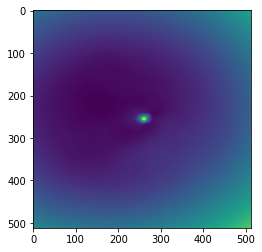

epoch 40301: 48.96360778808594
epoch 40302: 47.915443420410156
epoch 40303: 47.97641372680664
epoch 40304: 48.17753601074219
epoch 40305: 48.765464782714844
epoch 40306: 48.72456359863281
epoch 40307: 48.086421966552734
epoch 40308: 48.1574592590332
epoch 40309: 49.148799896240234
epoch 40311: 48.28861618041992
epoch 40312: 48.10329818725586
epoch 40313: 47.954952239990234
epoch 40314: 48.50349044799805
epoch 40315: 47.19731521606445
epoch 40316: 48.735660552978516
epoch 40317: 48.64269256591797
epoch 40318: 48.41051483154297
epoch 40319: 48.63436508178711
epoch 40321: 48.434635162353516
epoch 40322: 48.050838470458984
epoch 40323: 48.17411804199219
epoch 40324: 48.97841262817383
epoch 40325: 48.68339157104492
epoch 40326: 49.930171966552734
epoch 40327: 48.53050231933594
epoch 40328: 49.1849479675293
epoch 40329: 47.6058235168457
epoch 40331: 48.29804229736328
epoch 40332: 48.78386306762695
epoch 40333: 48.852909088134766
epoch 40334: 47.907569885253906
epoch 40335: 48.05926513671875


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



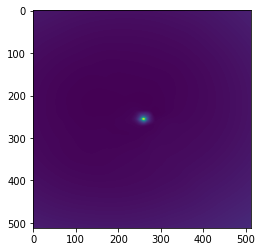

epoch 40401: 47.87131881713867
epoch 40402: 49.17726135253906
epoch 40403: 49.077816009521484
epoch 40404: 49.212467193603516
epoch 40405: 49.226348876953125
epoch 40406: 48.06435775756836
epoch 40407: 47.59953308105469
epoch 40408: 47.87133026123047
epoch 40409: 47.768898010253906
epoch 40411: 47.747257232666016
epoch 40412: 49.50489807128906
epoch 40413: 47.438079833984375
epoch 40414: 47.706024169921875
epoch 40415: 48.54435729980469
epoch 40416: 48.831016540527344
epoch 40417: 48.57122802734375
epoch 40418: 48.436485290527344
epoch 40419: 49.100318908691406
epoch 40421: 49.054439544677734
epoch 40422: 48.1323356628418
epoch 40423: 48.74897003173828
epoch 40424: 48.006649017333984
epoch 40425: 47.9036979675293
epoch 40426: 48.30787658691406
epoch 40427: 48.40896224975586
epoch 40428: 47.54834747314453
epoch 40429: 48.992156982421875
epoch 40431: 48.33067321777344
epoch 40432: 48.0380973815918
epoch 40433: 47.72555160522461
epoch 40434: 48.82670211791992
epoch 40435: 48.4641227722168

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



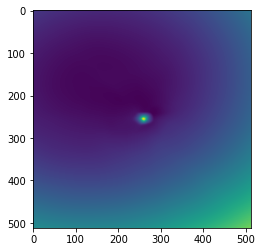

epoch 40501: 48.85647964477539
epoch 40502: 47.95506286621094
epoch 40503: 47.57778549194336
epoch 40504: 47.86445236206055
epoch 40505: 48.34761047363281
epoch 40506: 48.06035614013672
epoch 40507: 48.72063446044922
epoch 40508: 47.77549743652344
epoch 40509: 48.308414459228516
epoch 40511: 47.9553108215332
epoch 40512: 48.81169509887695
epoch 40513: 48.019500732421875
epoch 40514: 48.456600189208984
epoch 40515: 48.481651306152344
epoch 40516: 50.020477294921875
epoch 40517: 48.91484832763672
epoch 40518: 48.27169418334961
epoch 40519: 47.65391159057617
epoch 40521: 48.44496536254883
epoch 40522: 47.73775100708008
epoch 40523: 48.317909240722656
epoch 40524: 47.58793640136719
epoch 40525: 49.49577331542969
epoch 40526: 47.764923095703125
epoch 40527: 48.141597747802734
epoch 40528: 48.095176696777344
epoch 40529: 48.535919189453125
epoch 40531: 48.611690521240234
epoch 40532: 47.599483489990234
epoch 40533: 48.65087127685547
epoch 40534: 48.291297912597656
epoch 40535: 47.98003387451

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



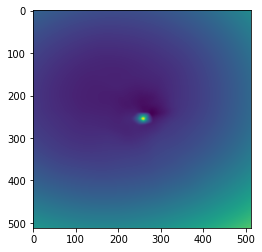

epoch 40601: 48.5042724609375
epoch 40602: 48.17413330078125
epoch 40603: 47.57524490356445
epoch 40604: 48.50169372558594
epoch 40605: 48.81718063354492
epoch 40606: 47.42446517944336
epoch 40607: 48.471256256103516
epoch 40608: 47.69720458984375
epoch 40609: 47.95814514160156
epoch 40611: 48.59962463378906
epoch 40612: 48.94865417480469
epoch 40613: 48.6063232421875
epoch 40614: 47.58066940307617
epoch 40615: 47.30490493774414
epoch 40616: 47.371463775634766
epoch 40617: 48.8891716003418
epoch 40618: 48.31198501586914
epoch 40619: 47.45893478393555
epoch 40621: 48.44319152832031
epoch 40622: 49.098873138427734
epoch 40623: 48.28836441040039
epoch 40624: 48.488773345947266
epoch 40625: 47.704681396484375
epoch 40626: 48.956512451171875
epoch 40627: 49.00288391113281
epoch 40628: 47.664424896240234
epoch 40629: 47.813934326171875
epoch 40631: 48.150306701660156
epoch 40632: 47.89014434814453
epoch 40633: 48.13304901123047
epoch 40634: 48.39240264892578
epoch 40635: 48.32265090942383
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



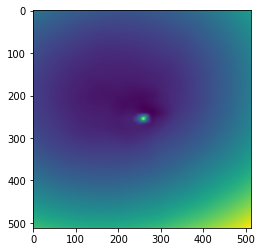

epoch 40701: 47.81365966796875
epoch 40702: 48.614341735839844
epoch 40703: 48.19374465942383
epoch 40704: 49.349884033203125
epoch 40705: 49.220314025878906
epoch 40706: 47.67277526855469
epoch 40707: 48.052249908447266
epoch 40708: 48.24464416503906
epoch 40709: 47.61922836303711
epoch 40711: 47.626121520996094
epoch 40712: 47.65596008300781
epoch 40713: 47.852848052978516
epoch 40714: 47.695899963378906
epoch 40715: 47.46297836303711
epoch 40716: 48.11045837402344
epoch 40717: 47.63998794555664
epoch 40718: 47.86249923706055
epoch 40719: 48.19060134887695
epoch 40721: 48.87436294555664
epoch 40722: 49.642635345458984
epoch 40723: 50.50138854980469
epoch 40724: 48.5675163269043
epoch 40725: 49.76034164428711
epoch 40726: 48.066837310791016
epoch 40727: 47.23039627075195
epoch 40728: 48.884307861328125
epoch 40729: 48.62178039550781
epoch 40731: 48.69860076904297
epoch 40732: 48.53923797607422
epoch 40733: 48.173377990722656
epoch 40734: 48.41757583618164
epoch 40735: 48.3289489746093

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



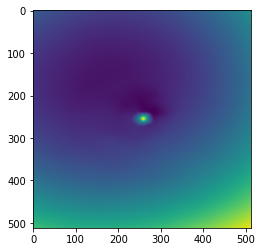

epoch 40801: 48.38015365600586
epoch 40802: 47.777000427246094
epoch 40803: 47.96339416503906
epoch 40804: 47.79729461669922
epoch 40805: 48.70769500732422
epoch 40806: 48.31788635253906
epoch 40807: 48.80657196044922
epoch 40808: 47.137847900390625
epoch 40809: 48.66229248046875
epoch 40811: 47.65345764160156
epoch 40812: 47.54097366333008
epoch 40813: 48.2193717956543
epoch 40814: 46.97407531738281
epoch 40815: 48.03879165649414
epoch 40816: 48.901126861572266
epoch 40817: 48.36454391479492
epoch 40818: 49.03285598754883
epoch 40819: 48.27616882324219
epoch 40821: 48.288089752197266
epoch 40822: 48.88092803955078
epoch 40823: 49.51530456542969
epoch 40824: 47.623939514160156
epoch 40825: 48.07045364379883
epoch 40826: 48.719207763671875
epoch 40827: 48.63676071166992
epoch 40828: 48.38822937011719
epoch 40829: 48.488285064697266
epoch 40831: 48.268409729003906
epoch 40832: 54.99818420410156
epoch 40833: 49.00274658203125
epoch 40834: 48.63385009765625
epoch 40835: 48.856605529785156


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



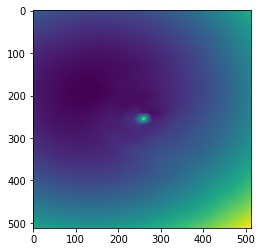

epoch 40901: 47.83235168457031
epoch 40902: 50.98162078857422
epoch 40903: 47.11594009399414
epoch 40904: 48.50657272338867
epoch 40905: 47.44548416137695
epoch 40906: 47.97500991821289
epoch 40907: 48.3223762512207
epoch 40908: 48.39797592163086
epoch 40909: 48.376007080078125
epoch 40911: 48.19898223876953
epoch 40912: 48.15380096435547
epoch 40913: 47.54612731933594
epoch 40914: 47.40608596801758
epoch 40915: 48.16622543334961
epoch 40916: 47.9748420715332
epoch 40917: 48.655147552490234
epoch 40918: 49.01776123046875
epoch 40919: 47.58846664428711
epoch 40921: 48.74076461791992
epoch 40922: 49.46324920654297
epoch 40923: 48.63178634643555
epoch 40924: 48.971744537353516
epoch 40925: 48.145042419433594
epoch 40926: 48.33537673950195
epoch 40927: 50.06058883666992
epoch 40928: 47.6888427734375
epoch 40929: 49.07502746582031
epoch 40931: 48.13850784301758
epoch 40932: 48.24712371826172
epoch 40933: 47.996097564697266
epoch 40934: 47.75300216674805
epoch 40935: 47.85419845581055
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



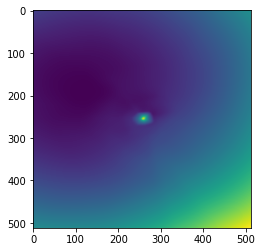

epoch 41001: 49.09899139404297
epoch 41002: 48.29400634765625
epoch 41003: 48.328670501708984
epoch 41004: 48.64884948730469
epoch 41005: 47.75962829589844
epoch 41006: 48.084781646728516
epoch 41007: 48.83441162109375
epoch 41008: 48.21451187133789
epoch 41009: 48.65373229980469
epoch 41011: 48.44184875488281
epoch 41012: 48.13453674316406
epoch 41013: 48.45561218261719
epoch 41014: 48.14445877075195
epoch 41015: 48.310420989990234
epoch 41016: 48.18470764160156
epoch 41017: 48.396385192871094
epoch 41018: 48.577903747558594
epoch 41019: 47.85038757324219
epoch 41021: 47.95479965209961
epoch 41022: 48.335609436035156
epoch 41023: 48.045440673828125
epoch 41024: 48.196956634521484
epoch 41025: 48.22372817993164
epoch 41026: 48.14346694946289
epoch 41027: 47.83537292480469
epoch 41028: 48.04093551635742
epoch 41029: 48.04511260986328
epoch 41031: 47.81718826293945
epoch 41032: 48.69364929199219
epoch 41033: 48.11813735961914
epoch 41034: 48.51170349121094
epoch 41035: 48.15515899658203


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



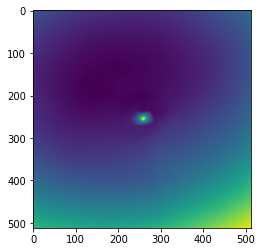

epoch 41101: 48.32783508300781
epoch 41102: 47.7623176574707
epoch 41103: 47.95465850830078
epoch 41104: 47.321434020996094
epoch 41105: 47.716495513916016
epoch 41106: 47.63897705078125
epoch 41107: 47.91637420654297
epoch 41108: 48.1435432434082
epoch 41109: 48.61162567138672
epoch 41111: 48.11359405517578
epoch 41112: 47.26737976074219
epoch 41113: 47.48640823364258
epoch 41114: 48.156349182128906
epoch 41115: 48.23027801513672
epoch 41116: 48.218055725097656
epoch 41117: 48.04592514038086
epoch 41118: 47.852500915527344
epoch 41119: 48.42362976074219
epoch 41121: 47.123748779296875
epoch 41122: 48.14466857910156
epoch 41123: 48.39382553100586
epoch 41124: 49.39198684692383
epoch 41125: 48.4911003112793
epoch 41126: 47.81924057006836
epoch 41127: 48.064449310302734
epoch 41128: 48.3443603515625
epoch 41129: 48.65507888793945
epoch 41131: 48.04853439331055
epoch 41132: 48.58423614501953
epoch 41133: 48.88276672363281
epoch 41134: 48.53323745727539
epoch 41135: 48.048072814941406
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



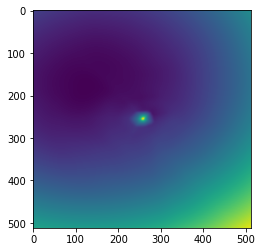

epoch 41201: 48.14738082885742
epoch 41202: 48.33559799194336
epoch 41203: 48.140499114990234
epoch 41204: 50.76948928833008
epoch 41205: 48.80081558227539
epoch 41206: 48.40018844604492
epoch 41207: 47.54669189453125
epoch 41208: 48.920249938964844
epoch 41209: 48.13189697265625
epoch 41211: 48.09904098510742
epoch 41212: 48.12532043457031
epoch 41213: 47.9380989074707
epoch 41214: 48.80917739868164
epoch 41215: 48.573753356933594
epoch 41216: 47.92106246948242
epoch 41217: 48.78502655029297
epoch 41218: 48.1329345703125
epoch 41219: 47.89238357543945
epoch 41221: 48.746734619140625
epoch 41222: 47.94536209106445
epoch 41223: 48.48392105102539
epoch 41224: 48.414947509765625
epoch 41225: 48.45185470581055
epoch 41226: 48.28363800048828
epoch 41227: 48.7474479675293
epoch 41228: 47.847023010253906
epoch 41229: 48.262786865234375
epoch 41231: 47.60173797607422
epoch 41232: 48.32432174682617
epoch 41233: 48.03676223754883
epoch 41234: 48.0368766784668
epoch 41235: 48.90479278564453
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



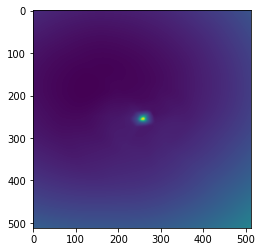

epoch 41301: 48.575435638427734
epoch 41302: 47.55191421508789
epoch 41303: 48.19931411743164
epoch 41304: 47.792396545410156
epoch 41305: 48.231510162353516
epoch 41306: 48.505985260009766
epoch 41307: 47.59504318237305
epoch 41308: 48.0751953125
epoch 41309: 50.61569595336914
epoch 41311: 48.10559844970703
epoch 41312: 47.44340133666992
epoch 41313: 48.77146530151367
epoch 41314: 48.19002914428711
epoch 41315: 48.20744323730469
epoch 41316: 47.99237823486328
epoch 41317: 48.72061538696289
epoch 41318: 48.283172607421875
epoch 41319: 49.00989532470703
epoch 41321: 48.23368835449219
epoch 41322: 48.511749267578125
epoch 41323: 47.81985092163086
epoch 41324: 48.04627227783203
epoch 41325: 48.976951599121094
epoch 41326: 47.656288146972656
epoch 41327: 47.74442672729492
epoch 41328: 47.79792022705078
epoch 41329: 47.7485466003418
epoch 41331: 47.72177505493164
epoch 41332: 48.363433837890625
epoch 41333: 47.777191162109375
epoch 41334: 48.65157699584961
epoch 41335: 48.504356384277344
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



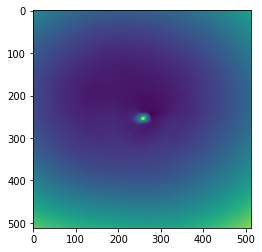

epoch 41401: 49.067264556884766
epoch 41402: 52.38007736206055
epoch 41403: 47.7639045715332
epoch 41404: 47.6026611328125
epoch 41405: 47.939022064208984
epoch 41406: 47.72982406616211
epoch 41407: 49.241825103759766
epoch 41408: 48.241214752197266
epoch 41409: 48.40314865112305
epoch 41411: 48.20917510986328
epoch 41412: 48.484588623046875
epoch 41413: 48.11262893676758
epoch 41414: 47.66305923461914
epoch 41415: 47.81850051879883
epoch 41416: 48.27837371826172
epoch 41417: 47.933101654052734
epoch 41418: 48.09541320800781
epoch 41419: 48.30225372314453
epoch 41421: 48.2423095703125
epoch 41422: 46.85462951660156
epoch 41423: 48.625972747802734
epoch 41424: 48.33208084106445
epoch 41425: 47.743507385253906
epoch 41426: 48.32304000854492
epoch 41427: 47.311500549316406
epoch 41428: 47.86513137817383
epoch 41429: 47.83568572998047
epoch 41431: 47.48834991455078
epoch 41432: 49.22125244140625
epoch 41433: 50.757625579833984
epoch 41434: 48.57270050048828
epoch 41435: 49.33418655395508
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



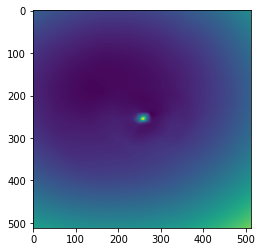

epoch 41501: 47.619964599609375
epoch 41502: 47.88344192504883
epoch 41503: 47.84283447265625
epoch 41504: 48.532962799072266
epoch 41505: 48.21464920043945
epoch 41506: 48.54534149169922
epoch 41507: 48.334476470947266
epoch 41508: 47.96688461303711
epoch 41509: 48.20968246459961
epoch 41511: 48.258914947509766
epoch 41512: 47.79596710205078
epoch 41513: 47.87863540649414
epoch 41514: 48.0705451965332
epoch 41515: 47.96223831176758
epoch 41516: 47.80259323120117
epoch 41517: 48.060543060302734
epoch 41518: 48.467220306396484
epoch 41519: 48.21551513671875
epoch 41521: 48.75284957885742
epoch 41522: 48.013572692871094
epoch 41523: 47.328983306884766
epoch 41524: 48.23551559448242
epoch 41525: 48.572078704833984
epoch 41526: 48.15842056274414
epoch 41527: 48.9999885559082
epoch 41528: 48.429805755615234
epoch 41529: 48.220279693603516
epoch 41531: 47.61807632446289
epoch 41532: 47.24969482421875
epoch 41533: 48.14482116699219
epoch 41534: 48.20880889892578
epoch 41535: 49.42438888549805

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



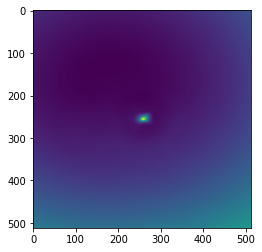

epoch 41601: 47.83367919921875
epoch 41602: 49.16143035888672
epoch 41603: 48.680824279785156
epoch 41604: 47.83943176269531
epoch 41605: 48.37676239013672
epoch 41606: 48.455284118652344
epoch 41607: 48.41991424560547
epoch 41608: 48.137001037597656
epoch 41609: 50.32358169555664
epoch 41611: 48.469852447509766
epoch 41612: 48.9110107421875
epoch 41613: 48.729164123535156
epoch 41614: 48.82292938232422
epoch 41615: 48.04113006591797
epoch 41616: 48.696624755859375
epoch 41617: 47.927268981933594
epoch 41618: 49.005252838134766
epoch 41619: 48.823238372802734
epoch 41621: 48.40791702270508
epoch 41622: 48.07970428466797
epoch 41623: 47.922080993652344
epoch 41624: 47.50271224975586
epoch 41625: 47.82780075073242
epoch 41626: 47.4729118347168
epoch 41627: 48.71306228637695
epoch 41628: 47.882354736328125
epoch 41629: 48.79010772705078
epoch 41631: 47.19947052001953
epoch 41632: 48.17572021484375
epoch 41633: 48.33323669433594
epoch 41634: 47.99094009399414
epoch 41635: 47.70194625854492

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



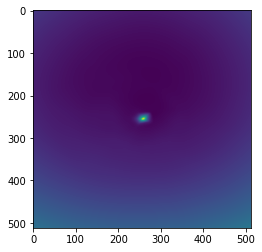

epoch 41701: 49.42570877075195
epoch 41702: 48.61867904663086
epoch 41703: 48.575984954833984
epoch 41704: 48.39268493652344
epoch 41705: 48.66554260253906
epoch 41706: 48.10226821899414
epoch 41707: 49.50149917602539
epoch 41708: 47.75101852416992
epoch 41709: 48.75151824951172
epoch 41711: 48.39555358886719
epoch 41712: 48.28113555908203
epoch 41713: 48.1688346862793
epoch 41714: 48.46481704711914
epoch 41715: 48.33492660522461
epoch 41716: 49.90553283691406
epoch 41717: 48.28614807128906
epoch 41718: 48.090702056884766
epoch 41719: 48.15284729003906
epoch 41721: 48.89463806152344
epoch 41722: 47.9330940246582
epoch 41723: 47.38737106323242
epoch 41724: 48.377601623535156
epoch 41725: 47.80877685546875
epoch 41726: 48.03364562988281
epoch 41727: 48.560665130615234
epoch 41728: 48.685752868652344
epoch 41729: 48.00667953491211
epoch 41731: 48.43131637573242
epoch 41732: 48.2336311340332
epoch 41733: 48.008480072021484
epoch 41734: 47.770870208740234
epoch 41735: 48.395206451416016
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



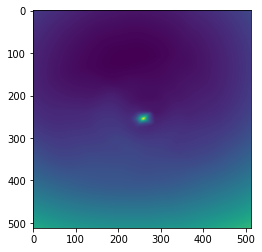

epoch 41801: 48.94021987915039
epoch 41802: 48.048545837402344
epoch 41803: 47.614139556884766
epoch 41804: 48.21220016479492
epoch 41805: 48.110416412353516
epoch 41806: 47.87017822265625
epoch 41807: 47.6958122253418
epoch 41808: 48.38262939453125
epoch 41809: 48.20427322387695
epoch 41811: 48.09381103515625
epoch 41812: 48.27456283569336
epoch 41813: 47.31432342529297
epoch 41814: 47.839534759521484
epoch 41815: 47.85596466064453
epoch 41816: 49.060245513916016
epoch 41817: 47.824378967285156
epoch 41818: 47.31691360473633
epoch 41819: 48.47153854370117
epoch 41821: 47.706809997558594
epoch 41822: 47.787418365478516
epoch 41823: 47.4216423034668
epoch 41824: 47.745426177978516
epoch 41825: 48.728057861328125
epoch 41826: 48.296852111816406
epoch 41827: 47.66202926635742
epoch 41828: 47.787837982177734
epoch 41829: 48.11039352416992
epoch 41831: 48.00215148925781
epoch 41832: 47.774208068847656
epoch 41833: 47.2951774597168
epoch 41834: 47.549461364746094
epoch 41835: 47.959354400634

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



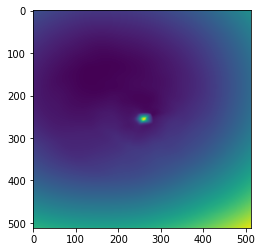

epoch 41901: 50.32896423339844
epoch 41902: 48.935951232910156
epoch 41903: 47.81693649291992
epoch 41904: 48.81874084472656
epoch 41905: 48.94776916503906
epoch 41906: 48.79314422607422
epoch 41907: 48.82502746582031
epoch 41908: 47.550010681152344
epoch 41909: 48.861976623535156
epoch 41911: 48.16389465332031
epoch 41912: 48.51591491699219
epoch 41913: 48.130523681640625
epoch 41914: 48.21576690673828
epoch 41915: 49.09365463256836
epoch 41916: 48.2772216796875
epoch 41917: 48.55319595336914
epoch 41918: 48.38203430175781
epoch 41919: 47.83086395263672
epoch 41921: 48.164310455322266
epoch 41922: 49.62506866455078
epoch 41923: 48.52334976196289
epoch 41924: 48.653018951416016
epoch 41925: 47.99229049682617
epoch 41926: 48.051151275634766
epoch 41927: 48.353885650634766
epoch 41928: 47.787803649902344
epoch 41929: 47.83700180053711
epoch 41931: 48.02337646484375
epoch 41932: 48.28481674194336
epoch 41933: 47.73971176147461
epoch 41934: 47.533660888671875
epoch 41935: 47.37219619750976

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



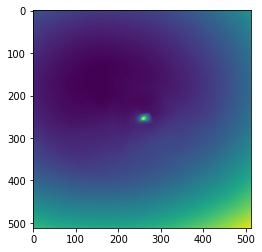

epoch 42001: 48.30544662475586
epoch 42002: 48.17757034301758
epoch 42003: 48.106048583984375
epoch 42004: 48.61971664428711
epoch 42005: 48.662933349609375
epoch 42006: 47.567264556884766
epoch 42007: 47.972618103027344
epoch 42008: 48.18606948852539
epoch 42009: 47.77788162231445
epoch 42011: 48.19362258911133
epoch 42012: 49.441566467285156
epoch 42013: 48.63090133666992
epoch 42014: 48.06612014770508
epoch 42015: 48.03657150268555
epoch 42016: 51.23777389526367
epoch 42017: 48.50716018676758
epoch 42018: 47.86684799194336
epoch 42019: 48.194942474365234
epoch 42021: 47.816078186035156
epoch 42022: 48.2294921875
epoch 42023: 47.95051574707031
epoch 42024: 48.789581298828125
epoch 42025: 47.91952896118164
epoch 42026: 48.56283187866211
epoch 42027: 47.9777717590332
epoch 42028: 47.80585479736328
epoch 42029: 47.90306854248047
epoch 42031: 48.57599639892578
epoch 42032: 48.80834197998047
epoch 42033: 49.57392120361328
epoch 42034: 48.19819641113281
epoch 42035: 48.0883674621582
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



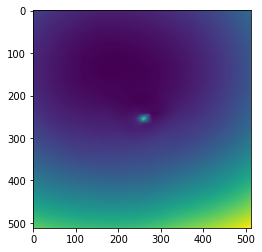

epoch 42101: 48.29709243774414
epoch 42102: 48.279273986816406
epoch 42103: 48.89744567871094
epoch 42104: 47.675968170166016
epoch 42105: 47.80062484741211
epoch 42106: 48.11152648925781
epoch 42107: 47.98234558105469
epoch 42108: 48.008541107177734
epoch 42109: 48.007118225097656
epoch 42111: 47.61386489868164
epoch 42112: 48.383201599121094
epoch 42113: 48.786624908447266
epoch 42114: 49.327308654785156
epoch 42115: 48.27988052368164
epoch 42116: 47.95291519165039
epoch 42117: 47.99061584472656
epoch 42118: 47.91972351074219
epoch 42119: 48.17951202392578
epoch 42121: 47.93330764770508
epoch 42122: 47.31989669799805
epoch 42123: 48.67136764526367
epoch 42124: 48.29569625854492
epoch 42125: 48.52369689941406
epoch 42126: 49.35856628417969
epoch 42127: 48.46550369262695
epoch 42128: 48.30320739746094
epoch 42129: 48.3321647644043
epoch 42131: 48.468544006347656
epoch 42132: 48.26467514038086
epoch 42133: 47.81325149536133
epoch 42134: 48.393524169921875
epoch 42135: 49.04602813720703


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



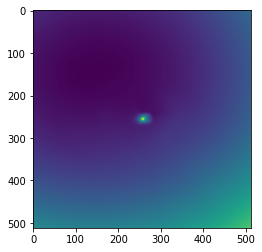

epoch 42201: 48.88942337036133
epoch 42202: 48.003173828125
epoch 42203: 48.51705551147461
epoch 42204: 47.75481033325195
epoch 42205: 48.21810531616211
epoch 42206: 47.66459274291992
epoch 42207: 48.21500015258789
epoch 42208: 47.943180084228516
epoch 42209: 48.15655517578125
epoch 42211: 47.540645599365234
epoch 42212: 47.882545471191406
epoch 42213: 48.017303466796875
epoch 42214: 49.77463150024414
epoch 42215: 47.949119567871094
epoch 42216: 48.88977813720703
epoch 42217: 47.719417572021484
epoch 42218: 48.06852722167969
epoch 42219: 47.73582077026367
epoch 42221: 47.993595123291016
epoch 42222: 48.410926818847656
epoch 42223: 47.895301818847656
epoch 42224: 49.05632400512695
epoch 42225: 47.49272918701172
epoch 42226: 47.77461624145508
epoch 42227: 48.659568786621094
epoch 42228: 47.96352767944336
epoch 42229: 47.326446533203125
epoch 42231: 48.25931930541992
epoch 42232: 46.94757080078125
epoch 42233: 48.0439338684082
epoch 42234: 48.06712341308594
epoch 42235: 47.91904830932617


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



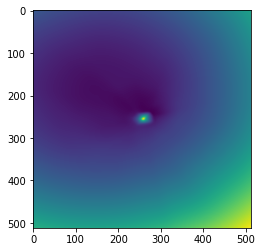

epoch 42301: 49.64077377319336
epoch 42302: 47.9797477722168
epoch 42303: 47.72871398925781
epoch 42304: 48.41365051269531
epoch 42305: 49.61164855957031
epoch 42306: 48.68634033203125
epoch 42307: 47.74239730834961
epoch 42308: 48.598358154296875
epoch 42309: 48.97804260253906
epoch 42311: 48.08346939086914
epoch 42312: 47.7337532043457
epoch 42313: 48.49135971069336
epoch 42314: 47.91309356689453
epoch 42315: 48.43269729614258
epoch 42316: 47.260597229003906
epoch 42317: 47.30986785888672
epoch 42318: 47.706016540527344
epoch 42319: 48.54425048828125
epoch 42321: 48.188133239746094
epoch 42322: 48.00482177734375
epoch 42323: 47.770572662353516
epoch 42324: 47.88796615600586
epoch 42325: 53.075531005859375
epoch 42326: 49.86886215209961
epoch 42327: 48.07622146606445
epoch 42328: 48.490325927734375
epoch 42329: 49.07476806640625
epoch 42331: 47.86798095703125
epoch 42332: 48.1988525390625
epoch 42333: 47.998111724853516
epoch 42334: 47.8848876953125
epoch 42335: 49.16115188598633
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



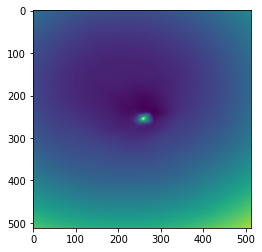

epoch 42401: 47.14023208618164
epoch 42402: 47.99074172973633
epoch 42403: 48.32884979248047
epoch 42404: 47.33309555053711
epoch 42405: 48.344940185546875
epoch 42406: 48.33839416503906
epoch 42407: 47.313819885253906
epoch 42408: 49.09714889526367
epoch 42409: 48.06024932861328
epoch 42411: 47.54634475708008
epoch 42412: 47.96953201293945
epoch 42413: 48.181705474853516
epoch 42414: 48.12723922729492
epoch 42415: 48.07499313354492
epoch 42416: 48.507179260253906
epoch 42417: 48.274635314941406
epoch 42418: 47.518150329589844
epoch 42419: 48.229251861572266
epoch 42421: 47.75740432739258
epoch 42422: 47.74625015258789
epoch 42423: 47.84293746948242
epoch 42424: 48.761192321777344
epoch 42425: 48.19102096557617
epoch 42426: 48.455326080322266
epoch 42427: 47.83252716064453
epoch 42428: 48.68244552612305
epoch 42429: 47.80975341796875
epoch 42431: 48.71095275878906
epoch 42432: 48.76607131958008
epoch 42433: 49.26470947265625
epoch 42434: 48.86572265625
epoch 42435: 47.719390869140625
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



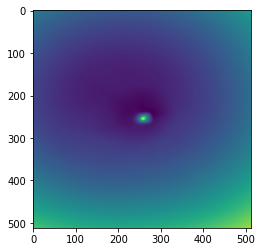

epoch 42501: 47.49140548706055
epoch 42502: 47.74144744873047
epoch 42503: 48.58638000488281
epoch 42504: 47.49412155151367
epoch 42505: 47.05234909057617
epoch 42506: 47.7139892578125
epoch 42507: 48.10616683959961
epoch 42508: 48.24221420288086
epoch 42509: 47.592185974121094
epoch 42511: 47.78242874145508
epoch 42512: 47.32805252075195
epoch 42513: 48.75370788574219
epoch 42514: 48.46981430053711
epoch 42515: 47.646934509277344
epoch 42516: 47.17390823364258
epoch 42517: 47.54621887207031
epoch 42518: 47.683082580566406
epoch 42519: 48.060447692871094
epoch 42521: 47.95034408569336
epoch 42522: 47.67731475830078
epoch 42523: 47.973384857177734
epoch 42524: 48.36569595336914
epoch 42525: 47.6967658996582
epoch 42526: 47.65626907348633
epoch 42527: 47.79474639892578
epoch 42528: 47.92272186279297
epoch 42529: 48.50128936767578
epoch 42531: 47.16217803955078
epoch 42532: 47.4868049621582
epoch 42533: 47.440025329589844
epoch 42534: 48.87179946899414
epoch 42535: 47.79425048828125
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



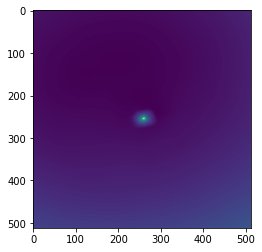

epoch 42601: 48.2589111328125
epoch 42602: 48.09016036987305
epoch 42603: 48.27553939819336
epoch 42604: 48.45547866821289
epoch 42605: 47.92920684814453
epoch 42606: 48.690948486328125
epoch 42607: 48.53633499145508
epoch 42608: 48.55370330810547
epoch 42609: 48.411651611328125
epoch 42611: 47.80710983276367
epoch 42612: 48.62809371948242
epoch 42613: 48.56333923339844
epoch 42614: 47.25495529174805
epoch 42615: 48.103309631347656
epoch 42616: 48.79106140136719
epoch 42617: 48.29450225830078
epoch 42618: 48.53301239013672
epoch 42619: 48.1995849609375
epoch 42621: 48.69660949707031
epoch 42622: 47.956626892089844
epoch 42623: 48.461341857910156
epoch 42624: 48.456485748291016
epoch 42625: 47.74352264404297
epoch 42626: 47.96623992919922
epoch 42627: 48.263675689697266
epoch 42628: 48.48360824584961
epoch 42629: 46.953041076660156
epoch 42631: 47.88862609863281
epoch 42632: 47.88425827026367
epoch 42633: 47.67567825317383
epoch 42634: 48.62810134887695
epoch 42635: 48.44969177246094
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



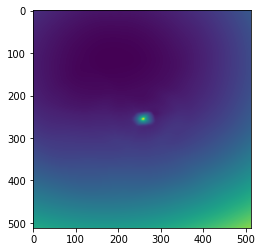

epoch 42701: 48.44572067260742
epoch 42702: 48.659236907958984
epoch 42703: 48.830848693847656
epoch 42704: 48.57337951660156
epoch 42705: 47.562435150146484
epoch 42706: 47.678436279296875
epoch 42707: 47.834510803222656
epoch 42708: 48.2399787902832
epoch 42709: 47.84801483154297
epoch 42711: 47.43125534057617
epoch 42712: 48.4589958190918
epoch 42713: 48.61861801147461
epoch 42714: 48.16252899169922
epoch 42715: 47.43607711791992
epoch 42716: 51.046241760253906
epoch 42717: 47.298736572265625
epoch 42718: 48.48091506958008
epoch 42719: 48.46094512939453
epoch 42721: 48.145599365234375
epoch 42722: 47.193756103515625
epoch 42723: 48.004119873046875
epoch 42724: 48.05415344238281
epoch 42725: 47.77632522583008
epoch 42726: 48.017494201660156
epoch 42727: 49.0879020690918
epoch 42728: 47.9533576965332
epoch 42729: 47.872955322265625
epoch 42731: 47.670921325683594
epoch 42732: 48.30221939086914
epoch 42733: 47.479408264160156
epoch 42734: 48.224334716796875
epoch 42735: 48.631759643554

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



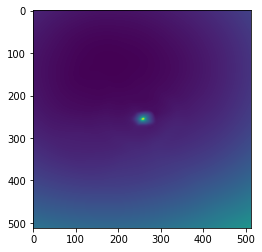

epoch 42801: 48.60244369506836
epoch 42802: 48.31777572631836
epoch 42803: 48.40235900878906
epoch 42804: 48.065895080566406
epoch 42805: 48.83265686035156
epoch 42806: 47.8565673828125
epoch 42807: 47.83376693725586
epoch 42808: 49.23383712768555
epoch 42809: 47.915191650390625
epoch 42811: 48.57296371459961
epoch 42812: 48.42861557006836
epoch 42813: 47.48250961303711
epoch 42814: 47.99583435058594
epoch 42815: 47.267738342285156
epoch 42816: 48.492557525634766
epoch 42817: 47.83739471435547
epoch 42818: 47.81262969970703
epoch 42819: 48.1290168762207
epoch 42821: 47.9577522277832
epoch 42822: 48.753883361816406
epoch 42823: 49.11624526977539
epoch 42824: 47.54279327392578
epoch 42825: 48.65608215332031
epoch 42826: 47.543968200683594
epoch 42827: 48.960758209228516
epoch 42828: 49.756309509277344
epoch 42829: 48.71259689331055
epoch 42831: 48.161834716796875
epoch 42832: 48.08212661743164
epoch 42833: 49.40594482421875
epoch 42834: 48.688018798828125
epoch 42835: 49.18873596191406
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



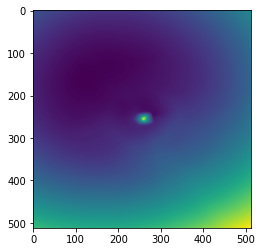

epoch 42901: 48.76853942871094
epoch 42902: 48.97645568847656
epoch 42903: 48.86028289794922
epoch 42904: 48.61623001098633
epoch 42905: 47.91637420654297
epoch 42906: 49.4093017578125
epoch 42907: 48.93418502807617
epoch 42908: 48.52035903930664
epoch 42909: 47.91530227661133
epoch 42911: 48.97846984863281
epoch 42912: 47.498050689697266
epoch 42913: 47.61825942993164
epoch 42914: 47.649864196777344
epoch 42915: 48.10042190551758
epoch 42916: 48.524627685546875
epoch 42917: 48.364662170410156
epoch 42918: 48.84736633300781
epoch 42919: 48.74309539794922
epoch 42921: 49.0153923034668
epoch 42922: 47.96541976928711
epoch 42923: 48.13104248046875
epoch 42924: 47.14761734008789
epoch 42925: 48.28307342529297
epoch 42926: 48.700382232666016
epoch 42927: 47.64901351928711
epoch 42928: 48.81833267211914
epoch 42929: 48.77975082397461
epoch 42931: 49.17399978637695
epoch 42932: 48.31561279296875
epoch 42933: 48.514347076416016
epoch 42934: 47.808387756347656
epoch 42935: 47.91849136352539
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



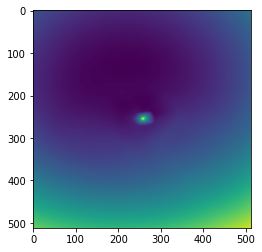

epoch 43001: 47.57086181640625
epoch 43002: 47.34759521484375
epoch 43003: 48.26729965209961
epoch 43004: 48.13799285888672
epoch 43005: 47.919342041015625
epoch 43006: 48.106685638427734
epoch 43007: 48.52766418457031
epoch 43008: 47.63371276855469
epoch 43009: 48.104217529296875
epoch 43011: 48.33687973022461
epoch 43012: 48.26885223388672
epoch 43013: 48.0040283203125
epoch 43014: 48.73542022705078
epoch 43015: 47.84177780151367
epoch 43016: 47.795860290527344
epoch 43017: 48.389137268066406
epoch 43018: 48.238826751708984
epoch 43019: 48.70750045776367
epoch 43021: 47.64392852783203
epoch 43022: 48.71381759643555
epoch 43023: 47.988990783691406
epoch 43024: 48.552181243896484
epoch 43025: 47.41975402832031
epoch 43026: 48.22862243652344
epoch 43027: 47.15684509277344
epoch 43028: 48.09531784057617
epoch 43029: 48.11981964111328
epoch 43031: 48.11119079589844
epoch 43032: 47.51303482055664
epoch 43033: 47.991004943847656
epoch 43034: 47.55158615112305
epoch 43035: 48.18421173095703


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



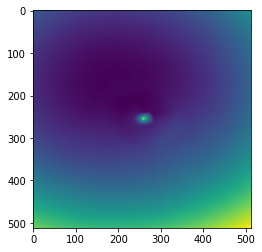

epoch 43101: 47.68767166137695
epoch 43102: 47.44884490966797
epoch 43103: 47.36800765991211
epoch 43104: 48.32645034790039
epoch 43105: 48.808895111083984
epoch 43106: 47.6163330078125
epoch 43107: 47.7852897644043
epoch 43108: 47.173370361328125
epoch 43109: 47.552772521972656
epoch 43111: 47.40884780883789
epoch 43112: 48.25324249267578
epoch 43113: 48.43071365356445
epoch 43114: 47.9913444519043
epoch 43115: 49.2123908996582
epoch 43116: 47.76080322265625
epoch 43117: 49.075897216796875
epoch 43118: 48.214351654052734
epoch 43119: 47.96458053588867
epoch 43121: 47.65330123901367
epoch 43122: 48.35244369506836
epoch 43123: 48.39795684814453
epoch 43124: 48.23881912231445
epoch 43125: 47.54156494140625
epoch 43126: 47.79187774658203
epoch 43127: 48.5236930847168
epoch 43128: 48.44397735595703
epoch 43129: 48.109989166259766
epoch 43131: 47.924964904785156
epoch 43132: 48.08395767211914
epoch 43133: 48.450523376464844
epoch 43134: 48.10689926147461
epoch 43135: 48.22002029418945
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



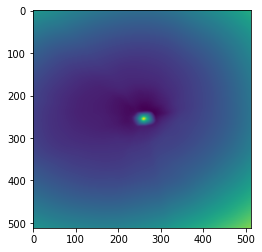

epoch 43201: 48.41395950317383
epoch 43202: 48.21597671508789
epoch 43203: 48.36200714111328
epoch 43204: 48.01005172729492
epoch 43205: 47.716209411621094
epoch 43206: 48.879154205322266
epoch 43207: 48.47264099121094
epoch 43208: 48.083702087402344
epoch 43209: 49.81765365600586
epoch 43211: 48.75522232055664
epoch 43212: 48.62036895751953
epoch 43213: 47.49909591674805
epoch 43214: 48.395843505859375
epoch 43215: 49.57005310058594
epoch 43216: 47.7252197265625
epoch 43217: 48.04092788696289
epoch 43218: 48.075130462646484
epoch 43219: 48.8630256652832
epoch 43221: 48.27824783325195
epoch 43222: 48.76646041870117
epoch 43223: 48.33634948730469
epoch 43224: 48.21112060546875
epoch 43225: 48.66842269897461
epoch 43226: 47.82122039794922
epoch 43227: 47.695194244384766
epoch 43228: 49.348018646240234
epoch 43229: 48.160484313964844
epoch 43231: 47.999755859375
epoch 43232: 47.646183013916016
epoch 43233: 47.3745002746582
epoch 43234: 47.90200424194336
epoch 43235: 48.42413330078125
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



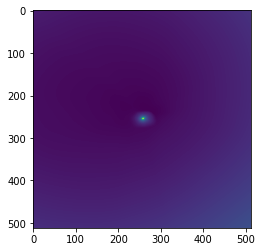

epoch 43301: 47.77469253540039
epoch 43302: 50.02260971069336
epoch 43303: 49.570369720458984
epoch 43304: 47.9952392578125
epoch 43305: 49.21111297607422
epoch 43306: 48.97743606567383
epoch 43307: 48.68022537231445
epoch 43308: 49.032691955566406
epoch 43309: 48.58590316772461
epoch 43311: 48.36638641357422
epoch 43312: 47.963741302490234
epoch 43313: 49.25462341308594
epoch 43314: 49.33425521850586
epoch 43315: 49.33869552612305
epoch 43316: 49.17512130737305
epoch 43317: 48.58300018310547
epoch 43318: 49.42936325073242
epoch 43319: 48.180809020996094
epoch 43321: 48.952335357666016
epoch 43322: 48.72211456298828
epoch 43323: 48.66920471191406
epoch 43324: 48.57063293457031
epoch 43325: 50.16250991821289
epoch 43326: 48.81015396118164
epoch 43327: 49.12511444091797
epoch 43328: 49.19179916381836
epoch 43329: 49.3167724609375
epoch 43331: 48.84773254394531
epoch 43332: 48.23770523071289
epoch 43333: 48.71147918701172
epoch 43334: 48.00918197631836
epoch 43335: 48.615211486816406
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



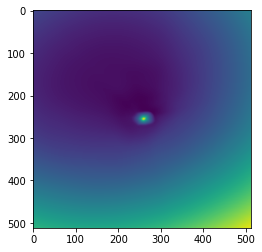

epoch 43401: 47.995323181152344
epoch 43402: 48.28559875488281
epoch 43403: 48.43696975708008
epoch 43404: 48.04909896850586
epoch 43405: 47.8734130859375
epoch 43406: 49.13154220581055
epoch 43407: 53.61972427368164
epoch 43408: 48.352901458740234
epoch 43409: 48.94838333129883
epoch 43411: 48.45392608642578
epoch 43412: 48.18416976928711
epoch 43413: 48.311195373535156
epoch 43414: 48.30680847167969
epoch 43415: 49.306270599365234
epoch 43416: 50.47907638549805
epoch 43417: 48.838523864746094
epoch 43418: 48.52235412597656
epoch 43419: 48.74148941040039
epoch 43421: 49.29462814331055
epoch 43422: 48.11473846435547
epoch 43423: 49.467933654785156
epoch 43424: 47.9788932800293
epoch 43425: 48.65645980834961
epoch 43426: 50.14799118041992
epoch 43427: 49.06941223144531
epoch 43428: 48.0087890625
epoch 43429: 48.1475944519043
epoch 43431: 48.42939376831055
epoch 43432: 48.92686080932617
epoch 43433: 49.1158561706543
epoch 43434: 48.037628173828125
epoch 43435: 48.25933074951172
epoch 434

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



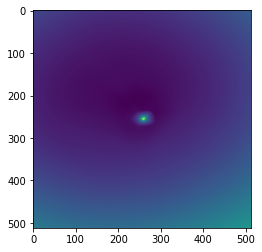

epoch 43501: 48.45901870727539
epoch 43502: 48.30057144165039
epoch 43503: 48.03489303588867
epoch 43504: 47.877342224121094
epoch 43505: 47.92477035522461
epoch 43506: 47.95363998413086
epoch 43507: 48.19313430786133
epoch 43508: 47.68741226196289
epoch 43509: 49.027984619140625
epoch 43511: 47.82395553588867
epoch 43512: 47.82256317138672
epoch 43513: 47.58562088012695
epoch 43514: 48.5360221862793
epoch 43515: 47.43946838378906
epoch 43516: 48.50309371948242
epoch 43517: 48.22932815551758
epoch 43518: 48.178245544433594
epoch 43519: 48.11302185058594
epoch 43521: 48.57041549682617
epoch 43522: 48.370357513427734
epoch 43523: 48.223472595214844
epoch 43524: 48.636322021484375
epoch 43525: 48.2255859375
epoch 43526: 47.921409606933594
epoch 43527: 48.45954895019531
epoch 43528: 47.652469635009766
epoch 43529: 47.78596115112305
epoch 43531: 48.020484924316406
epoch 43532: 51.07197952270508
epoch 43533: 47.54803466796875
epoch 43534: 48.044700622558594
epoch 43535: 47.343746185302734
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



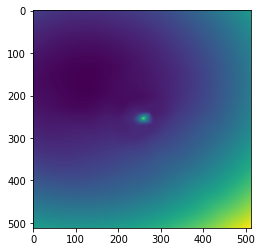

epoch 43601: 48.67317581176758
epoch 43602: 48.451133728027344
epoch 43603: 48.89992141723633
epoch 43604: 47.44738006591797
epoch 43605: 48.75514602661133
epoch 43606: 48.560672760009766
epoch 43607: 49.88549041748047
epoch 43608: 48.05683898925781
epoch 43609: 47.5114860534668
epoch 43611: 47.147674560546875
epoch 43612: 47.50324630737305
epoch 43613: 48.50425338745117
epoch 43614: 47.97688674926758
epoch 43615: 48.00798416137695
epoch 43616: 48.031898498535156
epoch 43617: 48.16841125488281
epoch 43618: 47.81095886230469
epoch 43619: 49.31468200683594
epoch 43621: 48.658164978027344
epoch 43622: 48.26255416870117
epoch 43623: 48.21986389160156
epoch 43624: 47.910396575927734
epoch 43625: 47.78010559082031
epoch 43626: 48.50746536254883
epoch 43627: 49.45965576171875
epoch 43628: 47.94748306274414
epoch 43629: 48.01371765136719
epoch 43631: 48.361148834228516
epoch 43632: 47.635948181152344
epoch 43633: 48.27300262451172
epoch 43634: 49.44996643066406
epoch 43635: 47.946956634521484


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



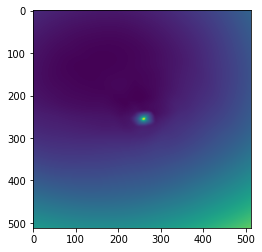

epoch 43701: 48.36618423461914
epoch 43702: 47.816349029541016
epoch 43703: 47.91489028930664
epoch 43704: 48.143524169921875
epoch 43705: 47.96569061279297
epoch 43706: 48.20234298706055
epoch 43707: 52.44197082519531
epoch 43708: 48.185184478759766
epoch 43709: 48.3643798828125
epoch 43711: 47.68747329711914
epoch 43712: 48.14010238647461
epoch 43713: 47.46424102783203
epoch 43714: 48.10866165161133
epoch 43715: 48.07844161987305
epoch 43716: 47.67869567871094
epoch 43717: 49.01250457763672
epoch 43718: 47.862709045410156
epoch 43719: 48.017555236816406
epoch 43721: 48.8973503112793
epoch 43722: 48.44753646850586
epoch 43723: 48.62514877319336
epoch 43724: 47.678794860839844
epoch 43725: 48.38515853881836
epoch 43726: 48.3633918762207
epoch 43727: 48.05531692504883
epoch 43728: 47.26936721801758
epoch 43729: 47.35193634033203
epoch 43731: 47.53361511230469
epoch 43732: 47.63850402832031
epoch 43733: 48.413169860839844
epoch 43734: 48.50884246826172
epoch 43735: 47.82577896118164
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



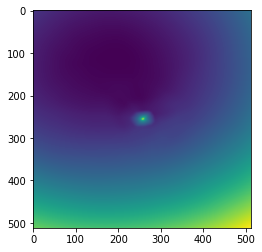

epoch 43801: 48.44473648071289
epoch 43802: 47.80133819580078
epoch 43803: 48.535980224609375
epoch 43804: 48.17628479003906
epoch 43805: 47.82034683227539
epoch 43806: 47.0697135925293
epoch 43807: 48.31367111206055
epoch 43808: 48.01380920410156
epoch 43809: 48.00518798828125
epoch 43811: 48.81807327270508
epoch 43812: 47.76655578613281
epoch 43813: 48.51902770996094
epoch 43814: 49.76182174682617
epoch 43815: 48.84703826904297
epoch 43816: 47.78672790527344
epoch 43817: 48.250343322753906
epoch 43818: 47.39860916137695
epoch 43819: 47.99265670776367
epoch 43821: 47.597408294677734
epoch 43822: 49.04741287231445
epoch 43823: 48.635311126708984
epoch 43824: 47.65440368652344
epoch 43825: 48.066673278808594
epoch 43826: 50.76203918457031
epoch 43827: 47.73088836669922
epoch 43828: 47.318782806396484
epoch 43829: 47.68867492675781
epoch 43831: 47.63844680786133
epoch 43832: 48.69356918334961
epoch 43833: 47.88683319091797
epoch 43834: 48.26885986328125
epoch 43835: 48.2520866394043
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



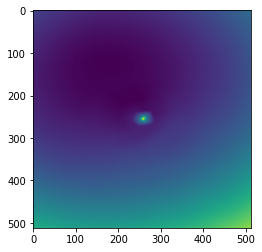

epoch 43901: 47.854244232177734
epoch 43902: 47.870330810546875
epoch 43903: 48.11901092529297
epoch 43904: 47.23860168457031
epoch 43905: 47.38500213623047
epoch 43906: 48.48294448852539
epoch 43907: 48.14561462402344
epoch 43908: 47.616416931152344
epoch 43909: 48.2092170715332
epoch 43911: 48.312313079833984
epoch 43912: 47.521060943603516
epoch 43913: 49.18674087524414
epoch 43914: 48.19275665283203
epoch 43915: 48.410560607910156
epoch 43916: 47.589195251464844
epoch 43917: 48.52151870727539
epoch 43918: 48.254520416259766
epoch 43919: 48.35097122192383
epoch 43921: 49.35689163208008
epoch 43922: 48.18256759643555
epoch 43923: 47.97461700439453
epoch 43924: 48.02734375
epoch 43925: 47.81297302246094
epoch 43926: 48.810821533203125
epoch 43927: 47.5068473815918
epoch 43928: 48.86345291137695
epoch 43929: 47.5661506652832
epoch 43931: 48.07231903076172
epoch 43932: 48.21608352661133
epoch 43933: 48.35529327392578
epoch 43934: 47.90110778808594
epoch 43935: 47.906829833984375
epoch 4

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



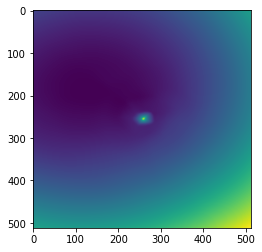

epoch 44001: 47.61014938354492
epoch 44002: 47.6063232421875
epoch 44003: 48.20561218261719
epoch 44004: 47.79085922241211
epoch 44005: 48.98244857788086
epoch 44006: 47.952335357666016
epoch 44007: 48.6418571472168
epoch 44008: 47.64053726196289
epoch 44009: 47.97071075439453
epoch 44011: 49.10972595214844
epoch 44012: 47.60751724243164
epoch 44013: 47.928077697753906
epoch 44014: 47.92088317871094
epoch 44015: 47.453060150146484
epoch 44016: 47.47742462158203
epoch 44017: 48.16371154785156
epoch 44018: 47.97142791748047
epoch 44019: 47.85138702392578
epoch 44021: 47.5719108581543
epoch 44022: 48.448890686035156
epoch 44023: 50.172271728515625
epoch 44024: 47.39978790283203
epoch 44025: 48.01254653930664
epoch 44026: 48.523773193359375
epoch 44027: 48.08205032348633
epoch 44028: 48.52288818359375
epoch 44029: 48.33698272705078
epoch 44031: 48.17195510864258
epoch 44032: 47.75770568847656
epoch 44033: 48.02730941772461
epoch 44034: 48.37678527832031
epoch 44035: 49.348777770996094
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



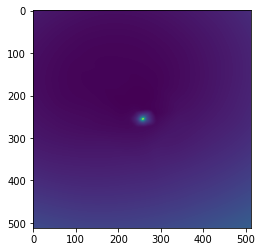

epoch 44101: 47.745582580566406
epoch 44102: 48.08364486694336
epoch 44103: 47.27224349975586
epoch 44104: 48.948238372802734
epoch 44105: 48.810951232910156
epoch 44106: 47.820838928222656
epoch 44107: 48.20613098144531
epoch 44108: 48.478118896484375
epoch 44109: 47.91305923461914
epoch 44111: 47.06689453125
epoch 44112: 48.995819091796875
epoch 44113: 48.167972564697266
epoch 44114: 48.22951889038086
epoch 44115: 47.76668930053711
epoch 44116: 47.72041702270508
epoch 44117: 48.6258544921875
epoch 44118: 47.99802780151367
epoch 44119: 47.633853912353516
epoch 44121: 48.01693344116211
epoch 44122: 47.81064224243164
epoch 44123: 48.8958854675293
epoch 44124: 48.24100875854492
epoch 44125: 48.22073745727539
epoch 44126: 47.67689895629883
epoch 44127: 48.0799674987793
epoch 44128: 48.03407669067383
epoch 44129: 48.19142532348633
epoch 44131: 48.460208892822266
epoch 44132: 48.48246383666992
epoch 44133: 48.17288589477539
epoch 44134: 49.157352447509766
epoch 44135: 47.88499450683594
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



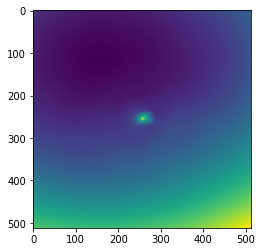

epoch 44201: 47.76962661743164
epoch 44202: 48.48516845703125
epoch 44203: 48.03817367553711
epoch 44204: 48.393646240234375
epoch 44205: 48.93771743774414
epoch 44206: 48.70142364501953
epoch 44207: 48.84434127807617
epoch 44208: 49.652061462402344
epoch 44209: 48.77703094482422
epoch 44211: 48.39839553833008
epoch 44212: 49.52193069458008
epoch 44213: 48.33876419067383
epoch 44214: 50.44670104980469
epoch 44215: 48.88457107543945
epoch 44216: 48.85594940185547
epoch 44217: 48.87824249267578
epoch 44218: 48.217552185058594
epoch 44219: 48.8878059387207
epoch 44221: 47.542213439941406
epoch 44222: 48.63257598876953
epoch 44223: 49.22898864746094
epoch 44224: 48.7924690246582
epoch 44225: 48.448665618896484
epoch 44226: 48.537410736083984
epoch 44227: 48.61841583251953
epoch 44228: 48.33103942871094
epoch 44229: 47.845130920410156
epoch 44231: 48.42323684692383
epoch 44232: 48.430946350097656
epoch 44233: 47.97613525390625
epoch 44234: 48.368717193603516
epoch 44235: 48.50651168823242
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



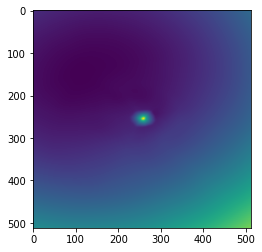

epoch 44301: 49.28769302368164
epoch 44302: 48.274105072021484
epoch 44303: 48.2258415222168
epoch 44304: 49.00139617919922
epoch 44305: 48.18263626098633
epoch 44306: 47.83038330078125
epoch 44307: 48.34486389160156
epoch 44308: 48.281494140625
epoch 44309: 47.82289505004883
epoch 44311: 47.820831298828125
epoch 44312: 48.47323989868164
epoch 44313: 48.34486770629883
epoch 44314: 48.2664794921875
epoch 44315: 47.81376266479492
epoch 44316: 48.76161575317383
epoch 44317: 48.7090950012207
epoch 44318: 53.12130355834961
epoch 44319: 48.578712463378906
epoch 44321: 49.36947250366211
epoch 44322: 47.806732177734375
epoch 44323: 49.19961929321289
epoch 44324: 49.18653869628906
epoch 44325: 48.94088363647461
epoch 44326: 48.91965103149414
epoch 44327: 47.88331985473633
epoch 44328: 48.18286895751953
epoch 44329: 49.38835144042969
epoch 44331: 48.43654251098633
epoch 44332: 48.068031311035156
epoch 44333: 49.535118103027344
epoch 44334: 47.85130310058594
epoch 44335: 47.535884857177734
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



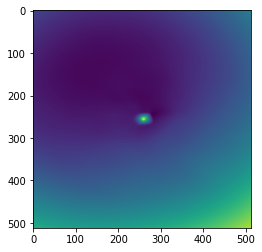

epoch 44401: 47.541038513183594
epoch 44402: 48.34849166870117
epoch 44403: 47.61687088012695
epoch 44404: 48.49222183227539
epoch 44405: 48.67043685913086
epoch 44406: 47.61561584472656
epoch 44407: 48.11787796020508
epoch 44408: 48.689876556396484
epoch 44409: 48.02165222167969
epoch 44411: 48.29172897338867
epoch 44412: 48.4588737487793
epoch 44413: 48.657161712646484
epoch 44414: 48.064064025878906
epoch 44415: 47.69014358520508
epoch 44416: 48.139949798583984
epoch 44417: 48.56782913208008
epoch 44418: 47.36286926269531
epoch 44419: 47.93991470336914
epoch 44421: 47.749839782714844
epoch 44422: 48.059391021728516
epoch 44423: 49.51127624511719
epoch 44424: 48.06343078613281
epoch 44425: 49.10929870605469
epoch 44426: 48.14052200317383
epoch 44427: 47.998233795166016
epoch 44428: 48.63806915283203
epoch 44429: 47.43505859375
epoch 44431: 48.271087646484375
epoch 44432: 48.58609390258789
epoch 44433: 49.24464416503906
epoch 44434: 48.606414794921875
epoch 44435: 49.19948196411133
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



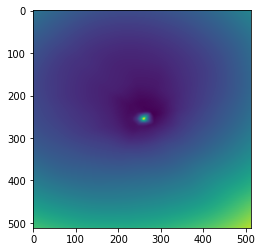

epoch 44501: 48.75843048095703
epoch 44502: 47.80113220214844
epoch 44503: 47.8232421875
epoch 44504: 47.52705764770508
epoch 44505: 47.815284729003906
epoch 44506: 48.35738754272461
epoch 44507: 47.4814453125
epoch 44508: 49.15349578857422
epoch 44509: 48.82851028442383
epoch 44511: 48.4153938293457
epoch 44512: 48.5592155456543
epoch 44513: 47.96477508544922
epoch 44514: 47.967063903808594
epoch 44515: 48.59580993652344
epoch 44516: 48.391700744628906
epoch 44517: 48.423763275146484
epoch 44518: 49.129295349121094
epoch 44519: 48.26939010620117
epoch 44521: 47.72135543823242
epoch 44522: 49.17752456665039
epoch 44523: 47.94061279296875
epoch 44524: 47.6650276184082
epoch 44525: 48.672645568847656
epoch 44526: 47.991783142089844
epoch 44527: 49.38944625854492
epoch 44528: 48.134525299072266
epoch 44529: 48.041404724121094
epoch 44531: 47.99223709106445
epoch 44532: 47.977516174316406
epoch 44533: 47.77601623535156
epoch 44534: 48.57098388671875
epoch 44535: 48.26252746582031
epoch 445

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



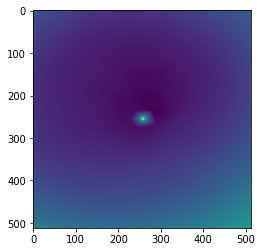

epoch 44601: 48.02162170410156
epoch 44602: 48.56671905517578
epoch 44603: 48.72479248046875
epoch 44604: 48.064266204833984
epoch 44605: 47.83046340942383
epoch 44606: 47.7274284362793
epoch 44607: 47.377464294433594
epoch 44608: 48.4641227722168
epoch 44609: 48.9505615234375
epoch 44611: 48.299285888671875
epoch 44612: 47.98002243041992
epoch 44613: 48.02285385131836
epoch 44614: 47.96323776245117
epoch 44615: 47.76845932006836
epoch 44616: 48.35641098022461
epoch 44617: 47.65629577636719
epoch 44618: 48.3887825012207
epoch 44619: 47.91320037841797
epoch 44621: 47.71647262573242
epoch 44622: 47.50215530395508
epoch 44623: 47.860008239746094
epoch 44624: 48.00718688964844
epoch 44625: 48.81073760986328
epoch 44626: 48.13301467895508
epoch 44627: 49.21853256225586
epoch 44628: 47.859458923339844
epoch 44629: 47.423038482666016
epoch 44631: 47.32893753051758
epoch 44632: 49.50705337524414
epoch 44633: 47.39997863769531
epoch 44634: 47.780189514160156
epoch 44635: 47.41968536376953
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



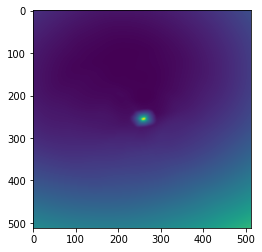

epoch 44701: 47.85039520263672
epoch 44702: 48.986976623535156
epoch 44703: 47.785770416259766
epoch 44704: 48.08473587036133
epoch 44705: 49.05184555053711
epoch 44706: 48.55046463012695
epoch 44707: 47.70812225341797
epoch 44708: 48.60667419433594
epoch 44709: 48.96943664550781
epoch 44711: 47.581016540527344
epoch 44712: 48.02370071411133
epoch 44713: 48.468711853027344
epoch 44714: 48.10930252075195
epoch 44715: 47.828731536865234
epoch 44716: 48.3708610534668
epoch 44717: 48.72386169433594
epoch 44718: 48.638755798339844
epoch 44719: 48.13726806640625
epoch 44721: 48.987335205078125
epoch 44722: 48.42598342895508
epoch 44723: 48.03083419799805
epoch 44724: 47.96909713745117
epoch 44725: 47.95343780517578
epoch 44726: 48.244083404541016
epoch 44727: 47.31821060180664
epoch 44728: 47.810855865478516
epoch 44729: 47.78755187988281
epoch 44731: 47.72134780883789
epoch 44732: 48.57926940917969
epoch 44733: 47.65581512451172
epoch 44734: 48.484371185302734
epoch 44735: 47.68659973144531

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



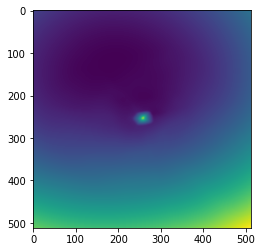

epoch 44801: 48.19276809692383
epoch 44802: 48.09370422363281
epoch 44803: 47.80961990356445
epoch 44804: 47.290794372558594
epoch 44805: 50.234344482421875
epoch 44806: 48.643836975097656
epoch 44807: 47.72613525390625
epoch 44808: 48.068946838378906
epoch 44809: 48.07020568847656
epoch 44811: 48.598690032958984
epoch 44812: 48.40782165527344
epoch 44813: 48.09465789794922
epoch 44814: 48.504188537597656
epoch 44815: 47.68088150024414
epoch 44816: 47.729949951171875
epoch 44817: 48.220638275146484
epoch 44818: 47.77123260498047
epoch 44819: 48.22162628173828
epoch 44821: 49.16258239746094
epoch 44822: 47.59691619873047
epoch 44823: 47.721614837646484
epoch 44824: 47.30977249145508
epoch 44825: 47.340057373046875
epoch 44826: 48.01799392700195
epoch 44827: 47.928375244140625
epoch 44828: 48.85602569580078
epoch 44829: 48.0455207824707
epoch 44831: 48.074737548828125
epoch 44832: 47.99699401855469
epoch 44833: 47.83358383178711
epoch 44834: 48.080928802490234
epoch 44835: 48.75517654418

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



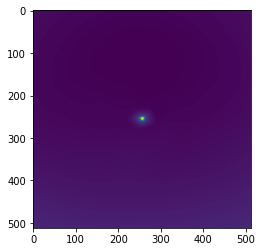

epoch 44901: 48.973487854003906
epoch 44902: 48.01898193359375
epoch 44903: 47.65174865722656
epoch 44904: 47.30298614501953
epoch 44905: 48.12752914428711
epoch 44906: 48.409324645996094
epoch 44907: 50.396507263183594
epoch 44908: 47.78725814819336
epoch 44909: 48.4931755065918
epoch 44911: 48.3792839050293
epoch 44912: 48.16747283935547
epoch 44913: 48.94459915161133
epoch 44914: 48.05091094970703
epoch 44915: 48.82378005981445
epoch 44916: 48.360328674316406
epoch 44917: 48.14226531982422
epoch 44918: 48.1846809387207
epoch 44919: 47.91291809082031
epoch 44921: 49.084041595458984
epoch 44922: 48.22365951538086
epoch 44923: 48.5892219543457
epoch 44924: 48.732398986816406
epoch 44925: 48.0673713684082
epoch 44926: 48.537654876708984
epoch 44927: 49.12921905517578
epoch 44928: 49.783390045166016
epoch 44929: 48.49030685424805
epoch 44931: 48.52098083496094
epoch 44932: 51.114952087402344
epoch 44933: 47.72227478027344
epoch 44934: 47.16777801513672
epoch 44935: 48.529640197753906
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



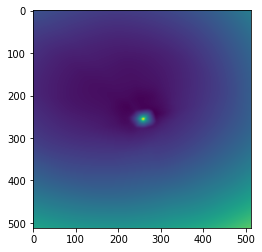

epoch 45001: 47.14799499511719
epoch 45002: 47.3024787902832
epoch 45003: 47.9675407409668
epoch 45004: 47.783329010009766
epoch 45005: 49.311885833740234
epoch 45006: 47.92818069458008
epoch 45007: 47.82853317260742
epoch 45008: 48.0264778137207
epoch 45009: 48.71650695800781
epoch 45011: 47.72127914428711
epoch 45012: 52.12017822265625
epoch 45013: 49.506465911865234
epoch 45014: 47.644874572753906
epoch 45015: 47.28340148925781
epoch 45016: 48.3807258605957
epoch 45017: 47.7094841003418
epoch 45018: 48.19328308105469
epoch 45019: 48.24120330810547
epoch 45021: 47.207313537597656
epoch 45022: 48.565574645996094
epoch 45023: 48.14155578613281
epoch 45024: 48.396728515625
epoch 45025: 47.766273498535156
epoch 45026: 49.59425735473633
epoch 45027: 47.79781723022461
epoch 45028: 48.29580307006836
epoch 45029: 48.22332763671875
epoch 45031: 48.24452209472656
epoch 45032: 48.38361358642578
epoch 45033: 47.71506118774414
epoch 45034: 48.05446243286133
epoch 45035: 48.540611267089844
epoch 4

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



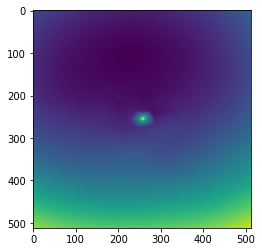

epoch 45101: 48.50632095336914
epoch 45102: 47.254173278808594
epoch 45103: 47.19160461425781
epoch 45104: 47.4225959777832
epoch 45105: 47.97303009033203
epoch 45106: 47.78971862792969
epoch 45107: 48.400875091552734
epoch 45108: 48.78153991699219
epoch 45109: 47.76786422729492
epoch 45111: 48.23051834106445
epoch 45112: 48.42280197143555
epoch 45113: 48.10411071777344
epoch 45114: 47.4620246887207
epoch 45115: 48.251712799072266
epoch 45116: 47.390445709228516
epoch 45117: 48.769935607910156
epoch 45118: 48.540279388427734
epoch 45119: 47.98593521118164
epoch 45121: 48.3844108581543
epoch 45122: 47.53642272949219
epoch 45123: 47.667884826660156
epoch 45124: 47.79081726074219
epoch 45125: 49.22914505004883
epoch 45126: 48.88903045654297
epoch 45127: 48.20398712158203
epoch 45128: 47.85194778442383
epoch 45129: 48.023712158203125
epoch 45131: 48.24465560913086
epoch 45132: 53.05125427246094
epoch 45133: 47.96693420410156
epoch 45134: 47.880680084228516
epoch 45135: 47.72946548461914
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



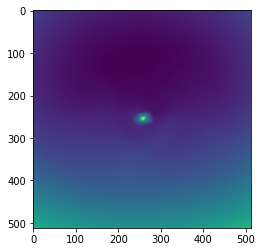

epoch 45201: 48.59008026123047
epoch 45202: 48.293052673339844
epoch 45203: 48.51239776611328
epoch 45204: 47.46866226196289
epoch 45205: 48.21907043457031
epoch 45206: 47.02822494506836
epoch 45207: 47.91981887817383
epoch 45208: 47.30147933959961
epoch 45209: 48.50343704223633
epoch 45211: 48.74497985839844
epoch 45212: 48.834991455078125
epoch 45213: 47.18712615966797
epoch 45214: 48.64897155761719
epoch 45215: 49.73371124267578
epoch 45216: 48.3466796875
epoch 45217: 48.9409294128418
epoch 45218: 47.82276153564453
epoch 45219: 49.69123840332031
epoch 45221: 47.69081115722656
epoch 45222: 47.9023323059082
epoch 45223: 47.65127182006836
epoch 45224: 48.931941986083984
epoch 45225: 49.207305908203125
epoch 45226: 47.633792877197266
epoch 45227: 47.819732666015625
epoch 45228: 47.62225341796875
epoch 45229: 48.3052864074707
epoch 45231: 47.82493591308594
epoch 45232: 47.851016998291016
epoch 45233: 47.59914016723633
epoch 45234: 47.90277862548828
epoch 45235: 48.94815444946289
epoch 45

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



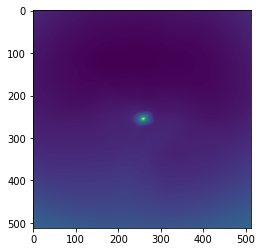

epoch 45301: 48.237396240234375
epoch 45302: 48.32848358154297
epoch 45303: 48.78097152709961
epoch 45304: 48.31977844238281
epoch 45305: 48.276611328125
epoch 45306: 48.15798568725586
epoch 45307: 48.21702575683594
epoch 45308: 47.82872772216797
epoch 45309: 48.774147033691406
epoch 45311: 47.99140548706055
epoch 45312: 48.63494110107422
epoch 45313: 47.932796478271484
epoch 45314: 48.89315414428711
epoch 45315: 48.69633865356445
epoch 45316: 48.32172775268555
epoch 45317: 48.01325225830078
epoch 45318: 48.433250427246094
epoch 45319: 47.784523010253906
epoch 45321: 48.12979507446289
epoch 45322: 48.873779296875
epoch 45323: 47.90730667114258
epoch 45324: 48.19837188720703
epoch 45325: 47.74298095703125
epoch 45326: 47.888816833496094
epoch 45327: 48.03412628173828
epoch 45328: 48.34478759765625
epoch 45329: 48.17269515991211
epoch 45331: 48.49155044555664
epoch 45332: 47.92112731933594
epoch 45333: 47.73459243774414
epoch 45334: 47.995811462402344
epoch 45335: 48.00830078125
epoch 45

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



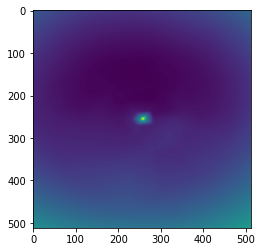

epoch 45401: 48.38300323486328
epoch 45402: 48.434749603271484
epoch 45403: 49.31795120239258
epoch 45404: 48.099082946777344
epoch 45405: 48.955162048339844
epoch 45406: 48.6641845703125
epoch 45407: 48.708248138427734
epoch 45408: 48.2376594543457
epoch 45409: 48.36152267456055
epoch 45411: 48.63542938232422
epoch 45412: 47.37849807739258
epoch 45413: 47.78395080566406
epoch 45414: 47.6677360534668
epoch 45415: 48.235206604003906
epoch 45416: 50.542327880859375
epoch 45417: 48.018760681152344
epoch 45418: 48.060401916503906
epoch 45419: 48.23775863647461
epoch 45421: 48.39934539794922
epoch 45422: 48.740779876708984
epoch 45423: 48.35081481933594
epoch 45424: 47.257652282714844
epoch 45425: 48.067928314208984
epoch 45426: 47.5683708190918
epoch 45427: 48.949058532714844
epoch 45428: 48.01992416381836
epoch 45429: 48.76188659667969
epoch 45431: 49.180572509765625
epoch 45432: 47.625160217285156
epoch 45433: 47.053497314453125
epoch 45434: 48.24966812133789
epoch 45435: 48.847293853759

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



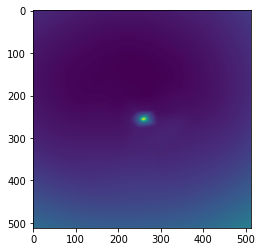

epoch 45501: 48.33369827270508
epoch 45502: 49.04319381713867
epoch 45503: 48.01691436767578
epoch 45504: 48.01139450073242
epoch 45505: 48.11036682128906
epoch 45506: 47.863101959228516
epoch 45507: 48.601585388183594
epoch 45508: 48.77116012573242
epoch 45509: 48.23841857910156
epoch 45511: 48.32474899291992
epoch 45512: 48.434226989746094
epoch 45513: 48.08287811279297
epoch 45514: 47.51555252075195
epoch 45515: 48.28852081298828
epoch 45516: 48.623348236083984
epoch 45517: 47.91973876953125
epoch 45518: 48.13237762451172
epoch 45519: 47.74626541137695
epoch 45521: 47.842811584472656
epoch 45522: 47.710289001464844
epoch 45523: 48.98118209838867
epoch 45524: 47.66495895385742
epoch 45525: 47.93677520751953
epoch 45526: 48.272647857666016
epoch 45527: 47.98115539550781
epoch 45528: 48.37053298950195
epoch 45529: 47.061946868896484
epoch 45531: 48.11671829223633
epoch 45532: 47.71456527709961
epoch 45533: 48.41664123535156
epoch 45534: 48.6542854309082
epoch 45535: 48.200809478759766


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



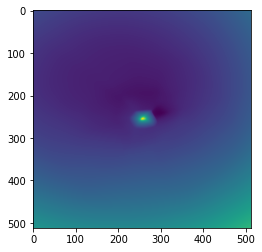

epoch 45601: 48.59284973144531
epoch 45602: 48.64876174926758
epoch 45603: 48.48955535888672
epoch 45604: 49.373252868652344
epoch 45605: 47.70942687988281
epoch 45606: 48.78040313720703
epoch 45607: 47.681583404541016
epoch 45608: 48.76625442504883
epoch 45609: 48.47410583496094
epoch 45611: 49.16916275024414
epoch 45612: 48.287376403808594
epoch 45613: 48.64970779418945
epoch 45614: 48.29158020019531
epoch 45615: 49.562843322753906
epoch 45616: 47.994380950927734
epoch 45617: 48.365753173828125
epoch 45618: 47.512786865234375
epoch 45619: 48.98983383178711
epoch 45621: 48.49549102783203
epoch 45622: 48.19174575805664
epoch 45623: 47.92457580566406
epoch 45624: 48.22503662109375
epoch 45625: 48.277679443359375
epoch 45626: 48.94989776611328
epoch 45627: 47.886566162109375
epoch 45628: 48.24720764160156
epoch 45629: 48.6102294921875
epoch 45631: 48.58404541015625
epoch 45632: 48.51546096801758
epoch 45633: 48.115177154541016
epoch 45634: 49.60596466064453
epoch 45635: 48.62118911743164

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



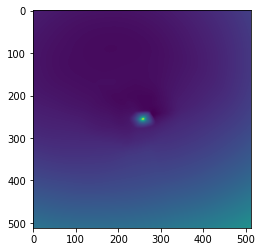

epoch 45701: 48.19046401977539
epoch 45702: 49.3619499206543
epoch 45703: 48.496212005615234
epoch 45704: 48.54338455200195
epoch 45705: 47.499507904052734
epoch 45706: 48.578086853027344
epoch 45707: 49.76595687866211
epoch 45708: 48.2999153137207
epoch 45709: 48.28425216674805
epoch 45711: 48.4742431640625
epoch 45712: 47.78318786621094
epoch 45713: 48.94504928588867
epoch 45714: 50.62028884887695
epoch 45715: 48.16486740112305
epoch 45716: 47.856468200683594
epoch 45717: 49.141685485839844
epoch 45718: 48.159400939941406
epoch 45719: 47.94773864746094
epoch 45721: 48.337242126464844
epoch 45722: 47.99892044067383
epoch 45723: 48.450584411621094
epoch 45724: 48.67154312133789
epoch 45725: 48.095035552978516
epoch 45726: 49.4112663269043
epoch 45727: 48.143978118896484
epoch 45728: 48.65864181518555
epoch 45729: 48.066184997558594
epoch 45731: 48.346920013427734
epoch 45732: 48.1981086730957
epoch 45733: 48.56418991088867
epoch 45734: 48.5847282409668
epoch 45735: 49.040218353271484
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



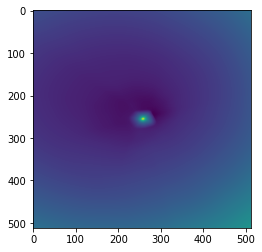

epoch 45801: 48.7546501159668
epoch 45802: 48.483970642089844
epoch 45803: 48.16586685180664
epoch 45804: 48.11576461791992
epoch 45805: 48.07630157470703
epoch 45806: 48.89228057861328
epoch 45807: 48.21833801269531
epoch 45808: 48.1666259765625
epoch 45809: 50.69205093383789
epoch 45811: 48.890403747558594
epoch 45812: 48.89055252075195
epoch 45813: 48.25605773925781
epoch 45814: 49.51597213745117
epoch 45815: 48.05141830444336
epoch 45816: 48.2994384765625
epoch 45817: 47.30281066894531
epoch 45818: 48.706886291503906
epoch 45819: 48.88844299316406
epoch 45821: 48.16661834716797
epoch 45822: 48.250850677490234
epoch 45823: 48.39866256713867
epoch 45824: 47.544189453125
epoch 45825: 48.35496520996094
epoch 45826: 48.20519256591797
epoch 45827: 47.74619674682617
epoch 45828: 48.537906646728516
epoch 45829: 48.97220993041992
epoch 45831: 48.18450164794922
epoch 45832: 48.64382553100586
epoch 45833: 49.232845306396484
epoch 45834: 48.32285690307617
epoch 45835: 48.254390716552734
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



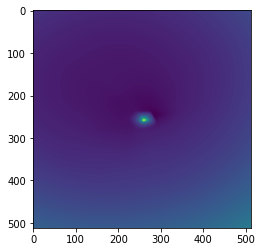

epoch 45901: 48.402042388916016
epoch 45902: 47.912567138671875
epoch 45903: 48.5277099609375
epoch 45904: 47.902530670166016
epoch 45905: 48.249752044677734
epoch 45906: 50.01859664916992
epoch 45907: 48.83341979980469
epoch 45908: 48.06560516357422
epoch 45909: 47.0299186706543
epoch 45911: 49.51530075073242
epoch 45912: 48.247291564941406
epoch 45913: 50.776554107666016
epoch 45914: 48.29166793823242
epoch 45915: 49.74092102050781
epoch 45916: 47.485347747802734
epoch 45917: 48.7401123046875
epoch 45918: 48.6140022277832
epoch 45919: 48.680946350097656
epoch 45921: 48.497039794921875
epoch 45922: 48.89977264404297
epoch 45923: 48.35893249511719
epoch 45924: 47.96977615356445
epoch 45925: 48.877403259277344
epoch 45926: 48.07842254638672
epoch 45927: 47.99148941040039
epoch 45928: 48.479000091552734
epoch 45929: 48.04629898071289
epoch 45931: 48.922203063964844
epoch 45932: 47.41551208496094
epoch 45933: 47.50075149536133
epoch 45934: 47.829071044921875
epoch 45935: 47.98506927490234

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



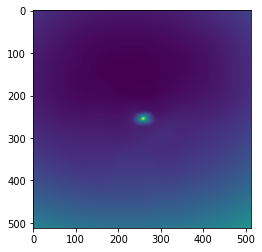

epoch 46001: 47.73637771606445
epoch 46002: 47.7554931640625
epoch 46003: 47.74637222290039
epoch 46004: 48.30620574951172
epoch 46005: 49.388145446777344
epoch 46006: 49.52531433105469
epoch 46007: 47.69124984741211
epoch 46008: 48.38588333129883
epoch 46009: 48.986392974853516
epoch 46011: 48.63447570800781
epoch 46012: 49.09143829345703
epoch 46013: 48.207340240478516
epoch 46014: 48.417240142822266
epoch 46015: 48.35528564453125
epoch 46016: 49.04169464111328
epoch 46017: 49.02955627441406
epoch 46018: 48.41629409790039
epoch 46019: 48.58509826660156
epoch 46021: 48.42626953125
epoch 46022: 48.00536346435547
epoch 46023: 49.352291107177734
epoch 46024: 48.517826080322266
epoch 46025: 47.63019561767578
epoch 46026: 49.52123260498047
epoch 46027: 48.86752700805664
epoch 46028: 48.63199234008789
epoch 46029: 47.7853889465332
epoch 46031: 50.29508590698242
epoch 46032: 49.514530181884766
epoch 46033: 47.9586067199707
epoch 46034: 49.02846908569336
epoch 46035: 48.9090461730957
epoch 46

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



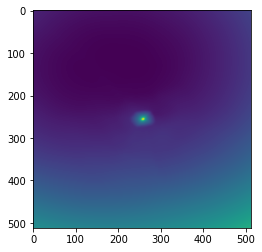

epoch 46101: 47.96015548706055
epoch 46102: 48.0391960144043
epoch 46103: 48.219146728515625
epoch 46104: 48.6941032409668
epoch 46105: 49.25263214111328
epoch 46106: 48.84259033203125
epoch 46107: 48.009368896484375
epoch 46108: 47.24799728393555
epoch 46109: 49.324684143066406
epoch 46111: 48.100589752197266
epoch 46112: 48.12724304199219
epoch 46113: 48.32931137084961
epoch 46114: 48.170005798339844
epoch 46115: 47.443931579589844
epoch 46116: 48.30635070800781
epoch 46117: 47.938480377197266
epoch 46118: 47.449462890625
epoch 46119: 47.89659118652344
epoch 46121: 47.931880950927734
epoch 46122: 48.06379699707031
epoch 46123: 47.50822067260742
epoch 46124: 48.638648986816406
epoch 46125: 48.47466278076172
epoch 46126: 47.35315704345703
epoch 46127: 48.38343811035156
epoch 46128: 48.0855827331543
epoch 46129: 49.25125503540039
epoch 46131: 48.200592041015625
epoch 46132: 47.848453521728516
epoch 46133: 48.29804992675781
epoch 46134: 48.18866729736328
epoch 46135: 47.112709045410156
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



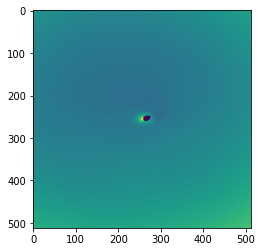

epoch 46201: 47.80683517456055
epoch 46202: 47.9361572265625
epoch 46203: 47.942909240722656
epoch 46204: 49.042327880859375
epoch 46205: 47.815643310546875
epoch 46206: 48.022274017333984
epoch 46207: 49.1827392578125
epoch 46208: 48.23957443237305
epoch 46209: 49.39636993408203
epoch 46211: 48.2696533203125
epoch 46212: 48.682373046875
epoch 46213: 47.99254608154297
epoch 46214: 48.536598205566406
epoch 46215: 48.33196258544922
epoch 46216: 48.810142517089844
epoch 46217: 49.1405029296875
epoch 46218: 48.734947204589844
epoch 46219: 47.12662124633789
epoch 46221: 48.805599212646484
epoch 46222: 47.727325439453125
epoch 46223: 48.96543884277344
epoch 46224: 47.90277099609375
epoch 46225: 50.365482330322266
epoch 46226: 48.28923416137695
epoch 46227: 48.93970489501953
epoch 46228: 48.5997200012207
epoch 46229: 47.2052001953125
epoch 46231: 49.000587463378906
epoch 46232: 47.363426208496094
epoch 46233: 49.220787048339844
epoch 46234: 49.575538635253906
epoch 46235: 48.889217376708984
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



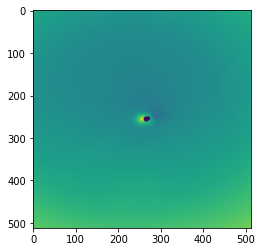

epoch 46301: 48.83842086791992
epoch 46302: 48.27277374267578
epoch 46303: 48.46757507324219
epoch 46304: 48.52994918823242
epoch 46305: 48.35892105102539
epoch 46306: 48.304866790771484
epoch 46307: 48.49326705932617
epoch 46308: 48.61562728881836
epoch 46309: 48.873130798339844
epoch 46311: 47.875362396240234
epoch 46312: 47.59016418457031
epoch 46313: 48.81265640258789
epoch 46314: 49.408935546875
epoch 46315: 50.24765396118164
epoch 46316: 49.1920166015625
epoch 46317: 49.80207824707031
epoch 46318: 49.39933776855469
epoch 46319: 48.0122184753418
epoch 46321: 49.04326629638672
epoch 46322: 48.67723846435547
epoch 46323: 48.19806671142578
epoch 46324: 49.1923942565918
epoch 46325: 49.25617218017578
epoch 46326: 48.768516540527344
epoch 46327: 48.69290542602539
epoch 46328: 48.5501823425293
epoch 46329: 48.60004425048828
epoch 46331: 48.30311965942383
epoch 46332: 48.89641571044922
epoch 46333: 48.95643615722656
epoch 46334: 48.08697509765625
epoch 46335: 48.84120178222656
epoch 4633

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



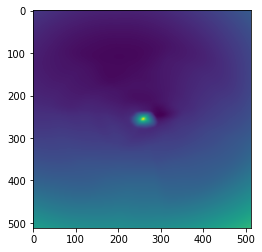

epoch 46401: 50.24526596069336
epoch 46402: 48.80864334106445
epoch 46403: 48.74235534667969
epoch 46404: 48.472984313964844
epoch 46405: 48.26898956298828
epoch 46406: 48.97105407714844
epoch 46407: 47.99414825439453
epoch 46408: 48.4710693359375
epoch 46409: 49.90458297729492
epoch 46411: 47.68622970581055
epoch 46412: 48.656028747558594
epoch 46413: 48.26276779174805
epoch 46414: 48.84298324584961
epoch 46415: 48.6236572265625
epoch 46416: 48.04935073852539
epoch 46417: 49.31636047363281
epoch 46418: 48.76932907104492
epoch 46419: 48.40569305419922
epoch 46421: 48.728370666503906
epoch 46422: 47.80556106567383
epoch 46423: 48.808292388916016
epoch 46424: 48.84706497192383
epoch 46425: 49.280120849609375
epoch 46426: 48.002681732177734
epoch 46427: 48.537845611572266
epoch 46428: 49.017154693603516
epoch 46429: 48.8680305480957
epoch 46431: 48.57441329956055
epoch 46432: 48.43294143676758
epoch 46433: 48.914405822753906
epoch 46434: 48.82280349731445
epoch 46435: 48.25612258911133
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



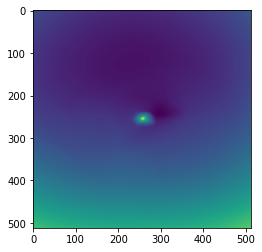

epoch 46501: 47.83375930786133
epoch 46502: 47.98884201049805
epoch 46503: 48.204734802246094
epoch 46504: 49.10905075073242
epoch 46505: 48.68352508544922
epoch 46506: 48.25436019897461
epoch 46507: 47.95176315307617
epoch 46508: 49.50965118408203
epoch 46509: 49.288028717041016
epoch 46511: 48.26837158203125
epoch 46512: 48.324066162109375
epoch 46513: 48.97789001464844
epoch 46514: 48.228294372558594
epoch 46515: 48.8894157409668
epoch 46516: 48.35859680175781
epoch 46517: 48.34386444091797
epoch 46518: 49.413516998291016
epoch 46519: 47.70790481567383
epoch 46521: 47.858421325683594
epoch 46522: 47.94278335571289
epoch 46523: 48.4471321105957
epoch 46524: 47.54764938354492
epoch 46525: 48.376216888427734
epoch 46526: 49.61662673950195
epoch 46527: 49.27275466918945
epoch 46528: 48.85683822631836
epoch 46529: 48.97108459472656
epoch 46531: 48.39536666870117
epoch 46532: 48.65956497192383
epoch 46533: 48.66709518432617
epoch 46534: 48.618919372558594
epoch 46535: 48.0926628112793
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



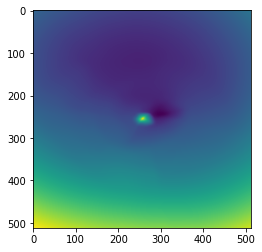

epoch 46601: 48.171852111816406
epoch 46602: 47.54876708984375
epoch 46603: 49.20075225830078
epoch 46604: 47.682918548583984
epoch 46605: 49.3828239440918
epoch 46606: 48.708065032958984
epoch 46607: 47.91230773925781
epoch 46608: 48.86741256713867
epoch 46609: 49.75122833251953
epoch 46611: 48.64442443847656
epoch 46612: 48.697696685791016
epoch 46613: 48.12448501586914
epoch 46614: 47.59840393066406
epoch 46615: 49.77753448486328
epoch 46616: 47.58306884765625
epoch 46617: 47.96178436279297
epoch 46618: 48.367713928222656
epoch 46619: 48.19175720214844
epoch 46621: 48.3715934753418
epoch 46622: 48.783042907714844
epoch 46623: 47.96957778930664
epoch 46624: 48.01962661743164
epoch 46625: 48.304630279541016
epoch 46626: 48.14784240722656
epoch 46627: 48.656410217285156
epoch 46628: 48.70724868774414
epoch 46629: 48.63348388671875
epoch 46631: 47.964996337890625
epoch 46632: 47.9381103515625
epoch 46633: 47.78622817993164
epoch 46634: 48.5673828125
epoch 46635: 48.177879333496094
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



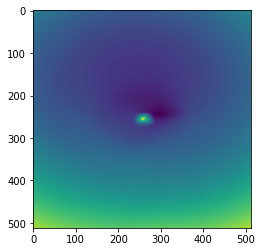

epoch 46701: 48.4136962890625
epoch 46702: 47.590919494628906
epoch 46703: 49.1248893737793
epoch 46704: 48.38850402832031
epoch 46705: 48.44449996948242
epoch 46706: 48.76779556274414
epoch 46707: 47.92822265625
epoch 46708: 47.980491638183594
epoch 46709: 48.92841720581055
epoch 46711: 47.65826416015625
epoch 46712: 48.57026672363281
epoch 46713: 48.507606506347656
epoch 46714: 48.91522216796875
epoch 46715: 47.355403900146484
epoch 46716: 47.8613395690918
epoch 46717: 48.1481819152832
epoch 46718: 47.8359260559082
epoch 46719: 48.02406692504883
epoch 46721: 47.990333557128906
epoch 46722: 49.18755340576172
epoch 46723: 48.49774932861328
epoch 46724: 48.52488708496094
epoch 46725: 48.2767219543457
epoch 46726: 48.34804153442383
epoch 46727: 47.8584098815918
epoch 46728: 48.32572937011719
epoch 46729: 49.08285140991211
epoch 46731: 49.20463180541992
epoch 46732: 47.74268341064453
epoch 46733: 49.55075454711914
epoch 46734: 48.425926208496094
epoch 46735: 47.49855041503906
epoch 46736:

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



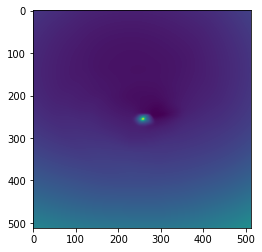

epoch 46801: 48.96952438354492
epoch 46802: 47.702274322509766
epoch 46803: 48.2249870300293
epoch 46804: 48.43240737915039
epoch 46805: 48.948692321777344
epoch 46806: 48.12955093383789
epoch 46807: 47.917232513427734
epoch 46808: 48.90678024291992
epoch 46809: 47.04166030883789
epoch 46811: 48.31123733520508
epoch 46812: 48.3093147277832
epoch 46813: 49.119781494140625
epoch 46814: 48.598060607910156
epoch 46815: 48.079708099365234
epoch 46816: 49.7940673828125
epoch 46817: 48.70225143432617
epoch 46818: 48.27907180786133
epoch 46819: 47.8410530090332
epoch 46821: 48.247066497802734
epoch 46822: 49.03034973144531
epoch 46823: 48.821144104003906
epoch 46824: 48.09739685058594
epoch 46825: 47.8951301574707
epoch 46826: 48.518035888671875
epoch 46827: 47.47696304321289
epoch 46828: 47.988529205322266
epoch 46829: 48.322689056396484
epoch 46831: 48.134246826171875
epoch 46832: 49.02894973754883
epoch 46833: 47.5397834777832
epoch 46834: 47.968563079833984
epoch 46835: 48.140892028808594


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



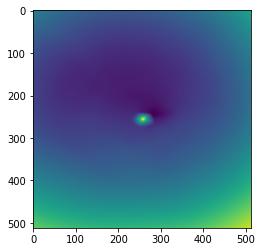

epoch 46901: 48.34416580200195
epoch 46902: 48.25178146362305
epoch 46903: 47.67533493041992
epoch 46904: 48.01906204223633
epoch 46905: 48.58978271484375
epoch 46906: 48.45952224731445
epoch 46907: 48.04446029663086
epoch 46908: 48.02448272705078
epoch 46909: 48.93309783935547
epoch 46911: 48.50017166137695
epoch 46912: 48.40094757080078
epoch 46913: 49.75924301147461
epoch 46914: 47.582950592041016
epoch 46915: 47.447357177734375
epoch 46916: 47.63896560668945
epoch 46917: 48.431884765625
epoch 46918: 47.74222183227539
epoch 46919: 48.94467544555664
epoch 46921: 47.83195877075195
epoch 46922: 48.45839309692383
epoch 46923: 48.75950622558594
epoch 46924: 48.39363479614258
epoch 46925: 47.687442779541016
epoch 46926: 49.54983139038086
epoch 46927: 48.69890594482422
epoch 46928: 48.15327072143555
epoch 46929: 47.904083251953125
epoch 46931: 48.469303131103516
epoch 46932: 47.643951416015625
epoch 46933: 48.57735061645508
epoch 46934: 47.35655212402344
epoch 46935: 47.95931625366211
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



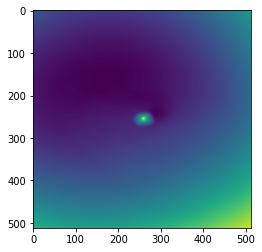

epoch 47001: 48.12713623046875
epoch 47002: 47.71219253540039
epoch 47003: 48.2774543762207
epoch 47004: 47.671268463134766
epoch 47005: 47.401180267333984
epoch 47006: 48.02140426635742
epoch 47007: 48.86067199707031
epoch 47008: 47.90050506591797
epoch 47009: 48.03128433227539
epoch 47011: 48.249019622802734
epoch 47012: 46.94841003417969
epoch 47013: 47.75282669067383
epoch 47014: 47.897552490234375
epoch 47015: 48.645687103271484
epoch 47016: 48.04345703125
epoch 47017: 49.17382049560547
epoch 47018: 48.51767349243164
epoch 47019: 47.8535270690918
epoch 47021: 48.0822868347168
epoch 47022: 47.8812370300293
epoch 47023: 47.72087860107422
epoch 47024: 48.72956085205078
epoch 47025: 48.18994140625
epoch 47026: 47.743064880371094
epoch 47027: 47.580345153808594
epoch 47028: 49.44331359863281
epoch 47029: 48.43994903564453
epoch 47031: 47.88660430908203
epoch 47032: 47.81155776977539
epoch 47033: 47.937374114990234
epoch 47034: 47.92507553100586
epoch 47035: 48.37778854370117
epoch 4703

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



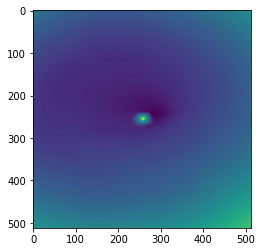

epoch 47101: 47.5833854675293
epoch 47102: 47.596107482910156
epoch 47103: 48.28800582885742
epoch 47104: 47.690040588378906
epoch 47105: 48.90913391113281
epoch 47106: 47.687191009521484
epoch 47107: 48.31973648071289
epoch 47108: 48.73403549194336
epoch 47109: 47.83264923095703
epoch 47111: 48.03987121582031
epoch 47112: 47.88140106201172
epoch 47113: 48.68489074707031
epoch 47114: 48.59258270263672
epoch 47115: 47.28276443481445
epoch 47116: 47.89324951171875
epoch 47117: 49.13689041137695
epoch 47118: 49.711761474609375
epoch 47119: 48.25251388549805
epoch 47121: 50.2262077331543
epoch 47122: 47.764041900634766
epoch 47123: 48.37761688232422
epoch 47124: 48.07841873168945
epoch 47125: 47.85333251953125
epoch 47126: 48.10445785522461
epoch 47127: 47.70002365112305
epoch 47128: 47.987205505371094
epoch 47129: 48.24757385253906
epoch 47131: 48.10997009277344
epoch 47132: 48.01727294921875
epoch 47133: 48.50809097290039
epoch 47134: 47.84557342529297
epoch 47135: 47.999996185302734
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



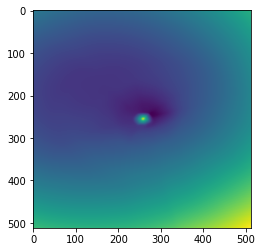

epoch 47201: 47.47842788696289
epoch 47202: 48.46874237060547
epoch 47203: 47.668212890625
epoch 47204: 48.658119201660156
epoch 47205: 47.769954681396484
epoch 47206: 48.282840728759766
epoch 47207: 49.00817108154297
epoch 47208: 48.83183670043945
epoch 47209: 49.09392166137695
epoch 47211: 48.390926361083984
epoch 47212: 50.469486236572266
epoch 47213: 48.00102615356445
epoch 47214: 47.51332473754883
epoch 47215: 47.51729965209961
epoch 47216: 47.13502502441406
epoch 47217: 48.54158401489258
epoch 47218: 47.97833251953125
epoch 47219: 48.311275482177734
epoch 47221: 47.8037223815918
epoch 47222: 48.185630798339844
epoch 47223: 48.35790252685547
epoch 47224: 47.549102783203125
epoch 47225: 50.75983428955078
epoch 47226: 47.948246002197266
epoch 47227: 48.639678955078125
epoch 47228: 49.64392852783203
epoch 47229: 48.15843963623047
epoch 47231: 48.032772064208984
epoch 47232: 48.61457824707031
epoch 47233: 47.7252082824707
epoch 47234: 48.45204544067383
epoch 47235: 48.225852966308594


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



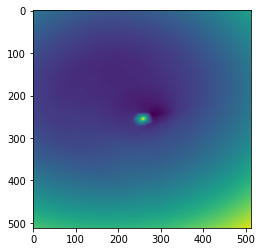

epoch 47301: 47.42498016357422
epoch 47302: 48.01847457885742
epoch 47303: 47.63016891479492
epoch 47304: 49.17616653442383
epoch 47305: 49.67320251464844
epoch 47306: 50.55072021484375
epoch 47307: 48.14080047607422
epoch 47308: 49.568912506103516
epoch 47309: 48.11531448364258
epoch 47311: 48.25596237182617
epoch 47312: 49.04265594482422
epoch 47313: 48.71360397338867
epoch 47314: 48.39167404174805
epoch 47315: 50.33274841308594
epoch 47316: 48.53105163574219
epoch 47317: 48.73081588745117
epoch 47318: 48.287960052490234
epoch 47319: 49.4193115234375
epoch 47321: 48.31072998046875
epoch 47322: 47.7388916015625
epoch 47323: 48.319923400878906
epoch 47324: 47.47489929199219
epoch 47325: 48.576080322265625
epoch 47326: 48.34051513671875
epoch 47327: 49.08616638183594
epoch 47328: 47.979347229003906
epoch 47329: 48.55084228515625
epoch 47331: 47.911930084228516
epoch 47332: 47.49991226196289
epoch 47333: 48.76234436035156
epoch 47334: 48.236915588378906
epoch 47335: 48.01155090332031
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



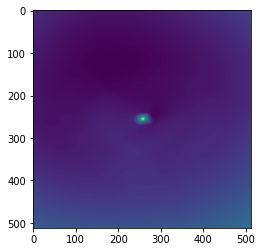

epoch 47401: 48.90412521362305
epoch 47402: 49.16332244873047
epoch 47403: 47.93075942993164
epoch 47404: 48.72024917602539
epoch 47405: 47.52122116088867
epoch 47406: 48.268531799316406
epoch 47407: 47.986053466796875
epoch 47408: 48.31026840209961
epoch 47409: 47.562103271484375
epoch 47411: 48.53175354003906
epoch 47412: 48.50168228149414
epoch 47413: 47.85606002807617
epoch 47414: 48.7059440612793
epoch 47415: 49.066654205322266
epoch 47416: 47.92708206176758
epoch 47417: 47.372928619384766
epoch 47418: 48.77190399169922
epoch 47419: 47.639869689941406
epoch 47421: 48.72649002075195
epoch 47422: 48.39273452758789
epoch 47423: 47.91593933105469
epoch 47424: 48.374820709228516
epoch 47425: 47.70901107788086
epoch 47426: 48.07369613647461
epoch 47427: 48.045162200927734
epoch 47428: 48.82036590576172
epoch 47429: 48.32405090332031
epoch 47431: 48.10231018066406
epoch 47432: 48.00946044921875
epoch 47433: 49.156856536865234
epoch 47434: 49.62326431274414
epoch 47435: 48.03312683105469


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



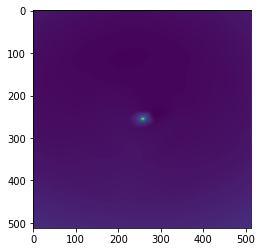

epoch 47501: 48.07741928100586
epoch 47502: 48.25235366821289
epoch 47503: 48.518795013427734
epoch 47504: 48.74915313720703
epoch 47505: 48.68827819824219
epoch 47506: 48.48423767089844
epoch 47507: 48.815547943115234
epoch 47508: 48.624332427978516
epoch 47509: 48.10877227783203
epoch 47511: 47.76799774169922
epoch 47512: 49.08706283569336
epoch 47513: 48.31822204589844
epoch 47514: 48.02583312988281
epoch 47515: 47.81681823730469
epoch 47516: 48.099002838134766
epoch 47517: 48.8589973449707
epoch 47518: 48.80842590332031
epoch 47519: 47.72175598144531
epoch 47521: 49.51885986328125
epoch 47522: 48.646339416503906
epoch 47523: 48.806610107421875
epoch 47524: 48.25295639038086
epoch 47525: 48.16862106323242
epoch 47526: 48.5233268737793
epoch 47527: 47.540164947509766
epoch 47528: 48.75273895263672
epoch 47529: 48.40800476074219
epoch 47531: 49.0145263671875
epoch 47532: 47.39387130737305
epoch 47533: 48.0543212890625
epoch 47534: 47.87261962890625
epoch 47535: 48.40123748779297
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



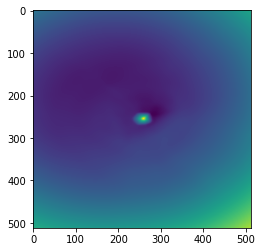

epoch 47601: 48.56956481933594
epoch 47602: 48.640254974365234
epoch 47603: 47.625247955322266
epoch 47604: 48.76829528808594
epoch 47605: 47.65998077392578
epoch 47606: 49.225311279296875
epoch 47607: 48.40242385864258
epoch 47608: 48.60685729980469
epoch 47609: 48.06385040283203
epoch 47611: 50.667579650878906
epoch 47612: 48.52543258666992
epoch 47613: 48.668704986572266
epoch 47614: 47.83711242675781
epoch 47615: 47.724525451660156
epoch 47616: 48.39926528930664
epoch 47617: 48.60246658325195
epoch 47618: 47.811588287353516
epoch 47619: 47.708648681640625
epoch 47621: 47.9720573425293
epoch 47622: 49.03293991088867
epoch 47623: 49.00316619873047
epoch 47624: 48.85612487792969
epoch 47625: 48.60734176635742
epoch 47626: 48.13764953613281
epoch 47627: 48.033958435058594
epoch 47628: 48.72074508666992
epoch 47629: 48.957496643066406
epoch 47631: 48.470115661621094
epoch 47632: 50.672882080078125
epoch 47633: 48.46791076660156
epoch 47634: 48.57024383544922
epoch 47635: 48.637081146240

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



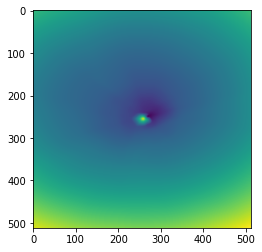

epoch 47701: 49.190216064453125
epoch 47702: 48.161834716796875
epoch 47703: 49.585105895996094
epoch 47704: 48.17231369018555
epoch 47705: 49.03987503051758
epoch 47706: 48.72515869140625
epoch 47707: 48.481327056884766
epoch 47708: 48.05598068237305
epoch 47709: 48.59043884277344
epoch 47711: 51.15706253051758
epoch 47712: 48.500057220458984
epoch 47713: 48.550048828125
epoch 47714: 48.996490478515625
epoch 47715: 48.550594329833984
epoch 47716: 48.57212829589844
epoch 47717: 48.920589447021484
epoch 47718: 48.663265228271484
epoch 47719: 48.669822692871094
epoch 47721: 49.92958068847656
epoch 47722: 48.36598205566406
epoch 47723: 49.16600036621094
epoch 47724: 48.29817199707031
epoch 47725: 48.45571517944336
epoch 47726: 48.13414001464844
epoch 47727: 48.32430648803711
epoch 47728: 48.45561981201172
epoch 47729: 47.93131637573242
epoch 47731: 48.7955322265625
epoch 47732: 48.33538055419922
epoch 47733: 48.54159164428711
epoch 47734: 48.372920989990234
epoch 47735: 48.90291213989258


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



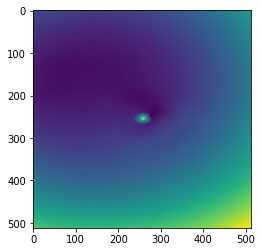

epoch 47801: 47.56431579589844
epoch 47802: 47.724456787109375
epoch 47803: 47.27681350708008
epoch 47804: 48.40059280395508
epoch 47805: 47.79533386230469
epoch 47806: 48.4495849609375
epoch 47807: 48.031612396240234
epoch 47808: 48.65930938720703
epoch 47809: 49.63070297241211
epoch 47811: 48.70620346069336
epoch 47812: 47.43443298339844
epoch 47813: 48.189125061035156
epoch 47814: 47.537784576416016
epoch 47815: 48.27518081665039
epoch 47816: 47.99223327636719
epoch 47817: 48.37677764892578
epoch 47818: 48.90167236328125
epoch 47819: 48.02922058105469
epoch 47821: 47.886104583740234
epoch 47822: 48.10155487060547
epoch 47823: 48.23009490966797
epoch 47824: 47.56132125854492
epoch 47825: 48.17622756958008
epoch 47826: 47.2935791015625
epoch 47827: 48.450679779052734
epoch 47828: 48.79267120361328
epoch 47829: 48.18283462524414
epoch 47831: 47.792442321777344
epoch 47832: 48.66501998901367
epoch 47833: 48.93600082397461
epoch 47834: 48.508697509765625
epoch 47835: 47.53428649902344
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



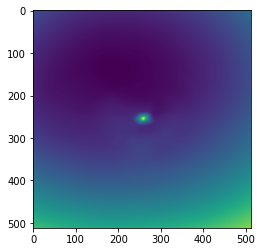

epoch 47901: 48.552764892578125
epoch 47902: 47.74387741088867
epoch 47903: 48.53348159790039
epoch 47904: 47.806617736816406
epoch 47905: 47.337646484375
epoch 47906: 47.88761901855469
epoch 47907: 49.17041778564453
epoch 47908: 49.36196517944336
epoch 47909: 47.834529876708984
epoch 47911: 48.00101089477539
epoch 47912: 48.531280517578125
epoch 47913: 48.05472183227539
epoch 47914: 48.13018798828125
epoch 47915: 47.88971710205078
epoch 47916: 48.57359313964844
epoch 47917: 48.40439224243164
epoch 47918: 47.728153228759766
epoch 47919: 47.3287353515625
epoch 47921: 47.942596435546875
epoch 47922: 48.23660659790039
epoch 47923: 48.65235900878906
epoch 47924: 47.31483459472656
epoch 47925: 48.411895751953125
epoch 47926: 47.753658294677734
epoch 47927: 48.573238372802734
epoch 47928: 47.87778854370117
epoch 47929: 48.58953094482422
epoch 47931: 48.42825698852539
epoch 47932: 48.05510330200195
epoch 47933: 50.07447814941406
epoch 47934: 48.53657913208008
epoch 47935: 48.10468673706055
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



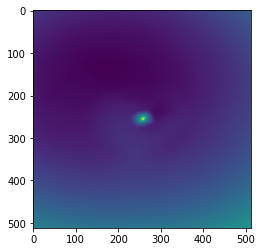

epoch 48001: 48.115745544433594
epoch 48002: 47.71720886230469
epoch 48003: 47.46458053588867
epoch 48004: 49.60023880004883
epoch 48005: 48.56710433959961
epoch 48006: 48.39532470703125
epoch 48007: 48.50910568237305
epoch 48008: 46.91981887817383
epoch 48009: 48.59391784667969
epoch 48011: 47.73953628540039
epoch 48012: 47.92005157470703
epoch 48013: 48.58287048339844
epoch 48014: 48.25968551635742
epoch 48015: 47.38426208496094
epoch 48016: 47.18308639526367
epoch 48017: 47.834556579589844
epoch 48018: 48.868064880371094
epoch 48019: 48.30024719238281
epoch 48021: 47.77546310424805
epoch 48022: 47.52254104614258
epoch 48023: 47.66937255859375
epoch 48024: 48.348915100097656
epoch 48025: 48.26414489746094
epoch 48026: 48.37173843383789
epoch 48027: 47.54186248779297
epoch 48028: 48.043033599853516
epoch 48029: 48.02114486694336
epoch 48031: 47.58014678955078
epoch 48032: 48.0489501953125
epoch 48033: 47.6729850769043
epoch 48034: 48.35860061645508
epoch 48035: 48.51546096801758
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



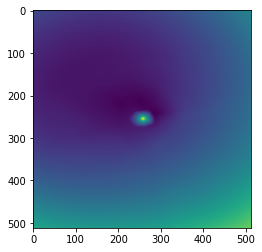

epoch 48101: 48.58507537841797
epoch 48102: 47.621856689453125
epoch 48103: 47.60213088989258
epoch 48104: 48.86359786987305
epoch 48105: 48.14154052734375
epoch 48106: 47.631229400634766
epoch 48107: 47.74853515625
epoch 48108: 49.258506774902344
epoch 48109: 48.29251480102539
epoch 48111: 48.05460739135742
epoch 48112: 48.139888763427734
epoch 48113: 48.42129135131836
epoch 48114: 47.79252243041992
epoch 48115: 48.68244552612305
epoch 48116: 47.568599700927734
epoch 48117: 47.7503776550293
epoch 48118: 48.296051025390625
epoch 48119: 47.394229888916016
epoch 48121: 47.9498291015625
epoch 48122: 47.67131805419922
epoch 48123: 48.45991134643555
epoch 48124: 47.68072509765625
epoch 48125: 47.82244110107422
epoch 48126: 47.64576721191406
epoch 48127: 49.294193267822266
epoch 48128: 48.06800842285156
epoch 48129: 47.5713996887207
epoch 48131: 48.26488494873047
epoch 48132: 47.75905990600586
epoch 48133: 47.8386116027832
epoch 48134: 47.814170837402344
epoch 48135: 47.903526306152344
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



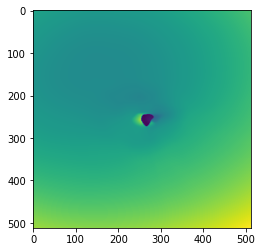

epoch 48201: 48.86029815673828
epoch 48202: 49.380897521972656
epoch 48203: 49.07027053833008
epoch 48204: 48.57648468017578
epoch 48205: 49.25290298461914
epoch 48206: 48.322418212890625
epoch 48207: 49.0474739074707
epoch 48208: 48.357845306396484
epoch 48209: 48.398223876953125
epoch 48211: 48.911643981933594
epoch 48212: 48.178348541259766
epoch 48213: 48.767704010009766
epoch 48214: 48.582332611083984
epoch 48215: 48.51517105102539
epoch 48216: 48.54472732543945
epoch 48217: 49.599613189697266
epoch 48218: 48.44770812988281
epoch 48219: 48.58619689941406
epoch 48221: 48.606746673583984
epoch 48222: 48.09012222290039
epoch 48223: 48.5696907043457
epoch 48224: 49.13820266723633
epoch 48225: 48.63993835449219
epoch 48226: 49.190269470214844
epoch 48227: 49.76614761352539
epoch 48228: 48.91264724731445
epoch 48229: 49.3134880065918
epoch 48231: 48.265899658203125
epoch 48232: 48.83381271362305
epoch 48233: 49.2337646484375
epoch 48234: 48.63692092895508
epoch 48235: 48.88148498535156


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



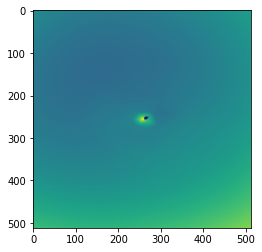

epoch 48301: 48.97611999511719
epoch 48302: 48.055824279785156
epoch 48303: 48.301143646240234
epoch 48304: 48.53891372680664
epoch 48305: 48.1458854675293
epoch 48306: 49.10565948486328
epoch 48307: 48.897972106933594
epoch 48308: 48.52625274658203
epoch 48309: 47.9342155456543
epoch 48311: 48.24605178833008
epoch 48312: 48.75475311279297
epoch 48313: 48.758705139160156
epoch 48314: 49.99726104736328
epoch 48315: 50.39542007446289
epoch 48316: 49.38813018798828
epoch 48317: 48.85910415649414
epoch 48318: 48.79815673828125
epoch 48319: 48.56475067138672
epoch 48321: 49.7900276184082
epoch 48322: 48.4329948425293
epoch 48323: 48.55509567260742
epoch 48324: 48.1336784362793
epoch 48325: 48.0371208190918
epoch 48326: 48.44451141357422
epoch 48327: 48.4334831237793
epoch 48328: 47.80185317993164
epoch 48329: 48.537498474121094
epoch 48331: 48.556297302246094
epoch 48332: 48.9616813659668
epoch 48333: 48.48650360107422
epoch 48334: 48.96593475341797
epoch 48335: 49.86478042602539
epoch 4833

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



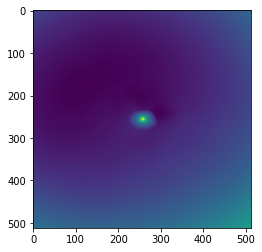

epoch 48401: 47.93906784057617
epoch 48402: 48.34817123413086
epoch 48403: 47.78728485107422
epoch 48404: 48.572628021240234
epoch 48405: 49.756961822509766
epoch 48406: 48.86576843261719
epoch 48407: 48.24751663208008
epoch 48408: 48.58814239501953
epoch 48409: 48.53065490722656
epoch 48411: 48.49705123901367
epoch 48412: 48.428443908691406
epoch 48413: 47.77971267700195
epoch 48414: 49.298309326171875
epoch 48415: 49.56795120239258
epoch 48416: 48.449501037597656
epoch 48417: 48.55433654785156
epoch 48418: 48.9384880065918
epoch 48419: 50.117515563964844
epoch 48421: 48.054588317871094
epoch 48422: 49.07887268066406
epoch 48423: 48.21973419189453
epoch 48424: 48.92534255981445
epoch 48425: 48.350799560546875
epoch 48426: 49.24773025512695
epoch 48427: 48.80987548828125
epoch 48428: 48.90253448486328
epoch 48429: 48.70027542114258
epoch 48431: 48.30459976196289
epoch 48432: 48.799644470214844
epoch 48433: 47.83430099487305
epoch 48434: 47.99490737915039
epoch 48435: 48.8845100402832
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



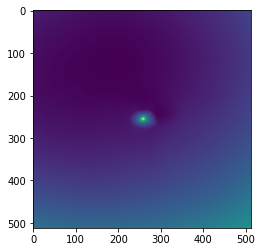

epoch 48501: 47.71072006225586
epoch 48502: 48.37172317504883
epoch 48503: 49.27992248535156
epoch 48504: 48.979427337646484
epoch 48505: 47.937416076660156
epoch 48506: 48.10054016113281
epoch 48507: 48.073482513427734
epoch 48508: 48.35319519042969
epoch 48509: 48.31319808959961
epoch 48511: 49.98289108276367
epoch 48512: 48.61885452270508
epoch 48513: 47.617401123046875
epoch 48514: 47.805458068847656
epoch 48515: 48.31232452392578
epoch 48516: 47.91651916503906
epoch 48517: 47.79738998413086
epoch 48518: 49.009117126464844
epoch 48519: 48.575965881347656
epoch 48521: 48.58647155761719
epoch 48522: 48.8946647644043
epoch 48523: 48.67937469482422
epoch 48524: 48.20026779174805
epoch 48525: 48.027488708496094
epoch 48526: 48.14139175415039
epoch 48527: 48.03535842895508
epoch 48528: 46.655052185058594
epoch 48529: 48.550506591796875
epoch 48531: 48.35369110107422
epoch 48532: 48.32835006713867
epoch 48533: 48.283939361572266
epoch 48534: 48.952117919921875
epoch 48535: 48.423858642578

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



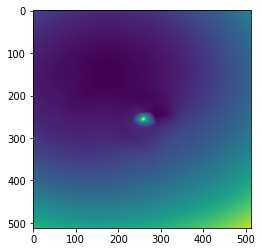

epoch 48601: 47.78478240966797
epoch 48602: 49.892799377441406
epoch 48603: 48.43458557128906
epoch 48604: 47.637939453125
epoch 48605: 47.43083190917969
epoch 48606: 49.14030075073242
epoch 48607: 47.510494232177734
epoch 48608: 47.865875244140625
epoch 48609: 48.124515533447266
epoch 48611: 48.017208099365234
epoch 48612: 48.53036880493164
epoch 48613: 47.99794006347656
epoch 48614: 48.25959396362305
epoch 48615: 48.14777755737305
epoch 48616: 48.836097717285156
epoch 48617: 48.934871673583984
epoch 48618: 48.025169372558594
epoch 48619: 47.46188735961914
epoch 48621: 48.271728515625
epoch 48622: 47.3282470703125
epoch 48623: 47.99675369262695
epoch 48624: 48.141517639160156
epoch 48625: 48.2095832824707
epoch 48626: 48.44649887084961
epoch 48627: 48.51435852050781
epoch 48628: 47.528472900390625
epoch 48629: 48.3404541015625
epoch 48631: 47.48040771484375
epoch 48632: 48.01377487182617
epoch 48633: 47.97517013549805
epoch 48634: 47.492698669433594
epoch 48635: 48.38294982910156
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



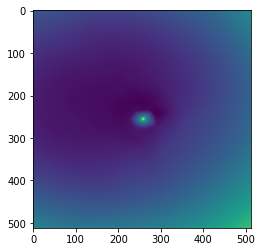

epoch 48701: 48.68964767456055
epoch 48702: 49.24102783203125
epoch 48703: 48.03825378417969
epoch 48704: 48.265167236328125
epoch 48705: 47.95244216918945
epoch 48706: 47.93030548095703
epoch 48707: 48.52558135986328
epoch 48708: 47.674102783203125
epoch 48709: 48.9273796081543
epoch 48711: 47.93495178222656
epoch 48712: 48.14517593383789
epoch 48713: 48.312164306640625
epoch 48714: 48.325889587402344
epoch 48715: 49.202857971191406
epoch 48716: 47.65212631225586
epoch 48717: 48.750343322753906
epoch 48718: 48.59832763671875
epoch 48719: 47.472312927246094
epoch 48721: 49.11063003540039
epoch 48722: 48.228981018066406
epoch 48723: 47.08350372314453
epoch 48724: 49.94383239746094
epoch 48725: 48.82780075073242
epoch 48726: 50.284950256347656
epoch 48727: 47.28184127807617
epoch 48728: 47.72800827026367
epoch 48729: 48.098419189453125
epoch 48731: 49.37085723876953
epoch 48732: 47.703460693359375
epoch 48733: 48.44012451171875
epoch 48734: 49.571170806884766
epoch 48735: 47.825561523437

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



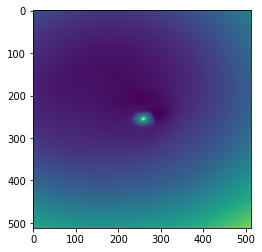

epoch 48801: 49.128074645996094
epoch 48802: 47.436920166015625
epoch 48803: 47.86044692993164
epoch 48804: 47.83788299560547
epoch 48805: 47.41677474975586
epoch 48806: 47.825843811035156
epoch 48807: 48.389495849609375
epoch 48808: 47.74138641357422
epoch 48809: 48.067230224609375
epoch 48811: 48.079368591308594
epoch 48812: 47.841880798339844
epoch 48813: 48.46416473388672
epoch 48814: 48.22051239013672
epoch 48815: 48.02941131591797
epoch 48816: 47.65211868286133
epoch 48817: 49.505157470703125
epoch 48818: 48.127647399902344
epoch 48819: 47.593929290771484
epoch 48821: 47.68267059326172
epoch 48822: 48.17564392089844
epoch 48823: 48.51118469238281
epoch 48824: 48.40140151977539
epoch 48825: 47.45670700073242
epoch 48826: 47.678497314453125
epoch 48827: 50.81645584106445
epoch 48828: 48.19771194458008
epoch 48829: 48.09967803955078
epoch 48831: 48.7158203125
epoch 48832: 48.21644973754883
epoch 48833: 47.74620056152344
epoch 48834: 48.262386322021484
epoch 48835: 48.943729400634766

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



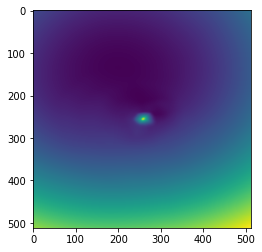

epoch 48901: 47.68291473388672
epoch 48902: 48.313690185546875
epoch 48903: 48.52486038208008
epoch 48904: 50.5408821105957
epoch 48905: 48.478336334228516
epoch 48906: 48.102081298828125
epoch 48907: 48.23177719116211
epoch 48908: 47.42842102050781
epoch 48909: 47.79608154296875
epoch 48911: 47.71767807006836
epoch 48912: 47.92056655883789
epoch 48913: 49.02848815917969
epoch 48914: 48.94731140136719
epoch 48915: 48.00522994995117
epoch 48916: 48.00208282470703
epoch 48917: 47.77775192260742
epoch 48918: 47.61613845825195
epoch 48919: 47.69621658325195
epoch 48921: 47.962467193603516
epoch 48922: 47.920753479003906
epoch 48923: 47.77958297729492
epoch 48924: 48.12440872192383
epoch 48925: 47.486473083496094
epoch 48926: 48.67679214477539
epoch 48927: 48.5427360534668
epoch 48928: 48.465511322021484
epoch 48929: 47.480003356933594
epoch 48931: 48.620975494384766
epoch 48932: 47.73695755004883
epoch 48933: 48.18708801269531
epoch 48934: 48.17348861694336
epoch 48935: 47.863101959228516


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



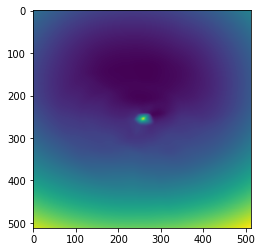

epoch 49001: 48.2558708190918
epoch 49002: 47.97126007080078
epoch 49003: 47.82558059692383
epoch 49004: 48.4348030090332
epoch 49005: 48.148643493652344
epoch 49006: 48.956539154052734
epoch 49007: 48.33184051513672
epoch 49008: 48.33354949951172
epoch 49009: 47.286136627197266
epoch 49011: 48.28925323486328
epoch 49012: 47.85627365112305
epoch 49013: 48.548439025878906
epoch 49014: 47.907981872558594
epoch 49015: 48.376644134521484
epoch 49016: 48.56621170043945
epoch 49017: 48.25468063354492
epoch 49018: 48.77932357788086
epoch 49019: 48.751651763916016
epoch 49021: 47.84271240234375
epoch 49022: 48.138118743896484
epoch 49023: 47.78243637084961
epoch 49024: 48.18142318725586
epoch 49025: 47.85289764404297
epoch 49026: 48.089969635009766
epoch 49027: 47.878395080566406
epoch 49028: 48.197608947753906
epoch 49029: 48.278133392333984
epoch 49031: 47.628700256347656
epoch 49032: 48.18994140625
epoch 49033: 47.999908447265625
epoch 49034: 47.507991790771484
epoch 49035: 48.5555343627929

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



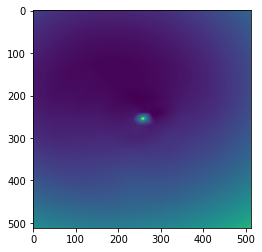

epoch 49101: 48.359275817871094
epoch 49102: 47.68782043457031
epoch 49103: 47.82748031616211
epoch 49104: 47.772342681884766
epoch 49105: 48.37985610961914
epoch 49106: 48.235679626464844
epoch 49107: 47.99117660522461
epoch 49108: 48.685279846191406
epoch 49109: 48.32749938964844
epoch 49111: 48.217933654785156
epoch 49112: 48.31270980834961
epoch 49113: 48.27880096435547
epoch 49114: 48.01128005981445
epoch 49115: 47.964271545410156
epoch 49116: 48.79985809326172
epoch 49117: 47.996219635009766
epoch 49118: 47.915557861328125
epoch 49119: 48.85204315185547
epoch 49121: 47.30622482299805
epoch 49122: 47.833396911621094
epoch 49123: 49.15269088745117
epoch 49124: 48.17275619506836
epoch 49125: 47.71132278442383
epoch 49126: 47.74778366088867
epoch 49127: 47.856201171875
epoch 49128: 50.60545349121094
epoch 49129: 49.6523551940918
epoch 49131: 48.777828216552734
epoch 49132: 47.73715591430664
epoch 49133: 48.359230041503906
epoch 49134: 48.5692253112793
epoch 49135: 48.301673889160156


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



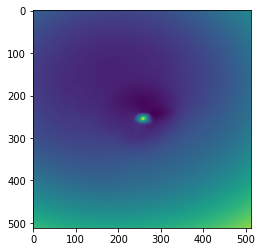

epoch 49201: 48.6341438293457
epoch 49202: 48.73440933227539
epoch 49203: 47.31505584716797
epoch 49204: 48.790794372558594
epoch 49205: 48.24172592163086
epoch 49206: 48.68841552734375
epoch 49207: 48.052181243896484
epoch 49208: 47.764366149902344
epoch 49209: 48.06934356689453
epoch 49211: 48.10810089111328
epoch 49212: 48.13360595703125
epoch 49213: 48.15576934814453
epoch 49214: 47.64164352416992
epoch 49215: 48.13749313354492
epoch 49216: 48.22469711303711
epoch 49217: 47.86040496826172
epoch 49218: 48.485755920410156
epoch 49219: 49.05588150024414
epoch 49221: 48.360862731933594
epoch 49222: 48.315513610839844
epoch 49223: 48.4217414855957
epoch 49224: 48.315338134765625
epoch 49225: 48.10342025756836
epoch 49226: 48.23226547241211
epoch 49227: 49.22384262084961
epoch 49228: 47.94425964355469
epoch 49229: 48.04107666015625
epoch 49231: 47.574642181396484
epoch 49232: 48.36073684692383
epoch 49233: 47.86848068237305
epoch 49234: 47.88456344604492
epoch 49235: 48.20539093017578
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



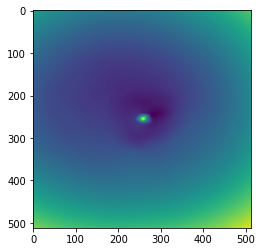

epoch 49301: 49.21841049194336
epoch 49302: 48.102561950683594
epoch 49303: 48.76335525512695
epoch 49304: 48.659671783447266
epoch 49305: 48.16801452636719
epoch 49306: 47.884376525878906
epoch 49307: 48.118377685546875
epoch 49308: 48.15334701538086
epoch 49309: 49.06705856323242
epoch 49311: 48.31609344482422
epoch 49312: 48.68659210205078
epoch 49313: 48.06229019165039
epoch 49314: 48.81684112548828
epoch 49315: 48.1605339050293
epoch 49316: 48.111854553222656
epoch 49317: 48.59720993041992
epoch 49318: 48.036991119384766
epoch 49319: 48.7335090637207
epoch 49321: 47.80940246582031
epoch 49322: 48.40989685058594
epoch 49323: 48.25812530517578
epoch 49324: 48.73345947265625
epoch 49325: 48.33961868286133
epoch 49326: 47.38770294189453
epoch 49327: 48.48431396484375
epoch 49328: 48.38131332397461
epoch 49329: 47.983314514160156
epoch 49331: 48.41856002807617
epoch 49332: 48.269954681396484
epoch 49333: 48.58330535888672
epoch 49334: 47.79842758178711
epoch 49335: 48.44081115722656
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



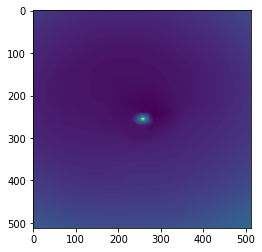

epoch 49401: 49.37989807128906
epoch 49402: 49.39752960205078
epoch 49403: 48.19575500488281
epoch 49404: 48.06780242919922
epoch 49405: 48.374168395996094
epoch 49406: 48.396812438964844
epoch 49407: 48.517311096191406
epoch 49408: 48.45387649536133
epoch 49409: 48.30152893066406
epoch 49411: 48.20840072631836
epoch 49412: 47.935089111328125
epoch 49413: 47.82044982910156
epoch 49414: 49.114505767822266
epoch 49415: 47.26628112792969
epoch 49416: 48.28071212768555
epoch 49417: 48.32471466064453
epoch 49418: 48.948490142822266
epoch 49419: 47.21693420410156
epoch 49421: 48.69216537475586
epoch 49422: 47.78521728515625
epoch 49423: 47.83599853515625
epoch 49424: 48.65986633300781
epoch 49425: 48.11040496826172
epoch 49426: 47.785621643066406
epoch 49427: 47.51576232910156
epoch 49428: 48.44916915893555
epoch 49429: 48.352935791015625
epoch 49431: 47.62635803222656
epoch 49432: 47.51223373413086
epoch 49433: 48.701927185058594
epoch 49434: 48.77958297729492
epoch 49435: 47.83127593994140

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



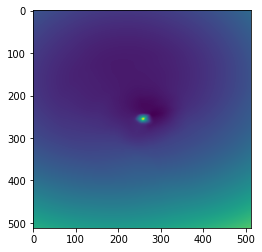

epoch 49501: 48.46579360961914
epoch 49502: 47.49728775024414
epoch 49503: 48.480873107910156
epoch 49504: 48.287837982177734
epoch 49505: 48.70697784423828
epoch 49506: 49.059627532958984
epoch 49507: 48.12218475341797
epoch 49508: 48.650875091552734
epoch 49509: 47.999244689941406
epoch 49511: 48.79183578491211
epoch 49512: 48.437896728515625
epoch 49513: 48.11119079589844
epoch 49514: 46.785099029541016
epoch 49515: 48.54180145263672
epoch 49516: 48.93143844604492
epoch 49517: 47.58241271972656
epoch 49518: 49.41496658325195
epoch 49519: 48.136783599853516
epoch 49521: 48.30447006225586
epoch 49522: 47.49024963378906
epoch 49523: 48.81235885620117
epoch 49524: 48.189693450927734
epoch 49525: 47.322269439697266
epoch 49526: 47.29680252075195
epoch 49527: 48.11689758300781
epoch 49528: 47.605865478515625
epoch 49529: 48.2247428894043
epoch 49531: 48.53290557861328
epoch 49532: 48.73614501953125
epoch 49533: 47.563602447509766
epoch 49534: 48.61198425292969
epoch 49535: 47.788024902343

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



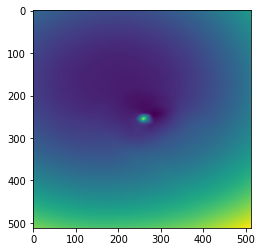

epoch 49601: 48.25217056274414
epoch 49602: 48.06200408935547
epoch 49603: 48.07387161254883
epoch 49604: 47.94679260253906
epoch 49605: 49.136138916015625
epoch 49606: 47.54852294921875
epoch 49607: 47.794898986816406
epoch 49608: 48.254817962646484
epoch 49609: 48.37351608276367
epoch 49611: 48.512001037597656
epoch 49612: 47.946678161621094
epoch 49613: 48.094200134277344
epoch 49614: 48.43950271606445
epoch 49615: 48.43703079223633
epoch 49616: 47.557945251464844
epoch 49617: 48.6163330078125
epoch 49618: 47.806434631347656
epoch 49619: 47.6400146484375
epoch 49621: 48.07368850708008
epoch 49622: 48.446617126464844
epoch 49623: 48.17613220214844
epoch 49624: 47.399505615234375
epoch 49625: 47.74494552612305
epoch 49626: 48.1995849609375
epoch 49627: 47.702308654785156
epoch 49628: 49.366233825683594
epoch 49629: 48.61530685424805
epoch 49631: 48.50481414794922
epoch 49632: 48.091739654541016
epoch 49633: 48.16565704345703
epoch 49634: 47.650875091552734
epoch 49635: 47.757537841796

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



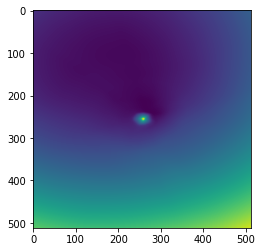

epoch 49701: 49.23253631591797
epoch 49702: 48.26545333862305
epoch 49703: 47.018348693847656
epoch 49704: 47.9279670715332
epoch 49705: 47.869590759277344
epoch 49706: 48.959739685058594
epoch 49707: 47.456275939941406
epoch 49708: 47.03758239746094
epoch 49709: 47.3184700012207
epoch 49711: 48.84485626220703
epoch 49712: 48.07758331298828
epoch 49713: 48.77631378173828
epoch 49714: 48.4151496887207
epoch 49715: 48.781131744384766
epoch 49716: 47.788543701171875
epoch 49717: 47.35093688964844
epoch 49718: 52.30815124511719
epoch 49719: 48.10762023925781
epoch 49721: 48.68682098388672
epoch 49722: 47.98369598388672
epoch 49723: 48.95122146606445
epoch 49724: 48.931087493896484
epoch 49725: 48.8210563659668
epoch 49726: 50.03291320800781
epoch 49727: 49.575252532958984
epoch 49728: 48.598121643066406
epoch 49729: 48.312679290771484
epoch 49731: 48.54714584350586
epoch 49732: 48.33844757080078
epoch 49733: 47.890743255615234
epoch 49734: 48.52598190307617
epoch 49735: 48.23729705810547
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



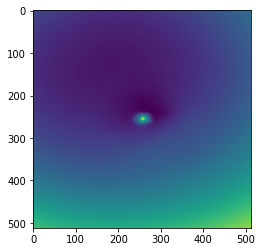

epoch 49801: 48.244773864746094
epoch 49802: 48.63063049316406
epoch 49803: 47.584774017333984
epoch 49804: 48.903907775878906
epoch 49805: 47.38698196411133
epoch 49806: 49.037776947021484
epoch 49807: 49.10773849487305
epoch 49808: 47.93214797973633
epoch 49809: 47.417606353759766
epoch 49811: 48.418701171875
epoch 49812: 48.23345184326172
epoch 49813: 48.38407516479492
epoch 49814: 48.99430465698242
epoch 49815: 47.752342224121094
epoch 49816: 47.75674057006836
epoch 49817: 48.828128814697266
epoch 49818: 48.096107482910156
epoch 49819: 48.65217590332031
epoch 49821: 47.865234375
epoch 49822: 46.701385498046875
epoch 49823: 47.71627426147461
epoch 49824: 48.05225372314453
epoch 49825: 48.53868103027344
epoch 49826: 48.454410552978516
epoch 49827: 47.511390686035156
epoch 49828: 48.653846740722656
epoch 49829: 47.763946533203125
epoch 49831: 47.44560623168945
epoch 49832: 47.71927261352539
epoch 49833: 47.9807014465332
epoch 49834: 47.722923278808594
epoch 49835: 48.41899108886719
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



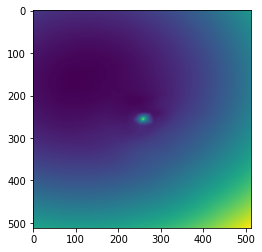

epoch 49901: 48.686622619628906
epoch 49902: 48.256072998046875
epoch 49903: 47.5600471496582
epoch 49904: 48.26906204223633
epoch 49905: 47.86381530761719
epoch 49906: 48.324440002441406
epoch 49907: 47.45322799682617
epoch 49908: 47.336856842041016
epoch 49909: 47.554725646972656
epoch 49911: 47.47573471069336
epoch 49912: 48.62945556640625
epoch 49913: 48.656044006347656
epoch 49914: 48.15666580200195
epoch 49915: 48.650657653808594
epoch 49916: 47.63180923461914
epoch 49917: 48.3382568359375
epoch 49918: 48.3177490234375
epoch 49919: 48.40877914428711
epoch 49921: 48.24380874633789
epoch 49922: 47.537757873535156
epoch 49923: 48.55386734008789
epoch 49924: 48.3129768371582
epoch 49925: 48.551612854003906
epoch 49926: 48.81840515136719
epoch 49927: 49.63533020019531
epoch 49928: 48.2359733581543
epoch 49929: 48.233497619628906
epoch 49931: 47.985084533691406
epoch 49932: 48.48182678222656
epoch 49933: 48.13474655151367
epoch 49934: 48.392391204833984
epoch 49935: 47.97328186035156
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



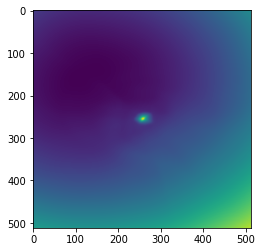

epoch 50001: 49.03166580200195
epoch 50002: 48.741695404052734
epoch 50003: 47.815711975097656
epoch 50004: 48.95282745361328
epoch 50005: 49.830326080322266
epoch 50006: 48.29587173461914
epoch 50007: 48.90306091308594
epoch 50008: 48.8907585144043
epoch 50009: 48.16752624511719
epoch 50011: 48.74050521850586
epoch 50012: 48.84853744506836
epoch 50013: 49.21867370605469
epoch 50014: 48.582801818847656
epoch 50015: 47.88892364501953
epoch 50016: 48.85614013671875
epoch 50017: 48.197025299072266
epoch 50018: 48.90892028808594
epoch 50019: 47.84652328491211
epoch 50021: 47.72135543823242
epoch 50022: 47.98949432373047
epoch 50023: 48.74969482421875
epoch 50024: 48.785396575927734
epoch 50025: 49.005496978759766
epoch 50026: 48.57512664794922
epoch 50027: 48.163795471191406
epoch 50028: 48.33905029296875
epoch 50029: 48.10329818725586
epoch 50031: 48.000457763671875
epoch 50032: 48.44292068481445
epoch 50033: 47.719966888427734
epoch 50034: 47.892635345458984
epoch 50035: 48.9458465576171

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



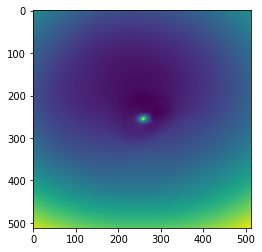

epoch 50101: 47.730316162109375
epoch 50102: 48.58012771606445
epoch 50103: 48.09066390991211
epoch 50104: 48.41695022583008
epoch 50105: 47.88460159301758
epoch 50106: 47.543495178222656
epoch 50107: 47.9560432434082
epoch 50108: 48.42284393310547
epoch 50109: 47.31826400756836
epoch 50111: 48.18402099609375
epoch 50112: 47.88751220703125
epoch 50113: 47.901546478271484
epoch 50114: 47.80246353149414
epoch 50115: 47.8372917175293
epoch 50116: 47.542236328125
epoch 50117: 48.21510314941406
epoch 50118: 48.03933334350586
epoch 50119: 47.95637130737305
epoch 50121: 47.69669723510742
epoch 50122: 48.37730407714844
epoch 50123: 48.41830825805664
epoch 50124: 48.429115295410156
epoch 50125: 47.47290802001953
epoch 50126: 47.6377067565918
epoch 50127: 49.284183502197266
epoch 50128: 48.50154113769531
epoch 50129: 47.687721252441406
epoch 50131: 48.172672271728516
epoch 50132: 48.83931350708008
epoch 50133: 47.2583122253418
epoch 50134: 47.571529388427734
epoch 50135: 48.88267517089844
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



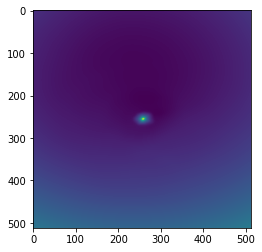

epoch 50201: 47.621482849121094
epoch 50202: 48.5279541015625
epoch 50203: 48.65909194946289
epoch 50204: 47.964111328125
epoch 50205: 48.19670104980469
epoch 50206: 49.24102020263672
epoch 50207: 49.1621208190918
epoch 50208: 48.677146911621094
epoch 50209: 48.003883361816406
epoch 50211: 49.691558837890625
epoch 50212: 48.36690139770508
epoch 50213: 47.82265090942383
epoch 50214: 49.60142517089844
epoch 50215: 47.99462127685547
epoch 50216: 48.32335662841797
epoch 50217: 48.541133880615234
epoch 50218: 47.65290451049805
epoch 50219: 48.504493713378906
epoch 50221: 50.46792221069336
epoch 50222: 47.96622848510742
epoch 50223: 48.39677429199219
epoch 50224: 47.72161102294922
epoch 50225: 48.00936508178711
epoch 50226: 48.46437454223633
epoch 50227: 48.14707565307617
epoch 50228: 47.94535446166992
epoch 50229: 48.2189826965332
epoch 50231: 48.05208206176758
epoch 50232: 48.616966247558594
epoch 50233: 49.83885192871094
epoch 50234: 48.02695846557617
epoch 50235: 48.90859603881836
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



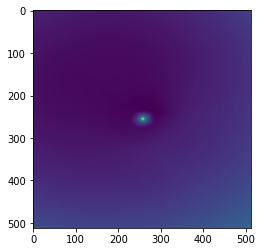

epoch 50301: 49.218021392822266
epoch 50302: 48.52582931518555
epoch 50303: 48.774024963378906
epoch 50304: 49.57279586791992
epoch 50305: 48.01042938232422
epoch 50306: 48.658538818359375
epoch 50307: 47.71004104614258
epoch 50308: 47.83778762817383
epoch 50309: 49.19464111328125
epoch 50311: 49.00484848022461
epoch 50312: 50.142539978027344
epoch 50313: 48.08734893798828
epoch 50314: 47.83131408691406
epoch 50315: 48.278682708740234
epoch 50316: 47.533912658691406
epoch 50317: 48.29732894897461
epoch 50318: 47.69721603393555
epoch 50319: 48.07444381713867
epoch 50321: 47.633052825927734
epoch 50322: 47.901973724365234
epoch 50323: 47.97617721557617
epoch 50324: 47.82099914550781
epoch 50325: 47.873477935791016
epoch 50326: 48.50861740112305
epoch 50327: 48.75262451171875
epoch 50328: 48.5867805480957
epoch 50329: 48.712135314941406
epoch 50331: 47.96469497680664
epoch 50332: 48.37300491333008
epoch 50333: 48.0648078918457
epoch 50334: 48.59101867675781
epoch 50335: 48.009986877441406

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



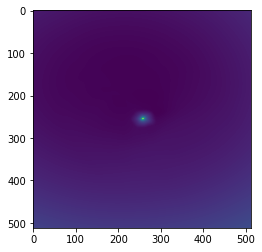

epoch 50401: 48.08793640136719
epoch 50402: 47.87990188598633
epoch 50403: 48.468719482421875
epoch 50404: 51.98760223388672
epoch 50405: 48.72719192504883
epoch 50406: 48.06779861450195
epoch 50407: 48.07859420776367
epoch 50408: 47.77144241333008
epoch 50409: 48.06007766723633
epoch 50411: 47.756797790527344
epoch 50412: 49.092594146728516
epoch 50413: 48.161495208740234
epoch 50414: 48.850563049316406
epoch 50415: 48.399253845214844
epoch 50416: 47.976139068603516
epoch 50417: 48.75327682495117
epoch 50418: 48.49876403808594
epoch 50419: 48.53564453125
epoch 50421: 48.51115417480469
epoch 50422: 48.3175163269043
epoch 50423: 48.52204132080078
epoch 50424: 48.171241760253906
epoch 50425: 48.1387939453125
epoch 50426: 48.991943359375
epoch 50427: 48.02398681640625
epoch 50428: 48.078086853027344
epoch 50429: 48.429012298583984
epoch 50431: 47.273109436035156
epoch 50432: 49.11371612548828
epoch 50433: 47.555240631103516
epoch 50434: 48.60194778442383
epoch 50435: 47.869102478027344
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



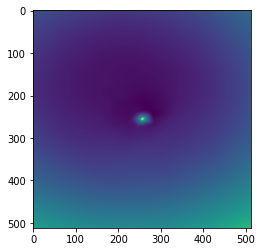

epoch 50501: 47.93929672241211
epoch 50502: 48.357765197753906
epoch 50503: 47.8613166809082
epoch 50504: 47.6556510925293
epoch 50505: 47.07358169555664
epoch 50506: 47.75717544555664
epoch 50507: 48.02208709716797
epoch 50508: 48.14558792114258
epoch 50509: 47.83237838745117
epoch 50511: 47.785675048828125
epoch 50512: 47.55413818359375
epoch 50513: 47.941890716552734
epoch 50514: 49.57761764526367
epoch 50515: 47.827640533447266
epoch 50516: 47.786495208740234
epoch 50517: 48.08778762817383
epoch 50518: 47.46683120727539
epoch 50519: 47.838584899902344
epoch 50521: 48.5333137512207
epoch 50522: 47.59314727783203
epoch 50523: 49.037960052490234
epoch 50524: 48.955833435058594
epoch 50525: 48.64702606201172
epoch 50526: 48.463035583496094
epoch 50527: 48.300132751464844
epoch 50528: 50.53729248046875
epoch 50529: 47.57331466674805
epoch 50531: 48.29627990722656
epoch 50532: 48.16623306274414
epoch 50533: 47.8165168762207
epoch 50534: 47.26613998413086
epoch 50535: 47.55625534057617
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



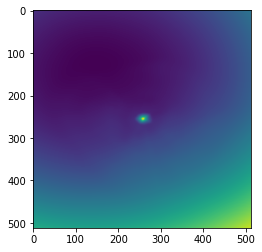

epoch 50601: 47.78302764892578
epoch 50602: 48.302818298339844
epoch 50603: 47.41334533691406
epoch 50604: 49.449867248535156
epoch 50605: 47.96627426147461
epoch 50606: 47.49076843261719
epoch 50607: 48.20682144165039
epoch 50608: 48.186241149902344
epoch 50609: 48.141571044921875
epoch 50611: 47.968040466308594
epoch 50612: 48.32175064086914
epoch 50613: 47.85673522949219
epoch 50614: 47.976016998291016
epoch 50615: 48.55680847167969
epoch 50616: 48.4830322265625
epoch 50617: 48.243324279785156
epoch 50618: 48.5887565612793
epoch 50619: 48.35186767578125
epoch 50621: 47.880558013916016
epoch 50622: 48.12502670288086
epoch 50623: 48.41021728515625
epoch 50624: 48.756927490234375
epoch 50625: 48.434993743896484
epoch 50626: 48.46941375732422
epoch 50627: 47.88876724243164
epoch 50628: 48.84969711303711
epoch 50629: 47.89399337768555
epoch 50631: 48.17827606201172
epoch 50632: 46.565364837646484
epoch 50633: 47.8769416809082
epoch 50634: 48.7030029296875
epoch 50635: 50.256744384765625


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



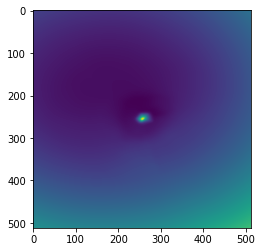

epoch 50701: 47.792388916015625
epoch 50702: 48.58701705932617
epoch 50703: 48.64754867553711
epoch 50704: 48.23673629760742
epoch 50705: 47.39608383178711
epoch 50706: 47.45249557495117
epoch 50707: 48.501461029052734
epoch 50708: 48.152626037597656
epoch 50709: 48.314029693603516
epoch 50711: 47.89267349243164
epoch 50712: 47.95204544067383
epoch 50713: 47.5059700012207
epoch 50714: 47.41660690307617
epoch 50715: 49.038330078125
epoch 50716: 47.89864730834961
epoch 50717: 47.33247375488281
epoch 50718: 48.358726501464844
epoch 50719: 48.85110092163086
epoch 50721: 48.0190544128418
epoch 50722: 48.23695755004883
epoch 50723: 47.92427444458008
epoch 50724: 48.3548583984375
epoch 50725: 49.4398078918457
epoch 50726: 48.51569747924805
epoch 50727: 48.253238677978516
epoch 50728: 48.72992706298828
epoch 50729: 48.09321594238281
epoch 50731: 48.917293548583984
epoch 50732: 48.36850357055664
epoch 50733: 51.475074768066406
epoch 50734: 52.996917724609375
epoch 50735: 48.66498947143555
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



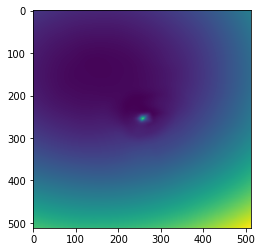

epoch 50801: 47.93488693237305
epoch 50802: 47.71465301513672
epoch 50803: 48.27292251586914
epoch 50804: 48.35186767578125
epoch 50805: 47.695228576660156
epoch 50806: 48.9244384765625
epoch 50807: 48.9005241394043
epoch 50808: 49.61009216308594
epoch 50809: 47.46723937988281
epoch 50811: 47.77766418457031
epoch 50812: 47.741363525390625
epoch 50813: 47.31520080566406
epoch 50814: 48.315181732177734
epoch 50815: 48.255165100097656
epoch 50816: 48.292694091796875
epoch 50817: 48.138248443603516
epoch 50818: 48.210731506347656
epoch 50819: 47.51369857788086
epoch 50821: 47.734107971191406
epoch 50822: 47.10171890258789
epoch 50823: 48.06776809692383
epoch 50824: 48.3138313293457
epoch 50825: 49.29545211791992
epoch 50826: 48.01725387573242
epoch 50827: 47.43740463256836
epoch 50828: 47.86403274536133
epoch 50829: 47.310333251953125
epoch 50831: 49.10964584350586
epoch 50832: 48.01327133178711
epoch 50833: 47.652347564697266
epoch 50834: 48.71915817260742
epoch 50835: 48.03171157836914
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



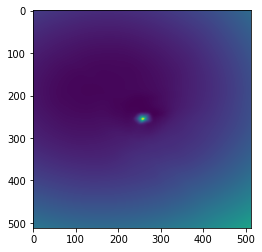

epoch 50901: 48.056243896484375
epoch 50902: 47.176963806152344
epoch 50903: 48.54811096191406
epoch 50904: 49.43561553955078
epoch 50905: 48.14522933959961
epoch 50906: 48.4315299987793
epoch 50907: 49.4393424987793
epoch 50908: 48.57374954223633
epoch 50909: 47.86232376098633
epoch 50911: 49.150299072265625
epoch 50912: 47.85725402832031
epoch 50913: 48.152042388916016
epoch 50914: 48.9039192199707
epoch 50915: 49.67243576049805
epoch 50916: 48.430259704589844
epoch 50917: 48.852508544921875
epoch 50918: 49.09811782836914
epoch 50919: 48.562286376953125
epoch 50921: 48.15282440185547
epoch 50922: 49.38827133178711
epoch 50923: 49.10499954223633
epoch 50924: 49.24857711791992
epoch 50925: 49.07339096069336
epoch 50926: 48.300907135009766
epoch 50927: 48.30698013305664
epoch 50928: 47.811344146728516
epoch 50929: 48.751407623291016
epoch 50931: 48.10272979736328
epoch 50932: 47.32335662841797
epoch 50933: 48.64005661010742
epoch 50934: 48.47852325439453
epoch 50935: 47.97600173950195
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



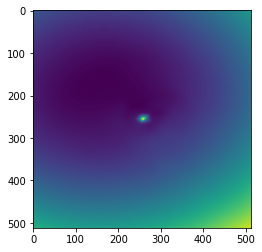

epoch 51001: 48.45179748535156
epoch 51002: 48.409000396728516
epoch 51003: 47.73307800292969
epoch 51004: 48.260772705078125
epoch 51005: 49.06516647338867
epoch 51006: 48.35826110839844
epoch 51007: 47.91511154174805
epoch 51008: 48.574153900146484
epoch 51009: 47.77864074707031
epoch 51011: 47.5426025390625
epoch 51012: 48.00400161743164
epoch 51013: 53.335968017578125
epoch 51014: 48.425086975097656
epoch 51015: 48.577613830566406
epoch 51016: 48.98992156982422
epoch 51017: 48.790687561035156
epoch 51018: 48.09622573852539
epoch 51019: 49.13862991333008
epoch 51021: 48.38421630859375
epoch 51022: 47.85776138305664
epoch 51023: 47.97235870361328
epoch 51024: 48.3725471496582
epoch 51025: 49.22175979614258
epoch 51026: 48.38396453857422
epoch 51027: 49.07426834106445
epoch 51028: 47.55393981933594
epoch 51029: 48.519508361816406
epoch 51031: 48.43990707397461
epoch 51032: 48.187225341796875
epoch 51033: 47.2313346862793
epoch 51034: 48.07889938354492
epoch 51035: 47.34869384765625
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



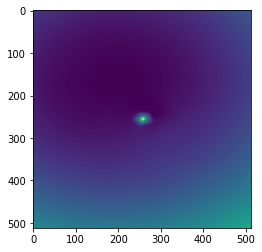

epoch 51101: 48.64464569091797
epoch 51102: 48.12422561645508
epoch 51103: 48.61173629760742
epoch 51104: 48.309486389160156
epoch 51105: 48.655696868896484
epoch 51106: 47.638084411621094
epoch 51107: 47.57394027709961
epoch 51108: 48.154972076416016
epoch 51109: 48.051883697509766
epoch 51111: 47.76506805419922
epoch 51112: 48.43484878540039
epoch 51113: 47.56992721557617
epoch 51114: 48.04775619506836
epoch 51115: 48.6888313293457
epoch 51116: 47.950199127197266
epoch 51117: 48.12111282348633
epoch 51118: 47.743812561035156
epoch 51119: 48.300209045410156
epoch 51121: 47.80106735229492
epoch 51122: 47.78716278076172
epoch 51123: 47.15685272216797
epoch 51124: 47.99091720581055
epoch 51125: 47.72394561767578
epoch 51126: 48.94011688232422
epoch 51127: 49.12176513671875
epoch 51128: 47.861907958984375
epoch 51129: 48.64291763305664
epoch 51131: 48.137447357177734
epoch 51132: 48.67499542236328
epoch 51133: 48.13399887084961
epoch 51134: 48.23637771606445
epoch 51135: 49.69908905029297

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



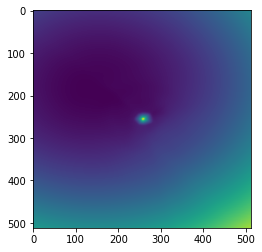

epoch 51201: 48.43265151977539
epoch 51202: 47.59534454345703
epoch 51203: 48.84856414794922
epoch 51204: 47.9980354309082
epoch 51205: 47.690555572509766
epoch 51206: 47.81935119628906
epoch 51207: 49.165199279785156
epoch 51208: 47.27381134033203
epoch 51209: 47.54951477050781
epoch 51211: 47.20762252807617
epoch 51212: 48.46818923950195
epoch 51213: 48.40755081176758
epoch 51214: 47.564613342285156
epoch 51215: 48.01074981689453
epoch 51216: 48.85032653808594
epoch 51217: 47.80071258544922
epoch 51218: 47.153038024902344
epoch 51219: 47.15975570678711
epoch 51221: 47.48823928833008
epoch 51222: 48.19342803955078
epoch 51223: 47.95026397705078
epoch 51224: 49.17341613769531
epoch 51225: 47.422691345214844
epoch 51226: 47.49081039428711
epoch 51227: 47.78278350830078
epoch 51228: 48.06513214111328
epoch 51229: 48.36875534057617
epoch 51231: 48.258766174316406
epoch 51232: 47.475162506103516
epoch 51233: 47.944915771484375
epoch 51234: 47.67573165893555
epoch 51235: 48.0046272277832
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



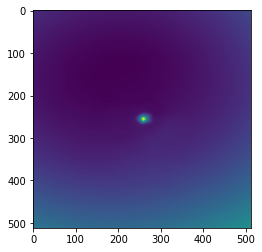

epoch 51301: 49.08228302001953
epoch 51302: 47.776817321777344
epoch 51303: 48.693756103515625
epoch 51304: 48.216712951660156
epoch 51305: 48.742103576660156
epoch 51306: 48.814537048339844
epoch 51307: 48.227455139160156
epoch 51308: 52.440067291259766
epoch 51309: 47.77464294433594
epoch 51311: 48.963104248046875
epoch 51312: 47.97476577758789
epoch 51313: 47.954856872558594
epoch 51314: 48.79678726196289
epoch 51315: 48.56096649169922
epoch 51316: 47.15195083618164
epoch 51317: 48.304603576660156
epoch 51318: 47.7033805847168
epoch 51319: 47.94925308227539
epoch 51321: 48.36286544799805
epoch 51322: 48.02626037597656
epoch 51323: 48.66014099121094
epoch 51324: 47.58613586425781
epoch 51325: 48.3061408996582
epoch 51326: 47.5195426940918
epoch 51327: 47.60503005981445
epoch 51328: 47.66319274902344
epoch 51329: 48.14588928222656
epoch 51331: 47.70704650878906
epoch 51332: 48.735286712646484
epoch 51333: 47.31216812133789
epoch 51334: 48.21229553222656
epoch 51335: 47.70160675048828


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



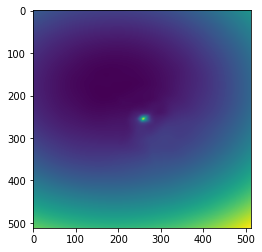

epoch 51401: 47.48930358886719
epoch 51402: 47.590476989746094
epoch 51403: 47.77632522583008
epoch 51404: 48.70717239379883
epoch 51405: 47.809165954589844
epoch 51406: 48.05823516845703
epoch 51407: 47.83354949951172
epoch 51408: 47.817481994628906
epoch 51409: 48.48556900024414
epoch 51411: 48.5263786315918
epoch 51412: 48.08990478515625
epoch 51413: 48.32818603515625
epoch 51414: 48.089839935302734
epoch 51415: 47.629215240478516
epoch 51416: 47.86217498779297
epoch 51417: 48.16135787963867
epoch 51418: 47.33484649658203
epoch 51419: 47.9970703125
epoch 51421: 47.38239288330078
epoch 51422: 47.78242874145508
epoch 51423: 48.20848846435547
epoch 51424: 48.615970611572266
epoch 51425: 49.70781707763672
epoch 51426: 48.03440856933594
epoch 51427: 48.43910598754883
epoch 51428: 47.893733978271484
epoch 51429: 48.1001091003418
epoch 51431: 49.144805908203125
epoch 51432: 47.971824645996094
epoch 51433: 48.06066131591797
epoch 51434: 48.24092483520508
epoch 51435: 48.077301025390625
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



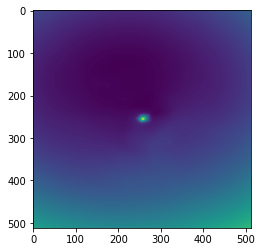

epoch 51501: 49.2138557434082
epoch 51502: 48.53910827636719
epoch 51503: 48.16014099121094
epoch 51504: 48.106876373291016
epoch 51505: 47.79376220703125
epoch 51506: 47.66775894165039
epoch 51507: 49.48080062866211
epoch 51508: 48.083717346191406
epoch 51509: 47.391937255859375
epoch 51511: 49.34404373168945
epoch 51512: 48.32423400878906
epoch 51513: 47.349674224853516
epoch 51514: 48.17974853515625
epoch 51515: 48.47842025756836
epoch 51516: 48.67823028564453
epoch 51517: 47.731727600097656
epoch 51518: 47.58848190307617
epoch 51519: 48.0281867980957
epoch 51521: 48.559627532958984
epoch 51522: 48.76329803466797
epoch 51523: 48.50372314453125
epoch 51524: 47.73535919189453
epoch 51525: 48.223167419433594
epoch 51526: 47.96168518066406
epoch 51527: 47.21406555175781
epoch 51528: 48.09346389770508
epoch 51529: 50.23759460449219
epoch 51531: 47.69208908081055
epoch 51532: 52.100494384765625
epoch 51533: 48.37453842163086
epoch 51534: 47.635257720947266
epoch 51535: 48.03472900390625
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



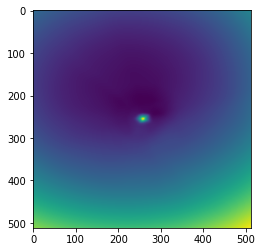

epoch 51601: 48.345176696777344
epoch 51602: 49.30805969238281
epoch 51603: 48.27946472167969
epoch 51604: 48.39182662963867
epoch 51605: 48.23152160644531
epoch 51606: 47.683868408203125
epoch 51607: 49.27679443359375
epoch 51608: 47.77074432373047
epoch 51609: 48.750186920166016
epoch 51611: 48.136680603027344
epoch 51612: 48.0572624206543
epoch 51613: 48.20791244506836
epoch 51614: 49.192138671875
epoch 51615: 49.04158401489258
epoch 51616: 49.0146369934082
epoch 51617: 48.481788635253906
epoch 51618: 48.00959014892578
epoch 51619: 48.18110656738281
epoch 51621: 49.67097854614258
epoch 51622: 49.33817672729492
epoch 51623: 48.55126953125
epoch 51624: 47.91615295410156
epoch 51625: 48.7900276184082
epoch 51626: 48.939842224121094
epoch 51627: 48.38313293457031
epoch 51628: 48.22435760498047
epoch 51629: 49.64316177368164
epoch 51631: 48.22390365600586
epoch 51632: 48.43510437011719
epoch 51633: 47.82609176635742
epoch 51634: 48.61830139160156
epoch 51635: 47.64091873168945
epoch 5163

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



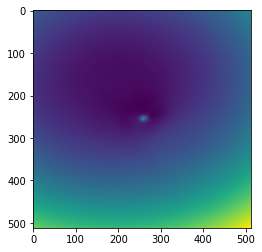

epoch 51701: 48.10675811767578
epoch 51702: 48.391326904296875
epoch 51703: 47.95383834838867
epoch 51704: 47.873199462890625
epoch 51705: 48.76529312133789
epoch 51706: 48.102500915527344
epoch 51707: 49.06538391113281
epoch 51708: 48.68438720703125
epoch 51709: 47.339500427246094
epoch 51711: 48.2049560546875
epoch 51712: 48.1533088684082
epoch 51713: 48.714481353759766
epoch 51714: 49.33163070678711
epoch 51715: 47.76863098144531
epoch 51716: 48.281700134277344
epoch 51717: 48.35554885864258
epoch 51718: 48.100685119628906
epoch 51719: 48.2965202331543
epoch 51721: 48.6829719543457
epoch 51722: 47.18199157714844
epoch 51723: 48.08638381958008
epoch 51724: 47.90774917602539
epoch 51725: 47.832191467285156
epoch 51726: 51.706275939941406
epoch 51727: 48.292503356933594
epoch 51728: 47.79055404663086
epoch 51729: 48.6582145690918
epoch 51731: 48.237213134765625
epoch 51732: 48.19936752319336
epoch 51733: 47.18947219848633
epoch 51734: 47.54045867919922
epoch 51735: 48.1758918762207
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



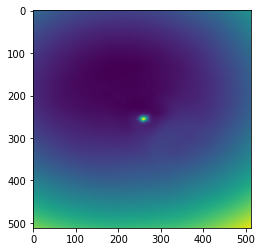

epoch 51801: 47.35399627685547
epoch 51802: 48.152587890625
epoch 51803: 48.1536750793457
epoch 51804: 47.77541732788086
epoch 51805: 48.04399490356445
epoch 51806: 47.756839752197266
epoch 51807: 48.3145751953125
epoch 51808: 48.3877067565918
epoch 51809: 47.86458206176758
epoch 51811: 48.66758346557617
epoch 51812: 48.45812225341797
epoch 51813: 47.90855026245117
epoch 51814: 48.189247131347656
epoch 51815: 47.68743133544922
epoch 51816: 49.31720733642578
epoch 51817: 48.31837463378906
epoch 51818: 48.721580505371094
epoch 51819: 47.892822265625
epoch 51821: 48.39507293701172
epoch 51822: 47.82960891723633
epoch 51823: 48.54741668701172
epoch 51824: 48.217647552490234
epoch 51825: 50.78670883178711
epoch 51826: 48.55098342895508
epoch 51827: 48.48839569091797
epoch 51828: 47.85132598876953
epoch 51829: 48.81011962890625
epoch 51831: 47.96538543701172
epoch 51832: 47.39101791381836
epoch 51833: 48.77292251586914
epoch 51834: 47.733787536621094
epoch 51835: 47.82968521118164
epoch 5183

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



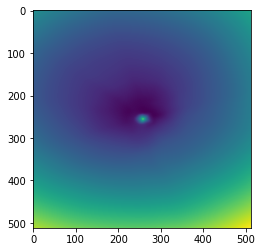

epoch 51901: 49.42063522338867
epoch 51902: 48.62629318237305
epoch 51903: 47.734378814697266
epoch 51904: 47.94390869140625
epoch 51905: 47.64277267456055
epoch 51906: 48.81423568725586
epoch 51907: 48.656246185302734
epoch 51908: 48.970699310302734
epoch 51909: 48.75172805786133
epoch 51911: 47.70949172973633
epoch 51912: 47.94463348388672
epoch 51913: 47.676509857177734
epoch 51914: 48.57844543457031
epoch 51915: 48.442298889160156
epoch 51916: 48.69010925292969
epoch 51917: 48.37303924560547
epoch 51918: 48.332637786865234
epoch 51919: 48.57793045043945
epoch 51921: 47.71684646606445
epoch 51922: 47.98291778564453
epoch 51923: 48.31760025024414
epoch 51924: 48.03483200073242
epoch 51925: 48.998680114746094
epoch 51926: 48.165557861328125
epoch 51927: 48.097076416015625
epoch 51928: 47.2374153137207
epoch 51929: 46.88761901855469
epoch 51931: 47.858619689941406
epoch 51932: 47.913570404052734
epoch 51933: 48.214290618896484
epoch 51934: 48.63024139404297
epoch 51935: 47.609325408935

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



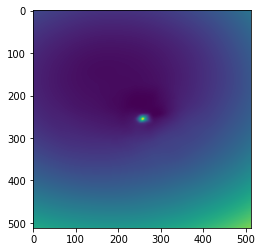

epoch 52001: 47.74064636230469
epoch 52002: 48.50132369995117
epoch 52003: 48.32332992553711
epoch 52004: 47.551002502441406
epoch 52005: 48.61176300048828
epoch 52006: 48.18391418457031
epoch 52007: 48.43971633911133
epoch 52008: 47.721038818359375
epoch 52009: 48.799739837646484
epoch 52011: 48.38730239868164
epoch 52012: 47.788169860839844
epoch 52013: 48.03801345825195
epoch 52014: 47.52211380004883
epoch 52015: 47.66192626953125
epoch 52016: 48.519168853759766
epoch 52017: 47.952152252197266
epoch 52018: 47.94243240356445
epoch 52019: 48.26524353027344
epoch 52021: 47.51435470581055
epoch 52022: 48.55005645751953
epoch 52023: 47.98101806640625
epoch 52024: 48.21483612060547
epoch 52025: 47.88642120361328
epoch 52026: 48.4429931640625
epoch 52027: 47.553653717041016
epoch 52028: 47.05503463745117
epoch 52029: 47.71857833862305
epoch 52031: 48.49406814575195
epoch 52032: 48.161537170410156
epoch 52033: 48.66288757324219
epoch 52034: 48.0743522644043
epoch 52035: 47.80338668823242
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



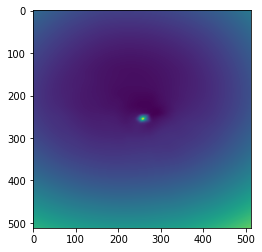

epoch 52101: 47.92270278930664
epoch 52102: 47.90155029296875
epoch 52103: 49.75025939941406
epoch 52104: 48.69904327392578
epoch 52105: 48.8371467590332
epoch 52106: 48.089027404785156
epoch 52107: 47.981388092041016
epoch 52108: 48.26153564453125
epoch 52109: 48.470001220703125
epoch 52111: 47.712371826171875
epoch 52112: 47.622276306152344
epoch 52113: 47.82826614379883
epoch 52114: 47.47226333618164
epoch 52115: 50.94252014160156
epoch 52116: 48.683807373046875
epoch 52117: 48.97095489501953
epoch 52118: 48.43617248535156
epoch 52119: 48.10377502441406
epoch 52121: 47.835357666015625
epoch 52122: 47.65215301513672
epoch 52123: 47.54971694946289
epoch 52124: 47.81145477294922
epoch 52125: 47.43285369873047
epoch 52126: 48.96495056152344
epoch 52127: 48.27499008178711
epoch 52128: 47.4444580078125
epoch 52129: 48.20039749145508
epoch 52131: 48.2728271484375
epoch 52132: 47.531314849853516
epoch 52133: 48.33112716674805
epoch 52134: 48.217674255371094
epoch 52135: 48.284427642822266
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



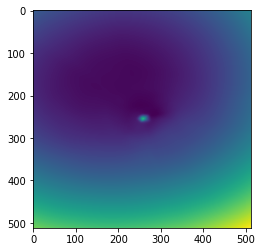

epoch 52201: 47.799339294433594
epoch 52202: 49.1687126159668
epoch 52203: 47.86540985107422
epoch 52204: 49.353668212890625
epoch 52205: 47.93362808227539
epoch 52206: 48.36080551147461
epoch 52207: 50.00197219848633
epoch 52208: 48.29448699951172
epoch 52209: 48.302764892578125
epoch 52211: 48.15494918823242
epoch 52212: 48.05412673950195
epoch 52213: 48.90521240234375
epoch 52214: 48.19327163696289
epoch 52215: 47.972450256347656
epoch 52216: 48.433650970458984
epoch 52217: 49.005313873291016
epoch 52218: 48.3791618347168
epoch 52219: 48.55341339111328
epoch 52221: 48.73480987548828
epoch 52222: 47.98667907714844
epoch 52223: 48.149559020996094
epoch 52224: 47.90687942504883
epoch 52225: 49.21607971191406
epoch 52226: 48.827083587646484
epoch 52227: 48.49630355834961
epoch 52228: 48.40548324584961
epoch 52229: 48.7710075378418
epoch 52231: 48.24464797973633
epoch 52232: 49.224761962890625
epoch 52233: 48.49802017211914
epoch 52234: 47.73817825317383
epoch 52235: 48.085411071777344
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



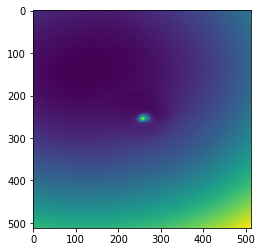

epoch 52301: 47.96102523803711
epoch 52302: 48.788429260253906
epoch 52303: 49.131752014160156
epoch 52304: 48.3769645690918
epoch 52305: 49.203147888183594
epoch 52306: 49.84770202636719
epoch 52307: 47.865478515625
epoch 52308: 48.1430549621582
epoch 52309: 47.79241180419922
epoch 52311: 48.262168884277344
epoch 52312: 49.570533752441406
epoch 52313: 49.64232635498047
epoch 52314: 47.44511795043945
epoch 52315: 48.20069122314453
epoch 52316: 48.61610794067383
epoch 52317: 48.67473220825195
epoch 52318: 48.33136749267578
epoch 52319: 48.3486442565918
epoch 52321: 49.30436706542969
epoch 52322: 48.80769729614258
epoch 52323: 49.067073822021484
epoch 52324: 48.37575912475586
epoch 52325: 49.18475341796875
epoch 52326: 47.511070251464844
epoch 52327: 48.249324798583984
epoch 52328: 48.81404113769531
epoch 52329: 47.6466064453125
epoch 52331: 47.877342224121094
epoch 52332: 47.95693588256836
epoch 52333: 48.474037170410156
epoch 52334: 49.376461029052734
epoch 52335: 48.31096267700195
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



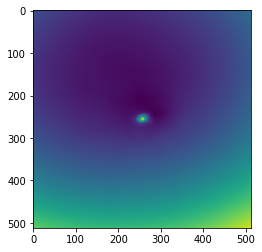

epoch 52401: 52.260562896728516
epoch 52402: 48.85673141479492
epoch 52403: 49.05828094482422
epoch 52404: 48.62550735473633
epoch 52405: 48.23331832885742
epoch 52406: 48.506141662597656
epoch 52407: 49.019046783447266
epoch 52408: 48.281490325927734
epoch 52409: 47.257686614990234
epoch 52411: 48.65933609008789
epoch 52412: 48.680328369140625
epoch 52413: 48.55136489868164
epoch 52414: 48.7331657409668
epoch 52415: 48.46445846557617
epoch 52416: 48.734275817871094
epoch 52417: 47.79317092895508
epoch 52418: 48.518463134765625
epoch 52419: 48.626861572265625
epoch 52421: 49.13913345336914
epoch 52422: 48.30561828613281
epoch 52423: 47.835601806640625
epoch 52424: 48.2404899597168
epoch 52425: 49.52592468261719
epoch 52426: 48.733890533447266
epoch 52427: 47.791908264160156
epoch 52428: 47.98912048339844
epoch 52429: 47.761756896972656
epoch 52431: 49.31037902832031
epoch 52432: 47.69523620605469
epoch 52433: 48.08835220336914
epoch 52434: 48.49345397949219
epoch 52435: 48.584091186523

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



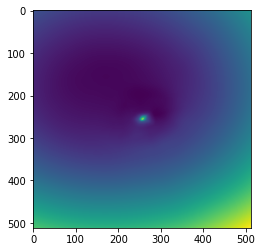

epoch 52501: 48.343528747558594
epoch 52502: 48.31730651855469
epoch 52503: 49.06853485107422
epoch 52504: 47.73799514770508
epoch 52505: 47.85624313354492
epoch 52506: 48.10636901855469
epoch 52507: 49.20965576171875
epoch 52508: 48.42357635498047
epoch 52509: 47.65978240966797
epoch 52511: 47.80338668823242
epoch 52512: 48.74630355834961
epoch 52513: 47.644020080566406
epoch 52514: 48.5461311340332
epoch 52515: 48.27345275878906
epoch 52516: 49.1042594909668
epoch 52517: 48.320465087890625
epoch 52518: 48.27881622314453
epoch 52519: 47.89931869506836
epoch 52521: 48.190372467041016
epoch 52522: 48.470542907714844
epoch 52523: 47.628868103027344
epoch 52524: 49.59342575073242
epoch 52525: 48.865631103515625
epoch 52526: 48.65118408203125
epoch 52527: 49.322998046875
epoch 52528: 48.10414505004883
epoch 52529: 48.691253662109375
epoch 52531: 48.69776153564453
epoch 52532: 48.00229263305664
epoch 52533: 48.70272445678711
epoch 52534: 48.22809600830078
epoch 52535: 48.93378448486328
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



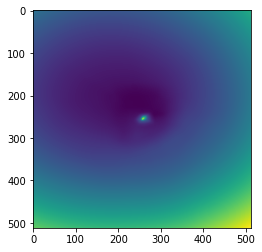

epoch 52601: 48.03449249267578
epoch 52602: 48.23406982421875
epoch 52603: 48.331417083740234
epoch 52604: 48.70082473754883
epoch 52605: 48.482810974121094
epoch 52606: 47.889427185058594
epoch 52607: 48.50615310668945
epoch 52608: 47.93328094482422
epoch 52609: 47.690757751464844
epoch 52611: 49.04736328125
epoch 52612: 47.824012756347656
epoch 52613: 48.14716720581055
epoch 52614: 48.80195617675781
epoch 52615: 48.17137908935547
epoch 52616: 47.87150573730469
epoch 52617: 47.66619110107422
epoch 52618: 48.366878509521484
epoch 52619: 47.53688049316406
epoch 52621: 48.247474670410156
epoch 52622: 47.19842529296875
epoch 52623: 48.19563293457031
epoch 52624: 48.17985534667969
epoch 52625: 48.97606658935547
epoch 52626: 47.37923812866211
epoch 52627: 47.99007797241211
epoch 52628: 48.961021423339844
epoch 52629: 48.59303665161133
epoch 52631: 48.14933395385742
epoch 52632: 47.45603942871094
epoch 52633: 48.40658187866211
epoch 52634: 48.68621063232422
epoch 52635: 47.528587341308594
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



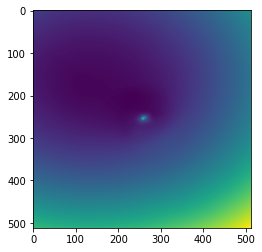

epoch 52701: 47.70569610595703
epoch 52702: 48.359588623046875
epoch 52703: 48.380882263183594
epoch 52704: 47.980690002441406
epoch 52705: 48.92347717285156
epoch 52706: 47.89607238769531
epoch 52707: 47.57933044433594
epoch 52708: 47.60704040527344
epoch 52709: 47.904380798339844
epoch 52711: 47.252418518066406
epoch 52712: 54.76761245727539
epoch 52713: 48.00774383544922
epoch 52714: 47.382564544677734
epoch 52715: 48.07231140136719
epoch 52716: 48.68621826171875
epoch 52717: 47.67455291748047
epoch 52718: 47.79756164550781
epoch 52719: 47.634456634521484
epoch 52721: 47.72784423828125
epoch 52722: 48.232391357421875
epoch 52723: 48.02881622314453
epoch 52724: 48.1634407043457
epoch 52725: 48.184326171875
epoch 52726: 47.143951416015625
epoch 52727: 48.56529998779297
epoch 52728: 48.03341293334961
epoch 52729: 53.30101013183594
epoch 52731: 48.33900833129883
epoch 52732: 48.99019241333008
epoch 52733: 47.99283981323242
epoch 52734: 47.982643127441406
epoch 52735: 47.91964340209961
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



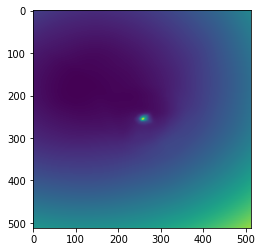

epoch 52801: 48.55015182495117
epoch 52802: 47.37801742553711
epoch 52803: 47.2827262878418
epoch 52804: 49.39804458618164
epoch 52805: 47.56707000732422
epoch 52806: 48.012237548828125
epoch 52807: 48.56475067138672
epoch 52808: 47.64685821533203
epoch 52809: 47.771427154541016
epoch 52811: 48.52029800415039
epoch 52812: 47.95338439941406
epoch 52813: 48.15445327758789
epoch 52814: 48.26701354980469
epoch 52815: 48.30747604370117
epoch 52816: 48.12651443481445
epoch 52817: 47.966270446777344
epoch 52818: 48.27906036376953
epoch 52819: 48.285972595214844
epoch 52821: 48.261714935302734
epoch 52822: 47.912803649902344
epoch 52823: 47.29530334472656
epoch 52824: 47.41179656982422
epoch 52825: 48.68423843383789
epoch 52826: 47.68467712402344
epoch 52827: 48.200538635253906
epoch 52828: 48.302852630615234
epoch 52829: 48.04633331298828
epoch 52831: 49.058807373046875
epoch 52832: 48.49193572998047
epoch 52833: 48.31181335449219
epoch 52834: 48.74396514892578
epoch 52835: 50.11722946166992


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



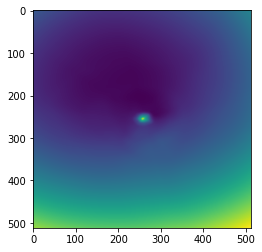

epoch 52901: 48.174739837646484
epoch 52902: 48.08768844604492
epoch 52903: 48.364131927490234
epoch 52904: 48.51401138305664
epoch 52905: 47.925392150878906
epoch 52906: 48.34468078613281
epoch 52907: 48.20662307739258
epoch 52908: 48.016212463378906
epoch 52909: 48.11343002319336
epoch 52911: 47.635108947753906
epoch 52912: 47.88773727416992
epoch 52913: 47.2443733215332
epoch 52914: 49.39743423461914
epoch 52915: 47.5551643371582
epoch 52916: 48.30995559692383
epoch 52917: 47.81961441040039
epoch 52918: 49.540775299072266
epoch 52919: 47.222835540771484
epoch 52921: 48.20323944091797
epoch 52922: 48.86602020263672
epoch 52923: 48.321258544921875
epoch 52924: 48.15673828125
epoch 52925: 47.76386642456055
epoch 52926: 48.41162109375
epoch 52927: 48.64625930786133
epoch 52928: 50.58956527709961
epoch 52929: 48.00437545776367
epoch 52931: 48.25748062133789
epoch 52932: 48.4864501953125
epoch 52933: 47.755462646484375
epoch 52934: 49.399715423583984
epoch 52935: 47.84029006958008
epoch 5

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



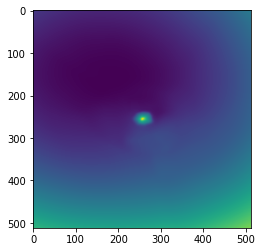

epoch 53001: 48.500118255615234
epoch 53002: 48.156089782714844
epoch 53003: 47.479347229003906
epoch 53004: 48.713356018066406
epoch 53005: 47.76675796508789
epoch 53006: 47.96425247192383
epoch 53007: 47.64724349975586
epoch 53008: 48.737701416015625
epoch 53009: 48.70964050292969
epoch 53011: 48.15332794189453
epoch 53012: 49.420406341552734
epoch 53013: 47.98917770385742
epoch 53014: 48.326927185058594
epoch 53015: 48.103675842285156
epoch 53016: 48.350982666015625
epoch 53017: 48.000389099121094
epoch 53018: 47.735137939453125
epoch 53019: 48.11201095581055
epoch 53021: 48.4382438659668
epoch 53022: 47.29938888549805
epoch 53023: 48.04401397705078
epoch 53024: 49.19715118408203
epoch 53025: 47.894771575927734
epoch 53026: 47.83467483520508
epoch 53027: 48.618675231933594
epoch 53028: 48.20526885986328
epoch 53029: 48.18317413330078
epoch 53031: 48.223960876464844
epoch 53032: 49.516441345214844
epoch 53033: 48.29530334472656
epoch 53034: 47.56580352783203
epoch 53035: 48.400749206

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



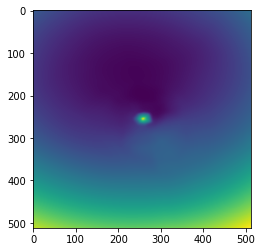

epoch 53101: 48.524959564208984
epoch 53102: 48.02754592895508
epoch 53103: 48.05548858642578
epoch 53104: 47.932891845703125
epoch 53105: 48.27751541137695
epoch 53106: 47.65670394897461
epoch 53107: 47.97465515136719
epoch 53108: 48.30978012084961
epoch 53109: 48.503700256347656
epoch 53111: 47.623451232910156
epoch 53112: 48.89864730834961
epoch 53113: 47.42415237426758
epoch 53114: 47.905643463134766
epoch 53115: 46.854488372802734
epoch 53116: 47.5192756652832
epoch 53117: 48.177490234375
epoch 53118: 49.21664047241211
epoch 53119: 48.32004165649414
epoch 53121: 48.463130950927734
epoch 53122: 51.132789611816406
epoch 53123: 48.67166519165039
epoch 53124: 48.766151428222656
epoch 53125: 48.328582763671875
epoch 53126: 47.273746490478516
epoch 53127: 48.000511169433594
epoch 53128: 47.502925872802734
epoch 53129: 47.888912200927734
epoch 53131: 47.950931549072266
epoch 53132: 47.24733352661133
epoch 53133: 49.286956787109375
epoch 53134: 47.726417541503906
epoch 53135: 47.417247772

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



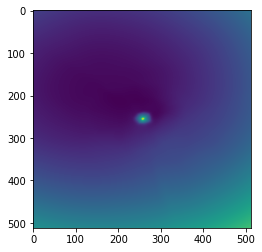

epoch 53201: 48.25175476074219
epoch 53202: 47.58726501464844
epoch 53203: 47.883018493652344
epoch 53204: 48.190345764160156
epoch 53205: 47.491512298583984
epoch 53206: 47.83677291870117
epoch 53207: 48.475589752197266
epoch 53208: 47.81346893310547
epoch 53209: 47.937984466552734
epoch 53211: 48.157840728759766
epoch 53212: 49.0629997253418
epoch 53213: 47.56983947753906
epoch 53214: 48.22847366333008
epoch 53215: 48.75802230834961
epoch 53216: 47.69364929199219
epoch 53217: 47.69550704956055
epoch 53218: 47.40859603881836
epoch 53219: 47.73240280151367
epoch 53221: 47.98884582519531
epoch 53222: 48.062744140625
epoch 53223: 48.439353942871094
epoch 53224: 48.75796127319336
epoch 53225: 47.306358337402344
epoch 53226: 47.6807746887207
epoch 53227: 48.607967376708984
epoch 53228: 48.01665496826172
epoch 53229: 47.89173889160156
epoch 53231: 48.16725158691406
epoch 53232: 48.40760803222656
epoch 53233: 47.745487213134766
epoch 53234: 48.77411651611328
epoch 53235: 48.618648529052734
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



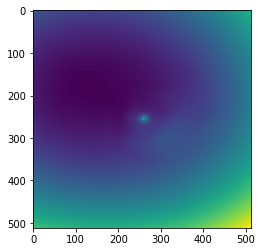

epoch 53301: 48.85969543457031
epoch 53302: 48.497032165527344
epoch 53303: 48.20153045654297
epoch 53304: 48.01797866821289
epoch 53305: 47.691566467285156
epoch 53306: 46.908870697021484
epoch 53307: 48.720115661621094
epoch 53308: 48.367923736572266
epoch 53309: 48.1219596862793
epoch 53311: 47.07636260986328
epoch 53312: 48.116249084472656
epoch 53313: 48.56508255004883
epoch 53314: 47.859039306640625
epoch 53315: 48.25978469848633
epoch 53316: 47.535606384277344
epoch 53317: 48.399192810058594
epoch 53318: 47.65206527709961
epoch 53319: 47.96396255493164
epoch 53321: 47.84715270996094
epoch 53322: 48.18980026245117
epoch 53323: 47.73301315307617
epoch 53324: 47.96790313720703
epoch 53325: 47.92961883544922
epoch 53326: 48.517730712890625
epoch 53327: 56.87569808959961
epoch 53328: 47.26786422729492
epoch 53329: 49.10316467285156
epoch 53331: 47.675045013427734
epoch 53332: 48.67415237426758
epoch 53333: 48.28156661987305
epoch 53334: 49.488224029541016
epoch 53335: 48.369991302490

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



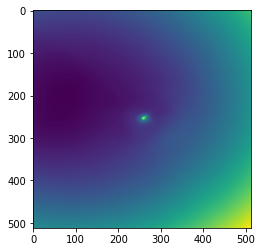

epoch 53401: 48.96773910522461
epoch 53402: 47.7465705871582
epoch 53403: 48.27421951293945
epoch 53404: 47.197330474853516
epoch 53405: 48.877281188964844
epoch 53406: 48.32780838012695
epoch 53407: 47.843807220458984
epoch 53408: 48.273555755615234
epoch 53409: 47.439186096191406
epoch 53411: 47.89255142211914
epoch 53412: 48.43241500854492
epoch 53413: 47.7949104309082
epoch 53414: 47.33560562133789
epoch 53415: 48.383888244628906
epoch 53416: 49.170654296875
epoch 53417: 47.96754455566406
epoch 53418: 48.15766143798828
epoch 53419: 47.681583404541016
epoch 53421: 47.9732666015625
epoch 53422: 48.63814926147461
epoch 53423: 48.843387603759766
epoch 53424: 47.64884948730469
epoch 53425: 48.192440032958984
epoch 53426: 48.43829345703125
epoch 53427: 47.85054397583008
epoch 53428: 48.748138427734375
epoch 53429: 47.73074722290039
epoch 53431: 49.263153076171875
epoch 53432: 47.51213073730469
epoch 53433: 48.627418518066406
epoch 53434: 47.634422302246094
epoch 53435: 48.4673957824707
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



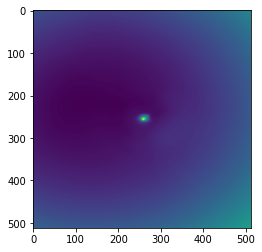

epoch 53501: 47.68695831298828
epoch 53502: 47.458858489990234
epoch 53503: 48.308937072753906
epoch 53504: 48.71786880493164
epoch 53505: 48.569602966308594
epoch 53506: 47.50104904174805
epoch 53507: 48.4079704284668
epoch 53508: 47.76246643066406
epoch 53509: 47.97451400756836
epoch 53511: 47.42542266845703
epoch 53512: 47.72960662841797
epoch 53513: 48.10597610473633
epoch 53514: 48.38389587402344
epoch 53515: 48.65692138671875
epoch 53516: 48.33800506591797
epoch 53517: 48.65643310546875
epoch 53518: 48.554046630859375
epoch 53519: 48.550350189208984
epoch 53521: 48.37179183959961
epoch 53522: 48.39030075073242
epoch 53523: 48.31418991088867
epoch 53524: 48.61322784423828
epoch 53525: 47.801795959472656
epoch 53526: 47.79075241088867
epoch 53527: 47.560455322265625
epoch 53528: 47.45988845825195
epoch 53529: 48.40525436401367
epoch 53531: 48.91550064086914
epoch 53532: 48.0659065246582
epoch 53533: 48.089874267578125
epoch 53534: 48.422332763671875
epoch 53535: 47.985252380371094


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



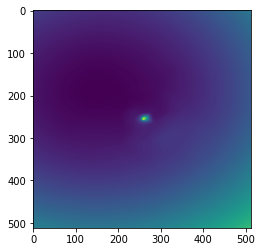

epoch 53601: 47.32084274291992
epoch 53602: 49.11078643798828
epoch 53603: 48.031803131103516
epoch 53604: 47.811851501464844
epoch 53605: 47.84461212158203
epoch 53606: 47.7188835144043
epoch 53607: 47.88026809692383
epoch 53608: 47.55829620361328
epoch 53609: 47.35149383544922
epoch 53611: 49.072166442871094
epoch 53612: 47.518795013427734
epoch 53613: 48.50590515136719
epoch 53614: 47.457603454589844
epoch 53615: 48.666236877441406
epoch 53616: 47.73866271972656
epoch 53617: 48.405067443847656
epoch 53618: 48.955116271972656
epoch 53619: 47.70171356201172
epoch 53621: 48.144744873046875
epoch 53622: 47.453468322753906
epoch 53623: 48.61453628540039
epoch 53624: 48.517391204833984
epoch 53625: 47.79550552368164
epoch 53626: 48.101112365722656
epoch 53627: 48.44343948364258
epoch 53628: 48.27792739868164
epoch 53629: 49.06608200073242
epoch 53631: 48.8783073425293
epoch 53632: 47.58903121948242
epoch 53633: 48.35252380371094
epoch 53634: 47.30657958984375
epoch 53635: 49.27587890625
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



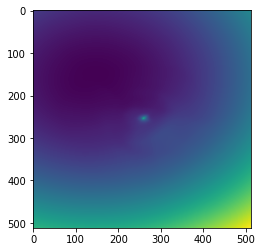

epoch 53701: 48.002689361572266
epoch 53702: 47.8138542175293
epoch 53703: 48.15773391723633
epoch 53704: 47.98772430419922
epoch 53705: 47.561607360839844
epoch 53706: 48.68509292602539
epoch 53707: 47.71639633178711
epoch 53708: 47.825958251953125
epoch 53709: 48.293983459472656
epoch 53711: 47.54183578491211
epoch 53712: 48.01971435546875
epoch 53713: 48.042213439941406
epoch 53714: 48.13629913330078
epoch 53715: 47.99921417236328
epoch 53716: 47.47377395629883
epoch 53717: 48.06083679199219
epoch 53718: 48.38748550415039
epoch 53719: 47.38939666748047
epoch 53721: 47.60768127441406
epoch 53722: 47.72239685058594
epoch 53723: 48.5614128112793
epoch 53724: 48.51725769042969
epoch 53725: 48.770626068115234
epoch 53726: 47.614830017089844
epoch 53727: 48.41050338745117
epoch 53728: 48.46350860595703
epoch 53729: 48.74482345581055
epoch 53731: 49.23637390136719
epoch 53732: 48.27001953125
epoch 53733: 47.974422454833984
epoch 53734: 48.56726837158203
epoch 53735: 48.6572380065918
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



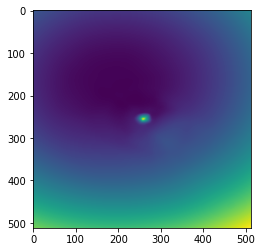

epoch 53801: 47.84879684448242
epoch 53802: 47.57305145263672
epoch 53803: 47.820091247558594
epoch 53804: 48.654029846191406
epoch 53805: 48.36255645751953
epoch 53806: 49.00701904296875
epoch 53807: 48.79729461669922
epoch 53808: 47.96087646484375
epoch 53809: 48.40499496459961
epoch 53811: 47.95074462890625
epoch 53812: 47.78755187988281
epoch 53813: 47.95991134643555
epoch 53814: 47.57695388793945
epoch 53815: 48.161277770996094
epoch 53816: 48.41458511352539
epoch 53817: 47.415340423583984
epoch 53818: 49.33985900878906
epoch 53819: 47.571533203125
epoch 53821: 48.84143829345703
epoch 53822: 47.5661506652832
epoch 53823: 48.24197006225586
epoch 53824: 48.394065856933594
epoch 53825: 48.38029479980469
epoch 53826: 48.30278015136719
epoch 53827: 47.511695861816406
epoch 53828: 47.876502990722656
epoch 53829: 47.46315383911133
epoch 53831: 47.94104766845703
epoch 53832: 48.399681091308594
epoch 53833: 48.01210021972656
epoch 53834: 48.52437973022461
epoch 53835: 47.59921646118164
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



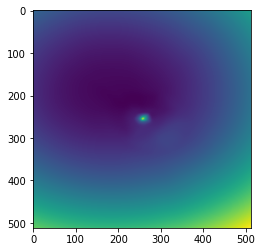

epoch 53901: 47.5960807800293
epoch 53902: 47.800350189208984
epoch 53903: 49.201171875
epoch 53904: 47.750953674316406
epoch 53905: 48.264469146728516
epoch 53906: 47.48095703125
epoch 53907: 47.77335739135742
epoch 53908: 48.5937385559082
epoch 53909: 48.1502799987793
epoch 53911: 48.35224914550781
epoch 53912: 47.95236587524414
epoch 53913: 48.201969146728516
epoch 53914: 49.159881591796875
epoch 53915: 48.474544525146484
epoch 53916: 48.04218673706055
epoch 53917: 49.39946365356445
epoch 53918: 47.559486389160156
epoch 53919: 47.574703216552734
epoch 53921: 47.481239318847656
epoch 53922: 48.13005065917969
epoch 53923: 48.13826370239258
epoch 53924: 48.130374908447266
epoch 53925: 48.146575927734375
epoch 53926: 47.09920883178711
epoch 53927: 47.52616500854492
epoch 53928: 48.24143600463867
epoch 53929: 48.09471130371094
epoch 53931: 48.19211196899414
epoch 53932: 48.71102523803711
epoch 53933: 47.360198974609375
epoch 53934: 47.75901412963867
epoch 53935: 47.03038024902344
epoch 5

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



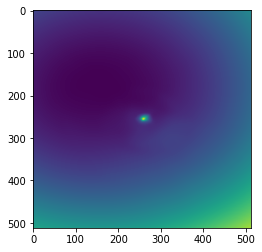

epoch 54001: 48.1078987121582
epoch 54002: 47.51087188720703
epoch 54003: 48.14398956298828
epoch 54004: 48.769405364990234
epoch 54005: 47.050994873046875
epoch 54006: 48.865081787109375
epoch 54007: 48.40221405029297
epoch 54008: 47.977996826171875
epoch 54009: 47.99262619018555
epoch 54011: 48.01084518432617
epoch 54012: 48.85640335083008
epoch 54013: 47.86451721191406
epoch 54014: 47.96861267089844
epoch 54015: 47.41509246826172
epoch 54016: 47.778011322021484
epoch 54017: 48.12087631225586
epoch 54018: 48.65116500854492
epoch 54019: 48.82552719116211
epoch 54021: 48.329463958740234
epoch 54022: 48.08821105957031
epoch 54023: 47.37849426269531
epoch 54024: 48.38885498046875
epoch 54025: 48.41897964477539
epoch 54026: 48.06406021118164
epoch 54027: 48.21770477294922
epoch 54028: 49.56260299682617
epoch 54029: 47.550575256347656
epoch 54031: 47.89618682861328
epoch 54032: 47.57999038696289
epoch 54033: 47.962738037109375
epoch 54034: 48.40328598022461
epoch 54035: 48.090389251708984


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



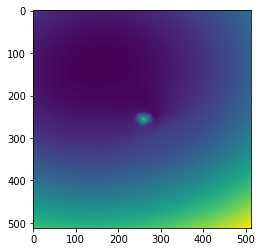

epoch 54101: 47.68043899536133
epoch 54102: 48.25299835205078
epoch 54103: 48.3020133972168
epoch 54104: 48.23947525024414
epoch 54105: 47.948707580566406
epoch 54106: 52.52012252807617
epoch 54107: 48.818416595458984
epoch 54108: 48.1899528503418
epoch 54109: 48.54613494873047
epoch 54111: 48.007991790771484
epoch 54112: 48.82305908203125
epoch 54113: 48.561527252197266
epoch 54114: 47.676517486572266
epoch 54115: 48.42454528808594
epoch 54116: 48.771461486816406
epoch 54117: 49.12488555908203
epoch 54118: 47.42829132080078
epoch 54119: 48.23468017578125
epoch 54121: 48.099159240722656
epoch 54122: 48.31740188598633
epoch 54123: 48.26143264770508
epoch 54124: 47.75424575805664
epoch 54125: 48.00501251220703
epoch 54126: 48.70109558105469
epoch 54127: 48.46421813964844
epoch 54128: 47.9169807434082
epoch 54129: 47.599632263183594
epoch 54131: 48.040733337402344
epoch 54132: 47.757347106933594
epoch 54133: 49.01958084106445
epoch 54134: 47.9237060546875
epoch 54135: 47.647098541259766
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



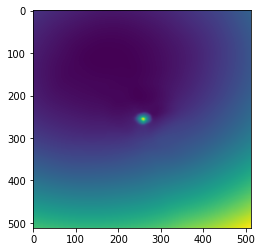

epoch 54201: 48.11283493041992
epoch 54202: 48.47996520996094
epoch 54203: 48.282100677490234
epoch 54204: 49.15703582763672
epoch 54205: 48.06353759765625
epoch 54206: 48.46928405761719
epoch 54207: 48.17076873779297
epoch 54208: 48.44449996948242
epoch 54209: 48.67142105102539
epoch 54211: 49.060211181640625
epoch 54212: 48.57905960083008
epoch 54213: 48.13314437866211
epoch 54214: 48.50153350830078
epoch 54215: 48.18864059448242
epoch 54216: 48.28607940673828
epoch 54217: 48.79288101196289
epoch 54218: 47.7264289855957
epoch 54219: 48.19324493408203
epoch 54221: 48.48716735839844
epoch 54222: 48.30682373046875
epoch 54223: 48.11201095581055
epoch 54224: 48.59028625488281
epoch 54225: 47.937713623046875
epoch 54226: 48.61549377441406
epoch 54227: 48.25811004638672
epoch 54228: 48.71563720703125
epoch 54229: 47.1402587890625
epoch 54231: 47.801937103271484
epoch 54232: 47.033302307128906
epoch 54233: 48.48318099975586
epoch 54234: 48.42374801635742
epoch 54235: 48.373069763183594
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



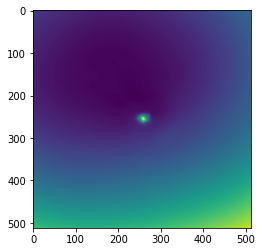

epoch 54301: 47.51607894897461
epoch 54302: 48.221805572509766
epoch 54303: 47.768898010253906
epoch 54304: 48.473384857177734
epoch 54305: 48.109779357910156
epoch 54306: 48.252506256103516
epoch 54307: 48.97679901123047
epoch 54308: 49.0954704284668
epoch 54309: 47.606971740722656
epoch 54311: 48.40407180786133
epoch 54312: 48.688011169433594
epoch 54313: 48.27423095703125
epoch 54314: 48.202354431152344
epoch 54315: 50.45729064941406
epoch 54316: 48.178443908691406
epoch 54317: 48.03244400024414
epoch 54318: 49.14274597167969
epoch 54319: 48.46292495727539
epoch 54321: 48.49587631225586
epoch 54322: 47.447425842285156
epoch 54323: 47.807701110839844
epoch 54324: 48.03879928588867
epoch 54325: 47.59849166870117
epoch 54326: 47.960723876953125
epoch 54327: 47.861656188964844
epoch 54328: 47.46524429321289
epoch 54329: 48.1755485534668
epoch 54331: 47.09059143066406
epoch 54332: 49.48972702026367
epoch 54333: 48.48655319213867
epoch 54334: 48.871788024902344
epoch 54335: 48.46672821044

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



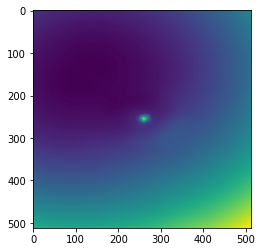

epoch 54401: 47.983367919921875
epoch 54402: 49.103179931640625
epoch 54403: 48.092708587646484
epoch 54404: 47.79047775268555
epoch 54405: 48.76224136352539
epoch 54406: 47.56104278564453
epoch 54407: 48.193809509277344
epoch 54408: 48.536739349365234
epoch 54409: 48.28520202636719
epoch 54411: 48.0540885925293
epoch 54412: 48.28992462158203
epoch 54413: 52.32819366455078
epoch 54414: 47.5461540222168
epoch 54415: 47.924564361572266
epoch 54416: 49.0759162902832
epoch 54417: 48.330055236816406
epoch 54418: 48.010990142822266
epoch 54419: 47.28962707519531
epoch 54421: 48.569149017333984
epoch 54422: 49.063438415527344
epoch 54423: 48.35319519042969
epoch 54424: 47.92488098144531
epoch 54425: 48.53805160522461
epoch 54426: 48.136356353759766
epoch 54427: 48.46934509277344
epoch 54428: 47.84260559082031
epoch 54429: 48.84657287597656
epoch 54431: 47.9255256652832
epoch 54432: 47.68376541137695
epoch 54433: 47.739341735839844
epoch 54434: 47.892616271972656
epoch 54435: 48.37978744506836

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



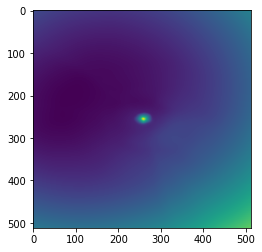

epoch 54501: 48.08824157714844
epoch 54502: 48.926490783691406
epoch 54503: 49.275394439697266
epoch 54504: 48.12559509277344
epoch 54505: 49.12590789794922
epoch 54506: 47.73217010498047
epoch 54507: 48.20334243774414
epoch 54508: 47.58119583129883
epoch 54509: 47.52585220336914
epoch 54511: 48.466461181640625
epoch 54512: 47.625858306884766
epoch 54513: 48.37537384033203
epoch 54514: 48.68883514404297
epoch 54515: 47.67425537109375
epoch 54516: 48.205711364746094
epoch 54517: 48.04225158691406
epoch 54518: 47.56743621826172
epoch 54519: 48.293121337890625
epoch 54521: 47.605098724365234
epoch 54522: 47.242279052734375
epoch 54523: 47.84895706176758
epoch 54524: 48.68018341064453
epoch 54525: 50.5943603515625
epoch 54526: 48.741912841796875
epoch 54527: 47.93585968017578
epoch 54528: 47.511653900146484
epoch 54529: 48.13142776489258
epoch 54531: 47.82617950439453
epoch 54532: 48.27691650390625
epoch 54533: 48.411834716796875
epoch 54534: 47.93467712402344
epoch 54535: 48.2221031188964

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



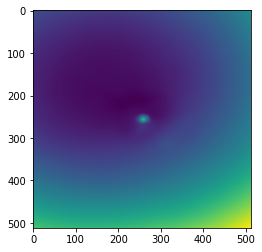

epoch 54601: 48.35521697998047
epoch 54602: 48.51241683959961
epoch 54603: 48.75989532470703
epoch 54604: 48.434566497802734
epoch 54605: 48.00120544433594
epoch 54606: 49.51742172241211
epoch 54607: 48.70906066894531
epoch 54608: 48.33376693725586
epoch 54609: 48.7652702331543
epoch 54611: 48.23530578613281
epoch 54612: 48.21125793457031
epoch 54613: 48.791561126708984
epoch 54614: 48.186370849609375
epoch 54615: 50.685157775878906
epoch 54616: 47.529239654541016
epoch 54617: 48.115509033203125
epoch 54618: 48.1273307800293
epoch 54619: 47.799835205078125
epoch 54621: 48.144500732421875
epoch 54622: 48.415679931640625
epoch 54623: 47.602752685546875
epoch 54624: 47.889503479003906
epoch 54625: 48.14221954345703
epoch 54626: 48.09697341918945
epoch 54627: 47.90816116333008
epoch 54628: 48.03896713256836
epoch 54629: 48.916019439697266
epoch 54631: 48.03805923461914
epoch 54632: 48.240760803222656
epoch 54633: 47.273292541503906
epoch 54634: 47.60417938232422
epoch 54635: 47.59901809692

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



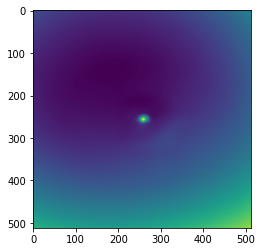

epoch 54701: 49.074371337890625
epoch 54702: 48.422096252441406
epoch 54703: 48.69770050048828
epoch 54704: 48.64514923095703
epoch 54705: 47.28496551513672
epoch 54706: 47.80650329589844
epoch 54707: 47.62520217895508
epoch 54708: 48.4197883605957
epoch 54709: 47.95697021484375
epoch 54711: 48.93062973022461
epoch 54712: 47.641597747802734
epoch 54713: 48.72967529296875
epoch 54714: 49.762481689453125
epoch 54715: 48.58795166015625
epoch 54716: 48.33164596557617
epoch 54717: 48.780357360839844
epoch 54718: 47.8680305480957
epoch 54719: 48.696685791015625
epoch 54721: 47.80537796020508
epoch 54722: 47.83970642089844
epoch 54723: 48.82670211791992
epoch 54724: 48.196929931640625
epoch 54725: 47.04631805419922
epoch 54726: 48.64493179321289
epoch 54727: 47.879886627197266
epoch 54728: 48.440956115722656
epoch 54729: 48.20948028564453
epoch 54731: 49.61983871459961
epoch 54732: 48.44171905517578
epoch 54733: 47.819149017333984
epoch 54734: 48.45518493652344
epoch 54735: 47.43868637084961


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



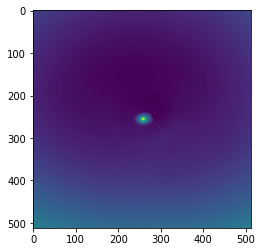

epoch 54801: 48.12469482421875
epoch 54802: 48.93154525756836
epoch 54803: 48.448997497558594
epoch 54804: 48.01770782470703
epoch 54805: 47.968299865722656
epoch 54806: 48.32926559448242
epoch 54807: 48.06907272338867
epoch 54808: 48.545162200927734
epoch 54809: 47.99950408935547
epoch 54811: 51.5244140625
epoch 54812: 49.02802658081055
epoch 54813: 48.525657653808594
epoch 54814: 48.53009033203125
epoch 54815: 47.62021255493164
epoch 54816: 48.78435134887695
epoch 54817: 47.514034271240234
epoch 54818: 47.3071174621582
epoch 54819: 48.23029327392578
epoch 54821: 48.61787033081055
epoch 54822: 48.46666717529297
epoch 54823: 48.522796630859375
epoch 54824: 49.87189483642578
epoch 54825: 48.240516662597656
epoch 54826: 48.440834045410156
epoch 54827: 47.850467681884766
epoch 54828: 48.26610565185547
epoch 54829: 48.770111083984375
epoch 54831: 48.38109588623047
epoch 54832: 48.48521041870117
epoch 54833: 48.58595275878906
epoch 54834: 49.31629943847656
epoch 54835: 48.50437545776367
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



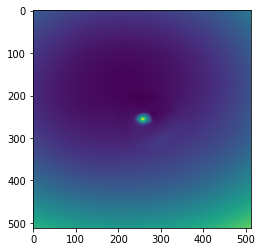

epoch 54901: 47.6521110534668
epoch 54902: 47.78321075439453
epoch 54903: 47.98959732055664
epoch 54904: 48.53744888305664
epoch 54905: 48.50454330444336
epoch 54906: 49.49772262573242
epoch 54907: 48.25338363647461
epoch 54908: 48.004547119140625
epoch 54909: 47.897212982177734
epoch 54911: 48.79864501953125
epoch 54912: 48.00114440917969
epoch 54913: 48.858768463134766
epoch 54914: 48.12602233886719
epoch 54915: 48.30070114135742
epoch 54916: 48.29500961303711
epoch 54917: 47.62441635131836
epoch 54918: 48.123558044433594
epoch 54919: 47.42603302001953
epoch 54921: 48.20647430419922
epoch 54922: 48.500789642333984
epoch 54923: 48.41394805908203
epoch 54924: 47.66028594970703
epoch 54925: 47.85918045043945
epoch 54926: 48.245323181152344
epoch 54927: 48.7000617980957
epoch 54928: 47.82396697998047
epoch 54929: 48.77214813232422
epoch 54931: 47.683799743652344
epoch 54932: 47.922367095947266
epoch 54933: 47.674217224121094
epoch 54934: 48.32286071777344
epoch 54935: 48.56543731689453
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



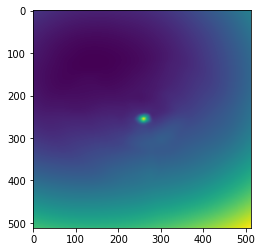

epoch 55001: 47.41008758544922
epoch 55002: 51.03571319580078
epoch 55003: 47.62946701049805
epoch 55004: 48.11705017089844
epoch 55005: 48.59514617919922
epoch 55006: 50.909969329833984
epoch 55007: 47.7458381652832
epoch 55008: 47.51974105834961
epoch 55009: 48.107994079589844
epoch 55011: 48.0711784362793
epoch 55012: 47.639347076416016
epoch 55013: 47.286155700683594
epoch 55014: 48.1142692565918
epoch 55015: 47.58443832397461
epoch 55016: 48.0343017578125
epoch 55017: 49.77093505859375
epoch 55018: 48.07099151611328
epoch 55019: 48.53042984008789
epoch 55021: 48.27677536010742
epoch 55022: 48.14456558227539
epoch 55023: 47.652748107910156
epoch 55024: 48.76366424560547
epoch 55025: 47.35375213623047
epoch 55026: 48.34994125366211
epoch 55027: 47.94340896606445
epoch 55028: 47.84468078613281
epoch 55029: 48.94966506958008
epoch 55031: 47.837432861328125
epoch 55032: 48.03783416748047
epoch 55033: 47.5675048828125
epoch 55034: 48.41044616699219
epoch 55035: 48.52322769165039
epoch 5

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



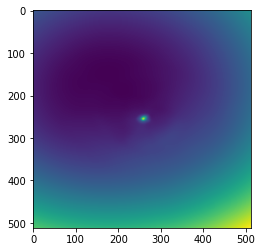

epoch 55101: 47.55169677734375
epoch 55102: 48.07575988769531
epoch 55103: 47.99467849731445
epoch 55104: 47.84309005737305
epoch 55105: 47.43910598754883
epoch 55106: 48.274147033691406
epoch 55107: 48.13295364379883
epoch 55108: 48.20492935180664
epoch 55109: 47.62796401977539
epoch 55111: 48.363956451416016
epoch 55112: 47.313106536865234
epoch 55113: 49.53398513793945
epoch 55114: 47.94084930419922
epoch 55115: 47.413482666015625
epoch 55116: 48.04179000854492
epoch 55117: 48.12978744506836
epoch 55118: 47.821197509765625
epoch 55119: 48.03499221801758
epoch 55121: 47.254051208496094
epoch 55122: 48.17134475708008
epoch 55123: 48.16983413696289
epoch 55124: 47.866390228271484
epoch 55125: 47.41987609863281
epoch 55126: 48.10615539550781
epoch 55127: 48.67942428588867
epoch 55128: 47.9068717956543
epoch 55129: 47.67842102050781
epoch 55131: 47.505401611328125
epoch 55132: 48.8838005065918
epoch 55133: 48.15847396850586
epoch 55134: 47.7886848449707
epoch 55135: 47.6569938659668
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



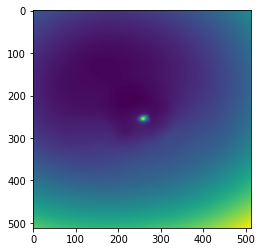

epoch 55201: 47.81947708129883
epoch 55202: 47.60889434814453
epoch 55203: 47.58222198486328
epoch 55204: 48.41267776489258
epoch 55205: 47.59931182861328
epoch 55206: 47.77531814575195
epoch 55207: 47.78196716308594
epoch 55208: 47.92942810058594
epoch 55209: 47.787513732910156
epoch 55211: 47.94972610473633
epoch 55212: 47.863670349121094
epoch 55213: 48.473758697509766
epoch 55214: 49.57935333251953
epoch 55215: 47.98981857299805
epoch 55216: 48.25899124145508
epoch 55217: 49.48370361328125
epoch 55218: 47.41204071044922
epoch 55219: 49.28868865966797
epoch 55221: 47.55692672729492
epoch 55222: 49.87631607055664
epoch 55223: 47.477516174316406
epoch 55224: 47.9918098449707
epoch 55225: 48.32822799682617
epoch 55226: 47.966705322265625
epoch 55227: 47.78229904174805
epoch 55228: 47.5719108581543
epoch 55229: 48.27547836303711
epoch 55231: 47.890140533447266
epoch 55232: 48.75836181640625
epoch 55233: 48.35439682006836
epoch 55234: 48.388099670410156
epoch 55235: 48.02818298339844
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



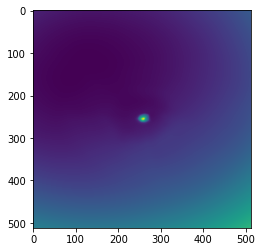

epoch 55301: 47.71993637084961
epoch 55302: 48.47551345825195
epoch 55303: 47.59069061279297
epoch 55304: 48.00926971435547
epoch 55305: 48.00059127807617
epoch 55306: 49.059349060058594
epoch 55307: 47.95752716064453
epoch 55308: 48.41981506347656
epoch 55309: 47.1121826171875
epoch 55311: 47.999549865722656
epoch 55312: 48.39934539794922
epoch 55313: 47.617733001708984
epoch 55314: 48.09177780151367
epoch 55315: 47.64833450317383
epoch 55316: 48.35893630981445
epoch 55317: 48.029136657714844
epoch 55318: 48.56315994262695
epoch 55319: 48.4364128112793
epoch 55321: 47.918418884277344
epoch 55322: 48.54987335205078
epoch 55323: 48.39744567871094
epoch 55324: 47.57252502441406
epoch 55325: 48.64118957519531
epoch 55326: 48.19774627685547
epoch 55327: 48.211036682128906
epoch 55328: 49.192604064941406
epoch 55329: 47.694915771484375
epoch 55331: 48.7227668762207
epoch 55332: 47.94247055053711
epoch 55333: 51.662113189697266
epoch 55334: 47.6203498840332
epoch 55335: 48.2969856262207
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



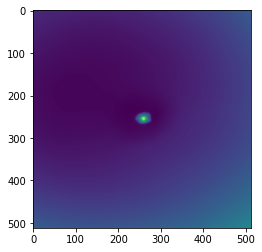

epoch 55401: 48.31792449951172
epoch 55402: 48.23847961425781
epoch 55403: 47.966209411621094
epoch 55404: 47.72698211669922
epoch 55405: 48.836795806884766
epoch 55406: 49.268577575683594
epoch 55407: 48.1114616394043
epoch 55408: 48.42706298828125
epoch 55409: 48.1974983215332
epoch 55411: 47.55439758300781
epoch 55412: 47.52123260498047
epoch 55413: 47.710350036621094
epoch 55414: 49.17288589477539
epoch 55415: 48.045631408691406
epoch 55416: 48.54697799682617
epoch 55417: 48.50461196899414
epoch 55418: 48.10661315917969
epoch 55419: 47.415836334228516
epoch 55421: 48.615150451660156
epoch 55422: 48.13589859008789
epoch 55423: 48.4539794921875
epoch 55424: 47.5870246887207
epoch 55425: 47.627288818359375
epoch 55426: 47.96334457397461
epoch 55427: 48.26859664916992
epoch 55428: 48.432342529296875
epoch 55429: 47.821861267089844
epoch 55431: 48.24253845214844
epoch 55432: 48.20475769042969
epoch 55433: 47.9224739074707
epoch 55434: 47.3521614074707
epoch 55435: 49.82936096191406
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



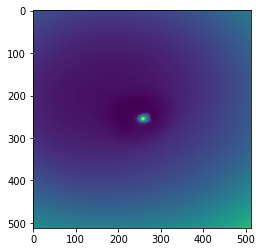

epoch 55501: 47.38436508178711
epoch 55502: 49.498348236083984
epoch 55503: 47.75520324707031
epoch 55504: 48.092384338378906
epoch 55505: 48.25844192504883
epoch 55506: 48.54159164428711
epoch 55507: 48.02603530883789
epoch 55508: 49.946205139160156
epoch 55509: 48.23278045654297
epoch 55511: 48.52226638793945
epoch 55512: 47.41230010986328
epoch 55513: 47.70233917236328
epoch 55514: 47.40179443359375
epoch 55515: 48.308509826660156
epoch 55516: 48.04142379760742
epoch 55517: 47.64635467529297
epoch 55518: 47.181793212890625
epoch 55519: 48.29145812988281
epoch 55521: 48.176002502441406
epoch 55522: 48.11631774902344
epoch 55523: 47.79880142211914
epoch 55524: 47.448883056640625
epoch 55525: 47.84703826904297
epoch 55526: 48.33528518676758
epoch 55527: 51.95017623901367
epoch 55528: 48.38718795776367
epoch 55529: 47.763328552246094
epoch 55531: 48.28485107421875
epoch 55532: 47.85665512084961
epoch 55533: 48.941375732421875
epoch 55534: 48.1116943359375
epoch 55535: 48.31620407104492


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



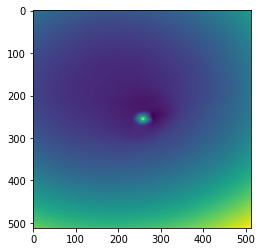

epoch 55601: 47.895484924316406
epoch 55602: 49.26409149169922
epoch 55603: 48.54830551147461
epoch 55604: 47.927398681640625
epoch 55605: 47.64520263671875
epoch 55606: 49.39271545410156
epoch 55607: 48.527198791503906
epoch 55608: 47.94810104370117
epoch 55609: 48.32465362548828
epoch 55611: 48.35240936279297
epoch 55612: 47.78876495361328
epoch 55613: 49.055267333984375
epoch 55614: 47.68394088745117
epoch 55615: 47.69395446777344
epoch 55616: 48.10017013549805
epoch 55617: 48.23397445678711
epoch 55618: 48.524444580078125
epoch 55619: 48.00857925415039
epoch 55621: 48.81052017211914
epoch 55622: 48.64377975463867
epoch 55623: 47.62506866455078
epoch 55624: 47.427040100097656
epoch 55625: 47.520145416259766
epoch 55626: 48.824039459228516
epoch 55627: 48.43913650512695
epoch 55628: 48.17094039916992
epoch 55629: 49.92549133300781
epoch 55631: 48.42456817626953
epoch 55632: 48.30796813964844
epoch 55633: 47.593841552734375
epoch 55634: 47.66399383544922
epoch 55635: 47.99057769775390

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



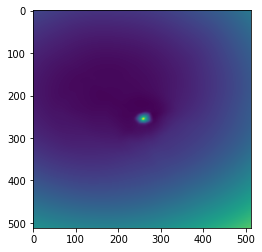

epoch 55701: 47.25813293457031
epoch 55702: 50.75151824951172
epoch 55703: 47.47401428222656
epoch 55704: 48.18648147583008
epoch 55705: 47.513179779052734
epoch 55706: 47.70262908935547
epoch 55707: 47.84947204589844
epoch 55708: 47.788970947265625
epoch 55709: 48.297603607177734
epoch 55711: 47.054443359375
epoch 55712: 48.16597366333008
epoch 55713: 47.52433395385742
epoch 55714: 48.022953033447266
epoch 55715: 47.922462463378906
epoch 55716: 49.45391082763672
epoch 55717: 48.39215850830078
epoch 55718: 48.30400848388672
epoch 55719: 47.73110580444336
epoch 55721: 47.900386810302734
epoch 55722: 48.02803421020508
epoch 55723: 47.69187545776367
epoch 55724: 48.76128387451172
epoch 55725: 48.23004150390625
epoch 55726: 47.64020919799805
epoch 55727: 47.78158187866211
epoch 55728: 51.052249908447266
epoch 55729: 47.719749450683594
epoch 55731: 47.599021911621094
epoch 55732: 48.139312744140625
epoch 55733: 47.09756088256836
epoch 55734: 49.68061065673828
epoch 55735: 47.28644561767578


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



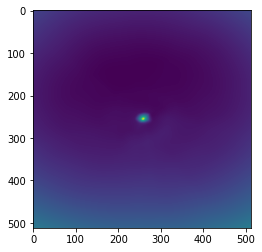

epoch 55801: 47.88465118408203
epoch 55802: 47.731475830078125
epoch 55803: 48.205535888671875
epoch 55804: 51.399330139160156
epoch 55805: 47.38285446166992
epoch 55806: 47.99002456665039
epoch 55807: 48.77534866333008
epoch 55808: 48.76740264892578
epoch 55809: 48.30205535888672
epoch 55811: 48.78097152709961
epoch 55812: 49.613643646240234
epoch 55813: 47.828941345214844
epoch 55814: 48.304237365722656
epoch 55815: 49.01102828979492
epoch 55816: 48.367271423339844
epoch 55817: 48.259864807128906
epoch 55818: 49.22589111328125
epoch 55819: 48.313228607177734
epoch 55821: 48.33338928222656
epoch 55822: 47.973121643066406
epoch 55823: 48.446266174316406
epoch 55824: 48.15665817260742
epoch 55825: 48.408321380615234
epoch 55826: 48.4896125793457
epoch 55827: 48.69633102416992
epoch 55828: 48.30508804321289
epoch 55829: 49.465667724609375
epoch 55831: 49.47805404663086
epoch 55832: 48.12436294555664
epoch 55833: 47.868568420410156
epoch 55834: 48.32636642456055
epoch 55835: 47.8154563903

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



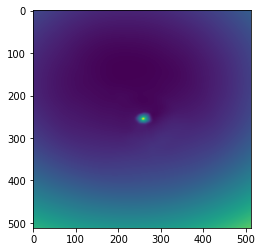

epoch 55901: 47.70258331298828
epoch 55902: 47.38991165161133
epoch 55903: 47.83944320678711
epoch 55904: 47.80436325073242
epoch 55905: 48.228023529052734
epoch 55906: 47.57453155517578
epoch 55907: 48.13834762573242
epoch 55908: 47.9785270690918
epoch 55909: 47.83869171142578
epoch 55911: 48.39730453491211
epoch 55912: 47.599456787109375
epoch 55913: 48.04176330566406
epoch 55914: 48.45399856567383
epoch 55915: 47.48020935058594
epoch 55916: 47.43004608154297
epoch 55917: 47.68620300292969
epoch 55918: 47.456851959228516
epoch 55919: 48.2260627746582
epoch 55921: 48.62474822998047
epoch 55922: 47.73368835449219
epoch 55923: 47.55039978027344
epoch 55924: 48.20595169067383
epoch 55925: 47.28738784790039
epoch 55926: 49.05691146850586
epoch 55927: 47.22730255126953
epoch 55928: 47.77384948730469
epoch 55929: 48.08598327636719
epoch 55931: 48.95936965942383
epoch 55932: 48.08873748779297
epoch 55933: 48.43080520629883
epoch 55934: 48.02857208251953
epoch 55935: 48.53514862060547
epoch 5

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



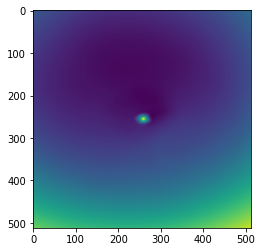

epoch 56001: 47.887142181396484
epoch 56002: 48.162532806396484
epoch 56003: 48.56454086303711
epoch 56004: 48.76115417480469
epoch 56005: 49.74439239501953
epoch 56006: 47.97840118408203
epoch 56007: 48.727848052978516
epoch 56008: 47.96360778808594
epoch 56009: 49.17055892944336
epoch 56011: 48.48698425292969
epoch 56012: 47.94639587402344
epoch 56013: 48.69575500488281
epoch 56014: 48.526466369628906
epoch 56015: 48.68865966796875
epoch 56016: 48.23991775512695
epoch 56017: 48.587554931640625
epoch 56018: 48.19220733642578
epoch 56019: 47.52613830566406
epoch 56021: 48.94013214111328
epoch 56022: 47.86006546020508
epoch 56023: 47.624942779541016
epoch 56024: 48.41261672973633
epoch 56025: 47.66705322265625
epoch 56026: 47.55509948730469
epoch 56027: 47.4814567565918
epoch 56028: 47.498756408691406
epoch 56029: 47.66629409790039
epoch 56031: 47.90974426269531
epoch 56032: 48.34441375732422
epoch 56033: 48.622432708740234
epoch 56034: 47.97396469116211
epoch 56035: 48.37440872192383
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



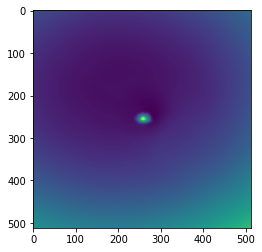

epoch 56101: 48.09720230102539
epoch 56102: 48.84426498413086
epoch 56103: 48.12957763671875
epoch 56104: 48.357025146484375
epoch 56105: 48.19618225097656
epoch 56106: 48.079673767089844
epoch 56107: 47.88067626953125
epoch 56108: 48.052818298339844
epoch 56109: 47.24856948852539
epoch 56111: 47.677364349365234
epoch 56112: 47.82308578491211
epoch 56113: 47.3460578918457
epoch 56114: 48.240718841552734
epoch 56115: 48.52235794067383
epoch 56116: 47.99265670776367
epoch 56117: 48.20402908325195
epoch 56118: 48.29006576538086
epoch 56119: 47.825225830078125
epoch 56121: 47.880332946777344
epoch 56122: 48.02153396606445
epoch 56123: 47.93428039550781
epoch 56124: 47.62327575683594
epoch 56125: 47.852230072021484
epoch 56126: 47.74790573120117
epoch 56127: 48.10968780517578
epoch 56128: 48.77817153930664
epoch 56129: 48.15292739868164
epoch 56131: 47.97066879272461
epoch 56132: 48.267330169677734
epoch 56133: 47.57984161376953
epoch 56134: 47.78761672973633
epoch 56135: 49.10835647583008


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



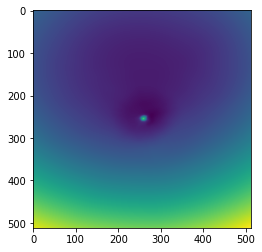

epoch 56201: 48.497554779052734
epoch 56202: 48.328155517578125
epoch 56203: 47.545257568359375
epoch 56204: 47.77832794189453
epoch 56205: 48.66322326660156
epoch 56206: 48.27302169799805
epoch 56207: 48.01128005981445
epoch 56208: 47.39619445800781
epoch 56209: 47.84281539916992
epoch 56211: 48.600276947021484
epoch 56212: 48.50028991699219
epoch 56213: 49.18294906616211
epoch 56214: 48.97982406616211
epoch 56215: 47.8837890625
epoch 56216: 47.995323181152344
epoch 56217: 48.40185546875
epoch 56218: 47.88633728027344
epoch 56219: 49.170711517333984
epoch 56221: 48.14067840576172
epoch 56222: 48.45161056518555
epoch 56223: 49.397705078125
epoch 56224: 47.810611724853516
epoch 56225: 48.651268005371094
epoch 56226: 47.670589447021484
epoch 56227: 47.978965759277344
epoch 56228: 48.50343704223633
epoch 56229: 48.02516555786133
epoch 56231: 48.87452697753906
epoch 56232: 50.50984191894531
epoch 56233: 48.032894134521484
epoch 56234: 50.19260787963867
epoch 56235: 47.782569885253906
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



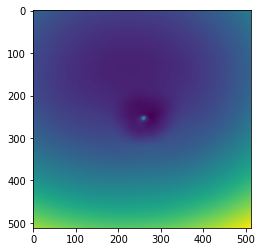

epoch 56301: 48.40607833862305
epoch 56302: 47.493629455566406
epoch 56303: 47.80978012084961
epoch 56304: 49.17048645019531
epoch 56305: 47.540992736816406
epoch 56306: 48.67460632324219
epoch 56307: 47.3502311706543
epoch 56308: 47.733192443847656
epoch 56309: 48.25361633300781
epoch 56311: 48.270843505859375
epoch 56312: 47.695701599121094
epoch 56313: 47.37655258178711
epoch 56314: 48.0770149230957
epoch 56315: 47.723567962646484
epoch 56316: 47.81288146972656
epoch 56317: 48.55794143676758
epoch 56318: 48.38689041137695
epoch 56319: 47.9055061340332
epoch 56321: 48.07503128051758
epoch 56322: 47.921287536621094
epoch 56323: 47.866947174072266
epoch 56324: 48.12858581542969
epoch 56325: 48.06146240234375
epoch 56326: 48.71376419067383
epoch 56327: 47.605079650878906
epoch 56328: 48.78810501098633
epoch 56329: 48.97954177856445
epoch 56331: 47.72932052612305
epoch 56332: 48.60109329223633
epoch 56333: 48.816200256347656
epoch 56334: 49.246864318847656
epoch 56335: 48.962127685546875

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



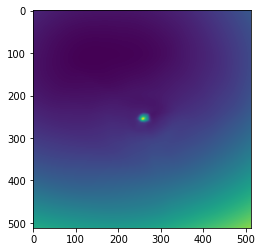

epoch 56401: 48.53424072265625
epoch 56402: 48.32603073120117
epoch 56403: 48.54757308959961
epoch 56404: 48.21771240234375
epoch 56405: 48.55538558959961
epoch 56406: 47.559627532958984
epoch 56407: 48.140933990478516
epoch 56408: 47.861263275146484
epoch 56409: 48.89955139160156
epoch 56411: 47.88890838623047
epoch 56412: 48.857147216796875
epoch 56413: 48.28583526611328
epoch 56414: 47.97572326660156
epoch 56415: 48.55205154418945
epoch 56416: 47.59665298461914
epoch 56417: 48.11431121826172
epoch 56418: 48.05049514770508
epoch 56419: 48.7932014465332
epoch 56421: 48.2884635925293
epoch 56422: 47.95838165283203
epoch 56423: 48.210350036621094
epoch 56424: 48.160987854003906
epoch 56425: 48.593387603759766
epoch 56426: 47.953128814697266
epoch 56427: 47.61977767944336
epoch 56428: 49.30784606933594
epoch 56429: 48.747989654541016
epoch 56431: 48.132041931152344
epoch 56432: 48.63325500488281
epoch 56433: 48.754390716552734
epoch 56434: 52.294193267822266
epoch 56435: 48.2355232238769

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



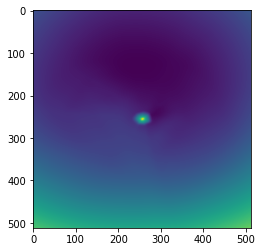

epoch 56501: 48.63056945800781
epoch 56502: 48.48090744018555
epoch 56503: 47.84272003173828
epoch 56504: 47.88011169433594
epoch 56505: 47.90029525756836
epoch 56506: 47.1859245300293
epoch 56507: 47.76774597167969
epoch 56508: 48.20835876464844
epoch 56509: 48.58989334106445
epoch 56511: 47.97683334350586
epoch 56512: 47.66042709350586
epoch 56513: 47.76670837402344
epoch 56514: 47.92938232421875
epoch 56515: 47.95296096801758
epoch 56516: 48.357723236083984
epoch 56517: 49.67589569091797
epoch 56518: 49.261444091796875
epoch 56519: 49.313228607177734
epoch 56521: 48.92860794067383
epoch 56522: 47.198543548583984
epoch 56523: 49.110721588134766
epoch 56524: 48.502193450927734
epoch 56525: 48.30061340332031
epoch 56526: 47.7064323425293
epoch 56527: 49.24592208862305
epoch 56528: 48.56534194946289
epoch 56529: 48.3797492980957
epoch 56531: 49.013427734375
epoch 56532: 48.128604888916016
epoch 56533: 48.57931900024414
epoch 56534: 47.86920166015625
epoch 56535: 49.99177551269531
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



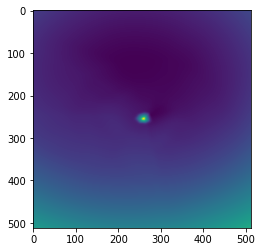

epoch 56601: 48.46065139770508
epoch 56602: 48.019832611083984
epoch 56603: 48.09552001953125
epoch 56604: 47.6465950012207
epoch 56605: 47.957435607910156
epoch 56606: 48.14081954956055
epoch 56607: 47.16453552246094
epoch 56608: 49.04039764404297
epoch 56609: 47.96751403808594
epoch 56611: 47.9137077331543
epoch 56612: 48.940223693847656
epoch 56613: 48.3653450012207
epoch 56614: 48.91563415527344
epoch 56615: 47.87633514404297
epoch 56616: 47.96113204956055
epoch 56617: 47.77854919433594
epoch 56618: 47.67512130737305
epoch 56619: 47.868751525878906
epoch 56621: 48.06140899658203
epoch 56622: 48.22697830200195
epoch 56623: 48.54115676879883
epoch 56624: 48.18685531616211
epoch 56625: 48.39713668823242
epoch 56626: 48.21112823486328
epoch 56627: 47.45998001098633
epoch 56628: 48.806636810302734
epoch 56629: 48.10134506225586
epoch 56631: 47.91705322265625
epoch 56632: 47.55678176879883
epoch 56633: 48.26411819458008
epoch 56634: 47.86430740356445
epoch 56635: 48.10618591308594
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



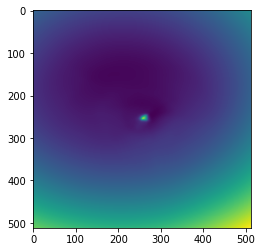

epoch 56701: 47.34260559082031
epoch 56702: 47.824771881103516
epoch 56703: 48.44962692260742
epoch 56704: 48.63225173950195
epoch 56705: 48.566463470458984
epoch 56706: 49.598243713378906
epoch 56707: 48.04215621948242
epoch 56708: 47.86994552612305
epoch 56709: 47.590030670166016
epoch 56711: 49.45590591430664
epoch 56712: 50.692081451416016
epoch 56713: 48.75677490234375
epoch 56714: 49.03407287597656
epoch 56715: 48.752559661865234
epoch 56716: 48.889259338378906
epoch 56717: 47.81399154663086
epoch 56718: 48.37155532836914
epoch 56719: 48.54285430908203
epoch 56721: 48.23945617675781
epoch 56722: 48.73722457885742
epoch 56723: 48.350093841552734
epoch 56724: 47.951839447021484
epoch 56725: 48.607887268066406
epoch 56726: 47.697593688964844
epoch 56727: 47.8974609375
epoch 56728: 48.57222366333008
epoch 56729: 49.0509033203125
epoch 56731: 48.60169982910156
epoch 56732: 48.72853088378906
epoch 56733: 48.313575744628906
epoch 56734: 47.92042922973633
epoch 56735: 48.23458480834961
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



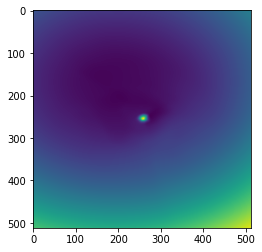

epoch 56801: 47.24338150024414
epoch 56802: 48.594547271728516
epoch 56803: 48.725955963134766
epoch 56804: 47.49163818359375
epoch 56805: 48.326175689697266
epoch 56806: 47.7798957824707
epoch 56807: 47.78309631347656
epoch 56808: 49.74026870727539
epoch 56809: 48.20147705078125
epoch 56811: 48.341487884521484
epoch 56812: 47.99945831298828
epoch 56813: 48.45929718017578
epoch 56814: 47.99116516113281
epoch 56815: 47.883399963378906
epoch 56816: 48.60503005981445
epoch 56817: 48.404048919677734
epoch 56818: 47.155033111572266
epoch 56819: 47.49367904663086
epoch 56821: 48.56156539916992
epoch 56822: 48.0661735534668
epoch 56823: 47.82278060913086
epoch 56824: 47.58230972290039
epoch 56825: 48.01019287109375
epoch 56826: 48.2927360534668
epoch 56827: 47.72886276245117
epoch 56828: 47.78190231323242
epoch 56829: 47.53175735473633
epoch 56831: 48.43156051635742
epoch 56832: 47.84372329711914
epoch 56833: 47.283939361572266
epoch 56834: 48.76457977294922
epoch 56835: 48.1206169128418
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



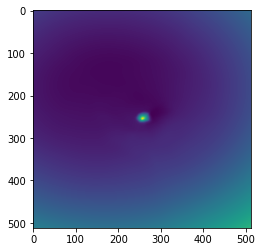

epoch 56901: 50.53131103515625
epoch 56902: 48.595130920410156
epoch 56903: 47.395469665527344
epoch 56904: 48.26300048828125
epoch 56905: 48.76803970336914
epoch 56906: 48.53726577758789
epoch 56907: 47.82763671875
epoch 56908: 48.07012939453125
epoch 56909: 48.34638214111328
epoch 56911: 48.59622573852539
epoch 56912: 47.849395751953125
epoch 56913: 48.5567626953125
epoch 56914: 48.514122009277344
epoch 56915: 49.090232849121094
epoch 56916: 48.43391418457031
epoch 56917: 48.56434631347656
epoch 56918: 48.74728775024414
epoch 56919: 48.376609802246094
epoch 56921: 48.10785675048828
epoch 56922: 47.73298645019531
epoch 56923: 48.226783752441406
epoch 56924: 49.443668365478516
epoch 56925: 47.59511184692383
epoch 56926: 47.51545333862305
epoch 56927: 49.26951599121094
epoch 56928: 48.44541931152344
epoch 56929: 48.320003509521484
epoch 56931: 48.52354049682617
epoch 56932: 47.48640441894531
epoch 56933: 49.39726257324219
epoch 56934: 49.362388610839844
epoch 56935: 48.67356872558594
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



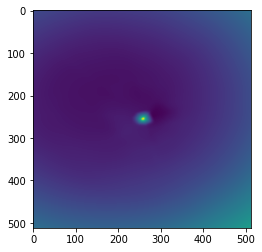

epoch 57001: 48.90633010864258
epoch 57002: 47.97753143310547
epoch 57003: 48.87568664550781
epoch 57004: 48.687503814697266
epoch 57005: 47.71197509765625
epoch 57006: 48.680511474609375
epoch 57007: 48.27376174926758
epoch 57008: 48.287574768066406
epoch 57009: 47.64900207519531
epoch 57011: 48.199951171875
epoch 57012: 48.1400260925293
epoch 57013: 49.23981857299805
epoch 57014: 48.21570587158203
epoch 57015: 48.06096267700195
epoch 57016: 47.46242141723633
epoch 57017: 48.318668365478516
epoch 57018: 48.129642486572266
epoch 57019: 48.68735885620117
epoch 57021: 48.56638717651367
epoch 57022: 48.044410705566406
epoch 57023: 49.438907623291016
epoch 57024: 47.75204849243164
epoch 57025: 48.1107292175293
epoch 57026: 48.38579177856445
epoch 57027: 48.72517395019531
epoch 57028: 48.121620178222656
epoch 57029: 48.25969696044922
epoch 57031: 48.23210906982422
epoch 57032: 48.246219635009766
epoch 57033: 48.09189987182617
epoch 57034: 48.6147346496582
epoch 57035: 48.11330795288086
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



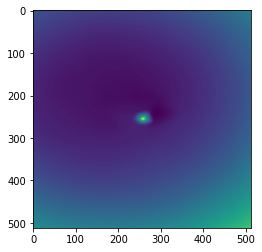

epoch 57101: 47.39408874511719
epoch 57102: 47.484989166259766
epoch 57103: 49.46879196166992
epoch 57104: 47.88776779174805
epoch 57105: 47.978633880615234
epoch 57106: 49.56834030151367
epoch 57107: 48.165035247802734
epoch 57108: 47.738319396972656
epoch 57109: 47.906219482421875
epoch 57111: 47.51860046386719
epoch 57112: 49.14779281616211
epoch 57113: 48.524940490722656
epoch 57114: 48.18310546875
epoch 57115: 48.11692810058594
epoch 57116: 48.720603942871094
epoch 57117: 48.59172439575195
epoch 57118: 47.2305908203125
epoch 57119: 47.55010223388672
epoch 57121: 47.67170333862305
epoch 57122: 49.0008659362793
epoch 57123: 47.196807861328125
epoch 57124: 48.224143981933594
epoch 57125: 48.04031753540039
epoch 57126: 47.910316467285156
epoch 57127: 48.019046783447266
epoch 57128: 49.11199951171875
epoch 57129: 48.828853607177734
epoch 57131: 47.96044158935547
epoch 57132: 48.695343017578125
epoch 57133: 48.76218795776367
epoch 57134: 48.516265869140625
epoch 57135: 48.25765228271484

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



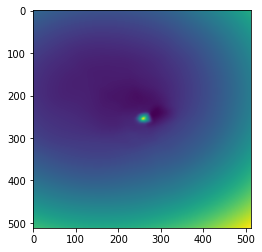

epoch 57201: 47.335365295410156
epoch 57202: 48.223472595214844
epoch 57203: 47.93468475341797
epoch 57204: 48.60684585571289
epoch 57205: 48.569068908691406
epoch 57206: 48.54664611816406
epoch 57207: 48.61231994628906
epoch 57208: 47.445343017578125
epoch 57209: 49.08688735961914
epoch 57211: 47.71794128417969
epoch 57212: 48.141151428222656
epoch 57213: 47.36875915527344
epoch 57214: 48.300880432128906
epoch 57215: 48.33888244628906
epoch 57216: 48.62882614135742
epoch 57217: 48.18581008911133
epoch 57218: 49.3154296875
epoch 57219: 47.6725959777832
epoch 57221: 48.08641815185547
epoch 57222: 47.930381774902344
epoch 57223: 47.61966323852539
epoch 57224: 47.69622802734375
epoch 57225: 47.742889404296875
epoch 57226: 47.19284439086914
epoch 57227: 47.74728012084961
epoch 57228: 47.663352966308594
epoch 57229: 48.80644607543945
epoch 57231: 48.965885162353516
epoch 57232: 47.773494720458984
epoch 57233: 47.94432830810547
epoch 57234: 48.11105728149414
epoch 57235: 47.71199417114258
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



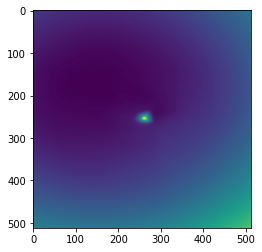

epoch 57301: 48.349246978759766
epoch 57302: 48.4360466003418
epoch 57303: 48.26954650878906
epoch 57304: 49.08253860473633
epoch 57305: 49.38058853149414
epoch 57306: 47.83895492553711
epoch 57307: 49.15534210205078
epoch 57308: 48.060882568359375
epoch 57309: 47.480953216552734
epoch 57311: 47.729881286621094
epoch 57312: 49.28409194946289
epoch 57313: 50.31709671020508
epoch 57314: 48.345619201660156
epoch 57315: 48.737613677978516
epoch 57316: 47.97804260253906
epoch 57317: 48.17148971557617
epoch 57318: 48.4264030456543
epoch 57319: 48.719261169433594
epoch 57321: 48.84854507446289
epoch 57322: 48.12412643432617
epoch 57323: 48.07478713989258
epoch 57324: 47.61865997314453
epoch 57325: 50.093875885009766
epoch 57326: 48.55366897583008
epoch 57327: 48.052181243896484
epoch 57328: 49.32844161987305
epoch 57329: 48.28035354614258
epoch 57331: 48.60935592651367
epoch 57332: 48.233551025390625
epoch 57333: 48.08732223510742
epoch 57334: 47.87533187866211
epoch 57335: 48.2296257019043
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



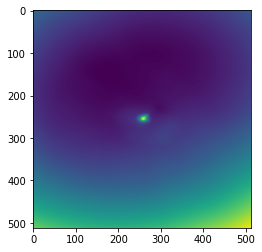

epoch 57401: 47.73453903198242
epoch 57402: 48.420936584472656
epoch 57403: 48.5107536315918
epoch 57404: 49.40684127807617
epoch 57405: 47.94840621948242
epoch 57406: 48.82369613647461
epoch 57407: 48.60525131225586
epoch 57408: 47.75901412963867
epoch 57409: 47.9496955871582
epoch 57411: 48.077720642089844
epoch 57412: 49.139068603515625
epoch 57413: 47.60575485229492
epoch 57414: 48.07235336303711
epoch 57415: 48.136077880859375
epoch 57416: 48.01383972167969
epoch 57417: 48.07758712768555
epoch 57418: 48.92146682739258
epoch 57419: 48.538875579833984
epoch 57421: 47.73686981201172
epoch 57422: 48.75740051269531
epoch 57423: 48.31877136230469
epoch 57424: 48.55149841308594
epoch 57425: 48.05473709106445
epoch 57426: 47.88312530517578
epoch 57427: 50.12272262573242
epoch 57428: 48.545902252197266
epoch 57429: 48.3353385925293
epoch 57431: 47.85655212402344
epoch 57432: 47.73345947265625
epoch 57433: 48.0348014831543
epoch 57434: 47.05973815917969
epoch 57435: 48.232975006103516
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



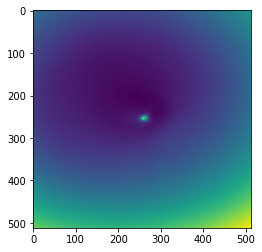

epoch 57501: 47.60847473144531
epoch 57502: 48.489906311035156
epoch 57503: 47.75394058227539
epoch 57504: 48.444847106933594
epoch 57505: 48.37586212158203
epoch 57506: 48.34471130371094
epoch 57507: 49.52058410644531
epoch 57508: 48.163360595703125
epoch 57509: 47.77547073364258
epoch 57511: 47.41957092285156
epoch 57512: 47.79217529296875
epoch 57513: 48.8012580871582
epoch 57514: 47.99510955810547
epoch 57515: 47.72093963623047
epoch 57516: 48.73615646362305
epoch 57517: 47.907470703125
epoch 57518: 47.86262512207031
epoch 57519: 48.365413665771484
epoch 57521: 47.72617721557617
epoch 57522: 48.23984146118164
epoch 57523: 48.5584831237793
epoch 57524: 48.7335205078125
epoch 57525: 47.34611511230469
epoch 57526: 48.13447952270508
epoch 57527: 47.71411895751953
epoch 57528: 48.031436920166016
epoch 57529: 48.55024337768555
epoch 57531: 49.98858642578125
epoch 57532: 47.83417510986328
epoch 57533: 48.41172790527344
epoch 57534: 48.0986213684082
epoch 57535: 48.60972595214844
epoch 575

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



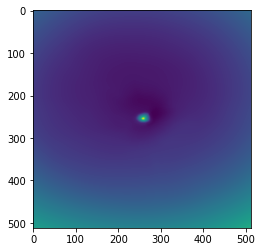

epoch 57601: 48.468238830566406
epoch 57602: 48.92103576660156
epoch 57603: 48.5551872253418
epoch 57604: 48.201717376708984
epoch 57605: 47.4400749206543
epoch 57606: 47.788448333740234
epoch 57607: 47.979061126708984
epoch 57608: 48.38446807861328
epoch 57609: 47.98347854614258
epoch 57611: 48.34324264526367
epoch 57612: 47.30234146118164
epoch 57613: 47.705421447753906
epoch 57614: 48.30618667602539
epoch 57615: 47.72854232788086
epoch 57616: 48.768123626708984
epoch 57617: 48.1315803527832
epoch 57618: 48.404510498046875
epoch 57619: 47.7553825378418
epoch 57621: 47.616661071777344
epoch 57622: 47.558074951171875
epoch 57623: 48.303428649902344
epoch 57624: 48.045867919921875
epoch 57625: 47.79534912109375
epoch 57626: 48.049015045166016
epoch 57627: 47.83264923095703
epoch 57628: 48.585418701171875
epoch 57629: 48.507659912109375
epoch 57631: 48.023902893066406
epoch 57632: 47.69123458862305
epoch 57633: 47.73281478881836
epoch 57634: 47.42131423950195
epoch 57635: 48.785373687744

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



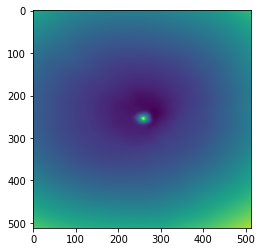

epoch 57701: 48.99650955200195
epoch 57702: 48.13420867919922
epoch 57703: 48.81642150878906
epoch 57704: 48.568763732910156
epoch 57705: 49.25436782836914
epoch 57706: 49.272403717041016
epoch 57707: 48.81117630004883
epoch 57708: 48.76424789428711
epoch 57709: 47.88488006591797
epoch 57711: 48.39345169067383
epoch 57712: 48.26962661743164
epoch 57713: 48.67933654785156
epoch 57714: 48.3953971862793
epoch 57715: 48.675899505615234
epoch 57716: 48.86050796508789
epoch 57717: 49.6838264465332
epoch 57718: 48.337158203125
epoch 57719: 48.34135055541992
epoch 57721: 49.53299331665039
epoch 57722: 47.8680419921875
epoch 57723: 48.65126419067383
epoch 57724: 48.334861755371094
epoch 57725: 48.21220016479492
epoch 57726: 48.05792236328125
epoch 57727: 47.87561798095703
epoch 57728: 48.46875
epoch 57729: 47.84101486206055
epoch 57731: 47.93229293823242
epoch 57732: 48.06486511230469
epoch 57733: 47.33779525756836
epoch 57734: 48.05774688720703
epoch 57735: 48.31473922729492
epoch 57736: 49.03

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



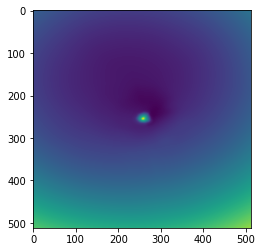

epoch 57801: 48.18406295776367
epoch 57802: 49.02613830566406
epoch 57803: 48.52815246582031
epoch 57804: 47.82909393310547
epoch 57805: 47.23442459106445
epoch 57806: 49.34819412231445
epoch 57807: 48.638946533203125
epoch 57808: 49.138328552246094
epoch 57809: 47.78055953979492
epoch 57811: 47.757354736328125
epoch 57812: 47.85504150390625
epoch 57813: 47.81351089477539
epoch 57814: 48.686092376708984
epoch 57815: 47.06259536743164
epoch 57816: 47.74338912963867
epoch 57817: 47.90768814086914
epoch 57818: 48.18132019042969
epoch 57819: 47.84255599975586
epoch 57821: 47.40006637573242
epoch 57822: 48.11744689941406
epoch 57823: 48.30067825317383
epoch 57824: 48.24028778076172
epoch 57825: 47.58597183227539
epoch 57826: 47.220943450927734
epoch 57827: 49.598758697509766
epoch 57828: 48.150482177734375
epoch 57829: 47.77133560180664
epoch 57831: 50.21589279174805
epoch 57832: 48.52595520019531
epoch 57833: 48.44742202758789
epoch 57834: 48.37605285644531
epoch 57835: 47.241127014160156


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



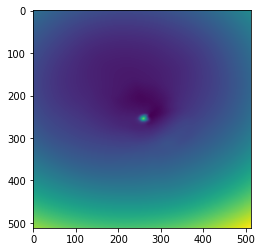

epoch 57901: 47.52397155761719
epoch 57902: 48.6987419128418
epoch 57903: 48.460975646972656
epoch 57904: 48.4660530090332
epoch 57905: 48.10521697998047
epoch 57906: 48.277767181396484
epoch 57907: 47.43159866333008
epoch 57908: 48.391456604003906
epoch 57909: 47.29377365112305
epoch 57911: 47.45661544799805
epoch 57912: 48.00480651855469
epoch 57913: 48.7869987487793
epoch 57914: 48.126251220703125
epoch 57915: 48.06918716430664
epoch 57916: 47.67338562011719
epoch 57917: 47.83236312866211
epoch 57918: 47.77566146850586
epoch 57919: 47.812294006347656
epoch 57921: 47.528480529785156
epoch 57922: 48.46735763549805
epoch 57923: 48.65168380737305
epoch 57924: 48.13011932373047
epoch 57925: 48.038551330566406
epoch 57926: 48.87803649902344
epoch 57927: 47.96022415161133
epoch 57928: 48.46867752075195
epoch 57929: 48.84870529174805
epoch 57931: 48.406349182128906
epoch 57932: 48.46205139160156
epoch 57933: 47.98993682861328
epoch 57934: 47.450801849365234
epoch 57935: 47.758056640625
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



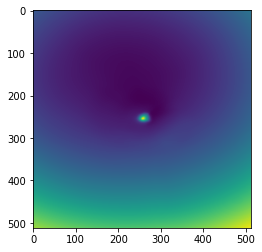

epoch 58001: 47.45582962036133
epoch 58002: 47.653541564941406
epoch 58003: 47.58311462402344
epoch 58004: 47.88960647583008
epoch 58005: 47.97261047363281
epoch 58006: 48.208343505859375
epoch 58007: 48.25548553466797
epoch 58008: 48.33039474487305
epoch 58009: 48.02164077758789
epoch 58011: 48.813438415527344
epoch 58012: 48.160343170166016
epoch 58013: 48.99760818481445
epoch 58014: 48.024227142333984
epoch 58015: 47.8906135559082
epoch 58016: 48.196617126464844
epoch 58017: 48.763187408447266
epoch 58018: 47.922489166259766
epoch 58019: 47.84518814086914
epoch 58021: 48.05558776855469
epoch 58022: 47.527400970458984
epoch 58023: 48.322410583496094
epoch 58024: 48.12489318847656
epoch 58025: 47.98379898071289
epoch 58026: 48.787742614746094
epoch 58027: 47.93199920654297
epoch 58028: 48.27692413330078
epoch 58029: 47.8465461730957
epoch 58031: 48.05527114868164
epoch 58032: 47.26381301879883
epoch 58033: 47.88870620727539
epoch 58034: 48.771217346191406
epoch 58035: 47.4126091003418

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



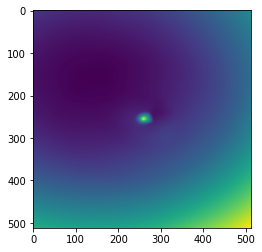

epoch 58101: 47.77001953125
epoch 58102: 48.11896514892578
epoch 58103: 48.52229309082031
epoch 58104: 48.1164436340332
epoch 58105: 48.536128997802734
epoch 58106: 47.64446258544922
epoch 58107: 49.108394622802734
epoch 58108: 47.84336471557617
epoch 58109: 47.73160934448242
epoch 58111: 47.692413330078125
epoch 58112: 47.58519744873047
epoch 58113: 47.83870315551758
epoch 58114: 47.262596130371094
epoch 58115: 49.792972564697266
epoch 58116: 47.80513000488281
epoch 58117: 48.01609802246094
epoch 58118: 48.16556930541992
epoch 58119: 48.29399871826172
epoch 58121: 47.93399429321289
epoch 58122: 47.87477493286133
epoch 58123: 47.984832763671875
epoch 58124: 47.2987174987793
epoch 58125: 48.01121139526367
epoch 58126: 49.12678146362305
epoch 58127: 48.074607849121094
epoch 58128: 47.498023986816406
epoch 58129: 47.9500846862793
epoch 58131: 49.11359405517578
epoch 58132: 48.102386474609375
epoch 58133: 48.39229965209961
epoch 58134: 58.585693359375
epoch 58135: 48.06385803222656
epoch 5

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



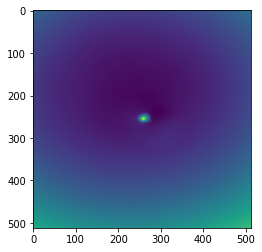

epoch 58201: 47.989234924316406
epoch 58202: 48.161800384521484
epoch 58203: 47.85919952392578
epoch 58204: 48.50321578979492
epoch 58205: 48.582427978515625
epoch 58206: 47.880218505859375
epoch 58207: 48.31874465942383
epoch 58208: 49.67886734008789
epoch 58209: 47.851173400878906
epoch 58211: 47.5816535949707
epoch 58212: 47.47996520996094
epoch 58213: 47.91646194458008
epoch 58214: 47.87571716308594
epoch 58215: 49.3629150390625
epoch 58216: 47.08387756347656
epoch 58217: 48.13147735595703
epoch 58218: 48.51744079589844
epoch 58219: 47.855159759521484
epoch 58221: 47.9551887512207
epoch 58222: 47.61780548095703
epoch 58223: 48.74443817138672
epoch 58224: 47.96282958984375
epoch 58225: 47.89814376831055
epoch 58226: 48.39653778076172
epoch 58227: 47.98674774169922
epoch 58228: 47.737388610839844
epoch 58229: 48.14442443847656
epoch 58231: 47.93935775756836
epoch 58232: 48.20205307006836
epoch 58233: 47.798057556152344
epoch 58234: 47.66502380371094
epoch 58235: 48.08460998535156
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



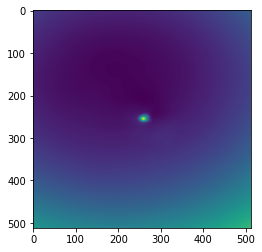

epoch 58301: 48.38766860961914
epoch 58302: 48.536991119384766
epoch 58303: 48.58999252319336
epoch 58304: 47.4842414855957
epoch 58305: 50.08479309082031
epoch 58306: 48.02459716796875
epoch 58307: 47.1859016418457
epoch 58308: 47.935787200927734
epoch 58309: 47.650638580322266
epoch 58311: 47.764549255371094
epoch 58312: 47.7691764831543
epoch 58313: 48.448604583740234
epoch 58314: 47.301490783691406
epoch 58315: 47.532752990722656
epoch 58316: 46.974369049072266
epoch 58317: 47.69805908203125
epoch 58318: 47.71538543701172
epoch 58319: 48.28496170043945
epoch 58321: 47.30837631225586
epoch 58322: 48.70347595214844
epoch 58323: 48.08775329589844
epoch 58324: 47.581871032714844
epoch 58325: 48.03736114501953
epoch 58326: 48.81093978881836
epoch 58327: 47.98578643798828
epoch 58328: 48.69818115234375
epoch 58329: 48.3945198059082
epoch 58331: 47.41118240356445
epoch 58332: 47.497745513916016
epoch 58333: 47.41090393066406
epoch 58334: 47.27827453613281
epoch 58335: 47.86471176147461
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



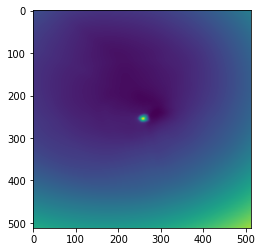

epoch 58401: 47.99467849731445
epoch 58402: 48.44040298461914
epoch 58403: 47.20412826538086
epoch 58404: 48.153892517089844
epoch 58405: 47.94216537475586
epoch 58406: 48.96455001831055
epoch 58407: 47.94615936279297
epoch 58408: 47.41850280761719
epoch 58409: 48.17511749267578
epoch 58411: 47.89394760131836
epoch 58412: 47.6240348815918
epoch 58413: 48.279823303222656
epoch 58414: 47.797115325927734
epoch 58415: 47.65486526489258
epoch 58416: 47.77568435668945
epoch 58417: 48.38450622558594
epoch 58418: 47.97671127319336
epoch 58419: 47.62945556640625
epoch 58421: 47.571475982666016
epoch 58422: 47.39396667480469
epoch 58423: 48.92737579345703
epoch 58424: 49.16217041015625
epoch 58425: 48.016849517822266
epoch 58426: 47.62314987182617
epoch 58427: 47.690032958984375
epoch 58428: 48.216224670410156
epoch 58429: 48.390968322753906
epoch 58431: 47.65304183959961
epoch 58432: 47.944034576416016
epoch 58433: 48.106685638427734
epoch 58434: 48.61400604248047
epoch 58435: 47.15244674682617

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



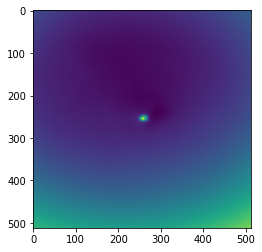

epoch 58501: 47.970550537109375
epoch 58502: 47.931453704833984
epoch 58503: 47.83638000488281
epoch 58504: 48.49554443359375
epoch 58505: 48.002174377441406
epoch 58506: 48.128326416015625
epoch 58507: 48.609012603759766
epoch 58508: 48.28464889526367
epoch 58509: 47.94699478149414
epoch 58511: 48.316429138183594
epoch 58512: 48.822078704833984
epoch 58513: 48.547607421875
epoch 58514: 47.940486907958984
epoch 58515: 47.73295211791992
epoch 58516: 49.670860290527344
epoch 58517: 49.11259841918945
epoch 58518: 48.17721176147461
epoch 58519: 47.94342803955078
epoch 58521: 47.6888313293457
epoch 58522: 47.97697448730469
epoch 58523: 47.07628631591797
epoch 58524: 48.2429084777832
epoch 58525: 48.174686431884766
epoch 58526: 47.5357551574707
epoch 58527: 47.450469970703125
epoch 58528: 47.87837219238281
epoch 58529: 47.962303161621094
epoch 58531: 48.5946044921875
epoch 58532: 48.57793426513672
epoch 58533: 48.246639251708984
epoch 58534: 48.01327133178711
epoch 58535: 48.61687469482422
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



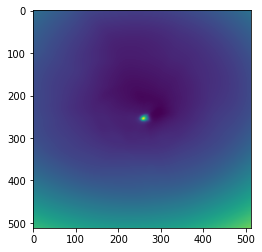

epoch 58601: 47.997894287109375
epoch 58602: 48.37030792236328
epoch 58603: 47.77281188964844
epoch 58604: 47.744667053222656
epoch 58605: 48.040321350097656
epoch 58606: 47.92715072631836
epoch 58607: 48.6213493347168
epoch 58608: 47.98456573486328
epoch 58609: 47.546077728271484
epoch 58611: 48.27545166015625
epoch 58612: 47.657745361328125
epoch 58613: 48.12553024291992
epoch 58614: 47.80264663696289
epoch 58615: 48.130943298339844
epoch 58616: 47.683258056640625
epoch 58617: 47.808170318603516
epoch 58618: 47.81540298461914
epoch 58619: 47.826080322265625
epoch 58621: 47.772579193115234
epoch 58622: 48.4742546081543
epoch 58623: 47.72300338745117
epoch 58624: 48.032997131347656
epoch 58625: 47.94216537475586
epoch 58626: 47.83875274658203
epoch 58627: 47.429237365722656
epoch 58628: 48.1907844543457
epoch 58629: 48.08654022216797
epoch 58631: 48.226600646972656
epoch 58632: 49.149898529052734
epoch 58633: 48.74660873413086
epoch 58634: 47.88197708129883
epoch 58635: 47.922035217285

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



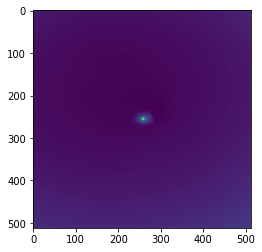

epoch 58701: 47.582515716552734
epoch 58702: 47.936702728271484
epoch 58703: 48.482513427734375
epoch 58704: 48.64769744873047
epoch 58705: 47.41585159301758
epoch 58706: 48.23578643798828
epoch 58707: 48.835391998291016
epoch 58708: 48.728370666503906
epoch 58709: 48.01898193359375
epoch 58711: 47.986263275146484
epoch 58712: 48.575496673583984
epoch 58713: 48.63505554199219
epoch 58714: 48.798545837402344
epoch 58715: 48.197540283203125
epoch 58716: 47.53948211669922
epoch 58717: 46.98866271972656
epoch 58718: 48.01678466796875
epoch 58719: 47.19158172607422
epoch 58721: 48.12533187866211
epoch 58722: 48.17750930786133
epoch 58723: 47.08066177368164
epoch 58724: 47.468162536621094
epoch 58725: 47.991127014160156
epoch 58726: 64.95820617675781
epoch 58727: 47.75921630859375
epoch 58728: 49.17125701904297
epoch 58729: 50.68456268310547
epoch 58731: 51.4991455078125
epoch 58732: 49.53788375854492
epoch 58733: 49.26222610473633
epoch 58734: 48.62327575683594
epoch 58735: 49.1318588256835

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



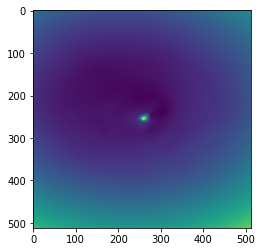

epoch 58801: 47.63959503173828
epoch 58802: 48.51238250732422
epoch 58803: 48.16322326660156
epoch 58804: 48.501399993896484
epoch 58805: 48.81216812133789
epoch 58806: 48.96012496948242
epoch 58807: 48.550113677978516
epoch 58808: 48.72219467163086
epoch 58809: 48.762630462646484
epoch 58811: 47.44221496582031
epoch 58812: 48.1882438659668
epoch 58813: 48.50938415527344
epoch 58814: 48.435672760009766
epoch 58815: 48.24119186401367
epoch 58816: 47.88085174560547
epoch 58817: 48.28383255004883
epoch 58818: 48.13868713378906
epoch 58819: 48.769981384277344
epoch 58821: 47.972076416015625
epoch 58822: 48.35515213012695
epoch 58823: 48.07164001464844
epoch 58824: 48.37932586669922
epoch 58825: 48.540794372558594
epoch 58826: 48.850521087646484
epoch 58827: 47.47129440307617
epoch 58828: 47.75693130493164
epoch 58829: 47.75128173828125
epoch 58831: 48.76980209350586
epoch 58832: 48.985164642333984
epoch 58833: 48.034061431884766
epoch 58834: 49.975250244140625
epoch 58835: 49.3091468811035

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



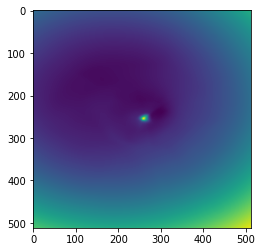

epoch 58901: 47.83417510986328
epoch 58902: 48.27702331542969
epoch 58903: 47.352962493896484
epoch 58904: 48.44059753417969
epoch 58905: 49.048336029052734
epoch 58906: 47.71289825439453
epoch 58907: 47.85482406616211
epoch 58908: 48.02750778198242
epoch 58909: 48.169883728027344
epoch 58911: 48.26376724243164
epoch 58912: 49.97655487060547
epoch 58913: 48.460365295410156
epoch 58914: 48.580867767333984
epoch 58915: 48.16804504394531
epoch 58916: 48.670738220214844
epoch 58917: 49.128265380859375
epoch 58918: 48.7879638671875
epoch 58919: 48.08007049560547
epoch 58921: 48.71668243408203
epoch 58922: 47.62882995605469
epoch 58923: 49.01176071166992
epoch 58924: 48.00395202636719
epoch 58925: 48.0161247253418
epoch 58926: 48.166595458984375
epoch 58927: 48.45758819580078
epoch 58928: 47.91565704345703
epoch 58929: 48.03944396972656
epoch 58931: 47.65037155151367
epoch 58932: 48.277587890625
epoch 58933: 47.3599967956543
epoch 58934: 47.79780197143555
epoch 58935: 47.92707443237305
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



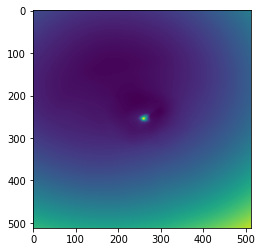

epoch 59001: 48.015419006347656
epoch 59002: 47.932518005371094
epoch 59003: 47.49024200439453
epoch 59004: 48.09852981567383
epoch 59005: 47.31243133544922
epoch 59006: 48.554046630859375
epoch 59007: 47.64359664916992
epoch 59008: 48.324275970458984
epoch 59009: 47.456459045410156
epoch 59011: 48.19468307495117
epoch 59012: 48.03616714477539
epoch 59013: 47.68365478515625
epoch 59014: 48.91407775878906
epoch 59015: 47.83428192138672
epoch 59016: 48.245887756347656
epoch 59017: 48.105384826660156
epoch 59018: 48.30012130737305
epoch 59019: 49.602046966552734
epoch 59021: 49.10115432739258
epoch 59022: 48.594764709472656
epoch 59023: 48.80512237548828
epoch 59024: 47.994415283203125
epoch 59025: 48.9390869140625
epoch 59026: 47.680580139160156
epoch 59027: 48.0308723449707
epoch 59028: 47.32883834838867
epoch 59029: 48.08672332763672
epoch 59031: 48.47499465942383
epoch 59032: 47.30551528930664
epoch 59033: 49.09490203857422
epoch 59034: 49.10660171508789
epoch 59035: 48.29069519042969

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



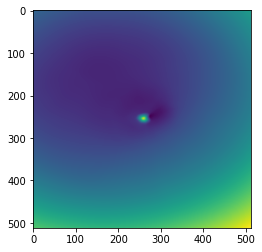

epoch 59101: 48.889793395996094
epoch 59102: 48.91065979003906
epoch 59103: 47.61955261230469
epoch 59104: 47.9567756652832
epoch 59105: 48.013092041015625
epoch 59106: 46.968406677246094
epoch 59107: 48.41365432739258
epoch 59108: 49.18088150024414
epoch 59109: 47.979408264160156
epoch 59111: 48.093910217285156
epoch 59112: 48.334224700927734
epoch 59113: 48.56087875366211
epoch 59114: 47.54068374633789
epoch 59115: 47.91268539428711
epoch 59116: 47.705833435058594
epoch 59117: 47.43553161621094
epoch 59118: 49.024871826171875
epoch 59119: 48.68001174926758
epoch 59121: 48.19572830200195
epoch 59122: 48.63502502441406
epoch 59123: 48.607200622558594
epoch 59124: 49.05558776855469
epoch 59125: 47.586490631103516
epoch 59126: 47.7491455078125
epoch 59127: 48.965171813964844
epoch 59128: 48.04605484008789
epoch 59129: 48.218482971191406
epoch 59131: 48.12034606933594
epoch 59132: 47.93523406982422
epoch 59133: 47.911102294921875
epoch 59134: 48.359127044677734
epoch 59135: 49.12897872924

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



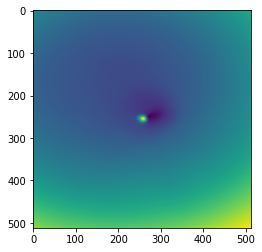

epoch 59201: 49.026947021484375
epoch 59202: 48.18687438964844
epoch 59203: 49.20054626464844
epoch 59204: 48.125972747802734
epoch 59205: 48.07402801513672
epoch 59206: 49.032073974609375
epoch 59207: 48.04230499267578
epoch 59208: 47.76683044433594
epoch 59209: 48.48586654663086
epoch 59211: 48.03593826293945
epoch 59212: 47.282142639160156
epoch 59213: 47.771461486816406
epoch 59214: 47.91400146484375
epoch 59215: 47.692317962646484
epoch 59216: 48.381507873535156
epoch 59217: 47.7127799987793
epoch 59218: 48.217742919921875
epoch 59219: 48.17287063598633
epoch 59221: 48.10763931274414
epoch 59222: 48.220516204833984
epoch 59223: 47.52233123779297
epoch 59224: 48.26441192626953
epoch 59225: 48.51804733276367
epoch 59226: 47.7764892578125
epoch 59227: 48.34722900390625
epoch 59228: 47.86613464355469
epoch 59229: 49.31303024291992
epoch 59231: 48.065574645996094
epoch 59232: 46.93798828125
epoch 59233: 47.25104522705078
epoch 59234: 47.68224334716797
epoch 59235: 47.791194915771484
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



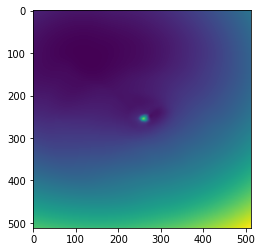

epoch 59301: 48.08867263793945
epoch 59302: 48.288978576660156
epoch 59303: 48.501869201660156
epoch 59304: 49.08384323120117
epoch 59305: 48.287940979003906
epoch 59306: 48.43590545654297
epoch 59307: 47.423397064208984
epoch 59308: 48.658199310302734
epoch 59309: 49.994632720947266
epoch 59311: 48.249752044677734
epoch 59312: 49.51329040527344
epoch 59313: 47.959449768066406
epoch 59314: 49.20204162597656
epoch 59315: 48.966941833496094
epoch 59316: 48.19784164428711
epoch 59317: 48.153594970703125
epoch 59318: 49.95150375366211
epoch 59319: 48.447967529296875
epoch 59321: 48.2269401550293
epoch 59322: 47.976924896240234
epoch 59323: 47.68280029296875
epoch 59324: 48.1279182434082
epoch 59325: 48.66612243652344
epoch 59326: 48.12220764160156
epoch 59327: 48.166236877441406
epoch 59328: 48.90976333618164
epoch 59329: 47.95903778076172
epoch 59331: 48.9451904296875
epoch 59332: 48.5316276550293
epoch 59333: 47.81502914428711
epoch 59334: 48.69754409790039
epoch 59335: 47.20530700683594

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



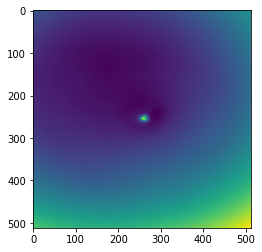

epoch 59401: 48.084373474121094
epoch 59402: 47.03418731689453
epoch 59403: 48.205867767333984
epoch 59404: 47.902976989746094
epoch 59405: 46.904991149902344
epoch 59406: 48.391563415527344
epoch 59407: 47.93545150756836
epoch 59408: 47.369747161865234
epoch 59409: 47.79051208496094
epoch 59411: 47.63506317138672
epoch 59412: 48.36484146118164
epoch 59413: 48.18840408325195
epoch 59414: 47.952762603759766
epoch 59415: 47.36973190307617
epoch 59416: 48.51438903808594
epoch 59417: 47.770545959472656
epoch 59418: 48.50861740112305
epoch 59419: 48.05889892578125
epoch 59421: 48.02600860595703
epoch 59422: 47.499454498291016
epoch 59423: 49.13500213623047
epoch 59424: 47.933841705322266
epoch 59425: 47.5546989440918
epoch 59426: 50.01253890991211
epoch 59427: 47.8759765625
epoch 59428: 48.34611892700195
epoch 59429: 47.802947998046875
epoch 59431: 48.538333892822266
epoch 59432: 49.3223876953125
epoch 59433: 48.375205993652344
epoch 59434: 48.14564514160156
epoch 59435: 47.67966842651367
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



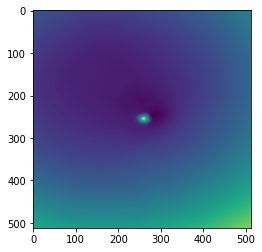

epoch 59501: 47.77342224121094
epoch 59502: 48.06803512573242
epoch 59503: 47.95204544067383
epoch 59504: 47.629276275634766
epoch 59505: 48.91419982910156
epoch 59506: 47.61264419555664
epoch 59507: 48.31086730957031
epoch 59508: 47.15458297729492
epoch 59509: 48.50304412841797
epoch 59511: 48.32573318481445
epoch 59512: 48.249244689941406
epoch 59513: 47.565303802490234
epoch 59514: 48.703697204589844
epoch 59515: 48.123966217041016
epoch 59516: 49.284942626953125
epoch 59517: 47.99305725097656
epoch 59518: 48.30216979980469
epoch 59519: 48.29963684082031
epoch 59521: 48.59171676635742
epoch 59522: 48.588111877441406
epoch 59523: 47.6241455078125
epoch 59524: 47.53834533691406
epoch 59525: 48.47239685058594
epoch 59526: 48.785400390625
epoch 59527: 47.63186264038086
epoch 59528: 48.20184326171875
epoch 59529: 48.0496826171875
epoch 59531: 48.87437438964844
epoch 59532: 48.769474029541016
epoch 59533: 48.95082473754883
epoch 59534: 47.6442985534668
epoch 59535: 48.187808990478516
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



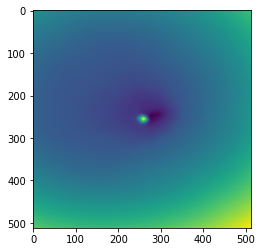

epoch 59601: 47.878936767578125
epoch 59602: 48.30441665649414
epoch 59603: 48.09703063964844
epoch 59604: 48.11168670654297
epoch 59605: 49.083587646484375
epoch 59606: 48.1834716796875
epoch 59607: 47.18166732788086
epoch 59608: 47.86140060424805
epoch 59609: 47.845458984375
epoch 59611: 48.900123596191406
epoch 59612: 48.5496711730957
epoch 59613: 48.19216537475586
epoch 59614: 48.980709075927734
epoch 59615: 48.152587890625
epoch 59616: 47.379119873046875
epoch 59617: 47.35569763183594
epoch 59618: 48.05889892578125
epoch 59619: 48.10357666015625
epoch 59621: 47.60580062866211
epoch 59622: 47.47137451171875
epoch 59623: 48.76215362548828
epoch 59624: 47.45737838745117
epoch 59625: 49.09765625
epoch 59626: 47.842369079589844
epoch 59627: 47.648719787597656
epoch 59628: 47.97040557861328
epoch 59629: 48.409114837646484
epoch 59631: 48.34834289550781
epoch 59632: 48.04729461669922
epoch 59633: 48.01606750488281
epoch 59634: 48.31144332885742
epoch 59635: 48.29668426513672
epoch 59636:

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



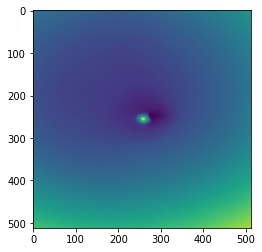

epoch 59701: 47.64698791503906
epoch 59702: 47.60861587524414
epoch 59703: 47.86810302734375
epoch 59704: 48.06220245361328
epoch 59705: 47.65733337402344
epoch 59706: 47.08384704589844
epoch 59707: 47.64387512207031
epoch 59708: 49.939090728759766
epoch 59709: 48.014739990234375
epoch 59711: 48.15991973876953
epoch 59712: 48.10732650756836
epoch 59713: 47.98345947265625
epoch 59714: 47.313629150390625
epoch 59715: 49.12202072143555
epoch 59716: 47.98094940185547
epoch 59717: 49.48286056518555
epoch 59718: 48.18722152709961
epoch 59719: 47.68620681762695
epoch 59721: 48.2652473449707
epoch 59722: 48.73018264770508
epoch 59723: 50.81855392456055
epoch 59724: 48.07368850708008
epoch 59725: 47.96604537963867
epoch 59726: 49.50587844848633
epoch 59727: 48.287715911865234
epoch 59728: 47.987667083740234
epoch 59729: 49.437110900878906
epoch 59731: 48.81842803955078
epoch 59732: 47.77111053466797
epoch 59733: 47.38297653198242
epoch 59734: 49.39619064331055
epoch 59735: 48.49542999267578
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



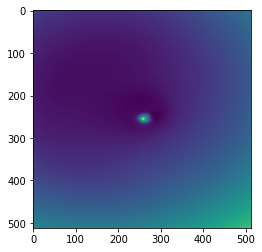

epoch 59801: 47.633079528808594
epoch 59802: 49.58840560913086
epoch 59803: 48.87168502807617
epoch 59804: 47.924560546875
epoch 59805: 47.602508544921875
epoch 59806: 47.74376678466797
epoch 59807: 47.623565673828125
epoch 59808: 48.286949157714844
epoch 59809: 48.05944061279297
epoch 59811: 47.96930694580078
epoch 59812: 47.678749084472656
epoch 59813: 47.85730743408203
epoch 59814: 47.6630973815918
epoch 59815: 47.59122848510742
epoch 59816: 47.89081954956055
epoch 59817: 47.546138763427734
epoch 59818: 48.706626892089844
epoch 59819: 48.2805290222168
epoch 59821: 47.44187545776367
epoch 59822: 49.27172088623047
epoch 59823: 47.67599868774414
epoch 59824: 47.73212814331055
epoch 59825: 47.85525894165039
epoch 59826: 48.17402267456055
epoch 59827: 48.857948303222656
epoch 59828: 48.3277587890625
epoch 59829: 48.08222198486328
epoch 59831: 50.21329879760742
epoch 59832: 50.9405517578125
epoch 59833: 47.77312469482422
epoch 59834: 47.95481491088867
epoch 59835: 47.29450607299805
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



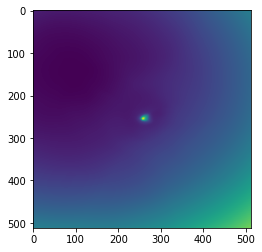

epoch 59901: 49.51920700073242
epoch 59902: 48.5164680480957
epoch 59903: 48.412071228027344
epoch 59904: 48.36510467529297
epoch 59905: 49.21923065185547
epoch 59906: 48.99177932739258
epoch 59907: 48.62638854980469
epoch 59908: 48.37686538696289
epoch 59909: 48.265098571777344
epoch 59911: 48.71141052246094
epoch 59912: 48.40650939941406
epoch 59913: 48.30811309814453
epoch 59914: 48.88051223754883
epoch 59915: 48.91061019897461
epoch 59916: 48.362548828125
epoch 59917: 48.861595153808594
epoch 59918: 48.87950134277344
epoch 59919: 48.57389831542969
epoch 59921: 48.548160552978516
epoch 59922: 48.447200775146484
epoch 59923: 47.963558197021484
epoch 59924: 47.8430061340332
epoch 59925: 48.15987014770508
epoch 59926: 47.64711380004883
epoch 59927: 50.00474548339844
epoch 59928: 48.49384689331055
epoch 59929: 48.703636169433594
epoch 59931: 48.59879684448242
epoch 59932: 48.18574523925781
epoch 59933: 51.54833221435547
epoch 59934: 48.60185623168945
epoch 59935: 47.84952926635742
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



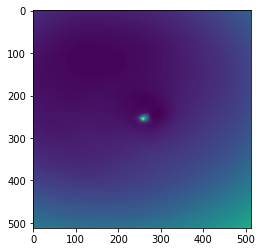

epoch 60001: 48.632118225097656
epoch 60002: 47.714447021484375
epoch 60003: 47.15143966674805
epoch 60004: 48.39405059814453
epoch 60005: 47.41279602050781
epoch 60006: 48.44456100463867
epoch 60007: 48.335227966308594
epoch 60008: 48.58332443237305
epoch 60009: 48.063777923583984
epoch 60011: 47.367427825927734
epoch 60012: 48.25968933105469
epoch 60013: 47.64896774291992
epoch 60014: 48.6041374206543
epoch 60015: 48.23493576049805
epoch 60016: 48.764015197753906
epoch 60017: 47.68425369262695
epoch 60018: 47.97285079956055
epoch 60019: 48.03171920776367
epoch 60021: 47.43120574951172
epoch 60022: 47.49379348754883
epoch 60023: 47.785850524902344
epoch 60024: 48.10926818847656
epoch 60025: 48.14584732055664
epoch 60026: 48.378196716308594
epoch 60027: 48.45619583129883
epoch 60028: 48.458438873291016
epoch 60029: 47.801937103271484
epoch 60031: 49.02865982055664
epoch 60032: 49.6048698425293
epoch 60033: 48.07080078125
epoch 60034: 47.63306427001953
epoch 60035: 47.64386749267578
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



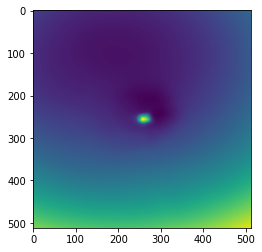

epoch 60101: 48.094356536865234
epoch 60102: 48.58262634277344
epoch 60103: 47.57793426513672
epoch 60104: 49.26154708862305
epoch 60105: 48.271915435791016
epoch 60106: 48.40830612182617
epoch 60107: 48.1536750793457
epoch 60108: 48.23994445800781
epoch 60109: 47.67652130126953
epoch 60111: 48.22434616088867
epoch 60112: 48.50483703613281
epoch 60113: 47.95515441894531
epoch 60114: 48.40647506713867
epoch 60115: 48.253658294677734
epoch 60116: 48.04483413696289
epoch 60117: 47.62260437011719
epoch 60118: 47.94554901123047
epoch 60119: 48.27900314331055
epoch 60121: 48.235050201416016
epoch 60122: 49.54949951171875
epoch 60123: 48.36937713623047
epoch 60124: 48.47119140625
epoch 60125: 48.499725341796875
epoch 60126: 48.751495361328125
epoch 60127: 48.78948211669922
epoch 60128: 48.01160430908203
epoch 60129: 49.085296630859375
epoch 60131: 48.20138931274414
epoch 60132: 48.56953811645508
epoch 60133: 47.995216369628906
epoch 60134: 47.727760314941406
epoch 60135: 47.76609802246094
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



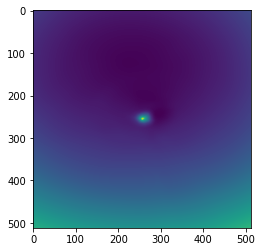

epoch 60201: 47.583961486816406
epoch 60202: 48.65251922607422
epoch 60203: 48.60535430908203
epoch 60204: 48.473175048828125
epoch 60205: 47.980003356933594
epoch 60206: 48.33134078979492
epoch 60207: 48.218040466308594
epoch 60208: 48.72730255126953
epoch 60209: 49.03253936767578
epoch 60211: 47.872650146484375
epoch 60212: 47.363563537597656
epoch 60213: 48.05820846557617
epoch 60214: 48.26860046386719
epoch 60215: 48.39185333251953
epoch 60216: 48.30255889892578
epoch 60217: 48.241966247558594
epoch 60218: 48.5495491027832
epoch 60219: 48.132686614990234
epoch 60221: 47.78019332885742
epoch 60222: 48.14192199707031
epoch 60223: 47.52861022949219
epoch 60224: 49.001861572265625
epoch 60225: 47.85008239746094
epoch 60226: 48.09495544433594
epoch 60227: 47.98393630981445
epoch 60228: 48.141876220703125
epoch 60229: 48.56135177612305
epoch 60231: 48.18943786621094
epoch 60232: 49.664825439453125
epoch 60233: 48.13949966430664
epoch 60234: 48.10834503173828
epoch 60235: 48.0974006652832

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



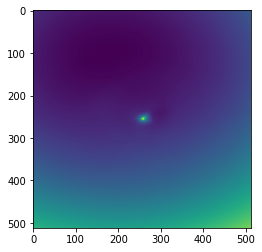

epoch 60301: 48.28080749511719
epoch 60302: 47.429569244384766
epoch 60303: 48.40644073486328
epoch 60304: 47.70359420776367
epoch 60305: 48.09347152709961
epoch 60306: 48.61326217651367
epoch 60307: 48.349361419677734
epoch 60308: 48.12084197998047
epoch 60309: 46.683223724365234
epoch 60311: 47.21534729003906
epoch 60312: 47.71735763549805
epoch 60313: 47.16716003417969
epoch 60314: 47.66303634643555
epoch 60315: 47.232276916503906
epoch 60316: 48.63106155395508
epoch 60317: 47.745059967041016
epoch 60318: 47.43821716308594
epoch 60319: 48.402442932128906
epoch 60321: 47.83717727661133
epoch 60322: 47.87971115112305
epoch 60323: 48.12632369995117
epoch 60324: 48.53679656982422
epoch 60325: 50.141624450683594
epoch 60326: 47.26023483276367
epoch 60327: 48.02924728393555
epoch 60328: 47.517372131347656
epoch 60329: 47.65851593017578
epoch 60331: 47.86759948730469
epoch 60332: 48.850555419921875
epoch 60333: 48.500892639160156
epoch 60334: 47.99580001831055
epoch 60335: 48.1701889038085

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



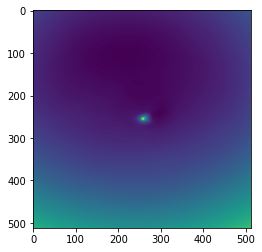

epoch 60401: 47.70240783691406
epoch 60402: 47.181095123291016
epoch 60403: 47.979427337646484
epoch 60404: 48.405555725097656
epoch 60405: 47.742305755615234
epoch 60406: 48.52141189575195
epoch 60407: 48.170204162597656
epoch 60408: 47.99684143066406
epoch 60409: 47.4659309387207
epoch 60411: 47.879852294921875
epoch 60412: 48.6602668762207
epoch 60413: 48.07843017578125
epoch 60414: 48.750240325927734
epoch 60415: 47.709197998046875
epoch 60416: 47.825523376464844
epoch 60417: 48.291282653808594
epoch 60418: 47.80022430419922
epoch 60419: 48.225555419921875
epoch 60421: 47.51659393310547
epoch 60422: 47.99362564086914
epoch 60423: 47.399269104003906
epoch 60424: 47.79289627075195
epoch 60425: 47.34592056274414
epoch 60426: 47.72093200683594
epoch 60427: 48.853126525878906
epoch 60428: 48.688865661621094
epoch 60429: 47.759822845458984
epoch 60431: 48.01862335205078
epoch 60432: 47.96653747558594
epoch 60433: 48.181148529052734
epoch 60434: 48.502037048339844
epoch 60435: 48.70052719

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



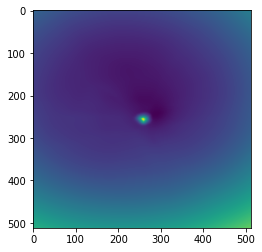

epoch 60501: 48.09156036376953
epoch 60502: 47.47299575805664
epoch 60503: 47.45334243774414
epoch 60504: 48.17546463012695
epoch 60505: 48.268150329589844
epoch 60506: 47.90648651123047
epoch 60507: 47.594268798828125
epoch 60508: 47.92708969116211
epoch 60509: 49.307552337646484
epoch 60511: 48.04424285888672
epoch 60512: 47.42737579345703
epoch 60513: 47.631263732910156
epoch 60514: 48.2284049987793
epoch 60515: 46.95841979980469
epoch 60516: 48.24172592163086
epoch 60517: 48.69215393066406
epoch 60518: 47.86298370361328
epoch 60519: 47.94936752319336
epoch 60521: 47.381675720214844
epoch 60522: 47.519474029541016
epoch 60523: 48.2205810546875
epoch 60524: 47.50459289550781
epoch 60525: 48.320579528808594
epoch 60526: 47.485740661621094
epoch 60527: 47.354713439941406
epoch 60528: 47.76070022583008
epoch 60529: 47.33735656738281
epoch 60531: 47.709266662597656
epoch 60532: 48.13239669799805
epoch 60533: 47.69462966918945
epoch 60534: 48.61252212524414
epoch 60535: 48.73371505737305


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



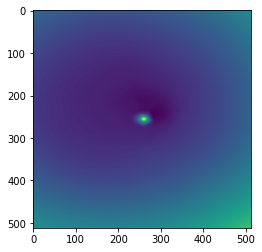

epoch 60601: 48.46629333496094
epoch 60602: 48.149208068847656
epoch 60603: 48.72271728515625
epoch 60604: 48.82851028442383
epoch 60605: 47.69740676879883
epoch 60606: 48.723392486572266
epoch 60607: 47.83559036254883
epoch 60608: 47.69321060180664
epoch 60609: 49.7144889831543
epoch 60611: 47.92534255981445
epoch 60612: 49.524986267089844
epoch 60613: 48.50334548950195
epoch 60614: 48.18590545654297
epoch 60615: 48.08231735229492
epoch 60616: 48.456050872802734
epoch 60617: 48.55866622924805
epoch 60618: 47.7647819519043
epoch 60619: 47.899322509765625
epoch 60621: 48.03028106689453
epoch 60622: 48.19022750854492
epoch 60623: 47.92869567871094
epoch 60624: 48.18616485595703
epoch 60625: 48.26813507080078
epoch 60626: 48.003414154052734
epoch 60627: 48.46296691894531
epoch 60628: 48.0506706237793
epoch 60629: 48.21733474731445
epoch 60631: 48.05495071411133
epoch 60632: 47.89674758911133
epoch 60633: 47.525115966796875
epoch 60634: 49.71400451660156
epoch 60635: 48.956443786621094
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



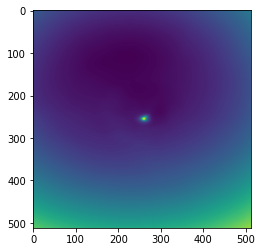

epoch 60701: 48.90181350708008
epoch 60702: 48.087562561035156
epoch 60703: 49.028656005859375
epoch 60704: 47.875144958496094
epoch 60705: 48.375831604003906
epoch 60706: 48.76796340942383
epoch 60707: 48.52873992919922
epoch 60708: 48.157352447509766
epoch 60709: 48.134891510009766
epoch 60711: 48.04521179199219
epoch 60712: 47.82310485839844
epoch 60713: 47.626102447509766
epoch 60714: 48.29042053222656
epoch 60715: 47.962745666503906
epoch 60716: 48.356285095214844
epoch 60717: 49.39174270629883
epoch 60718: 48.17607879638672
epoch 60719: 48.505027770996094
epoch 60721: 48.11122131347656
epoch 60722: 48.31028747558594
epoch 60723: 48.403202056884766
epoch 60724: 48.342628479003906
epoch 60725: 48.29001998901367
epoch 60726: 48.7886848449707
epoch 60727: 48.71050262451172
epoch 60728: 48.20872497558594
epoch 60729: 48.56230163574219
epoch 60731: 48.49192428588867
epoch 60732: 48.45215606689453
epoch 60733: 48.413822174072266
epoch 60734: 48.474456787109375
epoch 60735: 48.4608955383

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



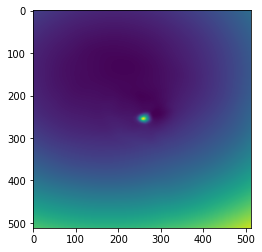

epoch 60801: 48.20523452758789
epoch 60802: 48.279842376708984
epoch 60803: 48.089351654052734
epoch 60804: 47.7296028137207
epoch 60805: 47.90549850463867
epoch 60806: 48.28440856933594
epoch 60807: 48.18048095703125
epoch 60808: 47.87599563598633
epoch 60809: 47.79969024658203
epoch 60811: 47.928138732910156
epoch 60812: 47.354713439941406
epoch 60813: 48.72992706298828
epoch 60814: 48.29594421386719
epoch 60815: 48.202232360839844
epoch 60816: 47.70634460449219
epoch 60817: 49.2443733215332
epoch 60818: 47.38327407836914
epoch 60819: 49.09708023071289
epoch 60821: 48.64603805541992
epoch 60822: 48.3903694152832
epoch 60823: 48.04557418823242
epoch 60824: 47.98988723754883
epoch 60825: 47.99772644042969
epoch 60826: 47.90471267700195
epoch 60827: 48.18281173706055
epoch 60828: 48.649654388427734
epoch 60829: 48.50394058227539
epoch 60831: 49.18968963623047
epoch 60832: 48.69203186035156
epoch 60833: 47.319095611572266
epoch 60834: 50.04829788208008
epoch 60835: 48.9274787902832
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



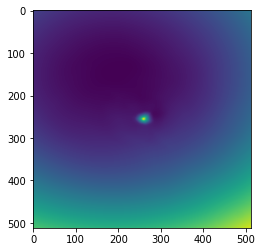

epoch 60901: 47.60979080200195
epoch 60902: 47.7223014831543
epoch 60903: 47.994327545166016
epoch 60904: 48.87272644042969
epoch 60905: 48.400718688964844
epoch 60906: 47.99177169799805
epoch 60907: 48.39767837524414
epoch 60908: 48.12263107299805
epoch 60909: 47.727325439453125
epoch 60911: 47.896522521972656
epoch 60912: 48.721290588378906
epoch 60913: 48.17424392700195
epoch 60914: 48.23405075073242
epoch 60915: 48.70597457885742
epoch 60916: 48.098907470703125
epoch 60917: 47.77840805053711
epoch 60918: 48.27704620361328
epoch 60919: 47.57369613647461
epoch 60921: 47.81556701660156
epoch 60922: 48.29605484008789
epoch 60923: 49.22882080078125
epoch 60924: 47.809974670410156
epoch 60925: 48.25386428833008
epoch 60926: 48.35919952392578
epoch 60927: 48.48272705078125
epoch 60928: 47.7486457824707
epoch 60929: 47.47593307495117
epoch 60931: 47.833866119384766
epoch 60932: 47.16500473022461
epoch 60933: 47.76519775390625
epoch 60934: 47.45724105834961
epoch 60935: 47.836517333984375
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



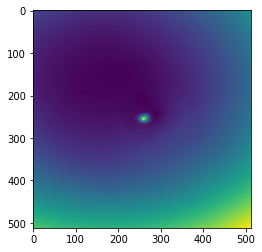

epoch 61001: 47.69971466064453
epoch 61002: 47.31608200073242
epoch 61003: 47.465301513671875
epoch 61004: 52.531986236572266
epoch 61005: 47.92068099975586
epoch 61006: 47.47063446044922
epoch 61007: 48.646183013916016
epoch 61008: 47.88389587402344
epoch 61009: 48.7078742980957
epoch 61011: 48.93932342529297
epoch 61012: 48.257904052734375
epoch 61013: 47.66273880004883
epoch 61014: 48.718666076660156
epoch 61015: 48.15331268310547
epoch 61016: 47.9028205871582
epoch 61017: 47.890472412109375
epoch 61018: 49.126121520996094
epoch 61019: 47.70860290527344
epoch 61021: 48.164249420166016
epoch 61022: 47.47752380371094
epoch 61023: 49.01447677612305
epoch 61024: 47.93218994140625
epoch 61025: 47.936134338378906
epoch 61026: 48.32436752319336
epoch 61027: 48.70631408691406
epoch 61028: 48.14463806152344
epoch 61029: 47.56394958496094
epoch 61031: 48.45340347290039
epoch 61032: 47.83686447143555
epoch 61033: 48.839725494384766
epoch 61034: 47.839351654052734
epoch 61035: 48.51029586791992

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



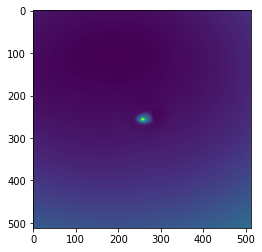

epoch 61101: 48.62282180786133
epoch 61102: 47.74198913574219
epoch 61103: 48.37688446044922
epoch 61104: 49.07094955444336
epoch 61105: 48.808685302734375
epoch 61106: 47.614200592041016
epoch 61107: 48.71013259887695
epoch 61108: 48.33485412597656
epoch 61109: 48.20484924316406
epoch 61111: 47.51014709472656
epoch 61112: 48.57301712036133
epoch 61113: 48.852779388427734
epoch 61114: 48.894412994384766
epoch 61115: 48.30215835571289
epoch 61116: 47.72188186645508
epoch 61117: 48.62635040283203
epoch 61118: 48.015323638916016
epoch 61119: 48.528343200683594
epoch 61121: 49.26296615600586
epoch 61122: 48.542724609375
epoch 61123: 48.266578674316406
epoch 61124: 48.8681526184082
epoch 61125: 48.27178192138672
epoch 61126: 48.15318298339844
epoch 61127: 48.10794448852539
epoch 61128: 48.41487121582031
epoch 61129: 48.596885681152344
epoch 61131: 48.426265716552734
epoch 61132: 49.12254333496094
epoch 61133: 47.747947692871094
epoch 61134: 48.001251220703125
epoch 61135: 48.265445709228516

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



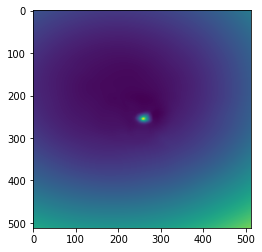

epoch 61201: 48.68290328979492
epoch 61202: 47.4887580871582
epoch 61203: 49.07754898071289
epoch 61204: 47.5582160949707
epoch 61205: 48.406402587890625
epoch 61206: 48.19921875
epoch 61207: 47.54546356201172
epoch 61208: 48.3736457824707
epoch 61209: 47.825294494628906
epoch 61211: 48.77426528930664
epoch 61212: 48.569480895996094
epoch 61213: 48.57097244262695
epoch 61214: 48.40949249267578
epoch 61215: 47.61796188354492
epoch 61216: 47.752471923828125
epoch 61217: 47.614471435546875
epoch 61218: 47.46748352050781
epoch 61219: 47.91312026977539
epoch 61221: 48.01917266845703
epoch 61222: 48.80718231201172
epoch 61223: 49.31644821166992
epoch 61224: 48.45747375488281
epoch 61225: 47.548011779785156
epoch 61226: 47.89103317260742
epoch 61227: 48.491905212402344
epoch 61228: 49.24748611450195
epoch 61229: 50.78716278076172
epoch 61231: 47.62096405029297
epoch 61232: 47.60384750366211
epoch 61233: 47.30945587158203
epoch 61234: 48.38136672973633
epoch 61235: 47.393714904785156
epoch 612

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



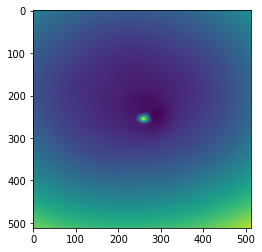

epoch 61301: 48.96623229980469
epoch 61302: 47.31182861328125
epoch 61303: 47.51121520996094
epoch 61304: 47.50157165527344
epoch 61305: 48.364566802978516
epoch 61306: 49.28343963623047
epoch 61307: 48.27473449707031
epoch 61308: 48.831729888916016
epoch 61309: 48.59407424926758
epoch 61311: 48.624969482421875
epoch 61312: 47.89196014404297
epoch 61313: 48.60709762573242
epoch 61314: 48.931026458740234
epoch 61315: 48.19483947753906
epoch 61316: 48.731712341308594
epoch 61317: 48.563011169433594
epoch 61318: 48.39697265625
epoch 61319: 47.83036804199219
epoch 61321: 47.16825485229492
epoch 61322: 47.26251983642578
epoch 61323: 48.39360427856445
epoch 61324: 47.58600997924805
epoch 61325: 48.25599670410156
epoch 61326: 47.83326721191406
epoch 61327: 47.9326057434082
epoch 61328: 47.674827575683594
epoch 61329: 47.55466842651367
epoch 61331: 47.16083526611328
epoch 61332: 48.51535415649414
epoch 61333: 47.610618591308594
epoch 61334: 48.3607292175293
epoch 61335: 47.61920928955078
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



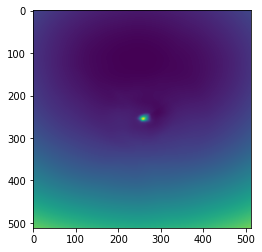

epoch 61401: 48.36776351928711
epoch 61402: 48.174842834472656
epoch 61403: 49.22642517089844
epoch 61404: 48.65850830078125
epoch 61405: 48.31409454345703
epoch 61406: 48.129913330078125
epoch 61407: 47.83197784423828
epoch 61408: 48.6890983581543
epoch 61409: 48.05668640136719
epoch 61411: 48.54637145996094
epoch 61412: 48.77275085449219
epoch 61413: 47.36924362182617
epoch 61414: 48.66145324707031
epoch 61415: 47.751747131347656
epoch 61416: 47.77338409423828
epoch 61417: 47.88465118408203
epoch 61418: 47.7497673034668
epoch 61419: 48.78563690185547
epoch 61421: 48.46354675292969
epoch 61422: 48.18325424194336
epoch 61423: 48.29535675048828
epoch 61424: 48.93069839477539
epoch 61425: 48.187774658203125
epoch 61426: 48.15117263793945
epoch 61427: 47.79248046875
epoch 61428: 48.00106430053711
epoch 61429: 48.12086486816406
epoch 61431: 48.16985321044922
epoch 61432: 48.2568473815918
epoch 61433: 47.80692672729492
epoch 61434: 47.44137191772461
epoch 61435: 48.53091049194336
epoch 6143

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



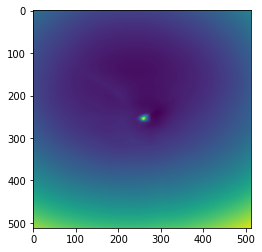

epoch 61501: 48.435604095458984
epoch 61502: 48.2511100769043
epoch 61503: 48.12761688232422
epoch 61504: 48.10084533691406
epoch 61505: 48.58695602416992
epoch 61506: 47.9002571105957
epoch 61507: 50.86020278930664
epoch 61508: 47.807865142822266
epoch 61509: 47.534908294677734
epoch 61511: 48.079681396484375
epoch 61512: 47.933929443359375
epoch 61513: 47.92825698852539
epoch 61514: 47.581581115722656
epoch 61515: 48.67913818359375
epoch 61516: 47.868595123291016
epoch 61517: 47.821044921875
epoch 61518: 47.990257263183594
epoch 61519: 47.88725280761719
epoch 61521: 47.23176574707031
epoch 61522: 47.98702621459961
epoch 61523: 48.15597152709961
epoch 61524: 47.82386779785156
epoch 61525: 48.26082229614258
epoch 61526: 47.75221252441406
epoch 61527: 48.844337463378906
epoch 61528: 47.77211380004883
epoch 61529: 48.29322052001953
epoch 61531: 48.24884796142578
epoch 61532: 47.71720886230469
epoch 61533: 47.509620666503906
epoch 61534: 48.82445526123047
epoch 61535: 49.29570007324219
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



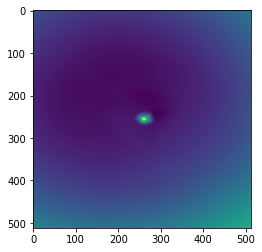

epoch 61601: 47.65290832519531
epoch 61602: 47.44829177856445
epoch 61603: 47.60127258300781
epoch 61604: 49.17972183227539
epoch 61605: 48.88911437988281
epoch 61606: 47.8757209777832
epoch 61607: 48.725914001464844
epoch 61608: 47.916412353515625
epoch 61609: 47.6398811340332
epoch 61611: 48.8449821472168
epoch 61612: 48.05724334716797
epoch 61613: 47.60544967651367
epoch 61614: 47.44416427612305
epoch 61615: 48.09230422973633
epoch 61616: 47.6008415222168
epoch 61617: 48.52984619140625
epoch 61618: 48.55220413208008
epoch 61619: 47.81559753417969
epoch 61621: 47.576316833496094
epoch 61622: 48.202728271484375
epoch 61623: 47.493812561035156
epoch 61624: 47.72906494140625
epoch 61625: 48.70161819458008
epoch 61626: 48.243309020996094
epoch 61627: 47.79875564575195
epoch 61628: 48.32579040527344
epoch 61629: 48.0676155090332
epoch 61631: 48.23239517211914
epoch 61632: 47.69755172729492
epoch 61633: 47.58879089355469
epoch 61634: 47.59519958496094
epoch 61635: 47.57401657104492
epoch 6

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



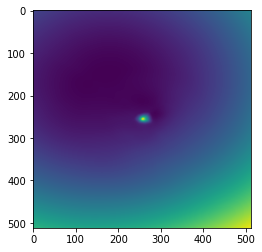

epoch 61701: 47.64734649658203
epoch 61702: 47.1818962097168
epoch 61703: 47.4759407043457
epoch 61704: 47.28949737548828
epoch 61705: 47.88092803955078
epoch 61706: 50.786190032958984
epoch 61707: 47.599796295166016
epoch 61708: 47.826385498046875
epoch 61709: 48.93745040893555
epoch 61711: 47.6219482421875
epoch 61712: 48.338069915771484
epoch 61713: 48.767250061035156
epoch 61714: 47.310604095458984
epoch 61715: 48.46661376953125
epoch 61716: 48.79411697387695
epoch 61717: 48.53858184814453
epoch 61718: 48.036773681640625
epoch 61719: 47.653690338134766
epoch 61721: 47.439720153808594
epoch 61722: 47.715431213378906
epoch 61723: 48.00193786621094
epoch 61724: 47.478271484375
epoch 61725: 48.078128814697266
epoch 61726: 47.567100524902344
epoch 61727: 47.98673629760742
epoch 61728: 48.25811767578125
epoch 61729: 47.074798583984375
epoch 61731: 48.23699951171875
epoch 61732: 48.40264129638672
epoch 61733: 48.57786560058594
epoch 61734: 47.93649673461914
epoch 61735: 48.04180145263672


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



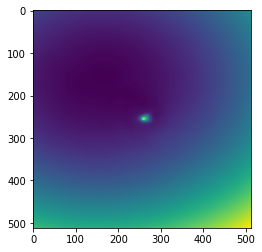

epoch 61801: 47.96456527709961
epoch 61802: 49.39394760131836
epoch 61803: 47.6313362121582
epoch 61804: 47.6342658996582
epoch 61805: 48.25444030761719
epoch 61806: 47.34047317504883
epoch 61807: 48.404258728027344
epoch 61808: 47.896697998046875
epoch 61809: 47.414894104003906
epoch 61811: 49.751651763916016
epoch 61812: 47.19941329956055
epoch 61813: 48.34287643432617
epoch 61814: 48.02581024169922
epoch 61815: 47.21182632446289
epoch 61816: 48.384334564208984
epoch 61817: 47.93747329711914
epoch 61818: 47.78200912475586
epoch 61819: 50.55200958251953
epoch 61821: 48.91517639160156
epoch 61822: 48.5094108581543
epoch 61823: 49.26097869873047
epoch 61824: 48.577396392822266
epoch 61825: 49.12013244628906
epoch 61826: 47.67109298706055
epoch 61827: 48.65610122680664
epoch 61828: 49.04973602294922
epoch 61829: 47.15583801269531
epoch 61831: 48.32592010498047
epoch 61832: 48.279476165771484
epoch 61833: 49.22975540161133
epoch 61834: 48.06806945800781
epoch 61835: 48.001686096191406
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



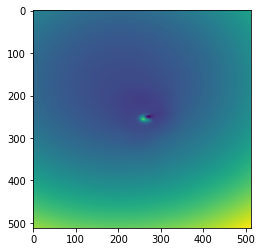

epoch 61901: 47.65873718261719
epoch 61902: 47.65910339355469
epoch 61903: 49.01124572753906
epoch 61904: 47.909385681152344
epoch 61905: 49.16225814819336
epoch 61906: 48.899513244628906
epoch 61907: 48.54496765136719
epoch 61908: 48.57463836669922
epoch 61909: 48.342262268066406
epoch 61911: 48.9891357421875
epoch 61912: 47.82469940185547
epoch 61913: 48.60505294799805
epoch 61914: 47.870582580566406
epoch 61915: 47.653839111328125
epoch 61916: 48.137664794921875
epoch 61917: 47.887516021728516
epoch 61918: 47.606605529785156
epoch 61919: 47.61758804321289
epoch 61921: 49.43275451660156
epoch 61922: 48.591835021972656
epoch 61923: 48.41019821166992
epoch 61924: 47.71978759765625
epoch 61925: 47.884483337402344
epoch 61926: 48.39775466918945
epoch 61927: 47.91740798950195
epoch 61928: 48.01923751831055
epoch 61929: 48.878536224365234
epoch 61931: 48.561832427978516
epoch 61932: 47.82411575317383
epoch 61933: 47.696651458740234
epoch 61934: 48.65839767456055
epoch 61935: 48.44231033325

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



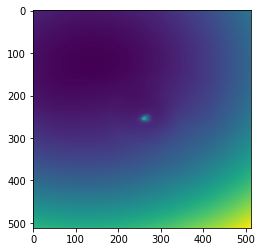

epoch 62001: 48.88728713989258
epoch 62002: 47.54713439941406
epoch 62003: 47.47573471069336
epoch 62004: 48.48614501953125
epoch 62005: 47.88135528564453
epoch 62006: 48.872291564941406
epoch 62007: 48.288368225097656
epoch 62008: 47.41875076293945
epoch 62009: 49.20477294921875
epoch 62011: 47.470603942871094
epoch 62012: 48.83420181274414
epoch 62013: 48.62578201293945
epoch 62014: 47.63874053955078
epoch 62015: 47.85960388183594
epoch 62016: 48.54856491088867
epoch 62017: 48.00218200683594
epoch 62018: 48.4560432434082
epoch 62019: 48.36888885498047
epoch 62021: 47.618011474609375
epoch 62022: 48.09730529785156
epoch 62023: 49.52864074707031
epoch 62024: 48.2821159362793
epoch 62025: 48.32703399658203
epoch 62026: 47.67861557006836
epoch 62027: 47.56973648071289
epoch 62028: 56.26041793823242
epoch 62029: 47.70953369140625
epoch 62031: 47.34847640991211
epoch 62032: 48.671913146972656
epoch 62033: 48.06369400024414
epoch 62034: 49.591896057128906
epoch 62035: 48.27021789550781
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



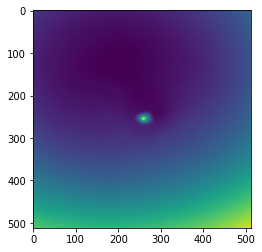

epoch 62101: 48.41506576538086
epoch 62102: 48.16487121582031
epoch 62103: 48.290950775146484
epoch 62104: 47.64678955078125
epoch 62105: 47.8330192565918
epoch 62106: 47.53002166748047
epoch 62107: 48.78303909301758
epoch 62108: 47.744354248046875
epoch 62109: 47.857872009277344
epoch 62111: 48.68760299682617
epoch 62112: 48.450714111328125
epoch 62113: 48.0600700378418
epoch 62114: 48.2412223815918
epoch 62115: 48.527652740478516
epoch 62116: 47.22511291503906
epoch 62117: 48.41886520385742
epoch 62118: 48.45670700073242
epoch 62119: 48.582763671875
epoch 62121: 47.306941986083984
epoch 62122: 48.926422119140625
epoch 62123: 47.761112213134766
epoch 62124: 47.798274993896484
epoch 62125: 48.81014633178711
epoch 62126: 48.08321762084961
epoch 62127: 48.236412048339844
epoch 62128: 47.99090576171875
epoch 62129: 49.51686477661133
epoch 62131: 47.859806060791016
epoch 62132: 47.90482711791992
epoch 62133: 47.95323181152344
epoch 62134: 48.203487396240234
epoch 62135: 47.79634094238281
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



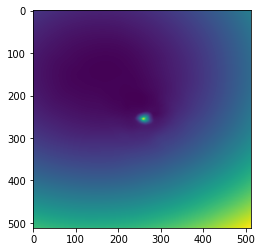

epoch 62201: 48.000099182128906
epoch 62202: 48.49555206298828
epoch 62203: 48.11000442504883
epoch 62204: 48.376529693603516
epoch 62205: 49.222286224365234
epoch 62206: 47.74711608886719
epoch 62207: 47.895729064941406
epoch 62208: 47.4860725402832
epoch 62209: 48.13804626464844
epoch 62211: 48.29092788696289
epoch 62212: 48.60709762573242
epoch 62213: 47.62699890136719
epoch 62214: 47.896156311035156
epoch 62215: 48.4267578125
epoch 62216: 48.79681396484375
epoch 62217: 48.443336486816406
epoch 62218: 47.83208084106445
epoch 62219: 47.440834045410156
epoch 62221: 47.518463134765625
epoch 62222: 49.08313751220703
epoch 62223: 48.65313720703125
epoch 62224: 47.887840270996094
epoch 62225: 47.62955093383789
epoch 62226: 47.92546844482422
epoch 62227: 47.8353157043457
epoch 62228: 47.63564682006836
epoch 62229: 48.32634353637695
epoch 62231: 47.644935607910156
epoch 62232: 48.693233489990234
epoch 62233: 48.99916076660156
epoch 62234: 47.73616409301758
epoch 62235: 47.75517654418945
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



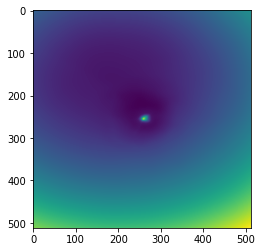

epoch 62301: 47.68598937988281
epoch 62302: 47.73338317871094
epoch 62303: 48.163883209228516
epoch 62304: 48.0025520324707
epoch 62305: 47.69337844848633
epoch 62306: 48.53441619873047
epoch 62307: 47.91560745239258
epoch 62308: 48.61520004272461
epoch 62309: 49.41382598876953
epoch 62311: 47.89085388183594
epoch 62312: 48.80760955810547
epoch 62313: 48.31120681762695
epoch 62314: 48.206443786621094
epoch 62315: 48.508888244628906
epoch 62316: 48.2969856262207
epoch 62317: 47.857826232910156
epoch 62318: 48.50625228881836
epoch 62319: 47.489585876464844
epoch 62321: 48.254417419433594
epoch 62322: 47.718685150146484
epoch 62323: 48.063865661621094
epoch 62324: 48.27980041503906
epoch 62325: 47.126338958740234
epoch 62326: 48.86760711669922
epoch 62327: 48.343963623046875
epoch 62328: 48.03825759887695
epoch 62329: 48.2309684753418
epoch 62331: 48.25128936767578
epoch 62332: 48.41526794433594
epoch 62333: 48.45692825317383
epoch 62334: 48.45890808105469
epoch 62335: 48.6094970703125
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



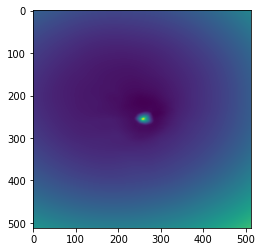

epoch 62401: 48.62492752075195
epoch 62402: 49.036285400390625
epoch 62403: 47.6104850769043
epoch 62404: 47.275020599365234
epoch 62405: 48.01786804199219
epoch 62406: 47.4338493347168
epoch 62407: 47.98514175415039
epoch 62408: 47.515647888183594
epoch 62409: 48.07520294189453
epoch 62411: 48.5092887878418
epoch 62412: 47.95260238647461
epoch 62413: 47.2023811340332
epoch 62414: 47.300724029541016
epoch 62415: 48.64841079711914
epoch 62416: 48.00196838378906
epoch 62417: 47.17559051513672
epoch 62418: 48.98635482788086
epoch 62419: 47.60906219482422
epoch 62421: 48.36943817138672
epoch 62422: 48.03001403808594
epoch 62423: 48.18338394165039
epoch 62424: 48.81231689453125
epoch 62425: 50.20163345336914
epoch 62426: 48.29259490966797
epoch 62427: 49.0640983581543
epoch 62428: 47.033599853515625
epoch 62429: 48.59463119506836
epoch 62431: 47.990562438964844
epoch 62432: 47.429962158203125
epoch 62433: 48.034637451171875
epoch 62434: 48.043338775634766
epoch 62435: 47.87642288208008
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



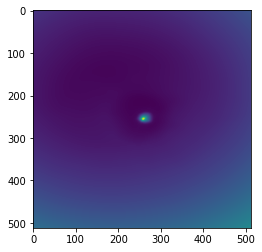

epoch 62501: 47.87380599975586
epoch 62502: 48.9040641784668
epoch 62503: 47.49520492553711
epoch 62504: 47.62975311279297
epoch 62505: 47.89925765991211
epoch 62506: 48.12087631225586
epoch 62507: 47.73590850830078
epoch 62508: 48.145999908447266
epoch 62509: 48.60173797607422
epoch 62511: 47.88418960571289
epoch 62512: 47.476524353027344
epoch 62513: 47.73859405517578
epoch 62514: 47.95973587036133
epoch 62515: 48.49233627319336
epoch 62516: 48.2917366027832
epoch 62517: 47.581153869628906
epoch 62518: 48.18547058105469
epoch 62519: 47.89995193481445
epoch 62521: 47.61307144165039
epoch 62522: 47.36460494995117
epoch 62523: 48.976749420166016
epoch 62524: 48.15574264526367
epoch 62525: 47.55268478393555
epoch 62526: 47.51090621948242
epoch 62527: 47.786888122558594
epoch 62528: 48.482181549072266
epoch 62529: 48.622459411621094
epoch 62531: 47.88461685180664
epoch 62532: 48.65951919555664
epoch 62533: 48.27915954589844
epoch 62534: 47.73086929321289
epoch 62535: 47.7719612121582
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



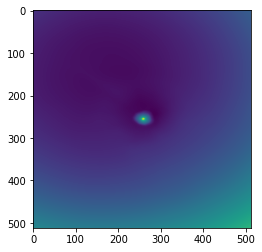

epoch 62601: 48.3744010925293
epoch 62602: 48.70446014404297
epoch 62603: 47.58578109741211
epoch 62604: 48.63348388671875
epoch 62605: 47.486610412597656
epoch 62606: 47.55663299560547
epoch 62607: 47.7255744934082
epoch 62608: 47.931644439697266
epoch 62609: 47.36025619506836
epoch 62611: 48.217796325683594
epoch 62612: 48.412086486816406
epoch 62613: 48.22532653808594
epoch 62614: 47.866310119628906
epoch 62615: 49.481842041015625
epoch 62616: 48.167510986328125
epoch 62617: 48.406455993652344
epoch 62618: 47.98323440551758
epoch 62619: 47.25691604614258
epoch 62621: 47.444618225097656
epoch 62622: 49.001808166503906
epoch 62623: 47.46311569213867
epoch 62624: 48.30568313598633
epoch 62625: 47.91263961791992
epoch 62626: 48.74117660522461
epoch 62627: 48.3739128112793
epoch 62628: 48.83460998535156
epoch 62629: 48.30172348022461
epoch 62631: 49.769248962402344
epoch 62632: 47.20182800292969
epoch 62633: 47.65581512451172
epoch 62634: 48.03388595581055
epoch 62635: 48.33802032470703


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



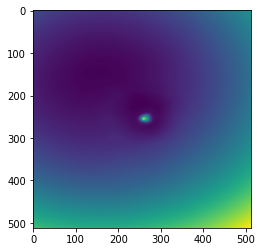

epoch 62701: 47.57045364379883
epoch 62702: 47.411773681640625
epoch 62703: 48.2491455078125
epoch 62704: 47.686283111572266
epoch 62705: 47.86516189575195
epoch 62706: 47.66341781616211
epoch 62707: 48.329063415527344
epoch 62708: 47.540863037109375
epoch 62709: 48.52521896362305
epoch 62711: 47.2151985168457
epoch 62712: 47.810794830322266
epoch 62713: 47.82737731933594
epoch 62714: 48.43350601196289
epoch 62715: 47.350006103515625
epoch 62716: 47.90904235839844
epoch 62717: 48.406410217285156
epoch 62718: 47.66686248779297
epoch 62719: 48.490230560302734
epoch 62721: 47.74468994140625
epoch 62722: 48.51551055908203
epoch 62723: 48.169307708740234
epoch 62724: 48.194488525390625
epoch 62725: 47.83344650268555
epoch 62726: 48.27288818359375
epoch 62727: 47.775428771972656
epoch 62728: 48.12404251098633
epoch 62729: 47.86432647705078
epoch 62731: 47.820743560791016
epoch 62732: 48.0068359375
epoch 62733: 49.037113189697266
epoch 62734: 48.70158386230469
epoch 62735: 48.156333923339844


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



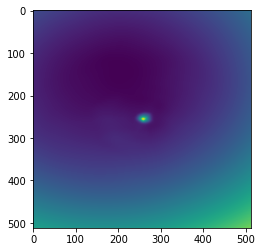

epoch 62801: 48.50660705566406
epoch 62802: 47.94207000732422
epoch 62803: 48.3408088684082
epoch 62804: 47.75487518310547
epoch 62805: 48.20624923706055
epoch 62806: 47.7736701965332
epoch 62807: 47.42005920410156
epoch 62808: 48.42485046386719
epoch 62809: 48.02217102050781
epoch 62811: 47.69486999511719
epoch 62812: 48.059593200683594
epoch 62813: 47.71586608886719
epoch 62814: 47.69099044799805
epoch 62815: 48.426429748535156
epoch 62816: 47.612857818603516
epoch 62817: 47.04734420776367
epoch 62818: 47.97964859008789
epoch 62819: 47.533233642578125
epoch 62821: 47.26546859741211
epoch 62822: 47.78152847290039
epoch 62823: 47.724700927734375
epoch 62824: 48.209407806396484
epoch 62825: 48.52653503417969
epoch 62826: 47.68035125732422
epoch 62827: 48.12397003173828
epoch 62828: 47.650638580322266
epoch 62829: 48.13319778442383
epoch 62831: 47.697628021240234
epoch 62832: 48.34180450439453
epoch 62833: 47.81855773925781
epoch 62834: 48.06376647949219
epoch 62835: 48.43166732788086
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



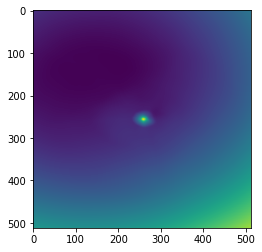

epoch 62901: 47.314395904541016
epoch 62902: 48.184547424316406
epoch 62903: 48.34683609008789
epoch 62904: 49.30613327026367
epoch 62905: 49.053680419921875
epoch 62906: 49.01613235473633
epoch 62907: 48.31608581542969
epoch 62908: 48.24930191040039
epoch 62909: 47.35723876953125
epoch 62911: 47.71141815185547
epoch 62912: 47.84286117553711
epoch 62913: 48.478599548339844
epoch 62914: 48.27214431762695
epoch 62915: 48.083675384521484
epoch 62916: 47.628761291503906
epoch 62917: 47.602638244628906
epoch 62918: 48.54301071166992
epoch 62919: 48.271114349365234
epoch 62921: 48.671627044677734
epoch 62922: 47.77740478515625
epoch 62923: 47.89802169799805
epoch 62924: 49.5144157409668
epoch 62925: 47.660499572753906
epoch 62926: 47.47156524658203
epoch 62927: 48.10055160522461
epoch 62928: 48.64875030517578
epoch 62929: 47.75130844116211
epoch 62931: 48.28305435180664
epoch 62932: 47.418357849121094
epoch 62933: 48.29356002807617
epoch 62934: 48.39940643310547
epoch 62935: 49.0624504089355

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



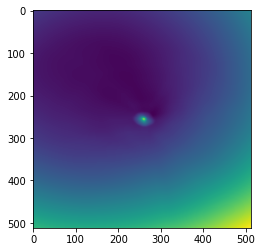

epoch 63001: 47.89397048950195
epoch 63002: 48.54252624511719
epoch 63003: 47.48286819458008
epoch 63004: 48.11160659790039
epoch 63005: 47.81328201293945
epoch 63006: 48.119388580322266
epoch 63007: 47.704193115234375
epoch 63008: 47.39458084106445
epoch 63009: 47.456485748291016
epoch 63011: 47.63380432128906
epoch 63012: 47.4254035949707
epoch 63013: 48.09669876098633
epoch 63014: 48.696781158447266
epoch 63015: 48.19804382324219
epoch 63016: 47.8577995300293
epoch 63017: 47.781646728515625
epoch 63018: 47.32095718383789
epoch 63019: 47.77339172363281
epoch 63021: 47.100746154785156
epoch 63022: 47.79671859741211
epoch 63023: 47.789939880371094
epoch 63024: 48.81461715698242
epoch 63025: 48.31589889526367
epoch 63026: 47.88418960571289
epoch 63027: 48.552886962890625
epoch 63028: 47.78916931152344
epoch 63029: 48.72816848754883
epoch 63031: 47.43297576904297
epoch 63032: 49.57639694213867
epoch 63033: 47.73136520385742
epoch 63034: 48.51980972290039
epoch 63035: 48.12184143066406
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



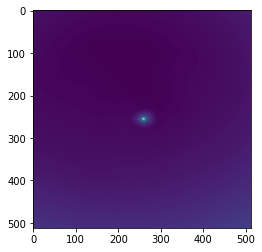

epoch 63101: 48.449520111083984
epoch 63102: 48.767005920410156
epoch 63103: 48.182098388671875
epoch 63104: 48.53810501098633
epoch 63105: 47.99616622924805
epoch 63106: 48.727439880371094
epoch 63107: 48.919921875
epoch 63108: 48.83927917480469
epoch 63109: 48.51008987426758
epoch 63111: 48.69949722290039
epoch 63112: 47.534671783447266
epoch 63113: 48.345584869384766
epoch 63114: 48.63456344604492
epoch 63115: 47.4871711730957
epoch 63116: 48.24263381958008
epoch 63117: 48.281925201416016
epoch 63118: 47.60805892944336
epoch 63119: 48.63276290893555
epoch 63121: 49.11403274536133
epoch 63122: 48.01211929321289
epoch 63123: 47.53999328613281
epoch 63124: 47.689273834228516
epoch 63125: 48.71873474121094
epoch 63126: 49.00540542602539
epoch 63127: 48.12946701049805
epoch 63128: 47.55706024169922
epoch 63129: 48.14728546142578
epoch 63131: 47.60169219970703
epoch 63132: 49.15182876586914
epoch 63133: 47.59379577636719
epoch 63134: 47.65250015258789
epoch 63135: 48.00017166137695
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



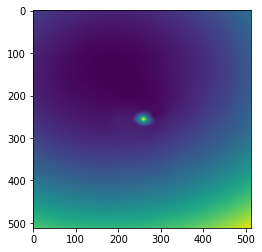

epoch 63201: 48.210506439208984
epoch 63202: 48.4259147644043
epoch 63203: 47.99113464355469
epoch 63204: 48.54059982299805
epoch 63205: 48.813114166259766
epoch 63206: 47.80744171142578
epoch 63207: 47.423583984375
epoch 63208: 48.040348052978516
epoch 63209: 48.68821334838867
epoch 63211: 47.85603713989258
epoch 63212: 48.63479232788086
epoch 63213: 48.31812286376953
epoch 63214: 48.24369812011719
epoch 63215: 49.51885223388672
epoch 63216: 48.27238082885742
epoch 63217: 48.03627395629883
epoch 63218: 47.25581359863281
epoch 63219: 48.55934143066406
epoch 63221: 48.24514389038086
epoch 63222: 49.55104064941406
epoch 63223: 48.08615493774414
epoch 63224: 47.71632385253906
epoch 63225: 48.472408294677734
epoch 63226: 48.611934661865234
epoch 63227: 48.79345703125
epoch 63228: 48.787235260009766
epoch 63229: 48.685733795166016
epoch 63231: 48.67301940917969
epoch 63232: 47.69913864135742
epoch 63233: 48.40361404418945
epoch 63234: 47.75153732299805
epoch 63235: 48.314849853515625
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



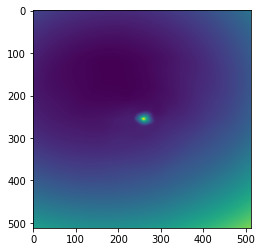

epoch 63301: 47.49614334106445
epoch 63302: 48.19466781616211
epoch 63303: 48.74614715576172
epoch 63304: 48.0794677734375
epoch 63305: 48.26936340332031
epoch 63306: 47.04313659667969
epoch 63307: 47.304931640625
epoch 63308: 48.77177810668945
epoch 63309: 47.672664642333984
epoch 63311: 47.61453628540039
epoch 63312: 48.72215270996094
epoch 63313: 47.790122985839844
epoch 63314: 47.65288543701172
epoch 63315: 48.14027786254883
epoch 63316: 48.689022064208984
epoch 63317: 47.798973083496094
epoch 63318: 48.515262603759766
epoch 63319: 47.73236846923828
epoch 63321: 48.53549575805664
epoch 63322: 47.39872360229492
epoch 63323: 47.89788055419922
epoch 63324: 47.88801193237305
epoch 63325: 47.789283752441406
epoch 63326: 47.46285629272461
epoch 63327: 47.10859298706055
epoch 63328: 48.1204719543457
epoch 63329: 48.2562255859375
epoch 63331: 47.76803970336914
epoch 63332: 53.14397048950195
epoch 63333: 47.601680755615234
epoch 63334: 50.47299575805664
epoch 63335: 48.58818435668945
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



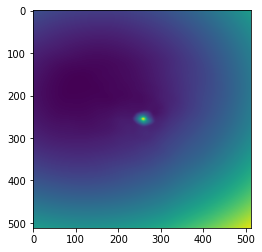

epoch 63401: 48.4578971862793
epoch 63402: 47.59184646606445
epoch 63403: 48.589378356933594
epoch 63404: 48.1264533996582
epoch 63405: 47.74289321899414
epoch 63406: 48.05057144165039
epoch 63407: 48.359825134277344
epoch 63408: 48.30455780029297
epoch 63409: 47.14807891845703
epoch 63411: 48.14313888549805
epoch 63412: 47.14049530029297
epoch 63413: 47.948097229003906
epoch 63414: 48.1759147644043
epoch 63415: 48.490333557128906
epoch 63416: 48.59495544433594
epoch 63417: 47.98095703125
epoch 63418: 48.561561584472656
epoch 63419: 48.116878509521484
epoch 63421: 47.58588409423828
epoch 63422: 47.57027816772461
epoch 63423: 48.54802703857422
epoch 63424: 48.31264114379883
epoch 63425: 48.561729431152344
epoch 63426: 47.496028900146484
epoch 63427: 47.42796325683594
epoch 63428: 48.140567779541016
epoch 63429: 47.539207458496094
epoch 63431: 47.50041198730469
epoch 63432: 48.038734436035156
epoch 63433: 48.181182861328125
epoch 63434: 48.771236419677734
epoch 63435: 47.903533935546875


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



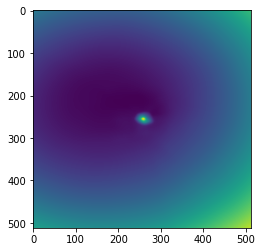

epoch 63501: 47.66816711425781
epoch 63502: 47.841983795166016
epoch 63503: 48.181644439697266
epoch 63504: 48.03303146362305
epoch 63505: 48.223331451416016
epoch 63506: 48.6971435546875
epoch 63507: 48.268714904785156
epoch 63508: 48.07917404174805
epoch 63509: 47.43920135498047
epoch 63511: 48.15789794921875
epoch 63512: 47.50435256958008
epoch 63513: 47.928348541259766
epoch 63514: 47.4892463684082
epoch 63515: 47.54261016845703
epoch 63516: 47.657257080078125
epoch 63517: 49.36772918701172
epoch 63518: 47.48077392578125
epoch 63519: 48.021400451660156
epoch 63521: 48.113746643066406
epoch 63522: 47.65586471557617
epoch 63523: 49.06837463378906
epoch 63524: 48.27356719970703
epoch 63525: 48.18096160888672
epoch 63526: 47.41020965576172
epoch 63527: 48.58735656738281
epoch 63528: 48.067684173583984
epoch 63529: 48.70319366455078
epoch 63531: 48.58829116821289
epoch 63532: 47.51216506958008
epoch 63533: 47.649715423583984
epoch 63534: 48.21879577636719
epoch 63535: 47.82456588745117


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



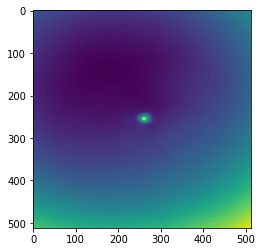

epoch 63601: 48.130706787109375
epoch 63602: 47.9586067199707
epoch 63603: 48.12895202636719
epoch 63604: 47.68927001953125
epoch 63605: 47.602569580078125
epoch 63606: 48.50838851928711
epoch 63607: 47.928977966308594
epoch 63608: 47.51469039916992
epoch 63609: 48.415313720703125
epoch 63611: 47.64488983154297
epoch 63612: 47.32390213012695
epoch 63613: 47.88621139526367
epoch 63614: 48.195194244384766
epoch 63615: 48.79530334472656
epoch 63616: 48.934349060058594
epoch 63617: 48.066436767578125
epoch 63618: 47.59512710571289
epoch 63619: 47.80436325073242
epoch 63621: 47.5880126953125
epoch 63622: 47.735294342041016
epoch 63623: 48.23469924926758
epoch 63624: 48.22283935546875
epoch 63625: 48.50166702270508
epoch 63626: 47.29420852661133
epoch 63627: 48.872459411621094
epoch 63628: 47.80807113647461
epoch 63629: 48.62535095214844
epoch 63631: 49.02412796020508
epoch 63632: 48.581111907958984
epoch 63633: 47.38991928100586
epoch 63634: 48.165103912353516
epoch 63635: 47.93012237548828

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



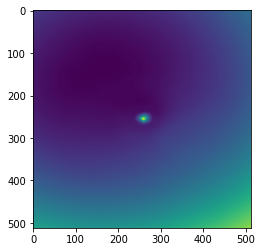

epoch 63701: 48.579925537109375
epoch 63702: 47.854408264160156
epoch 63703: 47.3186149597168
epoch 63704: 47.99625015258789
epoch 63705: 48.47053527832031
epoch 63706: 48.493011474609375
epoch 63707: 48.600765228271484
epoch 63708: 47.950111389160156
epoch 63709: 48.334266662597656
epoch 63711: 48.05416488647461
epoch 63712: 47.84565734863281
epoch 63713: 48.401546478271484
epoch 63714: 48.220951080322266
epoch 63715: 48.279483795166016
epoch 63716: 47.21938705444336
epoch 63717: 48.6750602722168
epoch 63718: 47.93889617919922
epoch 63719: 48.43914031982422
epoch 63721: 48.299041748046875
epoch 63722: 48.1966552734375
epoch 63723: 48.11384963989258
epoch 63724: 48.39778137207031
epoch 63725: 48.56221008300781
epoch 63726: 48.19437026977539
epoch 63727: 47.91405487060547
epoch 63728: 48.25758743286133
epoch 63729: 48.185367584228516
epoch 63731: 47.62804412841797
epoch 63732: 47.912132263183594
epoch 63733: 48.57509994506836
epoch 63734: 47.5121955871582
epoch 63735: 47.94846725463867


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



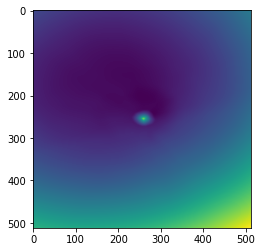

epoch 63801: 48.08454895019531
epoch 63802: 47.740936279296875
epoch 63803: 48.27775955200195
epoch 63804: 48.85307693481445
epoch 63805: 48.30565643310547
epoch 63806: 48.10944747924805
epoch 63807: 47.558082580566406
epoch 63808: 48.2715950012207
epoch 63809: 47.895042419433594
epoch 63811: 48.872886657714844
epoch 63812: 47.276573181152344
epoch 63813: 48.410091400146484
epoch 63814: 49.03078842163086
epoch 63815: 47.75260925292969
epoch 63816: 47.499267578125
epoch 63817: 47.860965728759766
epoch 63818: 49.13453674316406
epoch 63819: 47.623023986816406
epoch 63821: 48.122291564941406
epoch 63822: 49.0540771484375
epoch 63823: 46.741966247558594
epoch 63824: 48.548439025878906
epoch 63825: 49.15481948852539
epoch 63826: 48.286964416503906
epoch 63827: 47.405879974365234
epoch 63828: 47.61495590209961
epoch 63829: 48.58119583129883
epoch 63831: 48.63282775878906
epoch 63832: 47.9690055847168
epoch 63833: 48.63420104980469
epoch 63834: 47.858482360839844
epoch 63835: 49.77548980712890

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



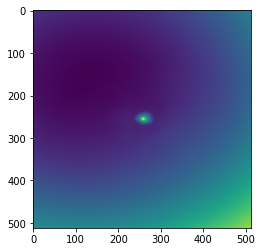

epoch 63901: 47.9412841796875
epoch 63902: 48.38808059692383
epoch 63903: 47.9255256652832
epoch 63904: 48.00936508178711
epoch 63905: 48.56609344482422
epoch 63906: 47.726016998291016
epoch 63907: 47.84364700317383
epoch 63908: 47.552406311035156
epoch 63909: 47.22346878051758
epoch 63911: 48.39519119262695
epoch 63912: 47.64175796508789
epoch 63913: 47.8747444152832
epoch 63914: 48.349609375
epoch 63915: 47.1893310546875
epoch 63916: 48.078819274902344
epoch 63917: 48.88944625854492
epoch 63918: 48.2183952331543
epoch 63919: 47.88151931762695
epoch 63921: 47.656158447265625
epoch 63922: 48.095176696777344
epoch 63923: 47.937747955322266
epoch 63924: 48.40999221801758
epoch 63925: 48.110504150390625
epoch 63926: 48.616943359375
epoch 63927: 48.50276184082031
epoch 63928: 48.083580017089844
epoch 63929: 48.85573196411133
epoch 63931: 47.760528564453125
epoch 63932: 47.961463928222656
epoch 63933: 47.709136962890625
epoch 63934: 48.06525802612305
epoch 63935: 47.534027099609375
epoch 63

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



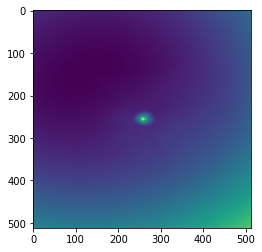

epoch 64001: 48.47615051269531
epoch 64002: 48.0808219909668
epoch 64003: 48.19453048706055
epoch 64004: 48.37677001953125
epoch 64005: 48.14332962036133
epoch 64006: 48.54202651977539
epoch 64007: 48.279998779296875
epoch 64008: 48.05211639404297
epoch 64009: 48.571170806884766
epoch 64011: 48.02356719970703
epoch 64012: 47.78984451293945
epoch 64013: 49.17909622192383
epoch 64014: 47.665122985839844
epoch 64015: 47.52216720581055
epoch 64016: 48.06352996826172
epoch 64017: 47.9743766784668
epoch 64018: 47.91603088378906
epoch 64019: 48.270591735839844
epoch 64021: 47.68790054321289
epoch 64022: 49.479736328125
epoch 64023: 47.99248123168945
epoch 64024: 48.93305206298828
epoch 64025: 47.62973403930664
epoch 64026: 48.02320861816406
epoch 64027: 48.39604187011719
epoch 64028: 49.420223236083984
epoch 64029: 49.006591796875
epoch 64031: 47.63574981689453
epoch 64032: 48.562679290771484
epoch 64033: 48.82331848144531
epoch 64034: 48.54246139526367
epoch 64035: 48.27243423461914
epoch 64

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



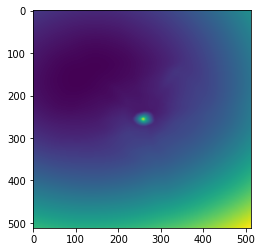

epoch 64101: 48.089378356933594
epoch 64102: 48.86569595336914
epoch 64103: 47.9227180480957
epoch 64104: 47.954776763916016
epoch 64105: 47.77375793457031
epoch 64106: 48.72412109375
epoch 64107: 48.606319427490234
epoch 64108: 48.48737335205078
epoch 64109: 47.637062072753906
epoch 64111: 48.67708206176758
epoch 64112: 48.60487747192383
epoch 64113: 48.05217361450195
epoch 64114: 48.032535552978516
epoch 64115: 47.87213134765625
epoch 64116: 48.35300827026367
epoch 64117: 48.427825927734375
epoch 64118: 48.00183868408203
epoch 64119: 47.99112319946289
epoch 64121: 48.161319732666016
epoch 64122: 48.446136474609375
epoch 64123: 48.428855895996094
epoch 64124: 48.879783630371094
epoch 64125: 48.51408004760742
epoch 64126: 47.65110778808594
epoch 64127: 47.5964469909668
epoch 64128: 47.80179977416992
epoch 64129: 48.002933502197266
epoch 64131: 47.86783981323242
epoch 64132: 48.28374099731445
epoch 64133: 48.37574768066406
epoch 64134: 48.43165588378906
epoch 64135: 48.1551513671875
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



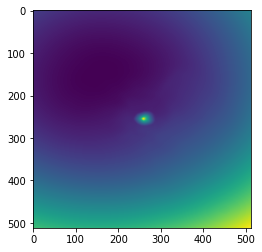

epoch 64201: 47.83649826049805
epoch 64202: 48.13459396362305
epoch 64203: 48.07345962524414
epoch 64204: 47.120880126953125
epoch 64205: 47.175418853759766
epoch 64206: 47.971290588378906
epoch 64207: 47.78629684448242
epoch 64208: 48.3360595703125
epoch 64209: 47.651771545410156
epoch 64211: 47.81057357788086
epoch 64212: 48.1691780090332
epoch 64213: 47.55210876464844
epoch 64214: 47.90381622314453
epoch 64215: 47.758338928222656
epoch 64216: 48.03799819946289
epoch 64217: 48.255374908447266
epoch 64218: 48.44843292236328
epoch 64219: 47.197486877441406
epoch 64221: 47.09329605102539
epoch 64222: 48.276695251464844
epoch 64223: 47.383060455322266
epoch 64224: 47.557228088378906
epoch 64225: 48.21184158325195
epoch 64226: 47.807891845703125
epoch 64227: 47.348140716552734
epoch 64228: 48.00932312011719
epoch 64229: 48.13935089111328
epoch 64231: 48.077171325683594
epoch 64232: 47.575252532958984
epoch 64233: 47.565582275390625
epoch 64234: 46.9984130859375
epoch 64235: 47.41576385498

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



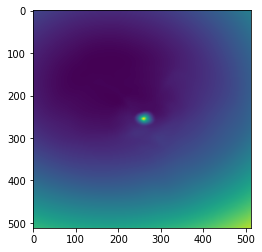

epoch 64301: 48.2028923034668
epoch 64302: 47.751121520996094
epoch 64303: 48.75071334838867
epoch 64304: 48.88945388793945
epoch 64305: 48.623077392578125
epoch 64306: 48.95405197143555
epoch 64307: 48.664127349853516
epoch 64308: 48.58958435058594
epoch 64309: 48.41877746582031
epoch 64311: 48.63660430908203
epoch 64312: 48.333038330078125
epoch 64313: 48.21366500854492
epoch 64314: 50.488609313964844
epoch 64315: 47.95630645751953
epoch 64316: 47.74610137939453
epoch 64317: 47.77690887451172
epoch 64318: 48.22126770019531
epoch 64319: 48.21989440917969
epoch 64321: 48.0673942565918
epoch 64322: 49.473453521728516
epoch 64323: 47.62611389160156
epoch 64324: 48.30825424194336
epoch 64325: 48.828155517578125
epoch 64326: 47.88115692138672
epoch 64327: 48.152103424072266
epoch 64328: 47.682701110839844
epoch 64329: 46.891658782958984
epoch 64331: 48.1890983581543
epoch 64332: 47.92104721069336
epoch 64333: 47.91453552246094
epoch 64334: 47.83748245239258
epoch 64335: 48.045860290527344


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



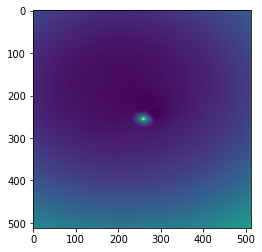

epoch 64401: 48.25263977050781
epoch 64402: 48.792083740234375
epoch 64403: 48.44867706298828
epoch 64404: 48.37705993652344
epoch 64405: 48.14051055908203
epoch 64406: 47.4783821105957
epoch 64407: 47.822017669677734
epoch 64408: 47.71281051635742
epoch 64409: 48.3530158996582
epoch 64411: 47.86457824707031
epoch 64412: 48.30226516723633
epoch 64413: 49.91433334350586
epoch 64414: 49.69222640991211
epoch 64415: 48.5286979675293
epoch 64416: 48.957061767578125
epoch 64417: 48.13751983642578
epoch 64418: 47.980098724365234
epoch 64419: 47.880271911621094
epoch 64421: 48.122398376464844
epoch 64422: 48.32682800292969
epoch 64423: 47.975975036621094
epoch 64424: 48.20551681518555
epoch 64425: 48.1844596862793
epoch 64426: 49.721832275390625
epoch 64427: 47.92081069946289
epoch 64428: 47.797767639160156
epoch 64429: 48.22331619262695
epoch 64431: 48.29832458496094
epoch 64432: 48.734405517578125
epoch 64433: 48.331787109375
epoch 64434: 47.84695053100586
epoch 64435: 48.14016342163086
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



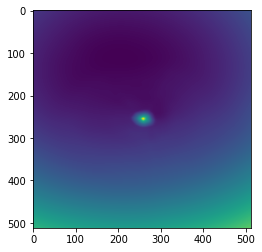

epoch 64501: 48.94485855102539
epoch 64502: 48.04957580566406
epoch 64503: 48.71459197998047
epoch 64504: 47.67609405517578
epoch 64505: 48.414527893066406
epoch 64506: 48.1235237121582
epoch 64507: 48.633182525634766
epoch 64508: 48.428253173828125
epoch 64509: 47.23270797729492
epoch 64511: 48.37187194824219
epoch 64512: 48.95695114135742
epoch 64513: 47.51995849609375
epoch 64514: 48.80556869506836
epoch 64515: 47.45585250854492
epoch 64516: 47.67264938354492
epoch 64517: 48.632747650146484
epoch 64518: 47.936031341552734
epoch 64519: 47.52720642089844
epoch 64521: 48.31745147705078
epoch 64522: 48.11640167236328
epoch 64523: 48.324729919433594
epoch 64524: 48.03721237182617
epoch 64525: 48.09221267700195
epoch 64526: 47.489707946777344
epoch 64527: 47.919734954833984
epoch 64528: 47.791927337646484
epoch 64529: 48.07194900512695
epoch 64531: 48.45581817626953
epoch 64532: 48.02942657470703
epoch 64533: 47.387699127197266
epoch 64534: 48.549346923828125
epoch 64535: 48.2998733520507

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



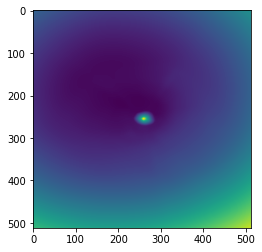

epoch 64601: 47.49360656738281
epoch 64602: 47.4190673828125
epoch 64603: 47.934715270996094
epoch 64604: 47.502296447753906
epoch 64605: 47.640628814697266
epoch 64606: 47.89063262939453
epoch 64607: 48.398468017578125
epoch 64608: 48.393863677978516
epoch 64609: 47.358299255371094
epoch 64611: 47.97783660888672
epoch 64612: 48.08915710449219
epoch 64613: 48.441768646240234
epoch 64614: 48.274410247802734
epoch 64615: 48.25318145751953
epoch 64616: 49.12769317626953
epoch 64617: 48.31511688232422
epoch 64618: 48.59473419189453
epoch 64619: 47.898677825927734
epoch 64621: 47.73440170288086
epoch 64622: 49.24907684326172
epoch 64623: 47.7680778503418
epoch 64624: 50.17866134643555
epoch 64625: 47.78243637084961
epoch 64626: 47.27676773071289
epoch 64627: 47.391822814941406
epoch 64628: 48.058319091796875
epoch 64629: 48.27892303466797
epoch 64631: 51.85624694824219
epoch 64632: 47.7230110168457
epoch 64633: 49.09938430786133
epoch 64634: 47.72781753540039
epoch 64635: 48.817928314208984

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



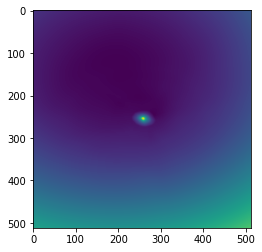

epoch 64701: 48.146644592285156
epoch 64702: 47.90292739868164
epoch 64703: 48.59839630126953
epoch 64704: 48.141963958740234
epoch 64705: 47.820884704589844
epoch 64706: 48.467185974121094
epoch 64707: 48.717193603515625
epoch 64708: 47.913211822509766
epoch 64709: 47.63420104980469
epoch 64711: 47.873138427734375
epoch 64712: 47.718963623046875
epoch 64713: 48.35524368286133
epoch 64714: 48.64365768432617
epoch 64715: 48.246498107910156
epoch 64716: 48.00645065307617
epoch 64717: 47.45146942138672
epoch 64718: 48.60209655761719
epoch 64719: 49.24357223510742
epoch 64721: 47.686302185058594
epoch 64722: 48.53486633300781
epoch 64723: 48.20035934448242
epoch 64724: 47.6329460144043
epoch 64725: 48.540069580078125
epoch 64726: 47.99721908569336
epoch 64727: 48.386566162109375
epoch 64728: 47.70869064331055
epoch 64729: 48.20542907714844
epoch 64731: 47.75697326660156
epoch 64732: 48.243247985839844
epoch 64733: 47.54344940185547
epoch 64734: 48.0907096862793
epoch 64735: 48.296298980712

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



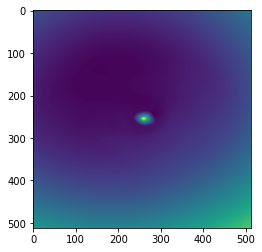

epoch 64801: 48.07208251953125
epoch 64802: 48.65446472167969
epoch 64803: 47.862998962402344
epoch 64804: 47.96754455566406
epoch 64805: 48.2342414855957
epoch 64806: 48.181640625
epoch 64807: 47.814449310302734
epoch 64808: 48.354801177978516
epoch 64809: 47.6392707824707
epoch 64811: 47.66200637817383
epoch 64812: 47.7559928894043
epoch 64813: 47.055233001708984
epoch 64814: 47.42943572998047
epoch 64815: 48.513431549072266
epoch 64816: 48.19118881225586
epoch 64817: 48.08240509033203
epoch 64818: 47.1751708984375
epoch 64819: 47.780426025390625
epoch 64821: 48.1655158996582
epoch 64822: 48.81006622314453
epoch 64823: 47.96156692504883
epoch 64824: 49.36943435668945
epoch 64825: 48.16392135620117
epoch 64826: 48.34969711303711
epoch 64827: 48.16236114501953
epoch 64828: 48.5727653503418
epoch 64829: 47.6891975402832
epoch 64831: 47.96119689941406
epoch 64832: 48.513126373291016
epoch 64833: 49.37821960449219
epoch 64834: 48.14554977416992
epoch 64835: 47.79458999633789
epoch 64836: 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



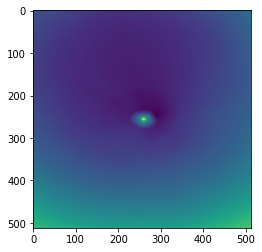

epoch 64901: 48.33399200439453
epoch 64902: 48.788482666015625
epoch 64903: 48.965721130371094
epoch 64904: 48.793968200683594
epoch 64905: 48.6695671081543
epoch 64906: 47.92797088623047
epoch 64907: 48.39860534667969
epoch 64908: 48.67160415649414
epoch 64909: 48.36708068847656
epoch 64911: 48.474239349365234
epoch 64912: 48.40749740600586
epoch 64913: 48.013309478759766
epoch 64914: 48.44221496582031
epoch 64915: 48.49822998046875
epoch 64916: 48.5936393737793
epoch 64917: 47.597774505615234
epoch 64918: 48.20954513549805
epoch 64919: 47.684391021728516
epoch 64921: 48.50981521606445
epoch 64922: 47.88596725463867
epoch 64923: 48.205265045166016
epoch 64924: 48.38787841796875
epoch 64925: 47.93096923828125
epoch 64926: 48.87099075317383
epoch 64927: 49.21065139770508
epoch 64928: 48.28541564941406
epoch 64929: 48.380401611328125
epoch 64931: 48.7477912902832
epoch 64932: 47.29569625854492
epoch 64933: 49.56754684448242
epoch 64934: 48.5097770690918
epoch 64935: 49.9622688293457
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



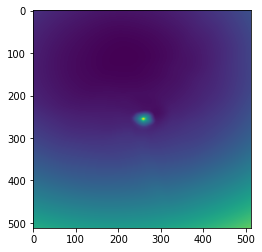

epoch 65001: 47.64189147949219
epoch 65002: 48.13678741455078
epoch 65003: 48.42991638183594
epoch 65004: 48.442771911621094
epoch 65005: 48.36006546020508
epoch 65006: 48.335140228271484
epoch 65007: 47.993080139160156
epoch 65008: 47.955665588378906
epoch 65009: 48.51507568359375
epoch 65011: 47.46982955932617
epoch 65012: 48.17631149291992
epoch 65013: 48.04948043823242
epoch 65014: 48.42478561401367
epoch 65015: 48.91379165649414
epoch 65016: 47.79278564453125
epoch 65017: 48.47755432128906
epoch 65018: 48.6708869934082
epoch 65019: 48.92876052856445
epoch 65021: 48.93349075317383
epoch 65022: 48.76704788208008
epoch 65023: 48.00822448730469
epoch 65024: 47.48543930053711
epoch 65025: 48.54899597167969
epoch 65026: 48.70500183105469
epoch 65027: 47.66782760620117
epoch 65028: 48.80776596069336
epoch 65029: 48.896846771240234
epoch 65031: 48.187721252441406
epoch 65032: 48.45136642456055
epoch 65033: 47.977684020996094
epoch 65034: 46.960018157958984
epoch 65035: 48.26933288574219
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



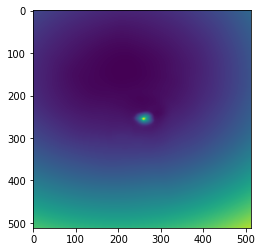

epoch 65101: 48.139747619628906
epoch 65102: 47.15763473510742
epoch 65103: 48.0631217956543
epoch 65104: 49.33507537841797
epoch 65105: 49.31666564941406
epoch 65106: 47.633113861083984
epoch 65107: 47.61842346191406
epoch 65108: 47.803550720214844
epoch 65109: 47.57264709472656
epoch 65111: 48.645042419433594
epoch 65112: 48.437889099121094
epoch 65113: 48.133724212646484
epoch 65114: 47.81253433227539
epoch 65115: 48.653358459472656
epoch 65116: 48.73317337036133
epoch 65117: 48.04804992675781
epoch 65118: 47.807247161865234
epoch 65119: 48.12306213378906
epoch 65121: 47.83531951904297
epoch 65122: 47.89030456542969
epoch 65123: 48.1513557434082
epoch 65124: 47.64995574951172
epoch 65125: 47.208229064941406
epoch 65126: 47.297908782958984
epoch 65127: 48.52622985839844
epoch 65128: 47.584228515625
epoch 65129: 48.51994705200195
epoch 65131: 47.95040512084961
epoch 65132: 48.25510025024414
epoch 65133: 48.21403503417969
epoch 65134: 47.998966217041016
epoch 65135: 48.154911041259766


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



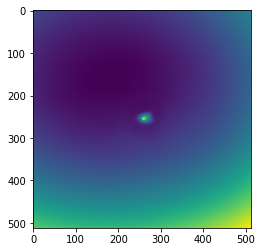

epoch 65201: 48.741783142089844
epoch 65202: 47.062110900878906
epoch 65203: 48.8680534362793
epoch 65204: 48.60651779174805
epoch 65205: 47.4040641784668
epoch 65206: 47.48234558105469
epoch 65207: 47.734622955322266
epoch 65208: 48.925071716308594
epoch 65209: 48.60686492919922
epoch 65211: 48.150062561035156
epoch 65212: 47.641258239746094
epoch 65213: 47.814327239990234
epoch 65214: 48.12021255493164
epoch 65215: 48.55843734741211
epoch 65216: 47.9374885559082
epoch 65217: 47.77516555786133
epoch 65218: 47.60594177246094
epoch 65219: 48.42186737060547
epoch 65221: 48.86725616455078
epoch 65222: 48.983665466308594
epoch 65223: 48.81886291503906
epoch 65224: 46.951416015625
epoch 65225: 48.1017951965332
epoch 65226: 47.83939743041992
epoch 65227: 48.05952453613281
epoch 65228: 46.98188781738281
epoch 65229: 48.48189163208008
epoch 65231: 48.58439636230469
epoch 65232: 47.71112823486328
epoch 65233: 48.766571044921875
epoch 65234: 49.113529205322266
epoch 65235: 47.59872817993164
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



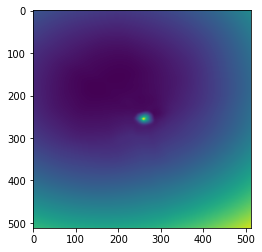

epoch 65301: 47.77204132080078
epoch 65302: 48.08257293701172
epoch 65303: 47.804813385009766
epoch 65304: 47.78922653198242
epoch 65305: 48.08906936645508
epoch 65306: 47.99075698852539
epoch 65307: 47.5860710144043
epoch 65308: 47.362388610839844
epoch 65309: 47.91661834716797
epoch 65311: 47.82360076904297
epoch 65312: 48.60269546508789
epoch 65313: 48.05582809448242
epoch 65314: 48.50249481201172
epoch 65315: 47.262184143066406
epoch 65316: 48.17644119262695
epoch 65317: 48.031578063964844
epoch 65318: 47.73353576660156
epoch 65319: 48.98320770263672
epoch 65321: 48.07517623901367
epoch 65322: 48.16927719116211
epoch 65323: 47.43555450439453
epoch 65324: 47.70400619506836
epoch 65325: 47.50221252441406
epoch 65326: 47.28245544433594
epoch 65327: 48.8692741394043
epoch 65328: 46.9749641418457
epoch 65329: 48.23777770996094
epoch 65331: 48.37067413330078
epoch 65332: 47.291648864746094
epoch 65333: 47.93914031982422
epoch 65334: 47.82451629638672
epoch 65335: 48.947757720947266
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



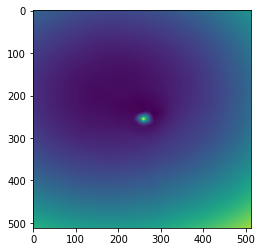

epoch 65401: 49.17379379272461
epoch 65402: 47.976863861083984
epoch 65403: 47.68769073486328
epoch 65404: 47.988155364990234
epoch 65405: 48.45888137817383
epoch 65406: 47.15568161010742
epoch 65407: 48.044219970703125
epoch 65408: 47.103240966796875
epoch 65409: 48.330596923828125
epoch 65411: 47.84501647949219
epoch 65412: 48.501224517822266
epoch 65413: 49.01423263549805
epoch 65414: 48.23014450073242
epoch 65415: 48.868408203125
epoch 65416: 48.479347229003906
epoch 65417: 48.5217399597168
epoch 65418: 47.93459701538086
epoch 65419: 49.175636291503906
epoch 65421: 48.2918815612793
epoch 65422: 48.413230895996094
epoch 65423: 48.16217803955078
epoch 65424: 47.93065643310547
epoch 65425: 48.391780853271484
epoch 65426: 48.43849182128906
epoch 65427: 48.85708999633789
epoch 65428: 48.348609924316406
epoch 65429: 48.09459686279297
epoch 65431: 48.6073112487793
epoch 65432: 48.080848693847656
epoch 65433: 48.39252853393555
epoch 65434: 48.40357208251953
epoch 65435: 48.64137649536133
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



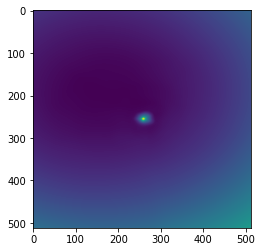

epoch 65501: 48.101688385009766
epoch 65502: 48.19183349609375
epoch 65503: 48.98521041870117
epoch 65504: 48.116363525390625
epoch 65505: 47.689449310302734
epoch 65506: 47.9755973815918
epoch 65507: 48.30873107910156
epoch 65508: 48.55718994140625
epoch 65509: 48.328575134277344
epoch 65511: 48.944847106933594
epoch 65512: 47.46723175048828
epoch 65513: 47.92612075805664
epoch 65514: 48.11166763305664
epoch 65515: 48.37517547607422
epoch 65516: 47.099952697753906
epoch 65517: 48.43927001953125
epoch 65518: 47.55350875854492
epoch 65519: 48.1580924987793
epoch 65521: 47.38930892944336
epoch 65522: 47.9180793762207
epoch 65523: 47.69039535522461
epoch 65524: 48.14207077026367
epoch 65525: 47.78200912475586
epoch 65526: 48.5919189453125
epoch 65527: 48.21272277832031
epoch 65528: 48.084800720214844
epoch 65529: 47.70570755004883
epoch 65531: 47.65018081665039
epoch 65532: 48.34916305541992
epoch 65533: 50.520904541015625
epoch 65534: 47.7081184387207
epoch 65535: 47.634273529052734
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



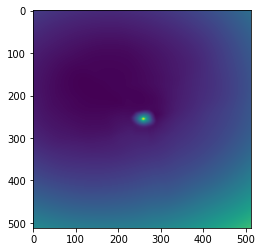

epoch 65601: 47.964515686035156
epoch 65602: 47.819515228271484
epoch 65603: 47.84000778198242
epoch 65604: 47.866004943847656
epoch 65605: 47.65456771850586
epoch 65606: 47.989173889160156
epoch 65607: 48.173980712890625
epoch 65608: 48.1304817199707
epoch 65609: 49.01166534423828
epoch 65611: 47.06446838378906
epoch 65612: 48.58481216430664
epoch 65613: 48.271697998046875
epoch 65614: 48.249263763427734
epoch 65615: 47.473628997802734
epoch 65616: 49.12916564941406
epoch 65617: 49.019866943359375
epoch 65618: 48.08549499511719
epoch 65619: 48.55046081542969
epoch 65621: 50.69865036010742
epoch 65622: 47.9752082824707
epoch 65623: 47.48271942138672
epoch 65624: 47.8999137878418
epoch 65625: 47.96492004394531
epoch 65626: 47.90779113769531
epoch 65627: 48.06790542602539
epoch 65628: 51.450035095214844
epoch 65629: 48.21293640136719
epoch 65631: 47.20045471191406
epoch 65632: 47.68117141723633
epoch 65633: 48.41945266723633
epoch 65634: 48.410926818847656
epoch 65635: 47.72205352783203


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



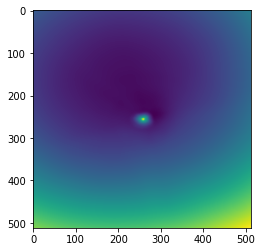

epoch 65701: 48.03612518310547
epoch 65702: 48.45934295654297
epoch 65703: 47.891658782958984
epoch 65704: 48.14266586303711
epoch 65705: 47.941627502441406
epoch 65706: 47.807682037353516
epoch 65707: 48.42681884765625
epoch 65708: 47.80483627319336
epoch 65709: 49.581356048583984
epoch 65711: 48.10595703125
epoch 65712: 47.777610778808594
epoch 65713: 49.43865203857422
epoch 65714: 48.36540985107422
epoch 65715: 48.31412124633789
epoch 65716: 48.950382232666016
epoch 65717: 48.7109375
epoch 65718: 47.88637161254883
epoch 65719: 49.43010330200195
epoch 65721: 48.71034622192383
epoch 65722: 47.6004524230957
epoch 65723: 48.29951095581055
epoch 65724: 48.55290222167969
epoch 65725: 48.0185546875
epoch 65726: 47.807926177978516
epoch 65727: 48.266231536865234
epoch 65728: 48.12970733642578
epoch 65729: 48.81895065307617
epoch 65731: 47.72271728515625
epoch 65732: 55.706031799316406
epoch 65733: 47.97307586669922
epoch 65734: 47.815494537353516
epoch 65735: 48.29380416870117
epoch 65736: 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



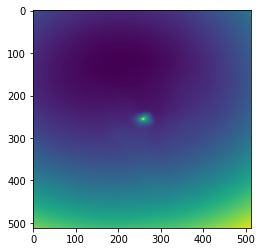

epoch 65801: 48.844058990478516
epoch 65802: 47.5973014831543
epoch 65803: 48.79354476928711
epoch 65804: 47.5135498046875
epoch 65805: 47.42362594604492
epoch 65806: 48.268550872802734
epoch 65807: 47.71125793457031
epoch 65808: 47.952274322509766
epoch 65809: 47.89219665527344
epoch 65811: 47.43721008300781
epoch 65812: 48.07093048095703
epoch 65813: 47.768550872802734
epoch 65814: 47.85625076293945
epoch 65815: 47.1729850769043
epoch 65816: 48.23991394042969
epoch 65817: 48.04290008544922
epoch 65818: 47.625484466552734
epoch 65819: 47.871192932128906
epoch 65821: 47.418556213378906
epoch 65822: 48.364418029785156
epoch 65823: 47.6894645690918
epoch 65824: 48.59553527832031
epoch 65825: 48.322303771972656
epoch 65826: 48.22932052612305
epoch 65827: 47.90301513671875
epoch 65828: 47.53997802734375
epoch 65829: 47.936279296875
epoch 65831: 47.71175765991211
epoch 65832: 48.1309700012207
epoch 65833: 48.189605712890625
epoch 65834: 48.071739196777344
epoch 65835: 47.27486038208008
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



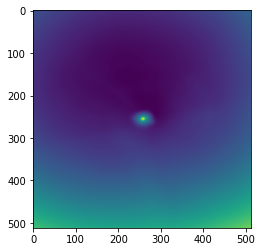

epoch 65901: 47.664710998535156
epoch 65902: 48.459144592285156
epoch 65903: 47.431915283203125
epoch 65904: 47.4361686706543
epoch 65905: 48.33868408203125
epoch 65906: 49.36061477661133
epoch 65907: 47.72299575805664
epoch 65908: 47.8911247253418
epoch 65909: 47.8779296875
epoch 65911: 48.183265686035156
epoch 65912: 47.96526336669922
epoch 65913: 47.15053176879883
epoch 65914: 47.412601470947266
epoch 65915: 47.710853576660156
epoch 65916: 48.38994598388672
epoch 65917: 48.06800079345703
epoch 65918: 48.28657531738281
epoch 65919: 49.66755294799805
epoch 65921: 48.57870101928711
epoch 65922: 47.844573974609375
epoch 65923: 49.002864837646484
epoch 65924: 47.57489013671875
epoch 65925: 48.31755065917969
epoch 65926: 46.8259162902832
epoch 65927: 48.551780700683594
epoch 65928: 48.52275085449219
epoch 65929: 47.64034652709961
epoch 65931: 48.18864440917969
epoch 65932: 48.46855926513672
epoch 65933: 47.912601470947266
epoch 65934: 47.71575927734375
epoch 65935: 47.41985321044922
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



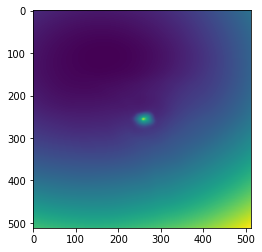

epoch 66001: 48.336585998535156
epoch 66002: 48.05913162231445
epoch 66003: 47.76333236694336
epoch 66004: 48.08255386352539
epoch 66005: 47.69696044921875
epoch 66006: 47.50039291381836
epoch 66007: 48.01791763305664
epoch 66008: 48.44921112060547
epoch 66009: 47.649871826171875
epoch 66011: 47.39997863769531
epoch 66012: 49.11163330078125
epoch 66013: 48.02176284790039
epoch 66014: 48.06632995605469
epoch 66015: 48.439353942871094
epoch 66016: 49.26665496826172
epoch 66017: 47.70758819580078
epoch 66018: 48.73084259033203
epoch 66019: 47.56728744506836
epoch 66021: 48.28464126586914
epoch 66022: 48.43961715698242
epoch 66023: 48.6069221496582
epoch 66024: 48.385986328125
epoch 66025: 48.61430740356445
epoch 66026: 49.2091064453125
epoch 66027: 47.835655212402344
epoch 66028: 48.432228088378906
epoch 66029: 48.778663635253906
epoch 66031: 48.76445007324219
epoch 66032: 48.07937240600586
epoch 66033: 48.145713806152344
epoch 66034: 47.48110580444336
epoch 66035: 48.32745361328125
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



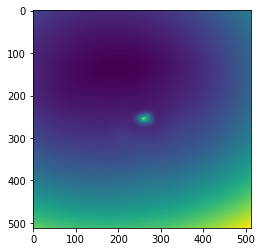

epoch 66101: 47.46167755126953
epoch 66102: 47.59563446044922
epoch 66103: 48.389404296875
epoch 66104: 48.627132415771484
epoch 66105: 47.690773010253906
epoch 66106: 48.127498626708984
epoch 66107: 48.31775665283203
epoch 66108: 48.047149658203125
epoch 66109: 47.78850173950195
epoch 66111: 48.08666229248047
epoch 66112: 48.464996337890625
epoch 66113: 47.96630859375
epoch 66114: 47.611732482910156
epoch 66115: 48.66109848022461
epoch 66116: 48.08990478515625
epoch 66117: 47.4364013671875
epoch 66118: 51.202762603759766
epoch 66119: 47.534393310546875
epoch 66121: 46.99317932128906
epoch 66122: 48.65725326538086
epoch 66123: 48.56033706665039
epoch 66124: 47.840492248535156
epoch 66125: 48.73466110229492
epoch 66126: 47.208187103271484
epoch 66127: 48.5453987121582
epoch 66128: 49.41376495361328
epoch 66129: 48.907005310058594
epoch 66131: 48.69363021850586
epoch 66132: 48.33882141113281
epoch 66133: 47.85125732421875
epoch 66134: 48.16677474975586
epoch 66135: 50.13652420043945
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



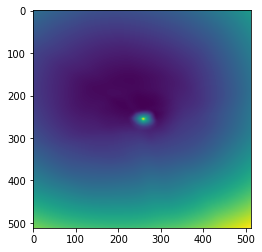

epoch 66201: 48.29477310180664
epoch 66202: 47.878448486328125
epoch 66203: 48.365718841552734
epoch 66204: 47.978538513183594
epoch 66205: 47.84246063232422
epoch 66206: 47.48867416381836
epoch 66207: 47.90602111816406
epoch 66208: 49.69236373901367
epoch 66209: 49.23891067504883
epoch 66211: 48.238460540771484
epoch 66212: 47.986202239990234
epoch 66213: 47.641136169433594
epoch 66214: 47.7409782409668
epoch 66215: 47.713897705078125
epoch 66216: 50.712711334228516
epoch 66217: 48.9917106628418
epoch 66218: 48.40019989013672
epoch 66219: 48.526920318603516
epoch 66221: 47.417877197265625
epoch 66222: 47.19828414916992
epoch 66223: 47.89774703979492
epoch 66224: 47.44362258911133
epoch 66225: 47.8033561706543
epoch 66226: 48.03790283203125
epoch 66227: 47.08030700683594
epoch 66228: 48.519371032714844
epoch 66229: 48.0331916809082
epoch 66231: 47.975929260253906
epoch 66232: 48.32283020019531
epoch 66233: 48.200923919677734
epoch 66234: 47.93476486206055
epoch 66235: 47.6290168762207


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



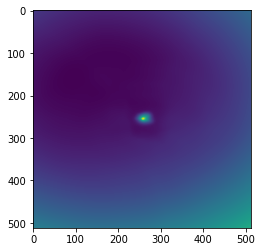

epoch 66301: 47.894737243652344
epoch 66302: 47.36699676513672
epoch 66303: 48.13603591918945
epoch 66304: 48.15290832519531
epoch 66305: 48.30268478393555
epoch 66306: 47.82461929321289
epoch 66307: 49.20298767089844
epoch 66308: 48.9576530456543
epoch 66309: 48.333614349365234
epoch 66311: 48.305809020996094
epoch 66312: 48.10444259643555
epoch 66313: 48.229515075683594
epoch 66314: 48.86484909057617
epoch 66315: 47.22068786621094
epoch 66316: 48.767974853515625
epoch 66317: 48.23722839355469
epoch 66318: 48.037174224853516
epoch 66319: 48.00383758544922
epoch 66321: 48.78746795654297
epoch 66322: 48.526878356933594
epoch 66323: 48.779518127441406
epoch 66324: 48.1314811706543
epoch 66325: 47.72809982299805
epoch 66326: 48.043216705322266
epoch 66327: 47.42708969116211
epoch 66328: 48.22829818725586
epoch 66329: 47.438194274902344
epoch 66331: 47.73225402832031
epoch 66332: 48.828487396240234
epoch 66333: 48.77246856689453
epoch 66334: 48.138221740722656
epoch 66335: 47.6338386535644

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



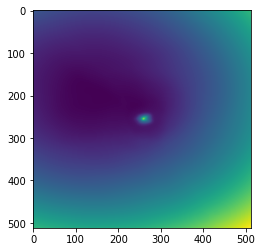

epoch 66401: 48.2956428527832
epoch 66402: 47.481101989746094
epoch 66403: 47.68537902832031
epoch 66404: 48.418006896972656
epoch 66405: 48.2590446472168
epoch 66406: 47.868587493896484
epoch 66407: 48.001529693603516
epoch 66408: 47.99613952636719
epoch 66409: 47.69765853881836
epoch 66411: 47.80404281616211
epoch 66412: 48.82564163208008
epoch 66413: 47.457786560058594
epoch 66414: 48.46823501586914
epoch 66415: 47.92906188964844
epoch 66416: 48.249351501464844
epoch 66417: 47.626731872558594
epoch 66418: 47.8602180480957
epoch 66419: 48.37544631958008
epoch 66421: 47.45635223388672
epoch 66422: 47.817378997802734
epoch 66423: 47.453369140625
epoch 66424: 48.427940368652344
epoch 66425: 47.32435607910156
epoch 66426: 47.991172790527344
epoch 66427: 48.53178405761719
epoch 66428: 47.407894134521484
epoch 66429: 48.509605407714844
epoch 66431: 47.45307159423828
epoch 66432: 47.88764190673828
epoch 66433: 47.608768463134766
epoch 66434: 48.81350326538086
epoch 66435: 48.029747009277344

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



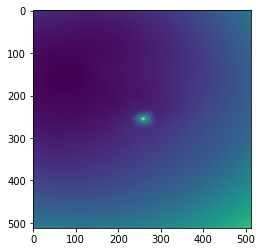

epoch 66501: 48.12195587158203
epoch 66502: 47.74660110473633
epoch 66503: 47.579872131347656
epoch 66504: 47.44734191894531
epoch 66505: 47.917110443115234
epoch 66506: 47.785457611083984
epoch 66507: 48.19624328613281
epoch 66508: 48.123626708984375
epoch 66509: 48.16818618774414
epoch 66511: 48.69925308227539
epoch 66512: 48.0593147277832
epoch 66513: 48.28794479370117
epoch 66514: 48.024879455566406
epoch 66515: 48.05834197998047
epoch 66516: 48.70176696777344
epoch 66517: 48.0367546081543
epoch 66518: 47.79448318481445
epoch 66519: 47.49473190307617
epoch 66521: 47.41785430908203
epoch 66522: 47.9609375
epoch 66523: 48.09928894042969
epoch 66524: 48.07831573486328
epoch 66525: 46.780372619628906
epoch 66526: 48.11991882324219
epoch 66527: 47.46417236328125
epoch 66528: 47.528114318847656
epoch 66529: 47.725807189941406
epoch 66531: 47.71833801269531
epoch 66532: 47.93400192260742
epoch 66533: 49.008453369140625
epoch 66534: 48.49440002441406
epoch 66535: 47.627586364746094
epoch 6

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



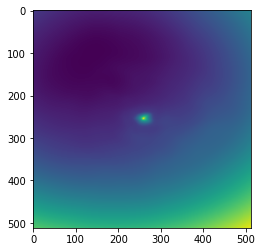

epoch 66601: 48.115814208984375
epoch 66602: 48.195926666259766
epoch 66603: 47.34669494628906
epoch 66604: 48.075286865234375
epoch 66605: 49.39384460449219
epoch 66606: 47.61763381958008
epoch 66607: 48.461814880371094
epoch 66608: 49.36436080932617
epoch 66609: 47.970489501953125
epoch 66611: 46.7861328125
epoch 66612: 47.68813705444336
epoch 66613: 48.28462600708008
epoch 66614: 47.68113708496094
epoch 66615: 48.035343170166016
epoch 66616: 47.38827896118164
epoch 66617: 47.867252349853516
epoch 66618: 48.47178268432617
epoch 66619: 47.62043762207031
epoch 66621: 47.96296691894531
epoch 66622: 50.64829635620117
epoch 66623: 47.74686050415039
epoch 66624: 48.20536422729492
epoch 66625: 49.65275955200195
epoch 66626: 48.67826461791992
epoch 66627: 47.95896530151367
epoch 66628: 48.76606750488281
epoch 66629: 47.92579650878906
epoch 66631: 47.701515197753906
epoch 66632: 48.17613220214844
epoch 66633: 48.64952087402344
epoch 66634: 49.89714050292969
epoch 66635: 47.67518997192383
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



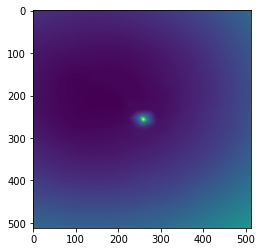

epoch 66701: 49.330841064453125
epoch 66702: 48.195274353027344
epoch 66703: 48.20418930053711
epoch 66704: 48.82651138305664
epoch 66705: 47.604583740234375
epoch 66706: 48.84907531738281
epoch 66707: 48.807533264160156
epoch 66708: 47.854610443115234
epoch 66709: 48.59016799926758
epoch 66711: 48.11668395996094
epoch 66712: 48.7104606628418
epoch 66713: 48.246002197265625
epoch 66714: 50.092010498046875
epoch 66715: 48.141510009765625
epoch 66716: 48.251651763916016
epoch 66717: 48.53422164916992
epoch 66718: 48.409698486328125
epoch 66719: 48.50319290161133
epoch 66721: 47.42782974243164
epoch 66722: 47.22614669799805
epoch 66723: 47.892601013183594
epoch 66724: 48.09983444213867
epoch 66725: 48.53704833984375
epoch 66726: 48.4671745300293
epoch 66727: 48.5948600769043
epoch 66728: 48.22456359863281
epoch 66729: 47.9576416015625
epoch 66731: 48.083675384521484
epoch 66732: 48.70519256591797
epoch 66733: 47.65673065185547
epoch 66734: 48.78739929199219
epoch 66735: 48.070953369140625

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



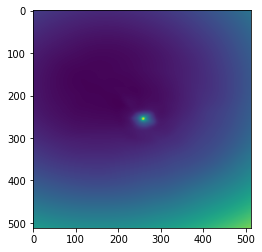

epoch 66801: 47.99109649658203
epoch 66802: 47.408714294433594
epoch 66803: 47.0448112487793
epoch 66804: 47.412986755371094
epoch 66805: 47.855064392089844
epoch 66806: 48.53520965576172
epoch 66807: 48.649940490722656
epoch 66808: 49.60979080200195
epoch 66809: 48.35736846923828
epoch 66811: 48.80652618408203
epoch 66812: 48.187164306640625
epoch 66813: 48.338096618652344
epoch 66814: 48.55187225341797
epoch 66815: 47.747806549072266
epoch 66816: 48.06779861450195
epoch 66817: 47.93156433105469
epoch 66818: 48.304080963134766
epoch 66819: 51.94127655029297
epoch 66821: 47.5488166809082
epoch 66822: 48.88869094848633
epoch 66823: 48.133338928222656
epoch 66824: 48.464942932128906
epoch 66825: 48.282588958740234
epoch 66826: 48.56165313720703
epoch 66827: 48.71803665161133
epoch 66828: 47.84408950805664
epoch 66829: 47.68306350708008
epoch 66831: 48.0828857421875
epoch 66832: 48.31907653808594
epoch 66833: 47.85722732543945
epoch 66834: 48.384765625
epoch 66835: 48.813846588134766
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



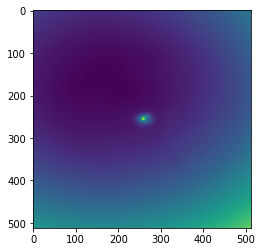

epoch 66901: 48.83601760864258
epoch 66902: 48.17538833618164
epoch 66903: 47.8933219909668
epoch 66904: 48.18471908569336
epoch 66905: 47.98298645019531
epoch 66906: 48.265018463134766
epoch 66907: 47.991973876953125
epoch 66908: 48.09580612182617
epoch 66909: 47.79030227661133
epoch 66911: 49.760948181152344
epoch 66912: 48.39452362060547
epoch 66913: 47.23163986206055
epoch 66914: 47.303653717041016
epoch 66915: 47.24938201904297
epoch 66916: 47.493194580078125
epoch 66917: 47.75931167602539
epoch 66918: 48.51457977294922
epoch 66919: 47.25136184692383
epoch 66921: 48.39424514770508
epoch 66922: 47.61792755126953
epoch 66923: 47.838714599609375
epoch 66924: 49.13368606567383
epoch 66925: 47.674564361572266
epoch 66926: 49.5694694519043
epoch 66927: 47.85734176635742
epoch 66928: 47.93041229248047
epoch 66929: 48.319515228271484
epoch 66931: 48.43890380859375
epoch 66932: 48.7656364440918
epoch 66933: 48.56280517578125
epoch 66934: 48.998966217041016
epoch 66935: 48.955238342285156
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



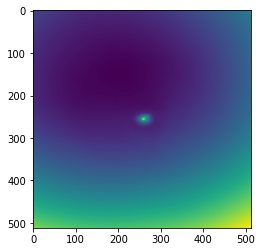

epoch 67001: 47.64767837524414
epoch 67002: 48.17683029174805
epoch 67003: 47.61426544189453
epoch 67004: 48.36220169067383
epoch 67005: 47.85845947265625
epoch 67006: 47.547447204589844
epoch 67007: 47.5626335144043
epoch 67008: 48.17247009277344
epoch 67009: 48.62895584106445
epoch 67011: 48.59571075439453
epoch 67012: 48.301185607910156
epoch 67013: 47.99104690551758
epoch 67014: 48.4599609375
epoch 67015: 49.16870880126953
epoch 67016: 47.72433853149414
epoch 67017: 47.97434997558594
epoch 67018: 47.94009780883789
epoch 67019: 48.15013885498047
epoch 67021: 47.56368637084961
epoch 67022: 48.31339645385742
epoch 67023: 47.65970993041992
epoch 67024: 48.25931930541992
epoch 67025: 47.74137878417969
epoch 67026: 48.07574462890625
epoch 67027: 47.783451080322266
epoch 67028: 47.73598861694336
epoch 67029: 48.000301361083984
epoch 67031: 48.14999008178711
epoch 67032: 47.908565521240234
epoch 67033: 47.796199798583984
epoch 67034: 48.41374588012695
epoch 67035: 48.07093048095703
epoch 6

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



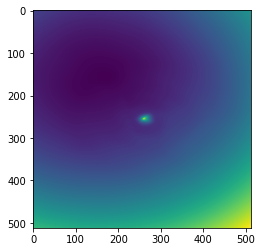

epoch 67101: 47.84611892700195
epoch 67102: 47.92884063720703
epoch 67103: 49.29560852050781
epoch 67104: 47.71148681640625
epoch 67105: 48.402835845947266
epoch 67106: 47.67165756225586
epoch 67107: 48.09325408935547
epoch 67108: 47.52233123779297
epoch 67109: 47.865440368652344
epoch 67111: 49.63042449951172
epoch 67112: 48.68378829956055
epoch 67113: 48.84687423706055
epoch 67114: 49.051631927490234
epoch 67115: 48.880741119384766
epoch 67116: 48.749671936035156
epoch 67117: 49.05813217163086
epoch 67118: 48.27425765991211
epoch 67119: 47.331268310546875
epoch 67121: 48.47856903076172
epoch 67122: 48.66645050048828
epoch 67123: 48.52293014526367
epoch 67124: 48.971717834472656
epoch 67125: 48.73274612426758
epoch 67126: 49.365020751953125
epoch 67127: 47.835357666015625
epoch 67128: 48.91564178466797
epoch 67129: 48.4709587097168
epoch 67131: 48.18495178222656
epoch 67132: 47.868995666503906
epoch 67133: 47.79531478881836
epoch 67134: 47.9231071472168
epoch 67135: 48.06848907470703


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



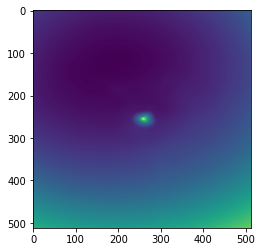

epoch 67201: 47.51183319091797
epoch 67202: 48.73649597167969
epoch 67203: 47.863685607910156
epoch 67204: 48.675846099853516
epoch 67205: 47.46353530883789
epoch 67206: 48.2658805847168
epoch 67207: 48.24026107788086
epoch 67208: 48.49128341674805
epoch 67209: 48.533363342285156
epoch 67211: 47.913700103759766
epoch 67212: 48.35879898071289
epoch 67213: 48.014591217041016
epoch 67214: 47.3433952331543
epoch 67215: 47.67142868041992
epoch 67216: 47.66112518310547
epoch 67217: 47.932437896728516
epoch 67218: 48.21904373168945
epoch 67219: 47.83881759643555
epoch 67221: 47.72345733642578
epoch 67222: 48.51898956298828
epoch 67223: 48.32950973510742
epoch 67224: 48.38755798339844
epoch 67225: 48.46179962158203
epoch 67226: 48.232276916503906
epoch 67227: 47.91130065917969
epoch 67228: 48.108924865722656
epoch 67229: 47.87517547607422
epoch 67231: 48.79150390625
epoch 67232: 47.83171081542969
epoch 67233: 47.55984115600586
epoch 67234: 48.66068649291992
epoch 67235: 47.92103958129883
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



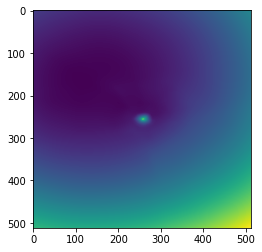

epoch 67301: 47.188819885253906
epoch 67302: 47.5336799621582
epoch 67303: 47.87058639526367
epoch 67304: 47.78504943847656
epoch 67305: 47.653411865234375
epoch 67306: 47.96751403808594
epoch 67307: 47.79677963256836
epoch 67308: 48.71357345581055
epoch 67309: 48.56345748901367
epoch 67311: 48.19106674194336
epoch 67312: 48.209476470947266
epoch 67313: 47.79071044921875
epoch 67314: 47.91693878173828
epoch 67315: 48.57803726196289
epoch 67316: 47.85371017456055
epoch 67317: 47.7459602355957
epoch 67318: 48.58953094482422
epoch 67319: 48.06022262573242
epoch 67321: 47.78684997558594
epoch 67322: 48.214378356933594
epoch 67323: 47.98191833496094
epoch 67324: 48.60261535644531
epoch 67325: 47.81980895996094
epoch 67326: 47.50679016113281
epoch 67327: 48.117919921875
epoch 67328: 48.03169250488281
epoch 67329: 47.99964904785156
epoch 67331: 47.56111526489258
epoch 67332: 48.54512023925781
epoch 67333: 47.79559326171875
epoch 67334: 48.39466094970703
epoch 67335: 48.177825927734375
epoch 6

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



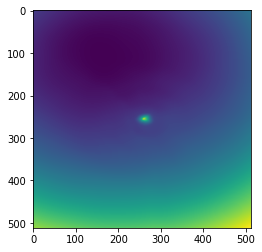

epoch 67401: 47.59719467163086
epoch 67402: 48.233882904052734
epoch 67403: 47.87493896484375
epoch 67404: 48.352935791015625
epoch 67405: 48.18845748901367
epoch 67406: 47.65194320678711
epoch 67407: 48.265907287597656
epoch 67408: 47.40079879760742
epoch 67409: 48.59578323364258
epoch 67411: 47.824424743652344
epoch 67412: 47.999656677246094
epoch 67413: 47.8929557800293
epoch 67414: 47.94525909423828
epoch 67415: 48.339073181152344
epoch 67416: 48.36507034301758
epoch 67417: 47.291011810302734
epoch 67418: 48.818946838378906
epoch 67419: 47.71933364868164
epoch 67421: 47.94209671020508
epoch 67422: 48.492919921875
epoch 67423: 47.89331817626953
epoch 67424: 47.822471618652344
epoch 67425: 47.95635223388672
epoch 67426: 47.16120147705078
epoch 67427: 47.49925231933594
epoch 67428: 48.056060791015625
epoch 67429: 47.144649505615234
epoch 67431: 47.517818450927734
epoch 67432: 48.4643440246582
epoch 67433: 48.38496780395508
epoch 67434: 48.59269332885742
epoch 67435: 48.12969207763672


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



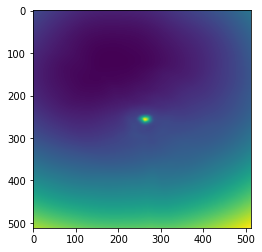

epoch 67501: 49.021854400634766
epoch 67502: 47.41248321533203
epoch 67503: 48.41965866088867
epoch 67504: 48.270294189453125
epoch 67505: 47.675052642822266
epoch 67506: 48.372398376464844
epoch 67507: 47.95290756225586
epoch 67508: 48.45661544799805
epoch 67509: 49.40789031982422
epoch 67511: 48.08468246459961
epoch 67512: 48.4493408203125
epoch 67513: 49.04640197753906
epoch 67514: 48.39540100097656
epoch 67515: 48.34398651123047
epoch 67516: 48.380985260009766
epoch 67517: 48.15150451660156
epoch 67518: 48.55154037475586
epoch 67519: 48.835147857666016
epoch 67521: 49.28695297241211
epoch 67522: 48.08351135253906
epoch 67523: 48.342811584472656
epoch 67524: 48.066368103027344
epoch 67525: 48.0539436340332
epoch 67526: 47.90773010253906
epoch 67527: 47.865074157714844
epoch 67528: 47.681968688964844
epoch 67529: 47.99483871459961
epoch 67531: 48.55662536621094
epoch 67532: 48.96199417114258
epoch 67533: 48.742340087890625
epoch 67534: 49.24124526977539
epoch 67535: 48.6287727355957


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



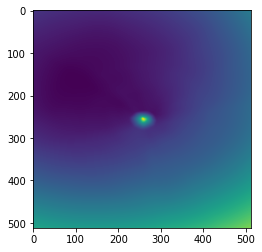

epoch 67601: 48.14116668701172
epoch 67602: 48.23154067993164
epoch 67603: 47.66423034667969
epoch 67604: 48.50309753417969
epoch 67605: 47.9454345703125
epoch 67606: 48.50480651855469
epoch 67607: 48.07918167114258
epoch 67608: 48.87824630737305
epoch 67609: 48.169960021972656
epoch 67611: 48.69715881347656
epoch 67612: 49.65041732788086
epoch 67613: 49.431419372558594
epoch 67614: 48.17930603027344
epoch 67615: 49.03736114501953
epoch 67616: 48.58768844604492
epoch 67617: 47.95106887817383
epoch 67618: 48.18442916870117
epoch 67619: 48.41766357421875
epoch 67621: 49.22209548950195
epoch 67622: 48.35757064819336
epoch 67623: 47.74211883544922
epoch 67624: 48.385135650634766
epoch 67625: 48.55820083618164
epoch 67626: 48.42205047607422
epoch 67627: 48.08042907714844
epoch 67628: 47.780029296875
epoch 67629: 48.65715789794922
epoch 67631: 48.441162109375
epoch 67632: 49.1364631652832
epoch 67633: 48.30533981323242
epoch 67634: 48.8482780456543
epoch 67635: 47.65839767456055
epoch 67636:

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



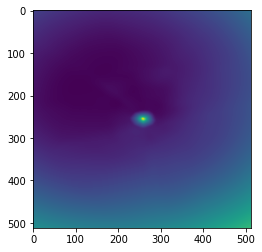

epoch 67701: 47.441165924072266
epoch 67702: 47.36815643310547
epoch 67703: 47.68925857543945
epoch 67704: 47.18101119995117
epoch 67705: 47.668365478515625
epoch 67706: 48.183895111083984
epoch 67707: 47.81028366088867
epoch 67708: 50.11199188232422
epoch 67709: 47.97711944580078
epoch 67711: 48.454856872558594
epoch 67712: 47.38894271850586
epoch 67713: 48.11197280883789
epoch 67714: 48.170570373535156
epoch 67715: 48.74800491333008
epoch 67716: 48.82072830200195
epoch 67717: 47.632911682128906
epoch 67718: 48.19586181640625
epoch 67719: 48.211360931396484
epoch 67721: 49.08289337158203
epoch 67722: 47.862937927246094
epoch 67723: 48.877017974853516
epoch 67724: 48.60707473754883
epoch 67725: 48.08688735961914
epoch 67726: 47.6771125793457
epoch 67727: 48.90266799926758
epoch 67728: 48.31388473510742
epoch 67729: 49.962493896484375
epoch 67731: 47.761497497558594
epoch 67732: 48.53047561645508
epoch 67733: 48.223228454589844
epoch 67734: 48.97835159301758
epoch 67735: 47.959938049316

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



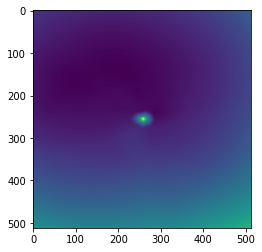

epoch 67801: 47.8790397644043
epoch 67802: 48.379058837890625
epoch 67803: 47.870513916015625
epoch 67804: 48.41130065917969
epoch 67805: 48.701026916503906
epoch 67806: 48.6588020324707
epoch 67807: 49.180572509765625
epoch 67808: 48.50249481201172
epoch 67809: 47.72464370727539
epoch 67811: 48.3515739440918
epoch 67812: 47.86302185058594
epoch 67813: 48.481231689453125
epoch 67814: 48.07113265991211
epoch 67815: 49.27340316772461
epoch 67816: 47.592140197753906
epoch 67817: 48.118343353271484
epoch 67818: 48.21656036376953
epoch 67819: 48.32242202758789
epoch 67821: 48.722740173339844
epoch 67822: 48.59001922607422
epoch 67823: 48.429683685302734
epoch 67824: 47.9655647277832
epoch 67825: 48.477230072021484
epoch 67826: 48.03064727783203
epoch 67827: 48.35249328613281
epoch 67828: 48.25361251831055
epoch 67829: 48.25959014892578
epoch 67831: 48.28459930419922
epoch 67832: 48.47184371948242
epoch 67833: 49.45084762573242
epoch 67834: 48.93067169189453
epoch 67835: 48.12272644042969
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



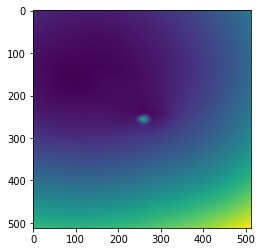

epoch 67901: 48.209625244140625
epoch 67902: 47.76825714111328
epoch 67903: 49.109222412109375
epoch 67904: 48.58213424682617
epoch 67905: 47.422752380371094
epoch 67906: 47.08930969238281
epoch 67907: 48.08751678466797
epoch 67908: 48.72753143310547
epoch 67909: 48.48856735229492
epoch 67911: 48.566650390625
epoch 67912: 48.94274139404297
epoch 67913: 47.49779510498047
epoch 67914: 47.4173698425293
epoch 67915: 48.635013580322266
epoch 67916: 48.27470397949219
epoch 67917: 47.78855514526367
epoch 67918: 48.289817810058594
epoch 67919: 48.19938659667969
epoch 67921: 47.28892517089844
epoch 67922: 47.685306549072266
epoch 67923: 47.34206771850586
epoch 67924: 48.052589416503906
epoch 67925: 49.47541809082031
epoch 67926: 48.39155197143555
epoch 67927: 48.4913330078125
epoch 67928: 47.322242736816406
epoch 67929: 47.84742736816406
epoch 67931: 48.1567268371582
epoch 67932: 48.010677337646484
epoch 67933: 48.28636932373047
epoch 67934: 48.0521125793457
epoch 67935: 48.078529357910156
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



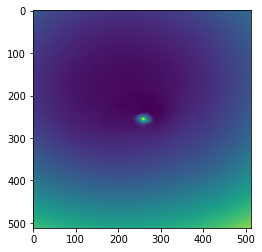

epoch 68001: 47.49326705932617
epoch 68002: 47.95172119140625
epoch 68003: 47.968666076660156
epoch 68004: 47.86729431152344
epoch 68005: 47.6378173828125
epoch 68006: 48.26110076904297
epoch 68007: 48.662540435791016
epoch 68008: 48.12681198120117
epoch 68009: 48.285560607910156
epoch 68011: 48.20401382446289
epoch 68012: 47.819244384765625
epoch 68013: 48.841068267822266
epoch 68014: 48.46916961669922
epoch 68015: 47.73551559448242
epoch 68016: 47.91211700439453
epoch 68017: 47.959808349609375
epoch 68018: 47.36640548706055
epoch 68019: 47.85013198852539
epoch 68021: 48.59198760986328
epoch 68022: 47.90900421142578
epoch 68023: 47.6739616394043
epoch 68024: 47.08582305908203
epoch 68025: 48.307552337646484
epoch 68026: 47.28158187866211
epoch 68027: 48.16876983642578
epoch 68028: 48.05957794189453
epoch 68029: 47.292442321777344
epoch 68031: 48.23463439941406
epoch 68032: 48.11042022705078
epoch 68033: 47.58879852294922
epoch 68034: 47.98828887939453
epoch 68035: 48.41175842285156
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



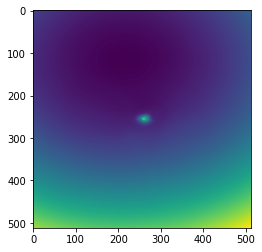

epoch 68101: 48.029518127441406
epoch 68102: 48.290679931640625
epoch 68103: 47.90452194213867
epoch 68104: 48.120880126953125
epoch 68105: 48.711578369140625
epoch 68106: 50.628849029541016
epoch 68107: 48.61448669433594
epoch 68108: 47.971473693847656
epoch 68109: 49.4442253112793
epoch 68111: 48.71049880981445
epoch 68112: 47.73556900024414
epoch 68113: 49.33330535888672
epoch 68114: 48.346431732177734
epoch 68115: 48.144737243652344
epoch 68116: 48.11589050292969
epoch 68117: 50.1161003112793
epoch 68118: 48.55516052246094
epoch 68119: 47.734031677246094
epoch 68121: 48.05314254760742
epoch 68122: 48.05789566040039
epoch 68123: 47.8793830871582
epoch 68124: 48.641780853271484
epoch 68125: 47.86732482910156
epoch 68126: 48.44791030883789
epoch 68127: 48.38066101074219
epoch 68128: 48.99325180053711
epoch 68129: 48.808258056640625
epoch 68131: 49.1966667175293
epoch 68132: 48.24454116821289
epoch 68133: 48.5821418762207
epoch 68134: 47.710601806640625
epoch 68135: 47.92823791503906
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



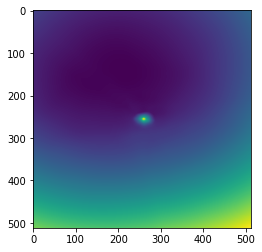

epoch 68201: 47.463287353515625
epoch 68202: 48.08295440673828
epoch 68203: 47.5125617980957
epoch 68204: 48.92933654785156
epoch 68205: 48.5753288269043
epoch 68206: 48.534149169921875
epoch 68207: 49.11109924316406
epoch 68208: 47.932525634765625
epoch 68209: 48.29399871826172
epoch 68211: 47.51262664794922
epoch 68212: 48.169620513916016
epoch 68213: 47.83200454711914
epoch 68214: 48.49978256225586
epoch 68215: 48.024417877197266
epoch 68216: 47.72905349731445
epoch 68217: 48.94282913208008
epoch 68218: 48.03041076660156
epoch 68219: 48.489036560058594
epoch 68221: 48.81693649291992
epoch 68222: 47.68247985839844
epoch 68223: 48.70817947387695
epoch 68224: 48.023101806640625
epoch 68225: 48.8406867980957
epoch 68226: 47.75554656982422
epoch 68227: 47.55656433105469
epoch 68228: 48.93487548828125
epoch 68229: 48.033573150634766
epoch 68231: 47.52166748046875
epoch 68232: 47.542449951171875
epoch 68233: 48.889610290527344
epoch 68234: 48.03208923339844
epoch 68235: 48.64323806762695
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



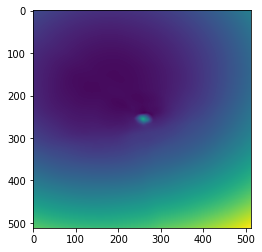

epoch 68301: 47.92660903930664
epoch 68302: 48.15361404418945
epoch 68303: 48.26758575439453
epoch 68304: 47.75519943237305
epoch 68305: 47.28853988647461
epoch 68306: 47.460174560546875
epoch 68307: 46.84087371826172
epoch 68308: 47.72372055053711
epoch 68309: 48.50359344482422
epoch 68311: 48.40740203857422
epoch 68312: 49.39541244506836
epoch 68313: 48.26292419433594
epoch 68314: 48.4410400390625
epoch 68315: 47.68183135986328
epoch 68316: 47.25566864013672
epoch 68317: 47.916748046875
epoch 68318: 47.945247650146484
epoch 68319: 49.151546478271484
epoch 68321: 49.445648193359375
epoch 68322: 48.24654006958008
epoch 68323: 48.119056701660156
epoch 68324: 48.310157775878906
epoch 68325: 48.61835479736328
epoch 68326: 48.563621520996094
epoch 68327: 48.991722106933594
epoch 68328: 48.654476165771484
epoch 68329: 47.619651794433594
epoch 68331: 47.86235046386719
epoch 68332: 47.52978515625
epoch 68333: 47.718624114990234
epoch 68334: 48.439884185791016
epoch 68335: 47.482421875
epoch 6

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



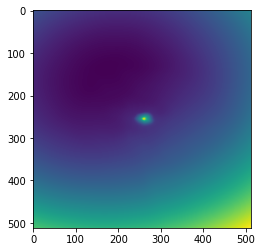

epoch 68401: 47.62528610229492
epoch 68402: 48.56105041503906
epoch 68403: 48.40658187866211
epoch 68404: 48.1992073059082
epoch 68405: 48.482486724853516
epoch 68406: 48.83023452758789
epoch 68407: 48.01030349731445
epoch 68408: 48.30577087402344
epoch 68409: 47.938236236572266
epoch 68411: 48.07748031616211
epoch 68412: 47.86913299560547
epoch 68413: 48.376007080078125
epoch 68414: 48.04145050048828
epoch 68415: 49.806007385253906
epoch 68416: 48.56800842285156
epoch 68417: 48.31926345825195
epoch 68418: 47.474456787109375
epoch 68419: 48.07278823852539
epoch 68421: 47.69443893432617
epoch 68422: 48.13040542602539
epoch 68423: 48.362884521484375
epoch 68424: 47.62158203125
epoch 68425: 47.866519927978516
epoch 68426: 49.05099868774414
epoch 68427: 48.04705810546875
epoch 68428: 48.70243835449219
epoch 68429: 47.80805206298828
epoch 68431: 48.62455749511719
epoch 68432: 48.467506408691406
epoch 68433: 47.25599670410156
epoch 68434: 48.33004379272461
epoch 68435: 47.756778717041016
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



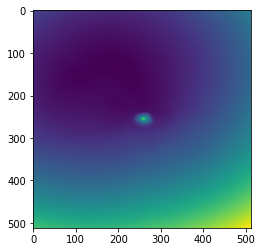

epoch 68501: 48.561805725097656
epoch 68502: 48.11513137817383
epoch 68503: 48.996437072753906
epoch 68504: 48.665645599365234
epoch 68505: 47.6082649230957
epoch 68506: 47.76025390625
epoch 68507: 48.14506530761719
epoch 68508: 48.10964584350586
epoch 68509: 48.18673324584961
epoch 68511: 48.42989730834961
epoch 68512: 48.29111862182617
epoch 68513: 47.85341262817383
epoch 68514: 48.27811050415039
epoch 68515: 47.48200225830078
epoch 68516: 48.41225051879883
epoch 68517: 48.15785598754883
epoch 68518: 48.6895866394043
epoch 68519: 47.6152458190918
epoch 68521: 47.80722427368164
epoch 68522: 48.46669387817383
epoch 68523: 47.00175094604492
epoch 68524: 47.429832458496094
epoch 68525: 48.18544387817383
epoch 68526: 48.076507568359375
epoch 68527: 49.09007263183594
epoch 68528: 47.79573059082031
epoch 68529: 47.798866271972656
epoch 68531: 48.005287170410156
epoch 68532: 48.260066986083984
epoch 68533: 47.79862976074219
epoch 68534: 47.45042419433594
epoch 68535: 48.10484313964844
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



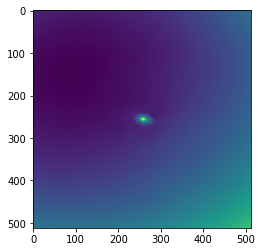

epoch 68601: 47.2088737487793
epoch 68602: 48.99739074707031
epoch 68603: 47.24974822998047
epoch 68604: 48.92580795288086
epoch 68605: 48.000370025634766
epoch 68606: 48.38882064819336
epoch 68607: 48.05344772338867
epoch 68608: 48.6302490234375
epoch 68609: 49.117252349853516
epoch 68611: 48.51789855957031
epoch 68612: 48.409751892089844
epoch 68613: 49.041412353515625
epoch 68614: 48.6525993347168
epoch 68615: 48.37217712402344
epoch 68616: 48.83808898925781
epoch 68617: 47.58290481567383
epoch 68618: 48.4229850769043
epoch 68619: 49.02595138549805
epoch 68621: 49.259517669677734
epoch 68622: 48.36906051635742
epoch 68623: 48.038726806640625
epoch 68624: 48.20754623413086
epoch 68625: 47.97221374511719
epoch 68626: 47.283477783203125
epoch 68627: 48.20114517211914
epoch 68628: 48.03200912475586
epoch 68629: 48.26389694213867
epoch 68631: 49.013633728027344
epoch 68632: 48.68454360961914
epoch 68633: 48.43068313598633
epoch 68634: 48.215003967285156
epoch 68635: 48.32300567626953
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



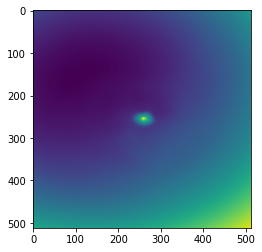

epoch 68701: 47.47439956665039
epoch 68702: 48.22589874267578
epoch 68703: 47.53608703613281
epoch 68704: 47.08769989013672
epoch 68705: 47.91975402832031
epoch 68706: 48.12205505371094
epoch 68707: 47.528621673583984
epoch 68708: 48.14086151123047
epoch 68709: 48.064369201660156
epoch 68711: 47.689552307128906
epoch 68712: 47.8599967956543
epoch 68713: 48.260704040527344
epoch 68714: 48.111053466796875
epoch 68715: 47.73710250854492
epoch 68716: 48.24248504638672
epoch 68717: 47.976619720458984
epoch 68718: 47.1298828125
epoch 68719: 47.82174301147461
epoch 68721: 47.30709457397461
epoch 68722: 47.66178512573242
epoch 68723: 47.68781661987305
epoch 68724: 46.89751434326172
epoch 68725: 47.664085388183594
epoch 68726: 48.270545959472656
epoch 68727: 47.24284362792969
epoch 68728: 48.67387008666992
epoch 68729: 48.02806091308594
epoch 68731: 48.17989730834961
epoch 68732: 48.3953857421875
epoch 68733: 48.36482238769531
epoch 68734: 48.09981155395508
epoch 68735: 48.326393127441406
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



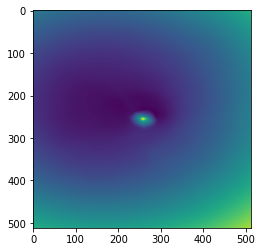

epoch 68801: 47.978973388671875
epoch 68802: 48.84587097167969
epoch 68803: 48.37731170654297
epoch 68804: 48.525245666503906
epoch 68805: 48.391090393066406
epoch 68806: 49.59874725341797
epoch 68807: 49.302040100097656
epoch 68808: 48.66878128051758
epoch 68809: 47.86648178100586
epoch 68811: 48.77710723876953
epoch 68812: 47.60267639160156
epoch 68813: 49.07941436767578
epoch 68814: 47.80864715576172
epoch 68815: 49.1998291015625
epoch 68816: 49.95000457763672
epoch 68817: 48.66036605834961
epoch 68818: 47.945831298828125
epoch 68819: 48.33908462524414
epoch 68821: 47.55829620361328
epoch 68822: 48.60205841064453
epoch 68823: 48.42463684082031
epoch 68824: 48.52079772949219
epoch 68825: 48.098731994628906
epoch 68826: 48.57859420776367
epoch 68827: 47.58892822265625
epoch 68828: 48.52492904663086
epoch 68829: 48.78095626831055
epoch 68831: 47.96038818359375
epoch 68832: 49.31840896606445
epoch 68833: 48.30137634277344
epoch 68834: 47.48704528808594
epoch 68835: 47.914894104003906
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



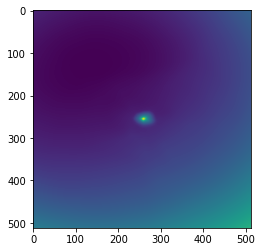

epoch 68901: 48.14421844482422
epoch 68902: 48.094425201416016
epoch 68903: 47.65663146972656
epoch 68904: 48.744659423828125
epoch 68905: 47.71605682373047
epoch 68906: 48.37289810180664
epoch 68907: 48.80284881591797
epoch 68908: 48.55284118652344
epoch 68909: 47.33475875854492
epoch 68911: 47.87792205810547
epoch 68912: 47.72090148925781
epoch 68913: 48.092063903808594
epoch 68914: 47.98230743408203
epoch 68915: 47.47170639038086
epoch 68916: 48.89508819580078
epoch 68917: 48.13219451904297
epoch 68918: 47.853187561035156
epoch 68919: 49.00196075439453
epoch 68921: 48.28855895996094
epoch 68922: 48.22895431518555
epoch 68923: 47.96761703491211
epoch 68924: 48.40183639526367
epoch 68925: 48.04355239868164
epoch 68926: 47.820404052734375
epoch 68927: 47.88446807861328
epoch 68928: 48.128440856933594
epoch 68929: 47.82078170776367
epoch 68931: 49.05004119873047
epoch 68932: 47.32884979248047
epoch 68933: 47.13144302368164
epoch 68934: 48.33688735961914
epoch 68935: 48.22102355957031
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



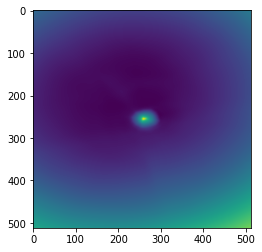

epoch 69001: 48.303287506103516
epoch 69002: 47.81013870239258
epoch 69003: 47.95332717895508
epoch 69004: 48.37322998046875
epoch 69005: 48.31259536743164
epoch 69006: 48.13194274902344
epoch 69007: 47.955955505371094
epoch 69008: 47.821353912353516
epoch 69009: 48.69339370727539
epoch 69011: 49.34685134887695
epoch 69012: 49.662811279296875
epoch 69013: 47.5684928894043
epoch 69014: 49.48421096801758
epoch 69015: 48.64990997314453
epoch 69016: 48.53363037109375
epoch 69017: 50.10090255737305
epoch 69018: 48.84051513671875
epoch 69019: 48.599037170410156
epoch 69021: 49.10691452026367
epoch 69022: 48.25628662109375
epoch 69023: 47.972869873046875
epoch 69024: 48.633338928222656
epoch 69025: 48.10683822631836
epoch 69026: 47.65541458129883
epoch 69027: 48.4484748840332
epoch 69028: 47.59208297729492
epoch 69029: 52.55368423461914
epoch 69031: 47.756980895996094
epoch 69032: 47.89896774291992
epoch 69033: 47.86565017700195
epoch 69034: 48.821895599365234
epoch 69035: 47.608516693115234


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



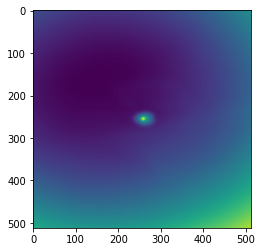

epoch 69101: 48.211631774902344
epoch 69102: 48.54484558105469
epoch 69103: 47.722572326660156
epoch 69104: 48.21355438232422
epoch 69105: 48.05247497558594
epoch 69106: 47.712608337402344
epoch 69107: 48.10324478149414
epoch 69108: 47.96533203125
epoch 69109: 48.2661247253418
epoch 69111: 48.429378509521484
epoch 69112: 47.16423034667969
epoch 69113: 50.68950653076172
epoch 69114: 47.53923797607422
epoch 69115: 47.32675552368164
epoch 69116: 48.10839080810547
epoch 69117: 47.67177200317383
epoch 69118: 48.94287872314453
epoch 69119: 48.17169952392578
epoch 69121: 48.381710052490234
epoch 69122: 47.961639404296875
epoch 69123: 49.2181510925293
epoch 69124: 48.843177795410156
epoch 69125: 47.96786117553711
epoch 69126: 47.744651794433594
epoch 69127: 48.08412170410156
epoch 69128: 47.839176177978516
epoch 69129: 48.008331298828125
epoch 69131: 47.71185302734375
epoch 69132: 47.84092712402344
epoch 69133: 47.93962097167969
epoch 69134: 48.19367599487305
epoch 69135: 47.92795181274414
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



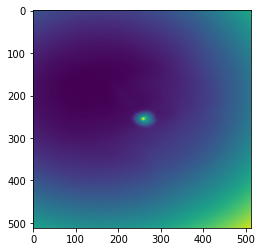

epoch 69201: 48.285194396972656
epoch 69202: 48.386207580566406
epoch 69203: 48.47529220581055
epoch 69204: 48.393611907958984
epoch 69205: 48.58960723876953
epoch 69206: 48.53437042236328
epoch 69207: 47.96988296508789
epoch 69208: 48.24641036987305
epoch 69209: 48.43886184692383
epoch 69211: 48.213966369628906
epoch 69212: 48.04523849487305
epoch 69213: 49.80420684814453
epoch 69214: 47.775367736816406
epoch 69215: 48.171871185302734
epoch 69216: 47.90118408203125
epoch 69217: 48.69746017456055
epoch 69218: 49.9124870300293
epoch 69219: 48.66678237915039
epoch 69221: 47.78912353515625
epoch 69222: 48.06037139892578
epoch 69223: 48.415672302246094
epoch 69224: 48.10337829589844
epoch 69225: 47.97574234008789
epoch 69226: 48.90145492553711
epoch 69227: 48.69252395629883
epoch 69228: 48.17268753051758
epoch 69229: 48.39866638183594
epoch 69231: 49.05644989013672
epoch 69232: 48.070899963378906
epoch 69233: 47.98947525024414
epoch 69234: 47.27292251586914
epoch 69235: 48.345855712890625


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



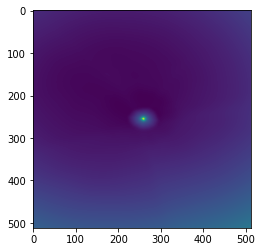

epoch 69301: 48.950401306152344
epoch 69302: 49.25776672363281
epoch 69303: 47.85093307495117
epoch 69304: 48.127220153808594
epoch 69305: 47.9091911315918
epoch 69306: 48.4037971496582
epoch 69307: 48.33315658569336
epoch 69308: 48.29214096069336
epoch 69309: 47.484073638916016
epoch 69311: 48.958431243896484
epoch 69312: 48.211158752441406
epoch 69313: 50.062992095947266
epoch 69314: 47.99970245361328
epoch 69315: 47.825721740722656
epoch 69316: 48.36887741088867
epoch 69317: 47.97889709472656
epoch 69318: 48.14722442626953
epoch 69319: 48.06953048706055
epoch 69321: 47.906681060791016
epoch 69322: 49.03358459472656
epoch 69323: 47.865055084228516
epoch 69324: 48.07537078857422
epoch 69325: 48.47478485107422
epoch 69326: 48.11025619506836
epoch 69327: 47.64754867553711
epoch 69328: 47.80439758300781
epoch 69329: 48.26314926147461
epoch 69331: 47.418052673339844
epoch 69332: 47.57550048828125
epoch 69333: 47.81163024902344
epoch 69334: 47.38765335083008
epoch 69335: 48.87705993652344


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



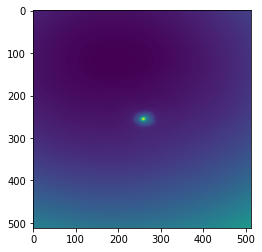

epoch 69401: 49.903011322021484
epoch 69402: 49.72726821899414
epoch 69403: 47.952110290527344
epoch 69404: 49.95804214477539
epoch 69405: 48.60419845581055
epoch 69406: 48.260860443115234
epoch 69407: 47.865684509277344
epoch 69408: 48.27510452270508
epoch 69409: 48.465660095214844
epoch 69411: 47.88329315185547
epoch 69412: 48.329994201660156
epoch 69413: 48.79465866088867
epoch 69414: 47.43231201171875
epoch 69415: 48.04780578613281
epoch 69416: 47.551631927490234
epoch 69417: 48.81667709350586
epoch 69418: 47.690223693847656
epoch 69419: 47.641422271728516
epoch 69421: 47.421836853027344
epoch 69422: 48.17605972290039
epoch 69423: 47.85302734375
epoch 69424: 48.775352478027344
epoch 69425: 47.919776916503906
epoch 69426: 47.627689361572266
epoch 69427: 48.266178131103516
epoch 69428: 48.334228515625
epoch 69429: 48.140438079833984
epoch 69431: 48.451942443847656
epoch 69432: 48.977943420410156
epoch 69433: 48.6235237121582
epoch 69434: 47.724952697753906
epoch 69435: 48.40063095092

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



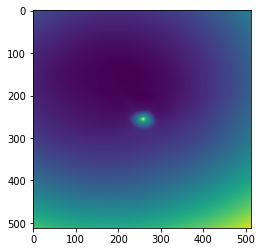

epoch 69501: 48.25507354736328
epoch 69502: 48.5128173828125
epoch 69503: 48.10825729370117
epoch 69504: 47.68415832519531
epoch 69505: 48.46770477294922
epoch 69506: 48.700347900390625
epoch 69507: 49.27018356323242
epoch 69508: 48.69912338256836
epoch 69509: 47.99907302856445
epoch 69511: 48.30495834350586
epoch 69512: 48.967323303222656
epoch 69513: 48.68265914916992
epoch 69514: 48.035438537597656
epoch 69515: 48.463619232177734
epoch 69516: 48.801368713378906
epoch 69517: 48.62575149536133
epoch 69518: 48.43508529663086
epoch 69519: 48.9034538269043
epoch 69521: 47.52799987792969
epoch 69522: 47.07106018066406
epoch 69523: 48.56296157836914
epoch 69524: 48.042938232421875
epoch 69525: 47.769290924072266
epoch 69526: 47.628238677978516
epoch 69527: 47.772335052490234
epoch 69528: 48.750675201416016
epoch 69529: 47.500572204589844
epoch 69531: 47.35308074951172
epoch 69532: 47.950538635253906
epoch 69533: 49.013572692871094
epoch 69534: 48.322792053222656
epoch 69535: 47.70386886596

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



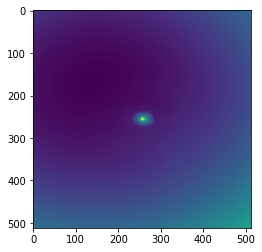

epoch 69601: 47.827598571777344
epoch 69602: 48.08443069458008
epoch 69603: 48.60747146606445
epoch 69604: 47.92462158203125
epoch 69605: 47.93183898925781
epoch 69606: 47.902137756347656
epoch 69607: 47.91666793823242
epoch 69608: 47.8344612121582
epoch 69609: 49.00334548950195
epoch 69611: 47.57324981689453
epoch 69612: 48.316261291503906
epoch 69613: 47.83150100708008
epoch 69614: 47.85997772216797
epoch 69615: 47.86793518066406
epoch 69616: 48.040771484375
epoch 69617: 47.09376525878906
epoch 69618: 48.11370849609375
epoch 69619: 47.918331146240234
epoch 69621: 48.315956115722656
epoch 69622: 48.10150909423828
epoch 69623: 47.82849884033203
epoch 69624: 48.92277526855469
epoch 69625: 48.327457427978516
epoch 69626: 48.9254035949707
epoch 69627: 47.37726974487305
epoch 69628: 48.08731460571289
epoch 69629: 48.9124641418457
epoch 69631: 48.02146530151367
epoch 69632: 48.41410827636719
epoch 69633: 47.395721435546875
epoch 69634: 47.928009033203125
epoch 69635: 48.78705978393555
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



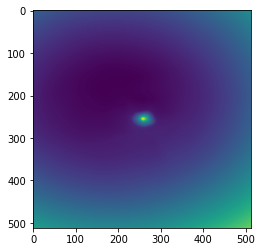

epoch 69701: 47.882022857666016
epoch 69702: 47.428863525390625
epoch 69703: 48.415348052978516
epoch 69704: 47.674983978271484
epoch 69705: 47.60759735107422
epoch 69706: 48.65420150756836
epoch 69707: 48.048309326171875
epoch 69708: 48.43486404418945
epoch 69709: 48.18657684326172
epoch 69711: 48.29403305053711
epoch 69712: 47.918060302734375
epoch 69713: 47.90257263183594
epoch 69714: 47.545772552490234
epoch 69715: 48.11350631713867
epoch 69716: 48.0882568359375
epoch 69717: 47.652740478515625
epoch 69718: 48.102359771728516
epoch 69719: 47.83833312988281
epoch 69721: 48.73214340209961
epoch 69722: 47.57706069946289
epoch 69723: 48.47319030761719
epoch 69724: 47.85957717895508
epoch 69725: 47.83060073852539
epoch 69726: 49.06972122192383
epoch 69727: 48.12073516845703
epoch 69728: 47.74464416503906
epoch 69729: 48.666770935058594
epoch 69731: 48.53226089477539
epoch 69732: 48.30539321899414
epoch 69733: 48.47245788574219
epoch 69734: 49.43623733520508
epoch 69735: 48.32154083251953

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



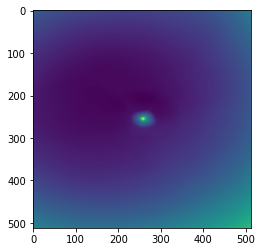

epoch 69801: 48.703147888183594
epoch 69802: 48.0462532043457
epoch 69803: 48.01167297363281
epoch 69804: 49.07195281982422
epoch 69805: 48.186771392822266
epoch 69806: 47.6465950012207
epoch 69807: 47.753387451171875
epoch 69808: 47.49296188354492
epoch 69809: 47.48514938354492
epoch 69811: 47.7143440246582
epoch 69812: 47.66108322143555
epoch 69813: 48.19405746459961
epoch 69814: 47.71587371826172
epoch 69815: 47.74495315551758
epoch 69816: 48.188209533691406
epoch 69817: 47.65556335449219
epoch 69818: 47.01101303100586
epoch 69819: 47.59931564331055
epoch 69821: 48.21281433105469
epoch 69822: 48.49395751953125
epoch 69823: 48.190792083740234
epoch 69824: 48.741634368896484
epoch 69825: 47.9678955078125
epoch 69826: 47.80426025390625
epoch 69827: 48.009132385253906
epoch 69828: 48.301151275634766
epoch 69829: 48.44384765625
epoch 69831: 55.941558837890625
epoch 69832: 50.478515625
epoch 69833: 48.771175384521484
epoch 69834: 48.41288757324219
epoch 69835: 48.65308380126953
epoch 6983

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



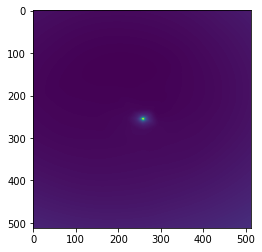

epoch 69901: 48.37904739379883
epoch 69902: 48.215518951416016
epoch 69903: 47.56806945800781
epoch 69904: 48.26753616333008
epoch 69905: 48.99585723876953
epoch 69906: 47.9304313659668
epoch 69907: 49.54131317138672
epoch 69908: 47.62482452392578
epoch 69909: 48.103355407714844
epoch 69911: 48.32316589355469
epoch 69912: 48.15143966674805
epoch 69913: 48.20924758911133
epoch 69914: 48.70076370239258
epoch 69915: 48.69324493408203
epoch 69916: 48.509403228759766
epoch 69917: 47.42401885986328
epoch 69918: 48.55027770996094
epoch 69919: 48.32868194580078
epoch 69921: 49.26346206665039
epoch 69922: 49.43209457397461
epoch 69923: 47.680633544921875
epoch 69924: 47.325077056884766
epoch 69925: 48.023529052734375
epoch 69926: 47.733802795410156
epoch 69927: 48.79512023925781
epoch 69928: 47.99604034423828
epoch 69929: 48.203128814697266
epoch 69931: 47.58964157104492
epoch 69932: 47.87899398803711
epoch 69933: 47.63360595703125
epoch 69934: 48.025856018066406
epoch 69935: 47.644168853759766

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



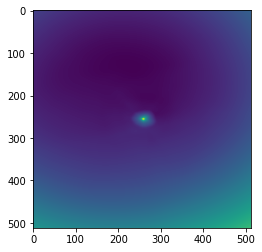

epoch 70001: 48.8697395324707
epoch 70002: 48.1114616394043
epoch 70003: 48.86947250366211
epoch 70004: 47.368221282958984
epoch 70005: 48.138572692871094
epoch 70006: 48.61400604248047
epoch 70007: 48.10728073120117
epoch 70008: 48.014015197753906
epoch 70009: 48.57655715942383
epoch 70011: 48.28732681274414
epoch 70012: 47.22224426269531
epoch 70013: 47.82798385620117
epoch 70014: 48.095191955566406
epoch 70015: 47.97365951538086
epoch 70016: 47.79068374633789
epoch 70017: 48.188568115234375
epoch 70018: 47.56975173950195
epoch 70019: 52.20344924926758
epoch 70021: 47.57777786254883
epoch 70022: 47.89390563964844
epoch 70023: 49.17631530761719
epoch 70024: 48.91959762573242
epoch 70025: 48.3631706237793
epoch 70026: 47.96291732788086
epoch 70027: 47.57194519042969
epoch 70028: 47.40167236328125
epoch 70029: 48.12199401855469
epoch 70031: 47.555564880371094
epoch 70032: 47.89215087890625
epoch 70033: 48.62990188598633
epoch 70034: 48.81462860107422
epoch 70035: 47.50666427612305
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



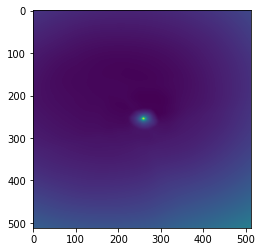

epoch 70101: 47.75882339477539
epoch 70102: 48.676971435546875
epoch 70103: 49.373477935791016
epoch 70104: 48.02992630004883
epoch 70105: 47.9512939453125
epoch 70106: 47.796531677246094
epoch 70107: 48.78835678100586
epoch 70108: 48.37939453125
epoch 70109: 47.59923553466797
epoch 70111: 48.19512939453125
epoch 70112: 49.14039993286133
epoch 70113: 48.21821975708008
epoch 70114: 47.57088851928711
epoch 70115: 48.42414093017578
epoch 70116: 48.331668853759766
epoch 70117: 47.70476150512695
epoch 70118: 47.97233963012695
epoch 70119: 49.052947998046875
epoch 70121: 47.15276336669922
epoch 70122: 47.782012939453125
epoch 70123: 48.17981719970703
epoch 70124: 51.97781753540039
epoch 70125: 48.12900161743164
epoch 70126: 48.61336898803711
epoch 70127: 48.317657470703125
epoch 70128: 47.836997985839844
epoch 70129: 48.58525085449219
epoch 70131: 48.36399841308594
epoch 70132: 48.059959411621094
epoch 70133: 47.58796310424805
epoch 70134: 48.16870880126953
epoch 70135: 48.40462875366211
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



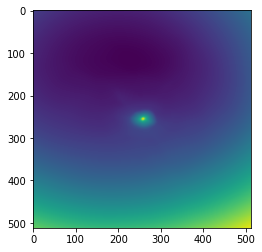

epoch 70201: 47.51419448852539
epoch 70202: 47.623199462890625
epoch 70203: 48.281959533691406
epoch 70204: 48.30555725097656
epoch 70205: 47.704246520996094
epoch 70206: 47.628543853759766
epoch 70207: 46.947166442871094
epoch 70208: 49.36035919189453
epoch 70209: 47.31559371948242
epoch 70211: 48.37504196166992
epoch 70212: 52.12953567504883
epoch 70213: 47.410823822021484
epoch 70214: 47.91518783569336
epoch 70215: 47.35151290893555
epoch 70216: 47.80390548706055
epoch 70217: 48.55767822265625
epoch 70218: 48.24169158935547
epoch 70219: 48.03997802734375
epoch 70221: 48.553367614746094
epoch 70222: 48.70454025268555
epoch 70223: 48.145721435546875
epoch 70224: 47.431392669677734
epoch 70225: 51.47064971923828
epoch 70226: 49.226627349853516
epoch 70227: 47.6333122253418
epoch 70228: 47.88331604003906
epoch 70229: 49.89259338378906
epoch 70231: 48.09599304199219
epoch 70232: 48.09013366699219
epoch 70233: 48.60155487060547
epoch 70234: 47.686649322509766
epoch 70235: 48.1782035827636

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



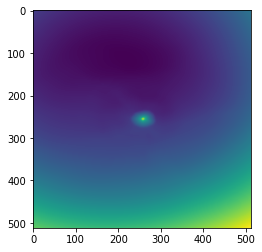

epoch 70301: 48.66815185546875
epoch 70302: 48.12960433959961
epoch 70303: 48.03730392456055
epoch 70304: 48.10233688354492
epoch 70305: 48.384456634521484
epoch 70306: 48.64799118041992
epoch 70307: 47.226566314697266
epoch 70308: 48.193111419677734
epoch 70309: 48.19740295410156
epoch 70311: 47.9769287109375
epoch 70312: 47.220027923583984
epoch 70313: 48.434173583984375
epoch 70314: 48.06340408325195
epoch 70315: 49.038082122802734
epoch 70316: 48.61210632324219
epoch 70317: 48.907291412353516
epoch 70318: 48.674476623535156
epoch 70319: 48.43963623046875
epoch 70321: 48.2087287902832
epoch 70322: 48.19523239135742
epoch 70323: 47.909690856933594
epoch 70324: 47.62236022949219
epoch 70325: 47.67024230957031
epoch 70326: 47.29127502441406
epoch 70327: 47.54986572265625
epoch 70328: 47.699745178222656
epoch 70329: 47.3722038269043
epoch 70331: 47.606895446777344
epoch 70332: 48.24900436401367
epoch 70333: 47.78535079956055
epoch 70334: 48.622039794921875
epoch 70335: 47.35931396484375

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



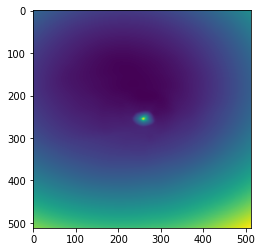

epoch 70401: 48.03483200073242
epoch 70402: 47.51966094970703
epoch 70403: 47.509033203125
epoch 70404: 47.86265182495117
epoch 70405: 49.03291702270508
epoch 70406: 47.852664947509766
epoch 70407: 48.23029708862305
epoch 70408: 48.115013122558594
epoch 70409: 48.39826965332031
epoch 70411: 48.42938232421875
epoch 70412: 47.307334899902344
epoch 70413: 48.50652313232422
epoch 70414: 47.68986892700195
epoch 70415: 49.13945007324219
epoch 70416: 47.64022445678711
epoch 70417: 48.20124435424805
epoch 70418: 48.42096710205078
epoch 70419: 47.88646697998047
epoch 70421: 48.059898376464844
epoch 70422: 47.98268508911133
epoch 70423: 47.99568176269531
epoch 70424: 47.560791015625
epoch 70425: 48.429969787597656
epoch 70426: 48.180572509765625
epoch 70427: 48.11792755126953
epoch 70428: 47.75807189941406
epoch 70429: 48.86038589477539
epoch 70431: 49.042415618896484
epoch 70432: 47.312808990478516
epoch 70433: 48.183616638183594
epoch 70434: 47.804100036621094
epoch 70435: 48.41086959838867
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



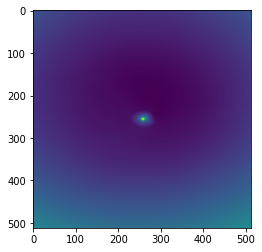

epoch 70501: 47.213356018066406
epoch 70502: 48.56580352783203
epoch 70503: 49.0749397277832
epoch 70504: 49.113243103027344
epoch 70505: 48.22018814086914
epoch 70506: 48.779537200927734
epoch 70507: 48.10202407836914
epoch 70508: 48.08517074584961
epoch 70509: 47.96076202392578
epoch 70511: 47.913265228271484
epoch 70512: 48.18211364746094
epoch 70513: 47.74179458618164
epoch 70514: 49.266998291015625
epoch 70515: 49.206459045410156
epoch 70516: 48.36780548095703
epoch 70517: 48.21516418457031
epoch 70518: 47.61525344848633
epoch 70519: 48.31367492675781
epoch 70521: 47.26915740966797
epoch 70522: 46.94554138183594
epoch 70523: 51.565006256103516
epoch 70524: 48.266693115234375
epoch 70525: 48.25119400024414
epoch 70526: 48.50092697143555
epoch 70527: 48.34838104248047
epoch 70528: 48.234527587890625
epoch 70529: 47.10856628417969
epoch 70531: 48.9542350769043
epoch 70532: 48.052452087402344
epoch 70533: 48.16437530517578
epoch 70534: 48.34039306640625
epoch 70535: 47.82300567626953


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



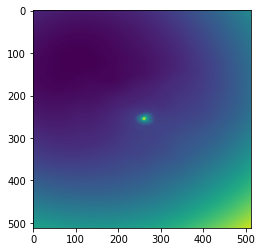

epoch 70601: 48.13726806640625
epoch 70602: 48.443851470947266
epoch 70603: 47.999698638916016
epoch 70604: 47.773353576660156
epoch 70605: 47.26068115234375
epoch 70606: 48.08525085449219
epoch 70607: 48.20077896118164
epoch 70608: 48.28422927856445
epoch 70609: 47.908897399902344
epoch 70611: 48.05489730834961
epoch 70612: 48.51570129394531
epoch 70613: 47.66621017456055
epoch 70614: 47.74678039550781
epoch 70615: 49.02484130859375
epoch 70616: 48.69676971435547
epoch 70617: 48.335514068603516
epoch 70618: 47.6855354309082
epoch 70619: 47.794254302978516
epoch 70621: 49.911224365234375
epoch 70622: 48.828060150146484
epoch 70623: 47.971153259277344
epoch 70624: 48.66708755493164
epoch 70625: 48.565269470214844
epoch 70626: 50.855648040771484
epoch 70627: 48.40531539916992
epoch 70628: 47.98291778564453
epoch 70629: 48.21744918823242
epoch 70631: 48.15583419799805
epoch 70632: 48.82501983642578
epoch 70633: 48.433109283447266
epoch 70634: 49.29994201660156
epoch 70635: 48.484882354736

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



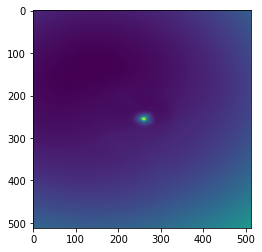

epoch 70701: 47.84218978881836
epoch 70702: 47.66172790527344
epoch 70703: 47.858497619628906
epoch 70704: 47.40654754638672
epoch 70705: 48.174476623535156
epoch 70706: 48.20479965209961
epoch 70707: 47.5286979675293
epoch 70708: 48.05602264404297
epoch 70709: 47.844703674316406
epoch 70711: 48.32298278808594
epoch 70712: 49.314083099365234
epoch 70713: 49.17624282836914
epoch 70714: 47.416629791259766
epoch 70715: 48.25957107543945
epoch 70716: 48.242828369140625
epoch 70717: 47.298133850097656
epoch 70718: 48.04548263549805
epoch 70719: 48.90784454345703
epoch 70721: 48.050071716308594
epoch 70722: 47.757633209228516
epoch 70723: 47.2549934387207
epoch 70724: 48.313175201416016
epoch 70725: 48.07548522949219
epoch 70726: 47.849422454833984
epoch 70727: 47.58024597167969
epoch 70728: 47.81478500366211
epoch 70729: 48.08010482788086
epoch 70731: 47.788726806640625
epoch 70732: 47.83894348144531
epoch 70733: 47.95043182373047
epoch 70734: 48.47184753417969
epoch 70735: 47.3275146484375

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



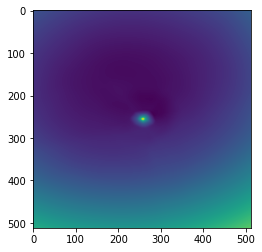

epoch 70801: 48.25885009765625
epoch 70802: 47.927955627441406
epoch 70803: 48.282310485839844
epoch 70804: 47.493927001953125
epoch 70805: 47.30393981933594
epoch 70806: 47.92179489135742
epoch 70807: 47.90963363647461
epoch 70808: 47.24237823486328
epoch 70809: 47.794044494628906
epoch 70811: 46.68984603881836
epoch 70812: 48.515968322753906
epoch 70813: 47.88993835449219
epoch 70814: 47.85486602783203
epoch 70815: 50.4847297668457
epoch 70816: 47.60091018676758
epoch 70817: 48.06318664550781
epoch 70818: 47.526126861572266
epoch 70819: 48.441802978515625
epoch 70821: 47.7039794921875
epoch 70822: 48.32088088989258
epoch 70823: 48.055667877197266
epoch 70824: 47.805686950683594
epoch 70825: 48.1009407043457
epoch 70826: 47.76771545410156
epoch 70827: 47.983333587646484
epoch 70828: 48.50995635986328
epoch 70829: 48.983299255371094
epoch 70831: 48.266456604003906
epoch 70832: 48.79914474487305
epoch 70833: 48.5228157043457
epoch 70834: 47.923770904541016
epoch 70835: 48.14118957519531

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



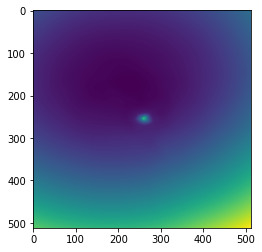

epoch 70901: 48.550559997558594
epoch 70902: 48.753543853759766
epoch 70903: 48.40358352661133
epoch 70904: 47.66181182861328
epoch 70905: 47.91028594970703
epoch 70906: 47.922786712646484
epoch 70907: 49.295127868652344
epoch 70908: 48.31351089477539
epoch 70909: 48.42110061645508
epoch 70911: 47.378597259521484
epoch 70912: 47.58824157714844
epoch 70913: 48.50395965576172
epoch 70914: 47.833160400390625
epoch 70915: 48.11027908325195
epoch 70916: 47.856624603271484
epoch 70917: 47.612579345703125
epoch 70918: 47.6146354675293
epoch 70919: 48.883567810058594
epoch 70921: 46.8964729309082
epoch 70922: 47.79653549194336
epoch 70923: 48.280189514160156
epoch 70924: 47.847530364990234
epoch 70925: 47.95528793334961
epoch 70926: 48.07366943359375
epoch 70927: 47.13731384277344
epoch 70928: 47.672584533691406
epoch 70929: 47.519874572753906
epoch 70931: 47.92435073852539
epoch 70932: 48.24635696411133
epoch 70933: 47.106754302978516
epoch 70934: 48.463104248046875
epoch 70935: 47.4118270874

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



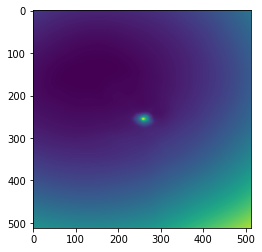

epoch 71001: 47.76388931274414
epoch 71002: 50.30311584472656
epoch 71003: 48.531532287597656
epoch 71004: 48.11163330078125
epoch 71005: 47.0002555847168
epoch 71006: 47.37285614013672
epoch 71007: 47.88477325439453
epoch 71008: 48.23249053955078
epoch 71009: 47.87799072265625
epoch 71011: 48.08031463623047
epoch 71012: 47.28816604614258
epoch 71013: 47.967750549316406
epoch 71014: 47.91245651245117
epoch 71015: 47.71806335449219
epoch 71016: 46.86174774169922
epoch 71017: 48.22728729248047
epoch 71018: 47.17487335205078
epoch 71019: 47.81739044189453
epoch 71021: 48.39927673339844
epoch 71022: 47.61909484863281
epoch 71023: 48.42917251586914
epoch 71024: 49.37375259399414
epoch 71025: 48.51875305175781
epoch 71026: 48.023983001708984
epoch 71027: 47.95747375488281
epoch 71028: 48.10978317260742
epoch 71029: 47.71330261230469
epoch 71031: 47.62632369995117
epoch 71032: 47.580814361572266
epoch 71033: 48.2726936340332
epoch 71034: 48.46164321899414
epoch 71035: 47.55841064453125
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



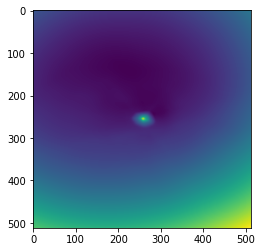

epoch 71101: 47.74575424194336
epoch 71102: 49.777565002441406
epoch 71103: 47.657981872558594
epoch 71104: 48.810585021972656
epoch 71105: 48.08115768432617
epoch 71106: 48.718570709228516
epoch 71107: 47.873138427734375
epoch 71108: 47.65835952758789
epoch 71109: 48.10360336303711
epoch 71111: 48.680538177490234
epoch 71112: 48.377628326416016
epoch 71113: 47.71467208862305
epoch 71114: 48.262977600097656
epoch 71115: 48.84990692138672
epoch 71116: 47.908145904541016
epoch 71117: 48.049659729003906
epoch 71118: 48.37845230102539
epoch 71119: 47.69229507446289
epoch 71121: 48.646305084228516
epoch 71122: 47.325809478759766
epoch 71123: 47.71391677856445
epoch 71124: 48.62217330932617
epoch 71125: 47.85018539428711
epoch 71126: 47.915042877197266
epoch 71127: 47.79073715209961
epoch 71128: 48.507198333740234
epoch 71129: 47.66407775878906
epoch 71131: 48.11285400390625
epoch 71132: 47.399810791015625
epoch 71133: 47.95750045776367
epoch 71134: 48.17069625854492
epoch 71135: 48.73441314

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



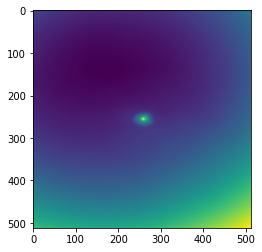

epoch 71201: 47.9377555847168
epoch 71202: 48.07217025756836
epoch 71203: 47.416446685791016
epoch 71204: 47.67414855957031
epoch 71205: 47.88462448120117
epoch 71206: 47.52827835083008
epoch 71207: 47.72071838378906
epoch 71208: 47.90153503417969
epoch 71209: 47.79380798339844
epoch 71211: 47.98286437988281
epoch 71212: 48.13937759399414
epoch 71213: 47.775814056396484
epoch 71214: 47.348106384277344
epoch 71215: 47.66316223144531
epoch 71216: 48.409847259521484
epoch 71217: 48.3618049621582
epoch 71218: 48.57420349121094
epoch 71219: 49.33441925048828
epoch 71221: 48.3469123840332
epoch 71222: 47.597808837890625
epoch 71223: 47.58957290649414
epoch 71224: 49.06737518310547
epoch 71225: 48.279075622558594
epoch 71226: 47.4133186340332
epoch 71227: 48.476043701171875
epoch 71228: 47.59121322631836
epoch 71229: 47.582027435302734
epoch 71231: 48.2948112487793
epoch 71232: 47.51179122924805
epoch 71233: 48.07136535644531
epoch 71234: 48.477176666259766
epoch 71235: 48.104244232177734
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



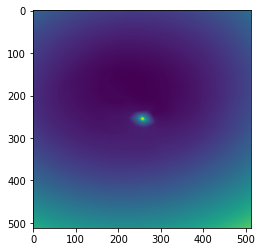

epoch 71301: 48.217506408691406
epoch 71302: 47.22256851196289
epoch 71303: 47.86396026611328
epoch 71304: 48.450252532958984
epoch 71305: 47.93604278564453
epoch 71306: 47.8223991394043
epoch 71307: 49.02569580078125
epoch 71308: 47.984249114990234
epoch 71309: 47.885650634765625
epoch 71311: 48.631103515625
epoch 71312: 48.10414505004883
epoch 71313: 47.80595397949219
epoch 71314: 47.579463958740234
epoch 71315: 48.368736267089844
epoch 71316: 47.460872650146484
epoch 71317: 47.74551773071289
epoch 71318: 48.6330451965332
epoch 71319: 48.94942855834961
epoch 71321: 48.102256774902344
epoch 71322: 47.94469451904297
epoch 71323: 47.10370635986328
epoch 71324: 47.97872543334961
epoch 71325: 48.5667839050293
epoch 71326: 48.00349044799805
epoch 71327: 48.115291595458984
epoch 71328: 49.11897277832031
epoch 71329: 47.92343521118164
epoch 71331: 47.77409744262695
epoch 71332: 48.01486587524414
epoch 71333: 48.642574310302734
epoch 71334: 47.783058166503906
epoch 71335: 48.622894287109375
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



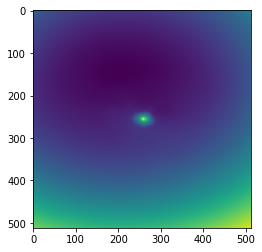

epoch 71401: 47.480506896972656
epoch 71402: 47.962120056152344
epoch 71403: 47.58375930786133
epoch 71404: 48.46355438232422
epoch 71405: 48.37005615234375
epoch 71406: 47.96138381958008
epoch 71407: 47.90932083129883
epoch 71408: 48.682960510253906
epoch 71409: 48.190452575683594
epoch 71411: 48.055519104003906
epoch 71412: 49.03085708618164
epoch 71413: 48.048648834228516
epoch 71414: 48.70621871948242
epoch 71415: 48.54453659057617
epoch 71416: 48.04573059082031
epoch 71417: 48.08937454223633
epoch 71418: 48.206424713134766
epoch 71419: 48.13119125366211
epoch 71421: 47.845558166503906
epoch 71422: 48.172664642333984
epoch 71423: 48.210594177246094
epoch 71424: 47.62544250488281
epoch 71425: 47.89926528930664
epoch 71426: 47.7288932800293
epoch 71427: 48.18715286254883
epoch 71428: 49.03416442871094
epoch 71429: 47.42168045043945
epoch 71431: 48.48051834106445
epoch 71432: 47.79012680053711
epoch 71433: 47.06374740600586
epoch 71434: 47.25818634033203
epoch 71435: 48.31316757202148

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



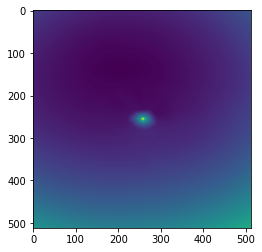

epoch 71501: 48.847660064697266
epoch 71502: 48.56465148925781
epoch 71503: 47.79995346069336
epoch 71504: 47.73841094970703
epoch 71505: 47.71509552001953
epoch 71506: 48.780792236328125
epoch 71507: 47.542015075683594
epoch 71508: 48.40798568725586
epoch 71509: 47.911231994628906
epoch 71511: 47.99946975708008
epoch 71512: 47.595497131347656
epoch 71513: 48.36014938354492
epoch 71514: 48.07263946533203
epoch 71515: 48.33489990234375
epoch 71516: 48.3492431640625
epoch 71517: 48.97573471069336
epoch 71518: 48.404151916503906
epoch 71519: 48.01136016845703
epoch 71521: 48.35629653930664
epoch 71522: 48.84504699707031
epoch 71523: 47.467403411865234
epoch 71524: 48.259971618652344
epoch 71525: 48.18476486206055
epoch 71526: 49.292137145996094
epoch 71527: 47.945735931396484
epoch 71528: 49.34247589111328
epoch 71529: 48.349788665771484
epoch 71531: 48.91584014892578
epoch 71532: 47.847808837890625
epoch 71533: 49.785430908203125
epoch 71534: 48.13798141479492
epoch 71535: 48.90697860717

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



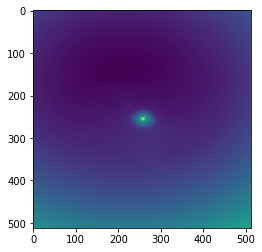

epoch 71601: 48.03459930419922
epoch 71602: 47.45207214355469
epoch 71603: 47.64882278442383
epoch 71604: 48.036434173583984
epoch 71605: 47.52855682373047
epoch 71606: 47.87430191040039
epoch 71607: 48.857322692871094
epoch 71608: 47.32842254638672
epoch 71609: 47.77825164794922
epoch 71611: 48.787025451660156
epoch 71612: 49.94594955444336
epoch 71613: 47.76164627075195
epoch 71614: 47.80080032348633
epoch 71615: 47.912864685058594
epoch 71616: 48.508853912353516
epoch 71617: 48.41778564453125
epoch 71618: 48.07648849487305
epoch 71619: 48.22589874267578
epoch 71621: 49.24024963378906
epoch 71622: 48.644920349121094
epoch 71623: 48.04427719116211
epoch 71624: 48.09177780151367
epoch 71625: 48.10844802856445
epoch 71626: 47.867610931396484
epoch 71627: 48.32841873168945
epoch 71628: 48.45530700683594
epoch 71629: 47.68697738647461
epoch 71631: 47.90522384643555
epoch 71632: 48.048545837402344
epoch 71633: 47.77399444580078
epoch 71634: 47.85006332397461
epoch 71635: 47.34089279174805


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



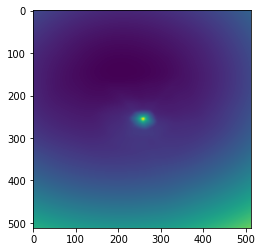

epoch 71701: 48.114959716796875
epoch 71702: 48.02513885498047
epoch 71703: 48.633056640625
epoch 71704: 47.18214416503906
epoch 71705: 47.80201721191406
epoch 71706: 48.27054977416992
epoch 71707: 48.30416488647461
epoch 71708: 47.86650466918945
epoch 71709: 48.183658599853516
epoch 71711: 48.13447952270508
epoch 71712: 47.659217834472656
epoch 71713: 51.84187316894531
epoch 71714: 48.46039962768555
epoch 71715: 47.812705993652344
epoch 71716: 48.839111328125
epoch 71717: 47.70857620239258
epoch 71718: 48.77617645263672
epoch 71719: 48.0508918762207
epoch 71721: 49.478450775146484
epoch 71722: 48.64131546020508
epoch 71723: 48.197200775146484
epoch 71724: 47.47859573364258
epoch 71725: 48.034217834472656
epoch 71726: 49.48384094238281
epoch 71727: 47.9675407409668
epoch 71728: 46.98141860961914
epoch 71729: 47.677730560302734
epoch 71731: 48.71495056152344
epoch 71732: 48.76446533203125
epoch 71733: 47.6903190612793
epoch 71734: 48.580814361572266
epoch 71735: 48.76079177856445
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



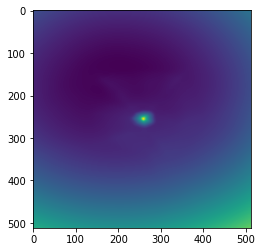

epoch 71801: 48.24372863769531
epoch 71802: 48.14946746826172
epoch 71803: 48.894256591796875
epoch 71804: 48.43435287475586
epoch 71805: 47.851749420166016
epoch 71806: 47.65977478027344
epoch 71807: 48.49538803100586
epoch 71808: 47.65794372558594
epoch 71809: 48.11029052734375
epoch 71811: 47.58317184448242
epoch 71812: 47.812232971191406
epoch 71813: 47.13230895996094
epoch 71814: 48.21416473388672
epoch 71815: 47.968631744384766
epoch 71816: 47.99983596801758
epoch 71817: 48.416690826416016
epoch 71818: 47.31451416015625
epoch 71819: 47.93023681640625
epoch 71821: 48.020965576171875
epoch 71822: 47.74794006347656
epoch 71823: 47.62580108642578
epoch 71824: 50.527587890625
epoch 71825: 48.859893798828125
epoch 71826: 49.58341598510742
epoch 71827: 48.44710922241211
epoch 71828: 48.75803756713867
epoch 71829: 48.37730407714844
epoch 71831: 47.58164596557617
epoch 71832: 48.101806640625
epoch 71833: 47.882381439208984
epoch 71834: 47.20539855957031
epoch 71835: 48.810577392578125
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



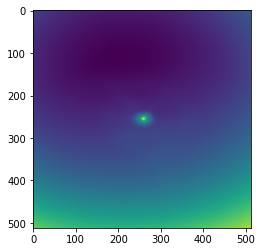

epoch 71901: 47.07449722290039
epoch 71902: 47.534610748291016
epoch 71903: 48.069183349609375
epoch 71904: 48.43326950073242
epoch 71905: 48.35584259033203
epoch 71906: 47.93761444091797
epoch 71907: 47.92972183227539
epoch 71908: 48.74397277832031
epoch 71909: 49.21711349487305
epoch 71911: 47.66436004638672
epoch 71912: 47.76104736328125
epoch 71913: 47.90724563598633
epoch 71914: 47.83328628540039
epoch 71915: 49.20878219604492
epoch 71916: 48.16334533691406
epoch 71917: 48.3185920715332
epoch 71918: 49.31828308105469
epoch 71919: 47.92390060424805
epoch 71921: 47.75862503051758
epoch 71922: 47.76791000366211
epoch 71923: 48.23640060424805
epoch 71924: 48.40900421142578
epoch 71925: 47.27025604248047
epoch 71926: 47.9612922668457
epoch 71927: 49.53422927856445
epoch 71928: 47.9910774230957
epoch 71929: 48.435638427734375
epoch 71931: 48.2672004699707
epoch 71932: 47.72321701049805
epoch 71933: 47.26018142700195
epoch 71934: 47.7664794921875
epoch 71935: 47.517417907714844
epoch 719

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



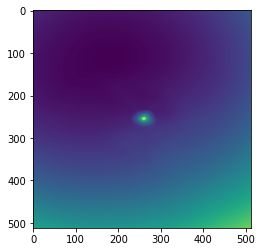

epoch 72001: 48.29389953613281
epoch 72002: 48.070682525634766
epoch 72003: 47.6279296875
epoch 72004: 48.14158630371094
epoch 72005: 47.69400405883789
epoch 72006: 49.50886917114258
epoch 72007: 48.4522705078125
epoch 72008: 47.5709228515625
epoch 72009: 48.19403839111328
epoch 72011: 48.179317474365234
epoch 72012: 47.90167999267578
epoch 72013: 48.25596618652344
epoch 72014: 48.341880798339844
epoch 72015: 47.55708694458008
epoch 72016: 47.542972564697266
epoch 72017: 48.22197341918945
epoch 72018: 48.70961380004883
epoch 72019: 48.0716667175293
epoch 72021: 47.92203140258789
epoch 72022: 48.15300750732422
epoch 72023: 49.02755355834961
epoch 72024: 48.11440658569336
epoch 72025: 48.20664978027344
epoch 72026: 48.23200607299805
epoch 72027: 47.72040557861328
epoch 72028: 47.89351272583008
epoch 72029: 48.6365852355957
epoch 72031: 48.35533905029297
epoch 72032: 48.262596130371094
epoch 72033: 47.9478874206543
epoch 72034: 47.70681381225586
epoch 72035: 48.817176818847656
epoch 72036

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



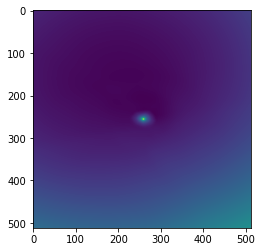

epoch 72101: 48.62211227416992
epoch 72102: 47.901065826416016
epoch 72103: 48.556419372558594
epoch 72104: 49.18864059448242
epoch 72105: 50.10395050048828
epoch 72106: 48.399009704589844
epoch 72107: 47.77663803100586
epoch 72108: 48.58370590209961
epoch 72109: 48.74613952636719
epoch 72111: 48.87879943847656
epoch 72112: 47.9485969543457
epoch 72113: 48.21437072753906
epoch 72114: 48.5791130065918
epoch 72115: 47.931488037109375
epoch 72116: 48.8704948425293
epoch 72117: 49.26936340332031
epoch 72118: 47.90265655517578
epoch 72119: 48.78702163696289
epoch 72121: 47.80744552612305
epoch 72122: 47.67137908935547
epoch 72123: 49.18818283081055
epoch 72124: 48.23033142089844
epoch 72125: 47.941532135009766
epoch 72126: 48.756195068359375
epoch 72127: 47.309932708740234
epoch 72128: 47.78934097290039
epoch 72129: 47.31254577636719
epoch 72131: 48.65760040283203
epoch 72132: 47.500823974609375
epoch 72133: 49.16682052612305
epoch 72134: 47.9228401184082
epoch 72135: 47.8698616027832
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



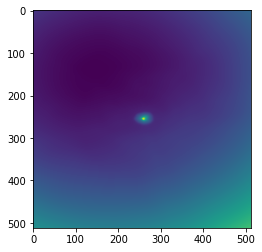

epoch 72201: 48.74349594116211
epoch 72202: 48.639461517333984
epoch 72203: 47.56629180908203
epoch 72204: 48.71784973144531
epoch 72205: 48.84142303466797
epoch 72206: 48.42759704589844
epoch 72207: 48.171871185302734
epoch 72208: 47.36745834350586
epoch 72209: 48.618934631347656
epoch 72211: 48.623836517333984
epoch 72212: 49.14458465576172
epoch 72213: 49.193359375
epoch 72214: 48.92987823486328
epoch 72215: 48.65322494506836
epoch 72216: 48.50834655761719
epoch 72217: 49.112403869628906
epoch 72218: 48.87538528442383
epoch 72219: 48.10780334472656
epoch 72221: 48.59941101074219
epoch 72222: 48.338645935058594
epoch 72223: 49.191654205322266
epoch 72224: 47.629947662353516
epoch 72225: 48.19866943359375
epoch 72226: 49.8666877746582
epoch 72227: 49.673973083496094
epoch 72228: 47.80373001098633
epoch 72229: 47.84443664550781
epoch 72231: 48.60654067993164
epoch 72232: 47.87874221801758
epoch 72233: 48.154075622558594
epoch 72234: 48.11351776123047
epoch 72235: 48.22111892700195
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



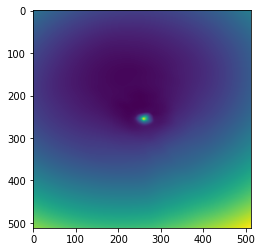

epoch 72301: 48.3603515625
epoch 72302: 47.68213653564453
epoch 72303: 47.47039794921875
epoch 72304: 47.32722854614258
epoch 72305: 48.42110061645508
epoch 72306: 48.00934600830078
epoch 72307: 47.341331481933594
epoch 72308: 47.61095428466797
epoch 72309: 47.3991584777832
epoch 72311: 47.819671630859375
epoch 72312: 48.26253890991211
epoch 72313: 47.795631408691406
epoch 72314: 47.79962921142578
epoch 72315: 48.437400817871094
epoch 72316: 48.154266357421875
epoch 72317: 48.51726531982422
epoch 72318: 47.229190826416016
epoch 72319: 48.62779235839844
epoch 72321: 48.31984329223633
epoch 72322: 47.828636169433594
epoch 72323: 47.64502716064453
epoch 72324: 49.271873474121094
epoch 72325: 47.871421813964844
epoch 72326: 47.61216354370117
epoch 72327: 48.07376480102539
epoch 72328: 47.66350555419922
epoch 72329: 48.195255279541016
epoch 72331: 49.12601852416992
epoch 72332: 48.3056755065918
epoch 72333: 49.013153076171875
epoch 72334: 47.71247863769531
epoch 72335: 48.16603469848633
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



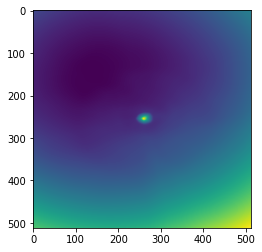

epoch 72401: 48.5149040222168
epoch 72402: 48.16874694824219
epoch 72403: 48.49602508544922
epoch 72404: 48.4779052734375
epoch 72405: 48.45798873901367
epoch 72406: 48.555606842041016
epoch 72407: 47.7663459777832
epoch 72408: 49.03059387207031
epoch 72409: 48.761837005615234
epoch 72411: 47.84623718261719
epoch 72412: 48.84419250488281
epoch 72413: 47.505409240722656
epoch 72414: 48.42036437988281
epoch 72415: 48.31051254272461
epoch 72416: 48.21036911010742
epoch 72417: 48.152626037597656
epoch 72418: 48.42033767700195
epoch 72419: 47.667659759521484
epoch 72421: 48.885040283203125
epoch 72422: 48.97126770019531
epoch 72423: 48.748992919921875
epoch 72424: 48.59696578979492
epoch 72425: 48.160438537597656
epoch 72426: 48.74273681640625
epoch 72427: 47.84542465209961
epoch 72428: 48.782859802246094
epoch 72429: 49.807621002197266
epoch 72431: 47.8608512878418
epoch 72432: 49.466827392578125
epoch 72433: 49.59294891357422
epoch 72434: 47.88008117675781
epoch 72435: 48.62474822998047
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



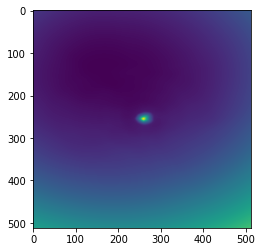

epoch 72501: 49.048709869384766
epoch 72502: 48.470367431640625
epoch 72503: 48.34670639038086
epoch 72504: 48.07258987426758
epoch 72505: 47.20210266113281
epoch 72506: 47.653018951416016
epoch 72507: 47.778621673583984
epoch 72508: 48.03782653808594
epoch 72509: 47.4245491027832
epoch 72511: 48.9974250793457
epoch 72512: 47.52048110961914
epoch 72513: 47.542022705078125
epoch 72514: 47.73048782348633
epoch 72515: 47.8408088684082
epoch 72516: 48.4756965637207
epoch 72517: 47.350440979003906
epoch 72518: 48.82973098754883
epoch 72519: 48.80469512939453
epoch 72521: 47.212703704833984
epoch 72522: 47.486148834228516
epoch 72523: 48.74034881591797
epoch 72524: 48.141536712646484
epoch 72525: 47.692562103271484
epoch 72526: 49.08526611328125
epoch 72527: 48.61442184448242
epoch 72528: 47.706180572509766
epoch 72529: 47.460853576660156
epoch 72531: 48.49225997924805
epoch 72532: 47.490474700927734
epoch 72533: 47.83506774902344
epoch 72534: 48.54624938964844
epoch 72535: 47.1719856262207


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



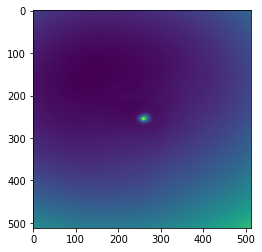

epoch 72601: 48.113460540771484
epoch 72602: 48.57160568237305
epoch 72603: 48.2121696472168
epoch 72604: 48.49416732788086
epoch 72605: 48.173095703125
epoch 72606: 48.33620834350586
epoch 72607: 48.28573226928711
epoch 72608: 48.00931167602539
epoch 72609: 47.457820892333984
epoch 72611: 48.500572204589844
epoch 72612: 48.316497802734375
epoch 72613: 48.56062316894531
epoch 72614: 47.880943298339844
epoch 72615: 48.28183364868164
epoch 72616: 48.12636184692383
epoch 72617: 48.583919525146484
epoch 72618: 47.378318786621094
epoch 72619: 48.691017150878906
epoch 72621: 47.787532806396484
epoch 72622: 48.098384857177734
epoch 72623: 47.646697998046875
epoch 72624: 49.310096740722656
epoch 72625: 48.017173767089844
epoch 72626: 48.844173431396484
epoch 72627: 47.9361457824707
epoch 72628: 47.33382797241211
epoch 72629: 49.37355041503906
epoch 72631: 48.59122848510742
epoch 72632: 48.76915740966797
epoch 72633: 47.92748260498047
epoch 72634: 47.85072326660156
epoch 72635: 48.9774398803710

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



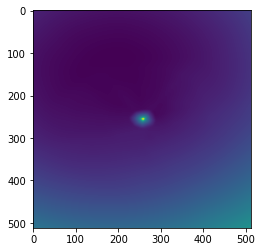

epoch 72701: 46.96265411376953
epoch 72702: 48.122188568115234
epoch 72703: 47.768333435058594
epoch 72704: 47.843936920166016
epoch 72705: 47.70320129394531
epoch 72706: 47.938358306884766
epoch 72707: 48.7110595703125
epoch 72708: 49.82213592529297
epoch 72709: 50.16262435913086
epoch 72711: 47.371429443359375
epoch 72712: 48.142601013183594
epoch 72713: 48.53361892700195
epoch 72714: 48.380496978759766
epoch 72715: 48.18572998046875
epoch 72716: 47.732398986816406
epoch 72717: 47.661224365234375
epoch 72718: 47.40089416503906
epoch 72719: 47.78355026245117
epoch 72721: 47.342750549316406
epoch 72722: 47.68806457519531
epoch 72723: 48.85529327392578
epoch 72724: 47.736515045166016
epoch 72725: 47.68054962158203
epoch 72726: 48.22901153564453
epoch 72727: 47.43327713012695
epoch 72728: 48.14408874511719
epoch 72729: 47.90171813964844
epoch 72731: 47.719573974609375
epoch 72732: 47.79324722290039
epoch 72733: 47.12641143798828
epoch 72734: 47.803138732910156
epoch 72735: 48.11447906494

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



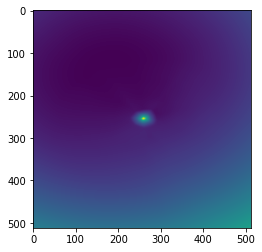

epoch 72801: 49.298439025878906
epoch 72802: 48.68710708618164
epoch 72803: 48.17621612548828
epoch 72804: 47.348785400390625
epoch 72805: 48.00606155395508
epoch 72806: 48.7678108215332
epoch 72807: 47.52970504760742
epoch 72808: 47.64212417602539
epoch 72809: 47.61458969116211
epoch 72811: 48.07905960083008
epoch 72812: 48.719478607177734
epoch 72813: 47.533329010009766
epoch 72814: 48.00023651123047
epoch 72815: 47.18184280395508
epoch 72816: 48.127559661865234
epoch 72817: 48.488807678222656
epoch 72818: 48.016456604003906
epoch 72819: 48.386775970458984
epoch 72821: 47.22803497314453
epoch 72822: 48.319549560546875
epoch 72823: 47.798606872558594
epoch 72824: 49.54064178466797
epoch 72825: 48.14723587036133
epoch 72826: 48.11423110961914
epoch 72827: 49.44101333618164
epoch 72828: 48.284481048583984
epoch 72829: 47.6822624206543
epoch 72831: 48.33859634399414
epoch 72832: 48.43733215332031
epoch 72833: 49.028255462646484
epoch 72834: 47.997737884521484
epoch 72835: 48.015132904052

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



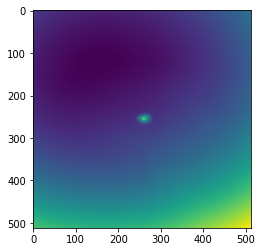

epoch 72901: 47.96992111206055
epoch 72902: 48.163883209228516
epoch 72903: 48.31260681152344
epoch 72904: 47.94852828979492
epoch 72905: 48.70574188232422
epoch 72906: 48.08510208129883
epoch 72907: 47.244930267333984
epoch 72908: 48.01897048950195
epoch 72909: 47.92761993408203
epoch 72911: 47.64556121826172
epoch 72912: 48.218109130859375
epoch 72913: 47.97771453857422
epoch 72914: 48.64783477783203
epoch 72915: 47.99427032470703
epoch 72916: 48.033756256103516
epoch 72917: 47.702476501464844
epoch 72918: 47.95680236816406
epoch 72919: 47.59526824951172
epoch 72921: 47.831695556640625
epoch 72922: 47.99540710449219
epoch 72923: 49.033878326416016
epoch 72924: 47.946693420410156
epoch 72925: 48.158321380615234
epoch 72926: 48.287010192871094
epoch 72927: 49.07548141479492
epoch 72928: 47.679195404052734
epoch 72929: 48.763450622558594
epoch 72931: 47.464256286621094
epoch 72932: 48.30900573730469
epoch 72933: 48.32632064819336
epoch 72934: 47.791015625
epoch 72935: 48.12249755859375


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



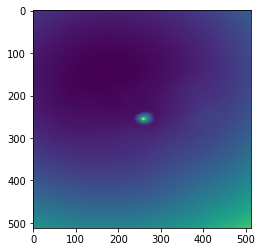

epoch 73001: 47.61720275878906
epoch 73002: 47.56403350830078
epoch 73003: 47.70238494873047
epoch 73004: 49.05060958862305
epoch 73005: 47.0015869140625
epoch 73006: 51.5887451171875
epoch 73007: 48.52231979370117
epoch 73008: 48.01667022705078
epoch 73009: 47.98883056640625
epoch 73011: 47.88161087036133
epoch 73012: 47.84893035888672
epoch 73013: 47.30293655395508
epoch 73014: 48.4288444519043
epoch 73015: 48.656558990478516
epoch 73016: 47.61652755737305
epoch 73017: 48.16379165649414
epoch 73018: 47.99259567260742
epoch 73019: 49.0262451171875
epoch 73021: 48.137474060058594
epoch 73022: 48.265933990478516
epoch 73023: 47.765357971191406
epoch 73024: 48.241329193115234
epoch 73025: 47.81361770629883
epoch 73026: 48.00654983520508
epoch 73027: 47.3730354309082
epoch 73028: 47.390323638916016
epoch 73029: 48.11587142944336
epoch 73031: 47.98099899291992
epoch 73032: 47.508689880371094
epoch 73033: 47.41019821166992
epoch 73034: 47.43022918701172
epoch 73035: 47.51369094848633
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



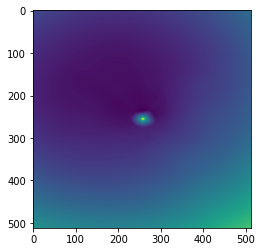

epoch 73101: 47.67384338378906
epoch 73102: 48.4024772644043
epoch 73103: 48.11147689819336
epoch 73104: 48.32341766357422
epoch 73105: 47.96797561645508
epoch 73106: 48.67079162597656
epoch 73107: 48.21342849731445
epoch 73108: 48.26447296142578
epoch 73109: 47.8088264465332
epoch 73111: 48.08340072631836
epoch 73112: 47.28647994995117
epoch 73113: 47.90665054321289
epoch 73114: 47.51409149169922
epoch 73115: 48.02349853515625
epoch 73116: 48.407562255859375
epoch 73117: 48.2590217590332
epoch 73118: 47.29419708251953
epoch 73119: 48.33245086669922
epoch 73121: 47.149410247802734
epoch 73122: 47.99346160888672
epoch 73123: 47.83381652832031
epoch 73124: 48.210227966308594
epoch 73125: 47.070560455322266
epoch 73126: 48.482261657714844
epoch 73127: 48.23260498046875
epoch 73128: 48.584800720214844
epoch 73129: 47.80763244628906
epoch 73131: 47.58209228515625
epoch 73132: 47.712974548339844
epoch 73133: 48.38648986816406
epoch 73134: 47.693206787109375
epoch 73135: 47.72073745727539
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



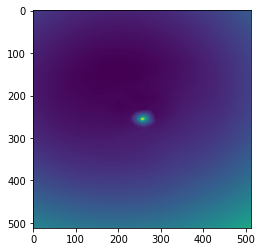

epoch 73201: 47.89914321899414
epoch 73202: 48.18986129760742
epoch 73203: 48.818965911865234
epoch 73204: 48.42209243774414
epoch 73205: 47.948097229003906
epoch 73206: 47.76255798339844
epoch 73207: 47.56886672973633
epoch 73208: 48.39643096923828
epoch 73209: 47.84577560424805
epoch 73211: 48.274322509765625
epoch 73212: 48.40928268432617
epoch 73213: 48.092594146728516
epoch 73214: 48.221397399902344
epoch 73215: 47.669612884521484
epoch 73216: 47.69877624511719
epoch 73217: 48.22865295410156
epoch 73218: 48.24068832397461
epoch 73219: 46.88798522949219
epoch 73221: 47.64835739135742
epoch 73222: 47.8143196105957
epoch 73223: 48.0782470703125
epoch 73224: 47.964561462402344
epoch 73225: 47.60973358154297
epoch 73226: 47.41420364379883
epoch 73227: 47.62826919555664
epoch 73228: 47.76515197753906
epoch 73229: 48.727867126464844
epoch 73231: 48.03315734863281
epoch 73232: 47.9348030090332
epoch 73233: 47.70918273925781
epoch 73234: 48.70103073120117
epoch 73235: 48.59074020385742
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



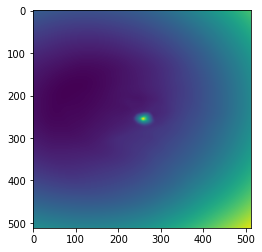

epoch 73301: 48.13359451293945
epoch 73302: 47.82754898071289
epoch 73303: 51.930747985839844
epoch 73304: 47.72518539428711
epoch 73305: 48.9425048828125
epoch 73306: 47.5464973449707
epoch 73307: 47.13196563720703
epoch 73308: 48.390907287597656
epoch 73309: 47.34488296508789
epoch 73311: 47.65089797973633
epoch 73312: 48.0751953125
epoch 73313: 48.21601867675781
epoch 73314: 48.11077117919922
epoch 73315: 48.47948455810547
epoch 73316: 48.46302795410156
epoch 73317: 47.81763458251953
epoch 73318: 48.027862548828125
epoch 73319: 48.084564208984375
epoch 73321: 47.87813949584961
epoch 73322: 48.21442794799805
epoch 73323: 48.148983001708984
epoch 73324: 48.4543342590332
epoch 73325: 48.57394027709961
epoch 73326: 48.283714294433594
epoch 73327: 48.69972229003906
epoch 73328: 47.67847442626953
epoch 73329: 48.01466369628906
epoch 73331: 48.01279067993164
epoch 73332: 47.87556457519531
epoch 73333: 48.441837310791016
epoch 73334: 48.042484283447266
epoch 73335: 47.323944091796875
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



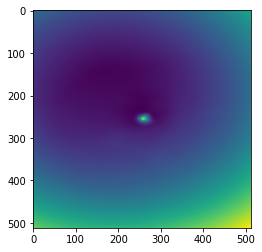

epoch 73401: 48.605125427246094
epoch 73402: 48.03734588623047
epoch 73403: 47.97967529296875
epoch 73404: 48.3147087097168
epoch 73405: 48.88204574584961
epoch 73406: 47.80644607543945
epoch 73407: 49.03036117553711
epoch 73408: 49.31745147705078
epoch 73409: 47.833351135253906
epoch 73411: 48.20621109008789
epoch 73412: 48.53400802612305
epoch 73413: 47.72967529296875
epoch 73414: 48.73039245605469
epoch 73415: 48.416358947753906
epoch 73416: 47.806819915771484
epoch 73417: 49.05987548828125
epoch 73418: 48.418922424316406
epoch 73419: 47.61058807373047
epoch 73421: 49.00557327270508
epoch 73422: 48.34302520751953
epoch 73423: 49.31690979003906
epoch 73424: 47.79375076293945
epoch 73425: 48.006263732910156
epoch 73426: 47.21839904785156
epoch 73427: 48.48115921020508
epoch 73428: 48.17067337036133
epoch 73429: 48.5899772644043
epoch 73431: 48.83873748779297
epoch 73432: 48.0203971862793
epoch 73433: 48.493553161621094
epoch 73434: 48.272403717041016
epoch 73435: 47.5026741027832
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



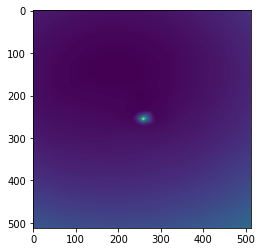

epoch 73501: 48.272491455078125
epoch 73502: 49.894798278808594
epoch 73503: 48.11885070800781
epoch 73504: 47.822601318359375
epoch 73505: 50.22647476196289
epoch 73506: 48.828094482421875
epoch 73507: 47.267276763916016
epoch 73508: 49.08505630493164
epoch 73509: 47.74177932739258
epoch 73511: 49.63032150268555
epoch 73512: 48.66158676147461
epoch 73513: 47.98989486694336
epoch 73514: 49.30121612548828
epoch 73515: 48.09922790527344
epoch 73516: 47.98564529418945
epoch 73517: 51.24750518798828
epoch 73518: 48.01225662231445
epoch 73519: 48.594940185546875
epoch 73521: 47.55675506591797
epoch 73522: 48.824241638183594
epoch 73523: 47.88263702392578
epoch 73524: 48.120513916015625
epoch 73525: 49.12710952758789
epoch 73526: 48.1563720703125
epoch 73527: 48.60259246826172
epoch 73528: 48.417381286621094
epoch 73529: 48.382362365722656
epoch 73531: 47.912620544433594
epoch 73532: 48.58241271972656
epoch 73533: 47.792972564697266
epoch 73534: 47.78014373779297
epoch 73535: 47.855850219726

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



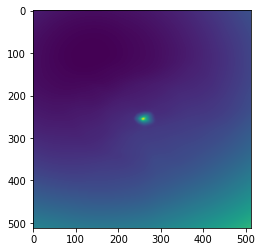

epoch 73601: 48.983558654785156
epoch 73602: 49.11593246459961
epoch 73603: 50.71720886230469
epoch 73604: 47.08940887451172
epoch 73605: 48.383296966552734
epoch 73606: 47.88752746582031
epoch 73607: 48.6351203918457
epoch 73608: 48.06855773925781
epoch 73609: 47.842403411865234
epoch 73611: 48.7357292175293
epoch 73612: 49.42298889160156
epoch 73613: 48.671382904052734
epoch 73614: 49.07990264892578
epoch 73615: 47.88788986206055
epoch 73616: 49.04187774658203
epoch 73617: 48.71758270263672
epoch 73618: 48.208580017089844
epoch 73619: 47.97539520263672
epoch 73621: 49.56711959838867
epoch 73622: 48.8964729309082
epoch 73623: 48.94291687011719
epoch 73624: 48.08689498901367
epoch 73625: 48.281219482421875
epoch 73626: 48.388465881347656
epoch 73627: 48.34175491333008
epoch 73628: 48.038211822509766
epoch 73629: 48.79750061035156
epoch 73631: 48.59817123413086
epoch 73632: 47.9151496887207
epoch 73633: 49.1781005859375
epoch 73634: 48.140010833740234
epoch 73635: 47.741580963134766
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



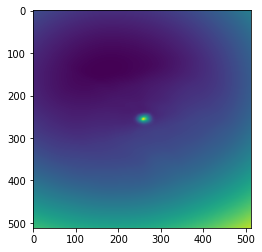

epoch 73701: 48.003456115722656
epoch 73702: 47.692771911621094
epoch 73703: 49.239471435546875
epoch 73704: 47.34403991699219
epoch 73705: 48.40006637573242
epoch 73706: 48.39006805419922
epoch 73707: 49.29201889038086
epoch 73708: 48.640167236328125
epoch 73709: 48.43358612060547
epoch 73711: 48.26455307006836
epoch 73712: 48.278465270996094
epoch 73713: 49.15260314941406
epoch 73714: 48.093017578125
epoch 73715: 48.2601203918457
epoch 73716: 47.863197326660156
epoch 73717: 47.697261810302734
epoch 73718: 48.97697067260742
epoch 73719: 47.727378845214844
epoch 73721: 48.484764099121094
epoch 73722: 48.60200119018555
epoch 73723: 48.428428649902344
epoch 73724: 48.22059631347656
epoch 73725: 47.32818603515625
epoch 73726: 47.45243835449219
epoch 73727: 48.24258041381836
epoch 73728: 48.39199447631836
epoch 73729: 47.98078918457031
epoch 73731: 48.78639221191406
epoch 73732: 48.04132843017578
epoch 73733: 47.90741729736328
epoch 73734: 47.194244384765625
epoch 73735: 47.64344787597656


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



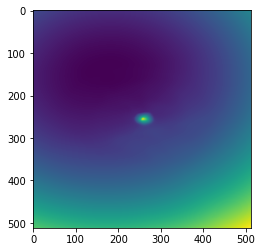

epoch 73801: 47.87260818481445
epoch 73802: 47.73102569580078
epoch 73803: 48.68596267700195
epoch 73804: 48.78053283691406
epoch 73805: 48.081546783447266
epoch 73806: 47.78193283081055
epoch 73807: 47.920528411865234
epoch 73808: 47.97561264038086
epoch 73809: 48.41642379760742
epoch 73811: 48.09176254272461
epoch 73812: 48.342857360839844
epoch 73813: 49.58500289916992
epoch 73814: 48.08475112915039
epoch 73815: 48.37021255493164
epoch 73816: 48.08897399902344
epoch 73817: 48.35676574707031
epoch 73818: 49.06621551513672
epoch 73819: 48.0092658996582
epoch 73821: 48.26202392578125
epoch 73822: 47.99345016479492
epoch 73823: 47.78877639770508
epoch 73824: 47.26901626586914
epoch 73825: 47.95865249633789
epoch 73826: 47.92397689819336
epoch 73827: 48.004974365234375
epoch 73828: 47.363380432128906
epoch 73829: 48.853267669677734
epoch 73831: 47.20872116088867
epoch 73832: 48.66582489013672
epoch 73833: 48.02497482299805
epoch 73834: 47.956298828125
epoch 73835: 47.81283950805664
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



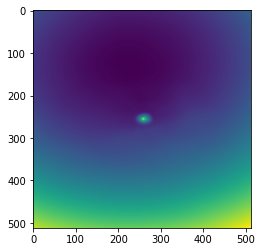

epoch 73901: 47.91154861450195
epoch 73902: 47.9051628112793
epoch 73903: 47.421546936035156
epoch 73904: 48.10951232910156
epoch 73905: 47.740360260009766
epoch 73906: 48.11039733886719
epoch 73907: 49.02344512939453
epoch 73908: 49.02793884277344
epoch 73909: 47.86663818359375
epoch 73911: 48.56201934814453
epoch 73912: 48.04020309448242
epoch 73913: 48.449153900146484
epoch 73914: 47.453372955322266
epoch 73915: 47.969539642333984
epoch 73916: 48.62422180175781
epoch 73917: 48.04513931274414
epoch 73918: 47.85540771484375
epoch 73919: 53.795814514160156
epoch 73921: 48.004398345947266
epoch 73922: 49.10633850097656
epoch 73923: 49.13813781738281
epoch 73924: 47.81067657470703
epoch 73925: 48.78900146484375
epoch 73926: 49.404300689697266
epoch 73927: 48.077903747558594
epoch 73928: 47.935001373291016
epoch 73929: 48.41034698486328
epoch 73931: 47.55445098876953
epoch 73932: 47.7258186340332
epoch 73933: 49.09237289428711
epoch 73934: 49.57729721069336
epoch 73935: 47.59755325317383


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



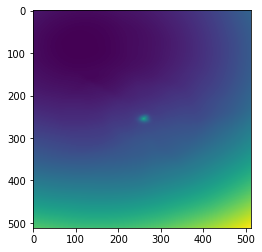

epoch 74001: 48.666831970214844
epoch 74002: 48.42285919189453
epoch 74003: 48.326171875
epoch 74004: 48.963478088378906
epoch 74005: 47.99726486206055
epoch 74006: 48.7139892578125
epoch 74007: 51.101566314697266
epoch 74008: 48.68970489501953
epoch 74009: 47.69367218017578
epoch 74011: 47.956077575683594
epoch 74012: 48.23023986816406
epoch 74013: 47.87561798095703
epoch 74014: 48.09033966064453
epoch 74015: 49.05845260620117
epoch 74016: 49.501007080078125
epoch 74017: 48.146766662597656
epoch 74018: 48.028076171875
epoch 74019: 48.53131103515625
epoch 74021: 48.580387115478516
epoch 74022: 48.16255569458008
epoch 74023: 48.498714447021484
epoch 74024: 48.91960144042969
epoch 74025: 48.058963775634766
epoch 74026: 48.645118713378906
epoch 74027: 48.4383430480957
epoch 74028: 48.47993469238281
epoch 74029: 47.70737075805664
epoch 74031: 48.336029052734375
epoch 74032: 47.79225158691406
epoch 74033: 49.08915710449219
epoch 74034: 47.46390151977539
epoch 74035: 47.898616790771484
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



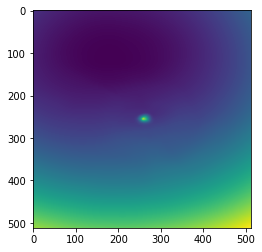

epoch 74101: 47.31755065917969
epoch 74102: 48.07483673095703
epoch 74103: 48.594722747802734
epoch 74104: 48.49850082397461
epoch 74105: 48.90361404418945
epoch 74106: 48.26264953613281
epoch 74107: 47.735565185546875
epoch 74108: 48.535404205322266
epoch 74109: 48.082740783691406
epoch 74111: 48.51308059692383
epoch 74112: 47.80771255493164
epoch 74113: 47.20359420776367
epoch 74114: 49.55496597290039
epoch 74115: 48.11014938354492
epoch 74116: 48.45962905883789
epoch 74117: 47.63236618041992
epoch 74118: 47.473472595214844
epoch 74119: 48.05183029174805
epoch 74121: 47.43098449707031
epoch 74122: 48.09195327758789
epoch 74123: 47.92290496826172
epoch 74124: 47.70774841308594
epoch 74125: 48.09075164794922
epoch 74126: 47.75541305541992
epoch 74127: 48.14531326293945
epoch 74128: 47.94175720214844
epoch 74129: 47.79941940307617
epoch 74131: 48.60291290283203
epoch 74132: 47.252235412597656
epoch 74133: 47.76551055908203
epoch 74134: 47.302433013916016
epoch 74135: 47.477169036865234


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



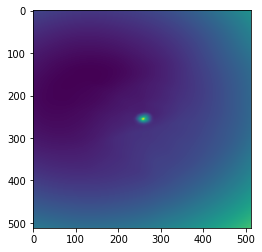

epoch 74201: 48.04246520996094
epoch 74202: 48.88291931152344
epoch 74203: 48.90809631347656
epoch 74204: 47.77229690551758
epoch 74205: 48.85016632080078
epoch 74206: 47.52507781982422
epoch 74207: 48.7882080078125
epoch 74208: 47.950782775878906
epoch 74209: 48.757137298583984
epoch 74211: 47.99789047241211
epoch 74212: 47.81491470336914
epoch 74213: 48.06743240356445
epoch 74214: 48.00585174560547
epoch 74215: 47.99327087402344
epoch 74216: 47.96147537231445
epoch 74217: 48.25048828125
epoch 74218: 47.69997787475586
epoch 74219: 48.80681228637695
epoch 74221: 49.00513458251953
epoch 74222: 48.07008743286133
epoch 74223: 48.79788589477539
epoch 74224: 48.138484954833984
epoch 74225: 47.75616455078125
epoch 74226: 48.4862174987793
epoch 74227: 47.60626983642578
epoch 74228: 47.982112884521484
epoch 74229: 47.443397521972656
epoch 74231: 47.490478515625
epoch 74232: 47.384307861328125
epoch 74233: 48.46123123168945
epoch 74234: 48.22987365722656
epoch 74235: 47.71720886230469
epoch 742

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



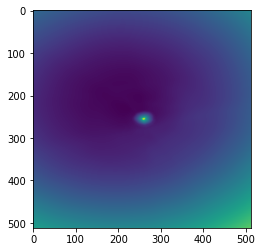

epoch 74301: 48.0299072265625
epoch 74302: 48.08671951293945
epoch 74303: 48.462486267089844
epoch 74304: 49.32939529418945
epoch 74305: 48.33266830444336
epoch 74306: 47.74600601196289
epoch 74307: 48.173152923583984
epoch 74308: 48.37330627441406
epoch 74309: 48.10190200805664
epoch 74311: 47.39679718017578
epoch 74312: 47.89762496948242
epoch 74313: 47.49720001220703
epoch 74314: 49.4195442199707
epoch 74315: 47.82871627807617
epoch 74316: 47.483619689941406
epoch 74317: 47.9788818359375
epoch 74318: 47.12775802612305
epoch 74319: 47.526615142822266
epoch 74321: 48.05389404296875
epoch 74322: 48.21978759765625
epoch 74323: 48.1828498840332
epoch 74324: 48.290260314941406
epoch 74325: 48.38621520996094
epoch 74326: 48.34522247314453
epoch 74327: 47.91325378417969
epoch 74328: 48.159271240234375
epoch 74329: 49.64651107788086
epoch 74331: 48.95551300048828
epoch 74332: 47.78054428100586
epoch 74333: 48.481082916259766
epoch 74334: 48.317623138427734
epoch 74335: 48.89604187011719
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



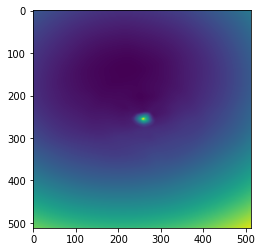

epoch 74401: 49.60086441040039
epoch 74402: 48.428680419921875
epoch 74403: 47.921382904052734
epoch 74404: 47.885231018066406
epoch 74405: 48.26168441772461
epoch 74406: 47.85931396484375
epoch 74407: 48.47291564941406
epoch 74408: 48.081626892089844
epoch 74409: 47.74813461303711
epoch 74411: 47.93037033081055
epoch 74412: 50.411109924316406
epoch 74413: 48.666595458984375
epoch 74414: 48.182186126708984
epoch 74415: 48.551517486572266
epoch 74416: 47.814109802246094
epoch 74417: 47.96390914916992
epoch 74418: 48.21232604980469
epoch 74419: 47.449275970458984
epoch 74421: 49.1082878112793
epoch 74422: 47.65022659301758
epoch 74423: 48.30803680419922
epoch 74424: 50.37260055541992
epoch 74425: 47.71457290649414
epoch 74426: 47.757320404052734
epoch 74427: 48.13469696044922
epoch 74428: 48.875892639160156
epoch 74429: 47.28024673461914
epoch 74431: 47.68344497680664
epoch 74432: 47.509376525878906
epoch 74433: 47.50898361206055
epoch 74434: 47.49257278442383
epoch 74435: 47.51358795166

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



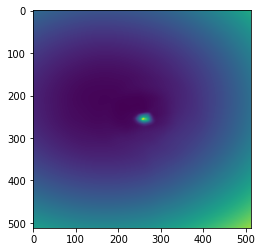

epoch 74501: 47.4808349609375
epoch 74502: 48.27217483520508
epoch 74503: 48.332489013671875
epoch 74504: 48.36965560913086
epoch 74505: 47.74248504638672
epoch 74506: 48.42245101928711
epoch 74507: 48.31782531738281
epoch 74508: 47.59925079345703
epoch 74509: 47.30031204223633
epoch 74511: 48.62535858154297
epoch 74512: 48.57734298706055
epoch 74513: 47.78970718383789
epoch 74514: 48.22338104248047
epoch 74515: 48.20220947265625
epoch 74516: 49.628990173339844
epoch 74517: 48.138755798339844
epoch 74518: 48.160091400146484
epoch 74519: 48.61625671386719
epoch 74521: 48.70276641845703
epoch 74522: 47.56976318359375
epoch 74523: 47.797760009765625
epoch 74524: 47.872535705566406
epoch 74525: 48.152198791503906
epoch 74526: 49.95466232299805
epoch 74527: 47.602230072021484
epoch 74528: 47.76643371582031
epoch 74529: 51.035301208496094
epoch 74531: 49.19194793701172
epoch 74532: 48.1524543762207
epoch 74533: 49.026615142822266
epoch 74534: 48.266754150390625
epoch 74535: 47.75114440917969

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



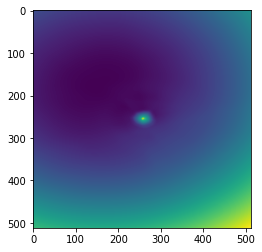

epoch 74601: 48.091678619384766
epoch 74602: 48.308837890625
epoch 74603: 48.28299331665039
epoch 74604: 47.996978759765625
epoch 74605: 47.888431549072266
epoch 74606: 48.55066680908203
epoch 74607: 48.24384307861328
epoch 74608: 48.76845932006836
epoch 74609: 48.01396560668945
epoch 74611: 48.20096969604492
epoch 74612: 48.100555419921875
epoch 74613: 48.70681381225586
epoch 74614: 47.94221878051758
epoch 74615: 49.654422760009766
epoch 74616: 47.65365982055664
epoch 74617: 47.69742202758789
epoch 74618: 47.67608642578125
epoch 74619: 50.54542541503906
epoch 74621: 47.92672348022461
epoch 74622: 48.148433685302734
epoch 74623: 48.695289611816406
epoch 74624: 48.75306701660156
epoch 74625: 48.369632720947266
epoch 74626: 48.130104064941406
epoch 74627: 48.701358795166016
epoch 74628: 48.26459503173828
epoch 74629: 47.639305114746094
epoch 74631: 47.78065490722656
epoch 74632: 46.960304260253906
epoch 74633: 47.83977127075195
epoch 74634: 49.8927001953125
epoch 74635: 47.41399002075195

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



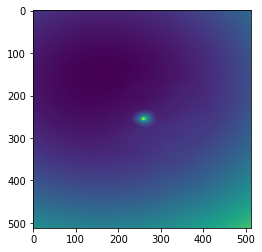

epoch 74701: 48.14482116699219
epoch 74702: 48.77909469604492
epoch 74703: 48.291282653808594
epoch 74704: 49.554195404052734
epoch 74705: 48.48235321044922
epoch 74706: 48.14576721191406
epoch 74707: 47.59341049194336
epoch 74708: 48.61315155029297
epoch 74709: 47.73054885864258
epoch 74711: 49.74047088623047
epoch 74712: 48.886444091796875
epoch 74713: 47.510223388671875
epoch 74714: 47.52424240112305
epoch 74715: 47.597618103027344
epoch 74716: 48.29717254638672
epoch 74717: 47.78913879394531
epoch 74718: 47.61370086669922
epoch 74719: 47.808048248291016
epoch 74721: 47.92508316040039
epoch 74722: 48.2015495300293
epoch 74723: 48.82398986816406
epoch 74724: 47.94259262084961
epoch 74725: 47.403045654296875
epoch 74726: 48.36220169067383
epoch 74727: 47.67169189453125
epoch 74728: 47.171504974365234
epoch 74729: 48.78431701660156
epoch 74731: 47.937774658203125
epoch 74732: 47.65816879272461
epoch 74733: 47.74148941040039
epoch 74734: 48.24382781982422
epoch 74735: 48.05269241333008


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



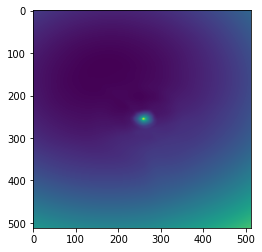

epoch 74801: 47.3944206237793
epoch 74802: 47.01740646362305
epoch 74803: 47.77769470214844
epoch 74804: 48.352783203125
epoch 74805: 48.36323547363281
epoch 74806: 48.52647399902344
epoch 74807: 48.82124328613281
epoch 74808: 48.034908294677734
epoch 74809: 47.43014907836914
epoch 74811: 47.77703857421875
epoch 74812: 47.83445358276367
epoch 74813: 47.79327392578125
epoch 74814: 49.2170295715332
epoch 74815: 48.11079788208008
epoch 74816: 49.02451705932617
epoch 74817: 48.901424407958984
epoch 74818: 47.47895050048828
epoch 74819: 48.60914993286133
epoch 74821: 47.56964111328125
epoch 74822: 47.9408073425293
epoch 74823: 48.909576416015625
epoch 74824: 47.66341781616211
epoch 74825: 48.432167053222656
epoch 74826: 48.61121368408203
epoch 74827: 48.68284606933594
epoch 74828: 47.009925842285156
epoch 74829: 48.96595764160156
epoch 74831: 48.790008544921875
epoch 74832: 47.75397872924805
epoch 74833: 47.406089782714844
epoch 74834: 48.550472259521484
epoch 74835: 47.631370544433594
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



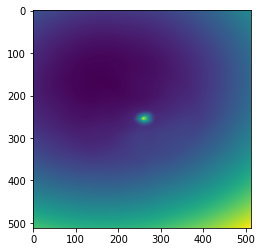

epoch 74901: 48.58401107788086
epoch 74902: 48.79659652709961
epoch 74903: 48.44200897216797
epoch 74904: 48.19407653808594
epoch 74905: 47.927635192871094
epoch 74906: 49.0457763671875
epoch 74907: 47.59294128417969
epoch 74908: 48.18010330200195
epoch 74909: 47.39366912841797
epoch 74911: 48.4417610168457
epoch 74912: 49.11220932006836
epoch 74913: 49.818363189697266
epoch 74914: 47.80821228027344
epoch 74915: 47.36695861816406
epoch 74916: 48.19784164428711
epoch 74917: 48.138206481933594
epoch 74918: 48.1535758972168
epoch 74919: 47.14193344116211
epoch 74921: 47.935176849365234
epoch 74922: 47.24402618408203
epoch 74923: 47.44808578491211
epoch 74924: 47.9609260559082
epoch 74925: 48.11225509643555
epoch 74926: 48.55730438232422
epoch 74927: 47.80479049682617
epoch 74928: 47.982948303222656
epoch 74929: 48.177555084228516
epoch 74931: 47.41265869140625
epoch 74932: 47.777259826660156
epoch 74933: 47.73561096191406
epoch 74934: 47.33543395996094
epoch 74935: 48.45973205566406
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



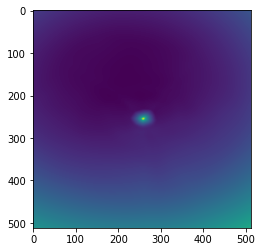

epoch 75001: 48.181800842285156
epoch 75002: 47.637359619140625
epoch 75003: 47.888893127441406
epoch 75004: 48.24961853027344
epoch 75005: 48.96121597290039
epoch 75006: 47.7111701965332
epoch 75007: 48.898746490478516
epoch 75008: 48.71250534057617
epoch 75009: 48.18101501464844
epoch 75011: 47.577232360839844
epoch 75012: 47.78268051147461
epoch 75013: 47.803184509277344
epoch 75014: 48.159759521484375
epoch 75015: 47.560150146484375
epoch 75016: 48.148258209228516
epoch 75017: 48.818965911865234
epoch 75018: 48.274356842041016
epoch 75019: 48.12748336791992
epoch 75021: 48.10300827026367
epoch 75022: 47.94518280029297
epoch 75023: 48.9599609375
epoch 75024: 47.800514221191406
epoch 75025: 49.15102005004883
epoch 75026: 48.033695220947266
epoch 75027: 48.222938537597656
epoch 75028: 48.941585540771484
epoch 75029: 50.75284194946289
epoch 75031: 48.28371047973633
epoch 75032: 48.673072814941406
epoch 75033: 47.995582580566406
epoch 75034: 48.234317779541016
epoch 75035: 47.2355995178

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



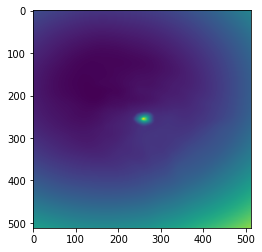

epoch 75101: 48.32238006591797
epoch 75102: 47.829673767089844
epoch 75103: 48.06104278564453
epoch 75104: 48.53769302368164
epoch 75105: 48.08036422729492
epoch 75106: 48.19001007080078
epoch 75107: 48.706077575683594
epoch 75108: 47.90873718261719
epoch 75109: 48.1529541015625
epoch 75111: 47.8406867980957
epoch 75112: 47.95989227294922
epoch 75113: 47.293731689453125
epoch 75114: 48.47924041748047
epoch 75115: 47.875431060791016
epoch 75116: 47.52900314331055
epoch 75117: 48.15633773803711
epoch 75118: 48.31614303588867
epoch 75119: 49.02273178100586
epoch 75121: 49.0155143737793
epoch 75122: 49.01007080078125
epoch 75123: 49.164588928222656
epoch 75124: 48.56118392944336
epoch 75125: 47.494720458984375
epoch 75126: 48.80508804321289
epoch 75127: 47.9015007019043
epoch 75128: 47.70357131958008
epoch 75129: 48.7298583984375
epoch 75131: 47.106849670410156
epoch 75132: 48.077247619628906
epoch 75133: 48.6505241394043
epoch 75134: 48.608726501464844
epoch 75135: 48.949039459228516
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



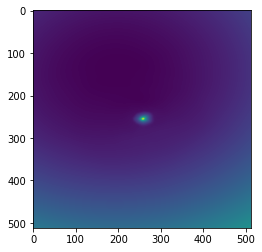

epoch 75201: 49.016754150390625
epoch 75202: 48.72482681274414
epoch 75203: 48.647972106933594
epoch 75204: 48.19596862792969
epoch 75205: 47.564300537109375
epoch 75206: 51.576995849609375
epoch 75207: 47.29899597167969
epoch 75208: 47.86450958251953
epoch 75209: 48.00408172607422
epoch 75211: 48.24065017700195
epoch 75212: 47.943626403808594
epoch 75213: 49.19997787475586
epoch 75214: 49.334144592285156
epoch 75215: 48.66943359375
epoch 75216: 47.35615539550781
epoch 75217: 47.88347625732422
epoch 75218: 47.738182067871094
epoch 75219: 48.48226547241211
epoch 75221: 48.958961486816406
epoch 75222: 47.93074035644531
epoch 75223: 48.27018737792969
epoch 75224: 48.73570251464844
epoch 75225: 49.157535552978516
epoch 75226: 48.845672607421875
epoch 75227: 48.76252365112305
epoch 75228: 48.08030319213867
epoch 75229: 48.440147399902344
epoch 75231: 48.54317092895508
epoch 75232: 48.663002014160156
epoch 75233: 48.39076614379883
epoch 75234: 48.793399810791016
epoch 75235: 48.7217025756835

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



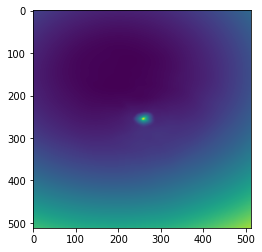

epoch 75301: 47.815635681152344
epoch 75302: 48.178218841552734
epoch 75303: 47.857383728027344
epoch 75304: 47.56665802001953
epoch 75305: 48.297969818115234
epoch 75306: 48.45726013183594
epoch 75307: 47.96338653564453
epoch 75308: 47.20288848876953
epoch 75309: 47.52629852294922
epoch 75311: 47.663883209228516
epoch 75312: 47.48464584350586
epoch 75313: 47.57625198364258
epoch 75314: 47.26112747192383
epoch 75315: 47.85984802246094
epoch 75316: 47.93242263793945
epoch 75317: 48.38517379760742
epoch 75318: 47.250675201416016
epoch 75319: 48.00117492675781
epoch 75321: 47.86537551879883
epoch 75322: 48.000938415527344
epoch 75323: 48.338565826416016
epoch 75324: 47.48303985595703
epoch 75325: 47.41610336303711
epoch 75326: 48.56687545776367
epoch 75327: 47.65555191040039
epoch 75328: 47.08321762084961
epoch 75329: 48.012901306152344
epoch 75331: 47.70200729370117
epoch 75332: 48.05345916748047
epoch 75333: 47.52381134033203
epoch 75334: 47.063255310058594
epoch 75335: 48.9117050170898

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



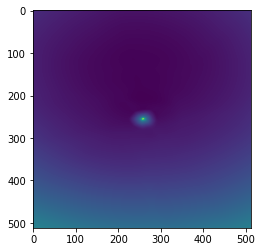

epoch 75401: 48.675514221191406
epoch 75402: 47.86863327026367
epoch 75403: 48.95695495605469
epoch 75404: 48.678985595703125
epoch 75405: 48.94954299926758
epoch 75406: 51.91919708251953
epoch 75407: 48.24437713623047
epoch 75408: 48.29500198364258
epoch 75409: 50.066810607910156
epoch 75411: 48.104942321777344
epoch 75412: 48.681270599365234
epoch 75413: 48.264495849609375
epoch 75414: 49.426849365234375
epoch 75415: 48.68769454956055
epoch 75416: 48.30571746826172
epoch 75417: 48.021324157714844
epoch 75418: 48.91053771972656
epoch 75419: 48.917327880859375
epoch 75421: 47.84899139404297
epoch 75422: 48.194671630859375
epoch 75423: 48.06544494628906
epoch 75424: 49.44847869873047
epoch 75425: 48.62159729003906
epoch 75426: 48.7282829284668
epoch 75427: 49.42692184448242
epoch 75428: 48.59770202636719
epoch 75429: 49.990379333496094
epoch 75431: 48.05658721923828
epoch 75432: 48.1636962890625
epoch 75433: 48.17315673828125
epoch 75434: 48.30398941040039
epoch 75435: 47.54375457763672

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



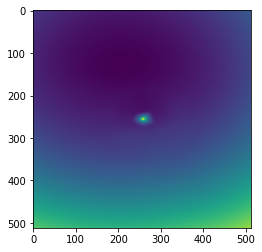

epoch 75501: 48.395381927490234
epoch 75502: 47.78108596801758
epoch 75503: 48.1630859375
epoch 75504: 48.42997741699219
epoch 75505: 47.35560989379883
epoch 75506: 47.97768020629883
epoch 75507: 49.12533187866211
epoch 75508: 47.41255187988281
epoch 75509: 49.21889114379883
epoch 75511: 48.08100128173828
epoch 75512: 48.546043395996094
epoch 75513: 47.6077880859375
epoch 75514: 49.89957046508789
epoch 75515: 47.9487190246582
epoch 75516: 48.38011169433594
epoch 75517: 48.0318489074707
epoch 75518: 47.967041015625
epoch 75519: 48.17783737182617
epoch 75521: 49.13643264770508
epoch 75522: 48.58287048339844
epoch 75523: 47.70269775390625
epoch 75524: 48.185665130615234
epoch 75525: 48.51484298706055
epoch 75526: 48.19453430175781
epoch 75527: 47.74502944946289
epoch 75528: 48.019649505615234
epoch 75529: 48.16791915893555
epoch 75531: 48.695884704589844
epoch 75532: 47.25173568725586
epoch 75533: 47.46788787841797
epoch 75534: 48.900474548339844
epoch 75535: 48.58806228637695
epoch 75536

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



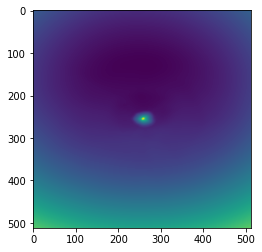

epoch 75601: 47.89262390136719
epoch 75602: 49.46982955932617
epoch 75603: 48.59343338012695
epoch 75604: 48.170589447021484
epoch 75605: 47.47882843017578
epoch 75606: 48.41445541381836
epoch 75607: 47.56657409667969
epoch 75608: 47.562164306640625
epoch 75609: 48.26215362548828
epoch 75611: 47.859764099121094
epoch 75612: 47.600643157958984
epoch 75613: 48.14720153808594
epoch 75614: 48.04567337036133
epoch 75615: 47.94461441040039
epoch 75616: 47.91332244873047
epoch 75617: 47.66435241699219
epoch 75618: 48.759185791015625
epoch 75619: 48.81698989868164
epoch 75621: 48.418846130371094
epoch 75622: 48.29771423339844
epoch 75623: 47.94179153442383
epoch 75624: 47.63264846801758
epoch 75625: 47.86323928833008
epoch 75626: 48.024322509765625
epoch 75627: 48.33120346069336
epoch 75628: 47.760189056396484
epoch 75629: 48.05836486816406
epoch 75631: 47.86429214477539
epoch 75632: 48.09770965576172
epoch 75633: 47.29397964477539
epoch 75634: 47.91611099243164
epoch 75635: 48.379974365234375

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



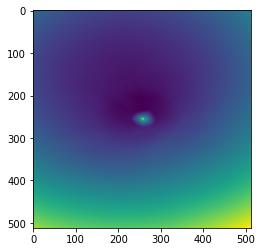

epoch 75701: 48.42839431762695
epoch 75702: 47.9959831237793
epoch 75703: 48.263484954833984
epoch 75704: 49.60432434082031
epoch 75705: 48.49455642700195
epoch 75706: 48.54698944091797
epoch 75707: 48.25286865234375
epoch 75708: 49.13978958129883
epoch 75709: 48.17855453491211
epoch 75711: 47.18367004394531
epoch 75712: 48.0526008605957
epoch 75713: 48.152652740478516
epoch 75714: 48.39326477050781
epoch 75715: 48.16546630859375
epoch 75716: 48.39297866821289
epoch 75717: 48.443870544433594
epoch 75718: 49.78316116333008
epoch 75719: 48.1676025390625
epoch 75721: 48.61675262451172
epoch 75722: 48.551753997802734
epoch 75723: 50.1884765625
epoch 75724: 48.27552795410156
epoch 75725: 48.756568908691406
epoch 75726: 48.04429626464844
epoch 75727: 48.00894546508789
epoch 75728: 47.34819412231445
epoch 75729: 49.13676452636719
epoch 75731: 47.94633865356445
epoch 75732: 47.42625045776367
epoch 75733: 48.92123031616211
epoch 75734: 48.66865921020508
epoch 75735: 47.841129302978516
epoch 757

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



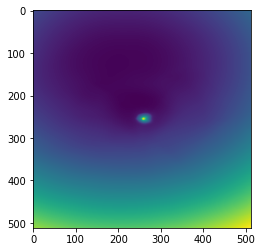

epoch 75801: 48.028629302978516
epoch 75802: 48.838809967041016
epoch 75803: 47.42250442504883
epoch 75804: 47.81840896606445
epoch 75805: 49.08951950073242
epoch 75806: 48.137298583984375
epoch 75807: 48.20384979248047
epoch 75808: 48.07874298095703
epoch 75809: 47.729549407958984
epoch 75811: 48.16531753540039
epoch 75812: 48.478023529052734
epoch 75813: 47.90378952026367
epoch 75814: 48.59836196899414
epoch 75815: 48.6319580078125
epoch 75816: 48.741546630859375
epoch 75817: 47.989898681640625
epoch 75818: 48.08332061767578
epoch 75819: 47.91868209838867
epoch 75821: 47.7947998046875
epoch 75822: 47.53360366821289
epoch 75823: 47.34839630126953
epoch 75824: 48.70195770263672
epoch 75825: 47.39922332763672
epoch 75826: 47.689842224121094
epoch 75827: 48.50518035888672
epoch 75828: 47.921016693115234
epoch 75829: 47.64164352416992
epoch 75831: 48.796024322509766
epoch 75832: 51.89643859863281
epoch 75833: 50.467864990234375
epoch 75834: 47.39809799194336
epoch 75835: 48.66781997680664

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



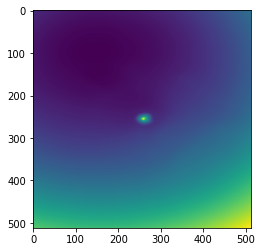

epoch 75901: 47.95085144042969
epoch 75902: 48.578125
epoch 75903: 48.30403137207031
epoch 75904: 47.50975036621094
epoch 75905: 47.77311706542969
epoch 75906: 48.024723052978516
epoch 75907: 47.67040252685547
epoch 75908: 47.66755676269531
epoch 75909: 48.224056243896484
epoch 75911: 47.4725456237793
epoch 75912: 47.952415466308594
epoch 75913: 48.33879470825195
epoch 75914: 47.68730926513672
epoch 75915: 47.83538055419922
epoch 75916: 47.9736442565918
epoch 75917: 48.68572998046875
epoch 75918: 47.93209457397461
epoch 75919: 48.48678970336914
epoch 75921: 47.85136032104492
epoch 75922: 48.096435546875
epoch 75923: 47.63020706176758
epoch 75924: 47.110504150390625
epoch 75925: 47.71470642089844
epoch 75926: 47.24561309814453
epoch 75927: 47.78948211669922
epoch 75928: 48.63486099243164
epoch 75929: 47.88964080810547
epoch 75931: 47.41797637939453
epoch 75932: 48.3481330871582
epoch 75933: 48.28011703491211
epoch 75934: 47.512168884277344
epoch 75935: 48.58595657348633
epoch 75936: 48.

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



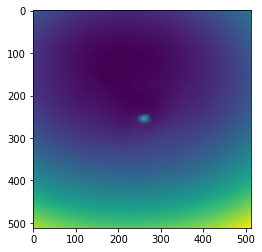

epoch 76001: 48.439571380615234
epoch 76002: 48.370521545410156
epoch 76003: 47.95051574707031
epoch 76004: 48.27950668334961
epoch 76005: 47.46710968017578
epoch 76006: 47.99129104614258
epoch 76007: 47.733154296875
epoch 76008: 48.34602737426758
epoch 76009: 48.10049819946289
epoch 76011: 48.4971923828125
epoch 76012: 47.57524108886719
epoch 76013: 48.16547775268555
epoch 76014: 47.73981857299805
epoch 76015: 47.759979248046875
epoch 76016: 47.388465881347656
epoch 76017: 47.815433502197266
epoch 76018: 48.20572280883789
epoch 76019: 48.25978088378906
epoch 76021: 49.05305862426758
epoch 76022: 47.640193939208984
epoch 76023: 48.01226806640625
epoch 76024: 48.54417419433594
epoch 76025: 47.912235260009766
epoch 76026: 47.952476501464844
epoch 76027: 48.1259880065918
epoch 76028: 48.4437255859375
epoch 76029: 48.78716278076172
epoch 76031: 48.780738830566406
epoch 76032: 48.03420639038086
epoch 76033: 48.76384735107422
epoch 76034: 48.86240768432617
epoch 76035: 50.199649810791016
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



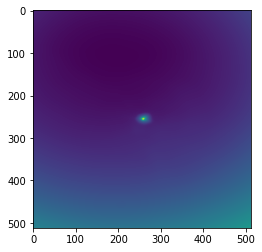

epoch 76101: 48.02342987060547
epoch 76102: 48.03736877441406
epoch 76103: 47.657833099365234
epoch 76104: 48.156288146972656
epoch 76105: 47.773048400878906
epoch 76106: 48.67150115966797
epoch 76107: 47.5876579284668
epoch 76108: 47.72277069091797
epoch 76109: 47.75376892089844
epoch 76111: 48.10215377807617
epoch 76112: 48.702999114990234
epoch 76113: 47.608802795410156
epoch 76114: 48.32574462890625
epoch 76115: 47.84024429321289
epoch 76116: 48.705055236816406
epoch 76117: 47.39536666870117
epoch 76118: 47.945404052734375
epoch 76119: 48.369651794433594
epoch 76121: 47.94377136230469
epoch 76122: 48.22157287597656
epoch 76123: 48.97200393676758
epoch 76124: 47.64789581298828
epoch 76125: 48.104103088378906
epoch 76126: 48.00838851928711
epoch 76127: 48.604705810546875
epoch 76128: 48.20247268676758
epoch 76129: 47.35785675048828
epoch 76131: 46.96354293823242
epoch 76132: 47.79639434814453
epoch 76133: 47.3607063293457
epoch 76134: 48.63886642456055
epoch 76135: 48.78662872314453


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



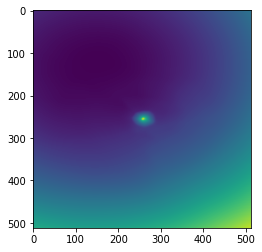

epoch 76201: 48.75821304321289
epoch 76202: 48.52510452270508
epoch 76203: 47.51691436767578
epoch 76204: 47.994869232177734
epoch 76205: 48.59344482421875
epoch 76206: 48.357521057128906
epoch 76207: 47.975196838378906
epoch 76208: 48.343780517578125
epoch 76209: 47.7286376953125
epoch 76211: 48.543609619140625
epoch 76212: 47.982242584228516
epoch 76213: 48.258697509765625
epoch 76214: 48.90184783935547
epoch 76215: 47.94147872924805
epoch 76216: 48.77920913696289
epoch 76217: 47.82398986816406
epoch 76218: 48.346221923828125
epoch 76219: 47.779483795166016
epoch 76221: 48.702064514160156
epoch 76222: 48.04838180541992
epoch 76223: 49.71367263793945
epoch 76224: 47.45738983154297
epoch 76225: 47.254173278808594
epoch 76226: 48.10487365722656
epoch 76227: 48.742984771728516
epoch 76228: 47.990440368652344
epoch 76229: 48.185428619384766
epoch 76231: 48.3256950378418
epoch 76232: 48.85165023803711
epoch 76233: 48.31074142456055
epoch 76234: 48.010963439941406
epoch 76235: 48.7024192810

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



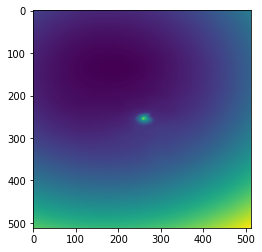

epoch 76301: 49.720489501953125
epoch 76302: 49.20051956176758
epoch 76303: 48.791786193847656
epoch 76304: 49.894840240478516
epoch 76305: 47.90877151489258
epoch 76306: 50.28810119628906
epoch 76307: 48.13547134399414
epoch 76308: 48.27349853515625
epoch 76309: 47.18134307861328
epoch 76311: 48.26839065551758
epoch 76312: 48.2794303894043
epoch 76313: 47.63116455078125
epoch 76314: 47.972373962402344
epoch 76315: 47.71950912475586
epoch 76316: 48.33869171142578
epoch 76317: 48.1304817199707
epoch 76318: 48.788612365722656
epoch 76319: 48.6923713684082
epoch 76321: 48.1103401184082
epoch 76322: 48.204593658447266
epoch 76323: 48.70073318481445
epoch 76324: 48.24678039550781
epoch 76325: 48.33997344970703
epoch 76326: 48.46734619140625
epoch 76327: 48.3786735534668
epoch 76328: 48.354312896728516
epoch 76329: 47.77340316772461
epoch 76331: 47.28075408935547
epoch 76332: 47.81233596801758
epoch 76333: 48.076595306396484
epoch 76334: 48.76823043823242
epoch 76335: 48.09954071044922
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



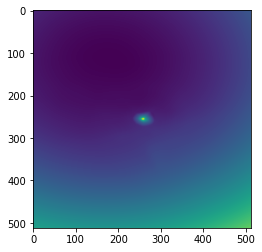

epoch 76401: 47.7256965637207
epoch 76402: 47.875648498535156
epoch 76403: 48.227294921875
epoch 76404: 47.79607009887695
epoch 76405: 48.97819519042969
epoch 76406: 47.95954132080078
epoch 76407: 47.7081298828125
epoch 76408: 48.130409240722656
epoch 76409: 48.30119705200195
epoch 76411: 48.090763092041016
epoch 76412: 48.45664978027344
epoch 76413: 48.36138916015625
epoch 76414: 47.64823532104492
epoch 76415: 47.71146011352539
epoch 76416: 49.13392639160156
epoch 76417: 48.9346809387207
epoch 76418: 48.43744659423828
epoch 76419: 48.16064453125
epoch 76421: 47.675540924072266
epoch 76422: 47.75080871582031
epoch 76423: 47.06488800048828
epoch 76424: 48.15945053100586
epoch 76425: 47.926883697509766
epoch 76426: 47.373477935791016
epoch 76427: 48.62590026855469
epoch 76428: 48.30270004272461
epoch 76429: 48.23558807373047
epoch 76431: 47.428932189941406
epoch 76432: 47.516685485839844
epoch 76433: 48.46748733520508
epoch 76434: 47.66611862182617
epoch 76435: 48.04487228393555
epoch 76

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



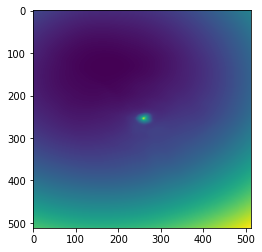

epoch 76501: 47.75204086303711
epoch 76502: 48.34492492675781
epoch 76503: 47.65349578857422
epoch 76504: 47.68783187866211
epoch 76505: 47.41992950439453
epoch 76506: 48.03299331665039
epoch 76507: 47.780582427978516
epoch 76508: 48.23607635498047
epoch 76509: 48.16437911987305
epoch 76511: 47.17043685913086
epoch 76512: 47.382266998291016
epoch 76513: 47.9328498840332
epoch 76514: 48.03447723388672
epoch 76515: 47.425071716308594
epoch 76516: 47.34024429321289
epoch 76517: 47.875938415527344
epoch 76518: 47.63212203979492
epoch 76519: 47.86793518066406
epoch 76521: 47.26226806640625
epoch 76522: 48.382320404052734
epoch 76523: 48.04899597167969
epoch 76524: 49.43617630004883
epoch 76525: 48.46644973754883
epoch 76526: 48.30365753173828
epoch 76527: 48.54154586791992
epoch 76528: 48.188194274902344
epoch 76529: 48.03853988647461
epoch 76531: 48.426368713378906
epoch 76532: 48.555931091308594
epoch 76533: 48.774147033691406
epoch 76534: 48.27250671386719
epoch 76535: 47.758663177490234

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



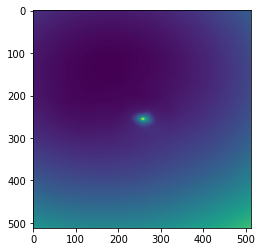

epoch 76601: 48.878089904785156
epoch 76602: 48.903438568115234
epoch 76603: 48.03908157348633
epoch 76604: 48.66346740722656
epoch 76605: 48.71732711791992
epoch 76606: 48.30620574951172
epoch 76607: 48.72414016723633
epoch 76608: 47.51572036743164
epoch 76609: 48.02233123779297
epoch 76611: 47.74536895751953
epoch 76612: 47.94223403930664
epoch 76613: 47.28868865966797
epoch 76614: 47.780906677246094
epoch 76615: 47.53086853027344
epoch 76616: 48.02022171020508
epoch 76617: 48.16350173950195
epoch 76618: 47.208614349365234
epoch 76619: 48.25613784790039
epoch 76621: 48.57090759277344
epoch 76622: 48.057830810546875
epoch 76623: 47.529823303222656
epoch 76624: 48.860084533691406
epoch 76625: 48.3836555480957
epoch 76626: 47.209651947021484
epoch 76627: 47.81070327758789
epoch 76628: 47.49416732788086
epoch 76629: 48.49633026123047
epoch 76631: 47.28508758544922
epoch 76632: 47.99631118774414
epoch 76633: 47.88787078857422
epoch 76634: 48.93468475341797
epoch 76635: 48.21420669555664
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



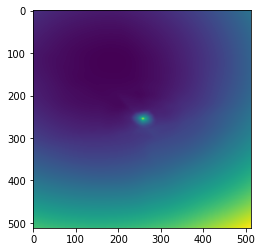

epoch 76701: 47.821964263916016
epoch 76702: 47.806800842285156
epoch 76703: 48.24576187133789
epoch 76704: 47.68227767944336
epoch 76705: 47.43687438964844
epoch 76706: 48.61079025268555
epoch 76707: 47.576202392578125
epoch 76708: 47.87938690185547
epoch 76709: 50.280601501464844
epoch 76711: 48.44658279418945
epoch 76712: 47.93339920043945
epoch 76713: 47.85743713378906
epoch 76714: 48.223777770996094
epoch 76715: 48.314022064208984
epoch 76716: 48.0595703125
epoch 76717: 47.13758850097656
epoch 76718: 47.870208740234375
epoch 76719: 49.314388275146484
epoch 76721: 48.171852111816406
epoch 76722: 47.431549072265625
epoch 76723: 48.3319091796875
epoch 76724: 47.461483001708984
epoch 76725: 47.65507125854492
epoch 76726: 47.44382858276367
epoch 76727: 48.14130401611328
epoch 76728: 48.165557861328125
epoch 76729: 48.324893951416016
epoch 76731: 47.7008171081543
epoch 76732: 47.82389831542969
epoch 76733: 47.874176025390625
epoch 76734: 48.78315734863281
epoch 76735: 47.33589172363281


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



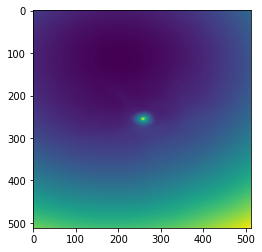

epoch 76801: 48.3696403503418
epoch 76802: 47.58042526245117
epoch 76803: 48.17817687988281
epoch 76804: 48.28367614746094
epoch 76805: 47.90607833862305
epoch 76806: 48.18556213378906
epoch 76807: 47.707645416259766
epoch 76808: 48.028724670410156
epoch 76809: 47.658573150634766
epoch 76811: 48.59562683105469
epoch 76812: 48.047401428222656
epoch 76813: 47.5827522277832
epoch 76814: 48.110084533691406
epoch 76815: 48.57553482055664
epoch 76816: 50.851173400878906
epoch 76817: 48.30210876464844
epoch 76818: 48.419349670410156
epoch 76819: 46.991790771484375
epoch 76821: 49.03598403930664
epoch 76822: 47.87675476074219
epoch 76823: 48.0108528137207
epoch 76824: 48.66211700439453
epoch 76825: 48.24658203125
epoch 76826: 48.276241302490234
epoch 76827: 47.746116638183594
epoch 76828: 48.638370513916016
epoch 76829: 48.385040283203125
epoch 76831: 47.61861801147461
epoch 76832: 47.87388610839844
epoch 76833: 48.6481819152832
epoch 76834: 48.05704879760742
epoch 76835: 47.93775939941406
epo

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



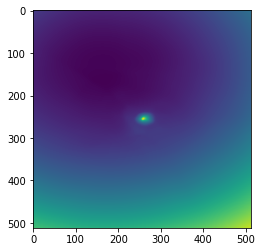

epoch 76901: 48.46634292602539
epoch 76902: 48.01450729370117
epoch 76903: 48.92268371582031
epoch 76904: 48.68703079223633
epoch 76905: 48.87806701660156
epoch 76906: 48.26148986816406
epoch 76907: 49.628963470458984
epoch 76908: 48.147830963134766
epoch 76909: 48.36520004272461
epoch 76911: 47.75196838378906
epoch 76912: 47.12366485595703
epoch 76913: 47.934112548828125
epoch 76914: 48.39289093017578
epoch 76915: 47.8643798828125
epoch 76916: 47.6777458190918
epoch 76917: 47.40581512451172
epoch 76918: 49.1821403503418
epoch 76919: 47.8278923034668
epoch 76921: 48.455711364746094
epoch 76922: 48.56957244873047
epoch 76923: 48.301841735839844
epoch 76924: 48.70407485961914
epoch 76925: 47.85972213745117
epoch 76926: 48.17714309692383
epoch 76927: 47.72444152832031
epoch 76928: 48.631099700927734
epoch 76929: 48.009212493896484
epoch 76931: 48.53517532348633
epoch 76932: 48.65648651123047
epoch 76933: 47.503684997558594
epoch 76934: 47.9705696105957
epoch 76935: 47.84211349487305
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



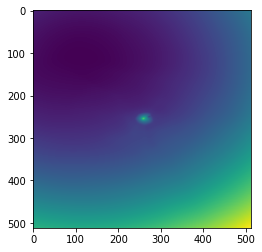

epoch 77001: 48.897674560546875
epoch 77002: 47.85902404785156
epoch 77003: 47.981021881103516
epoch 77004: 48.38534927368164
epoch 77005: 48.16307067871094
epoch 77006: 48.15052795410156
epoch 77007: 47.94626998901367
epoch 77008: 47.87035369873047
epoch 77009: 47.939239501953125
epoch 77011: 48.18517303466797
epoch 77012: 48.4915657043457
epoch 77013: 48.06468200683594
epoch 77014: 47.8934211730957
epoch 77015: 48.097816467285156
epoch 77016: 48.010555267333984
epoch 77017: 47.64149475097656
epoch 77018: 48.34248352050781
epoch 77019: 47.77586364746094
epoch 77021: 48.297786712646484
epoch 77022: 48.04130935668945
epoch 77023: 47.85185241699219
epoch 77024: 48.749481201171875
epoch 77025: 48.104087829589844
epoch 77026: 47.77393341064453
epoch 77027: 47.93299865722656
epoch 77028: 47.40833282470703
epoch 77029: 48.22710418701172
epoch 77031: 47.90302658081055
epoch 77032: 48.411346435546875
epoch 77033: 48.14828109741211
epoch 77034: 48.30720520019531
epoch 77035: 48.197174072265625


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



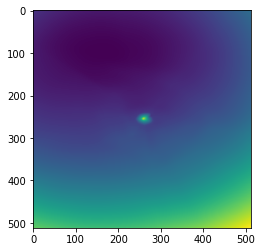

epoch 77101: 47.72999572753906
epoch 77102: 48.72362518310547
epoch 77103: 48.2313346862793
epoch 77104: 48.37627410888672
epoch 77105: 48.52418899536133
epoch 77106: 47.802181243896484
epoch 77107: 49.00227355957031
epoch 77108: 48.78493118286133
epoch 77109: 49.126590728759766
epoch 77111: 48.306087493896484
epoch 77112: 48.28337478637695
epoch 77113: 47.83757781982422
epoch 77114: 48.996273040771484
epoch 77115: 47.85900115966797
epoch 77116: 48.70370101928711
epoch 77117: 48.402587890625
epoch 77118: 48.25117111206055
epoch 77119: 48.051658630371094
epoch 77121: 48.042964935302734
epoch 77122: 48.09426498413086
epoch 77123: 48.131683349609375
epoch 77124: 47.574005126953125
epoch 77125: 49.206764221191406
epoch 77126: 47.9166145324707
epoch 77127: 48.420143127441406
epoch 77128: 48.36518096923828
epoch 77129: 48.923851013183594
epoch 77131: 49.071266174316406
epoch 77132: 48.4576416015625
epoch 77133: 47.72868728637695
epoch 77134: 49.37980270385742
epoch 77135: 48.321807861328125


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



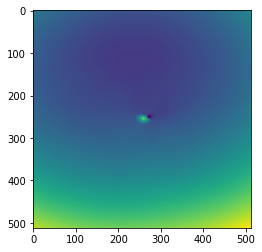

epoch 77201: 48.453094482421875
epoch 77202: 47.72502136230469
epoch 77203: 47.209136962890625
epoch 77204: 48.493507385253906
epoch 77205: 47.646690368652344
epoch 77206: 47.89649200439453
epoch 77207: 48.21037673950195
epoch 77208: 48.156211853027344
epoch 77209: 48.578392028808594
epoch 77211: 48.45311737060547
epoch 77212: 47.74679183959961
epoch 77213: 47.45172119140625
epoch 77214: 47.824127197265625
epoch 77215: 48.291709899902344
epoch 77216: 48.019710540771484
epoch 77217: 48.259361267089844
epoch 77218: 48.1652717590332
epoch 77219: 47.63047790527344
epoch 77221: 47.735172271728516
epoch 77222: 48.18043899536133
epoch 77223: 48.01598358154297
epoch 77224: 48.21382141113281
epoch 77225: 47.84649658203125
epoch 77226: 48.20465087890625
epoch 77227: 47.64493942260742
epoch 77228: 47.60892868041992
epoch 77229: 48.13900375366211
epoch 77231: 47.85419845581055
epoch 77232: 47.68169021606445
epoch 77233: 48.351314544677734
epoch 77234: 49.06838607788086
epoch 77235: 47.30029296875


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



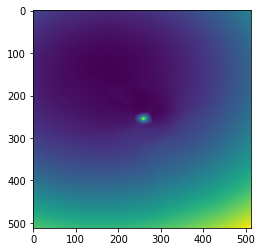

epoch 77301: 48.00032424926758
epoch 77302: 47.60643768310547
epoch 77303: 47.40446090698242
epoch 77304: 47.878116607666016
epoch 77305: 48.82319641113281
epoch 77306: 47.47202682495117
epoch 77307: 47.430233001708984
epoch 77308: 48.22901916503906
epoch 77309: 48.62858581542969
epoch 77311: 48.23127746582031
epoch 77312: 47.5268440246582
epoch 77313: 47.51396560668945
epoch 77314: 47.519569396972656
epoch 77315: 46.80520248413086
epoch 77316: 47.98162841796875
epoch 77317: 50.083709716796875
epoch 77318: 47.912940979003906
epoch 77319: 50.895145416259766
epoch 77321: 48.35334014892578
epoch 77322: 47.853824615478516
epoch 77323: 47.030452728271484
epoch 77324: 47.82557678222656
epoch 77325: 49.84309005737305
epoch 77326: 47.63245391845703
epoch 77327: 47.688846588134766
epoch 77328: 47.554481506347656
epoch 77329: 47.91374588012695
epoch 77331: 46.780364990234375
epoch 77332: 47.827903747558594
epoch 77333: 47.6917724609375
epoch 77334: 48.422786712646484
epoch 77335: 48.434284210205

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



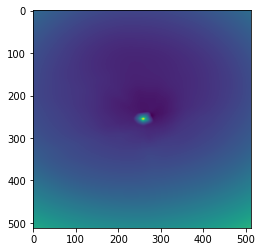

epoch 77401: 46.99555206298828
epoch 77402: 49.63528060913086
epoch 77403: 48.495635986328125
epoch 77404: 48.11187744140625
epoch 77405: 48.7297248840332
epoch 77406: 48.22018051147461
epoch 77407: 48.007118225097656
epoch 77408: 47.57276916503906
epoch 77409: 48.8742561340332
epoch 77411: 47.868778228759766
epoch 77412: 48.180931091308594
epoch 77413: 47.94124221801758
epoch 77414: 48.187522888183594
epoch 77415: 47.38566589355469
epoch 77416: 48.26077651977539
epoch 77417: 48.08784484863281
epoch 77418: 47.819671630859375
epoch 77419: 48.83988952636719
epoch 77421: 47.735233306884766
epoch 77422: 47.82883834838867
epoch 77423: 47.92033386230469
epoch 77424: 48.79015350341797
epoch 77425: 47.85454559326172
epoch 77426: 48.89198684692383
epoch 77427: 48.61087417602539
epoch 77428: 47.98831558227539
epoch 77429: 48.19720458984375
epoch 77431: 48.05979537963867
epoch 77432: 48.461666107177734
epoch 77433: 49.08649444580078
epoch 77434: 47.705039978027344
epoch 77435: 48.14707946777344
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



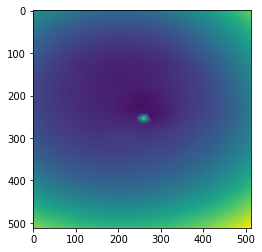

epoch 77501: 48.033203125
epoch 77502: 48.78297424316406
epoch 77503: 48.448081970214844
epoch 77504: 47.31547927856445
epoch 77505: 48.58967208862305
epoch 77506: 48.1893310546875
epoch 77507: 50.45610809326172
epoch 77508: 48.251380920410156
epoch 77509: 47.80637741088867
epoch 77511: 48.34088897705078
epoch 77512: 48.038265228271484
epoch 77513: 48.12297058105469
epoch 77514: 47.516544342041016
epoch 77515: 48.629276275634766
epoch 77516: 48.26826477050781
epoch 77517: 48.910369873046875
epoch 77518: 48.372615814208984
epoch 77519: 48.2791862487793
epoch 77521: 47.381099700927734
epoch 77522: 48.376434326171875
epoch 77523: 47.79560852050781
epoch 77524: 47.987300872802734
epoch 77525: 47.183258056640625
epoch 77526: 48.215091705322266
epoch 77527: 48.33115005493164
epoch 77528: 47.73051834106445
epoch 77529: 47.02010726928711
epoch 77531: 47.965728759765625
epoch 77532: 47.57841491699219
epoch 77533: 47.91551971435547
epoch 77534: 48.192405700683594
epoch 77535: 48.795745849609375


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



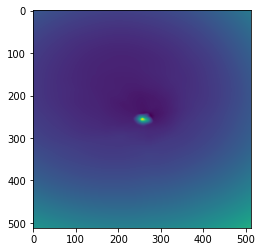

epoch 77601: 48.81878662109375
epoch 77602: 47.601844787597656
epoch 77603: 48.47022247314453
epoch 77604: 48.354591369628906
epoch 77605: 48.37586975097656
epoch 77606: 48.599918365478516
epoch 77607: 48.248844146728516
epoch 77608: 48.60527038574219
epoch 77609: 47.83082962036133
epoch 77611: 47.783180236816406
epoch 77612: 47.86207580566406
epoch 77613: 47.025081634521484
epoch 77614: 47.53495788574219
epoch 77615: 47.787715911865234
epoch 77616: 47.72372055053711
epoch 77617: 47.27717590332031
epoch 77618: 48.48625183105469
epoch 77619: 48.003196716308594
epoch 77621: 48.00068664550781
epoch 77622: 48.27104187011719
epoch 77623: 47.3166389465332
epoch 77624: 48.54146194458008
epoch 77625: 49.404518127441406
epoch 77626: 48.2208137512207
epoch 77627: 47.87447738647461
epoch 77628: 48.24228286743164
epoch 77629: 47.61511993408203
epoch 77631: 47.99388122558594
epoch 77632: 48.42504119873047
epoch 77633: 47.80752944946289
epoch 77634: 48.975982666015625
epoch 77635: 47.54025650024414


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



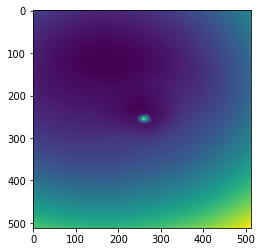

epoch 77701: 47.88648223876953
epoch 77702: 48.633087158203125
epoch 77703: 47.414981842041016
epoch 77704: 47.32587432861328
epoch 77705: 48.32080078125
epoch 77706: 47.86780548095703
epoch 77707: 48.540103912353516
epoch 77708: 47.87741470336914
epoch 77709: 47.785057067871094
epoch 77711: 48.48058319091797
epoch 77712: 47.471744537353516
epoch 77713: 48.038818359375
epoch 77714: 48.16044616699219
epoch 77715: 47.785255432128906
epoch 77716: 48.69199752807617
epoch 77717: 48.41344451904297
epoch 77718: 47.96702575683594
epoch 77719: 48.158878326416016
epoch 77721: 47.67369079589844
epoch 77722: 48.72414016723633
epoch 77723: 47.933441162109375
epoch 77724: 47.809532165527344
epoch 77725: 47.84138488769531
epoch 77726: 47.99004364013672
epoch 77727: 47.08274841308594
epoch 77728: 47.86085510253906
epoch 77729: 48.138484954833984
epoch 77731: 47.267181396484375
epoch 77732: 46.97016525268555
epoch 77733: 47.844146728515625
epoch 77734: 47.788997650146484
epoch 77735: 47.94550704956055


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



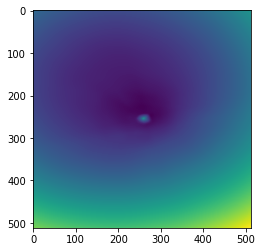

epoch 77801: 50.35308074951172
epoch 77802: 47.92530822753906
epoch 77803: 48.066715240478516
epoch 77804: 47.90610122680664
epoch 77805: 48.158119201660156
epoch 77806: 48.17875289916992
epoch 77807: 49.20189666748047
epoch 77808: 48.515953063964844
epoch 77809: 48.484962463378906
epoch 77811: 47.924312591552734
epoch 77812: 47.835018157958984
epoch 77813: 48.89190673828125
epoch 77814: 48.679019927978516
epoch 77815: 48.50754165649414
epoch 77816: 48.57535171508789
epoch 77817: 49.076454162597656
epoch 77818: 48.08609390258789
epoch 77819: 48.340911865234375
epoch 77821: 48.3243522644043
epoch 77822: 47.5984001159668
epoch 77823: 47.99897384643555
epoch 77824: 49.525413513183594
epoch 77825: 48.923622131347656
epoch 77826: 48.27933883666992
epoch 77827: 48.43414306640625
epoch 77828: 48.184879302978516
epoch 77829: 48.8809928894043
epoch 77831: 48.112937927246094
epoch 77832: 47.77552795410156
epoch 77833: 47.2282600402832
epoch 77834: 48.81205368041992
epoch 77835: 48.5998649597168


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



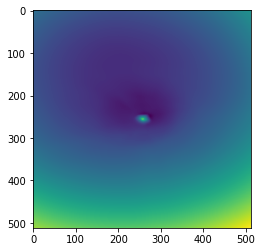

epoch 77901: 48.32795333862305
epoch 77902: 47.318443298339844
epoch 77903: 47.879112243652344
epoch 77904: 47.99031448364258
epoch 77905: 48.253761291503906
epoch 77906: 48.479820251464844
epoch 77907: 47.842132568359375
epoch 77908: 48.168663024902344
epoch 77909: 48.167510986328125
epoch 77911: 47.94261169433594
epoch 77912: 47.765438079833984
epoch 77913: 48.42943572998047
epoch 77914: 48.30542755126953
epoch 77915: 47.868133544921875
epoch 77916: 47.6553955078125
epoch 77917: 47.58085632324219
epoch 77918: 48.430267333984375
epoch 77919: 47.88298034667969
epoch 77921: 47.86564636230469
epoch 77922: 47.528106689453125
epoch 77923: 48.06981658935547
epoch 77924: 47.360694885253906
epoch 77925: 48.27056884765625
epoch 77926: 47.32936096191406
epoch 77927: 47.488162994384766
epoch 77928: 48.505985260009766
epoch 77929: 48.501739501953125
epoch 77931: 48.61829376220703
epoch 77932: 48.65984344482422
epoch 77933: 48.13992691040039
epoch 77934: 47.67790603637695
epoch 77935: 48.364315032

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



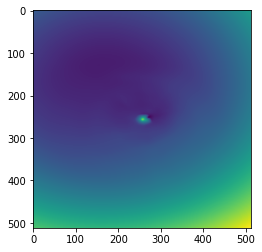

epoch 78001: 48.738468170166016
epoch 78002: 47.61817932128906
epoch 78003: 48.703121185302734
epoch 78004: 48.04972839355469
epoch 78005: 48.47207260131836
epoch 78006: 48.655887603759766
epoch 78007: 48.90190505981445
epoch 78008: 48.041770935058594
epoch 78009: 49.75128173828125
epoch 78011: 47.81128692626953
epoch 78012: 47.76991653442383
epoch 78013: 47.58137130737305
epoch 78014: 48.265167236328125
epoch 78015: 48.758575439453125
epoch 78016: 48.456546783447266
epoch 78017: 47.92683029174805
epoch 78018: 49.734100341796875
epoch 78019: 47.687095642089844
epoch 78021: 47.89177322387695
epoch 78022: 48.26238250732422
epoch 78023: 48.53335189819336
epoch 78024: 48.04176712036133
epoch 78025: 47.722999572753906
epoch 78026: 48.875205993652344
epoch 78027: 48.917884826660156
epoch 78028: 48.500606536865234
epoch 78029: 47.84013366699219
epoch 78031: 48.19739532470703
epoch 78032: 47.61125183105469
epoch 78033: 47.914493560791016
epoch 78034: 47.259361267089844
epoch 78035: 48.80160522

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



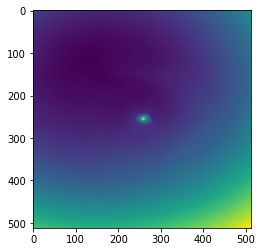

epoch 78101: 47.65966033935547
epoch 78102: 48.16268539428711
epoch 78103: 48.18341827392578
epoch 78104: 48.2697868347168
epoch 78105: 48.448394775390625
epoch 78106: 47.95093536376953
epoch 78107: 48.211082458496094
epoch 78108: 48.21340560913086
epoch 78109: 48.6396369934082
epoch 78111: 47.583091735839844
epoch 78112: 48.192970275878906
epoch 78113: 47.58332061767578
epoch 78114: 47.434078216552734
epoch 78115: 48.474273681640625
epoch 78116: 47.677284240722656
epoch 78117: 47.393768310546875
epoch 78118: 47.89140319824219
epoch 78119: 47.93610763549805
epoch 78121: 47.0452766418457
epoch 78122: 47.96469497680664
epoch 78123: 48.09723663330078
epoch 78124: 47.505577087402344
epoch 78125: 47.528411865234375
epoch 78126: 48.218162536621094
epoch 78127: 48.52655792236328
epoch 78128: 47.980899810791016
epoch 78129: 47.696495056152344
epoch 78131: 47.771183013916016
epoch 78132: 47.65740203857422
epoch 78133: 47.84380340576172
epoch 78134: 47.485076904296875
epoch 78135: 47.97089004516

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



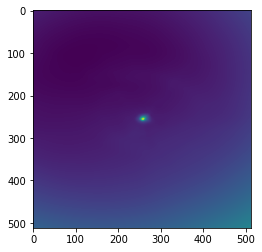

epoch 78201: 48.501197814941406
epoch 78202: 48.733184814453125
epoch 78203: 47.91763687133789
epoch 78204: 48.31353759765625
epoch 78205: 47.49401092529297
epoch 78206: 48.31517028808594
epoch 78207: 48.57661437988281
epoch 78208: 48.308494567871094
epoch 78209: 48.717281341552734
epoch 78211: 48.087520599365234
epoch 78212: 48.258304595947266
epoch 78213: 48.3455696105957
epoch 78214: 48.825103759765625
epoch 78215: 48.251461029052734
epoch 78216: 48.41246795654297
epoch 78217: 48.13051986694336
epoch 78218: 48.341957092285156
epoch 78219: 48.306243896484375
epoch 78221: 48.624298095703125
epoch 78222: 48.138465881347656
epoch 78223: 48.41557693481445
epoch 78224: 48.44648361206055
epoch 78225: 48.69953918457031
epoch 78226: 49.3722038269043
epoch 78227: 48.885032653808594
epoch 78228: 49.33189392089844
epoch 78229: 48.031497955322266
epoch 78231: 48.237152099609375
epoch 78232: 47.563560485839844
epoch 78233: 48.11829376220703
epoch 78234: 48.93932342529297
epoch 78235: 48.621646881

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



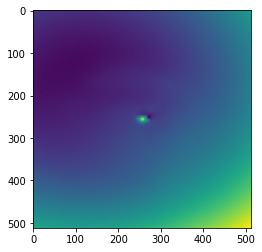

epoch 78301: 48.88999938964844
epoch 78302: 48.39662170410156
epoch 78303: 48.61395263671875
epoch 78304: 48.606571197509766
epoch 78305: 48.489437103271484
epoch 78306: 48.167518615722656
epoch 78307: 48.1609992980957
epoch 78308: 48.619632720947266
epoch 78309: 47.94338607788086
epoch 78311: 48.06541442871094
epoch 78312: 47.67780303955078
epoch 78313: 48.77272415161133
epoch 78314: 47.46783447265625
epoch 78315: 47.9644775390625
epoch 78316: 47.977596282958984
epoch 78317: 48.3446159362793
epoch 78318: 48.49772262573242
epoch 78319: 47.2908935546875
epoch 78321: 47.84747314453125
epoch 78322: 47.77062225341797
epoch 78323: 47.77782440185547
epoch 78324: 47.86002731323242
epoch 78325: 49.10009002685547
epoch 78326: 47.59730529785156
epoch 78327: 47.73995590209961
epoch 78328: 48.635475158691406
epoch 78329: 48.53105545043945
epoch 78331: 48.52390670776367
epoch 78332: 48.045265197753906
epoch 78333: 47.65495681762695
epoch 78334: 47.612613677978516
epoch 78335: 47.85879898071289
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



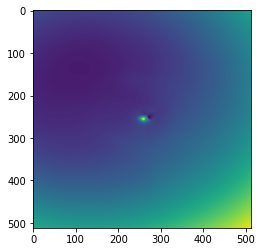

epoch 78401: 48.48505401611328
epoch 78402: 49.80840301513672
epoch 78403: 48.15805435180664
epoch 78404: 47.76449966430664
epoch 78405: 48.437984466552734
epoch 78406: 48.09431076049805
epoch 78407: 47.8966178894043
epoch 78408: 47.46733856201172
epoch 78409: 47.906150817871094
epoch 78411: 48.339813232421875
epoch 78412: 49.02055740356445
epoch 78413: 49.07136535644531
epoch 78414: 47.71979522705078
epoch 78415: 48.43321228027344
epoch 78416: 48.44343948364258
epoch 78417: 49.158451080322266
epoch 78418: 47.888153076171875
epoch 78419: 49.160526275634766
epoch 78421: 48.54631042480469
epoch 78422: 48.70146942138672
epoch 78423: 49.301570892333984
epoch 78424: 49.03260040283203
epoch 78425: 48.81795883178711
epoch 78426: 47.29826736450195
epoch 78427: 48.032020568847656
epoch 78428: 48.26652526855469
epoch 78429: 48.35030746459961
epoch 78431: 48.455318450927734
epoch 78432: 49.37899398803711
epoch 78433: 47.89304733276367
epoch 78434: 47.9128532409668
epoch 78435: 47.857086181640625


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



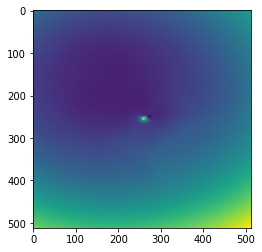

epoch 78501: 47.53311538696289
epoch 78502: 47.71896743774414
epoch 78503: 47.80882263183594
epoch 78504: 48.06912612915039
epoch 78505: 47.82489776611328
epoch 78506: 48.20690155029297
epoch 78507: 48.07432556152344
epoch 78508: 48.03477096557617
epoch 78509: 48.59695816040039
epoch 78511: 47.059356689453125
epoch 78512: 47.43635559082031
epoch 78513: 48.658016204833984
epoch 78514: 47.91191482543945
epoch 78515: 47.87077713012695
epoch 78516: 49.299991607666016
epoch 78517: 48.50302505493164
epoch 78518: 48.477535247802734
epoch 78519: 47.862892150878906
epoch 78521: 48.48947525024414
epoch 78522: 49.54994583129883
epoch 78523: 47.39213943481445
epoch 78524: 47.00617980957031
epoch 78525: 47.782310485839844
epoch 78526: 47.717079162597656
epoch 78527: 48.6229248046875
epoch 78528: 48.413150787353516
epoch 78529: 47.90496826171875
epoch 78531: 48.89923858642578
epoch 78532: 48.040218353271484
epoch 78533: 47.250911712646484
epoch 78534: 47.91227722167969
epoch 78535: 48.09605026245117

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



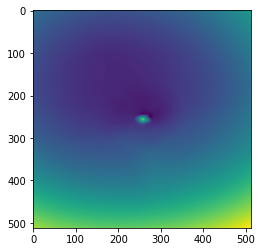

epoch 78601: 47.42485809326172
epoch 78602: 47.469120025634766
epoch 78603: 47.67477798461914
epoch 78604: 47.6334114074707
epoch 78605: 47.88234329223633
epoch 78606: 48.16817855834961
epoch 78607: 47.74137878417969
epoch 78608: 47.92672348022461
epoch 78609: 47.96234893798828
epoch 78611: 47.613372802734375
epoch 78612: 47.80519104003906
epoch 78613: 48.86631774902344
epoch 78614: 47.25659942626953
epoch 78615: 48.5357780456543
epoch 78616: 50.995750427246094
epoch 78617: 48.252540588378906
epoch 78618: 49.9295539855957
epoch 78619: 47.880393981933594
epoch 78621: 48.208988189697266
epoch 78622: 48.41506576538086
epoch 78623: 47.96369552612305
epoch 78624: 47.73249053955078
epoch 78625: 48.76592254638672
epoch 78626: 47.40235900878906
epoch 78627: 48.49895477294922
epoch 78628: 48.031185150146484
epoch 78629: 48.114253997802734
epoch 78631: 47.96010971069336
epoch 78632: 48.03647994995117
epoch 78633: 48.69112777709961
epoch 78634: 47.564231872558594
epoch 78635: 47.30268478393555
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



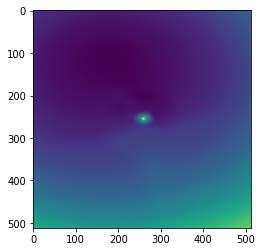

epoch 78701: 48.267093658447266
epoch 78702: 47.63581085205078
epoch 78703: 47.05647277832031
epoch 78704: 47.69183349609375
epoch 78705: 47.351043701171875
epoch 78706: 47.718788146972656
epoch 78707: 48.053955078125
epoch 78708: 47.18218994140625
epoch 78709: 47.71398162841797
epoch 78711: 47.60177993774414
epoch 78712: 47.073829650878906
epoch 78713: 48.30442428588867
epoch 78714: 48.126243591308594
epoch 78715: 47.5725212097168
epoch 78716: 48.498077392578125
epoch 78717: 48.075069427490234
epoch 78718: 49.117774963378906
epoch 78719: 47.14580535888672
epoch 78721: 48.76371383666992
epoch 78722: 51.04888916015625
epoch 78723: 47.834716796875
epoch 78724: 47.709171295166016
epoch 78725: 48.1248779296875
epoch 78726: 47.97821807861328
epoch 78727: 47.76249313354492
epoch 78728: 47.40900802612305
epoch 78729: 47.426353454589844
epoch 78731: 47.878501892089844
epoch 78732: 48.235816955566406
epoch 78733: 48.15110778808594
epoch 78734: 48.58649444580078
epoch 78735: 48.18941116333008
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



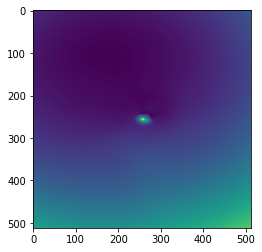

epoch 78801: 47.7844123840332
epoch 78802: 48.46240234375
epoch 78803: 47.80983352661133
epoch 78804: 47.5713005065918
epoch 78805: 48.17593765258789
epoch 78806: 48.12160873413086
epoch 78807: 48.236148834228516
epoch 78808: 47.62528610229492
epoch 78809: 48.20757293701172
epoch 78811: 48.387733459472656
epoch 78812: 48.23160934448242
epoch 78813: 48.03093338012695
epoch 78814: 47.89397430419922
epoch 78815: 47.677330017089844
epoch 78816: 48.684715270996094
epoch 78817: 48.06698226928711
epoch 78818: 47.64694595336914
epoch 78819: 47.84307861328125
epoch 78821: 47.77153015136719
epoch 78822: 48.61306381225586
epoch 78823: 48.05115509033203
epoch 78824: 47.48045349121094
epoch 78825: 47.221702575683594
epoch 78826: 47.64382553100586
epoch 78827: 48.26587677001953
epoch 78828: 48.08949279785156
epoch 78829: 47.71446990966797
epoch 78831: 47.99935531616211
epoch 78832: 48.02220153808594
epoch 78833: 47.615657806396484
epoch 78834: 48.02342224121094
epoch 78835: 49.136322021484375
epoch 

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



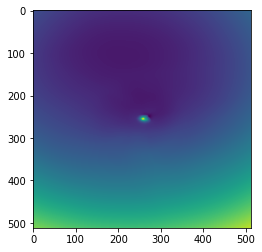

epoch 78901: 47.82533264160156
epoch 78902: 47.70363998413086
epoch 78903: 48.02170944213867
epoch 78904: 48.68193054199219
epoch 78905: 48.860382080078125
epoch 78906: 48.75835037231445
epoch 78907: 47.78626251220703
epoch 78908: 48.83601760864258
epoch 78909: 47.35490417480469
epoch 78911: 48.305320739746094
epoch 78912: 47.85862350463867
epoch 78913: 47.692047119140625
epoch 78914: 48.752811431884766
epoch 78915: 47.72158432006836
epoch 78916: 48.29448318481445
epoch 78917: 48.25517272949219
epoch 78918: 47.78908920288086
epoch 78919: 47.82870101928711
epoch 78921: 47.97679901123047
epoch 78922: 48.4294319152832
epoch 78923: 48.61250305175781
epoch 78924: 48.53945541381836
epoch 78925: 48.32727813720703
epoch 78926: 48.32686233520508
epoch 78927: 49.195953369140625
epoch 78928: 48.16057586669922
epoch 78929: 47.432315826416016
epoch 78931: 47.99764633178711
epoch 78932: 47.6108512878418
epoch 78933: 47.21481704711914
epoch 78934: 48.6829719543457
epoch 78935: 48.311851501464844
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



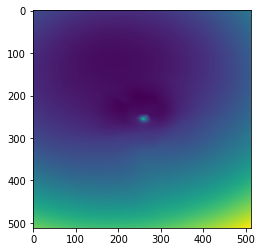

epoch 79001: 48.289772033691406
epoch 79002: 47.79206848144531
epoch 79003: 47.85127639770508
epoch 79004: 47.74293899536133
epoch 79005: 48.770599365234375
epoch 79006: 47.862342834472656
epoch 79007: 47.26594543457031
epoch 79008: 48.4619140625
epoch 79009: 48.702396392822266
epoch 79011: 48.011043548583984
epoch 79012: 48.651161193847656
epoch 79013: 53.970184326171875
epoch 79014: 48.075111389160156
epoch 79015: 48.82779312133789
epoch 79016: 47.60763168334961
epoch 79017: 49.623756408691406
epoch 79018: 48.937171936035156
epoch 79019: 48.484519958496094
epoch 79021: 48.46803665161133
epoch 79022: 48.33924102783203
epoch 79023: 48.16488265991211
epoch 79024: 48.52330017089844
epoch 79025: 47.2994270324707
epoch 79026: 48.35441970825195
epoch 79027: 48.16516876220703
epoch 79028: 47.66695785522461
epoch 79029: 48.473175048828125
epoch 79031: 47.79941940307617
epoch 79032: 48.253173828125
epoch 79033: 47.16008377075195
epoch 79034: 47.874271392822266
epoch 79035: 48.04411697387695
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



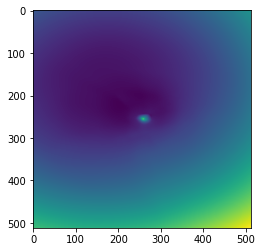

epoch 79101: 48.7151985168457
epoch 79102: 46.513858795166016
epoch 79103: 48.589439392089844
epoch 79104: 47.665435791015625
epoch 79105: 47.52864456176758
epoch 79106: 47.33356475830078
epoch 79107: 47.581241607666016
epoch 79108: 50.8068733215332
epoch 79109: 47.63936996459961
epoch 79111: 47.517433166503906
epoch 79112: 48.17304229736328
epoch 79113: 48.04079818725586
epoch 79114: 48.0406608581543
epoch 79115: 48.38716125488281
epoch 79116: 48.24580383300781
epoch 79117: 47.189815521240234
epoch 79118: 48.240135192871094
epoch 79119: 48.664005279541016
epoch 79121: 48.03813934326172
epoch 79122: 47.4189567565918
epoch 79123: 47.79341125488281
epoch 79124: 48.55232238769531
epoch 79125: 48.40020751953125
epoch 79126: 47.26918029785156
epoch 79127: 47.995548248291016
epoch 79128: 48.00441360473633
epoch 79129: 47.99155807495117
epoch 79131: 48.66798782348633
epoch 79132: 48.281166076660156
epoch 79133: 48.39055252075195
epoch 79134: 48.15642547607422
epoch 79135: 48.39860534667969
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



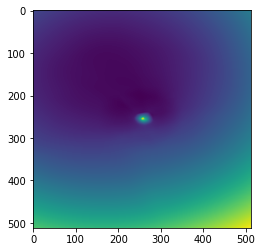

epoch 79201: 48.289825439453125
epoch 79202: 48.20038986206055
epoch 79203: 49.99470520019531
epoch 79204: 48.80202102661133
epoch 79205: 47.55669021606445
epoch 79206: 48.14124298095703
epoch 79207: 47.67652130126953
epoch 79208: 47.789669036865234
epoch 79209: 47.77833938598633
epoch 79211: 47.770137786865234
epoch 79212: 47.29433059692383
epoch 79213: 49.21572494506836
epoch 79214: 47.745872497558594
epoch 79215: 47.65584182739258
epoch 79216: 47.83974838256836
epoch 79217: 48.27133560180664
epoch 79218: 47.66633605957031
epoch 79219: 47.8082160949707
epoch 79221: 47.7480354309082
epoch 79222: 47.9337272644043
epoch 79223: 47.6009521484375
epoch 79224: 49.03622817993164
epoch 79225: 48.0001335144043
epoch 79226: 48.609004974365234
epoch 79227: 47.27941131591797
epoch 79228: 49.031185150146484
epoch 79229: 48.2845344543457
epoch 79231: 48.02233123779297
epoch 79232: 48.47633361816406
epoch 79233: 47.60085678100586
epoch 79234: 47.78420639038086
epoch 79235: 47.91120147705078
epoch 79

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



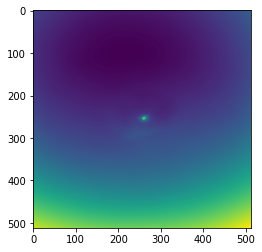

epoch 79301: 48.25135803222656
epoch 79302: 49.224952697753906
epoch 79303: 48.327693939208984
epoch 79304: 47.67898941040039
epoch 79305: 47.260475158691406
epoch 79306: 47.61418533325195
epoch 79307: 47.74684143066406
epoch 79308: 48.178077697753906
epoch 79309: 48.086090087890625
epoch 79311: 47.7371940612793
epoch 79312: 48.28671646118164
epoch 79313: 48.29657745361328
epoch 79314: 48.55841064453125
epoch 79315: 49.12111282348633
epoch 79316: 48.06172180175781
epoch 79317: 48.83506774902344
epoch 79318: 47.9147834777832
epoch 79319: 47.600032806396484
epoch 79321: 47.462833404541016
epoch 79322: 47.63849639892578
epoch 79323: 49.41159439086914
epoch 79324: 48.39048385620117
epoch 79325: 47.99195098876953
epoch 79326: 47.98255157470703
epoch 79327: 48.28970718383789
epoch 79328: 49.051517486572266
epoch 79329: 48.48077392578125
epoch 79331: 48.112857818603516
epoch 79332: 48.02619552612305
epoch 79333: 47.92159652709961
epoch 79334: 47.3213996887207
epoch 79335: 48.26387023925781
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



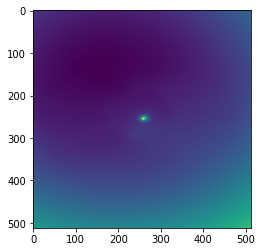

epoch 79401: 47.60777282714844
epoch 79402: 47.7225341796875
epoch 79403: 48.23572540283203
epoch 79404: 48.551918029785156
epoch 79405: 48.627079010009766
epoch 79406: 47.52235412597656
epoch 79407: 48.28415298461914
epoch 79408: 47.60308837890625
epoch 79409: 48.043678283691406
epoch 79411: 48.087642669677734
epoch 79412: 48.32614517211914
epoch 79413: 48.36323928833008
epoch 79414: 48.40010070800781
epoch 79415: 48.63108825683594
epoch 79416: 48.44049835205078
epoch 79417: 48.4736213684082
epoch 79418: 47.67523956298828
epoch 79419: 48.687442779541016
epoch 79421: 47.915924072265625
epoch 79422: 47.30614471435547
epoch 79423: 48.013526916503906
epoch 79424: 48.82341003417969
epoch 79425: 47.40053939819336
epoch 79426: 48.21023941040039
epoch 79427: 48.04056167602539
epoch 79428: 48.472015380859375
epoch 79429: 48.72734451293945
epoch 79431: 48.08182144165039
epoch 79432: 47.94101333618164
epoch 79433: 47.462074279785156
epoch 79434: 47.43846130371094
epoch 79435: 48.847511291503906


/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



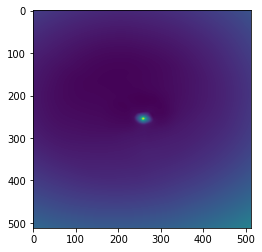

epoch 79501: 48.47423553466797
epoch 79502: 48.455543518066406
epoch 79503: 47.67698669433594
epoch 79504: 47.76083755493164
epoch 79505: 48.61054992675781
epoch 79506: 47.9149169921875
epoch 79507: 48.28972244262695
epoch 79508: 47.75345230102539
epoch 79509: 48.641632080078125
epoch 79511: 49.57774353027344
epoch 79512: 49.11468505859375
epoch 79513: 48.77861785888672
epoch 79514: 47.638946533203125
epoch 79515: 50.082618713378906
epoch 79516: 48.164302825927734
epoch 79517: 47.70210647583008
epoch 79518: 47.622276306152344
epoch 79519: 47.1007080078125
epoch 79521: 47.90462875366211
epoch 79522: 47.75180435180664
epoch 79523: 47.772308349609375
epoch 79524: 48.521026611328125
epoch 79525: 51.46812438964844
epoch 79526: 48.59956359863281
epoch 79527: 47.94355010986328
epoch 79528: 48.23488998413086
epoch 79529: 47.36762237548828
epoch 79531: 48.067203521728516
epoch 79532: 47.68618392944336
epoch 79533: 47.71574783325195
epoch 79534: 48.33157730102539
epoch 79535: 56.42204666137695
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



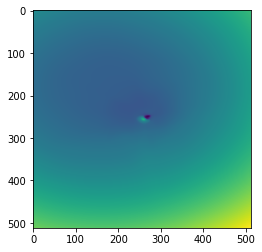

epoch 79601: 48.27565383911133
epoch 79602: 48.377281188964844
epoch 79603: 48.2196159362793
epoch 79604: 47.75798416137695
epoch 79605: 48.423885345458984
epoch 79606: 48.3258056640625
epoch 79607: 47.784934997558594
epoch 79608: 48.123226165771484
epoch 79609: 49.109092712402344
epoch 79611: 48.093666076660156
epoch 79612: 47.810760498046875
epoch 79613: 47.838871002197266
epoch 79614: 48.34417724609375
epoch 79615: 47.95659255981445
epoch 79616: 47.96390914916992
epoch 79617: 49.11635971069336
epoch 79618: 48.613739013671875
epoch 79619: 47.74104690551758
epoch 79621: 48.2477912902832
epoch 79622: 48.55573654174805
epoch 79623: 48.13008117675781
epoch 79624: 47.87950897216797
epoch 79625: 48.26643371582031
epoch 79626: 48.529300689697266
epoch 79627: 47.85736083984375
epoch 79628: 47.78791809082031
epoch 79629: 47.67399215698242
epoch 79631: 47.62557601928711
epoch 79632: 48.166751861572266
epoch 79633: 48.383888244628906
epoch 79634: 48.575531005859375
epoch 79635: 47.8230819702148

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



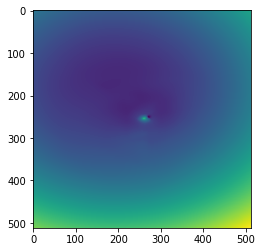

epoch 79701: 48.2060432434082
epoch 79702: 47.89377212524414
epoch 79703: 48.95401382446289
epoch 79704: 48.12840270996094
epoch 79705: 49.36691665649414
epoch 79706: 48.13090515136719
epoch 79707: 48.2634162902832
epoch 79708: 47.70674514770508
epoch 79709: 48.70054626464844
epoch 79711: 47.66900634765625
epoch 79712: 49.99347686767578
epoch 79713: 48.907875061035156
epoch 79714: 47.479923248291016
epoch 79715: 48.12916564941406
epoch 79716: 48.55964660644531
epoch 79717: 48.318912506103516
epoch 79718: 48.39593505859375
epoch 79719: 47.57307434082031
epoch 79721: 48.02104187011719
epoch 79722: 49.25498962402344
epoch 79723: 47.68064498901367
epoch 79724: 48.26176071166992
epoch 79725: 48.61970520019531
epoch 79726: 48.92394256591797
epoch 79727: 47.75676727294922
epoch 79728: 48.67570114135742
epoch 79729: 48.86708450317383
epoch 79731: 48.63621520996094
epoch 79732: 47.77153015136719
epoch 79733: 48.186763763427734
epoch 79734: 48.68046569824219
epoch 79735: 47.534000396728516
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



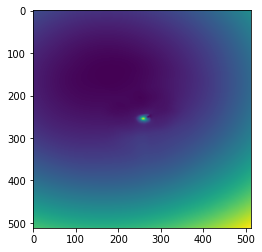

epoch 79801: 48.88258743286133
epoch 79802: 47.971534729003906
epoch 79803: 47.98744201660156
epoch 79804: 48.74122619628906
epoch 79805: 48.20886993408203
epoch 79806: 47.54671096801758
epoch 79807: 47.898223876953125
epoch 79808: 52.48826599121094
epoch 79809: 48.187744140625
epoch 79811: 48.06295394897461
epoch 79812: 47.7061653137207
epoch 79813: 49.1557731628418
epoch 79814: 47.88604736328125
epoch 79815: 47.98310089111328
epoch 79816: 48.015892028808594
epoch 79817: 48.13926696777344
epoch 79818: 47.47419357299805
epoch 79819: 48.049530029296875
epoch 79821: 48.002685546875
epoch 79822: 46.77682876586914
epoch 79823: 48.30970764160156
epoch 79824: 48.76685333251953
epoch 79825: 47.71204376220703
epoch 79826: 47.55511474609375
epoch 79827: 48.41017532348633
epoch 79828: 48.61274337768555
epoch 79829: 48.54701232910156
epoch 79831: 48.449344635009766
epoch 79832: 48.30118179321289
epoch 79833: 47.537879943847656
epoch 79834: 49.11746597290039
epoch 79835: 49.14251708984375
epoch 79

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



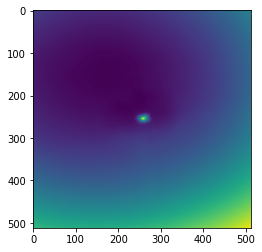

epoch 79901: 48.75919723510742
epoch 79902: 49.026615142822266
epoch 79903: 48.7403678894043
epoch 79904: 48.118221282958984
epoch 79905: 48.087623596191406
epoch 79906: 48.09345626831055
epoch 79907: 48.518714904785156
epoch 79908: 48.45078659057617
epoch 79909: 47.63787841796875
epoch 79911: 48.533424377441406
epoch 79912: 50.70692443847656
epoch 79913: 48.85955047607422
epoch 79914: 47.647377014160156
epoch 79915: 47.6373176574707
epoch 79916: 47.76142883300781
epoch 79917: 47.58867263793945
epoch 79918: 47.64927291870117
epoch 79919: 49.023841857910156
epoch 79921: 47.43259048461914
epoch 79922: 48.16582489013672
epoch 79923: 48.1069450378418
epoch 79924: 48.596946716308594
epoch 79925: 48.0291633605957
epoch 79926: 48.4177131652832
epoch 79927: 47.5452766418457
epoch 79928: 47.59708786010742
epoch 79929: 47.635047912597656
epoch 79931: 48.27349090576172
epoch 79932: 47.23881149291992
epoch 79933: 48.34928894042969
epoch 79934: 48.11635208129883
epoch 79935: 48.496131896972656
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



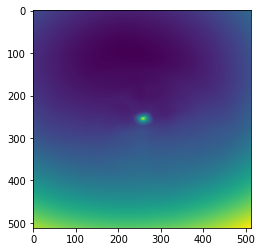

epoch 80001: 48.72343444824219
epoch 80002: 47.88685989379883
epoch 80003: 47.63454818725586
epoch 80004: 48.125423431396484
epoch 80005: 48.15308380126953
epoch 80006: 48.083072662353516
epoch 80007: 47.873985290527344
epoch 80008: 50.036380767822266
epoch 80009: 47.91943359375
epoch 80011: 48.348731994628906
epoch 80012: 47.81744384765625
epoch 80013: 47.88104248046875
epoch 80014: 47.683319091796875
epoch 80015: 47.703453063964844
epoch 80016: 47.78327941894531
epoch 80017: 47.70663833618164
epoch 80018: 47.77866744995117
epoch 80019: 52.66632080078125
epoch 80021: 48.202293395996094
epoch 80022: 47.7974739074707
epoch 80023: 48.49977111816406
epoch 80024: 48.00527572631836
epoch 80025: 48.26131057739258
epoch 80026: 48.898193359375
epoch 80027: 48.76348876953125
epoch 80028: 47.79648208618164
epoch 80029: 48.201412200927734
epoch 80031: 48.24813461303711
epoch 80032: 47.60148239135742
epoch 80033: 48.539772033691406
epoch 80034: 48.61422348022461
epoch 80035: 48.15940856933594
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



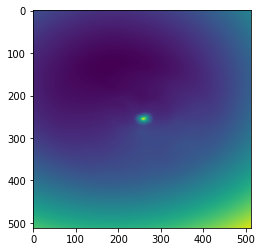

epoch 80101: 47.452518463134766
epoch 80102: 48.2662353515625
epoch 80103: 48.36668395996094
epoch 80104: 48.25218200683594
epoch 80105: 47.90909194946289
epoch 80106: 47.61539840698242
epoch 80107: 47.20143127441406
epoch 80108: 47.891136169433594
epoch 80109: 47.352195739746094
epoch 80111: 48.0358772277832
epoch 80112: 47.43428039550781
epoch 80113: 48.04524230957031
epoch 80114: 49.18036651611328
epoch 80115: 48.04767608642578
epoch 80116: 47.9208869934082
epoch 80117: 48.116825103759766
epoch 80118: 49.043914794921875
epoch 80119: 47.7421875
epoch 80121: 49.455909729003906
epoch 80122: 48.05565643310547
epoch 80123: 48.59641647338867
epoch 80124: 48.4180908203125
epoch 80125: 48.084964752197266
epoch 80126: 47.340763092041016
epoch 80127: 47.742454528808594
epoch 80128: 48.836936950683594
epoch 80129: 47.87409591674805
epoch 80131: 48.04555892944336
epoch 80132: 47.848541259765625
epoch 80133: 49.115577697753906
epoch 80134: 48.34745407104492
epoch 80135: 48.10134506225586
epoch 8

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



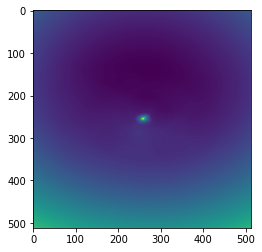

epoch 80201: 48.149864196777344
epoch 80202: 48.87454605102539
epoch 80203: 47.690467834472656
epoch 80204: 49.28242111206055
epoch 80205: 47.759857177734375
epoch 80206: 47.917537689208984
epoch 80207: 48.934932708740234
epoch 80208: 47.62451171875
epoch 80209: 48.65810775756836
epoch 80211: 47.92937469482422
epoch 80212: 47.952945709228516
epoch 80213: 48.763885498046875
epoch 80214: 47.521812438964844
epoch 80215: 48.28633117675781
epoch 80216: 47.938777923583984
epoch 80217: 48.11358642578125
epoch 80218: 47.390411376953125
epoch 80219: 47.67835235595703
epoch 80221: 48.90708541870117
epoch 80222: 46.99638366699219
epoch 80223: 49.308494567871094
epoch 80224: 47.761863708496094
epoch 80225: 48.03470230102539
epoch 80226: 48.676414489746094
epoch 80227: 48.727935791015625
epoch 80228: 49.138248443603516
epoch 80229: 48.808834075927734
epoch 80231: 48.83534240722656
epoch 80232: 48.451663970947266
epoch 80233: 48.16056823730469
epoch 80234: 47.70106506347656
epoch 80235: 47.812980651

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



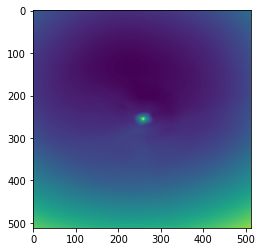

epoch 80301: 47.540584564208984
epoch 80302: 48.0675048828125
epoch 80303: 48.277244567871094
epoch 80304: 47.140113830566406
epoch 80305: 47.70694351196289
epoch 80306: 48.40096664428711
epoch 80307: 47.994224548339844
epoch 80308: 48.25730895996094
epoch 80309: 47.84271240234375
epoch 80311: 47.784446716308594
epoch 80312: 48.17137145996094
epoch 80313: 47.55418395996094
epoch 80314: 47.55895233154297
epoch 80315: 47.513153076171875
epoch 80316: 47.77695846557617
epoch 80317: 48.12916564941406
epoch 80318: 47.80046463012695
epoch 80319: 47.720794677734375
epoch 80321: 48.18971252441406
epoch 80322: 47.68935775756836
epoch 80323: 47.47385787963867
epoch 80324: 47.29496765136719
epoch 80325: 48.27982711791992
epoch 80326: 47.76488494873047
epoch 80327: 48.526065826416016
epoch 80328: 47.671329498291016
epoch 80329: 47.253509521484375
epoch 80331: 49.65827941894531
epoch 80332: 47.981201171875
epoch 80333: 48.04298782348633
epoch 80334: 47.74024963378906
epoch 80335: 49.03453826904297
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



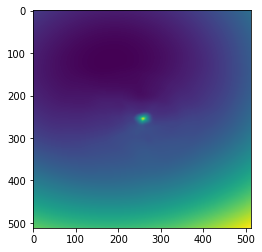

epoch 80401: 47.8970832824707
epoch 80402: 48.06162643432617
epoch 80403: 47.572296142578125
epoch 80404: 49.67275619506836
epoch 80405: 47.81572341918945
epoch 80406: 47.66924285888672
epoch 80407: 47.951480865478516
epoch 80408: 48.744258880615234
epoch 80409: 48.65476989746094
epoch 80411: 47.32233428955078
epoch 80412: 47.81980514526367
epoch 80413: 48.08036422729492
epoch 80414: 48.24459457397461
epoch 80415: 47.49236297607422
epoch 80416: 48.18994140625
epoch 80417: 48.3481559753418
epoch 80418: 48.194210052490234
epoch 80419: 47.39642333984375
epoch 80421: 47.42866897583008
epoch 80422: 47.76583480834961
epoch 80423: 48.850685119628906
epoch 80424: 48.15528106689453
epoch 80425: 48.73003387451172
epoch 80426: 47.60655212402344
epoch 80427: 48.013729095458984
epoch 80428: 47.33747482299805
epoch 80429: 48.05356979370117
epoch 80431: 47.94476318359375
epoch 80432: 48.45005798339844
epoch 80433: 47.68130874633789
epoch 80434: 50.123592376708984
epoch 80435: 49.1844596862793
epoch 8

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



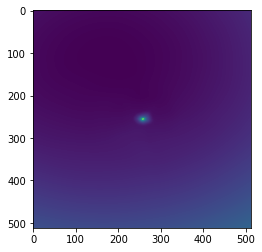

epoch 80501: 48.057350158691406
epoch 80502: 48.33747482299805
epoch 80503: 47.98051452636719
epoch 80504: 48.13252639770508
epoch 80505: 48.077823638916016
epoch 80506: 48.990482330322266
epoch 80507: 47.83435821533203
epoch 80508: 47.53007888793945
epoch 80509: 47.77289581298828
epoch 80511: 47.62416458129883
epoch 80512: 48.31781768798828
epoch 80513: 47.868865966796875
epoch 80514: 47.93199920654297
epoch 80515: 48.354793548583984
epoch 80516: 47.921138763427734
epoch 80517: 47.68121337890625
epoch 80518: 47.27940368652344
epoch 80519: 47.39350128173828
epoch 80521: 47.897891998291016
epoch 80522: 47.7847900390625
epoch 80523: 47.2884407043457
epoch 80524: 47.81032180786133
epoch 80525: 48.10607147216797
epoch 80526: 48.32353210449219
epoch 80527: 47.97359085083008
epoch 80528: 47.91387939453125
epoch 80529: 49.51219940185547
epoch 80531: 48.2930793762207
epoch 80532: 48.23318862915039
epoch 80533: 47.178199768066406
epoch 80534: 47.22385025024414
epoch 80535: 48.331932067871094
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



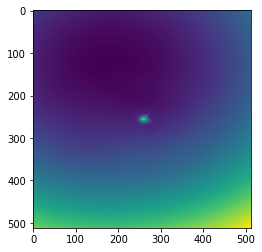

epoch 80601: 47.8475227355957
epoch 80602: 48.199161529541016
epoch 80603: 48.36760330200195
epoch 80604: 47.72218704223633
epoch 80605: 48.66239547729492
epoch 80606: 47.57375717163086
epoch 80607: 48.01567077636719
epoch 80608: 48.62472152709961
epoch 80609: 47.77124786376953
epoch 80611: 47.348289489746094
epoch 80612: 48.693885803222656
epoch 80613: 48.46208572387695
epoch 80614: 48.37010955810547
epoch 80615: 47.219242095947266
epoch 80616: 47.74782180786133
epoch 80617: 48.527801513671875
epoch 80618: 47.643245697021484
epoch 80619: 47.96860122680664
epoch 80621: 47.796138763427734
epoch 80622: 48.206546783447266
epoch 80623: 47.81320571899414
epoch 80624: 48.201690673828125
epoch 80625: 47.90556335449219
epoch 80626: 47.72657775878906
epoch 80627: 47.47745132446289
epoch 80628: 48.23492431640625
epoch 80629: 47.72413635253906
epoch 80631: 48.374786376953125
epoch 80632: 47.159889221191406
epoch 80633: 48.09156036376953
epoch 80634: 47.812068939208984
epoch 80635: 47.950008392333

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



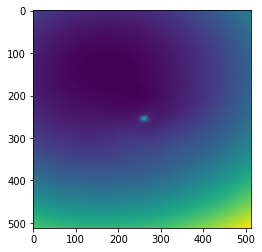

epoch 80701: 47.526771545410156
epoch 80702: 48.275413513183594
epoch 80703: 47.635128021240234
epoch 80704: 48.26660919189453
epoch 80705: 48.00453186035156
epoch 80706: 48.55769348144531
epoch 80707: 48.13552474975586
epoch 80708: 47.341007232666016
epoch 80709: 48.432762145996094
epoch 80711: 47.885738372802734
epoch 80712: 48.57374572753906
epoch 80713: 48.2945442199707
epoch 80714: 47.109771728515625
epoch 80715: 48.46107864379883
epoch 80716: 47.91101837158203
epoch 80717: 47.666099548339844
epoch 80718: 47.521240234375
epoch 80719: 47.96577835083008
epoch 80721: 47.843631744384766
epoch 80722: 47.772666931152344
epoch 80723: 49.1011962890625
epoch 80724: 48.12356948852539
epoch 80725: 47.972137451171875
epoch 80726: 48.384273529052734
epoch 80727: 48.54733657836914
epoch 80728: 47.651336669921875
epoch 80729: 47.77085876464844
epoch 80731: 48.852020263671875
epoch 80732: 47.59425354003906
epoch 80733: 47.90904998779297
epoch 80734: 47.90640640258789
epoch 80735: 48.0417442321777

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



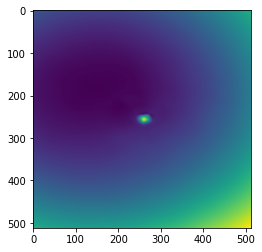

epoch 80801: 47.87574005126953
epoch 80802: 50.515159606933594
epoch 80803: 47.6425666809082
epoch 80804: 47.90042495727539
epoch 80805: 47.66382598876953
epoch 80806: 49.38615798950195
epoch 80807: 48.83829116821289
epoch 80808: 49.03355026245117
epoch 80809: 48.50986862182617
epoch 80811: 48.23597717285156
epoch 80812: 48.62966537475586
epoch 80813: 48.55002975463867
epoch 80814: 47.696258544921875
epoch 80815: 48.50319290161133
epoch 80816: 47.849605560302734
epoch 80817: 48.33563995361328
epoch 80818: 47.404537200927734
epoch 80819: 48.388668060302734
epoch 80821: 49.05956268310547
epoch 80822: 46.96427917480469
epoch 80823: 47.65170669555664
epoch 80824: 47.60686492919922
epoch 80825: 47.91341018676758
epoch 80826: 48.073368072509766
epoch 80827: 48.481876373291016
epoch 80828: 48.29911422729492
epoch 80829: 48.35011291503906
epoch 80831: 48.5037956237793
epoch 80832: 48.29053497314453
epoch 80833: 48.105308532714844
epoch 80834: 47.34606170654297
epoch 80835: 48.414520263671875
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



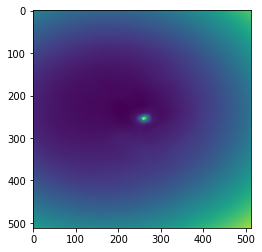

epoch 80901: 49.13544464111328
epoch 80902: 47.86856460571289
epoch 80903: 47.62947463989258
epoch 80904: 47.90907669067383
epoch 80905: 47.4636116027832
epoch 80906: 48.63172149658203
epoch 80907: 47.9955940246582
epoch 80908: 48.21995544433594
epoch 80909: 47.80312728881836
epoch 80911: 47.98208236694336
epoch 80912: 47.637420654296875
epoch 80913: 48.198429107666016
epoch 80914: 47.97220230102539
epoch 80915: 47.83443069458008
epoch 80916: 48.11061096191406
epoch 80917: 48.27726364135742
epoch 80918: 48.803558349609375
epoch 80919: 47.62760925292969
epoch 80921: 49.0438117980957
epoch 80922: 48.63091278076172
epoch 80923: 48.216976165771484
epoch 80924: 48.111572265625
epoch 80925: 48.626686096191406
epoch 80926: 47.725502014160156
epoch 80927: 47.37904739379883
epoch 80928: 47.31287384033203
epoch 80929: 48.491790771484375
epoch 80931: 47.25690460205078
epoch 80932: 47.912940979003906
epoch 80933: 47.795291900634766
epoch 80934: 47.68181610107422
epoch 80935: 47.70254135131836
epoc

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



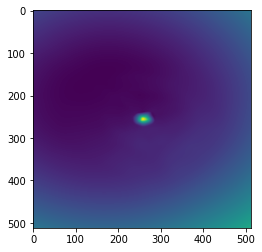

epoch 81001: 47.795738220214844
epoch 81002: 48.40111541748047
epoch 81003: 47.579689025878906
epoch 81004: 48.45967483520508
epoch 81005: 47.89530563354492
epoch 81006: 48.20298385620117
epoch 81007: 47.318267822265625
epoch 81008: 47.467018127441406
epoch 81009: 47.768531799316406
epoch 81011: 47.77526092529297
epoch 81012: 48.08567428588867
epoch 81013: 47.91617965698242
epoch 81014: 48.21078872680664
epoch 81015: 48.19280242919922
epoch 81016: 47.65738296508789
epoch 81017: 48.192081451416016
epoch 81018: 47.68126678466797
epoch 81019: 48.46410369873047
epoch 81021: 47.9346923828125
epoch 81022: 48.214256286621094
epoch 81023: 47.27352523803711
epoch 81024: 47.916778564453125
epoch 81025: 48.58198547363281
epoch 81026: 47.399818420410156
epoch 81027: 47.71828842163086
epoch 81028: 48.464866638183594
epoch 81029: 47.689212799072266
epoch 81031: 47.82061004638672
epoch 81032: 47.66740036010742
epoch 81033: 47.1982421875
epoch 81034: 48.11383819580078
epoch 81035: 48.93596267700195
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



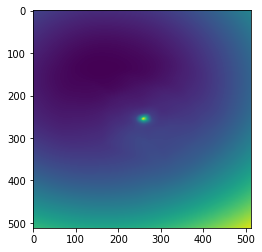

epoch 81101: 48.25111389160156
epoch 81102: 48.45386505126953
epoch 81103: 47.96978759765625
epoch 81104: 47.68991470336914
epoch 81105: 47.671627044677734
epoch 81106: 48.53645706176758
epoch 81107: 47.848175048828125
epoch 81108: 48.77640151977539
epoch 81109: 48.68442153930664
epoch 81111: 48.246734619140625
epoch 81112: 48.379878997802734
epoch 81113: 48.380184173583984
epoch 81114: 48.15656661987305
epoch 81115: 47.361549377441406
epoch 81116: 47.534637451171875
epoch 81117: 47.99124526977539
epoch 81118: 48.3589973449707
epoch 81119: 47.723594665527344
epoch 81121: 47.850704193115234
epoch 81122: 47.71744918823242
epoch 81123: 47.16468048095703
epoch 81124: 48.23218536376953
epoch 81125: 47.66455841064453
epoch 81126: 48.59088134765625
epoch 81127: 49.24061584472656
epoch 81128: 48.0791015625
epoch 81129: 47.78042984008789
epoch 81131: 47.99267578125
epoch 81132: 48.9954948425293
epoch 81133: 46.815574645996094
epoch 81134: 47.54043960571289
epoch 81135: 48.87950897216797
epoch 8

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



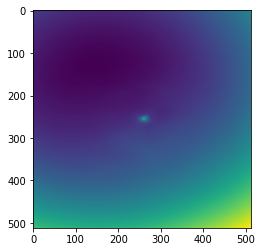

epoch 81201: 47.098453521728516
epoch 81202: 48.24055862426758
epoch 81203: 47.898956298828125
epoch 81204: 49.16700744628906
epoch 81205: 48.1474609375
epoch 81206: 48.81299591064453
epoch 81207: 47.42426300048828
epoch 81208: 47.84172821044922
epoch 81209: 48.2861442565918
epoch 81211: 48.496253967285156
epoch 81212: 48.48529052734375
epoch 81213: 47.822696685791016
epoch 81214: 47.94427490234375
epoch 81215: 47.847259521484375
epoch 81216: 48.06425094604492
epoch 81217: 49.50902557373047
epoch 81218: 48.14686965942383
epoch 81219: 48.32367706298828
epoch 81221: 47.70044708251953
epoch 81222: 48.27658462524414
epoch 81223: 48.59247589111328
epoch 81224: 48.626094818115234
epoch 81225: 48.441734313964844
epoch 81226: 47.79888916015625
epoch 81227: 48.47406005859375
epoch 81228: 48.23661422729492
epoch 81229: 47.72213363647461
epoch 81231: 48.29896545410156
epoch 81232: 48.47175216674805
epoch 81233: 48.027626037597656
epoch 81234: 48.341827392578125
epoch 81235: 47.0980339050293
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



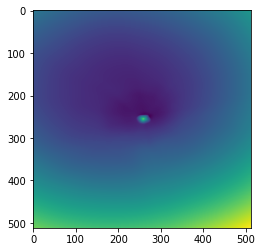

epoch 81301: 48.438018798828125
epoch 81302: 47.72399139404297
epoch 81303: 48.00468444824219
epoch 81304: 47.88100814819336
epoch 81305: 47.86814498901367
epoch 81306: 47.75251388549805
epoch 81307: 47.960262298583984
epoch 81308: 48.30035400390625
epoch 81309: 47.87584686279297
epoch 81311: 47.69644546508789
epoch 81312: 48.49653625488281
epoch 81313: 47.09272766113281
epoch 81314: 47.69319534301758
epoch 81315: 47.56507110595703
epoch 81316: 47.82065200805664
epoch 81317: 49.17689514160156
epoch 81318: 47.40433883666992
epoch 81319: 48.647926330566406
epoch 81321: 47.82379913330078
epoch 81322: 49.536773681640625
epoch 81323: 48.587120056152344
epoch 81324: 48.94540023803711
epoch 81325: 47.99574279785156
epoch 81326: 49.37284469604492
epoch 81327: 47.480751037597656
epoch 81328: 47.44414520263672
epoch 81329: 48.69084930419922
epoch 81331: 48.08101272583008
epoch 81332: 49.3649787902832
epoch 81333: 47.536659240722656
epoch 81334: 47.56013870239258
epoch 81335: 48.41551971435547
ep

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



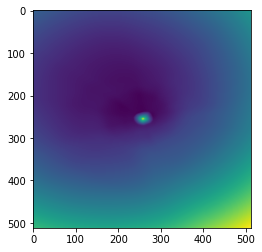

epoch 81401: 48.410308837890625
epoch 81402: 48.00852966308594
epoch 81403: 48.03651428222656
epoch 81404: 48.553794860839844
epoch 81405: 47.64583969116211
epoch 81406: 47.691307067871094
epoch 81407: 47.421974182128906
epoch 81408: 49.05469512939453
epoch 81409: 48.54811096191406
epoch 81411: 48.68381118774414
epoch 81412: 48.63720703125
epoch 81413: 47.962684631347656
epoch 81414: 47.904537200927734
epoch 81415: 47.60965347290039
epoch 81416: 48.444602966308594
epoch 81417: 48.397735595703125
epoch 81418: 49.015140533447266
epoch 81419: 48.31578826904297
epoch 81421: 47.971134185791016
epoch 81422: 47.987674713134766
epoch 81423: 48.00774002075195
epoch 81424: 48.464439392089844
epoch 81425: 48.778114318847656
epoch 81426: 48.26500701904297
epoch 81427: 48.8243293762207
epoch 81428: 48.676734924316406
epoch 81429: 48.15119171142578
epoch 81431: 47.92415237426758
epoch 81432: 48.9332275390625
epoch 81433: 47.99924850463867
epoch 81434: 47.70436477661133
epoch 81435: 47.91186904907226

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



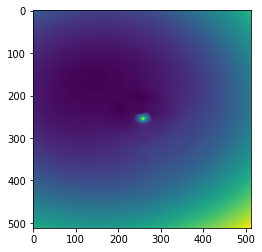

epoch 81501: 48.174415588378906
epoch 81502: 49.222965240478516
epoch 81503: 48.00486373901367
epoch 81504: 48.63441848754883
epoch 81505: 48.014495849609375
epoch 81506: 48.305667877197266
epoch 81507: 48.682456970214844
epoch 81508: 48.64117431640625
epoch 81509: 47.50138854980469
epoch 81511: 48.216712951660156
epoch 81512: 48.32910919189453
epoch 81513: 48.38767623901367
epoch 81514: 48.45307159423828
epoch 81515: 48.391624450683594
epoch 81516: 47.82439422607422
epoch 81517: 48.629005432128906
epoch 81518: 47.56999588012695
epoch 81519: 48.4428596496582
epoch 81521: 47.855655670166016
epoch 81522: 49.17488479614258
epoch 81523: 48.27601623535156
epoch 81524: 48.52907943725586
epoch 81525: 47.7899284362793
epoch 81526: 49.02292251586914
epoch 81527: 48.40346908569336
epoch 81528: 48.797271728515625
epoch 81529: 49.458988189697266
epoch 81531: 48.043949127197266
epoch 81532: 48.42501449584961
epoch 81533: 48.424503326416016
epoch 81534: 48.38288879394531
epoch 81535: 48.679374694824

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



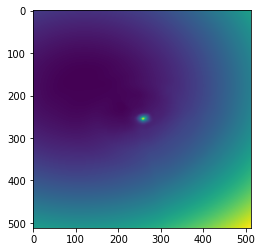

epoch 81601: 48.07940673828125
epoch 81602: 49.02118682861328
epoch 81603: 49.57850646972656
epoch 81604: 48.08789825439453
epoch 81605: 47.6162223815918
epoch 81606: 47.57292556762695
epoch 81607: 47.55750274658203
epoch 81608: 49.38169479370117
epoch 81609: 47.79974365234375
epoch 81611: 48.308631896972656
epoch 81612: 48.59680938720703
epoch 81613: 47.531307220458984
epoch 81614: 48.218994140625
epoch 81615: 48.735084533691406
epoch 81616: 47.98933029174805
epoch 81617: 48.04987335205078
epoch 81618: 48.56450653076172
epoch 81619: 48.865966796875
epoch 81621: 48.433597564697266
epoch 81622: 47.98955535888672
epoch 81623: 47.5383186340332
epoch 81624: 48.20998764038086
epoch 81625: 48.137550354003906
epoch 81626: 47.907047271728516
epoch 81627: 48.11991882324219
epoch 81628: 48.84645462036133
epoch 81629: 47.5921516418457
epoch 81631: 47.64882278442383
epoch 81632: 48.16828536987305
epoch 81633: 48.91604995727539
epoch 81634: 49.03799057006836
epoch 81635: 48.532493591308594
epoch 81

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



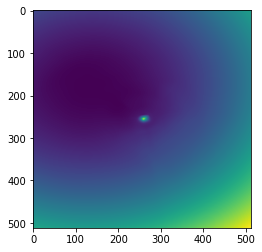

epoch 81701: 47.05611801147461
epoch 81702: 49.78203582763672
epoch 81703: 47.61461639404297
epoch 81704: 48.177181243896484
epoch 81705: 47.763214111328125
epoch 81706: 49.047142028808594
epoch 81707: 47.79133605957031
epoch 81708: 47.86217498779297
epoch 81709: 48.275428771972656
epoch 81711: 47.62861633300781
epoch 81712: 47.221336364746094
epoch 81713: 48.13407516479492
epoch 81714: 48.079872131347656
epoch 81715: 47.60355758666992
epoch 81716: 48.296356201171875
epoch 81717: 48.32152557373047
epoch 81718: 47.765350341796875
epoch 81719: 48.602073669433594
epoch 81721: 47.439300537109375
epoch 81722: 48.012691497802734
epoch 81723: 47.79619216918945
epoch 81724: 48.23423767089844
epoch 81725: 47.6302604675293
epoch 81726: 48.012367248535156
epoch 81727: 48.085018157958984
epoch 81728: 48.0025520324707
epoch 81729: 48.26460647583008
epoch 81731: 48.38641357421875
epoch 81732: 46.67591857910156
epoch 81733: 47.80134963989258
epoch 81734: 47.935550689697266
epoch 81735: 47.99569320678

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



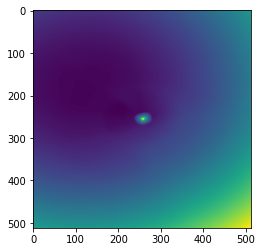

epoch 81801: 48.274085998535156
epoch 81802: 47.918148040771484
epoch 81803: 50.408084869384766
epoch 81804: 48.456485748291016
epoch 81805: 50.083152770996094
epoch 81806: 48.624393463134766
epoch 81807: 48.28883743286133
epoch 81808: 48.00346374511719
epoch 81809: 48.26472091674805
epoch 81811: 48.15024948120117
epoch 81812: 54.01890563964844
epoch 81813: 48.30274963378906
epoch 81814: 48.15602111816406
epoch 81815: 49.06126403808594
epoch 81816: 48.6302604675293
epoch 81817: 49.311222076416016
epoch 81818: 48.891231536865234
epoch 81819: 49.169097900390625
epoch 81821: 49.31228256225586
epoch 81822: 48.26003646850586
epoch 81823: 49.37018966674805
epoch 81824: 48.95259094238281
epoch 81825: 48.75188064575195
epoch 81826: 49.4995002746582
epoch 81827: 48.277530670166016
epoch 81828: 49.081180572509766
epoch 81829: 49.427589416503906
epoch 81831: 49.52837371826172
epoch 81832: 49.01446533203125
epoch 81833: 49.28486633300781
epoch 81834: 49.148372650146484
epoch 81835: 48.047912597656

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



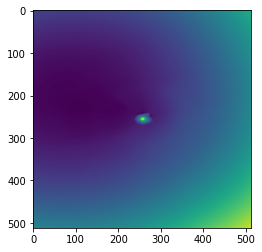

epoch 81901: 47.7203369140625
epoch 81902: 47.57029724121094
epoch 81903: 48.69951629638672
epoch 81904: 47.845458984375
epoch 81905: 47.90076446533203
epoch 81906: 48.984378814697266
epoch 81907: 48.68157958984375
epoch 81908: 48.90041732788086
epoch 81909: 48.44558334350586
epoch 81911: 48.56393051147461
epoch 81912: 48.40640640258789
epoch 81913: 48.09412384033203
epoch 81914: 48.7992057800293
epoch 81915: 48.73371505737305
epoch 81916: 48.27287292480469
epoch 81917: 48.186737060546875
epoch 81918: 47.67058563232422
epoch 81919: 48.145118713378906
epoch 81921: 48.047977447509766
epoch 81922: 48.45479965209961
epoch 81923: 47.892494201660156
epoch 81924: 47.717430114746094
epoch 81925: 47.31715393066406
epoch 81926: 48.49449157714844
epoch 81927: 47.609619140625
epoch 81928: 48.079002380371094
epoch 81929: 47.61433029174805
epoch 81931: 48.766883850097656
epoch 81932: 47.669532775878906
epoch 81933: 48.03166961669922
epoch 81934: 47.77423095703125
epoch 81935: 47.88072967529297
epoch

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



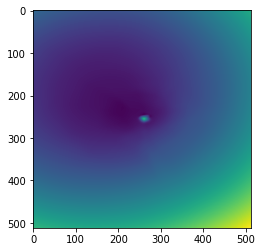

epoch 82001: 48.701416015625
epoch 82002: 47.11569595336914
epoch 82003: 48.07676315307617
epoch 82004: 48.02059555053711
epoch 82005: 49.2584342956543
epoch 82006: 47.90479278564453
epoch 82007: 47.256038665771484
epoch 82008: 47.49774932861328
epoch 82009: 49.034339904785156
epoch 82011: 48.06672286987305
epoch 82012: 48.068931579589844
epoch 82013: 47.876976013183594
epoch 82014: 48.11696243286133
epoch 82015: 48.556739807128906
epoch 82016: 47.74329376220703
epoch 82017: 48.353904724121094
epoch 82018: 47.563560485839844
epoch 82019: 48.168949127197266
epoch 82021: 48.4188232421875
epoch 82022: 49.08584213256836
epoch 82023: 47.23028564453125
epoch 82024: 47.4258918762207
epoch 82025: 48.26801681518555
epoch 82026: 48.246456146240234
epoch 82027: 47.837615966796875
epoch 82028: 47.33015060424805
epoch 82029: 47.34386444091797
epoch 82031: 47.88175582885742
epoch 82032: 47.751731872558594
epoch 82033: 48.00314712524414
epoch 82034: 48.115291595458984
epoch 82035: 47.74724197387695
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



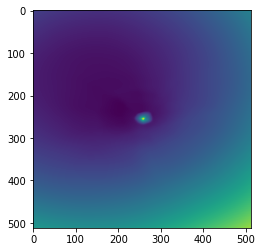

epoch 82101: 48.00438690185547
epoch 82102: 48.09710693359375
epoch 82103: 48.53438949584961
epoch 82104: 48.153709411621094
epoch 82105: 47.678531646728516
epoch 82106: 48.46063995361328
epoch 82107: 47.93896484375
epoch 82108: 47.56513595581055
epoch 82109: 47.736083984375
epoch 82111: 47.417240142822266
epoch 82112: 48.040401458740234
epoch 82113: 47.714752197265625
epoch 82114: 48.3888053894043
epoch 82115: 47.938690185546875
epoch 82116: 48.95219039916992
epoch 82117: 48.2086181640625
epoch 82118: 48.414825439453125
epoch 82119: 48.2162971496582
epoch 82121: 48.500648498535156
epoch 82122: 47.92734909057617
epoch 82123: 49.15849304199219
epoch 82124: 48.037288665771484
epoch 82125: 48.392024993896484
epoch 82126: 47.958126068115234
epoch 82127: 48.138816833496094
epoch 82128: 47.547218322753906
epoch 82129: 49.32334518432617
epoch 82131: 48.67386245727539
epoch 82132: 49.118595123291016
epoch 82133: 48.550567626953125
epoch 82134: 48.28389358520508
epoch 82135: 49.29033660888672
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



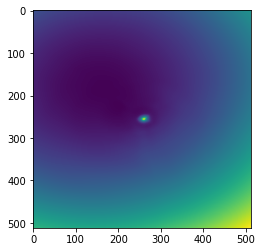

epoch 82201: 47.739253997802734
epoch 82202: 47.43832778930664
epoch 82203: 48.233924865722656
epoch 82204: 48.312583923339844
epoch 82205: 48.220420837402344
epoch 82206: 47.502723693847656
epoch 82207: 48.563079833984375
epoch 82208: 48.570350646972656
epoch 82209: 47.81304931640625
epoch 82211: 49.09064483642578
epoch 82212: 47.59221267700195
epoch 82213: 48.31250762939453
epoch 82214: 47.51307678222656
epoch 82215: 47.91619873046875
epoch 82216: 47.747314453125
epoch 82217: 48.318660736083984
epoch 82218: 49.51369857788086
epoch 82219: 47.700523376464844
epoch 82221: 48.39097595214844
epoch 82222: 49.06983184814453
epoch 82223: 47.76898193359375
epoch 82224: 47.71610641479492
epoch 82225: 47.84718704223633
epoch 82226: 48.21519470214844
epoch 82227: 47.86209487915039
epoch 82228: 48.10059356689453
epoch 82229: 48.397735595703125
epoch 82231: 47.77068328857422
epoch 82232: 48.03350830078125
epoch 82233: 48.7071418762207
epoch 82234: 47.46839141845703
epoch 82235: 48.07663345336914
e

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



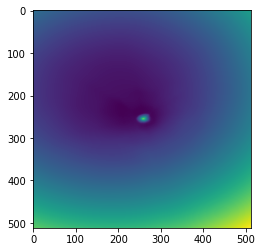

epoch 82301: 47.9157600402832
epoch 82302: 47.95084762573242
epoch 82303: 48.740421295166016
epoch 82304: 47.736873626708984
epoch 82305: 48.3807373046875
epoch 82306: 48.70185089111328
epoch 82307: 49.565589904785156
epoch 82308: 49.66109848022461
epoch 82309: 47.632293701171875
epoch 82311: 48.25339126586914
epoch 82312: 48.864681243896484
epoch 82313: 47.895320892333984
epoch 82314: 48.17122268676758
epoch 82315: 48.13753890991211
epoch 82316: 48.26944351196289
epoch 82317: 48.43440628051758
epoch 82318: 48.796939849853516
epoch 82319: 47.55550003051758
epoch 82321: 47.67383575439453
epoch 82322: 48.67303466796875
epoch 82323: 49.09077453613281
epoch 82324: 48.589332580566406
epoch 82325: 48.980106353759766
epoch 82326: 48.055965423583984
epoch 82327: 47.857147216796875
epoch 82328: 48.62706756591797
epoch 82329: 48.154056549072266
epoch 82331: 48.5279655456543
epoch 82332: 48.097389221191406
epoch 82333: 48.80716323852539
epoch 82334: 48.915706634521484
epoch 82335: 48.311584472656

/home/srinivas/.local/lib/python3.8/site-packages/torch/functional.py:1241: UserWarning:

torch.norm is deprecated and may be removed in a future PyTorch release. Use torch.linalg.norm instead.



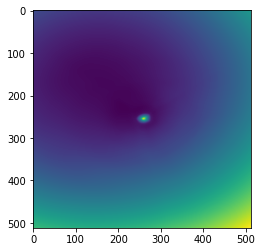

epoch 82401: 48.33367919921875
epoch 82402: 47.738685607910156
epoch 82403: 49.439598083496094
epoch 82404: 47.95030212402344
epoch 82405: 48.325408935546875
epoch 82406: 48.48755645751953
epoch 82407: 48.75426483154297
epoch 82408: 48.13319396972656
epoch 82409: 48.57375717163086
epoch 82411: 47.50990676879883
epoch 82412: 47.705055236816406
epoch 82413: 47.63325500488281
epoch 82414: 48.67246627807617
epoch 82415: 48.08967208862305
epoch 82416: 48.008975982666016
epoch 82417: 47.91170120239258
epoch 82418: 47.74941635131836
epoch 82419: 48.79411315917969
epoch 82421: 48.28953552246094
epoch 82422: 47.484806060791016
epoch 82423: 48.04250717163086
epoch 82424: 46.974998474121094
epoch 82425: 48.35740661621094
epoch 82426: 47.82590866088867
epoch 82427: 48.052398681640625
epoch 82428: 47.54793930053711
epoch 82429: 47.86781692504883
epoch 82431: 47.57223892211914
epoch 82432: 48.09320068359375
epoch 82433: 48.153072357177734
epoch 82434: 48.13654327392578
epoch 82435: 48.40394592285156

In [ ]:
bs = 2 ** 10

def generate_sphere_pc(ego, bs):
    '''
    Given an ego location and the number of points to sample, sample
    points on a sphere centered at the origin that are facing ego
    '''
    theta, phi, r = trand(bs) * np.pi * 2.0, trand(bs) * np.pi, 1.0
    
    point_batch = torch.stack((torch.sin(phi) * torch.cos(theta) * r,
                               torch.sin(phi) * torch.sin(theta) * r,
                               torch.cos(phi) * r), dim=1)
    
    aligned = torch.bmm(point_batch.unsqueeze(1), 
                        ego.unsqueeze(0).unsqueeze(2).expand(bs, -1, -1)) \
                        .squeeze()
    aligned = (aligned > 0).nonzero()

    return torch.gather(point_batch, dim=0, index=aligned.expand(-1, 3))

def generate_bunny_pc(ego):
    '''
    Given an ego location and the number of points to sample, sample
    points on a bunny centered at the origin that are facing ego
    '''
    point_batch = torch.from_numpy(get_bunny()).cuda()
    bs = point_batch.shape[0]
    
    aligned = torch.bmm(point_batch.unsqueeze(1), 
                        ego.unsqueeze(0).unsqueeze(2).expand(bs, -1, -1)) \
                        .squeeze()
    aligned = (aligned > 0).nonzero()

    return torch.gather(point_batch, dim=0, index=aligned.expand(-1, 3))

def visualize_pointcloud_hemisphere(sph):
    with torch.no_grad():
        sph = sph.cpu().numpy()

        pts_fig = go.Figure(data=[go.Scatter3d(
            x=sph[:, 0],
            y=sph[:, 1],
            z=sph[:, 2],
            mode='markers',
            marker=dict(
                size=2,
                colorscale='Viridis',
                opacity=0.8
            )
        )])
        pts_fig.show()

'''sdf_siren = Siren(in_features=3, 
                  out_features=1, 
                  hidden_features=64,
                  hidden_layers=2,
                  outermost_linear=True)
sdf_siren = sdf_siren.cuda()'''
#sdf_siren = OccupancyNetwork().cuda()
sdf_siren = IGR(input_dims=3, depths=[32, 32, 32, 32, 32, 32]).cuda()

optim = torch.optim.Adam(lr=1e-3, params=sdf_siren.parameters())

ego = torch.tensor([0.0, 0.0, 8.0]).cuda()

#visualize_pointcloud_hemisphere(generate_sphere_pc(ego, bs))
visualize_pointcloud_hemisphere(generate_bunny_pc(ego))

for epoch in range(1000000):
    '''theta, phi, r = trand(bs) * np.pi * 2.0, trand(bs) * np.pi, 1.0
    point_batch = torch.stack((torch.sin(phi) * torch.cos(theta) * r,
                                   torch.sin(phi) * torch.sin(theta) * r,
                                   torch.cos(phi) * r), dim=1)'''

    #point_batch = generate_sphere_pc(ego, bs)
    point_batch = generate_bunny_pc(ego)
    eikonal_points = trand((point_batch.shape[0], 3)).cuda() * 5.0 - 2.5

    point_batch = point_batch.cuda()
    model_output, coords = sdf_siren(point_batch)

    model_output_rand, coords_rand = sdf_siren(eikonal_points)
    gc = gradient(model_output_rand, coords_rand)

    sample_positions = sample_on_rays(point_batch, ego)
    ego_dist, _ = sdf_siren(ego.expand(2, ego.shape[0]).cuda())
    exterior_dist, _ = sdf_siren(sample_positions.view(-1, 3))

    with torch.no_grad():
        pc_normals = compute_normals(point_batch, ego, use_rings=False).cuda()

    c_reconstruction = 3e3 # 1.0
    c_eikonal = 5e1 # 1.0
    c_inter = 1e2 # 1.0
    c_ext = 1e2 # 1.0
    c_normals = 1e2

    l_reconstruction = (model_output ** 2).mean() * c_reconstruction
    l_eikonal = ((1.0 - (gc[:, 0] ** 2 + gc[:, 1] ** 2 + gc[:, 2] ** 2)) ** 2).mean() * c_eikonal
    l_inter = torch.exp(-1e2 * torch.abs(model_output_rand)).mean() * c_inter
    l_exterior = (torch.exp(torch.max(-exterior_dist,
                                      tz(exterior_dist.shape))).mean() - 1) * c_ext
    l_normals = (1 - torch.nn.functional.cosine_similarity(pc_normals, gc, dim=-1).mean()) * c_normals

    loss = l_reconstruction + l_eikonal + l_inter + l_exterior + l_normals
    
    optim.zero_grad()
    loss.backward()
    optim.step()

    if epoch % 10:
        print("epoch {}: {}".format(epoch, loss))
    if epoch % 100 == 0:
        print("reconstruction loss", l_reconstruction, 
            "eikonal loss", l_eikonal,
            "exterior loss", l_exterior,
            "inter loss", l_inter,
            "normal_loss", l_normals)
        print("worst of last batch", abs(model_output).max())
        render(sdf_siren)